In [1]:
import twint   
import nest_asyncio
import pandas as pd
nest_asyncio.apply()
from datetime import date, timedelta, datetime


In [2]:
from vaderSentiment.vaderSentiment import SentimentIntensityAnalyzer
vader_sentiment = SentimentIntensityAnalyzer()
def vader_sentiment_scores(tweets_df):
    scores = tweets_df['new_tweet'].apply(lambda x: vader_sentiment.polarity_scores(x))
    sentiment = pd.DataFrame(columns=['neg', 'neu', 'pos', 'compound'])
    for i, row in enumerate(scores):
#         print( pd.DataFrame(row, index=[i]))
        sentiment = pd.concat([sentiment, pd.DataFrame(row, index=[i])])
 
    return pd.merge(tweets_df, sentiment, left_index=True, right_index=True)

In [3]:
import re
import nltk
import spacy

nlp = spacy.load('en_core_web_sm', disable=['parser', 'ner'])
#nltk.download('stopwords')

In [4]:
def remove_emoji(text):
    emoji_pattern = re.compile("["
                           u"\U0001F600-\U0001F64F"  # emoticons
                           u"\U0001F300-\U0001F5FF"  # symbols & pictographs
                           u"\U0001F680-\U0001F6FF"  # transport & map symbols
                           u"\U0001F1E0-\U0001F1FF"  # flags 
                           u"\U00002702-\U000027B0"
                           u"\U000024C2-\U0001F251"
                           "]+", flags=re.UNICODE)
    return emoji_pattern.sub(r'', text)


In [5]:
def space(comment):
    doc = nlp(comment)
    return " ".join([token.lemma_ for token in doc])


In [6]:
# clean_tweets = []

# for tweet in tweet_list:
    
#     tweet = str(tweet) 

#     tweet = re.sub(r'^RT[\s]+', '', tweet)
#     tweet = re.sub(r'\$\w*', '', tweet)
#     tweet = re.sub(r'$', '', tweet)
#     tweet = re.sub(r'https?://[^\s\n\r]+', '', tweet)
#     tweet = re.sub(r'https?://[A-Za-z0-9./]+','',tweet)
#     tweet = re.sub(r'https//[A-Za-z0-9./]+','',tweet)
#     tweet = tweet.replace("\n","")
#     tweet = re.sub('@[\w]+', '', tweet)

#     tweet = re.sub(r"n't", " not ", tweet)
#     tweet = re.sub(r"\'s", " ", tweet)
#     tweet = re.sub(r"\'ve", " have ", tweet)
#     tweet = re.sub(r"\'re", " are ", tweet)
#     tweet = re.sub(r"\'d", " would ", tweet)
#     tweet = re.sub(r"\'ll", " will ", tweet) 

#     tweet = tweet.lower()
#     tweet = tweet.strip()

#     clean_tweets.append(tweet)

In [7]:
def prepare_tweets(tweets):
    ##Since I chose to use VADER for sentiment analysis much of this preproccessing can actually harm the models performance
    #it may be worth expanding words, removing links, new lines and @s. Compare empirically.
    #nlp = spacy.load('en_core_web_sm', disable=['parser', 'ner'])
    #Remove upper case
    #tweets['new_tweet'] = tweets['tweet'].apply(lambda x: " ".join(x.lower() for x in x.split()))
    #Remove punctuation
    #tweets['new_tweet'] = tweets['new_tweet'].str.replace('[^\w\s]','')
    #Remove emojis
    #tweets['new_tweet'] = tweets['new_tweet'].apply(lambda x: remove_emoji(x))
    #Remove stopwords
    #stop = nltk.corpus.stopwords.words('english')
    #tweets['new_tweet'] = tweets['new_tweet'].apply(lambda x: " ".join(x for x in x.split() if x not in stop))
    #Remove lemmatization
    #tweets['new_tweet']= tweets['new_tweet'].apply(space)
    tweets['new_tweet'] = tweets['tweet']
    
    
    return tweets

In [8]:
def average_daily_sentiment(dataframe):
    since = datetime.strptime(dataframe['date'].min(), "%Y-%m-%d")
    until = datetime.strptime(dataframe['date'].max(), "%Y-%m-%d")
    delta = timedelta(days=1)
    loop_date = since
    avg_sentiment_df = pd.DataFrame(columns=['date', 'avg_sentiment'])
    i=0
    while(loop_date <= until):
        day_df = dataframe.loc[dataframe['date'] == loop_date.strftime("%Y-%m-%d")]
        #Due to timezones being a bit weird sometimes tweets from the day after
        #are included, use this if statement to filter them out
        if(len(day_df.index) > 5):
            print(f'{loop_date.strftime("%Y-%m-%d")} : {day_df["compound"].mean()}')
            df = pd.DataFrame({f'date' : loop_date.strftime("%Y-%m-%d"),
                            f'avg_sentiment': day_df["compound"].mean()}, [i])
            avg_sentiment_df = pd.concat([avg_sentiment_df, df])
        loop_date += delta
        i += 1
        
    return avg_sentiment_df
    
    

In [9]:
import time

In [10]:
def extract_tweets(search: str, since: date, until: date, limit: int):
    loop_date = since
    delta = timedelta(days=1)
    c = twint.Config()

    c.Limit = 1
    c.Pandas = True
    c.Search = search
    c.Lang = 'en'
    c.Min_likes = 100 # Want tweets that lots of people agree with.
    
    c.Since = since.strftime("%Y-%m-%d")
    # c.Location = True
    ##DOESNT include until.
    
    tweets_df = pd.DataFrame(columns=['id', 'conversation_id', 'created_at', 'date', 'timezone', 'place',
       'tweet', 'language', 'hashtags', 'cashtags', 'user_id', 'user_id_str',
       'username', 'name', 'day', 'hour', 'link', 'urls', 'photos', 'video',
       'thumbnail', 'retweet', 'nlikes', 'nreplies', 'nretweets', 'quote_url',
       'search', 'near', 'geo', 'source', 'user_rt_id', 'user_rt',
       'retweet_id', 'reply_to', 'retweet_date', 'translate', 'trans_src',
       'trans_dest'])
    while(loop_date <= until):
        c.Since = (loop_date).strftime("%Y-%m-%d")
        c.Until = (loop_date+delta).strftime("%Y-%m-%d")
        print(loop_date.strftime("%Y-%m-%d"))
#         c.Until = loop_date.strftime("%Y-%m-%d")
        temp_df = pd.DataFrame(columns=['id', 'conversation_id', 'created_at', 'date', 'timezone', 'place',
           'tweet', 'language', 'hashtags', 'cashtags', 'user_id', 'user_id_str',
           'username', 'name', 'day', 'hour', 'link', 'urls', 'photos', 'video',
           'thumbnail', 'retweet', 'nlikes', 'nreplies', 'nretweets', 'quote_url',
           'search', 'near', 'geo', 'source', 'user_rt_id', 'user_rt',
           'retweet_id', 'reply_to', 'retweet_date', 'translate', 'trans_src',
           'trans_dest'])
        tries = 0
        while(len(temp_df.index) < limit and tries < 5):
            tries += 1
            twint.run.Search(c)
            temp_df = pd.concat([temp_df, twint.storage.panda.Tweets_df])
            time.sleep(1.5)
        tweets_df = pd.concat([tweets_df, temp_df])
        loop_date += delta
        
    
    tweets_df.reset_index(drop=True, inplace=True)
    tweets_df.drop(columns=['timezone', 'place',
       'cashtags', 'user_id_str',
       'day', 'hour',
       'thumbnail', 
       'near', 'geo', 'source', 'user_rt_id', 'user_rt',
       'retweet_id', 'reply_to', 'retweet_date', 'translate','quote_url', 'photos', 'video', 'retweet', 'trans_src',
       'trans_dest'],inplace=True)
    
    
    tweets_new = prepare_tweets(tweets_df)
    tweets_sentiment = vader_sentiment_scores(tweets_new)
    tweets_sentiment[['date', 'time']] = tweets_sentiment['date'].apply(lambda x: pd.Series(str(x).split(" ")))

    tweets_sentiment.to_csv(f'tweets_sentiment_s{since}_u{until}.csv')
    
    return tweets_sentiment

In [11]:
tweets = extract_tweets('UK (Labour OR Conservative OR Parliament OR Government OR "Lib OR dems" OR "liberal OR democrats")', date(2023,4,1), date(2023,4,13), 100)

2023-04-01
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
1642287042028531713 2023-04-01 23:05:17 +0100 <joao_kay> It’s the new Brexit Together alliance. The Scots won’t fall for it. It’s economically illiterate and highly regressive in every way. Labour will change nothing at all. Staying in the UK is totally senseless. #ScottishIndependence #YesMovementUnited  https://t.co/HUdvRRqmD8
1642277304410808320 2023-04-01 22:26:36 +0100 <sharron_honey> UK government threatened with legal action over Australia trade deal | Financial Times  https://t.co/5XojC4agCS
1642267874214440960 2023-04-01 21:49:07 +0100 <CentralBylines> We presume you don't want to talk about other old data and how the Conservatives have put the UK into debt not seen since the early 1960s?  Brexit Conservative Britain 🇬🇧  https://t.co/MwBQZPeKw1
1642255475965132801 2023-04-01 20:59:51 +0100 <SaveGlasgowNow> 

1642652593489952768 2023-04-02 23:17:51 +0100 <mitsyarty> Fixed it or you Jess:  1000s of young white girls were sexually exploited and failed by Labour led councils up and down the UK. They were vulnerable British girls exploited by an epidemic of groomers, mostly from Labour council areas, ALL distressed by Labour's lack of action.
1642647267160064003 2023-04-02 22:56:42 +0100 <predictorelect> East Dunbartonshire general election prediction:  Lib Dems 41.3% SNP 23.5% Labour 22.7% Conservatives 8.5% Reform UK 1.7% Greens 1.5% Others 0.8%  Prediction: Lib Dem GAIN from SNP
1642621898109378562 2023-04-02 21:15:53 +0100 <McGiff> What the UK Government has done/is doing to Julian Assange is tantamount to torture. They disgust me. He is NOT the bad guy. That's it. #FreeJulianAssange @Stella_Assange  https://t.co/65gsxs7IQs
1642618596378525701 2023-04-02 21:02:46 +0100 <JustStop_Oil> 🦺  SLOW MARCH IN OXFORD  🚷 Earlier today supporters of Just Stop Oil blocked roads in Oxford to disrupt traf

[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
1643016799733030915 2023-04-03 23:25:05 +0100 <muneebqadirmmq> REMINDER: Mian Mithu, the cleric who has attracted sanctions from the UK for abducting minor girls and forcing them into child marriages enjoys immense popularity among the country’s ruling elite. He was also invited by the PTI Government in 2021 for consultation on the…  https://t.co/FNWUR1BXMZ
1643008359245795333 2023-04-03 22:51:33 +0100 <EconomyInformal> Digital Government Index  Korea🇰🇷: 0.74 UK🇬🇧: 0.74 Colombia🇨🇴: 0.73 Japan🇯🇵: 0.64 Canada🇨🇦: 0.63 Spain🇪🇸: 0.62 Uruguay🇺🇾: 0.60 France🇫🇷: 0.57 Italy🇮🇹: 0.53 Brazil🇧🇷: 0.52 Netherlands🇳🇱: 0.45 Chile🇨🇱: 0.41 Germany🇩🇪: 0.40 Finland🇫🇮: 0.36 Greece🇬🇷: 0.35 Sweden🇸🇪: 0.26  @OECD  https://t.co/4Gjcm5PjvC
1643004178472525825 2023-04-03 22:34:56 +0100 <SamLowry60> Starmer to get elected Labour Leader  “Corbyn was a friend”  Starmer to get elected UK Leader  “Corbyn was NOT a friend”  Starmer will li

[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
2023-04-05
1643754362743951360 2023-04-06 00:15:54 +0100 <Justice_forum> This dinghy carrying 8 illegal immigrants was today escorted by the French coastguard vessel Jacques Oudart Fourmentin all the way from France to a handover inside UK territorial waters.   The is nothing more than government sponsored people trafficking.   https://t.co/uY9fzcvgxg  https://t.co/pYVEPlaLae
1643718567790256128 2023-04-05 21:53:40 +0100 <nomoremonarchs> Parliament must act!   The UK is paying millions for a lavish display of "antique flummery". And "since 1800, a vast family fortune has been created from public funds".   UK residents, tell your MP to investigate.  #CostOfTheCrown #ta

1644115873802616833 2023-04-07 00:12:25 +0100 <ChirpyChet> Emails reveal UK Government involvement in Newcastle United's Saudi takeover  UK government could have actively attempted to influence the Premier League's decision to green-light the Saudi Public Investment Fund's (PIF) £300M takeover   #ToriesOut274  https://t.co/BEmqab7Ike
1644091589742981123 2023-04-06 22:35:55 +0100 <LGBwiththeT> We have received multiple requests to promote a petition to the UK Government re. the proposed Equality Act changes.  We are happy to!  Some people are desperate to feel they are doing something, no matter how big or small.  We feel it too!   https://t.co/HfufKuALD1
1644087225569927168 2023-04-06 22:18:34 +0100 <SimonScarrow> @LeeAndersonMP_ I love my country and I am proud of it. I detest the contemptible, corrupt and incompetent Conservative government that is hell bent on ruining the UK.
1644085720842158083 2023-04-06 22:12:36 +0100 <EssexPR> UK Politics is at the lowest level it’s ever been, G

1644115873802616833 2023-04-07 00:12:25 +0100 <ChirpyChet> Emails reveal UK Government involvement in Newcastle United's Saudi takeover  UK government could have actively attempted to influence the Premier League's decision to green-light the Saudi Public Investment Fund's (PIF) £300M takeover   #ToriesOut274  https://t.co/BEmqab7Ike
1644091589742981123 2023-04-06 22:35:55 +0100 <LGBwiththeT> We have received multiple requests to promote a petition to the UK Government re. the proposed Equality Act changes.  We are happy to!  Some people are desperate to feel they are doing something, no matter how big or small.  We feel it too!   https://t.co/HfufKuALD1
1644087225569927168 2023-04-06 22:18:34 +0100 <SimonScarrow> @LeeAndersonMP_ I love my country and I am proud of it. I detest the contemptible, corrupt and incompetent Conservative government that is hell bent on ruining the UK.
1644085720842158083 2023-04-06 22:12:36 +0100 <EssexPR> UK Politics is at the lowest level it’s ever been, G

2023-04-08
1644850050340737028 2023-04-09 00:49:46 +0100 <WingsScotland> SNP to take UK government to court over gender reform veto   https://t.co/18ty4JOVUW
1644838874995204099 2023-04-09 00:05:22 +0100 <Jake_Kanter> Hi @elonmusk.  The @BBC is not funded by the UK government.   It is funded by the British public through a system known as the licence fee.  The BBC's operations and editorial decision-making are entirely independent of the government  https://t.co/GvMpcSWIMe
1644837895750991872 2023-04-09 00:01:28 +0100 <nbreavington> Officially Recorded in government documents 70% of the people in the UK  who die have been double jabbed. That’s 7 out of 10 people. Remember This is a fact, not a conspiracy theory!!!!!!  https://t.co/faSWavj5dy
1644837776846901248 2023-04-09 00:01:00 +0100 <TLDRNewsUK> 🚭 BREAKING: The government will create a £3 million "illicit vapes enforcement squad" to crackdown on illegal vape sales and rising levels of youth vaping.
1644830991599431681 2023-04-08 23

1644850050340737028 2023-04-09 00:49:46 +0100 <WingsScotland> SNP to take UK government to court over gender reform veto   https://t.co/18ty4JOVUW
1644838874995204099 2023-04-09 00:05:22 +0100 <Jake_Kanter> Hi @elonmusk.  The @BBC is not funded by the UK government.   It is funded by the British public through a system known as the licence fee.  The BBC's operations and editorial decision-making are entirely independent of the government  https://t.co/GvMpcSWIMe
1644837895750991872 2023-04-09 00:01:28 +0100 <nbreavington> Officially Recorded in government documents 70% of the people in the UK  who die have been double jabbed. That’s 7 out of 10 people. Remember This is a fact, not a conspiracy theory!!!!!!  https://t.co/faSWavj5dy
1644837776846901248 2023-04-09 00:01:00 +0100 <TLDRNewsUK> 🚭 BREAKING: The government will create a £3 million "illicit vapes enforcement squad" to crackdown on illegal vape sales and rising levels of youth vaping.
1644830991599431681 2023-04-08 23:34:02 +010

1644850050340737028 2023-04-09 00:49:46 +0100 <WingsScotland> SNP to take UK government to court over gender reform veto   https://t.co/18ty4JOVUW
1644838874995204099 2023-04-09 00:05:22 +0100 <Jake_Kanter> Hi @elonmusk.  The @BBC is not funded by the UK government.   It is funded by the British public through a system known as the licence fee.  The BBC's operations and editorial decision-making are entirely independent of the government  https://t.co/GvMpcSWIMe
1644837895750991872 2023-04-09 00:01:28 +0100 <nbreavington> Officially Recorded in government documents 70% of the people in the UK  who die have been double jabbed. That’s 7 out of 10 people. Remember This is a fact, not a conspiracy theory!!!!!!  https://t.co/faSWavj5dy
1644837776846901248 2023-04-09 00:01:00 +0100 <TLDRNewsUK> 🚭 BREAKING: The government will create a £3 million "illicit vapes enforcement squad" to crackdown on illegal vape sales and rising levels of youth vaping.
1644830991599431681 2023-04-08 23:34:02 +010

1645198118428786690 2023-04-09 23:52:52 +0100 <NiMingda_GG> Twitter labelled BBC as “Government Funded Media”.  But shouldn’t it be “UK Government Funded Media”?  Is the Anglo-American Empire one government?
1645196123684872194 2023-04-09 23:44:56 +0100 <JIX5A> The BBC is government funded! British citizens and pensioners are forced to fund BBC  propaganda.  BBC medal in politics in other nations of the world with those very public funds.  Public funding of the BBC is in forced on the people of the UK by UK government. If British…
1645194215402422272 2023-04-09 23:37:21 +0100 <ThatBritishChum> @elonmusk @WallStreetSilv It's technically taxpayer funded service. The government has no control over it. It just has it in law that the taxpayers must pay a TV license which funds said BBC.  Nobody in the UK likes this and it will likely end in less than a decade.
1645190586532503555 2023-04-09 23:22:56 +0100 <JayMotty> Just to clarify. The leader of the Labour Party has written exclusively in 

1645198118428786690 2023-04-09 23:52:52 +0100 <NiMingda_GG> Twitter labelled BBC as “Government Funded Media”.  But shouldn’t it be “UK Government Funded Media”?  Is the Anglo-American Empire one government?
1645196123684872194 2023-04-09 23:44:56 +0100 <JIX5A> The BBC is government funded! British citizens and pensioners are forced to fund BBC  propaganda.  BBC medal in politics in other nations of the world with those very public funds.  Public funding of the BBC is in forced on the people of the UK by UK government. If British…
1645194215402422272 2023-04-09 23:37:21 +0100 <ThatBritishChum> @elonmusk @WallStreetSilv It's technically taxpayer funded service. The government has no control over it. It just has it in law that the taxpayers must pay a TV license which funds said BBC.  Nobody in the UK likes this and it will likely end in less than a decade.
1645190586532503555 2023-04-09 23:22:56 +0100 <JayMotty> Just to clarify. The leader of the Labour Party has written exclusively in 

2023-04-10
1645565904745316354 2023-04-11 00:14:19 +0100 <CourierBoyUK> Labour’s personalised posters are having an impact😁  If they were just general photos of Tories the Press would have ignored them  And you know what they say - “No publicity is bad publicity”  #ToriesOut278 #NeverVoteTory #ToriesBrokeBritain #ToriesMustGo  https://t.co/VaSKiisGOX
1645559797650169858 2023-04-10 23:50:03 +0100 <LabourPatriot> Brexit Party winning the 2019 Euros having only been formed weeks earlier has to be the most impressive election victory of my lifetime in the UK, by some distance.
1645550014624563202 2023-04-10 23:11:10 +0100 <ElectionMapsUK> My logic being that 2021 was a really impressive year for the Tories in the local elections (+ they gained Hartlepool from Labour!)  Even on a good night they'll lose seats, and if they're still polling 10-15+ pts behind it'll be far worse.  Generates a cycle of bad headlines!
1645547078813114368 2023-04-10 22:59:31 +0100 <EconomyInformal> The Government 

1645565904745316354 2023-04-11 00:14:19 +0100 <CourierBoyUK> Labour’s personalised posters are having an impact😁  If they were just general photos of Tories the Press would have ignored them  And you know what they say - “No publicity is bad publicity”  #ToriesOut278 #NeverVoteTory #ToriesBrokeBritain #ToriesMustGo  https://t.co/VaSKiisGOX
1645559797650169858 2023-04-10 23:50:03 +0100 <LabourPatriot> Brexit Party winning the 2019 Euros having only been formed weeks earlier has to be the most impressive election victory of my lifetime in the UK, by some distance.
1645550014624563202 2023-04-10 23:11:10 +0100 <ElectionMapsUK> My logic being that 2021 was a really impressive year for the Tories in the local elections (+ they gained Hartlepool from Labour!)  Even on a good night they'll lose seats, and if they're still polling 10-15+ pts behind it'll be far worse.  Generates a cycle of bad headlines!
1645547078813114368 2023-04-10 22:59:31 +0100 <EconomyInformal> The Government AI Readines

1645565904745316354 2023-04-11 00:14:19 +0100 <CourierBoyUK> Labour’s personalised posters are having an impact😁  If they were just general photos of Tories the Press would have ignored them  And you know what they say - “No publicity is bad publicity”  #ToriesOut278 #NeverVoteTory #ToriesBrokeBritain #ToriesMustGo  https://t.co/VaSKiisGOX
1645559797650169858 2023-04-10 23:50:03 +0100 <LabourPatriot> Brexit Party winning the 2019 Euros having only been formed weeks earlier has to be the most impressive election victory of my lifetime in the UK, by some distance.
1645550014624563202 2023-04-10 23:11:10 +0100 <ElectionMapsUK> My logic being that 2021 was a really impressive year for the Tories in the local elections (+ they gained Hartlepool from Labour!)  Even on a good night they'll lose seats, and if they're still polling 10-15+ pts behind it'll be far worse.  Generates a cycle of bad headlines!
1645547078813114368 2023-04-10 22:59:31 +0100 <EconomyInformal> The Government AI Readines

1645936858269118465 2023-04-12 00:48:21 +0100 <Egedeugo> @MissPearls We're all calling on UK government @UKGovScotland to investigate this, explain to Nigerians what happen? How can @UKGovScotland allow APC fascism Party to use them to intimidate opposition in Nigeria, is really disturbing @UKParliament
1645908171074990082 2023-04-11 22:54:22 +0100 <CourierBoyUK> While the corrupt Tories are throwing their dollies out of the pram about Labour’s personalised posters, here’s a sample of their own  #ToriesOut278 #ToriesOut279 #NeverVoteTory #ToriesBrokeBritain #ToriesMustGo  https://t.co/9APjfkuB5J
1645904082178023425 2023-04-11 22:38:07 +0100 <sandieshoes> Terrorists arriving on our shores.  Government told us ‘the pandemic poses an urgent threat to life in the UK’ they introduced new legislation in record time. Now we have a real emergency on the south coast where are the emergency debates &amp; special forces protecting our shores.
1645899524471128064 2023-04-11 22:20:00 +0100 <OnlineP

1645936858269118465 2023-04-12 00:48:21 +0100 <Egedeugo> @MissPearls We're all calling on UK government @UKGovScotland to investigate this, explain to Nigerians what happen? How can @UKGovScotland allow APC fascism Party to use them to intimidate opposition in Nigeria, is really disturbing @UKParliament
1645908171074990082 2023-04-11 22:54:22 +0100 <CourierBoyUK> While the corrupt Tories are throwing their dollies out of the pram about Labour’s personalised posters, here’s a sample of their own  #ToriesOut278 #ToriesOut279 #NeverVoteTory #ToriesBrokeBritain #ToriesMustGo  https://t.co/9APjfkuB5J
1645904082178023425 2023-04-11 22:38:07 +0100 <sandieshoes> Terrorists arriving on our shores.  Government told us ‘the pandemic poses an urgent threat to life in the UK’ they introduced new legislation in record time. Now we have a real emergency on the south coast where are the emergency debates &amp; special forces protecting our shores.
1645899524471128064 2023-04-11 22:20:00 +0100 <OnlineP

2023-04-12
1646290762592837632 2023-04-13 00:14:39 +0100 <jeff_kaye> Memory Hole Thread🧵 From 1983 UK Observer scoop - "Experiments on human guinea pigs by members of the Japanese germ warfare unit continued in Japan after the war with the help of secret funding from the American Government"  https://t.co/9FZKfRwjiu  https://t.co/YRAIu2pJaj
1646289565638881280 2023-04-13 00:09:53 +0100 <_teambennett9> @implausibleblog From a member of a government who have installed the highest level of taxation in 70 years in the UK. Zero research or ownership as usual
1646283623941783553 2023-04-12 23:46:17 +0100 <Sirodue1> 🅾️ How Professor Wole Soyinka frequently flies the APC government, Chibuike Ameachi's private jets from Nigeria to the United State of America.  No wonder he came to defend them Baba is corrupt 📌  #BolaTinubuIsADrugDealer The UK 25% in FCT postponed RCCG Banana Island Wike INEC…  https://t.co/S5xPz99MY4
1646283113004236802 2023-04-12 23:44:15 +0100 <TrevorGreetham> @implausibleblo

1646290762592837632 2023-04-13 00:14:39 +0100 <jeff_kaye> Memory Hole Thread🧵 From 1983 UK Observer scoop - "Experiments on human guinea pigs by members of the Japanese germ warfare unit continued in Japan after the war with the help of secret funding from the American Government"  https://t.co/9FZKfRwjiu  https://t.co/YRAIu2pJaj
1646289565638881280 2023-04-13 00:09:53 +0100 <_teambennett9> @implausibleblog From a member of a government who have installed the highest level of taxation in 70 years in the UK. Zero research or ownership as usual
1646283623941783553 2023-04-12 23:46:17 +0100 <Sirodue1> 🅾️ How Professor Wole Soyinka frequently flies the APC government, Chibuike Ameachi's private jets from Nigeria to the United State of America.  No wonder he came to defend them Baba is corrupt 📌  #BolaTinubuIsADrugDealer The UK 25% in FCT postponed RCCG Banana Island Wike INEC…  https://t.co/S5xPz99MY4
1646283113004236802 2023-04-12 23:44:15 +0100 <TrevorGreetham> @implausibleblog Wasn’t a 

1646290762592837632 2023-04-13 00:14:39 +0100 <jeff_kaye> Memory Hole Thread🧵 From 1983 UK Observer scoop - "Experiments on human guinea pigs by members of the Japanese germ warfare unit continued in Japan after the war with the help of secret funding from the American Government"  https://t.co/9FZKfRwjiu  https://t.co/YRAIu2pJaj
1646289565638881280 2023-04-13 00:09:53 +0100 <_teambennett9> @implausibleblog From a member of a government who have installed the highest level of taxation in 70 years in the UK. Zero research or ownership as usual
1646283623941783553 2023-04-12 23:46:17 +0100 <Sirodue1> 🅾️ How Professor Wole Soyinka frequently flies the APC government, Chibuike Ameachi's private jets from Nigeria to the United State of America.  No wonder he came to defend them Baba is corrupt 📌  #BolaTinubuIsADrugDealer The UK 25% in FCT postponed RCCG Banana Island Wike INEC…  https://t.co/S5xPz99MY4
1646283113004236802 2023-04-12 23:44:15 +0100 <TrevorGreetham> @implausibleblog Wasn’t a 

1646660967072145410 2023-04-14 00:45:42 +0100 <implausibleblog> Dominic Grieve, "A Conservative leader at some point in the future is going to have to face up to the fact that if you want to maximise the UK's economic potential, you have to be in something as close to the EU Single Market, because that gave us 20 years of sustained growth."  https://t.co/oNA8wldkpy
1646642482023735298 2023-04-13 23:32:15 +0100 <mbga_uk> Imagine if these clowns in Parliament had been in charge at the start of WW2. Brave Young Heroes &amp; a Border Force who fought to keep the threats out from 1939- 1945. While now have a Weak Parliament, PMs &amp; A Border Farce who let in all the risks &amp; threats in for years. Broken UK  https://t.co/d07NeSbvIV
1646634380473909250 2023-04-13 23:00:03 +0100 <KeeleyMP> This is appalling. I have raised questions in Parliament about visas for Ukrainian musicians - this is a Government fail @lucyfrazermp    Ukrainian orchestra’s key members refused visas to play in UK  h

1646660967072145410 2023-04-14 00:45:42 +0100 <implausibleblog> Dominic Grieve, "A Conservative leader at some point in the future is going to have to face up to the fact that if you want to maximise the UK's economic potential, you have to be in something as close to the EU Single Market, because that gave us 20 years of sustained growth."  https://t.co/oNA8wldkpy
1646642482023735298 2023-04-13 23:32:15 +0100 <mbga_uk> Imagine if these clowns in Parliament had been in charge at the start of WW2. Brave Young Heroes &amp; a Border Force who fought to keep the threats out from 1939- 1945. While now have a Weak Parliament, PMs &amp; A Border Farce who let in all the risks &amp; threats in for years. Broken UK  https://t.co/d07NeSbvIV
1646634380473909250 2023-04-13 23:00:03 +0100 <KeeleyMP> This is appalling. I have raised questions in Parliament about visas for Ukrainian musicians - this is a Government fail @lucyfrazermp    Ukrainian orchestra’s key members refused visas to play in UK  h

In [12]:
tweets


,id,conversation_id,created_at,date,tweet,language,hashtags,user_id,username,name,...,nlikes,nreplies,nretweets,search,new_tweet,neg,neu,pos,compound,time
0,1642287042028531713,1642287042028531713,1680386717000.0,2023-04-01,It’s the new Brexit Together alliance. The Sco...,en,"[scottishindependence, yesmovementunited]",3266245188,joao_kay,João Kay,...,286,16,159,UK (Labour OR Conservative OR Parliament OR Go...,It’s the new Brexit Together alliance. The Sco...,0.0,1.0,0.0,0.0,23:05:17
1,1642277304410808320,1642277304410808320,1680384396000.0,2023-04-01,UK government threatened with legal action ove...,en,[],1258884036577157123,sharron_honey,Sharron-lee Honey 🐠🐟🐡🇺🇦❤️,...,179,14,74,UK (Labour OR Conservative OR Parliament OR Go...,UK government threatened with legal action ove...,0.182,0.727,0.091,-0.3612,22:26:36
2,1642267874214440960,1642267874214440960,1680382147000.0,2023-04-01,We presume you don't want to talk about other ...,en,[],1299017696416272385,CentralBylines,Central Bylines,...,431,7,211,UK (Labour OR Conservative OR Parliament OR Go...,We presume you don't want to talk about other ...,0.11,0.89,0.0,-0.4063,21:49:07
3,1642255475965132801,1642255475965132801,1680379191000.0,2023-04-01,And once again the UK 🇬🇧 steps in to bail out...,en,[],1425151939487178761,SaveGlasgowNow,GLASGOW Needs YOU,...,484,31,203,UK (Labour OR Conservative OR Parliament OR Go...,And once again the UK 🇬🇧 steps in to bail out...,0.265,0.668,0.067,-0.8402,20:59:51
4,1642250595560980483,1642250595560980483,1680378028000.0,2023-04-01,There isn’t going 2 be a socialist UK because ...,en,[],854769693051297794,Sillyshib,"Siob, Princess of Yorkshire #FBPE #FBR",...,184,33,24,UK (Labour OR Conservative OR Parliament OR Go...,There isn’t going 2 be a socialist UK because ...,0.06,0.794,0.146,0.5849,20:40:28
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
835,1646587641855463431,1646587641855463431,1681412060000.0,2023-04-13,🚨 | NEW: Nurses may go back on strike as union...,en,[],1434450096557596680,PolitlcsUK,Politics UK,...,487,51,91,UK (Labour OR Conservative OR Parliament OR Go...,🚨 | NEW: Nurses may go back on strike as union...,0.224,0.776,0.0,-0.6523,19:54:20
836,1646582999331340312,1646582999331340312,1681410953000.0,2023-04-13,So APC went to the extent of photoshopping Abi...,en,[],1647305408,drpenking,Dr Penking™🇳🇬🇦🇺,...,246,9,78,UK (Labour OR Conservative OR Parliament OR Go...,So APC went to the extent of photoshopping Abi...,0.065,0.714,0.222,0.8257,19:35:53
837,1646580633735397379,1646580633735397379,1681410389000.0,2023-04-13,The pay demands would cost the UK Government £...,en,[],188527034,TrilbeeReviews,MrTARDIS,...,137,5,17,UK (Labour OR Conservative OR Parliament OR Go...,The pay demands would cost the UK Government £...,0.198,0.758,0.044,-0.8519,19:26:29
838,1646580095883067392,1646580095883067392,1681410261000.0,2023-04-13,Biden appearing to reprimand the UK in the Iri...,en,[brexit],2327654917,MrJohnNicolson,JOHN NICOLSON M.P.,...,980,26,265,UK (Labour OR Conservative OR Parliament OR Go...,Biden appearing to reprimand the UK in the Iri...,0.122,0.774,0.104,0.0094,19:24:21


In [13]:
df = average_daily_sentiment(tweets)

df

2023-04-01 : -0.08131999999999999
2023-04-02 : -0.24078000000000005
2023-04-03 : 0.064875
2023-04-04 : 0.10144
2023-04-05 : -0.1392684210526316
2023-04-06 : 0.04424675324675324
2023-04-07 : 0.11978181818181817
2023-04-08 : -0.006759756097560985
2023-04-09 : -0.22224166666666656
2023-04-10 : 0.060736842105263165
2023-04-11 : -0.012809999999999967
2023-04-12 : -0.1863
2023-04-13 : -0.2348761904761905


,date,avg_sentiment
0,2023-04-01,-0.08132
1,2023-04-02,-0.24078
2,2023-04-03,0.064875
3,2023-04-04,0.10144
4,2023-04-05,-0.139268
5,2023-04-06,0.044247
6,2023-04-07,0.119782
7,2023-04-08,-0.00676
8,2023-04-09,-0.222242
9,2023-04-10,0.060737


## EDA
Unfortunately due to the way Twint collects tweet data there are issues with the distribution of tweets.
1) For a specific day the program collects the latest tweets first and moves down towards the earliest, hence the distribution of tweets is skewed toward early morning (due to time zones) and late evening

2) The number of tweets varies for each day. Unfortunately I can't change this and it's a limitation of the library. It might be worth discarding extra tweets.


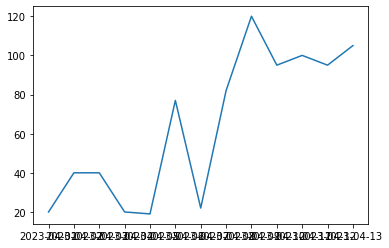

In [14]:
import matplotlib.pyplot as plt
since = datetime.strptime(tweets['date'].min(), "%Y-%m-%d")
until = datetime.strptime(tweets['date'].max(), "%Y-%m-%d")
delta = timedelta(days=1)
loop_date = since
x = []
y = []
i=0
while(loop_date <= until):
    day_df = tweets.loc[tweets['date'] == loop_date.strftime("%Y-%m-%d")]
    #Due to timezones being a bit weird sometimes tweets from the day after
    #are included, use this if statement to filter them out
    if(len(day_df.index) > 5):
        x.append(loop_date.strftime("%Y-%m-%d"))
        y.append(len(day_df.index))
    loop_date += delta
    i += 1
plt.plot(x,y)


(array([ 2.,  0.,  0.,  0.,  0.,  0.,  0., 35., 20., 25.]),
 array([-25566.97131944, -25566.87599074, -25566.78066204, -25566.68533333,
        -25566.59000463, -25566.49467593, -25566.39934722, -25566.30401852,
        -25566.20868981, -25566.11336111, -25566.01803241]),
 <BarContainer object of 10 artists>)

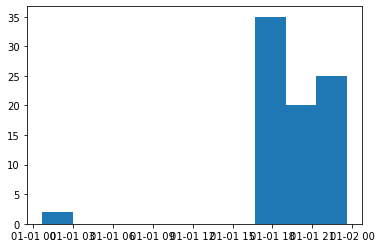

In [15]:
day_df = tweets.loc[tweets['date'] == "2023-04-08"]
plt.hist((day_df['time'].apply(lambda x: (datetime.strptime(x, "%H:%M:%S")))))





In [16]:
search_term = 'UK (Labour OR Conservative OR Parliament OR Government OR "Lib OR dems" OR "liberal OR democrats")'
#LIMIT SEEMS TO BE 1000 SEARCHES in a time frame
#extract_tweets(search_term, date(2013,4,1), date(2013,4,30), 100)


tweets = extract_tweets(search_term, date(2013,4,1), date(2014,3,31), 100)

2013-04-01
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
2013-04-02
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
2013-04-03
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this sea

[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
2013-04-21
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
2013-04-22
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
2013-04-23
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this sea

[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
2013-05-11
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
2013-05-12
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
2013-0

[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
2013-05-31
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
2013-06-01
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
[!] No

[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
2013-06-20
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
2013-06-21
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
[!] No

[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
2013-07-09
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
2013-07-10
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
[!] No

2013-07-28
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
2013-07-29
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
2013-07-30
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this sea

[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
2013-08-17
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
2013-08-18
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
2013-08-19
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this sea

[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
2013-09-04
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
2013-09-05
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
[!] No

2013-09-23
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
2013-09-24
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
2013-09-25
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this sea

[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
2013-10-13
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
2013-10-14
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
2013-10-15
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this sea

[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
2013-11-02
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
2013-11-03
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
2013-1

[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
2013-11-21
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
2013-11-22
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
[!] No

[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
2013-12-10
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
410410873551736833 2013-12-10 14:09:11 +0100 <stonewalluk> Breaking news! #UK government announces same-sex couples can begin to marry in England and Wales on March 29! #EqualMarriage
410410873551736833 2013-12-10 14:09:11 +0100 <stonewalluk> Breaking news! #UK government announces same-sex couples can begin to marry in England and Wales on March 29! #EqualMarriage
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
2013-12-11
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
[!] No more data! Scraping will stop now.
f

[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
2013-12-29
417407860524720128 2013-12-29 21:32:43 +0100 <silv24> I am a doctor, not a UK border agent. If this government want us to restrict treatment that migrants get they have a fight on their hands
417407860524720128 2013-12-29 21:32:43 +0100 <silv24> I am a doctor, not a UK border agent. If this government want us to restrict treatment that migrants get they have a fight on their hands
417407860524720128 2013-12-29 21:32:43 +0100 <silv24> I am a doctor, not a UK border agent. If this government want us to restrict treatment that migrants get they have a fight on their hands
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
2013-12-

[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
2014-01-17
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
2014-01-18
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
[!] No

[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
2014-02-06
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
2014-02-07
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
[!] No

2014-02-24
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
2014-02-25
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
2014-02-26
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this sea

[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
2014-03-16
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
2014-03-17
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
[!] No

In [17]:
tweets

,id,conversation_id,created_at,date,tweet,language,hashtags,user_id,username,name,...,nlikes,nreplies,nretweets,search,new_tweet,neg,neu,pos,compound,time
0,349867142834958336,349867142834958336,1372249801000.0,2013-06-26,"""They call him George, president calls him Jef...",en,[],5402612,BBCBreaking,BBC Breaking News,...,134,68,774,UK (Labour OR Conservative OR Parliament OR Go...,"""They call him George, president calls him Jef...",0.0,1.0,0.0,0.0,13:30:01
1,349867142834958336,349867142834958336,1372249801000.0,2013-06-26,"""They call him George, president calls him Jef...",en,[],5402612,BBCBreaking,BBC Breaking News,...,134,68,774,UK (Labour OR Conservative OR Parliament OR Go...,"""They call him George, president calls him Jef...",0.0,1.0,0.0,0.0,13:30:01
2,359207774107877376,359207774107877376,1374476781000.0,2013-07-22,And the duchess of Cambridge is in labour........,en,[],96448406,greggsulkin,Gregg Sulkin,...,275,35,228,UK (Labour OR Conservative OR Parliament OR Go...,And the duchess of Cambridge is in labour........,0.0,0.78,0.22,0.5673,08:06:21
3,359207774107877376,359207774107877376,1374476781000.0,2013-07-22,And the duchess of Cambridge is in labour........,en,[],96448406,greggsulkin,Gregg Sulkin,...,275,35,228,UK (Labour OR Conservative OR Parliament OR Go...,And the duchess of Cambridge is in labour........,0.0,0.78,0.22,0.5673,08:06:21
4,372690210233917440,372690210233917440,1377691245000.0,2013-08-28,I had a dream that Darth Vader invaded the uk ...,en,[],22479281,RattyBurvil,Arthur Darvill,...,594,104,401,UK (Labour OR Conservative OR Parliament OR Go...,I had a dream that Darth Vader invaded the uk ...,0.0,0.9,0.1,0.25,13:00:45
5,372690210233917440,372690210233917440,1377691245000.0,2013-08-28,I had a dream that Darth Vader invaded the uk ...,en,[],22479281,RattyBurvil,Arthur Darvill,...,594,104,401,UK (Labour OR Conservative OR Parliament OR Go...,I had a dream that Darth Vader invaded the uk ...,0.0,0.9,0.1,0.25,13:00:45
6,372690210233917440,372690210233917440,1377691245000.0,2013-08-28,I had a dream that Darth Vader invaded the uk ...,en,[],22479281,RattyBurvil,Arthur Darvill,...,594,104,401,UK (Labour OR Conservative OR Parliament OR Go...,I had a dream that Darth Vader invaded the uk ...,0.0,0.9,0.1,0.25,13:00:45
7,373200744415236096,373200744415236096,1377812965000.0,2013-08-29,UK Parliament votes on going to war. Congress ...,en,[],233842454,justinamash,Justin Amash,...,134,35,387,UK (Labour OR Conservative OR Parliament OR Go...,UK Parliament votes on going to war. Congress ...,0.273,0.617,0.11,-0.5719,22:49:25
8,373198955393200129,373198955393200129,1377812539000.0,2013-08-29,Well done UK Parliament. Now make Cameron get ...,en,[],22084427,robdelaney,rob delaney,...,186,25,224,UK (Labour OR Conservative OR Parliament OR Go...,Well done UK Parliament. Now make Cameron get ...,0.0,0.593,0.407,0.8625,22:42:19
9,373197211238428673,373197211238428673,1377812123000.0,2013-08-29,MPs vote against UK government motion on the p...,en,[],5402612,BBCBreaking,BBC Breaking News,...,152,159,1191,UK (Labour OR Conservative OR Parliament OR Go...,MPs vote against UK government motion on the p...,0.0,1.0,0.0,0.0,22:35:23


In [18]:
tweets_2013 = extract_tweets(search_term, date(2013,4,1), date(2014,3,31), 100)

2013-04-01
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
2013-04-02
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
2013-04-03
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this sea

[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
2013-04-21
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
2013-04-22
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
2013-04-23
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this sea

[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
2013-05-11
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
2013-05-12
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
2013-0

[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
2013-05-31
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
2013-06-01
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
[!] No

[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
2013-06-20
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
2013-06-21
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
[!] No

[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
2013-07-09
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
2013-07-10
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
2013-07-11
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this sea

[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
2013-07-29
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
2013-07-30
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
[!] No

2013-08-17
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
2013-08-18
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
2013-08-19
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this sea

[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
2013-09-03
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
2013-09-04
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
[!] No

[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
2013-09-23
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
2013-09-24
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
[!] No

2013-10-12
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
2013-10-13
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
2013-10-14
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this sea

[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
2013-11-01
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
2013-11-02
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
2013-11-03
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this sea

2013-11-20
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
2013-11-21
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
2013-11-22
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this sea

[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
2013-12-10
410410873551736833 2013-12-10 14:09:11 +0100 <stonewalluk> Breaking news! #UK government announces same-sex couples can begin to marry in England and Wales on March 29! #EqualMarriage
410410873551736833 2013-12-10 14:09:11 +0100 <stonewalluk> Breaking news! #UK government announces same-sex couples can begin to marry in England and Wales on March 29! #EqualMarriage
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
410410873551736833 2013-12-10 14:09:11 +0100 <stonewalluk> Breaking news! #UK government announces same-sex couples can begin to marry in England and Wales on March 29! #EqualMarriage
410410873551736833 2013-12-10 14:09:11 +0100 <stonewalluk> Breaking news! #UK government announces same-sex coupl

[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
2013-12-28
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
2013-12-29
417407860524720128 2013-12-29 21:32:43 +0100 <silv24> I am a doctor, not a UK border agent. If this government want us to restrict treatment that migrants get they have a fight on their hands
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
417407860524720128 2013-12-29 21:32:43 +0100 <silv24> I am a doctor, not a UK border agent. If this government want us to restrict treatment that migrants get they have a fight on their hands
417407860524720128 2013-12-

[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
2014-01-16
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
2014-01-17
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
2014-01-18
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this sea

[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
2014-02-05
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
2014-02-06
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
2014-0

[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
2014-02-24
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
2014-02-25
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
2014-02-26
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this sea

2014-03-15
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
2014-03-16
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
2014-03-17
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this sea

In [19]:
tweets_2014 = extract_tweets(search_term, date(2014,4,1), date(2015,3,31), 100)

2014-04-01
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
2014-04-02
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
2014-04-03
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this sea

[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
2014-04-20
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
2014-04-21
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
2014-0

[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
2014-05-10
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
2014-05-11
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
[!] No

2014-05-29
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
2014-05-30
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
2014-05-31
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this sea

[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
2014-06-17
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
2014-06-18
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
[!] No

2014-07-06
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
2014-07-07
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
2014-07-08
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this sea

[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
2014-07-26
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
2014-07-27
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
[!] No

2014-08-11
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
2014-08-12
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
499079200029310977 2014-08-12 07:25:28 +0100 <BBCBreaking> RAF planes dropped a second round of lifesaving aid to refugees in northern Iraq overnight, UK government confirms  http://t.co/jk3YfXr5Ct
2014-08-13
[!] No more data! Scraping will stop now

2014-08-30
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
2014-08-31
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
2014-09-01
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this sea

[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
2014-09-18
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
2014-09-19
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
512891311750651904 2014-09-19 10:09:52 +0100 <martin_compston> Good luck to Alexander a

518363113545269249 2014-10-04 12:32:51 +0100 <BBCBreaking> Killers of Alan Henning are "scum" &amp; UK government "could have done more", hostage's brother-in-law tells BBC News  http://t.co/pdVCuYIRph
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
2014-10-05
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
2014-10-06
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
519168430482939905 2014-10-06 17:52:54 +0100 <BBCBreaking> "We need ground troops" - brother of murdered IS hostage Alan Henning appeals to UK government  http://t.co/TCnuhYKPVs  http://t.co/XN1OYSucQz
5191684

[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
2014-10-20
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
2014-10-21
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
[!] No

2014-11-06
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
2014-11-07
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
2014-11-08
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this sea

[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
2014-11-26
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
2014-11-27
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
2014-11-28
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this sea

[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
2014-12-14
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
2014-12-15
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
2014-12-16
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this sea

[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
2015-01-03
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
2015-01-04
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
2015-0

[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
2015-01-21
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
2015-01-22
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
2015-01-23
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this sea

[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
563773623857868800 2015-02-06 18:58:00 +0100 <AmnestyUK> The UK government's been rumbled – spying on us was unlawful. A big step forward.  http://t.co/0xijFZn4PU #DontSpyOnUs  http://t.co/st38gkjn1p
563663413444763648 2015-02-06 11:40:04 +0100 <TheEconomist> Privately educated UK politicians : Conservative 51% Lib Dem 41% Labour 10% UKIP 100% UK av 7%  http://t.co/BWLsP2jmGL  http://t.co/uxmzpIXwb1
2015-02-07
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
2015-02-08
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
[!] No m

[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
2015-02-23
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
2015-02-24
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
[!] No

[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
2015-03-11
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
2015-03-12
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
2015-03-13
576490416167616512 2015-03-13 21:10:00 +0100 <sportrelief> The UK Government

[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
2015-03-29
582138906054955008 2015-03-29 12:15:05 +0100 <JoanneCecil> The gift that keeps giving. Katie Hopkins &amp; David Cameron. Remember folks, if labour wins she will leave the UK.     http://t.co/1nn2uNA1BJ
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
582138906054955008 2015-03-29 12:15:05 +0100 <JoanneCecil> The gift that keeps giving. Katie Hopkins &amp; David Cameron. Remember folks, if labour wins she will leave the UK.     http://t.co/1nn2uNA1BJ
582138906054955008 2015-03-29 12:15:05 +0100 <JoanneCecil> The gift that keeps giving. Katie Hopkins &amp; David Cameron. Remember folks, if labour wins she will leave the UK.   

In [20]:
tweets_2015 = extract_tweets(search_term, date(2015,4,1), date(2016,3,31), 100)

2015-04-01
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
2015-04-02
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
2015-04-03
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this sea

[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
2015-04-16
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
588806830467457027 2015-04-16 21:51:02 +0100 <DALERAIDER> Danny Alexander - "SNP should have no say in any UK Government." That statement MUST be the last nail in the coffin of Scottish libdems!
2015-04-17
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
[!] No more data! Scraping will stop now.
found 0 dele

[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
2015-04-28
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
2015-04-29
593488087851913217 2015-04-29 19:52:41 +0100 <haveigotnews> Tories release full list of people who will take UK hostage if Labour win: SNP Unions Blofeld The Hooded Claw A small kitten named Tim.
593345690983620608 2015-04-29 10:26:51 +0100 <ClientEarth> We won!! UK Supreme Court orders Government to clean up air pollution  http://t.co/67GExYk9uJ  #ce  http://t.co/o5P7wu0pRh
[!] No more data! Scraping will s

596798084887121920 2015-05-08 23:05:26 +0100 <Swamy39> Hail to UK's Conservative Party led by PM Mr. Cameron. Congrats to @NCHTUK &amp; @HinduForumGBR for contributing through Hindu vote mobilisation
596684723717537792 2015-05-08 15:34:58 +0100 <DrJosephObi> Dr Joseph Obi notes that Our Beloved Ed Miliband has Quit as UK Labour Party Leader. Professor Obi publicly wishes him All of The Very Best.
596642897824481280 2015-05-08 12:48:46 +0100 <cnnbrk> UK's Conservative Party, led by David Cameron, wins outright majority in Parliament, taking 326 of 650 seats.  http://t.co/GETKPdwDcX
596642509180174337 2015-05-08 12:47:13 +0100 <FoxNews> BREAKING: UK Conservatives win 326 seats, giving them absolute majority in Parliament #GE2015
596635226882859009 2015-05-08 12:18:17 +0100 <cnnbrk> Ed Miliband resigns as leader of UK's Labour Party following elections.  http://t.co/YY3T6aibfg  #GE2015
596624200493879296 2015-05-08 11:34:28 +0100 <BBCNewsGraphics> Number of women MPs in UK Parliament rise

597135610520969216 2015-05-09 21:26:38 +0100 <Fritz1875> Think the UK public now has it confirmed that the broadcast media is just a PR arm of government. #londonprotest
596971023666286592 2015-05-09 10:32:37 +0100 <DrJosephObi> Professor Joseph Chikelue Obi thinks Dawn Butler will be a good Deputy Leader of the UK Labour Party. Dr Obi hopes Andy Burnham is Listening
597135610520969216 2015-05-09 21:26:38 +0100 <Fritz1875> Think the UK public now has it confirmed that the broadcast media is just a PR arm of government. #londonprotest
596971023666286592 2015-05-09 10:32:37 +0100 <DrJosephObi> Professor Joseph Chikelue Obi thinks Dawn Butler will be a good Deputy Leader of the UK Labour Party. Dr Obi hopes Andy Burnham is Listening
2015-05-10
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
[!] No

[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
2015-05-19
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
600562149426122753 2015-05-19 08:22:28 +0100 <_cmatheson> When Mhairi met Lorraine! UK Parliament's youngest MP Mhairi Black on @ITVLorraine this morning. #SNP  http://t.co/5KweJY35tj
2015-05-20
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
[!] No more data! Scraping will stop now.
found 0 deleted tweets 

[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
2015-06-03
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
606173992249126913 2015-06-03 20:01:56 +0100 <BBCBreaking> Veteran left-wing MP Jeremy Corbyn enters race for leadership of the UK Labour Party  http://t.co/YBN8d8eBXG  http://t.co/CVD8oDHMNo
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
606173992249126913 2015-06-03 20:01:56 +0100 <BBCBreaking> Veteran left-wing MP Jeremy Corbyn enters race for leadership of the UK Labour Party  http://t.co/YBN8d8eBXG  http://t.co/CVD8oDHMNo
2015-06-04
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
[!] No more data! Scraping 

[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
2015-06-19
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
2015-06-20
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
2015-06-21
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this sea

[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
2015-07-08
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
2015-07-09
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
[!] No

[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
2015-07-23
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
2015-07-24
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
2015-0

[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
2015-08-05
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
2015-08-06
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
[!] No

[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
2015-08-24
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
2015-08-25
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
[!] No

[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
2015-09-06
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
2015-09-07
640900230800633856 2015-09-07 15:51:37 +0100 <JuliaHB1> If Labour really do have a problem with the UK deliberately killing a murderous ISIL terrorist, they are certifiably insane. And wrong.
640896216390352896 2015-09-07 15:35:39 +0100 <BBCBreaking

2015-09-15
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
2015-09-16
644108212258652160 2015-09-16 12:18:59 +0100 <JOE_co_uk> Corbyn firing shots in Parliament #PMQs  http://t.co/pFKBiFSqPM
644108212258652160 2015-09-16 12:18:59 +0100 <JOE_co_uk> Corbyn firing shots in Parliament #PMQs  http://t.co/pFKBiFSqPM
644108212258652160 2015-09-16 12:18:59 +0100 <JOE_co_uk> Corbyn firing shots in Parliament #PMQs  http://t.co/pFKBiFSqPM
644108212258652160 2015-09-16 12:18:59 +0100 <JOE_co_uk> Corbyn firing shots in Parliament #PMQs  http://t.co/pFKBiFSqPM
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
2015-09-

649873503282405376 2015-10-02 10:08:11 +0100 <charlottechurch> Your government ladies and gents............UK and Saudi Arabia 'in secret deal' over human rights council place  http://t.co/nVzb4f4d6a
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
649873503282405376 2015-10-02 10:08:11 +0100 <charlottechurch> Your government ladies and gents............UK and Saudi Arabia 'in secret deal' over human rights council place  http://t.co/nVzb4f4d6a
2015-10-03
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
650342997805150209 2015-10-03 17:13:48 +0100 <BBCSport> UK government join calls for Fifa president Sepp Blatter to quit.  Full story:  http://t.co/yNsVDVRYeN  http://t.co/qeloyzYKS9
650342997805150209 2015-10-03 17:13:48 +0100 <BBCSport> UK government join calls for Fifa president Sepp Blatter to quit.  Full story:  http://t.co/yNsVDVRYeN  htt

[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
2015-10-19
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
656133014250848256 2015-10-19 16:41:15 +0100 <Nigel_Farage> David Cameron's government support the UK having open borders with Turkey. Those who don't must vote to Leave the EU  https://t.co/lMo1pwKhPC
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
656133014250848256 2015-10-19 16:41:15 +0100 <Nigel_Farage> David Cameron's government support the UK having open borders with Turkey. Those who don't must vote to Leave the EU  https://t.co/lMo1pwKhPC
2015-10-20
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
[!] No 

[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
2015-11-03
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
661604239794376704 2015-11-03 18:01:57 +0100 <jimmy_wales> I would like to see Apple refuse to sell iPhone in UK if gov't bans end-to-end encryption.  Does Parliament dare be that stupid?
661604239794376704 2015-11-03 18:01:57 +0100 <jimmy_wales> I would like to see Apple refuse to sell iPhone in UK if gov't bans end-to-end encryption.  Does Parliament dare be that stupid?
661604239794376704 2015-11-03 18:01:57 +0100 <jimmy_wales> I would like to see Apple refuse to sell iPhone in UK if gov't bans end-to-end encryption.  Does Parliament dare be that stupid?
2015-11-04
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
661917789645590528 2015-11-04 14:47:53 +0100 <mehdirhasan> "I am British, Muslim, and afra

[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
2015-11-13
665168763239706625 2015-11-13 14:06:06 +0100 <RoyalFamily> The Prime Minister @PMOIndia is in the United Kingdom on an official visit as a guest of the UK Government.  https://t.co/8DQXpTbMSS
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
665168763239706625 2015-11-13 14:06:06 +0100 <RoyalFamily> The Prime Minister @PMOIndia is in the United Kingdom on an official visit as a guest of the UK Government.  https://t.co/8DQXpTbMSS
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
665168763239706625 2015-11-13 14:06:06 +0100 <RoyalFamily> The Prime Minister @PMOIndia is in the United Kingdom on an official visit as a guest of the UK Government.  https://t.co/8DQXpTbMSS
2015-11-14
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
665472460314292225 2015-11-14 10:12:53 +0100 <patcondell> If #Labour had won t

2015-11-26
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
669930840055488513 2015-11-26 17:28:53 +0100 <BBCBreaking> UK Labour leader Jeremy Corbyn is writing to his MPs to say he can't support PM's proposal for air strikes in Syria  https://t.co/C6zrWF1rOo
2015-11-27
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
2015-11-28
[!] No more data! Scraping will stop n

[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
672193198748508160 2015-12-02 23:18:41 +0100 <jackjonestv> So the UK government has authorised bombings on Syria, God protect all the innocent people that are going to be killed in the process 🙌🏻😡😡😡
672187561377406978 2015-12-02 22:56:17 +0100 <kmckenna63> Things we learned today at Westminster: UK Labour Party is dead and only option for the authentic Left in Scotland is independence
672186342261047298 2015-12-02 22:51:27 +0100 <RichardBurgon> As I promised, I campaigned and voted against the UK bombing of Syria. I am deeply, deeply depressed at Parliament's decision.
672184267577958400 2015-12-02 22:43:12 +0100 <CNDuk> A sad day for Syria &amp; sad day for democracy. Parliament ignored UK population who overwhelmingly oppose this war #SyriaVote #DontBombSyria
672182689504616448 2015-12-02 22:36:56 +0100 <_CarltonCole9> Massive shoutout to the UK government for starting World War III after Payet and Sakho

675045554322321409 2015-12-10 20:12:56 +0100 <WIRED> Petition to ban Trump from traveling to the UK is now the most popular on the government’s site  https://t.co/w0MP3aDDzY
675018555226746881 2015-12-10 18:25:39 +0100 <pdanahar> . @realDonaldTrump officially breaks the record for a petition to the UK parliament which had been 446,482 names.  https://t.co/bNeDzimQaX
675010209513938948 2015-12-10 17:52:29 +0100 <SkyNewsBreak> A petition calling for Donald Trump to be barred from entering the UK has become the most popular ever campaign on the Government's website
674880876413603840 2015-12-10 09:18:34 +0100 <AndyBurnhamGM> Yesterday I revealed how the UK security services helped make a TV programme with the aim of damaging the Labour Party. Think about that.
675045554322321409 2015-12-10 20:12:56 +0100 <WIRED> Petition to ban Trump from traveling to the UK is now the most popular on the government’s site  https://t.co/w0MP3aDDzY
675018555226746881 2015-12-10 18:25:39 +0100 <pdanahar> . 

2015-12-24
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
679942407933267968 2015-12-24 08:31:17 +0100 <BBCBreaking> UK and US government issue warnings about "possible threats against Westerners" in Beijing on or around Christmas  https://t.co/XnqmETQfAO
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
2015-12-25
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
2015-12-26
[!] No more data! Scraping will stop now

2016-01-06
684647002068660224 2016-01-06 08:05:40 +0100 <JmeBBK> Mad ting : "Block Donald J Trump from UK entry" to be discussed in parliament Jan 18th :  https://t.co/crH42Pz3ug //  https://t.co/9MtpdXycDK
684647002068660224 2016-01-06 08:05:40 +0100 <JmeBBK> Mad ting : "Block Donald J Trump from UK entry" to be discussed in parliament Jan 18th :  https://t.co/crH42Pz3ug //  https://t.co/9MtpdXycDK
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
684647002068660224 2016-01-06 08:05:40 +0100 <JmeBBK> Mad ting : "Block Donald J Trump from UK entry" to be discussed in parliament Jan 18th :  https://t.co/crH42Pz3ug //  https://t.co/9MtpdXycDK
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
2016-01-07
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
685026973513560064 2016-01-07 09:15:32 +0100 <ToryFibs> Osborne: Nov '09 "Labour wrong to say global crash caused UK recession" Osborne: Jan '16 "R

689557392200220672 2016-01-19 21:17:48 +0100 <AlexSalmond> Strongly support this campaign to end the UK government's tax credit "rape clause".  https://t.co/xObUB7dgrw
689464713382506496 2016-01-19 15:09:31 +0100 <CNN> A petition to ban @realDonaldTrump from the UK was debated in the UK's parliament Monday  https://t.co/byjBYLcvTv  https://t.co/A98K8bRH2m
689456247259561984 2016-01-19 14:35:53 +0100 <nowthisnews> Donald Trump was roasted in typical British fashion by the UK Parliament  https://t.co/3ZhLru7aOK
689305603525574657 2016-01-19 04:37:17 +0100 <notaxation> Did British Parliament seriously debate banning Donald Trump from the UK? Fucking hilarious. Yet another classic Nero fiddling moment.
2016-01-20
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
689607219445436417 2016-01-20 00:35:48 +0100 <FinnHarries> Ha! British Parliament debates whether @realDonaldTrump should be allowed to visit the UK -  https://t.co/xqfZHep42O
689607219445436417 2016-

[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
2016-02-03
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
694963714462740480 2016-02-03 19:20:35 +0100 <StewartHosieSNP> Labour abstaining on SNP amendment about delivering Smith in full &amp; committing UK Govt to no detriment  principle. Shameful!
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
694963714462740480 2016-02-03 19:20:35 +0100 <StewartHosieSNP> Labour abstaining on SNP amendment about delivering Smith in full &amp; committing UK Govt to no detriment  principle. Shameful!
694963714462740480 2016-02-03 19:20:35 +0100 <StewartHosieSNP> Labour abstaining on SNP amendment about delivering Smith in full &amp; committing UK Govt to no detriment  principle. Shameful!
2016-02-

[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
2016-02-21
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
2016-02-22
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
2016-0

2016-03-07
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
706895536465424384 2016-03-07 17:33:24 +0100 <IAMLenaHeadey> Good luck @hollidayjoe and @elaxora leading protests today outside Parliament for UK gov to announce Intersex Equality Inquiry
706895536465424384 2016-03-07 17:33:24 +0100 <IAMLenaHeadey> Good luck @hollidayjoe and @elaxora leading protests today outside Parliament for UK gov to announce Intersex Equality Inquiry
706895536465424384 2016-03-07 17:33:24 +0100 <IAMLenaHeadey> Good luck @hollidayjoe and @elaxora leading protests today outside Parliament for UK gov to announce Intersex Equality Inquiry
706895536465424384 2016-03-07 17:33:24 +0100 <IAMLenaHeadey> Good luck @hollidayjoe and @elaxora leading protests today outside Parliament for UK gov to announce Intersex Equality Inquiry
2016-03-08
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
[!] No more data! Scraping will stop now.
found 0 deleted tweets

2016-03-24
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
2016-03-25
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
2016-03-26
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
713856186223882240 2016-03-26 22:32:32 +0100 <AndyBurnhamGM> Labour reveals 

In [22]:
tweets_2016 = extract_tweets(search_term, date(2016,4,1), date(2017,3,31), 100)

2016-04-01
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
2016-04-02
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
2016-04-03
716718835131396096 2016-04-03 21:07:40 +0100 <GrayInGlasgow> UK Government, which cuts care for the poor &amp; disabled, supports a global system hiding £13 

2016-04-13
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
2016-04-14
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
720569112892678144 2016-04-14 12:07:18 +0100 <Nigel_Farage> '@jeremycorbyn doesn't think level of EU migration to UK has been too high. Labour voters who disagree should vote UKIP on May 5th.
2016-04-15
[!] No more data! Scraping will stop now.
foun

724343816505929734 2016-04-24 22:06:38 +0100 <jeremycorbyn> .@Keir_Starmer leading Labour's vote for Dubs Amendment - UK must accept 3,000 children from refugee camps in Europe  https://t.co/0ul33iA3pw
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
2016-04-25
724740966402408448 2016-04-26 00:24:46 +0100 <ShaziaAwan> Just got this email from a member of #Conservative party I have never met. Says it all. #zacgoldsmith #SadiqKhan #UK  https://t.co/T8ELUK9K7P
724539091442892800 2016-04-25 11:02:35 +0100 <jeremycorbyn> Today Labour's voting for Dubs Amendment to ensure UK accepts 3000 unaccompanied child refugees from camps in Europe  https://t.co/TfSLlywtPA
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
[!] No more data! Scraping will stop now.
found 0 deleted twe

2016-05-07
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
2016-05-08
729360858564956160 2016-05-08 18:22:34 +0100 <GMacdonaldSNP> Labour Hame - "Do we ALWAYS have to sacrifice Scotland before the interests of the UK Labour Party?"  https://t.co/xxMT3JELKl
729316513459613698 2016-05-08 15:26:21 +0100 <ForTheMany2020> UK Elections 2016: Actually, it's the Tories who lost more council seats than Labour....   https://t.co/O0X5ABfUIO
729360858564956160 2016-05-08 18:22:34 +0100 <GMacdonaldSNP> Labour Hame - "Do we ALWAYS have to sacrifice Scotland before the interests of the UK Labour Party?"  https://t.co/xxMT3JELKl
729316513459613698 201

[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
732977446203580416 2016-05-18 17:53:35 +0100 <AdamRamsay> Opening of the UK parliament; opening of the Scottish parliament. What was it we were saying about nationalism?  https://t.co/uSkZwKrDn0
732883922246307840 2016-05-18 11:41:58 +0100 <SkyNewsBreak> Queen's Speech - The Government is to introduce laws to make foreign visitors pay for the healthcare they receive from the NHS while in UK
732839580139945984 2016-05-18 08:45:46 +0100 <DanielJHannan> ‘We’re going to set out proposals to make clear that you know the UK Parliament is sovereign,’ said the PM. Now he won't, because it isn't.
732977446203580416 2016-05-18 17:53:35 +0100 <AdamRamsay> Opening of the UK parliament; opening of the Scottish parliament. What was it we were saying about nationalism?  https://t.co/uSkZwKrDn0
732883922246307840 2016-05-18 11:41:58 +0100 <SkyNewsBreak> Queen's Speech - The Government is to introduce laws to make foreign 

2016-05-31
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
2016-06-01
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
2016-06-02
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this sea

[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
742008193329549312 2016-06-12 15:58:33 +0100 <SkySportsNews> BREAKING: UK Government: We welcome UEFA's investigation into violence inside the stadium  https://t.co/kSveoontht #SSNHQ
742001047309299712 2016-06-12 15:30:10 +0100 <danroan> British Government offers to send more UK police to France ahead of England's next game in Lens following violence in Marseille
741922653473263616 2016-06-12 10:18:39 +0100 <HenrySmithUK> Leaked Foreign Office document reveals that the Government are preparing to allow 1m Turkish citizens into the UK.  https://t.co/9cbvsqGi0s
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
2016-06-13
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
[!] No more data! 

[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
2016-06-24
746381045772095488 2016-06-24 17:34:43 +0100 <benshapiro> "Can the UK survive without the EU? It's not like they have a centuries-long history of self-government or anything." -- Leftists
746365434530832384 2016-06-24 16:32:41 +0100 <jondharvey> UK gets recession Boris becomes PM Labour changes leader General Election called Public regrets Brexit Labour pledges 2nd referendum. Wins?
746365358680969216 2016-06-24 16:32:22 +0100 <SkyNewsBreak> French government spokesman says UK's decision to leave the European Union will not affect its bilateral immigration treaty with UK #EUref
746298812579348480 2016-06-24 12:07:57 +0100 <BBCBreaking> MPs table motion of no confidence in leader of UK Labour Party, Jeremy Corbyn  https://t.co/PyPABbb0Bp
746281944099528709 2016-06-24 11:00:55 +0100 <Dan_Brocklebank> All UK LGBT right

746381045772095488 2016-06-24 17:34:43 +0100 <benshapiro> "Can the UK survive without the EU? It's not like they have a centuries-long history of self-government or anything." -- Leftists
746365434530832384 2016-06-24 16:32:41 +0100 <jondharvey> UK gets recession Boris becomes PM Labour changes leader General Election called Public regrets Brexit Labour pledges 2nd referendum. Wins?
746365358680969216 2016-06-24 16:32:22 +0100 <SkyNewsBreak> French government spokesman says UK's decision to leave the European Union will not affect its bilateral immigration treaty with UK #EUref
746298812579348480 2016-06-24 12:07:57 +0100 <BBCBreaking> MPs table motion of no confidence in leader of UK Labour Party, Jeremy Corbyn  https://t.co/PyPABbb0Bp
746281944099528709 2016-06-24 11:00:55 +0100 <Dan_Brocklebank> All UK LGBT rights outside of marriage are determined by the EU Equality Bill. Terrified what this far right government will do to us now.
746269373766184960 2016-06-24 10:10:58 +0100 <faisa

2016-06-27
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
747536502205317120 2016-06-27 22:06:05 +0100 <ScotNational> Tomorrow's front page: Scottish Labour exploring a federal Scotland in UK ... how long till they back independence?  https://t.co/7fS3nG30Ng
747532494443012096 2016-06-27 21:50:09 +0100 <laura_alice24> UK job vacancies, applications currently  being accepted for:  1. football team. 2. Manager 3. Government 4. PM  #ENGICE
747520248606240772 2016-06-27 21:01:30 +0100 <MelanieLatest> Those trying to defy will of people for Brexit show brazen contempt for democracy. No surprise as they oppose sovereign UK self-government
747491049707290624 2016-06-27 19:05:28 +0100 <Peston> This government was totally obsessed with UK retaining its AAA rating after 2008 crash. So it holds EU vote &amp; we lose it in two working days
747430746286088192 2016-06-27 15:05:51 +0100 <krishgm> Could a Labour candidate promising to fight election on keeping UK in E

2016-06-29
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
748289512594374656 2016-06-29 23:58:17 +0100 <Natt> By the way, the Conservative Party just broke the UK. Any time we want to start talking about that, that would be fine.
748202227626545152 2016-06-29 18:11:26 +0100 <tarlach1> @jeremycorbyn I just joined labour to keep   you at the helm. Imagine the UK media attacking a protector of the working class. #KeepCorbyn
748146668034531328 2016-06-29 14:30:40 +0100 <theSNP> SNP MPs joined the @WASPI_Campaign at their rally outside parliament. SNP are clear, the UK Govt must act. #WASPI  https://t.co/DQSenxRwXu
748114137310502916 2016-06-29 12:21:24 +0100 <SkyNewsBreak> PM says "it is not in UK's interests" for Jeremy Corbyn to remain as leader of Labour Party saying: "For heaven's sake man, go" during PMQs
748063565802672128 2016-06-29 09:00:27 +0100 <manwhohasitall> "I think at least ONE male should throw his hat in the ring for leader of the UK Labou

2016-07-03
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
2016-07-04
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
749969032854384640 2016-07-04 15:12:05 +0100 <complex_uk> Interview: @Novelist on joining Labour, backing Corbyn and striving for greatness  https://t.co/7cNWGxormZ  https://t.co/RasMsP227F
749945240270868480 2016-07-04 13:37:33 +0100 <HackneyAbbott> Today's report from @CarersTrust finds 5 million unpaid #carers across the UK struggle for support &amp; respite. Labour is #standingupforcarers
749969032854384

2016-07-07
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
2016-07-08
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
2016-07-09
751682142304923648 2016-07-09 08:39:22 +0100 <LBCNews> There'll be no second EU referendum for the UK. The Government's officially responded to a petition sa

2016-07-16
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
754212037274787840 2016-07-16 08:12:16 +0100 <BorisJohnson> Just spoken to #Turkey foreign minister @MevlutCavusoglu. I underlined #UK support for the democratic elected government &amp; institutions
754212037274787840 2016-07-16 08:12:16 +0100 <BorisJohnson> Just spoken to #Turkey foreign minister @MevlutCavusoglu. I underlined #UK support for the democratic elected government &amp; institutions
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
2016-07-17
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
[!] No more

757669014109822976 2016-07-25 21:09:04 +0100 <das_uk> Green Party offers an electoral pact to a Jeremy Corbyn-led Labour  https://t.co/cGEeOoE5z9
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
2016-07-26
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
758001191167098880 2016-07-26 19:09:01 +0100 <chintskap> Indian Banks,Kingfisher and Government are absolutely wrong. Their man not in UK. He is in retribution serving term!  https://t.co/0iqluL5fQR
757835402518540289 2016-07-26 08:10:14 +0100 <ChukaUmunna> If a system of Proportional Representation is good enough for London, Scotland, Wales &amp; N/Ireland, it's good enough for the UK Parliament
757832495966531585 2016-07-26 07:58:41 +0100 <ToryFibs> If Labour Plotters idea of patriotism is letting US Pharma takeover UK Pharma firms, or part privatising Royal Mail, then they can keep it
[!] N

[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
762302958944063488 2016-08-07 16:02:42 +0100 <ToryFibs> Labour now have the largest membership of any socialist party in Europe &amp; they are the strongest &amp; most ethically financed party in the UK.
762302958944063488 2016-08-07 16:02:42 +0100 <ToryFibs> Labour now have the largest membership of any socialist party in Europe &amp; they are the strongest &amp; most ethically financed party in the UK.
2016-08-08
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
762730551019245569 2016-08-08 20:21:48 +0100 <GloriaDePiero> I was young Trot. In 94 I chanted Stop Blair. But he won, UK fell in love with Labour and I realised I'd been wrong  https://t.co/lMVUSGmiBP
762702958488412160 2016-08-08 18:32:10 +0100 <MYSADCAT> My cat is sad because, unlike many cats, he worries deeply about the current UK 

[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
2016-08-20
766889452832567296 2016-08-20 07:47:48 +0100 <DavidHerdson> Labour complains about May refusing to guarantee Latvians can live in the UK; Corbyn wouldn't even protect their right to live in Latvia.
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
766889452832567296 2016-08-20 07:47:48 +0100 <DavidHerdson> Labour complains about May refusing to guarantee Latvians can live in the UK; Corbyn wouldn't even protect their right to live in Latvia.
766889452832567296 2016-08-20 07:47:48 +0100 <DavidHerdson> Labour complains about May refusing to guarantee Latvians can live in the UK; Corbyn wouldn't even protect their right to live in Latvia.
[!] No more data! Scraping will stop now.
found 0 deleted tweets in thi

770376971205353472 2016-08-29 22:45:57 +0100 <JohnEdwards33> This could open up a whole new world in UK politics and take Labour to power in 2020. Seize the opportunity.  https://t.co/br9SDuuV09
770178593326526464 2016-08-29 09:37:40 +0100 <LeaveEUOfficial> .@Nigel_Farage calls on UK government not to delay Article 50 past January.  https://t.co/A2Nz4YV7hn
770376971205353472 2016-08-29 22:45:57 +0100 <JohnEdwards33> This could open up a whole new world in UK politics and take Labour to power in 2020. Seize the opportunity.  https://t.co/br9SDuuV09
770178593326526464 2016-08-29 09:37:40 +0100 <LeaveEUOfficial> .@Nigel_Farage calls on UK government not to delay Article 50 past January.  https://t.co/A2Nz4YV7hn
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
2016-08-30
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
[!] No more data! Scraping w

[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
773588595873636352 2016-09-07 19:27:48 +0100 <timfarron> The single market is vital to the UK. If Labour won't be the opposition to this Brexit Tory govt the @LibDems will  https://t.co/ulmjf7TIGP
773470020198395904 2016-09-07 11:36:37 +0100 <paulmasonnews> Theresa May's government has no effective line, or plan, for Brexit (1/5). UK's been read riot act by US, JPN and PRC at G20 Hangzou, yet...
2016-09-08
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
773984988995915777 2016-09-08 21:42:55 +0100 <jeremyforlabour> Under Jeremy, Labour is committed to guaranteeing the rights of EU nationals living in the UK #bbcqt  https://t.co/ALfykQqxA0
773984988995915777 2016-09-08 21:42:55 +0100 <jeremyforlabour> Under Jeremy, 

777957772163944448 2016-09-19 20:49:21 +0100 <jonsnowC4> Did  uk Parliament ever vote to allow UK drones to target for US bombers in Syria? Who pays the price for killing 60 govt soldiers in error?
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
2016-09-20
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
2016-09-21
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
778559871901761536 2016-09-21 12:41:53 +0100 <Leave

782277449304379392 2016-10-01 18:54:12 +0100 <Peston> .@theresa_may to announce all EU law &amp; rules to be enshrined in UK law by special act of Parliament, I've learned  https://t.co/ui2cbINZah
782162300857745408 2016-10-01 11:16:39 +0100 <TimesNow> #WATCH After US, a petition on the official UK Parliament website strongly condemns Pakistan for providing safe haven for terrorists  https://t.co/lXsW6wGBoQ
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
782277449304379392 2016-10-01 18:54:12 +0100 <Peston> .@theresa_may to announce all EU law &amp; rules to be enshrined in UK law by special act of Parliament, I've learned  https://t.co/ui2cbINZah
782162300857745408 2016-10-01 11:16:39 +0100 <TimesNow> #WATCH After US, a petition on the official UK Parliament website strongly condemns Pakistan for providing safe haven for terrorists  https://t.co/lXsW6wGBoQ
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
2016-10-02
[!] N

2016-10-07
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
2016-10-08
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
784892716526231552 2016-10-09 00:06:20 +0100 <Anna_Soubry> .@Dan__Gleeballs nobody voted to be poorer &amp; hard #Brexit would inflict great harm on UK. Parliament must debate these critical matters
784648866088022016 2016-10-08 07:57:22 +0100 <BolsoverBeast> Conservative Clowns:   Authorities say "Men &amp; women with scary faces (&amp; policies) affecting parts of the UK."   Clowns to the right of me...  h

[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
2016-10-13
786503670263222272 2016-10-13 10:47:42 +0100 <Scientists4EU> Why on earth would the government lie to the detriment of one of the UK's most productive sectors? We're global leaders in Higher Ed. #crazy  https://t.co/fq354ekBqJ
786503670263222272 2016-10-13 10:47:42 +0100 <Scientists4EU> Why on earth would the government lie to the detriment of one of the UK's most productive sectors? We're global leaders in Higher Ed. #crazy  https://t.co/fq354ekBqJ
786503670263222272 2016-10-13 10:47:42 +0100 <Scientists4EU> Why on earth would the government lie to the detriment of one of the UK's most productive sectors? We're global leaders in Higher Ed. #crazy  https://t.co/fq354ekBqJ
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
786503670263222272 2016-10-13 10:47:42 +0100 <Scientists4EU> Why 

788043881870979072 2016-10-17 16:47:57 +0100 <hapoelorient> Anti-semitism is a big problem in UK but not in Labour Party. ive been to 100+ meetings, met 1000+ people but not had any Anti-Semitic abuse
788043835700043776 2016-10-17 16:47:46 +0100 <LordStras> #IPBill Lib Dems just voted alone in Lords against Tories &amp; Labour to try to stop virtual database on all UK citizens. More to follow.
787954388757348353 2016-10-17 10:52:20 +0100 <jonsnowC4> Um...."We recognise that because of the sovereignty of Parliament, referendums cannot be legally binding in the UK"  https://t.co/6D0kxOM4Dv
788043881870979072 2016-10-17 16:47:57 +0100 <hapoelorient> Anti-semitism is a big problem in UK but not in Labour Party. ive been to 100+ meetings, met 1000+ people but not had any Anti-Semitic abuse
788043835700043776 2016-10-17 16:47:46 +0100 <LordStras> #IPBill Lib Dems just voted alone in Lords against Tories &amp; Labour to try to stop virtual database on all UK citizens. More to follow.
78795438

790900184322629632 2016-10-25 13:57:52 +0100 <CarolineLucas> My challenge to the Government: how can this disastrous #Heathrow plan possibly fit with the UK's climate change obligations? #NoNewRunways  https://t.co/Lrzvfiet6h
790864408608141312 2016-10-25 11:35:43 +0100 <BBCBreaking> Third runway at Heathrow airport given go-ahead 'in major boost for the UK economy', government says  https://t.co/MvHazARkRk
790863156415520768 2016-10-25 11:30:44 +0100 <BBCBreaking> UK government approves decision for third runway at #Heathrow Airport  https://t.co/HbuCQLFcnt  https://t.co/dQ7H8jFVPF
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
790900184322629632 2016-10-25 13:57:52 +0100 <CarolineLucas> My challenge to the Government: how can this disastrous #Heathrow plan possibly fit with the UK's climate change obligations? #NoNewRunways  https://t.co/Lrzvfiet6h
790864408608141312 2016-10-25 11:35:43 +0100 <BBCBreaking> Third runway at Heathrow airport given go-ah

794212875904712704 2016-11-03 16:21:20 +0100 <TechnicallyRon> The rejected petitions on the UK government website are amazing  https://t.co/b83Esky9Ji
794182578475565056 2016-11-03 14:20:56 +0100 <guyverhofstadt> Important UK Parliament is closely involved in #Brexit negotiations, as is already the case for @Europarl_EN
794175549891637248 2016-11-03 13:53:00 +0100 <iainmartin1> UK voted to leave EU. Number of ways to do it + no consensus on how. Of course Parliament should scrutinise/approve process. That's its job.
794151295330422785 2016-11-03 12:16:38 +0100 <jonsnowC4> The Uk's judiciary prove their independence from Government: A treasured element of our constitution: Long may it sustain.
794139376469110784 2016-11-03 11:29:16 +0100 <davey> Brexiteers: "UK courts for UK laws!" UK High Court: "Brexit must follow UK law and go to parliament." Brexiteers: "We didn't mean that law!"
794134693729796096 2016-11-03 11:10:39 +0100 <richardbranson> Parliament must vote on the UK starting Br

794955254223794178 2016-11-05 17:31:16 +0100 <faisalislam> Labour's Starmer says keep UK "in customs union" as well as full single mkt access, as part of "national interest"  https://t.co/X0YhOQybTg
794950278932004865 2016-11-05 17:11:30 +0100 <DavidHeadViews> Everyone's talking about @trussliz being palpably out of her depth. But what about addled #TheresaMay? UK government hopelessly adrift.
794889884184014849 2016-11-05 13:11:31 +0100 <NickCohen4> If Corbyn were the decent man he claims to be, he'd resign.. UK is in crisis but Labour has nothing to say and no audience to say it to.
794955254223794178 2016-11-05 17:31:16 +0100 <faisalislam> Labour's Starmer says keep UK "in customs union" as well as full single mkt access, as part of "national interest"  https://t.co/X0YhOQybTg
794950278932004865 2016-11-05 17:11:30 +0100 <DavidHeadViews> Everyone's talking about @trussliz being palpably out of her depth. But what about addled #TheresaMay? UK government hopelessly adrift.
79488988418

[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
797156865276866560 2016-11-11 19:19:41 +0100 <richardosman> If Labour or the Democrats fielded a candidate who was smart but also genuinely funny they would win the next UK or US election.
797111984315568128 2016-11-11 16:21:21 +0100 <UKYP> BREAKING: UK Youth Parliament to campaign on #votesat16 and a 'curriculum for life'. #UKYPHoC  https://t.co/fv1gCyXcEB
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
2016-11-12
797584614005112833 2016-11-12 23:39:25 +0100 <IsabelOakeshott> The picture that proves the "Bad Boys of Brexit" are rather better connected with America's next President than anyone in the UK government  https://t.co/PbPsdp0tVL
797437991690104833 2016-11-12 13:56:47 +0100 <jonsnowC4> UK Government refuses to meet 27 other EU Foreign Ministers to discuss Trump's election: thereby pres

798664624346464256 2016-11-15 23:10:59 +0100 <KeithBrownSNP> Oh dear, now Murdo says UK Gov shouldn't disclose their 'plan', but Scottish Government must produce detailed plan for them. Not a good day.
798640304178003968 2016-11-15 21:34:21 +0100 <ScotNational> Tomorrow's front page: Labour's Brexit betrayal ... UK party won't oppose hard Brexit and Scottish branch abstains on the single market  https://t.co/JgMh4BT0jJ
798636860780052480 2016-11-15 21:20:40 +0100 <andrewspoooner> There are 16,141,241 members of the corporate elite in the UK. That includes 60% of Labour voters. Who are all corporate elite.  https://t.co/uYT9zE0QoS
798577683986874368 2016-11-15 17:25:31 +0100 <Scientists4EU> #Labour to back Brexit, open UK to trade deal with right-wing US, undercutting UK protections, standards and workers. Yup, irony *is* dead.  https://t.co/nRtIcTP9fw
798552151907827712 2016-11-15 15:44:04 +0100 <GeorgeMonbiot> It was only a matter of time before UK government ministers started explain

[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
800072330059780096 2016-11-19 20:24:42 +0100 <mattholehouse> UK govt submits to the Supreme Court that they can hit Article 50 without Parliament because it was on the leaflet  https://t.co/e0M7O5ffis
800060104276115456 2016-11-19 19:36:07 +0100 <timfarron> We cannot standby as these horrors unfold. UK government must urgently help civilians.  https://t.co/LHQ3HI76fH
800035917645770753 2016-11-19 18:00:01 +0100 <dawkosgames> "The UK government can now hack into phones and invade privacy of security reasons"  Me:  https://t.co/JQ94dog8rG
800023106865594368 2016-11-19 17:09:07 +0100 <thehill> Leader of UK's Labour Party: Trump a 'rich white man' faking anti-elitism  https://t.co/7BGLiNZz0M  https://t.co/bqaR3o4rwJ
800072330059780096 2016-11-19 20:24:42 +0100 <mattholehouse> UK govt submits to the Supreme Court that they can hit Article 50 without Parliament because it was on the leaflet  https://t.co/e0M7O5f

802537280216989696 2016-11-26 15:39:32 +0100 <Complex> The UK passed a law that will allow the government to access peoples' web browsing history.  https://t.co/EfPkYcDmmu  https://t.co/rncRjQpPDV
802537280216989696 2016-11-26 15:39:32 +0100 <Complex> The UK passed a law that will allow the government to access peoples' web browsing history.  https://t.co/EfPkYcDmmu  https://t.co/rncRjQpPDV
2016-11-27
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
2016-11-28
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
80335093058228224

[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
805561377956003840 2016-12-04 23:56:13 +0100 <JamesHarkin> Austrian election, Italian referendum, UK government anti-leak document leaked. It's a bad week to no longer be making a topical TV show!
2016-12-05
805689016599330820 2016-12-05 08:23:25 +0100 <davidschneider> Brexiters, Jun 2016 "Let's take back control of our laws and make UK parliament sovereign"  Dec 2016 "Let's do the opposite"  #SupremeCourt
805689016599330820 2016-12-05 08:23:25 +0100 <davidschneider> Brexiters, Jun 2016 "Let's take back control of our laws and make UK parliament sovereign"  Dec 2016 "Let's do the opposite"  #SupremeCourt
805689016599330820 2016-12-05 08:23:25 +0100 <davidschneider> Brexiters, Jun 2016 "Let's take back control of our laws and make UK parliament sovereign"  Dec 2016 "Let's do the opposite"  #SupremeCourt
805689016599330820 2016-

808788034439225344 2016-12-13 21:37:48 +0100 <JamesMelville> I am ashamed of the UK government. On many levels, they have failed to address the atrocities &amp; humanitarian disaster in Syria.  #Aleppo
808686996914896897 2016-12-13 14:56:19 +0100 <acgrayling> If Labour were a real opposition fighting in the UK's real interests, it would oppose #Brexit.  https://t.co/KZrKwizM20
808466941434359808 2016-12-13 00:21:54 +0100 <ggreenwald> A call for "precision bombing raids" by US against Russia, from a former UK Parliament member. To show them who is "alpha."  https://t.co/qfQgLiPbnU
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
2016-12-14
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this searc

[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
2016-12-22
812031276375048196 2016-12-22 20:25:17 +0100 <jeremycorbyn> I raised Al-Nimr's case with PM &amp; at Labour's 2015 conference. Saudi is a UK ally. It would be disgraceful if we don't try to save his life  https://t.co/YO5hocWqbk
811919225015005185 2016-12-22 13:00:02 +0100 <BJP4India> Modi government crosses a significant economic landmark. India’s economy will be larger than UK’s for the first time in more than 100 years.  https://t.co/PUlKmWuVoI
811903941692768256 2016-12-22 11:59:18 +0100 <haveigotnews> Government makes funds available to bring faster broadband to most isolated parts of UK, starting with Jeremy Corbyn's office.
812031276375048196 2016-12-22 20:25:17 +0100 <jeremycorbyn> I raised Al-Nimr's case with PM &amp; at Labour

814810839765188608 2016-12-30 12:30:17 +0100 <Change_Britain> This year the UK voted to leave the European Union. RT if you agree that the Government should implement the result! #ChangeBritain  https://t.co/dDakULDFbv
814765108933050368 2016-12-30 09:28:34 +0100 <carlbildt> UK government seems to plan to join Belarus outside European Convention on Human Rights. An extremely bad move.  https://t.co/xHYkC2lKH2
814707965378826240 2016-12-30 05:41:30 +0100 <TheSafestSpace> UK government study finds that poor white children are the LEAST likely to attend university.  When will all this white privilege end?  https://t.co/NqxDDdISC0
2016-12-31
815293662410182656 2016-12-31 20:28:51 +0100 <DavidStubley> UK Government outlaws looking at the sky without a permit. #news  https://t.co/ppTXvFjcpb
815293662410182656 2016-12-31 20:28:51 +0100 <DavidStubley> UK Government outlaws looking at the sky without a permit. #news  https://t.co/ppTXvFjcpb
[!] No more data! Scraping will stop now.
found 0 dele

[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
817502969230921730 2017-01-06 22:47:50 +0100 <DavidGWrigley> In some countries the use of a humanitarian agency to prop up their once great health service would see the government fall. UK people???  https://t.co/Twcnia9cym
817502969230921730 2017-01-06 22:47:50 +0100 <DavidGWrigley> In some countries the use of a humanitarian agency to prop up their once great health service would see the government fall. UK people???  https://t.co/Twcnia9cym
2017-01-07
817875613432344576 2017-01-07 23:28:36 +0100 <georgegalloway> The PM now has clear evidence that a foreign govt in league with their agents in parliament are a conspiracy against her government and UK
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
8178756134323445

[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
2017-01-16
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
821063216696586242 2017-01-16 18:35:00 +0100 <DavidHeadViews> Tomorrow, expect #TheresaMay to show the world what a small-minded, insular &amp; clueless government the UK has. #brexitshambles
820934839171944448 2017-01-16 10:04:52 +0100 <sjwrenlewis> He is not stupid. He knows UK government will be desperate for a trade deal post Brexit, and so the US can pretty well dictate terms.  https://t.co/UNrqu9hvIB
820921555958059008 2017-01-16 09:12:05 +0100 <BDStanley> This man is paid to represent us in the European Parliament, and he thinks the UK is in Schengen.  https://t.co/AKgEGmTcJc
820877575731998721 2017-01-16 06:17:19 +0100 <carryonkeith> On one side a UK Government desperate to do a deal; on the other a U.S. Leader delighted to expl

822930053268905984 2017-01-21 22:13:08 +0100 <ChukaUmunna> Myself &amp; over 40 Labour MPs oppose Theresa's plans to turn the UK into a giant tax haven and Europe's sweatshop  https://t.co/c9moLkgn97
822930053268905984 2017-01-21 22:13:08 +0100 <ChukaUmunna> Myself &amp; over 40 Labour MPs oppose Theresa's plans to turn the UK into a giant tax haven and Europe's sweatshop  https://t.co/c9moLkgn97
2017-01-22
823097033997291520 2017-01-22 09:16:39 +0100 <ChukaUmunna> Labour MPs will fight tooth and nail against Tory plans to turn the UK into a giant tax haven and Europe's sweatshop  https://t.co/e6eXcrWRiS
823097033997291520 2017-01-22 09:16:39 +0100 <ChukaUmunna> Labour MPs will fight tooth and nail against Tory plans to turn the UK into a giant tax haven and Europe's sweatshop  https://t.co/e6eXcrWRiS
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
[!] No more data! Scrapin

824008881445572608 2017-01-24 21:40:01 +0100 <LouDobbs> UK elites stall Brexit – PM Theresa May taking the fight to Parliament. @SteveHiltonx joins #Dobbs FBN7p
823993027689639937 2017-01-24 20:37:01 +0100 <GerryHassan> Surely this is the day the music died re: the UK. Scotland's Parliament &amp; popular will can be ignored. Grim day for thoughtful unionists.
823970912622039042 2017-01-24 19:09:08 +0100 <AngusRobertson> Why would a UK Prime Minister turn down the honour of addressing the national parliament of one of our most important partners? #Brexit  https://t.co/FsRez41KWA
823922582852370433 2017-01-24 15:57:06 +0100 <LouDobbs> Elites Still Rule UK: High  court ruling threatens to delay Brexit; government vows to stay on track |  https://t.co/O6eyCG0vaD #MAGA #Dobbs
823906957908123648 2017-01-24 14:55:00 +0100 <CNN> Britain's Supreme Court rules UK government must hold vote in parliament before beginning process of leaving the EU  https://t.co/naYuxk7Yp3
823865768945258497 2017-01

[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
2017-01-26
824758045251076096 2017-01-26 23:16:55 +0100 <theSNP> On an issue as big as Brexit, the UK government's bill on #Article50 is a page long. That is unacceptable. #bbcqt  https://t.co/dbGOzQtxnP
824639893406183424 2017-01-26 15:27:26 +0100 <PeteWishart> Labour imposing a 3 line whip to take the UK out of the European Union. Just think about that for a moment....
824624184684900352 2017-01-26 14:25:01 +0100 <DavidDjward> Recalling proudly the 69 MPs including late leader John Smith who in '71 defied Labour party whip &amp; voted for UK to join European Community!  https://t.co/wjqjHnqvSF
824615671661264896 2017-01-26 13:51:11 +0100 <ChukaUmunna> We live in a democracy not a dictatorship so its wrong for govt to muzzle the voice of the people in Parliament on how the UK leaves the EU  https://t.co/l23H38g3hp
824758045251076096 2017-01-26 23:16:55 +0100 <theSNP> On an issue as big as Brexit, the UK g

[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
2017-01-31
826564570483417089 2017-01-31 22:55:25 +0100 <WilDonnelly> Theresa May in trouble over Trump's UK state visit invite. Anger in parliament, protests outside 10 Downing St &amp; 1.6 million sign petition.  https://t.co/n4LXMiZcPZ
826561113013751809 2017-01-31 22:41:40 +0100 <CNN> Things got heated when British Parliament discussed President Trump's state visit to the UK  https://t.co/r1UsvRXpnl  https://t.co/pQTaLXtj50
826556764753625088 2017-01-31 22:24:24 +0100 <YourAnonCentral> Members of the UK Parliament openly condemn US #Trump regime. #BDStheUS  https://t.co/yY5lr3k8tl
826540358473498625 2017-01-31 21:19:12 +0100 <cnni> Things got heated when British Parliament discussed Trump's state visit to the UK  https://t.co/qHN7VyrDhl  https://t.co/HDo9WzaeQ9
826527511429345284 2017-01-31 20:28:09 +0100 <MichaelRapaport> These ain't actors &amp; this ain't photoshopped. UK Parliament goes Hard Body K

2017-02-01
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
826918630600343553 2017-02-01 22:22:19 +0100 <sueperkins> 'The UK public elects Members of Parliament (MPs) to represent their interests and concerns in the House of Commons'  https://t.co/G3a7KULBVI
826885140072652803 2017-02-01 20:09:14 +0100 <williamcraddick> Breaking: UK Parliament overwhelmingly authorizes Theresa May to trigger Article 50 and withdraw from the EU   https://t.co/PnEmkHj5Su
826883208260247557 2017-02-01 20:01:34 +0100 <BrexitBin> When a former deputy PM of the UK says in parliament "This bill is a catastrophe for the UK but I will vote for it", democracy is dead.
826761093263540224 2017-02-01 11:56:19 +0100 <ToryFibs> If LabourMPs resign on article 50 vote UK Press will smear Labour as divided &amp; disrespecting Brexit. We'll lose Copeland (62%) &amp; Stoke (70%)
826732381948223488 2017-02-01 10:02:14 +0100 <johnredwood> UK voters decided to take back control. They decided 

[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
828742417293651969 2017-02-06 23:09:24 +0100 <sjredmond> UK Parliament doesn't want to hear Trump. His supporters don't care about the rest of the world, but they will soon.
828740823416049664 2017-02-06 23:03:04 +0100 <nowthisnews> The UK's Parliament just shredded President Trump  https://t.co/aVQPK2dacf
828740580368736257 2017-02-06 23:02:06 +0100 <JoyceCarolOates> Is this embarrassing?  President of our country barred from UK Parliament for racism....  https://t.co/JwIVZBoB81
828740111835754496 2017-02-06 23:00:14 +0100 <politico> The Speaker of the House of Commons in the UK Parliament says @realDonaldTrump is not welcome  https://t.co/Upp6XGf9m3  https://t.co/YWJdi3ToN8
828737859083464704 2017-02-06 22:51:17 +0100 <maddenifico> Bravo House of Commons, Speaker John Bercow! Lunatic bigot Trump will be denied the 'honor' to

[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
2017-02-08
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
829476669102706690 2017-02-08 23:47:03 +0100 <pastels_the> Absolutely ashamed of what the UK has become. Too selfish to help others and too thick to help ourselves. Evil government, crap opposition.
829448219281092608 2017-02-08 21:54:00 +0100 <Niaccurshi> Never been a member of a party. Just joined @LibDems. Next GE will be on type of UK we want, and can't trust Labour or Tories to deliver it.
829446940454682624 2017-02-08 21:48:55 +0100 <callum_mccaig> Even children fleeing war are not welcome here according to the UK government. Let that sink in.  https://t.co/P8TUnMWEt7
829

[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
830766582146224130 2017-02-12 13:12:42 +0100 <wikileaks> UK government shuts down over 3000 Iraq torture and abuse cases  https://t.co/D83vYW2jkf  See WikiLeaks records:  https://t.co/rTDWB2fj8X
830749481356423168 2017-02-12 12:04:45 +0100 <ggreenwald> UK Government looking to take an already-oppressive country for press freedoms and make it significantly worse  https://t.co/k1xuiAo96y
830748864374247424 2017-02-12 12:02:18 +0100 <Mike_P_Williams> @realDonaldTrump Even the UK can't fucking stand you. Your sexism &amp; racism isn't welcome in Parliament either. Cue a meltdown in 3, 2, 1...  https://t.co/WkJHyG4NDz
2017-02-13
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
[!] No more data! Scraping will stop now.
fo

833382538865315841 2017-02-19 18:27:35 +0100 <afneil> Kraft has withdrawn its multi-billion pound offer for Unilever. There will be much relief in UK government. And Dutch.
833376270041939969 2017-02-19 18:02:40 +0100 <AltStateDpt> RT- Tomorrow at 11:30am, @cspan to air UK Parliament debating whether Trump should get a UK state visit. More than 1.8M Brits oppose visit.
833364339868434432 2017-02-19 17:15:16 +0100 <Rob_Kimbell> The UK government MUST step in and STOP this nonsense. Councils should not be able to ban the NATION'S flag.  https://t.co/Hv2cKPgvPD
833321974663409665 2017-02-19 14:26:55 +0100 <SalmaYaqoob> Thousands gathering at 6pm,Mon 20th Feb at Parliament as #Trump UK visit debated-Join a @UKStopTrump rally near you!  https://t.co/oCbd6IATlC
2017-02-20
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
833812226192478208 2017-02-20 22:55:00 +0100 <FoxNews> UK Conservative MPs back Trump visit in fiery parliament debate   https://t.co/IOMnqKdN

833812226192478208 2017-02-20 22:55:00 +0100 <FoxNews> UK Conservative MPs back Trump visit in fiery parliament debate   https://t.co/IOMnqKdNk2 via @AdamShawNY  https://t.co/jcihAv1xwa
833802879743959044 2017-02-20 22:17:52 +0100 <altNOAA> Dear #UK Parliament: please keep in-mind that Trump lost the majority vote by more than 3 million votes! He has no mandate in USA. #resist
833799025740627968 2017-02-20 22:02:33 +0100 <altNOAA> In UK Parliament, Trump was called "a petulant child". I'd like to expand, "A petulant child who couldn't organize a piss-up in a brewery".
833794564947320833 2017-02-20 21:44:50 +0100 <WilDonnelly> In symbolic debate in UK parliament today, Trump was referred to as a petulant child &amp; his racism &amp; sexism attacked  https://t.co/N5Oo9vqFIU
833794494168449025 2017-02-20 21:44:33 +0100 <Billbrowder> The Economist gets it exactly right in calling on the UK to pass the Magnitsky Act tomorrow in Parliament   https://t.co/QcT6bQY8bj
833782799295455232 2017-02

[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
834096640474697729 2017-02-21 17:45:10 +0100 <cabinetofficeuk> Baroness Evelyn Sharp was the first woman to reach the highest executive position in the UK government. #WomeninGovernment  https://t.co/X8T2wGXnxJ
834075716434145284 2017-02-21 16:22:01 +0100 <BiancaJagger> A great picture of yesterday rally to #StopTrump visit to the UK at Parliament Square #TrumpBan #Trump  https://t.co/sJSIPUAl4y  https://t.co/BAa414xctR
834003388006273024 2017-02-21 11:34:37 +0100 <Blue______Wave> Members of Parliament of all parties demand that 'disgusting' Trump's trip to UK be cancelled. Russia's the only place where he's welcome!
833975364342923264 2017-02-21 09:43:16 +0100 <ajplus> Earlier, we said the UK Parliament voted against a state visit by President Trump.  There was a debate but no vote. We apologize.
833934294376538113 2017-02-21

837078774105571329 2017-03-01 23:15:06 +0100 <SebDance> The Government accused MEPs who raised the plight of 3m EU27 citizens in the UK as engaging in "political pointscoring". This was my reply.  https://t.co/th7fQp1gkU
837064063821606912 2017-03-01 22:16:39 +0100 <ToryFibs> The UK Press. They went after Gordon Brown's kids. They besmirched Ed Miliband's father. The Labour movement can only beat them if we unite.
837051980342259728 2017-03-01 21:28:38 +0100 <guardian> Lords demand government guarantees rights of EU citizens in the UK – video  https://t.co/fUGR1LwEoi
837044333723414540 2017-03-01 20:58:15 +0100 <LeaveEUOfficial> These unpatriotic elites have damaged the position of UK nationals in EU by attempting to tie the government's hand. Time to shut them down!
837037258913914880 2017-03-01 20:30:08 +0100 <Channel4News> Lord Tebbit says the Government should be more concerned about its own citizens after Brexit, not those from EU countries living in the UK  https://t.co/eHIZCWmKn

837078774105571329 2017-03-01 23:15:06 +0100 <SebDance> The Government accused MEPs who raised the plight of 3m EU27 citizens in the UK as engaging in "political pointscoring". This was my reply.  https://t.co/th7fQp1gkU
837064063821606912 2017-03-01 22:16:39 +0100 <ToryFibs> The UK Press. They went after Gordon Brown's kids. They besmirched Ed Miliband's father. The Labour movement can only beat them if we unite.
837051980342259728 2017-03-01 21:28:38 +0100 <guardian> Lords demand government guarantees rights of EU citizens in the UK – video  https://t.co/fUGR1LwEoi
837044333723414540 2017-03-01 20:58:15 +0100 <LeaveEUOfficial> These unpatriotic elites have damaged the position of UK nationals in EU by attempting to tie the government's hand. Time to shut them down!
837037258913914880 2017-03-01 20:30:08 +0100 <Channel4News> Lord Tebbit says the Government should be more concerned about its own citizens after Brexit, not those from EU countries living in the UK  https://t.co/eHIZCWmKn

839540768759037960 2017-03-08 18:18:11 +0100 <Peter_Henley> Correspondence proves Surrey MPs thought Government had £40m "hidden under the sofa" to help out their largest UK Tory Party  https://t.co/0wt724Iq0s
839480337210040320 2017-03-08 14:18:03 +0100 <ajplus> The UK Parliament debated whether companies should be allowed to require women to wear heels.  https://t.co/ZgSSbCbFeC
839469015919702016 2017-03-08 13:33:04 +0100 <BBCNews> On #InternationalWomensDay, UK government pledges more money to support women   https://t.co/LykjWrXCC0 #Budget2017  https://t.co/Aldq54JPdO
839384855548997633 2017-03-08 07:58:39 +0100 <campbellclaret> Heseltine spot on about the absurdity of govt trying to sideline UK Parliament on Brexit deal when every other EU Parliament has a say
839540768759037960 2017-03-08 18:18:11 +0100 <Peter_Henley> Correspondence proves Surrey MPs thought Government had £40m "hidden under the sofa" to help out their largest UK Tory Party  https://t.co/0wt724Iq0s
83948033721004

2017-03-14
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
841695453246701568 2017-03-14 17:00:08 +0100 <johnmcdonnellMP> It is a disgrace that last night the Government again refused to guarantee the rights of EU citizens, who have made their lives in the UK.  https://t.co/dghZgVThFX
841588950858891264 2017-03-14 09:56:56 +0100 <marcuschown> How did the UK get a government with so little common sense, competence or basic human kindness?
841511709097484288 2017-03-14 04:50:00 +0100 <FoxNews> UK Parliament gives government power to begin Brexit  https://t.co/yLEVRF8kc6 #FOXNewsWorld  https://t.co/X3fAndPzE5
841509279236472832 2017-03-14 04:40:21 +0100 <DaveKeating> What irony: UK complaint about EU was that it is "undemocratic". But every parliament in EU will get a vote on final Brexit deal...e

842515648789995520 2017-03-16 23:19:18 +0100 <bbcquestiontime> Matthew Parris says that the UK government should not deny the Scottish people a second independence referendum if they want one #bbcqt  https://t.co/M0Kh4AeaP9
842497779150835713 2017-03-16 22:08:18 +0100 <ronaldopatrizio> On the day Scotland is rebuffed by UK PM one (conservative) Italian paper devotes a special edition to us as 'the hope of Europe'  https://t.co/Emv4tO49r0
842465533031141377 2017-03-16 20:00:09 +0100 <theSNP> RT if you agree with @RuthDavidsonMSP: the UK government shouldn't block #ScotRef.   ✍️ Sign the pledge today:  https://t.co/1bMMI5Nb95  https://t.co/k8AzDzUyZx
842456111521374210 2017-03-16 19:22:43 +0100 <ericjoyce> Scotland. Is the UK government really arguing against the mandate provided by a parliamentary vote?
842442125321068545 2017-03-16 18:27:09 +0100 <BBCScotlandNews> .@NicolaSturgeon says it would be "almost anti-democratic" for UK government to seek to block "democratic will of the Scott

[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
843962558390460416 2017-03-20 23:08:48 +0100 <PrisonPlanet> Most 18-24 year olds are conservative even in the UK!  I said conservatism was the new counter-culture, and they all laughed. 😄  https://t.co/nZDEdS0Lal
843828567565893632 2017-03-20 14:16:22 +0100 <AlynSmith> *cough* Scotland *cough*. The UK government is going backwards on onshore wind, we can farm the very air itself.  https://t.co/RhRUOaA6ko
843823863154774016 2017-03-20 13:57:41 +0100 <MrJohnNicolson> Extraordinary. The UK Government didn't tell the Scottish Government article 50 was being triggered.  #ScotRef  https://t.co/yNTykjIAPz
843802151742836736 2017-03-20 12:31:24 +0100 <AlynSmith> Scottish, Welsh, NI governments hearing about Article 50 trigger date from BBC! UK government arrogance only matched by ineptitude.  https://t.co/fpfpQvOsxC
843962558390460416 2017-03-20 23:08:48 +0100 <PrisonPlanet> Most 18-24 year olds are conservative e

844690876081360897 2017-03-22 23:22:53 +0100 <cnni> Buildings in Birmingham, UK, and Tel Aviv, Israel, light up in tribute to the victims of the UK Parliament attack  https://t.co/p9gy2qO3fv  https://t.co/xy0CSaQQTo
844690875145969666 2017-03-22 23:22:52 +0100 <CNN> Buildings in Birmingham, UK, and Tel Aviv, Israel, light up in tribute to the victims of the UK Parliament attack  https://t.co/C0vpYJkD90  https://t.co/VLsr6vV5cP
844690157185982465 2017-03-22 23:20:01 +0100 <CNN> Donald Trump Jr. criticizes the mayor of London after the attack near UK Parliament  https://t.co/XsoOmINLg8  https://t.co/TJLThwcBvz
844685742290952192 2017-03-22 23:02:29 +0100 <cnnbrk> Four are now dead, police say, and 40 injured by assailant in earlier attack near UK Parliament.  https://t.co/J2hM7hsaMG  https://t.co/vjziBkTGcy
844684263387795457 2017-03-22 22:56:36 +0100 <CNN> 3 members of public and an officer were killed in attack near UK Parliament, authorities say  https://t.co/VaA7aYxa7Q  https://t.co/

2017-03-24
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
845183515830321153 2017-03-24 08:00:27 +0100 <CNN> #WeAreNotAfraid: London tube signs go viral after attack near UK Parliament  https://t.co/13f6r7r0q6  https://t.co/iDJNxWw4Du
845183514949537793 2017-03-24 08:00:27 +0100 <cnni> #WeAreNotAfraid: London tube signs go viral after attack near UK Parliament  https://t.co/OUD0tJTAtS  https://t.co/OVoTUT0F1X
845151503719411714 2017-03-24 05:53:15 +0100 <CNN> "We are not afraid": Carrying on and facing down fear the day after the attack near UK Parliament  https://t.co/6fYl3dfDqd  https://t.co/7DcD2fVg7z
845114453024694272 2017-03-24 03:26:01 +0100 <CNN> Berlin's Brandenburg Gate was illuminated with an image of the British flag after the attack near UK Parliament  https://t.co/OgCiWJchmJ  https://t.co/Nn5QDBENHJ
845112110422085632 2017-03-24 03:16:43 +0100 <CNN> People in

846491741360402432 2017-03-27 23:38:52 +0100 <timfarron> This from a sensible Conservative.  There are still some in the UK.  Your party has left you. It's time for you to leave it.  https://t.co/4nbsEJYwM7
846464869645856770 2017-03-27 21:52:06 +0100 <theSNP> The UK government are pushing forward with triggering #Article50 &amp; a hard Brexit with only the support of one Scottish MP. #bbcqt  https://t.co/4YfqY4IRLi
846461841547169793 2017-03-27 21:40:04 +0100 <theSNP> .@AlexSalmond: "The attitude from the UK government towards the devolved administrations on Brexit has been nothing but contemptuous" #bbcqt
846438606671634432 2017-03-27 20:07:44 +0100 <MaximeBernier> The US and the UK have stood up against these UN bureaucrats. A Cdn government led by me would do the same   https://t.co/XCGtmJViQ4 /2  https://t.co/xjfJ5ct3g0
846395160233758721 2017-03-27 17:15:06 +0100 <LeaveEUOfficial> Security services: 400+ former fighters have returned from Mosul to UK.   Why were they allowed back

846775704209543168 2017-03-28 18:27:14 +0100 <jammach> The brilliance of @NicolaSturgeon’s strategy play today on #Brexit, #ScotRef forcing scrutiny onto the UK Government. Superb.  https://t.co/agCVeGMyw0
846768890759843840 2017-03-28 18:00:10 +0100 <JamieRoss7> So to summarise the UK this week:  – N Ireland has no government – Scotland has voted for another referendum – Article 50 triggered tomorrow
846764819327995908 2017-03-28 17:43:59 +0100 <David_Jamieson7> It's simple. If UK gov now blocks #ScotRef, they are blocking not #SNP but the Scottish Parliament. If they do that, they abandon democracy.
846764352602587136 2017-03-28 17:42:08 +0100 <STVNews> The UK Government has ruled out Nicola Sturgeon's indyref2 plans just 7 mins after Holyrood backed it  https://t.co/HfT0FqZMIv  https://t.co/Qa97CxZc0k
846759919823044608 2017-03-28 17:24:31 +0100 <ScotGovFM> Scottish Parliament has mandated @scotgov to hold formal talks with UK Gov on call for an independence referendum   https://t.c

In [24]:
tweets_2017 = extract_tweets(search_term, date(2017,4,1), date(2018,3,31), 100)

2017-04-01
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
848192197115695105 2017-04-01 16:15:53 +0100 <alexmassie> Paul Mason: Labour can return to UK power by backing Scots independence. Sentient Human Being: How would that work? PM: Reasons, comrade.
848047223548071937 2017-04-01 06:39:48 +0100 <JamesMelville> UK government announces a commemorative "celebration of Britain and EU" design for the Union Jack. It will be called European Union Jack.  https://t.co/a0PeaNpeFe
848192197115695105 2017-04-01 16:15:53 +0100 <alexmassie> Paul Mason: Labour can return to UK power by backing Scots independence. Sentient Human Being: How would that work? PM: Reasons, comrade.
848047223548071937 2017-04-01 06:39:48 +0100 <JamesMelville> UK government announces a commemorative "celebration of Britain and EU" design for the Union Jack. It will be called European Union Jack.  https://t.co/a0PeaNpeFe
848192197115695105 2017-04-01 16:15:53 +0100 <alexmassie> Paul Mason

2017-04-06
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
2017-04-07
850453622991323136 2017-04-07 22:01:59 +0100 <NHSMillion> NHS Million exists to celebrate NHS staff because the media &amp; UK government don’t seem to want to - pls RT and follow if you want to help us  https://t.co/ugA9x8JXNX
850373397666304000 2017-04-07 16:43:11 +0100 <PaulBrandITV> BREAKING: 20 Labour MPs have signed call for Syrian no-fly zone enforced by UK navy, with strikes against planes dropping illegal weapons.
850237961811640321 2017-04-07 07:45:01 +0100 <CNN> The UK government has released a statement saying it “fully supports” the US action in Syria  h

851919286348242944 2017-04-11 23:06:00 +0100 <ToryFibs> Labour's Emily Thornberry reckons UK should not be Donald Trump's Poodle when it comes to War Making. You may agree  https://t.co/kJiEYl5DiN
851762262809473024 2017-04-11 12:42:03 +0100 <RichardBurgon> The Conservative Government is in the pocket of big corporations. Labour is on the side of small businesses here in East #Leeds &amp; across UK.  https://t.co/PU17gedEcf
2017-04-12
852269690885898240 2017-04-12 22:18:23 +0100 <Pkakooza> I'm with @LondonLGBTPride &amp; saying NO to LGBT+ Oppression in #Chechnya The UK Government must intervene, this has to stop! So sad. #Chechen  https://t.co/BYntTpJwN9
852206653097246723 2017-04-12 18:07:53 +0100 <alisonthewliss> Come demonstrate against the UK Government's #rapeclause &amp; #familycap Thursday 13th April at 6pm, George Square Glasgow. #scraptherapeclause  https://t.co/HAZFqn2QJF
852198001208680448 2017-04-12 17:33:31 +0100 <patcondell> UK government should slap a barbarism tax on a

854453875675467777 2017-04-18 22:57:33 +0100 <Redcountessa> #Newsnight Over 2,500 joined Labour today.  the biggest people-driven campaign the UK's ever seen. Don't be too quick to write us off!
854446947456954374 2017-04-18 22:30:01 +0100 <jeremycorbyn> Over 2500 joined Labour today. We're building the biggest people-driven campaign the UK's ever seen. Join us #GE2017  https://t.co/nFHmbjozEX
854414397913137155 2017-04-18 20:20:41 +0100 <EmilyThornberry> Over 2,500 joined Labour today. We're building the biggest people-driven campaign the UK's ever seen. Join us  https://t.co/TbaS1eV8Gw
854409449188073472 2017-04-18 20:01:01 +0100 <SarahChampionMP> Over 2,500 joined Labour today. We're building the biggest people-driven campaign the UK's ever seen. TY. Join us  https://t.co/hd3PmNWEET
854400878710861824 2017-04-18 19:26:58 +0100 <GwynneMP> Over 2,500 joined Labour today. We're building the biggest people-driven campaign the UK's ever seen. Join us  https://t.co/TAWFiXnIEw
[!] No more 

856255584861134849 2017-04-23 22:16:54 +0100 <MrMalky> The BBC are selling the UK a Tory Government as a good thing The BBC is the enemy of Democracy It attacks anyone who is not Tory
856041386973507584 2017-04-23 08:05:45 +0100 <guardian> 'A well-deserved break': Labour plans four new bank holidays for each of UK's patron saints  https://t.co/ArbUocQyeN
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
2017-04-24
856616789349982208 2017-04-24 22:12:12 +0100 <faisalislam> Labour to guarantee unilaterally rights of EU nationals in UK in manifesto - @Keir_Starmer speech tomorrow
856416138972061696 2017-04-24 08:54:53 +0100 <DPJHodges> Labour's defence policy: "Trident is vital for the defence of the UK. We will never use Trident in any circumstances. Vote Labour".
856404912816746497 2017-04-24 08:10:17 +0100 <ThatTimWalker> We celebrate #Macron's success as we sleepwalk towards a landslide for the most hard right Government and policies the UK has ever know

[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
2017-04-30
858628072173645824 2017-04-30 11:24:19 +0100 <StewartMcDonald> Millions of women being robbed of their pension by the UK Government - 3920 in my own constituency - and this makes the news @WASPI_Campaign  https://t.co/3qQwEZavUh
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
858628072173645824 2017-04-30 11:24:19 +0100 <StewartMcDonald> Millions of women being robbed of their pension by the UK Government - 3920 in my own constituency - and this makes the news @WASPI_Campaign  https://t.co/3qQwEZavUh
858628072173645824 2017-04-30 11:24:19 +0100 <StewartMcDonald> Millions of women being robbed of their pension by the UK Government - 3920 in my own constituency - and this makes the news @WASPI_Campaign  ht

860626664459337728 2017-05-05 23:46:01 +0100 <JosephMorgan> Young folk of the UK. Please register here to vote before 22nd May:  https://t.co/ojbpELXq6A And whatever you do, don't vote Conservative.
860557151747682304 2017-05-05 19:09:48 +0100 <ToryFibs> Today UK's Leading Poll Expert said the Council Elections showed the Tories have an 11% lead over Labour. Let us fight every day to close it
860539595984969732 2017-05-05 18:00:02 +0100 <haveigotnews> UK government spokesperson responds to Juncker's claim that English language is losing importance: 😡😡😡😡🖕🇪🇺
860418435347619840 2017-05-05 09:58:35 +0100 <mikegalsworthy> And the UK government...  https://t.co/aw7AE3l2l0
860409090929029120 2017-05-05 09:21:27 +0100 <Herring1967> Just sad that the Labour Party, the nhs, the EU and the UK are fucked and that it was entirely predictable. all right apart from that.
860408286851551233 2017-05-05 09:18:15 +0100 <JoePajak> Wake up Labour leadership!  Your refusal to stand up for our membership of 

[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
2017-05-12
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
863036759180967937 2017-05-12 15:22:52 +0100 <LeaveEUOfficial> POLL | What do you want to see most from the UK government after Brexit? 🇬🇧🤔
862969683800150016 2017-05-12 10:56:20 +0100 <WEP_UK> WE're hand-delivering our #nickablepolicies to @labour @Conservatives @LibDems + @TheGreenParty today so they can steal our excellent plans  https:

865939304488501248 2017-05-20 15:36:33 +0100 <DefendAssange> The UK government continues to be in breach of the UN's findings in Assange v Sweden &amp; UK  https://t.co/w56mb796m9    https://t.co/hrPyGrl3Tp
865935394776510465 2017-05-20 15:21:01 +0100 <UKLabour> People are joining the Labour Party across the UK. Become our newest member today ↓  https://t.co/fIBeWkqH5N
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
2017-05-21
866244484522156032 2017-05-21 11:49:13 +0100 <Architectsuk> However, Its been a long time since the UK had a Labour leader that held TRULY liberal values. Someone who truly cares about NORMAL people..
866189864865345536 2017-05-21 08:12:11 +0100 <JohnCleese> However I believe that the three most important changes we have to make in the UK to make our corrupt government mo

867485870017916930 2017-05-24 22:02:03 +0100 <OwenPaintbrush> 12% of the UK's homeless population are ex-Armed Forces. That's the "patriotic" Conservative Party for you.  https://t.co/aALyGVNfnY
867430191181819905 2017-05-24 18:20:48 +0100 <bbcthree> A minute's silence will be held across UK at 11am tomorrow to remember Manchester attack victims, government says  https://t.co/bg8ud1nGH2
867416464420204544 2017-05-24 17:26:15 +0100 <BBCBreaking> A minute's silence will be held across UK at 11am tomorrow to remember Manchester attack victims, government says    https://t.co/Tvetgqbodc
867303210775662594 2017-05-24 09:56:13 +0100 <Nigel_Farage> We've learned more about Salman Abedi from American and French security services than the UK Government.
867298541676265472 2017-05-24 09:37:40 +0100 <PoliceScotland> You'll see an increase in armed police on Scotland's streets today due to UK Government threat level being raised to 'Critical'.
[!] No more data! Scraping will stop now.
found 0 dele

868916902017458177 2017-05-28 20:48:27 +0100 <ToryFibs> The most respected economics think tank in the UK, The IFS, says that Labour's plan will achieve deficit reduction with £21 billion to spare  https://t.co/vNnO7PTCL6
868913028984713218 2017-05-28 20:33:04 +0100 <jeremycorbyn> A Labour government in Westminster will ensure the whole of the UK is run #ForTheMany, not the few, because together we're stronger.  https://t.co/oaUkcGF6uP
868887149130784769 2017-05-28 18:50:14 +0100 <Hepworthclare> BLIMEY ! I'm UK Labour always BUT Nicola Sturgeon interview She certainly didn't take *any old acid* from AFN Great performance.
868884446832885760 2017-05-28 18:39:29 +0100 <Hepworthclare> I'm UK Labour. But you know what ? Nicola Sturgeon gave a SUPERB interview  Compare &amp; contrast with terrified Theresa ! #Sturgeon
868863295121481729 2017-05-28 17:15:26 +0100 <JonathanCohn> The hatred of Corbyn/Labour by the UK press is really striking.  https://t.co/A9lQgS53NX  https://t.co/K6N8GbQS2f
8

870044723620085761 2017-05-31 23:30:01 +0100 <UKLabour> The NHS is a jewel of the UK says @ajtracey. That's why he's voting Labour – to protect it. With him? RT now ↓  https://t.co/16HiNXEoqG
870030458431692800 2017-05-31 22:33:20 +0100 <daveweigel> Like at least 40% of all UK newspaper content since 2015 has been about how Corbyn will destroy Labour  https://t.co/nTKNFdpypE
870019811408977920 2017-05-31 21:51:01 +0100 <NateSilver538> YouGov getting a *lot* of shade thrown at them by the UK media for publishing a model showing a hung parliament.  https://t.co/7QSyaWIv3y  https://t.co/uMM6T1dhxn
870010601807818752 2017-05-31 21:14:26 +0100 <The_UK_NeedsYou> I'm a UKIP supporter, BUT I will tacitly vote TORY this time to get rid of Labour in BURY SOUTH, MORE Labour = MORE Corbyn = MORE Chaos
869995658580602881 2017-05-31 20:15:03 +0100 <AngryScotland> Ironically, the SNP like UK Labour more than Scottish Labour. #BBCDebate
869993489337126915 2017-05-31 20:06:26 +0100 <RichardBurgon> With

2017-06-03
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
871019467052068864 2017-06-03 16:03:18 +0100 <evolvepolitics> The UK has the lowest corporation tax in the G7 - and we still would under Labour's proposals. #ToryLies  https://t.co/nlcMCRulUf
870975940502867968 2017-06-03 13:10:20 +0100 <SocialistVoice> The most respected economics thinktank in the UK, The IFS, says that Labour's plan will achieve deficit reduction with a £21 billion surplus  https://t.co/HksYjq9qZL
870951204951556096 2017-06-03 11:32:03 +0100 <eleanorkpenny> Don't let 'magic money tree' talk fool you - Conservative austerity has been a disaster for the UK economy.  https://t.co/4W4nJQw0XX
870929960499916800 2017-06-03 10:07:38 +0100 <ToryFibs> The most respected economics think tank in the UK, The IFS, says that Labour's plan will achieve deficit reduction with £21 billion to spare  https://t.co/OUtx2TMY6a
870906367556583425 2017-06-03 08:33:53 +0100 <Rachael_Swindon> One for C

2017-06-05
871861271821529089 2017-06-05 23:48:20 +0100 <Rachael_Swindon> Breaking: UK PM May's lead cut to just 1 point over Labour - Survation poll | Article [AMP] | Reuters  https://t.co/6yEApAKkdV  https://t.co/XMDxUgNwIE
871859946471776256 2017-06-05 23:43:04 +0100 <rs2000custom> @GeorgeAylett When people like Stephen Hawking &amp; Noam Chomsky think Labour &amp; Corbyn are the best option for the UK you know you're on the right side.
871857929003175937 2017-06-05 23:35:03 +0100 <ToryFibs> Every Labour Policy crammed into the one graphic. How far round the UK can we get this graphic to go? Let's try it.  https://t.co/6vuZlVPUnr
871843075848646656 2017-06-05 22:36:02 +0100 <RealTimeWWII> General election campaign hotting up in UK, as Labour party's popular policies battle against Conservative PM Churchill's personal ratings.  https://t.co/swDG1i0IoY
871748978991403008 2017-06-05 16:22:07 +0100 <ToryFibs> 150 Economics Experts say that the Labour Manifesto is the boost the UK Econom

[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
872215318822879233 2017-06-06 23:15:11 +0100 <YvetteCooperMP> May 2017 Conservative Manifesto (written by TMay) says UK will not pull out of the ECHR and rules out replacing Human Rights Act
872207380443930625 2017-06-06 22:43:38 +0100 <Humanists_UK> The Canadian Government has put forward a bill to repeal their blasphemy law! Hopefully another victory very soon  https://t.co/3Rw9PNN3wD
872183453730709505 2017-06-06 21:08:34 +0100 <RealTimeWWII> UK Labour leader Clement Attlee responds to Churchill's extraordinary claim that Labour would create "British Gestapo" if elected:  https://t.co/xfYfxNQJ50
872180074182840320 2017-06-06 20:55:08 +0100 <RealTimeWWII> UK election increasingly vicious, as Conservative Churchill claims Labour party "socialism is inseparably interwoven with totalitarianism"…  https://t.co/fwEqUIixtI
8721530

872593361861058560 2017-06-08 00:17:24 +0100 <NateSilver538> Definitely no herding toward a consensus in the final UK polls. We've got everything from Conservatives +13 to Labour +3.  https://t.co/8BZ502E24P
872590108611837952 2017-06-08 00:04:28 +0100 <MrJacobBanks> UK! let's make history, choose love, go out and vote, make up your mind but vote labour innit but make your mind, but Defo vote labour.
872583179739303938 2017-06-07 23:36:56 +0100 <Alison_McGovern> 2. All in, I've lived 23 years under a Tory UK government, 13 with a Labour one. The difference is profound.
872555530446884864 2017-06-07 21:47:04 +0100 <TheProgAlliance> One of the best politicians we have in the UK right now, so #Brighton Labour voters, vote for Caroline. Libs have already pulled out 👍  https://t.co/Y14IOB6YbE
872548420917096450 2017-06-07 21:18:49 +0100 <shutupmaeve> i don't think the uk is pregnant but i sure do hope its going into labour soon
872475189296189440 2017-06-07 16:27:49 +0100 <NBTJoe> UK - Reas

2017-06-09
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
873298657281486849 2017-06-09 22:59:59 +0100 <jackbern23> Power-sharing relies on a neutral UK government. If the government is beholden to one side in power-sharing, it is fatally undermined.
873297479269265408 2017-06-09 22:55:18 +0100 <jackbern23> The next deadline, by the way, is June 29th. But now the DUP is in bed with the UK government, will James Brokenshire have any authority?
873297202793394177 2017-06-09 22:54:12 +0100 <jackbern23> Arlene Foster, who should have resigned months ago for her rank corruption, now holds more power over the UK government than...anyone?
873296264242311169 2017-06-09 22:50:29 +0100 <jackbern23> Any pretense that the UK government could be neutral in this is gone. Their entire existence is now dependent on the DUP.
873290132962631680 2017-06-09 22:26:07 +0100 <RealTimeWWII> UK Labour party are gaining support in general election campaign, but press &amp; Cons

873298657281486849 2017-06-09 22:59:59 +0100 <jackbern23> Power-sharing relies on a neutral UK government. If the government is beholden to one side in power-sharing, it is fatally undermined.
873297479269265408 2017-06-09 22:55:18 +0100 <jackbern23> The next deadline, by the way, is June 29th. But now the DUP is in bed with the UK government, will James Brokenshire have any authority?
873297202793394177 2017-06-09 22:54:12 +0100 <jackbern23> Arlene Foster, who should have resigned months ago for her rank corruption, now holds more power over the UK government than...anyone?
873296264242311169 2017-06-09 22:50:29 +0100 <jackbern23> Any pretense that the UK government could be neutral in this is gone. Their entire existence is now dependent on the DUP.
873290132962631680 2017-06-09 22:26:07 +0100 <RealTimeWWII> UK Labour party are gaining support in general election campaign, but press &amp; Conservatives still believe voters will re-elect PM Churchill.  https://t.co/7NxdElrglL
87328811

2017-06-11
874031487154352128 2017-06-11 23:31:59 +0100 <TomLondon6> Labour membership now 800k It's going to reach a million! This is a democratic revolution to end Thatcherism &amp; bring a decent society to UK!
873948896401215493 2017-06-11 18:03:48 +0100 <undertheraedar> Kensington, where Labour won by 20 votes, has been described as 'UK's richest constituency'. It ranks 177 out of 533 on deprivation #GE2017  https://t.co/MVwOkO25zM
873948465075814404 2017-06-11 18:02:05 +0100 <thisisamy_> @jeremycorbyn I think 150,000 new Labour members in 72 hours is testament to the hope you have reignited in all corners of the UK. #VoteLabour #ForTheMany
873796175144652800 2017-06-11 07:56:57 +0100 <TomLondon6> Labour membership now 800k It's going to reach a million! This is a democratic revolution to end Thatcherism &amp; bring a decent society to UK!
874031487154352128 2017-06-11 23:31:59 +0100 <TomLondon6> Labour membership now 800k It's going to reach a million! This is a democratic revolu

2017-06-14
875075883316457473 2017-06-14 20:42:03 +0100 <AyoCaesar> Tomorrow I'll be on Sky News at 1.30 arguing that not only is Labour ready for government, but the UK is crying out for a whole new politics
874995288557178881 2017-06-14 15:21:48 +0100 <BBCPhilipSim> Patrick Harvie says the UK government's "new best friends" are the "climate deniers, creationists, misogynists and homophobes of the DUP"  https://t.co/XI2WwtA619
874958670794194945 2017-06-14 12:56:17 +0100 <olyduff> Delighted @nick_clegg has joined i as a columnist. Important voice on Europe, UK government and future of liberalism  https://t.co/D86tyuT4HX
874909150869946368 2017-06-14 09:39:31 +0100 <GeorgeMonbiot> Now we can look forward to an edifying alliance between the orange man in the White House and the Orange men supporting the UK government.
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
875075883316457473 2017-06-14 20:42:03 +0100 <AyoCaesar> Tomorrow I'll be on Sky News at 1

[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
2017-06-16
875853567302787073 2017-06-17 00:12:17 +0100 <tony_nog> My secret reason for being a remainer.  No, I don't trust a UK government to always do the right thing Yes, I'm happier if EU have oversight
875780335744757760 2017-06-16 19:21:17 +0100 <ChristinaSNP> £5 million? There are no words for the deep disgust I feel for this UK government. #JusticeForGrenfell
875761140751638528 2017-06-16 18:05:01 +0100 <benphillips76> When NGOs warned about the impact of UK austerity, the government didn't just ignore them, it threatened, gagged &amp; cut them to shut them up.
875684395801231360 2017-06-16 13:00:04 +0100 <guardian> Street parties and bake-offs will be held across the UK this weekend in honour of the murdered Labour MP Jo Cox, one year after her death  https://t.co/WcugsAzq0D
875648280163528705 2017-06-16 10:36:33 +01

[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
876584109883183105 2017-06-19 00:35:12 +0100 <DouglasDaniel> What is the point of elections if people can lose and be appointed to government anyway? The UK is not a democracy.  https://t.co/90k0yvWKS5
876522709840269317 2017-06-18 20:31:13 +0100 <ediemmill> Corbyn's so unelectable now that the government are having to manipulate the UK constitution to prevent him getting elected 🤔  https://t.co/qlHoKk6rAM
876453293807075329 2017-06-18 15:55:23 +0100 <DanielJHannan> UK public: Brexit is settled Corbyn: Brexit is settled Labour manifesto: Brexit is settled Alastair Campbell: That's not what we voted for!  https://t.co/OWULgXZXTe
876357445735645186 2017-06-18 09:34:31 +0100 <MhairiHunter> When Tories/Labour &amp; their cheerleaders talk about the SNP doing the day job bear in mind UK Gov has scrapped next year's Queens Speech&gt

2017-06-22
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
877969839016468480 2017-06-22 20:21:36 +0100 <BDSmovement> UK Government Defeated in Court by #BDS Activists for Palestinian Human Rights. Big win 4 #Right2Boycott @PSCupdates  https://t.co/143S5r00rz  https://t.co/w4q0SrgsLp
877931439655763968 2017-06-22 17:49:01 +0100 <harrygilham1> I have never protested before in my life, but if UK government backtracks and does not deliver brexit i shall be out. Rt if you agree.
877928735466442752 2017-06-22 17:38:16 +0100 <guardian> Farms hit by labour shortage as migrant workers shun 'racist' UK  https://t.co/QcVTCyNgZn
877879671668527105 2017-06-22 14:23:18 +0100 <alisonthewliss> The UK Government must listen to the High Court judgement and scrap the #familycap and the #rapeclause.  https://t.co/xAASER3Ilr
877834619504152576 2017-06-22 11:24:17 +0100 <alisonthewliss> This is significant - UK Government must now scrap the #familycap and the #rapeclause to

[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
878710973313449984 2017-06-24 21:26:36 +0100 <nickreeves9876> The UK contribution to the EU is £199m per week. Government borrowing for Brexit is £290m per week. #Brexit is stupid! #Remain #StopBrexit  https://t.co/nYZfjp32yt
878702423518441472 2017-06-24 20:52:37 +0100 <RVAwonk> A few days ago: Russian hackers put UK officials' passwords up for sale online Today: Cyberattack on Parliament  https://t.co/xjj4pYoYdl via
878672128383569921 2017-06-24 18:52:15 +0100 <cnnbrk> The UK Parliament's computer system has been hit by a cyberattack  https://t.co/wSEJnsp2T0  https://t.co/qSIuWcMqQF
878644065931231233 2017-06-24 17:00:44 +0100 <jimsciutto> Just in: UK Parliament’s computer system subject of a cyber-attack, Houses of Parliament tell British Press Association
878628704670408704 2017-06-24 15:59:41 +0100 <BBCBreaking> UK Parlia

[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
2017-06-27
879822581909655552 2017-06-27 23:03:44 +0100 <rukzxo> UK Parliament: Ban the purchase of Acid to those without a licence  https://t.co/piW4CN4HdQ via @UKChange
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
879822581909655552 2017-06-27 23:03:44 +0100 <rukzxo> UK Parliament: Ban the purchase of Acid to those without a licence  https://t.co/piW4CN4HdQ via @UKChange
879822581909655552 2017-06-27 23:03:44 +0100 <rukzxo> UK Parliament: Ban the purchase of Acid to those without a licence  https://t.co/piW4CN4HdQ via @UKChange
2017-06-28
880131569645735937 2017-06-28 19:31:32 +0100 <evolvepolitics> Tory MPs cheer as they defeat the Labour amendment proposing fair pay for UK's heroic Nurses, Firefighters and Police Officers. Say it all.
880021059046703104 2017-06-28 12:12:25 +0100 <GeorgeA

881995310989496320 2017-07-03 22:57:23 +0100 <BritainElects> "I am [X] that the UK government will secure a good Brexit deal for the UK":  Confident: 38% Not confident: 49%  (via Survation)
881881455852441600 2017-07-03 15:24:58 +0100 <AnnelieseDodds> Am delighted to join @johnmcdonnellMP in Shadow Treasury Team. Looking forward to promoting Labour's fairer, stronger vision for UK economy  https://t.co/gfaeyPjP7q
881859662005579777 2017-07-03 13:58:22 +0100 <CNN> UK government "not aware" of plans for Trump to visit despite media reports he'll stop in Scotland after G20 meeting  https://t.co/9McK35LBzM  https://t.co/G0Sui7x8PH
881858853197029378 2017-07-03 13:55:09 +0100 <cnnbrk> UK government "not aware" of plans for Trump to visit despite media reports he'll stop in Scotland after G20 meeting  https://t.co/l3dxqR2R70  https://t.co/irD5BnqULk
881858298529665024 2017-07-03 13:52:57 +0100 <Jonteinspain> To be frank, for what Tommy Robinson is trying to do for the UK we should all be gra

884368004712189952 2017-07-10 12:05:37 +0100 <TheGraveside> Government sales of UK arms to Saudi Arabia is lawful, High Court rules. Hmm...I wonder why?  #r4today #Newsnight #bbcdp #PMQs  https://t.co/mXXiRS3zxF
884349392072953856 2017-07-10 10:51:40 +0100 <BBCBreaking> UK government arms sales to Saudi Arabia are lawful, the High Court rules, after seeing secret evidence  https://t.co/tOCJZ57iW1
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
2017-07-11
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
884734409097728000 2017-07-11 12:21:35 +0100 <BBCBreaking> UK Foreign Secretary Boris Johnson tells parliament EU can "go whistle" over "extortionate" #Brexit bill proposals   https://t.co/ov7iwcpGNB  https://t.co/NkwJCN92Pp
884733105667526656 2017-07-11 12:16:24 +0100 <AlynSmith> Umpteen public hearings here in Brussels on the granular implications of potential brexit. I'm sure UK government is preparing lots too 😒  https:

885992770732789760 2017-07-14 23:41:52 +0100 <ianbremmer> Trust in Government, 2017   India 73% Turkey 58% Germany 55% UK 41% US 30% Brazil 26% Greece 13%  (OECD)
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
885992770732789760 2017-07-14 23:41:52 +0100 <ianbremmer> Trust in Government, 2017   India 73% Turkey 58% Germany 55% UK 41% US 30% Brazil 26% Greece 13%  (OECD)
2017-07-15
886350228382789632 2017-07-15 23:22:16 +0100 <Scientists4EU> Something like that. With no internal analysis done by UK government before casually pulling out - they're now scrambling to fix the mess.  https://t.co/sdIEWZ2U5t
886246239192457218 2017-07-15 16:29:03 +0100 <AJEnglish> Survivors of acid attacks in the UK demand government action  https://t.co/caJEvt7rib  https://t.co/T8AYUJ4YMh
886242003721347072 2017-07-15 16:12:13 +0100 <Rob_Kimbell> If we want to oust a UK government, we can vote them out at a general election  Brexit is the only way we can get shot of the EU C

886643605967917058 2017-07-16 18:48:03 +0100 <Barristerblog> .@SpeakerRyan @tedcruz @TuckerCarlson The UK Government is not insisting that #CharlieGard dies.  https://t.co/VZN55I9Xfc
886636605200400384 2017-07-16 18:20:14 +0100 <TarekFatah> UK Government to take over private Muslim school that had books saying, husbands could beat their wives.  https://t.co/rIpn9XmYqr
886569578041675776 2017-07-16 13:53:53 +0100 <Rob_Kimbell> In 2019, the UK Government should formally invite Gibraltar to become the fifth constituent country of the UK and send one MP to Westminster
886555002675900418 2017-07-16 12:55:58 +0100 <Channel4News> "We don't have to be food bank Britain." Labour leader @jeremycorbyn says "desperate levels of poverty" in the UK shouldn't be tolerated  https://t.co/KV8ABATA8c
886531289582624768 2017-07-16 11:21:45 +0100 <BarryGardiner> Wish a few more UK politicians in this government were as keen as this to build social housing  https://t.co/kMcSGAuUV5
886505384155992064 2017-07

2017-07-19
887776972302163968 2017-07-19 21:51:38 +0100 <nickreeves9876> The UK net contribution to the EU is a mere 1.2% of government spending  #Brexit #StopBrexit #Remain  https://t.co/guSrkZsr9N
887669491081113603 2017-07-19 14:44:33 +0100 <MaxAlbedo> Theresa May repeats at #PMQs the ludicrous claim that it was Labour rather than the global banking crisis that created the UK deficit.  https://t.co/tPrX8TwboI
887659727605444608 2017-07-19 14:05:45 +0100 <BBCBreaking> UK state pension age increase from 67 to 68 to be brought forward by seven years to 2037, government says  https://t.co/34HjrwnDCa
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
2017-07-20
888162903987294208 2017-07-20 23:25:12 +0100 <LordCFalconer

889588989702832132 2017-07-24 21:51:57 +0100 <MrJohnNicolson> Good for Kez. So SLab will now lead the campaign against UK Labour's Brexit kowtow?  https://t.co/AfWvGtJQla
889578896957599745 2017-07-24 21:11:51 +0100 <ukinbrazil> Buckingham Palace, Downing Street and Supreme Court: women are heading the State, the Government and the Judiciary in the UK.  https://t.co/JN3aR8Hnve
889523643717476352 2017-07-24 17:32:17 +0100 <JoePajak> Please wake up Labour leadership!  Your refusal to stand up for membership of the EU will be your downfall, even worse, it's damaging the UK  https://t.co/zQ4T9rFiZR
889406734405701632 2017-07-24 09:47:44 +0100 <RightNewsUK> BREAKING: UK Government makes FORMAL COMPLAINT to BBC over biased Brexit coverage  About time!   https://t.co/5XSPXO7hrS
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
889588989702832132 2017-07-24 21:51:57 +0100 <MrJohnNicolson> Good for Kez. So SLab will now lead the campaign against UK Labour's Brexit

[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
890662006386081792 2017-07-27 20:55:44 +0100 <CarrieAnne001> @LynneHillman3 @WhiteHouse From here in the UK I'd say that the US government is getting more like Russia by the day. Feel sad for you folks. ☹️
890602697833013248 2017-07-27 17:00:04 +0100 <HistoricEngland> 73% of UK adults think the government has a moral obligation to protect our heritage - what do you think?   https://t.co/EWTwTHFKKj  https://t.co/BpNQkSuFzA
890450330391019524 2017-07-27 06:54:37 +0100 <JolyonMaugham> The Government will have "the best evidence possible... on the impact of exiting the EU on the UK economy." By September 2018.  https://t.co/Oam7xNM8z8
2017-07-28
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
890968452114116608 2017-07-28 17:13:27 +0100 <BBCBreaking> 82 buildings in UK have cladding that does not meet current building regulations, government says  https://t.co/1tkjfJUapd
890968

[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
2017-08-01
892517955329830912 2017-08-01 23:50:37 +0100 <JoePajak> Oh for goodness sake, please get real. Brexit is an abhorrence which has no place within the Labour Party, let alone the UK.  https://t.co/4anr9kQUvB
892443790652342277 2017-08-01 18:55:55 +0100 <CloughOlive> Oooh!👇  "Irish Government believes either NI on its own or ALL of UK must remain in single market &amp; customs union" .  https://t.co/vDa6paKzAz
892431662839193600 2017-08-01 18:07:43 +0100 <PeterStefanovi2> After 7years of Conservative government several UK regions are now the poorest in Northern Europe  https://t.co/MnrC7gFnNR via @thecanarysays
892429914816774145 2017-08-01 18:00:46 +0100 <TheCanaryUK> Great  After seven years of Conservative government, several UK regions are now the poorest in Northern Europe   https://t.co/85nUK9kF3K
892316424173215744 2017-08-01 10:29:48 +0100 <stellacreasy> Extraordinary - the clooneys persona

[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
2017-08-03
893252352207179776 2017-08-04 00:28:51 +0100 <jstaplesbutler> @OwenJones84 23) Can you name a single Tory, Lib Dem or New Labour MP who said that Saudi Arabia was so amazing that it should be emulated in the UK?
893076558243536896 2017-08-03 12:50:18 +0100 <nationaltrust> Over the past 50 years, 60% of UK species have declined - we're calling on government to prioritise it's recovery:  https://t.co/aheIYpL79G  https://t.co/vyedeRsUHE
893070449269190656 2017-08-03 12:26:02 +0100 <Rob_Kimbell> Who gave the British Government a mandate to hand away 100% UK control of and access to British Territorial Waters post-Brexit?   No-one!
893005822527143936 2017-08-03 08:09:13 +0100 <acgrayling> Corbyn's priorities are 90 degrees off target. Labour can save the UK from Brexit but he is May's poodle on it. The PLP should leave him.  https://t.co/4EVTxiukjQ
892933781212065792 2017-08-03 03:22:58 +0100 <OurRev

894604133373792257 2017-08-07 18:00:20 +0100 <CNN> Should people be able to erase embarrassing social media posts from their teen years? The UK government thinks so.  https://t.co/X64Jpmpwx1
894554489960771584 2017-08-07 14:43:05 +0100 <MrFurby> Meanwhile in Scotland, @theSNP Scottish Government has extended NHS-funded IVF to 3 full cycles - the most generous in the UK.  https://t.co/Jk9Gp7PJe7
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
894604133373792257 2017-08-07 18:00:20 +0100 <CNN> Should people be able to erase embarrassing social media posts from their teen years? The UK government thinks so.  https://t.co/X64Jpmpwx1
894554489960771584 2017-08-07 14:43:05 +0100 <MrFurby> Meanwhile in Scotland, @theSNP Scottish Government has extended NHS-funded IVF to 3 full cycles - the most generous in the UK.  https://t.co/Jk9Gp7PJe7
894604133373792257 2017-08-07 18:00:20 +0100 <CNN> Should people be able to erase embarrassing social media posts from thei

[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
897544619281567744 2017-08-15 20:44:47 +0100 <natalieben> Progress when even the UK government can no longer deny the neonicotinoid damage #bees  https://t.co/XIj7YoGjlT
897452727227174914 2017-08-15 14:39:38 +0100 <CliveDaviesUK> .@GuyVerhofstadt Please ignore our embarrassing Conservative politicians - they don't speak for me or 63% of the UK electorate
897446552729300992 2017-08-15 14:15:06 +0100 <Nigel_Farage> Goldman Sachs and big business lost the referendum. UK Government should get on and enact to the will of the people.  https://t.co/3Iz0tdWq7Q
897414740175200257 2017-08-15 12:08:41 +0100 <cstross> So, the UK Conservative party is back in the Nazi appeasement game, it seems. But: strong and stable government!  https://t.co/YfeaXhiECj
897544619281567744 2017-08-15 20:44:47 +0100 <natalieben> Progress when even the UK government can no longer deny the neonicotinoid damage #bees  https://t.co/XIj7YoG

[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
898998034771591168 2017-08-19 21:00:08 +0100 <LBC> .@OwenJones84 gave a damning assessment of what the current government is doing to the UK's "proudest institution" - the NHS  https://t.co/9hEF5qrfiG
898968903262629888 2017-08-19 19:04:23 +0100 <NicolaSturgeon> Another example of the threat #Brexit poses to the devolved administrations. @scotgov will continue to resist any UK government power grab.  https://t.co/N14BPrUvw8
898965301982892033 2017-08-19 18:50:04 +0100 <Reuters> Scientist Hawking blames UK government for health service 'crisis'  https://t.co/HONKTId0Ho  https://t.co/xuSYSoY2Cu
898957878018666497 2017-08-19 18:20:34 +0100 <BenjaminNorton> On this day in 1953, the US and UK violently overthrew Iran's elected government on behalf of oil corporations  https://t.co/bW0CzteuPD
898902459875196928 2017-08-19 14:40:21 +0100 <StewartMcDonald> The first time any First Minister and head of government i

[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
2017-08-26
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
901557362150039552 2017-08-26 22:29:59 +0100 <MaryRiddell> Brilliant decision by Labour to back staying in single market. Huge triumph for @Keir_Starmer. For UK's sake, let's just please remain in EU
901552879663820800 2017-08-26 22:12:11 +0100 <labourleave> We urge .@jeremycorbyn to reject calls for @UKLabour to press for the UK to remain in the Single Market. Labour must honour the referendum.
901492042848751617 2017-08-26 18:10:26 +0100 <MarieAnnUK> When the UK gets to read the 50 Brexit impact assessments the government are hiding.  https://t.co/48fM0qzO7T
901336316100608000 2017-08-26 07:51:38 +0100 <TarekFatah> UK @Labour Party sacks Muslim councillor

2017-08-30
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
902844706605936641 2017-08-30 11:45:26 +0100 <Humanists_UK> Too right. Only the UK and the Islamic Republic of Iran allow religious leaders to sit in Parliament as of right.  https://t.co/Rb84JT0LVf
902844706605936641 2017-08-30 11:45:26 +0100 <Humanists_UK> Too right. Only the UK and the Islamic Republic of Iran allow religious leaders to sit in Parliament as of right.  https://t.co/Rb84JT0LVf
2017-08-31
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
9033617555476

[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
904383997341511683 2017-09-03 17:42:02 +0100 <Hepworthclare> The arrogance of this Government is BREATHTAKING - and it will be the UK who will pay the terrible human cost  for their lack of humility !
904305938529705985 2017-09-03 12:31:51 +0100 <CCHQPress> We hope Labour are listening to @CarolineFlintMP - they should not be playing politics with Brexit and the future of the UK  https://t.co/DvHav3e9sn
904278428848979969 2017-09-03 10:42:32 +0100 <AngusMacNeilSNP> The UK created the #Brexit "time pressure" - as Tories &amp; Corbyn's Labour rushed to trigger Article 50 with zero plan of what to do next!!  https://t.co/RdIkooWJQm
904272260873248768 2017-09-03 10:18:02 +0100 <RealTimeWWII> National Service Bill passes in UK Parliament. Are you male, able-bodied, aged 18-40, not a student or clergyman? You will be conscripted.
904269238155841536 2017-09-03 10:06:01 +0100 <MrJohnNicolson> German MPs often ask 

905924562352787456 2017-09-07 23:43:41 +0100 <watershitdown> Cast my vote from uk, voted Greens for first time hopefully help them get over 5% refreshing not worryin about labour vote collapse for once
905830210586718211 2017-09-07 17:28:46 +0100 <BBCBreaking> UK government increases money available for #HurricaneIrma relief effort to £32 million, PM Theresa May says   https://t.co/oHY7efxB6N
905816785672425472 2017-09-07 16:35:25 +0100 <SebDance> UK Govt needs European Parliament's approval of final deal. This is PM's Stupid Decision No.751  https://t.co/czJGQkGE2h
905813422440374274 2017-09-07 16:22:03 +0100 <Hepworthclare> I'm *remain* but I KNOW that *leavers* did NOT vote to marginalise the UK Parliament . That is exactly what the #EUwithdrawalbill will do.
905753373651214336 2017-09-07 12:23:27 +0100 <RichardBurgon> Labour accepts Referendum outcome - UK is leaving EU. Tory Bill betrays UK democracy by granting dictatorial powers to Tory Ministers.
905750095471226880 2017-09-07 1

[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
906946836233158658 2017-09-10 19:25:50 +0100 <keira_churchill> The "great repeal bill" is not to transfer EU law into UK law. The goal is to transfer legislative power from Parliament to the executive.
906843567326466048 2017-09-10 12:35:29 +0100 <JuliaHB1> So @acgrayling, on that basis, not a single UK government has ever been legitimate as none had the support of 50%+ of the entire population  https://t.co/KACK7FWMMA
906829294722322432 2017-09-10 11:38:46 +0100 <SimonFRCox> Farage: UK voters refused to elect you to our Parliament. You wear suit paid for by EU, to push Putin's narratives alongside German fascists  https://t.co/pGWCc7hn2f
906786901155303425 2017-09-10 08:50:19 +0100 <GovAnguillaUK> The Chief Minister and Government of #Anguilla are grateful for the swift assistance provided by the #UK Government following Hurr

2017-09-12
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
907722776412344320 2017-09-12 22:49:09 +0100 <ThatTimWalker> How much does the UK have to fall apart before Tory - &amp; Labour - MPs start to vote not according to their party whips but their consciences?
907634134729805824 2017-09-12 16:56:55 +0100 <Rob_Kimbell> Labour won the 1997 general election  1998 Labour introduces university tuition fees, 1998 Labour ends UK border exit checks.  Trust Labour?
907627648289054720 2017-09-12 16:31:08 +0100 <FCDOGovUK> The UK Government is coordinating a major relief effort to respond to the ongoing crisis following Hurricane Irma.  https://t.co/0Uee7L8XVq
907564355092455424 2017-09-12 12:19:38 +0100 <thatginamiller> Comment Piece - This government will take any short cut it thinks it can get away with  https://t.co/psl8iMfJTb via @prospect_uk
[!] No more data! Scraping will s

2017-09-17
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
909530350216458240 2017-09-17 22:31:48 +0100 <georgeeaton> Boris Johnson is the seventh Conservative cabinet minister to be rebuked by the UK Statistics Authority since 2010.
909399839775035397 2017-09-17 13:53:12 +0100 <Nigel_Farage> There are over 3,000 suspected terrorists and only 500 are being monitored. UK Government is not doing enough to keep us safe.  https://t.co/1BQR4k2xyt
909391693962780672 2017-09-17 13:20:50 +0100 <Scientists4EU> On BBC Radio 4 just now - "EU is greatest redistributive agent in world"... and EU regional funds are reliable, unlike UK government.
909346979540606977 2017-09-17 10:23:09 +0100 <Nigel_Farage> Is the UK government doing enough to protect us from an attack? #FarageOnLBC  https://t.co/ElhMRhaGNd
909346533572775936 2017-09-17 10:21:23 +0100 <paulmasonnews> @AmberRuddHR 7/ In con

912015858448326656 2017-09-24 19:08:19 +0100 <SinghLions> Both UK 🇬🇧 &amp; NZ 🇳🇿 have a Sikh male and Sikh female MP each. Congrats @bakshiks @Parmjeet_Parmar @PreetKGillMP @TanDhesi #Sikhs #Parliament  https://t.co/sMmMJRZIhw
911994481053982720 2017-09-24 17:43:22 +0100 <BethRigby> Funny isn't it - the biggest issue facing UK in a generation and both Labour and the Tories trying to airbrush if from party conferences  https://t.co/3QFndDSTXt
911932041960271872 2017-09-24 13:35:16 +0100 <uk_rants> Labour Defence Plans to be revealed later today at #Lab17.  https://t.co/MCIxb5eE95
2017-09-25
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
912435590242676738 2017-09-25 22:56:11 +0100 <BrexitBin> Remain are at least 20 million people. 16 million Remainers, plus most 16/17 year olds and EU/UK expatriates. But Labour won't represent us.
912368553415909376 2017-09-25 18:29:48 +0100 <DerekBateman2> Go to Oxbridge - bypass the law. Get into government. Join the 

[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
913545598279798785 2017-09-29 00:26:58 +0100 <BenjaminNorton> In Labour conference speech, Jeremy Corbyn slams US-UK-Saudi war in Yemen and Israeli oppression of Palestinians  https://t.co/8u6QILxNAo
913455160613064706 2017-09-28 18:27:36 +0100 <SamReece> Why are the government funding £154k looking for Madeleine McCann after 10 years what about the kids that go missing every single day in UK?
913360130028314625 2017-09-28 12:09:59 +0100 <NaomiAKlein> "You showed us you can win. Now you *have* to win!" Full video of my speech to the historic UK Labour Conference  https://t.co/mOO7TRUgG0
2017-09-29
913874360653500417 2017-09-29 22:13:21 +0100 <GeorgeKerevan> No UK Labour reps at a rally tonight in Barcelona defending once again democracy in Europe. Labour has lost its internationalism.  https://t.co/13L6HhiJ2D
913719711996743680 2017-09-29 11:58:50 +0100 <TomLondon6> Corbyn is no "hard left extremist". His 

914471633766756352 2017-10-01 13:46:42 +0100 <DefendAssange> UK opposition leader (Labour) Jeremy Corby condemns Spain's violence against Catalan voters. @KRLS   https://t.co/chwggHTVU4
914432876397105152 2017-10-01 11:12:41 +0100 <AngusRobertson> How long will shameful silence of @jeremycorbyn and UK Labour last? Even Spanish left is criticising police crackdown against Catalan voters  https://t.co/6iJrmFrklZ
914401663687020544 2017-10-01 09:08:40 +0100 <theresa_may> “My government’s mission is to make the UK a fairer place. Today I announce the next steps in that mission”1/3
914471633766756352 2017-10-01 13:46:42 +0100 <DefendAssange> UK opposition leader (Labour) Jeremy Corby condemns Spain's violence against Catalan voters. @KRLS   https://t.co/chwggHTVU4
914432876397105152 2017-10-01 11:12:41 +0100 <AngusRobertson> How long will shameful silence of @jeremycorbyn and UK Labour last? Even Spanish left is criticising police crackdown against Catalan voters  https://t.co/6iJrmFrklZ
91

916018474786451456 2017-10-05 20:13:17 +0100 <Rob_Kimbell> It's seemingly endless... the number of major EU-headquartered manufacturing companies investing in the UK right now. Without UK government or EU subsidies, or absolute assurances of success, these corporations are buying into the dynamic prospect of our post-Brexit Britain.
915977426852655105 2017-10-05 17:30:11 +0100 <Rob_Kimbell> German, Swedish, Spanish, Danish, Austrian, Finnish and Dutch companies are beefing up their operations in the UK. #DespiteBrexit. When will Remoaners, the UK government and the EU Commission cop on? There IS no so-called 'cliff-edge'!
915895914224656384 2017-10-05 12:06:17 +0100 <JoanMcAlpine> Lord Kerr, who drafted Article 50, tells @SP_European it's legally possible for UK Government to withdraw A50 letter &amp; halt #brexitshambles
916018474786451456 2017-10-05 20:13:17 +0100 <Rob_Kimbell> It's seemingly endless... the number of major EU-headquartered manufacturing companies investing in the UK 

[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
2017-10-09
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
917496458403876864 2017-10-09 22:06:16 +0100 <rodbishop15> Labour have nothing constructive to contribute to the very difficult #Brexit discussions, they just make childish remarks &amp; undermine the UK
917428437505241094 2017-10-09 17:35:59 +0100 <StevePeers> 1/ Some thoughts on the UK government's new trade and customs papers (links to texts in the quoted tweet)  https://t.co/WNYYVYOIuU
917388255372414976 2017-10-09

918601108242812928 2017-10-12 23:15:45 +0100 <bbcquestiontime> .@mrjonathanlynn says he knows that Brexit will be a disaster because of the lack of organisation within the UK government #bbcqt  https://t.co/6VOeXKG9Nv
918600961702051840 2017-10-12 23:15:10 +0100 <bbcquestiontime> .@JohnODowdSF says that the Brexit meetings with the UK government that he attended were "ludicrous" #bbcqt  https://t.co/uFKdB73HgS
918527967139069952 2017-10-12 18:25:07 +0100 <RealTimeWWII> UK PM Neville Chamberlain formally rejects Hitler's offer of peace: "It is not possible to rely upon the word of the German Government."
918426703139164161 2017-10-12 11:42:44 +0100 <AlynSmith> EU clear and consistent. Don’t let the Brexiteers kid you on, the lack of progress is *entirely* down to Tory UK government.  https://t.co/nejvvDsRwI
918416500905730048 2017-10-12 11:02:11 +0100 <scotlandinunion> We welcome that there is to be a debate in the UK Parliament on not allowing another indyref, debate is scheduled for t

[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
920045422013542411 2017-10-16 22:54:56 +0100 <faisalislam> 5/5 Instead of blatant attempts to try to split EU27, perhaps more fruitful to focus on unifying Parliament/ UK behind common ground Brexit
920036033307213826 2017-10-16 22:17:38 +0100 <DouglasDaniel> Think I might start referring to Westminster as "the so-called UK Government".
920023197864615936 2017-10-16 21:26:38 +0100 <IrvineWelsh> If the EU accepts it's own citizens being made into political prisoners by a repressive government, UK won't be the last state it will lose.
919951099905355776 2017-10-16 16:40:08 +0100 <pcgamer> Thanks to a petition, the UK government will soon weigh in on loot boxes and gambling laws.  https://t.co/TLBrees8RS  https://t.co/fPJezo3Qnq
919929769600405504 2017-10-16 15:15:23 +0100 <markpalexander> @DanielJHannan No Dan. The opposite is true. On your watch, the UK's hard-working labour force has grown GDP but you shra

921513120199307267 2017-10-21 00:07:03 +0100 <PeterHain> I expect to be updated by UK government on progress &amp; will publish @_SaveSA  https://t.co/T9QdVU1sd0
921419917076959232 2017-10-20 17:56:42 +0100 <Rob_Kimbell> The fact that Brexiteers on social media are having to continue to campaign for the UK to leave the EU some one year and four months after we won the EU referendum is absurd. The government must deliver a clean break. A clean, decisive and permanent Brexit.
921303305879457792 2017-10-20 10:13:19 +0100 <PrisonPlanet> Our government is allowing ISIS jihadists to re-enter the UK, while prosecuting British citizens for mean tweets.  https://t.co/0ze0i1VfJO
921297110766628864 2017-10-20 09:48:42 +0100 <DouglasDaniel> Periodic reminder that "UK single market" is a completely fabricated piece of UK government propaganda, and if you use it, you look silly.
921247185223774209 2017-10-20 06:30:19 +0100 <PaulivW> Lord Hain tells UK parliament Shaun Abrahams’ #NPA is regarded as c

922519992071020546 2017-10-23 18:48:00 +0100 <Rob_Kimbell> Millions voted Labour at the last UK general election in June 2017 because it claimed at the time to support a clean Brexit. That wouldn't happen again in another general election if Labour's manifesto stated that it wanted to reverse it. We know where we stand. We want out.
922499456360173569 2017-10-23 17:26:24 +0100 <georgeeaton> UK government may finally borrow to invest just at the moment when Brexit is pushing rates up.
922426631901335552 2017-10-23 12:37:01 +0100 <Heidi_Labour> Thank you @stellacreasy. He clearly thinks if he turns the volume up, everyone will agree. Sort of like the UK’s negotiating strategy ...  https://t.co/F0HHHQ3VxY
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
2017-10-24
922889972931276801 2017-10-24 19:18:10 +0100 <majorgauravarya> With Lord Dolar Popat at UK Parliament. He was kind 

[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
923310386195124224 2017-10-25 23:08:45 +0100 <majorgauravarya> With UK Minister Sajid Javid &amp; Member of Parliament Bob Blackman. We met over dinner &amp; conversation. In Bob, India has a true friend.  https://t.co/kMh7Sg1lmZ
923295120606162944 2017-10-25 22:08:05 +0100 <ShadowBrexit> WATCH: @Keir_Starmer responds to David Davis's comments that Parliament might not vote on Brexit before the UK leaves the EU.  https://t.co/5JNW2UK0m1
923232898676875265 2017-10-25 18:00:50 +0100 <Channel4News> Gina Miller - who won a legal battle against the government over Brexit - has been named the UK's most influential black person.  https://t.co/tWPCmKCgoy
923223372712079361 2017-10-25 17:22:59 +0100 <ewansc> Scottish Parliament overwhelmingly calls on UK Gov to rule out "no deal" on Brexit, guarantee citizens' rights and amend Withdrawal Bill
923180002140741633 2017-10-25 14:30:39 +0100 <theSNP> 📽️ @NicolaSturgeon​

924622608326373377 2017-10-29 13:03:03 +0100 <rosaltmann> Many moderate Tories and moderate Labour Parliamentarians are working to protect UK nat'l interest against extreme Brexit ideology
924608340168269824 2017-10-29 12:06:21 +0100 <uk_rants> How about YOU apologise, for whitewashing the anti-semitism in Labour, for a peerage? Or at least include Kinnock in your faux outrage?  https://t.co/DedHIhwjJv
924622608326373377 2017-10-29 13:03:03 +0100 <rosaltmann> Many moderate Tories and moderate Labour Parliamentarians are working to protect UK nat'l interest against extreme Brexit ideology
924608340168269824 2017-10-29 12:06:21 +0100 <uk_rants> How about YOU apologise, for whitewashing the anti-semitism in Labour, for a peerage? Or at least include Kinnock in your faux outrage?  https://t.co/DedHIhwjJv
924622608326373377 2017-10-29 13:03:03 +0100 <rosaltmann> Many moderate Tories and moderate Labour Parliamentarians are working to protect UK nat'l interest against extreme Brexit ideology

2017-11-03
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
926572549093429248 2017-11-03 22:11:25 +0100 <ShitJokes> There’s a new craze in the UK where men are drinking vodka from a woman’s fanny with a straw! The government fears a rise in minge drinking.
926352618670129153 2017-11-03 07:37:29 +0100 <marcuschown> I cannot remember a UK government - not even John Major's - that has lost the moral authority to govern as completely as this one.
926572549093429248 2017-11-03 22:11:25 +0100 <ShitJokes> There’s a new craze in the UK where men are drinking vodka from a woman’s fanny with a straw! The government fears a rise in minge drinking.
926352618670129153 2017-11-03 07:37:29 +0100 <marcuschown> I cannot remember a UK government - not even John Major's - that has lost the moral authority to govern as completely as this one.
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
[!] No more data! Scraping will stop now.
found 0 d

927955706854215680 2017-11-07 17:47:35 +0100 <RealTimeWWII> After 2 months, UK government has ended hugely unpopular closing of theatres &amp; cinemas after 6pm. Audiences return, but must keep blackout.
927945277100777473 2017-11-07 17:06:09 +0100 <GeorgeMonbiot> Tax avoidance company boasts of its "superb penetration" of the UK government. No wonder the country is screwed.   https://t.co/dTgCYLvAdH
927922478197956608 2017-11-07 15:35:33 +0100 <Femi_Sorry> @Nigel_Farage .... From a soon to be unemployed MEP who can't get into the UK parliament, and who's responsible for lying the UK into economic self-harm.  https://t.co/hXYDLRteV1
927876971152969728 2017-11-07 12:34:43 +0100 <PeterKGeoghegan> If Patel survives this the idea of political accountability in Uk government as currently constituted is dead  https://t.co/OG7DvDM2hG
927875842243473408 2017-11-07 12:30:14 +0100 <Rob_Kimbell> By a majority, in the largest vote in UK electoral history, the British people decided to Leave the Eu

[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
928759664011022336 2017-11-09 23:02:14 +0100 <BBCNews> Brexit: UK will leave the EU at 11pm on 29 March 2019 - "Exit Day" - says government   https://t.co/ouQNCJIi1W
928742837897875456 2017-11-09 21:55:22 +0100 <GeorgeKerevan> Even the American media is getting the message. Pity about EU and UK government.  https://t.co/ijMMQ0V1bO
928641391416238080 2017-11-09 15:12:15 +0100 <BrexitBin> "EU citizens in the UK and UK citizens in the EU were told that nothing would change because of Brexit. The fact that the UK Government needs 25 paragraphs to explain how they lives will change proves this was a fabrication" ~ Guy Verhofstadt
928605033322700801 2017-11-09 12:47:47 +0100 <EL4JC> People of the UK: This is so serious now. Whether you agree or disagree with Brexit, this Tory Government is incapable of delivering anything other than a disaster. #NoConfidence #ToriesOut
928579841636564993 2017-11-09 11:07:41 +010

2017-11-11
929488768041738240 2017-11-11 23:19:26 +0100 <conradhackett> Trust their national government a lot 🇬🇭 Ghana 51% 🇮🇳 India 39% 🇩🇪 Germany 26% 🇷🇺 Russia 20% 🇺🇸 US 15% 🇸🇪 Sweden 15% 🇬🇧 UK 14% 🇻🇪 Venezuela 14% 🇯🇵 Japan 6% 🇪🇸 Spain 5% 🇫🇷 France 3% 🇧🇷 Brazil 2% 🇬🇷 Greece 1%  https://t.co/lFx4gxLBx7
929432762641190912 2017-11-11 19:36:53 +0100 <Channel4News> "The UK government should be protecting its citizens."   Nazanin Zaghari-Ratcliffe's husband, Richard, talks to @Channel4News.    https://t.co/S5D2hnF7GQ
929427220644409344 2017-11-11 19:14:51 +0100 <Rob_Kimbell> 503 days now until the United Kingdom leaves the European Union.  Note to UK government departments and agencies, to UK-based and UK-owned and operated industry and commerce: THIS is your Transition Period.
929406721864425472 2017-11-11 17:53:24 +0100 <WCV_Scotland> That there isn't an 'England Office' equivalent to the Scotland Office, nor a specific English Parliament is because the UK is their state, not ours. We're 

929802064305250305 2017-11-12 20:04:21 +0100 <YesBrexit> There are thousands of homeless army veterans in the UK &amp; many will sleep on the street tonight. Meanwhile, our government gives away £37,000,000 PER DAY in Foreign Aid. Quite frankly, that is disgusting and @theresa_may should be ashamed.
929793296838389760 2017-11-12 19:29:31 +0100 <PeterStefanovi2> The UK government’s £1.5bn gift to Saudi Arabia is absolutely not dodgy. Honest guv!  https://t.co/AOe9wqu6yE via @thecanarysays
929792095040278530 2017-11-12 19:24:44 +0100 <marcuschown> Had the Conservative Party been working for an enemy power it could not have damaged the interests of the UK &amp; its people more effectively.
929774020354101249 2017-11-12 18:12:55 +0100 <StewartWood> FCO: "The UK government has no doubt that Nazanin Zaghari-Ratcliffe was on holiday in Iran when she was arrested last year, &amp; that was the sole purpose of her visit".  Just thought it'd be helpful to remind Boris Johnson &amp; Michael Gove o

[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
930169490033266692 2017-11-13 20:24:22 +0100 <mac123_m> Of all the shameful things this Tory government has done their treatment of disabled people the worst. UK first country to face UN enquiry 👇  https://t.co/tNUwxWq8z3
930139083460022277 2017-11-13 18:23:33 +0100 <WillBlackWriter> Question for the lawyers regarding David Davis' position: The court of appeal has upheld the judgement that only parliament can take the UK out of the EU. So a 'deal' that doesn't go through parliament, with time for amendments,  would be illegal?   CC @Keir_Starmer
930136435402952704 2017-11-13 18:13:01 +0100 <jeremycorbyn> Today, @KateOsamor, @HackneyAbbott and I met with the Antigua and Barbuda Prime Minister Gaston Browne. The UK Government must do more to help Barbuda rebuild for the long term after Hurricane Irma.  https://t.co/TbFfvCq5Yj  https://t.co/QA8VxcNKMy
930136189025357831 2017-11-13 18:12:03 +0100 <DavidLammy> 

930516226408898561 2017-11-14 19:22:11 +0100 <HannahB4LiviMP> Sad to see the vast majority of Labour MP’s abstain on @HywelPlaidCymru’s amendment 79 - which necessitates consent of the Governments of the devolved nations before the UK leaves the EU.  #EUWithdrawalBill
930460893116235776 2017-11-14 15:42:18 +0100 <SethAbramson> 1/ Sessions says to his knowledge Papadopoulos was not authorized by the Trump campaign to speak to any foreign government on behalf on the campaign. In fact, Papadopoulos repeatedly spoke to the governments of Greece and the UK on the campaign's behalf and the campaign knew it.
930458712212459521 2017-11-14 15:33:38 +0100 <SkyNews> UK Government under increasing pressure to ban wild animals in circuses after politicians in Ireland and Italy voted to end the practice last week  https://t.co/WoLEEPE2kP
930426595755556864 2017-11-14 13:26:01 +0100 <thomasbrake> The EU will be lucky if there is still a UK government to negotiate with by December.
930419510074658818 

[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
930913754543517696 2017-11-15 21:41:49 +0100 <theresa_may> My Government is committed to the UK tech sector, encouraging its continued growth and spreading its benefits across the country. Here’s what we’re doing to strengthen the sector:  https://t.co/iy3TiRsbh3  https://t.co/d11ERINS4o
930881357043191808 2017-11-15 19:33:05 +0100 <Rob_Kimbell> The Economist said "lack of ID cards and stringent labour inspections" are a huge draw for illegal immigrants to UK. It's time now to reconsider the case for the enforcement of a state-of-the-art sophisticated biometric ID card so all know exactly who everyone else is in reality.
930842839805816835 2017-11-15 17:00:01 +0100 <caitrionambalfe> Unfortunately to have our donations matched by UK government it has to be UK residents only. BUT I promise to do another for non UK residents !!! Would never forget about you all.  https://t.co/yxAVBVe6VD
930835743425089536 201

931668940820025345 2017-11-17 23:42:39 +0100 <sarahmck90> The brother of one of my peers, a young Sikh man from Scotland, is being held in India.He is a political activist who raises awareness of human rights violations. He has been tortured. He is one of our own. put pressure on the UK government to help Jaggi. #FreeJaggiNow  https://t.co/KRffwzufuV
931602089121386497 2017-11-17 19:17:01 +0100 <campbellclaret> Leo Varadkar far too kind in saying the UK government hasn’t thought Brexit through. They haven’t thought full stop. Play hardball Leo!!
931510013293711365 2017-11-17 13:11:08 +0100 <TarekFatah> Cowards at the helm of affairs in the West. Here the Conservative Prime Minister of Great Britain quivers in fear as she responds to simple question about Islamist bullying in UK.   https://t.co/ihSFYoVILt
931502868519112704 2017-11-17 12:42:44 +0100 <briantaylor56> @MyDoncaster @RufusHound Dear Doncaster Council you may want to think about being the face of all government in the UK.
931

932354888088150017 2017-11-19 21:08:22 +0100 <littleimpressio> @SophiaLorenFisk @dollymad1812 @chelseahandler In the UK a petition was set up and the government petitioned to protect the bees, by banning a bad agricultural chemical, which it did
932244473932902403 2017-11-19 13:49:37 +0100 <KeithOlbermann> A question for my UK peeps: this guy who literally says “where are all these unemployed people? There are no unemployed people” - HE’S the stable one in your government-in-tatters?  https://t.co/uWaxDPJYzC
932227271229886464 2017-11-19 12:41:16 +0100 <FraserNelson> Also, Tory record on job creation now unmatched by any modern UK government  https://t.co/FHkKsluT3O
932211220446244864 2017-11-19 11:37:29 +0100 <daily_politics> Labour Brexiteer @GiselaStuart goes to Germany to meet the business leaders who she says will help secure a good trade deal for UK #bbcsp  https://t.co/49XQBc30AC
932209295860666368 2017-11-19 11:29:50 +0100 <Hepworthclare> UNBELIEVABLE ! Jacob Rees Mogg #bbcsp  

932750776757309440 2017-11-20 23:21:29 +0100 <YesBrexit> Tonight a Labour MP's amendment to #EUWithdrawalBill to keep UK in Single Market was supported by Labour Remain MPs but opposed by Labour front bench, whipped Labour Remain MPs &amp; Labour Leave MPs. If you're confused, here's a simple graphic explaining Labour's #Brexit policy.  https://t.co/3XMdrDZlKo
932747458358251520 2017-11-20 23:08:18 +0100 <Ianblackford_MP> Shocking behaviour from the Labour leadership, showing themselves incapable of providing leadership and protecting the UK from the catastrophe of a hard Brexit. Tory hard Brexiters will be gleeful at the supine behaviour of the Labour Party.  https://t.co/l9G7qLW6Vc
932743036450295809 2017-11-20 22:50:44 +0100 <joannaccherry> A depressing night in @HouseofCommons as Labour whip their MPs to vote with the Tories to take us out of the Customs Union threatening jobs across Scotland &amp; the UK &amp; ensuring a hard border between the north &amp; south of Ireland #Disgra

932750776757309440 2017-11-20 23:21:29 +0100 <YesBrexit> Tonight a Labour MP's amendment to #EUWithdrawalBill to keep UK in Single Market was supported by Labour Remain MPs but opposed by Labour front bench, whipped Labour Remain MPs &amp; Labour Leave MPs. If you're confused, here's a simple graphic explaining Labour's #Brexit policy.  https://t.co/3XMdrDZlKo
932747458358251520 2017-11-20 23:08:18 +0100 <Ianblackford_MP> Shocking behaviour from the Labour leadership, showing themselves incapable of providing leadership and protecting the UK from the catastrophe of a hard Brexit. Tory hard Brexiters will be gleeful at the supine behaviour of the Labour Party.  https://t.co/l9G7qLW6Vc
932743036450295809 2017-11-20 22:50:44 +0100 <joannaccherry> A depressing night in @HouseofCommons as Labour whip their MPs to vote with the Tories to take us out of the Customs Union threatening jobs across Scotland &amp; the UK &amp; ensuring a hard border between the north &amp; south of Ireland #Disgra

2017-11-21
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
933116807875055616 2017-11-21 23:35:58 +0100 <Bonn1eGreer> I don't actually know what the position of #Labour is. I truly don't. There's no such thing as a #BrexitForJobs. From where? With whom? How? The UK will have #ThirdNation status vis a vis the EU post Mach 2019. They've said no "parallel EU". I'd take them at their word, So...  https://t.co/mDcxgoMnFT
933046576951545856 2017-11-21 18:56:53 +0100 <DouglasDaniel> So much for @LabourRichard being his own man - the decision over the suspended Aberdeen councillors will be made by the UK Labour NEC, a committee he doesn't even sit on.  https://t.co/513I7ctK4l
933029636279324673 2017-11-21 17:49:34 +0100 <Rob_Kimbell> I despair at the UK government. They've had since 24 June 2016 to get this right. Massive support behind them if they'd done so, which they didn't. You do not waver publicly (or even privately) in the face of an opponent. But they 

[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
933446186379423745 2017-11-22 21:24:48 +0100 <Tam__Jardine> I have read a lot of rubbish about the superfast-broadband roll out tonight. Fluffy is blaming the Scottish Government, the SNP blaming UK and Kirstene Hair wants the UK to take over delivery of superfast broadband, even though telecommunications is reserved. But who is right?  https://t.co/LJqWCv0IUc
933434620447731712 2017-11-22 20:38:50 +0100 <Rob_Kimbell> By the way, is the Electoral Commission launching an investigation into the Remain campaign's UK government German-printed leaflet that cost the UK taxpayer £9.3million? Perhaps not. Yet.  https://t.co/i0x41hiIbu
933339119194918912 2017-11-22 14:19:21 +0100 <davidschneider> It’s 2097. The 78th year of the Brexit transition. National debt is now 2990% of GDP. There’s one GP and one nurse left in the UK and we’re now the 189th richest nation in the world. They blame the Great Labour recession o

933446186379423745 2017-11-22 21:24:48 +0100 <Tam__Jardine> I have read a lot of rubbish about the superfast-broadband roll out tonight. Fluffy is blaming the Scottish Government, the SNP blaming UK and Kirstene Hair wants the UK to take over delivery of superfast broadband, even though telecommunications is reserved. But who is right?  https://t.co/LJqWCv0IUc
933434620447731712 2017-11-22 20:38:50 +0100 <Rob_Kimbell> By the way, is the Electoral Commission launching an investigation into the Remain campaign's UK government German-printed leaflet that cost the UK taxpayer £9.3million? Perhaps not. Yet.  https://t.co/i0x41hiIbu
933339119194918912 2017-11-22 14:19:21 +0100 <davidschneider> It’s 2097. The 78th year of the Brexit transition. National debt is now 2990% of GDP. There’s one GP and one nurse left in the UK and we’re now the 189th richest nation in the world. They blame the Great Labour recession of 2008. #Budget2017
933337461211762688 2017-11-22 14:12:45 +0100 <NicolaSturgeon>

2017-11-24
934139712415064066 2017-11-24 19:20:37 +0100 <DrDenaGrayson> “Poor tradecraft” by Fancy Bear allowed researchers to connect #Russian🇷🇺hacking attacks of DNC, German parliament &amp; others👉🏼hired servers from UK firm “Crookservers” using fake identities, VPNs &amp; virtual currency (Bitcoin).🤨   https://t.co/P7R6w7kyTO
934132305614000132 2017-11-24 18:51:11 +0100 <Frances_Coppola> Lessons from the Irish potato famine for today's UK government. Productivity isn't about employment, it is about investment....  https://t.co/IjMqTO10BY  https://t.co/l0jr9VW7RT
934126151882207234 2017-11-24 18:26:44 +0100 <alexmassie> If the UK is annoyed with the Irish government *now*, wait until the future of europe depends on reaching a deal with the Healy-Rae family...
934024363694845953 2017-11-24 11:42:16 +0100 <NicolaSturgeon> 4/ Scotland’s new target to deliver superfast broadband to 100% of residential and business premises by 2021 is more ambitious than the UK government’s equivalent co

934521338957631488 2017-11-25 20:37:04 +0100 <BrexitBin> Is the UK a broken society? - Yes. Did frustration cause many people to vote Brexit? - Yes. Will Brexit solve the problems? - No.  Labour needs to dump Brexit and concentrate on the real problems in the UK.  #StopBrexit
934519662511042560 2017-11-25 20:30:24 +0100 <jonkabatzinn> Anyone interested in mindfulness in the workplace should consult this document from the UK Parliament's Mindfulness Initiative. First rate and well documented.    https://t.co/pVNbdGKxzE
934487335529537536 2017-11-25 18:21:57 +0100 <BritainElects> The UK government should...  Increase taxes, spend more: 36% Reduce taxes, spend less: 9% Keep taxes at current level: 34%  via @YouGov, 22 - 23 Nov
934338058996109312 2017-11-25 08:28:47 +0100 <marcuschown> After WW2 UK debt was 250% of GDP. How did Labour reduce it? By SPENDING on homes, NHS, public services... Economics is counterintuitive.
934335585715736576 2017-11-25 08:18:57 +0100 <rejoineunow> Luckily, t

2017-11-27
935271285654937601 2017-11-27 22:17:05 +0100 <paulmasonnews> Tomorrow in UK Parliament ....  https://t.co/WKB7ZBYwZF
935217794022379520 2017-11-27 18:44:32 +0100 <Rob_Kimbell> Has it not occurred to the UK mainstream media that an unlimited supply of cheap labour from Eastern and Southern Europe and from certain countries elsewhere has CONTRIBUTED to the productivity problem, as corporations have not needed to invest in R&amp;D, technology or training?
935211941852741632 2017-11-27 18:21:16 +0100 <originaldclark> @TheLateHarambe @luge100 Ummm you talk as though they don’t bring any money to the UK....biggest tourist earner/attraction we have! And comparing the way you have done is ridiculous. Government/council to blame.
935192959582171137 2017-11-27 17:05:51 +0100 <Jonteinspain> Theresa May has agreed with Brussels that Britain will hand over more than £40bn when the UK leaves the EU — but keep the final bill secret from the public even when the final deal is done in 2019. 

[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
935271285654937601 2017-11-27 22:17:05 +0100 <paulmasonnews> Tomorrow in UK Parliament ....  https://t.co/WKB7ZBYwZF
935217794022379520 2017-11-27 18:44:32 +0100 <Rob_Kimbell> Has it not occurred to the UK mainstream media that an unlimited supply of cheap labour from Eastern and Southern Europe and from certain countries elsewhere has CONTRIBUTED to the productivity problem, as corporations have not needed to invest in R&amp;D, technology or training?
935211941852741632 2017-11-27 18:21:16 +0100 <originaldclark> @TheLateHarambe @luge100 Ummm you talk as though they don’t bring any money to the UK....biggest tourist earner/attraction we have! And comparing the way you have done is ridiculous. Government/council to blame.
935192959582171137 2017-11-27 17:05:51 +0100 <Jonteinspain> Theresa May has agreed with Brussels that Brita

[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
935623208824426496 2017-11-28 21:35:30 +0100 <damocrat> Boris Johnson, July 2017:  “I think ‘to go whistle’ is an entirely appropriate expression”  UK Government, November 2017:  “Here’s €100bn”  https://t.co/DB9O7ADSH7
935584461936316417 2017-11-28 19:01:32 +0100 <afneil> UK government cost of borrowing 10-year money is 1.25%, 0.13% down since start of year.
935575472750170113 2017-11-28 18:25:49 +0100 <PeterSweden7> The UK is taking the first steps into communism.  They now want to restrict home schooling. This should ALARM every conservative living in the UK. This is more serious than people might think.   https://t.co/fVku3traFM
935568507705708544 2017-11-28 17:58:08 +0100 <BrexitBin> Did you know? Poles in Germany during the Third Reich were forced to wear patches too. They were treated as inferior, and used for forced la

[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
935956428862492672 2017-11-29 19:39:36 +0100 <PeterKGeoghegan> Uk gov: ‘why does the irish government demand a written guarantee that there won’t be a border, can’t they take our word?’ Eh....  https://t.co/MwbIn0aVJe
935927865752858624 2017-11-29 17:46:06 +0100 <Peston> So a week ago Uber told the government that data on just one UK customer had been stolen. Today they increased the estimate to 2.7m. That is a little bit more annoying than being told your cab will arrive in three mins and it takes 15
935926135346683905 2017-11-29 17:39:13 +0100 <theSNP> 🕰️ Parliament backs the SNP motion calling on the UK government to act on the #WASPI injustice. The third time parliament has done so.  📝 Get the facts on WASPI in 200 words.  https://t.co/KqTM0qo8v7
935921383976198144 2017-11-29 17:20:21 +0100 <Rob_Kimbell> I get the impression that (possibly ALL) Brexiteers and quite a number of Remainers too aren't impr

[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
2017-11-30
936353337670230016 2017-11-30 21:56:46 +0100 <attn> Parliament just called for Trump to be banned from a state visit to the UK.  https://t.co/IQoyY2wQWb
936329602028498944 2017-11-30 20:22:27 +0100 <britishbullybee> Dear Mr Trump; @realDonaldTrump Can I first of all apologise about our islamic loving government, #BBC and Channel 4 news team and any other #traitors from the UK.  You are welcome at my house and I'm sure millions of others here #ThursdayThoughts 🇬🇧🇺🇸
936251236369797120 2017-11-30 15:11:04 +0100 <DefendAssange> LIVE: UK Parliament debate on the war in #Yemen. UK is a key Saudi weapons, training and logistics provider for the war.  https://t.co/G6NS4rx9XE
936250202146603010 2017-11-30 15:06:57 +0100 <amanpour> JUST IN: Chair of UK Parliament Home Affairs Select Committee @YvetteCooperMP calls on Trump “to remove those tweets,” and questions whether he should visit the UK, which “coul

[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
936353337670230016 2017-11-30 21:56:46 +0100 <attn> Parliament just called for Trump to be banned from a state visit to the UK.  https://t.co/IQoyY2wQWb
936329602028498944 2017-11-30 20:22:27 +0100 <britishbullybee> Dear Mr Trump; @realDonaldTrump Can I first of all apologise about our islamic loving government, #BBC and Channel 4 news team and any other #traitors from the UK.  You are welcome at my house and I'm sure millions of others here #ThursdayThoughts 🇬🇧🇺🇸
936251236369797120 2017-11-30 15:11:04 +0100 <DefendAssange> LIVE: UK Parliament debate on the war in #Yemen. UK is a key Saudi weapons, training and logistics provider for the war.  https://t.co/G6NS4rx9XE
936250202146603010 2017-11-30 15:06:57 +0100 <amanpour> JUST IN: Chair of UK Parliament Home Affairs Select Committee @YvetteCooperMP calls on Trump “to remove those tweets,” and questions whether he should visit the UK, which “could well come

[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
2017-12-02
937086767483772928 2017-12-02 22:31:10 +0100 <PeterStefanovi2> On any level it makes no sense to save the UK's biggest banks £4.7bn when 4 million kids live in poverty. It shows a Government that's either blissfully unaware or couldn't give a damn about the pain, misery and suffering it's policies have inflicted   https://t.co/Zwa8LUwllx
936982577558249472 2017-12-02 15:37:09 +0100 <CarolineLucas> Gove calling for Government to overhaul (i.e. reduce) regulations "to give UK big advantages over EU members." Surely not the same Gove who styles himself as "environmental defender" &amp; promises "Green Brexit"?? -  https://t.co/FrZCeeKgAk
936930951359291393 2017-12-02 12:12:00 +0100 <COLRICHARDKEMP> Desperately clutching at straws. The real

937815764970672128 2017-12-04 22:47:56 +0100 <AlanOl4> I'm no expert on anything. But I feel I could have seen the #DUP position on this coming a mile off. Why didn't the UK government? #Brexit #newsnight
937813289949712385 2017-12-04 22:38:06 +0100 <lugaricano> We see today again that 27 different countries, with different languages and cultures and income levels, with governments formed by all sorts of different parties are more united than the UK government. The EU institutions are working impressively. #ProudToBeEuropean
937808080376680448 2017-12-04 22:17:24 +0100 <COLRICHARDKEMP> We can be thankful for the leadership of Arlene Foster, @DUPLeader, for standing up for the UK and forcing the government to face down the Sinn Fein-EU alliance to break it up. They failed to achieve this through violent terrorism &amp; they are failing to do so through Brexit.
937790398239531008 2017-12-04 21:07:08 +0100 <keira_churchill> If only there was an opposition party in the UK Parliament.  Such

2017-12-05
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
938111151002521601 2017-12-05 18:21:42 +0100 <justiceforBigAl> Please share this utter betrayal by the UK Government and the Judiciary against those that lay their lives on the line for us.   We will be writing to the Defence Secretary to request clarity on said matter.   Disgraceful!    https://t.co/ggJ6348vTV  @enigma915 @charlie_lawson1
938101270266736642 2017-12-05 17:42:26 +0100 <JamesMelville> #Brexit: Where we are at right now: The UK government squandered £1 billion of taxpayers money to put Arlene Foster in charge of our Brexit negotiations.
938092490711805952 2017-12-05 17:07:33 +0100 <ElaineByrne> Arlene Foster - DUP leader 2 years. First Minister 1 year before it collapsed.   Theresa May - UK PM 17 months. Botched a general election.  And the Irish government is accused of inexperience?  #GiveMeABreak
938090029112549376 2017-12-05 16:57:46 +0100 <AdamBienkov> So to summarise, the UK 

938111151002521601 2017-12-05 18:21:42 +0100 <justiceforBigAl> Please share this utter betrayal by the UK Government and the Judiciary against those that lay their lives on the line for us.   We will be writing to the Defence Secretary to request clarity on said matter.   Disgraceful!    https://t.co/ggJ6348vTV  @enigma915 @charlie_lawson1
938101270266736642 2017-12-05 17:42:26 +0100 <JamesMelville> #Brexit: Where we are at right now: The UK government squandered £1 billion of taxpayers money to put Arlene Foster in charge of our Brexit negotiations.
938092490711805952 2017-12-05 17:07:33 +0100 <ElaineByrne> Arlene Foster - DUP leader 2 years. First Minister 1 year before it collapsed.   Theresa May - UK PM 17 months. Botched a general election.  And the Irish government is accused of inexperience?  #GiveMeABreak
938090029112549376 2017-12-05 16:57:46 +0100 <AdamBienkov> So to summarise, the UK either is or isn't going to have regulatory alignment with the EU after Brexit and the Brexi

[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
938550038317420544 2017-12-06 23:25:41 +0100 <AngusRobertson> Front Page Exclusive: Shocking Brexit scoop by @ScotNational. Perfectly sums up the total mess the UK Government is in. #Brexit #carcrash  https://t.co/gvuIwSpFdo
938531918483722241 2017-12-06 22:13:41 +0100 <faisalislam> Repeated interventions in Commons Withdrawal Bill debate on N Ireland this afternoon, from Conservative MPs arguing regulatory alignment with EU on behalf of NI, as a reason for it across UK: Grieve, Clarke, Morrison, Soubry  https://t.co/Y2C1UJKHJu
938521988070506503 2017-12-06 21:34:13 +0100 <simonjhix> I senior UK cabinet minister admits that he lied to parliament, and he's going to get away with it because no-one in his party, including the Prime Minister, is willing to take him on. If the rest of the world wasn't laughing at us already, they certainly are now #DavisMustGo
938521981162610689 2017-12-06 21:34:11 +0100 <Penma

2017-12-07
938907487302029312 2017-12-07 23:06:03 +0100 <JMPSimor> @DanielJHannan ECJ jurisdiction is to ensure that rights promised to EU citizens by the UK can be upheld even if a future Parliament removes them (ie UK courts powerless). It is to ensure UK promises are upheld and enforceable, NOT about imposing foreign laws in the UK. Your analogy is inapt.
938906798773424128 2017-12-07 23:03:19 +0100 <JMPSimor> ECJ jurisdiction is to ensure that rights promised to EU citizens by the UK can be upheld even if a future Parliament removes them.  It is about ensuring UK promises in the final agreement are made good, NOT about imposing foreign laws in the UK. Your analogy is wholly inapt.  https://t.co/5zmAylyuOP
938854759515213825 2017-12-07 19:36:32 +0100 <Tpopularfront> Has anyone heard about a possible coup in the UK?   There appears to be a media blackout on Government ministers openly lying and slurring disabled people?
938765878862209024 2017-12-07 13:43:21 +0100 <theSNP> 🎥 @NicolaS

938907487302029312 2017-12-07 23:06:03 +0100 <JMPSimor> @DanielJHannan ECJ jurisdiction is to ensure that rights promised to EU citizens by the UK can be upheld even if a future Parliament removes them (ie UK courts powerless). It is to ensure UK promises are upheld and enforceable, NOT about imposing foreign laws in the UK. Your analogy is inapt.
938906798773424128 2017-12-07 23:03:19 +0100 <JMPSimor> ECJ jurisdiction is to ensure that rights promised to EU citizens by the UK can be upheld even if a future Parliament removes them.  It is about ensuring UK promises in the final agreement are made good, NOT about imposing foreign laws in the UK. Your analogy is wholly inapt.  https://t.co/5zmAylyuOP
938854759515213825 2017-12-07 19:36:32 +0100 <Tpopularfront> Has anyone heard about a possible coup in the UK?   There appears to be a media blackout on Government ministers openly lying and slurring disabled people?
938765878862209024 2017-12-07 13:43:21 +0100 <theSNP> 🎥 @NicolaSturgeon: "I

939201506825461760 2017-12-08 18:34:23 +0100 <CarolineLucas> Pleased to be co-signatory to this important letter calling on UK government to recognise state of #Palestine  https://t.co/wex3IU0154
939182466086133760 2017-12-08 17:18:43 +0100 <TomLondon6> Why is Davis still in post? Why is Green? Why is Johnson? Why is May?  Answer to these questions lies in who has real, effective power in UK.  Not MPs, largely  People like Murdoch and Dacre are effectively keeping this miserable destructive government afloat
939180281994526721 2017-12-08 17:10:03 +0100 <Nigel_Farage> This is not a deal, it's a capitulation. UK Government has put too much on the table for absolutely nothing guaranteed in return.  https://t.co/19fxXn41E0
939176712620986368 2017-12-08 16:55:52 +0100 <TomLondon6> Mr Profumo famously left public life when he had to admit he lied to Parliament   It seems that no less than three Cabinet ministers have done so in 2017 - Johnson Green  Davis  If nothing happens to them it is a 

[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
2017-12-11
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
940315786735955971 2017-12-11 20:22:08 +0100 <SyriaUK> Today @EmilyThornberry proposed making a deal with Iran to give dictator Assad control of all of Syria, and for the UK to spend money reconstructing Syria under his rule.  The Labour leadership is now as close as makes no difference to being pro Assad.   https://t.co/Ou5aIq3jda  https://t.co/MOUjLcQrLK
940254843356237824 2017-12-11 16:19:58 +0100 <Haggis_UK> Ken Clarke - I've never previously known in the days following the British Government entering into a treaty like agreement with 27 friendly governments to be followed 

2017-12-13
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
941075027734167554 2017-12-13 22:39:05 +0100 <Bance> Officially been granted a P1 athletic visa from the US government. I believe we're the first UK (and Irish) CoD players to ever receive them. That's pretty fuckin' crazy.
941073568217096192 2017-12-13 22:33:17 +0100 <MadCat> Officially been granted a P1 athletic visa from the US government. I believe we're the first UK (and Irish) CoD players to ever receive them. That's pretty fuckin' crazy.
941073492132421632 2017-12-13 22:32:59 +0100 <Tommey> Officially been granted a P1 athletic visa from the US government. I believe we're the first UK (and Irish) CoD players to ever receive them. That's pretty fuckin' crazy.
941040974066798592 2017-12-13 20:23:46 +0100 <jonworth> One of the *constant* complaints about the EU in the UK for decades was that EU membership constrained parliamentary sovereignty.  No Brexiteer can deny that.  Tonight parliament

[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
2017-12-14
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
941450118401798144 2017-12-14 23:29:34 +0100 <cpeedell> So sad that left wing #Brexiteers (#Lexiteers) don’t understand that #Brexit is a right wing libertarian dream ticket. UK will become a low tax, small state, with deregulated labour laws. Poorest will be hit hardest #bbcqt
941447144879337472 2017-12-14 23:17:45 +0100 <jdportes> Can't make this stuff up. UK government has been saying for months it wants to talk trade. Now accepts it can't until March *because UK doesn't have a position yet*. Can't negotiate in Brussels while we're still negotiating with ourselves..  https://t.co/j8PsawgRcI
941386368944607233 2017-12-14 19:16:15 +0100 <scarlettpeach> For those who find the EU iundemocratic, consider this. Every other EU country's Par

941778409675374592 2017-12-15 21:14:04 +0100 <JamesCleverly> Seems all Conservative MPs are happy with the proposed EU Withdrawal Bill amendment. The PM can now focus on getting the best #Brexit deal for the UK, and we should all give her 100% support.
941761652197920779 2017-12-15 20:07:29 +0100 <chrisgreybrexit> This briefing asks a crucial - but really quite extraordinary - question: does the UK government *understand* what it signed up to in phase 1? It's hard to think of a precedent for the governmental incompetence implied by the fact it's possible to have to ask that question.  https://t.co/LEn59TkXZ0
941723294675492864 2017-12-15 17:35:04 +0100 <PeterTatchell> Ofsted 2017 report condemns conservative religious schools &amp; illegal faith schools.  Bravo @Humanists_UK for bringing these issues into the mainstream! Every child deserves a broad, balanced &amp; neutral education without religious brain-washing  https://t.co/QheDLrAtcK @NewHumanist
941714969078484992 2017-12-15 17:0

[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
2017-12-18
942907270379311104 2017-12-18 23:59:46 +0100 <JakubKrupa> Taking into account UK government's Brexit red lines, what is the best model of UK future trade relations with the EU compared to other third countries? Here is a handy graph that the EU27 received during Friday's EUCO (via @TomaszBielecki).  https://t.co/3HpseIxkXL
942880742857760770 2017-12-18 22:14:21 +0100 <marcuschown> Has any UK government ever created so much chaos, divisiveness, anger, long-term damage &amp; sheer despair as Theresa May’s heart-sink Tories?
942857252628828160 2017-12-18 20:41:01 +0100 <timeshighered> New polling suggests that 55% of students thought that Labour wanted the UK 

[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
2017-12-19
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
943214581496909824 2017-12-19 20:20:54 +0100 <DanCardenMP> “If anyone can save the UK economy it’s Jeremy Corbyn - he wiped out Labour’s 25 million debt in 3 weeks!” Dennis Skinner in usual fine form at the PLP Christmas sendoff.  https://t.co/nYY6tuvX7b
943089176903389185 2017-12-19 12:02:36 +0100 <faisalislam> It is basically an invitation by the Commission for the UK Government to have a think about just how crimson are its red lines, their implications, and the mandate for them from the referendum and the election
943063033642921984 2017-12-19 10:18:43 +0100 <rosscolquhoun> I'm sure @RuthDavidsonMSP will be along any minute to lecture the UK government on these costly snagging issues.  https://t.co/gSNzDzUnZP
943214581496909824 2017-12-19 20:20:54 +0100 <DanCardenMP> “If anyone can save the UK economy it’s Jerem

[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
943983102526967808 2017-12-21 23:14:44 +0100 <TheStephenRalph> Small but relevant fact: We could always have had blue passports. The EU never forced is to have red ones. Other EU States have blue passports. Our UK Government decided on burgundy. 👇   https://t.co/lVEwhU9Ogo  https://t.co/xMNospgwUA
943982368318246913 2017-12-21 23:11:49 +0100 <Oswald524> @cnni When will the Spanish government learn that you cannot force people to belong with you. They should just give these people the right to vote on this matter like UK did with Scotland.
943973935770726400 2017-12-21 22:38:19 +0100 <guardian> Puppy farming to be targeted in UK government crackdown  https://t.co/cit56GjrFZ
943919927609749505 2017-12-21 19:03:42 +0100 <damocrat> What’s the difference between the UK government and every football team playing this weekend?  Every football team playing this weekend will have an opposition.   #BrexitCrackerJoke

[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
2017-12-23
944710486842658817 2017-12-23 23:25:06 +0100 <yaakovsloman> I suddenly understood what Richard Leonard is on about, and why Scottish Labour under Leonard can never be a party fo the Scottish people.  The "radical change" Leonard is constantly flogging is IN WESTMINSTER. He is talking about a Labour UK government. Scotland is secondary.
944620397542207488 2017-12-23 17:27:07 +0100 <davetowers10> BUT .... unless @jeremycorbyn @UKLabour recognise that any form of Brexit will cause everlasting damage to the majority &amp; to the UK economy, then fight to stay in EU there’ll be no money for Labour policies! @Labour4EU  https://t.co/LeQcI0zvw6
944613824816021504 2017-12-23 17:01:00 +0100 <theSNP> 📢 @NicolaSturgeon: Banks need to think again on branch closures - and the UK government must take action.  https://t.co/Wsj6x7e4Qs
944569045348646912 2017-12-23 14:03:04 +0100 <jdportes> Solving UK housing cr

[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
2017-12-24
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
944981032041934849 2017-12-24 17:20:09 +0100 <oxygenet32> @HambySr @TuckerCarlson I was born in the UK, I have medical problems BUT the USA is my home, I will defend it with my life.  My family are THE most important people in the world to me.  We take no handouts from the government, everything we have is from hard work and not feeling sorry for ourselves.
944755328570228736 2017-12-24 02:23:17 +0100 <StevePeers> This MP is making a false statement.  1 The version agreed by the Council doesn't exempt UK citizens (see Article 2) -  https://t.co/FuLJhycWtU  2 Nor does the latest draft under discussion between Council and European Parliament -  https://t.co/w

[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
946148668524191746 2017-12-27 22:39:55 +0100 <B_HQ> The story of how @RaheemKassam myself, #Bannon @Nigel_Farage @Arron_banks and @realDonaldTrump got the #Churchill bust back in the OvalOffice with 0 help from the UK Government Listen here:   https://t.co/vdpPu1619O  @churchillonline  We're gonna do it folks! Cos we did do it.
946104367190630400 2017-12-27 19:43:53 +0100 <MrMalky> When you say "national", you mean England right? A Labour Government dumped 30 tonnes of depleted uranium shells in the Solway Firth Nobody believes any of your promises in Scotland The UK Govt uses Scotland as a nuclear dumping ground  https://t.co/EPWOfxxhnN
946053294115426305 2017-12-27 16:20:56 +0100 <dtaylor5633> If ScotGov had the power to ban zero hour contracts it would've by now  Neither can "Scottish" Labour promise that  With UK Lab using it as blackmail to vote for them after voting against giving Scotland the powers

946521173822771201 2017-12-28 23:20:08 +0100 <OlgaNYC1211> .@Twitter @facebook being threatened with sanctions for not providing info on Russia’s disinformation campaign to Parliament in the UK  Both were weaponized in America as part of Putin’s attack #TrumpRussiaCollusion    https://t.co/LbC2rYygGm
946492958018334727 2017-12-28 21:28:00 +0100 <WhatsEuroPinion> Any government that allows the UK to lose its G7 status should hang its head in shame. 18 months to go from 5th largest economy to 7th, god knows where we will be by March 2019.
946431056173043712 2017-12-28 17:22:02 +0100 <JHenryCDF> Next time you hear Labour talk about what they would do,  Look at us in Wales.  Take zero-hour contracts:  UK Labour "We'll scrap them when we're in power."  Welsh Labour: "We don't see the need to scrap them."  SEVEN times it has been forward. SEVEN times they've voted it down.
946391497661931522 2017-12-28 14:44:50 +0100 <EuropeElects> UK, YouGov poll:  Labour (S&amp;D) Voters  Stop Brexit: 63% 

[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
2018-01-01
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
947896634834345985 2018-01-01 18:25:43 +0100 <RadderssGaming> Hey, UK government, any chance of being a little less backwards on marijuana because an effective pain relief with no shitty side effects is kinda what I’m dying for as are many of us, thanks 💁🏻‍♀️
947892678443839489 2018-01-01 18:10:00 +0100 <davidkurten> Removing international students from UK immigration figures is ridiculous. Is the government now going to pretend that students do not exist or require housing and services?  https://t.co/7PSE1ncSof
947829274513469441 2018-01-01 13:58:03 +0100 <ericgarland> Faceboo

[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
2018-01-04
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
949055973720764417 2018-01-04 23:12:31 +0100 <eddiemarsan> 78% of Labour members want a vote on the final Brexit deal while 87% want the UK to stay in the European single market. What happened to “for the many, not the few?”
948943831487123456 2018-01-04 15:46:54 +0100 <Peter__A__Bell> The question is: Should Scotland be an independent country?  The answer to that question is YES.  It is YES regardless of any Brexit 'deal'; any UK government policy; any realistically conceivable economic consequence; or anything that is promised by any party.  #Referendum2018
948929851880345601 2018-01-04 14:51:21 +0100 <Paul1Singh> Both these statements are true:  Blair co

[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
949393004032389121 2018-01-05 21:31:45 +0100 <MarieAnnUK> Is Toby Young a fit person to be the UK government's new University Regulator?
949361077480931328 2018-01-05 19:24:53 +0100 <SinghLions> PTC News coverage of my visit to the UK Parliament where my family &amp; I joined Hon’ble MP @TanDhesi in kicking off the 550-year celebrations of the advent of the 1st Sikh Master, Guru Nanak Sahib from the portals of the British @HouseofCommons! #LoveGreatBritain @VisitBritain 🇬🇧  https://t.co/X82HszR5yZ
949323957865472005 2018-01-05 16:57:23 +0100 <Muqadaam> UK National Health Service, is one of the best in the world . We should be very proud and not allow any of it to be sold to private investors who put profit before patient. Conservative record on the NHS is beyond terrible . They damaging our good service.
949318578569994240 2018-01-05 16:36:01 +0100 <NHSMillion> May and Hunt dine out on the notion that NHS 

[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
2018-01-09
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
2018-01-10
951234214199988224 2018-01-10 23:28:04 +0100 <guardian> Julian Assange's bid for diplomatic status rejected by UK government  https://t.co/UzPbR7sVbF
951156697728454656 2018-01-10 18:20:03 +0100 <KevinStewartSNP> Someone obviously doesn’t realise that its the UK Government that controls Scotland’s oil revenues &amp; it is Westminster that has squandered our wealth on weapons of mass destruction, illegal wars

951598313882771456 2018-01-11 23:34:52 +0100 <uk_rants> Is NOBODY going to mention the BILLIONS of £££'s of toxic PFI debt that Labour lumbered the #NHS with for the next 25+yrs? If not, why not? #bbcqt
951590725304619008 2018-01-11 23:04:43 +0100 <CCHQPress> Dawn Butler fails to answer whether Labour want the UK to leave the customs union and single market - when will Labour decide where they stand? #bbcqt
951559348899270658 2018-01-11 21:00:02 +0100 <theSNP> ❤️ The SNP @scotgov are the only government in the UK committed to lifting the 1% public sector pay cap, including for our hardworking NHS staff. Read more here.  https://t.co/IqLtODOIwP
951499050779594752 2018-01-11 17:00:26 +0100 <RogueCoder250> The Scottish NHS is the best performing in the UK. Absolutely sick to death of Labour and Tories trying to use our NHS as a political football while their administrations can't even get close to our level of care.
951460343863304192 2018-01-11 14:26:37 +0100 <StewartMcDonald> Frontline 

952302002381389825 2018-01-13 22:11:04 +0100 <eddiemarsan> Corbyn &amp; McDonnell supporters always say I’m anti labour. I’ve never been anti labour just anti Brexit &amp; Lexit. BTW this is my brilliant local Labour MP Ruth Cadbury. Sacked by Corbyn for wanting UK to stay in SM  https://t.co/8mrBZswpzQ
952290785432625158 2018-01-13 21:26:30 +0100 <MartinRemains> Here you go Brexit Britain. We will likely have significant negative wage growth this year. Conservative government, are you proud? I feel proud? Do you feel proud? By the way UK, we can reverse the leave decision. Maybe we should? #StopBrexit #FBPE  https://t.co/KOGMmSA205
952211714463936513 2018-01-13 16:12:18 +0100 <MhairiHunter> Great news that the UK Government has implemented EU legislation on this. The EU has a good record on defending consumer rights - the subject of many of the regulations Tories fulminate against.  https://t.co/V4k1ltO0Wf
952205961112031234 2018-01-13 15:49:26 +0100 <Dr_PhilippaW> This is exactly the

952636278843035651 2018-01-14 20:19:22 +0100 <Rob_Kimbell> It's Jan 2018, and the claim that we'd be burdened by a Corbyn-led Labour government by Christmas 2017 proved to be wrong. Like most of the rest of the dreadfully inaccurate news perpetrated by an irresponsible, increasingly irrelevant UK mainstream media.  https://t.co/BwLkYcPQqt
952620495861563392 2018-01-14 19:16:39 +0100 <BolsoverBeast> Where's the sense in privatising services and bailing them out?  Carillion crisis: UK government locked in last-ditch rescue talks Negotiations to stave off collapse of firm which employs 43,000 people hinge on creditors swapping debt for shares plus a state bailout  https://t.co/U5OMutPNXW
952614421175635969 2018-01-14 18:52:31 +0100 <rosscolquhoun> I see Scottish Labour are still prepared to front Scotland in Union at their Burns supper, despite its elite UK donors being revealed by a leak.  https://t.co/6qToQgAdfQ
952613640728965121 2018-01-14 18:49:25 +0100 <Jorekai> What's #WATON?   It'

[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
953033524671582211 2018-01-15 22:37:53 +0100 <Anna_Soubry> This is what’s wrong in UK politics.Hard line ideologists will destroy  #Labour &amp; @Conservatives unless moderates stand up for democracy.  https://t.co/q2xx0Mk1EE
952981076540084225 2018-01-15 19:09:28 +0100 <Haravikk> Government must #SackEstherMcVey, because she has already made an enemy of every disabled person in the UK. It is an appointment every bit as bad, if not worse, than Jeremy Hunt as health secretary, and makes clear this Tory government's priority is not in the public interest.
952976044566437891 2018-01-15 18:49:29 +0100 <ChrisLeslieUK> Good opportunity to convey cross-party views from the UK Parliament with @EU_Commission’s @MichelBarnier this afternoon #Brexit  https://t.co/HVnC1SsmF2
952948542284423169 2018-01-15 17:00:12 +0100 <Andrew_Adonis> NOT

2018-01-16
953398126278266880 2018-01-16 22:46:41 +0100 <Trickyjabs> KPMG auditors recently gave #Carillion a clean bill of health  KPMG historically donated huge sums to political parties, £2.425m in last 15 years. (though tellingly not to Labour since Corbyn became leader)  UK will only advance when Govt moves away from corporate/media influence
953370757215682561 2018-01-16 20:57:55 +0100 <JuliaHB1> For the first time in the history of the UK? What the heck was the Atlee government doing in 1945 then? I suppose that lot were a bit right wing for @paulmasonnews...  https://t.co/5YwWkLoHrx
953368452210810880 2018-01-16 20:48:46 +0100 <paulmasonnews> 17/ For the first time in the history of the UK as a global power there is a possibility of a Labour government that represents the workers, poor and embodies internationalism. That's quite a big thing if you not used to it.
953366462521073664 2018-01-16 20:40:52 +0100 <paulmasonnews> 10/ So for some parts of UK business - not the blue blo

[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
953398126278266880 2018-01-16 22:46:41 +0100 <Trickyjabs> KPMG auditors recently gave #Carillion a clean bill of health  KPMG historically donated huge sums to political parties, £2.425m in last 15 years. (though tellingly not to Labour since Corbyn became leader)  UK will only advance when Govt moves away from corporate/media influence
953370757215682561 2018-01-16 20:57:55 +0100 <JuliaHB1> For the first time in the history of the UK? What the heck was the Atlee government doing in 1945 then? I suppose that lot were a bit right wing for @paulmasonnews...  https://t.co/5YwWkLoHrx
953368452210810880 2018-01-16 20:48:46 +0100 <paulmasonnews> 17/ For the first time in the history of the UK as a global power there is a possibility of a Labour government that represents the workers, poor and embodies internationalism. That's quite a big thing if you not used to it.
953366462521073664 2018-01-16 20:40:52 +0100 <

2018-01-17
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
953734248200056840 2018-01-17 21:02:18 +0100 <cpeedell> Government spin on nursing numbers is an insult to the public &amp; our nurses. Overall number up by 3,000 (1%) since 2010, but UK population has increased by 3 million since then (4%). It’s a key reason for the #NHSCrisis.
953714394222952449 2018-01-17 19:43:25 +0100 <JohnStossel> UK appoints a “Loneliness Minister”.  Give me a break. Government can’t, and shouldn’t try, to solve all our problems.  https://t.co/mGyWiBNYTK
953711773911339012 2018-01-17 19:33:00 +0100 <libertyhq> The Government is turning teachers, doctors, bankers, landlords, employers and police officers into border guards to make the UK a "hostile environment" for migrants. Join us in creating a kinder Britain by supporting #1DayWithoutUs  https://t.co/0DQRWTrBPc
953711266320781313 2018-01-17 19:30:59 +0100 <AngusMacNeilSNP> Oh well Brexit Bill done in Commons ... UK Parl

[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
953734248200056840 2018-01-17 21:02:18 +0100 <cpeedell> Government spin on nursing numbers is an insult to the public &amp; our nurses. Overall number up by 3,000 (1%) since 2010, but UK population has increased by 3 million since then (4%). It’s a key reason for the #NHSCrisis.
953714394222952449 2018-01-17 19:43:25 +0100 <JohnStossel> UK appoints a “Loneliness Minister”.  Give me a break. Government can’t, and shouldn’t try, to solve all our problems.  https://t.co/mGyWiBNYTK
953711773911339012 2018-01-17 19:33:00 +0100 <libertyhq> The Government is turning teachers, doctors, bankers, landlords, employers and police officers into border guards to make the UK a "hostile environment" for migrants. Join us in creating a kinder Britain by supporting #1DayWithoutUs  https://t.co/0DQRWTrBPc
953711266320781313 2018-01-17 19:30:59 +0100 <AngusMacNeilSNP> Oh well Brexit Bill done in Commons ... UK Parliament shoo

954124620445208577 2018-01-18 22:53:30 +0100 <bbcquestiontime> Labour's @AndyBurnhamGM says that corporate culture in the UK has become weighted too much towards those at the top on high salaries #bbcqt  https://t.co/TTM5JNvvNc
954088301966831616 2018-01-18 20:29:11 +0100 <Haggis_UK> #ILuvEUCos this would never happen in the UK Parliament. 😄  #Brexit #StopBrexit #Remain #FBPE  https://t.co/MzAnmF47KE
954067138205151232 2018-01-18 19:05:06 +0100 <nytimes> Many apartments in the UK have flammable exteriors like Grenfell’s that must be replaced.   Apartment residents, government officials and property owners are arguing over who should pay for it.  https://t.co/9wMAswZTa5
954066454067994624 2018-01-18 19:02:23 +0100 <DanCardenMP> Yesterday I spoke at the despatch box for the first time at International Development Questions, to ask what the UK government is doing in light of Trump's decision to slash UNRWA funding for Palestinian refugees.  https://t.co/zTO0An682B
953970853917679617 2018-

954480889395929089 2018-01-19 22:29:12 +0100 <gemmacdoyle> How wrong you are. I campaigned for that Labour Government in 97, not old enough to vote. So many people knew it meant so much. And it did. Made such a difference to the lives of so many in the UK AND around the world #LabourGovernmentMatters  https://t.co/M1OQ3jxgzc
954385356413194240 2018-01-19 16:09:35 +0100 <Hanley_hen> If parliament is going to back date the tax exemption to a date before the referendum, how about giving ex-pats, EU citizens resident in the UK, and 16 &amp;17 year olds the vote and back dating that too, with a partial re-run of the referendum just for them. Would seem more logical.  https://t.co/ZqD6jpbIzx
954323860756844544 2018-01-19 12:05:13 +0100 <wwf_uk> WELL DONE to the Colombian government who have officially declared Taropoto Lakes as a conservation site, meaning protection for river dolphins, jaguars &amp; black caimans! 👏🐾🐬🐆 Thanks to @WWFColombia  @FundacionOmacha &amp; indigenous communities wh

955566242479427589 2018-01-22 22:22:00 +0100 <ShehabKhan> EXCLUSIVE: UK has 'agreed in principle' a Norway-style Brexit transition with single market access but no power to shape EU rules.  Member of the European Parliament’s Brexit team tells me British negotiators raised no objections to accepting free movement + ECJ jurdisitcion.  https://t.co/bCjorSP1sz
955504802271817728 2018-01-22 18:17:51 +0100 <BigMarkyB> Can you imagine if England wanted to leave the UK and Scotland said you can’t have a vote unless it’s approved by a parliament dominated by Scottish MPs with a vested interest in storing nuclear weapons just outside London? You would hear the screams in Thurso! #ScotRef
955498829297614848 2018-01-22 17:54:07 +0100 <uk_rants> It's not racist to employ only ethnic minorities for BBC jobs. It's not racist to charge differently for BAME than white Labour rally visitors. It's not racist to call for the death of white people. Why? The Left are redefining 'racism', merely used now to

2018-01-23
955900024000524288 2018-01-23 20:28:20 +0100 <NHSMillion> Jeremy Hunt is now officially trolling the UK.  We are 40,000 short of nurses due this government yet he has the nerve to boast about an increase of 800.  Please RT if you can see straight through him.  https://t.co/1IxkGMTnNh
955894158371192832 2018-01-23 20:05:01 +0100 <yesofficial> YES perform at Parliament Hill, London, UK, 1969  https://t.co/ao2X4SMe1s
955846421625950210 2018-01-23 16:55:20 +0100 <BillOddie> Time is running out! Please join me: sign and share the petition to ban live exports from the UK before this cruel trade is debated in Parliament on 26th February  https://t.co/iJbgdqxQho
955832094726516746 2018-01-23 15:58:24 +0100 <alidogan_uk> .@JonAshworth: "So after all the huffing and puffing, after all the embarrassing self indulgent posturing Boris Johnson bottled it. It’s now clearer than ever that only a Labour government will give the NHS the £5 billion funding it needs."
955813155996864512 2018-01

2018-01-24
956309915286560768 2018-01-24 23:37:05 +0100 <thehill> UK to establish government unit to fight fake news and misinformation campaigns  https://t.co/w55oYwRvGP  https://t.co/yFCjTdCdMv
956288399744360448 2018-01-24 22:11:36 +0100 <TomLondon6> Boris Johnson now says that Trump decision to recognise Jerusalem as Israeli capital is a “moment of opportunity” for peace  This contradicts May and the UK government’s position Johnson makes stuff up as he goes along In this case, with clear danger attached  May must sack him
956227258150281216 2018-01-24 18:08:38 +0100 <Rob_Kimbell> David Cameron honoured his pledge to give the people a vote on UK membership of the European Union. During the campaign when, even as PM he promoted Remain, he told the people that their decision would be final and that the government would honour it. We voted Leave. And we will.
956209994780651520 2018-01-24 17:00:02 +0100 <UKGovScotland> From Vienna to Tokyo, UK Government armed forces and diplomatic st

[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
2018-01-25
956669605895921664 2018-01-25 23:26:22 +0100 <sgodlum> Labour's policies are mainstream in many other countries.  Calling us hard left purely shows how much the UK has shifted towards the right. #bbcqt
956659726145728513 2018-01-25 22:47:07 +0100 <PeterSweden7> The UK government has now issued an official travel warning to Sweden.  Yet liberals and leftists still try to claim that everything is completely fine in Sweden.  Methinks @realDonaldTrump was right about Sweden.  https://t.co/wcn7A9zsEj
956612758291800064 2018-01-25 19:40:29 +0100 <mediamolecule> We had a great time demoing #DreamsPS4 in the Houses of Parliament yesterday as part of @uk_ie's Drawn Together event. Always a pleasure to meet and chat with fellow creative industry folks &lt;3 Thanks for having us!  https://t.co/1HVasj1fhk
956596918158811141 2018-01-25 18:37:32 +0100 <Rob_Kimbell> 17.4m voted for Brexit 13.6m voted Conservat

957036197829898240 2018-01-26 23:43:05 +0100 <DrTeckKhong> UK in talks over ....longer transition for Brexit?   This government seems to have nothing but utter contempt for the British electorate.  https://t.co/yOiYCddFAH
957006674707001344 2018-01-26 21:45:46 +0100 <marcuschown> Has any UK government ever created so much chaos, divisiveness, anger, long-term damage &amp; sheer despair as Theresa May’s heart-sink Tories?
956986713091567616 2018-01-26 20:26:27 +0100 <petertimmins3> Rees-Mogg is selling a benefit of #Brexit that the UK can remove tariffs from cheap imports from exploited labour markets, to make them even cheaper. He fails to understand that this stops UK businesses, who have a more expensive labour pool, from competing in the UK market.
956964467509809152 2018-01-26 18:58:03 +0100 <RealTimeWWII> British government's director of timber supply announcing UK broom handles will now be square, not round, to save on wood. No comment on danger of splinters.
956961430166794246 2

[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
2018-01-28
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
957741814202732549 2018-01-28 22:26:57 +0100 <LeaveEUOfficial> WATCH | @realDonaldTrump: "I get so much fan mail from people [in the UK]. They love my sense of security, they love what I'm saying about many different things."  On Labour's opposition to his UK visit, Trump relied, "Well, that's their problem!" #TrumpMorgan  https://t.co/39sHKhlRE8
957706561404723205 2018-01-28 20:06:52 +0100 <GerryHassan> Corbyn's #Brexit deception is at odds with mass majority of Labour members. Some FACTS on Labour members: 87% want UK to stay in single market; 85% want UK to stay in the customs union; 78% support a 2nd referendum. Why isnt Corbyn listening? instead he pro

[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
2018-01-29
958117621106462722 2018-01-29 23:20:16 +0100 <FinancialTimes> A secret UK government analysis shows Britain will be left worse off under all Brexit scenarios – with key sectors among the hardest hit  https://t.co/CYN8M3UrRS
958110842280660992 2018-01-29 22:53:20 +0100 <Prospectally2> @NicolaSturgeon @scotgov I am sure they have known for months. Deception, incompetence, complete disregard for national interest, backed up by @jeremycorbyn and UK Labour.
958109722875453440 2018-01-29 22:48:53 +0100 <NicolaSturgeon> When @scotgov published analysis two weeks ago showing the cost of Brexit, some Tories accused us of scaremongering. Thanks to this leak, we now know the UK government is sitting on analysis which comes to precisely the same conclusions.  https://t.co/kDkwp5Bg3Y
958099434457436161 2018-01-29 22:08:00 +0100 <BuzzFeedNews> The government's new analysis of the impact of Brexit says the UK 

2018-01-30
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
958465247081361408 2018-01-30 22:21:36 +0100 <RajivMessage> My UK lectures - Parliament, Oxford &amp; Warwick Univ. Clip &amp; fliers for details:  https://t.co/nPm6wDHrp3
958450515263803392 2018-01-30 21:23:04 +0100 <MatthewGreen02> Government minister Dr Phillip Lee becomes the first to articulate (albeit implied) that an #ExitFromBrexit might be in the UK's best interests. Others will follow!  https://t.co/DgEFrsBoOM
958444281806680064 2018-01-30 20:58:18 +0100 <MarieAnnUK> I guess now the Brexit government's own economic impact assessments for the UK leaving the EU are more calamitous than Remain's projections there will be no more accusations of 'Project Fear'?
958414456001835011 2018-01-30 18:59:47 +0100 <Haggis_UK> Lord Patten - The whole house knows we had this referendum in order to try and manage the Conservative party and it blew up in the government's face.  #StopBrexit #EUwithdrawal

[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
958465247081361408 2018-01-30 22:21:36 +0100 <RajivMessage> My UK lectures - Parliament, Oxford &amp; Warwick Univ. Clip &amp; fliers for details:  https://t.co/nPm6wDHrp3
958450515263803392 2018-01-30 21:23:04 +0100 <MatthewGreen02> Government minister Dr Phillip Lee becomes the first to articulate (albeit implied) that an #ExitFromBrexit might be in the UK's best interests. Others will follow!  https://t.co/DgEFrsBoOM
958444281806680064 2018-01-30 20:58:18 +0100 <MarieAnnUK> I guess now the Brexit government's own economic impact assessments for the UK leaving the EU are more calamitous than Remain's projections there will be no more accusations of 'Project Fear'?
958414456001835011 2018-01-30 18:59:47 +0100 <Haggis_UK> Lord Patten - The whole house knows we had this referendum in order to try and manage the Conservative party and it blew up in the government's face.  #StopBrexit #EUwithdrawalbill #FBPE 

958812798196338688 2018-01-31 21:22:39 +0100 <MuradSaeedPTI> UK’s international development minister Lord Bates resigns because he arrived a couple of minutes late to answer a question in the Lords. #Parliament
958722884104523776 2018-01-31 15:25:22 +0100 <SharonHodgsonMP> My colleague @EmilyThornberry said at #PMQs today that she was the only Emily ever elected to the Commons. This piqued my curiosity and I can confirm that I am the only Sharon ever to be elected to the UK Parliament! #weneedmoreSharons
958707178801639424 2018-01-31 14:22:58 +0100 <Haggis_UK> Anna Soubry - If this government doesn't get a grip at the top on the situation we will indeed walk into a #brexit nightmare.   She goes on to slap down Desmond Swayne for talking nonsense  Wake up Britain you're not going to get a bespoke deal.   #StopBrexit #FBPE @Anna_Soubry  https://t.co/q97ikUK6fT
958700384431824896 2018-01-31 13:55:58 +0100 <AlynSmith> I think the significance of the leak of the UK government's own brexit e

959209881432678400 2018-02-01 23:40:31 +0100 <Jonteinspain> USA want to do trade deal immediately with the UK. May as usual like a tit in a trance. The tory party need a revolution because 75% of them will not be returning to parliament at the next election
959195248298807296 2018-02-01 22:42:22 +0100 <WhatsEuroPinion> Imagine, if you will. A UK reversing Brexit.  The pound will go ballistic Inward investment will flood in The world will breath a sigh of relief The economy will boom We will all prosper (if the government addresses the real cause of discontent in the country) Or we can leave
959184067416809473 2018-02-01 21:57:57 +0100 <kurteichenwald> Re: @DevinNunes memo, step back and think: What's the point? FBI says it's lies, intel guys say he doesn't understand FISA, FBI agents want to quit, UK will break intel sharing.  Why? If Devin not working for Russians, it shows the power of conservative propaganda. There is no...
959179228351746048 2018-02-01 21:38:43 +0100 <ScotNational>

[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
2018-02-02
959521049879764993 2018-02-02 20:16:59 +0100 <chrisgreybrexit> Important piece from @GuitarMoog. Key line: warns of "a dangerous, deliberate and concerted effort by a group of MPs, with the complicity of some ministers, to undermine an essential part of the UK’s system of government"  https://t.co/y0kQjxUOsq
959464536859389953 2018-02-02 16:32:26 +0100 <MatthewGreen02> In the general election this type of performance from May was merely damaging to the Conservative Party, now it damages the country further with every passing day. There is no indication from May that she even grasps the mess she (&amp; the UK) are in. We need to #ExitFromBrexit  https://t.co/K8vhf88Jyu
959354539928358912 2018-02-02 09:15:20 +0100 <AlbertoNardelli> For me the biggest lesson of the past week is this: without evidence in the public domain – the @CER_Grant tape, the government's own Brexit analysis, its impact assess

2018-02-04
960226520915685378 2018-02-04 19:00:17 +0100 <TheNewEuropean> "It is time for Labour’s leadership to join us and fight for Britain’s economic future, rather than allow the Conservatives to steer the UK towards a damaging and unmandated hard Brexit."  https://t.co/7BDc1egQle
960128596168855552 2018-02-04 12:31:10 +0100 <ericgarland> UK government began crack down on Russian oligarchs who cannot explain the origin of their assets on January 31.  https://t.co/ecnot97pVe
960128561175605248 2018-02-04 12:31:01 +0100 <UKLabour> Have you heard the news?  The Welsh Labour Government (@WelshLabour) has announced the voting age will be extended to 16 for local elections!  Tell Theresa May it's time the whole UK had #VotesAt16 →   https://t.co/43FtGMlnrY  https://t.co/1PgSJv8fCV
960084953865310209 2018-02-04 09:37:45 +0100 <Haggis_UK> Vince Cable says Jeremy Corbyn has effectively worked in collusion with Theresa May and her government to enable #brexit to happen and there is a simmeri

[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
960654790119354370 2018-02-05 23:22:04 +0100 <thehill> UK Labour leader fires back at Trump: British marched because we love our universal healthcare  https://t.co/BxOhnWdsju  https://t.co/YF1YjJvADV
960638094570676228 2018-02-05 22:15:44 +0100 <DorothyBruce14> Are you quite sure  May has slashed police numbers across UK? That will be news to Scottish Government who are responsible for police in Scotland and who certainly haven’t slashed numbers. Why crime in Scotland is at 42 year low. Why we want independence from Westminster.  https://t.co/uuSSNHanLN
960628879827308544 2018-02-05 21:39:07 +0100 <thehistoryguy> Today in 1811 the UK Parliament removed all power from King George because he was "insane".   cc: @SpeakerRyan
960600083338268672 2018-02-05 19:44:41 +0100 <DavidLinden> Slightly disappointing that while four @theSNP 

2018-02-08
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
961710679353974784 2018-02-08 21:17:48 +0100 <petertimmins3> #Leavers have gone very quiet since the crushing government impact data was released.  Any #Brexiters out there care to defend their vote and explain how leaving the EU is going to bring tangible, measurable positive benefits to the parts of the UK that will be devastated.
961699532479324160 2018-02-08 20:33:30 +0100 <Mr_JAGs> FLASH: The United Kingdom government, through its export credit agency, UK Export Finance (UKEF), says it will now accept naira payments from Nigerian business owners who make procurement in the UK.
961647870918184961 2018-02-08 17:08:13 +0100 <MairiGougeon> Absolutely shocking that MSPs only informed THIS AFTERNOON that we could access the secret Brexit analysis at a session also this afternoon until 5pm &amp; limited access tomorrow. That’s it. Showing the absolute contempt in which the Scottish Parliament is h

[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
2018-02-09
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
962104447429115905 2018-02-09 23:22:29 +0100 <carolecadwalla> Proud! Tagged in this tweet from @RussianEmbassy alongside comrade @DamianCollins - conservative MP for Folkestone - &amp; an entire UK parliamentary select committee. Exceptional trolling, Mr Putin. Xорошо!  https://t.co/1ZaF2CCS4C
962055073097396225 2018-02-09 20:06:18 +0100 <StevePeers> How is Soros going to "topple" the UK government, do you think? Kosher death rays? Mind control with bagels? Or just poisoning the nearby wells?  https://t.co/ZFYE37eTvC
962038833075269632 2018-02-09 19:01:46 +0100 <ShadowBrexit> READ: Michel Barnier says transition period is 'not a given' after UK leaves EU  “Theresa May must end the infighting within her Cabinet, drop her reckless redline

2018-02-10
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
962466010660995072 2018-02-10 23:19:13 +0100 <MrMalky> Many months ago I did warn that the Labour Party would use the Trade Unions in Scotland in an organised war of attrition against the SNP Today's #EqualPay demo is one of many to come Question is How long will Scots put up with the UK Labour Party dictating to their TU?
962391890107740160 2018-02-10 18:24:41 +0100 <alanferrier> Where's Corbyn? Where's the Labour Party? Where's the anger, the passion, the rage? The UK's being sold out by a bunch of right-wing ideologues and there's zero dissent from Her Majesty’s so-called opposition. “Waiting to pounce”, my arse. Disgusted doesn’t even begin to cover it
962374051531579392 2018-02-10 17:13:48 +0100 <theSNP> Following SNP pressure, a UK government u-turn will mean MSPs will get more time to scrutinise Brexit analysis. Here's  SNP Group Convener @RHBruceCrawford's comments on the u-turn.  https:

962803197604761602 2018-02-11 21:39:04 +0100 <BrexitCentral> Ultimately, it is the prospect of a ruthlessly competitive, free-trade Britain operating on the border of Europe that really terrifies Brussels. The UK has plenty of muscle. It is time for our government to start flexing it, says the @Telegraph  https://t.co/CZaFTlwYNI
962787529777864704 2018-02-11 20:36:49 +0100 <SarahJamieLewis> This is the same UK government which has sworn to be able to protect your data from abuse in their massive surveillance bills and censorship registries.  https://t.co/mR7LAMt5IQ
962696008688963584 2018-02-11 14:33:09 +0100 <Scott_Helme> I have a list of over 20 .gov.uk .nhs.uk and .ac.uk domains affected so far. Seems to have hit other government sites too including the US and Australia.
962693995590766592 2018-02-11 14:25:09 +0100 <Scott_Helme> So many *government* websites in the UK are running a crypto miner *right now*...  https://t.co/KwQWv6Ryv2
962678787816206336 2018-02-11 13:24:43 +0100 <Lea

[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
963188007921750016 2018-02-12 23:08:10 +0100 <Innealadair> In 2012-14 Paul Sweeney fought to keep a Tory UK government running Scotland. Now he blames the SNP when the RBS, owned by the UK Government and Tory party he fought for, close branches in Scotland. Maybe he should have a word with his Better Together Tory coalition partners.  https://t.co/SNweanurSM
963149555159195649 2018-02-12 20:35:23 +0100 <TomLondon6> Who sets @BBCNews agenda? This is a crucial question for UK democracy. Far too often the answer seems to be either the press-barons or the government itself.  The agenda is the most important thing in news.
963078997000245248 2018-02-12 15:55:00 +0100 <DefendAssange> It's astounding that despite tens of thousands of stories the UK, US, Australian and Swedish press didn't file a freedom of information request on the UK government about my detention and so were scooped by the Italian investigative

963537887663935488 2018-02-13 22:18:28 +0100 <DefendAssange> I appear to have set a trend. Obama, UK Parliament &amp; Vanessa Trump join the white powder club.   https://t.co/pMjzdRbkOy
963520348946747392 2018-02-13 21:08:47 +0100 <albericie> Finance Minister @MathiasCormann argues that, with corporate tax, we need to remain competitive with the likes of the UK France &amp; the US. None of those countries have dividend imputation which makes the revenue to Government less in Australia #auspol
963496213885718529 2018-02-13 19:32:52 +0100 <DouglasDaniel> I'm sick of this misleading "SNP austerity" nonsense. The Scottish Government does not have the tools available to reverse UK austerity. Who campaigned to keep it that way? LABOUR. So who's responsible? LABOUR ARE.  https://t.co/G1FfDZSVWG
963471518239019008 2018-02-13 17:54:45 +0100 <DaveUnspun> Does anyone have any idea what is going to happen when the UK leaves the EU in March 2019? Labour? Conservatives? Anyone?   From this week's #U

[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
963897048276918275 2018-02-14 22:05:39 +0100 <essexpeasant> One notable absence from Labour’s announcement today of things they’d ban on UK farms - a ban on imports using those same banned techniques. British farmers already have world beating animal welfare standards, shouldn’t we expect the rest of the world to catch up first?
963827828834885634 2018-02-14 17:30:36 +0100 <MrMalky> You might not have heard of John Jappy But without him I would never have started questioning UK Government figures You broke this Unicorn's chains John You will be sorely missed  https://t.co/HF7cIQoXDf
963827153832902658 2018-02-14 17:27:55 +0100 <RichardJMurphy> The Welsh government recognises the Welsh language  And the Scottish government recognises the Gaelic language  But the DUP does not want to recognise the Irish language  Why are the DUP

[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
2018-02-16
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
964634430886350848 2018-02-16 22:55:45 +0100 <byrdinator> There are two things about UK politics that I think should be adopted in the United States. 1. Prime Minister’s Questions 2. Cats for various arms of government  https://t.co/Bz0dwqK5yZ
964626190773473280 2018-02-16 22:23:00 +0100 <nickreeves9876> Dear EU 27 residents in the UK, you have the right to vote in the May 3 Local Council Elections. If you feel you've been treated unjustly please use that right and make the Tories and Labour hear your voices! #StopBrexit #Brexit #FBPE #ABTV
964585782660009986 2018-02-16 19:42:26 +0100 <BenPBradshaw> Meanwhile here in the UK our Government is doing precisely

965316405951254528 2018-02-18 20:05:40 +0100 <kimbakit> Behold the 🎩-Joyce government that gave the Deputy PM's lover two dubious $200,000 a year jobs but refuses to fly 10 surviving Bomber Command heroes in their 90s to the UK for the opening of a new international memorial that honours their service #auspol   https://t.co/GEKOvDzi5c
965255994711396352 2018-02-18 16:05:37 +0100 <RealNatalieRowe> NHS will be piloting a scheme which will allow Doctors to hand out £1 food vouchers YEP £1, In order to combat malnutrition, sounds like the UK is living in a frigging war zone and our enemy is the Tory Government
965233854876397569 2018-02-18 14:37:38 +0100 <the3million> Theresa May’s key demand over the terms of the transition period after Brexit would amount to a “demonisation” of EU citizens in the UK and will be rejected, the European parliament’s #Brexit coordinator, @guyverhofstadt has said.  https://t.co/qKFsRR2lY3
965200124031926277 2018-02-18 12:23:36 +0100 <cjfaraway> This..EXACTLY!

[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
966008466493116417 2018-02-20 17:55:40 +0100 <PinkNews> Labour MP plans to launch Northern Ireland equal marriage bill in UK Parliament  https://t.co/dojjKaPnG0
965996187336679424 2018-02-20 17:06:53 +0100 <icecube> Today is a good day for the British Parliament to support 3x3 basketball in the UK.  https://t.co/sqmpJQqEsI
965973766823141376 2018-02-20 15:37:47 +0100 <Haggis_UK> .@EmilyThornberry - Can the Foreign Secretary explain how is it possible for the UK to diverge from the EU while maintaining the current arrangements on the Irish land border?  Boris Johnson has no answer other than the government will spell it out sometime in the future.  #FBPE  https://t.co/wz4nkIA7fH
965955090535337984 2018-02-20 14:23:34 +0100 <BorderIrish> I am a mere

966811010542850049 2018-02-22 23:04:42 +0100 <naomi_long> How can @J_Donaldson_MP argue his Britishness is being diminished? He's a member of the UK Parliament, the Privy Council and is a British citizen. He always will be.  The draft deal his own colleagues negotiated was not affecting any of that.  The Assembly underpins all of that.
966797780156108800 2018-02-22 22:12:07 +0100 <JohnnyMercerUK> This is not acceptable now, as it wasn't when we were getting rid of IHAT. I do not accept that the UK Government cannot protect it's soldiers from experiences like this. If we have to go again, we will go again.   https://t.co/nHMwlEnqzi
966752107666788353 2018-02-22 19:10:38 +0100 <Heidi_Labour> “The UK needs migration and it’s about time politicians made the case rather than making EU nationals the scapegoat” - well said @IanMurrayMP   https://t.co/MTUFegDTQV
966750140819107840 2018-02-22 19:02:49 +0100 <ProfDavidNutt> Time to Legalise Medicinal Cannabis in the UK - the german government re

967168442607390720 2018-02-23 22:45:00 +0100 <TheCanaryUK> We’ve seen the contract between the UK government and G4S. This explains a lot.  https://t.co/rEU8yRs7ml
967144043472973826 2018-02-23 21:08:03 +0100 <Labour4EU> We long for the day when our Labour Party unequivocally stands up for EU citizens who make the UK their home.   We must end the talk of "under cutting" or "wholesale immigration" which "destroys conditions". It is untrue and talk of it shames our Party.   https://t.co/Js2woOYXKN
967107625262485504 2018-02-23 18:43:20 +0100 <PeterStefanovi2> “Never let it be said that the government doesn’t try its hardest to squeeze every last drop of blood out of vulnerable people in the name of ‘austerity’. It’s gone back to court to attempt to block a legal avenue where people with disabilities could use the UK human rights act”  https://t.co/Y3R6etsQkX
967104623365513221 2018-02-23 18:31:24 +0100 <SteveHilditch> And when Ceausescu came to the UK he was given a civic reception by To

[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
967910224869908480 2018-02-25 23:52:35 +0100 <55krissi55> Back in 1945 Tory owned newspapers were trying to put public off voting #Labour by smearing Labour. Truth was - Labour's Clement Attlee rebuilt Britain,formed the NHS &amp; support for the #disabled &amp; sick. 2018 and Tory owned newspapers are still misleading UK public. #music 4truth  https://t.co/7WF8Hpg8Un
967817099971350528 2018-02-25 17:42:32 +0100 <davidfrum> Powerful review from UK’s premier conservative website  https://t.co/51vQgASFyz
967810232566140936 2018-02-25 17:15:15 +0100 <BrandonLewis> Contrast the mess of Labour with no clear policy re Brexit to clear outlines from PM both at Lancaster House &amp; Florence, with next stage later next week. @Conservatives having proper gr

968225917720985600 2018-02-26 20:47:02 +0100 <Trickyjabs> The Confederation of British Industry (CBI) representing 190,000 UK businesses:  On Tory Brexit: "Unworkable", "Costly", "Flawed", "Impossible". On Labour Brexit: "Putting jobs and living standards first".
968208940126408706 2018-02-26 19:39:34 +0100 <Anna_Soubry> UK Govt talk of bespoke deals favouring certain sectors is pure fantasy. Ministers must cut the proverbial, be straight w the British people as to what’s available, give Parliament the choice &amp; get on with delivering it. And clearly the only responsible way is EFTA &amp; CU
968191970475741193 2018-02-26 18:32:08 +0100 <BrexitBin> So what has changed since the #CorbynSpeech? Nothing really. The best option for jobs, services and the future of the UK is EU and Single Market membership. Neither the Tories nor Labour are offering that. If we want to Remain, we need to keep up the pressure. #FBPE  https://t.co/Pu7DCsEBBc
968183294922805248 2018-02-26 17:57:40 +0100 <Rob

2018-02-28
968997311958454273 2018-02-28 23:52:16 +0100 <EUflagmafia> This isn't any ordinary flagpole with a bollocks to brexit sticker on it no. It's where the UK Union flag flies at the European parliament X  https://t.co/9Z1IDkyCGy
968996449932455936 2018-02-28 23:48:51 +0100 <BjCruickshank> Noticed a few venomous tweets blaming @theSNP @scotgov for the weather. Think it is important to point out that a RED WARNING was put out for Scotland by the UK Government Met Office!
968941520719106051 2018-02-28 20:10:35 +0100 <MrRBourne> "I know of no precedent for any Government enacting a policy that will make both our country and our people poorer,” says the PM who took the UK into the ERM.
968934028467466240 2018-02-28 19:40:48 +0100 <prutske_uk> and what do we the 3 million get now. Xenophobic behaviour from the vile people who are running your country. No sane government would be hostage just because of 62 MP's. I see the democracy of this country dying.
968922960475181056 2018-02-28 1

968997311958454273 2018-02-28 23:52:16 +0100 <EUflagmafia> This isn't any ordinary flagpole with a bollocks to brexit sticker on it no. It's where the UK Union flag flies at the European parliament X  https://t.co/9Z1IDkyCGy
968996449932455936 2018-02-28 23:48:51 +0100 <BjCruickshank> Noticed a few venomous tweets blaming @theSNP @scotgov for the weather. Think it is important to point out that a RED WARNING was put out for Scotland by the UK Government Met Office!
968941520719106051 2018-02-28 20:10:35 +0100 <MrRBourne> "I know of no precedent for any Government enacting a policy that will make both our country and our people poorer,” says the PM who took the UK into the ERM.
968934028467466240 2018-02-28 19:40:48 +0100 <prutske_uk> and what do we the 3 million get now. Xenophobic behaviour from the vile people who are running your country. No sane government would be hostage just because of 62 MP's. I see the democracy of this country dying.
968922960475181056 2018-02-28 18:56:50 +01

969356408973078528 2018-03-01 23:39:12 +0100 <PoliticsJOE_UK> Nigel Farage bemoans people using the snow as an excuse not to go to work.  That's the same Nigel Farage who has the second worst voting record in the whole European Parliament.  #bbcqt
969331874865786883 2018-03-01 22:01:42 +0100 <Femi_Sorry> @AllisterHeath @Telegraph A) What would it do to our faith in democracy to know that our Parliament voted and deceived us into a Brexit that would make us all poorer? B) There's nothing remotely undemocratic about giving the people the power to change the course of the UK'S future.  https://t.co/A04vdP11xx
969317569164398598 2018-03-01 21:04:52 +0100 <PoliticsJOE_UK> Cat demonstrates the Conservative Party’s governing strategy:  https://t.co/61hV6fJt6d
969312599149080576 2018-03-01 20:45:07 +0100 <RSPCA_official> 🎪 Following the news about the UK Government refusing to licence wild animals in England's circuses beyond 2019, we need you to take action and make this a reality. Email Defr

969356408973078528 2018-03-01 23:39:12 +0100 <PoliticsJOE_UK> Nigel Farage bemoans people using the snow as an excuse not to go to work.  That's the same Nigel Farage who has the second worst voting record in the whole European Parliament.  #bbcqt
969331874865786883 2018-03-01 22:01:42 +0100 <Femi_Sorry> @AllisterHeath @Telegraph A) What would it do to our faith in democracy to know that our Parliament voted and deceived us into a Brexit that would make us all poorer? B) There's nothing remotely undemocratic about giving the people the power to change the course of the UK'S future.  https://t.co/A04vdP11xx
969317569164398598 2018-03-01 21:04:52 +0100 <PoliticsJOE_UK> Cat demonstrates the Conservative Party’s governing strategy:  https://t.co/61hV6fJt6d
969312599149080576 2018-03-01 20:45:07 +0100 <RSPCA_official> 🎪 Following the news about the UK Government refusing to licence wild animals in England's circuses beyond 2019, we need you to take action and make this a reality. Email Defr

[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
969713980456480768 2018-03-02 23:20:04 +0100 <Jennieformby1> UK Government must take urgent action to protect UK steel industry after @realDonaldTrump announces plan to impose 25% import tax  https://t.co/Go4uvvRJHq
969700738321604608 2018-03-02 22:27:26 +0100 <StevePeers> Are we going to keep doing this? Fine with me.   Today would be a good day for Conservative party chairman @BrandonLewis to clarify his apparently false statement to @AyoCaesar last week that asylum seekers are never detained in the UK.  https://t.co/HrBRWBrjZV
969647830049722368 2018-03-02 18:57:12 +0100 <asentance> UK policy on #Brexit continues to be driven by differences in the Conservative Party rather than the broader national interest. This means a small group of Eurosceptics have a disproportionate impact on UK policy. That will be the case as long as the Tories remain in power.
969609871141359616 2018-03-02 16:26:22 +0100 <Brexi

2018-03-03
970034403966668801 2018-03-03 20:33:18 +0100 <mjordo78> @BrexitCentral When in 1918, 75% of the Irish people want independence from the UK, but a couple of years later, the UK government ignores democracy and partitions Ireland to create an artificial sectarian statelet, to retain the shipbuilding and linen industries.  https://t.co/pv3GruIQVl
970015062827110400 2018-03-03 19:16:27 +0100 <AyoCaesar> Appalling that @AmberRuddHR allows the UK Home Office to use deportation as punishment for detainees at Yarl’s Wood going on hunger strike. If Florence &amp; Opelo are deported tonight, she must be forced to answer for it in parliament.  https://t.co/v8lA31elVb
969972499185393665 2018-03-03 16:27:19 +0100 <ShatruganSinha> Was honored with a lifetime achievement award for contribution to the fields of arts and politics at UK's Parliament complex,London on Thursday at annual 'Political and Public Life Awards' ceremony hosted by Britain's Asian Voice weekly newspaper.  https://t.co/

2018-03-04
970440267701645312 2018-03-04 23:26:04 +0100 <david_clarke91> If the Italian Exit Poll is right then their Centre-left is set to endure it's worst ever results.  It's time now for European Leftist parties to reject Centrist irrelevance and to embrace the tried and proven Corbyn model of UK Labour.   It's the only way to defeat the Fascists
970412293153583104 2018-03-04 21:34:54 +0100 <Manville54> 2 explosions within the UK mass numbers of ex isis fighters allowed into UK it does'nt take brains to see whats going on and the government is turning a blind eye to the muslim effect
970240654382129153 2018-03-04 10:12:52 +0100 <Fergoodness> "We're 20 months on from the referendum, we've got 6 months of negotiations left and only now is the UK government waking up to the reality". @NicolaSturgeon slams Tory negligence over Brexit talks #Peston
970237541860413441 2018-03-04 10:00:30 +0100 <Remain_Labour> Lord Mandelson finished strongly on #Marr. Trump &amp; Xi have no interest in a

2018-03-05
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
970744035735490561 2018-03-05 19:33:08 +0100 <Rob_Kimbell> Jeremy Corbyn will only become a threat to the UK if the people of our country continue to vote for the Labour Party. It's quite clear now that nothing can remove this man.  So, the choice and decision is ours and ours alone to take. I shall be making an announcement very soon.
970739147945205760 2018-03-05 19:13:42 +0100 <williamnhutton> So US UK Open Skies talks suspended because the US only offering a standard bilateral deal. The long long process of our  country being systematically screwed outside the EU begins - courtesy of the Farageist Conservative party.
970712268089458691 2018-03-05 17:26:54 +0100 <LaylaMoran> The Prime Minister should think again and keep the UK in Euratom. If we can stay a member of EU organisations like the European Medicines Re

2018-03-06
971152345248747521 2018-03-06 22:35:36 +0100 <Billbrowder> Very important development: UK Parliament’s Home Affairs Select Committee demands review of 14 suspicious Russian deaths in U.K. (including Perepilichnyy)   https://t.co/BN2kJUa441
971138377083969536 2018-03-06 21:40:06 +0100 <hugorifkind> @NickJTimothy I'm serious. Imagine Scotland had voted to leave the UK. Would a Westminster Conservative government be thinking, "shit, our settlement better work to Scotland's advantage"? Of course not. And if they were, voters would be appalled.  These are the consequences Britain voted for.
971133328496750592 2018-03-06 21:20:02 +0100 <willquince> As @CatSmithMP and Labour know, requiring ID to vote was a recommendation made by the Electoral Commission (The independent body which oversees elections in the UK) and is already in place in Northern Ireland.  https://t.co/xOX8sRIA3m
971122590545862656 2018-03-06 20:37:22 +0100 <MirrorPolitics> Labour’s @DerbyChrisW and @grahamemorris 

[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
2018-03-07
971512962589523968 2018-03-07 22:28:34 +0100 <Rob_Kimbell> When will the British government tell the EU that it will not have tariff-free access to its largest global export market, the UK (with which it runs a £82.2bn trade surplus!), unless it provides British and UK-based companies with tariff-free access to its market? #JustAsking
971485538946609152 2018-03-07 20:39:36 +0100 <BuzzFeedNews> That makes 14 deaths in the UK, and one in the US.   In the wake of the Skripal news, the chairs of the Commons Foreign Affairs and Home Affairs committees have called on the government to investigate all 14 cases.
971482750187393025 2018-03-07 20:28:31 +0100 <BuzzFeedNews> Alexander Perepilichnyy, a financier who exposed a vast financial crime by Russian government officials. Traces of a rare plant poison were found in his system. US spies told the UK he was likely assassinated on Kremlin orders  https://

971512962589523968 2018-03-07 22:28:34 +0100 <Rob_Kimbell> When will the British government tell the EU that it will not have tariff-free access to its largest global export market, the UK (with which it runs a £82.2bn trade surplus!), unless it provides British and UK-based companies with tariff-free access to its market? #JustAsking
971485538946609152 2018-03-07 20:39:36 +0100 <BuzzFeedNews> That makes 14 deaths in the UK, and one in the US.   In the wake of the Skripal news, the chairs of the Commons Foreign Affairs and Home Affairs committees have called on the government to investigate all 14 cases.
971482750187393025 2018-03-07 20:28:31 +0100 <BuzzFeedNews> Alexander Perepilichnyy, a financier who exposed a vast financial crime by Russian government officials. Traces of a rare plant poison were found in his system. US spies told the UK he was likely assassinated on Kremlin orders  https://t.co/T42GH1AonV
971477762497241088 2018-03-07 20:08:42 +0100 <Rob_Kimbell> The UK will be fr

971889351327207424 2018-03-08 23:24:12 +0100 <JohnEdwards33> Dear @theresa_may  You said this week that young people should be angry with the appalling housing situation in the UK.  You’ve been in government and in power for 8-years.  Who do you think they should be angry with? Yours, John  #bbcqt
971879396662497281 2018-03-08 22:44:39 +0100 <JohnEdwards33> Dear @theresa_may You and your cronies told us that doing the Brexit deal would be a doddle but you’ve  turned it into a nightmare. Do the decent thing, resign, call that general election and let Labour negotiate a deal that works for the UK. Yours, John   https://t.co/bEWXhzVuFr
971856590763683842 2018-03-08 21:14:02 +0100 <Femi_Sorry> For those with time, this section of the European Union Act is just choc-full of Parliamentary Sovereignty. It basically says that we can't budge an inch on any of the areas relating to sovereignty or EU democratic legitimacy without UK Parliament approval  https://t.co/UgUgwsNY4y
971856464133357574 

2018-03-09
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
972215439135858689 2018-03-09 20:59:58 +0100 <PaulJSweeney> Corbyn was opposing the use of exploitative cross-border agency labour in industries like construction, which is gangmaster-sourced and not subject to trade union or UK employment contracts. It's not about opposing immigration to work on the same terms as other British citizens.  https://t.co/3Peir3pvrw
972202866109591552 2018-03-09 20:10:00 +0100 <PinkNews> UK Government finally preparing to ‘end the practice’ of gay and transgender cure therapy  https://t.co/zXostpvjs8
972166891283406848 2018-03-09 17:47:03 +0100 <KevinASchofield> Eye-catching line in Jeremy Corbyn's Scottish Labour conference speech: "Theresa May's only clear priority ... seemed to be to tie the UK permanently to EU rules, which are used to drive privatisation and block support for British industry". Very eurosceptic.
972151321565548545 2018-03-09 16:45:11 +0100 <Jam

[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
972215439135858689 2018-03-09 20:59:58 +0100 <PaulJSweeney> Corbyn was opposing the use of exploitative cross-border agency labour in industries like construction, which is gangmaster-sourced and not subject to trade union or UK employment contracts. It's not about opposing immigration to work on the same terms as other British citizens.  https://t.co/3Peir3pvrw
972202866109591552 2018-03-09 20:10:00 +0100 <PinkNews> UK Government finally preparing to ‘end the practice’ of gay and transgender cure therapy  https://t.co/zXostpvjs8
972166891283406848 2018-03-09 17:47:03 +0100 <KevinASchofield> Eye-catching line in Jeremy Corbyn's Scottish Labour conference speech: "Theresa May's only clear priority ... seemed to be to tie the UK permanently to EU rules, which are used to drive privatisation and block support for British industry". Very eurosceptic.
972151321565548545 2018-03-09 16:45:11 +0100 <JamesKelly> Ho

972614798029410304 2018-03-10 23:26:52 +0100 <TheRynheart> ‘Evidence mounts that the Russian government may be using the UK and US as a 'killing ground' to eliminate its enemies’   https://t.co/OprPkdsvKc
972607310089654274 2018-03-10 22:57:07 +0100 <securefreedom> Muslim migrant teen who bombed Tube told UK officials he was trained by ISIS but was admitted anyway.  Theresa May’s appeasement government admitted jihad preachers but banned bishops entering from Iraq &amp; Syria where Christians are persecuted.  Seriously?  https://t.co/d43QPgahje  https://t.co/A8UMPlOKXY
972603422577975296 2018-03-10 22:41:40 +0100 <jonlis1> Your regular reminder that the EU-India trade agreement fell apart because UK government refused to allow more Indians to come and live here as part of the deal  https://t.co/7sqy4qutW0
972600664806363136 2018-03-10 22:30:43 +0100 <Billbrowder> Very important development reported on front page of Sunday Telegraph: UK government to bring in the full suite of Magnitsky

972961540268810240 2018-03-11 22:24:42 +0100 <BrianCathcart> A whole British government was placed under intensive surveillance by the Murdoch press. Hacked and blagged. Is this the biggest story currently not being covered by the UK press?  https://t.co/mUChlqb0RX
972945087465443330 2018-03-11 21:19:19 +0100 <BorderIrish> I got an email from the UK Government telling me to practice saying “Unexpected item in the bagging area”
972887219508776960 2018-03-11 17:29:23 +0100 <JohnSimpsonNews> Russian defectors no longer seem safe in UK. Nor is anyone who happens to be around when they are attacked. British reaction to the Litvinenko murder was pathetic.  Given it's the basic duty of any government to protect its people, how will @theresa_may respond now?
972886956307894272 2018-03-11 17:28:20 +0100 <Rob_Kimbell> What is a foreign power?  Its capital city is outside the UK. Its parliament is outside the UK. Its central bank is outside the UK. It operates with a foreign currency. British peo

973347636861337601 2018-03-12 23:58:55 +0100 <LiberalLogic123> Current state of the UK:  The government is more concerned with conservative journalists like @Lauren_Southern than they are with the 23,000 potential terrorists living within the country.   https://t.co/L0gJzTERHn
973342613888815106 2018-03-12 23:38:57 +0100 <DefendAssange> BBC appeals to UN over treatment of its Iranian contractors. Good luck to them. But perhaps, BBC, you should have thought before waging a propaganda war on the UN after it twice found in my favor against the UK government.  https://t.co/xGTx5dZshQ
973342346338295808 2018-03-12 23:37:53 +0100 <NeilClark66> Corbyn’s stance on Russia is ‘worrying’ because he’s not as gung ho as the warmongers surrounding him in Parliament (including in his own party). That’s how mad UK politics is-even after Iraq and Libya.  https://t.co/Z0PRpu81iq
973333422214180865 2018-03-12 23:02:26 +0100 <Otto_English> Putin has been brilliant at the propaganda game. A few thousand tw

[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
2018-03-13
973691407302053888 2018-03-13 22:44:56 +0100 <jihadwatchRS> UK Lord asks government to ask Muslim leaders to issue fatwa against rape gangs, gets lies in response  https://t.co/K9cdoh4M73  https://t.co/1Z1mQL82U9
973688679725223937 2018-03-13 22:34:06 +0100 <Andrew_Adonis> 8/ Conservative party shd also stop taking big money from oligarchs close to Putin. And Russians should be banned by law from all sizeable donations to political or cultural activities in the UK.
973635925111705601 2018-03-13 19:04:28 +0100 <remain_central> Brexit will not save the UK money, says OBR.  There is no “Brexit dividend”. Brexit will damage our economy, government reports show.   And it will cost us money until 2064, predicts budget watchdog.  Let’s #StopBrexjt and fund our NHS instead.   https://t.co/QOFEEfOvRU
973631032053436417 2018-03-13 18:45:01 +0100 <NCSC> We’re excited for the opportunity to work alongside @

973691407302053888 2018-03-13 22:44:56 +0100 <jihadwatchRS> UK Lord asks government to ask Muslim leaders to issue fatwa against rape gangs, gets lies in response  https://t.co/K9cdoh4M73  https://t.co/1Z1mQL82U9
973688679725223937 2018-03-13 22:34:06 +0100 <Andrew_Adonis> 8/ Conservative party shd also stop taking big money from oligarchs close to Putin. And Russians should be banned by law from all sizeable donations to political or cultural activities in the UK.
973635925111705601 2018-03-13 19:04:28 +0100 <remain_central> Brexit will not save the UK money, says OBR.  There is no “Brexit dividend”. Brexit will damage our economy, government reports show.   And it will cost us money until 2064, predicts budget watchdog.  Let’s #StopBrexjt and fund our NHS instead.   https://t.co/QOFEEfOvRU
973631032053436417 2018-03-13 18:45:01 +0100 <NCSC> We’re excited for the opportunity to work alongside @troyhunt and we’re looking forward to trailing the use of his service in the coming weeks to

2018-03-15
974426787869544449 2018-03-15 23:27:04 +0100 <TheThomHadwin> Just two years in to the Brexit Age.  The Conservatives have become UKIP, Labour have become InfoWars, and UK sovereignty has become Russian.
974418083262672896 2018-03-15 22:52:29 +0100 <freespirited_p> Those backing the UK Government over the #SalisburyAttack:  Most MP’s  🕵️‍♂️ UK Security Services  🇺🇸 USA  🌎 UN  🇩🇪 Germany  🇫🇷 France  Those who want more evidence:  🤡 @jeremycorbyn   🇷🇺 Russia  It says it all really, doesn’t it?  #BBCQT
974408785136676865 2018-03-15 22:15:32 +0100 <biannagolodryga> UK investigators will no doubt identify the likely Russian agent(s) who carried the nerve agent into the country. Reminder what became of the agent who poisoned Litvinenko: He’s now a member of Russian Parliament.
974402714804326401 2018-03-15 21:51:25 +0100 <0Calamity> Extraordinary that Corbyn's actual words in Parliament re Russia were impropertly reported, traduced, followed by howls of outrage, yet today the joint

2018-03-16
974715435974320128 2018-03-16 18:34:03 +0100 <RogueCoder250> Been looking at a lot of Tesla stuff as research for EVs, driverless cars and automation. Scotland had a head-start in renewables that was squandered by the UK government. We can't allow them to hold us back an longer.
974690548215963649 2018-03-16 16:55:10 +0100 <V_of_Europe> UK: Establishment Politicians Hysterical After UKIP Peer Invites Tommy Robinson to Parliament  https://t.co/UVx5bmRAqM
974676153398120448 2018-03-16 15:57:58 +0100 <VanessaBeeley> I am disgusted by the behaviour of my government in #UK. Shameless war hustlers shaking their fist at spoilers of their regime change project in #Syria. "Russian ambassador to UK confirms expelled diplomats will leave on March 20". My apologies to @RussianEmbassy @RussiaUN
974663320996368384 2018-03-16 15:06:58 +0100 <afshinrattansi> ‘The days of trusting our government are over’ – RT’s Afshin Rattansi on BBC Question Time — RT UK News -  https://t.co/53BPucH4IM
974

2018-03-17
975011699655958529 2018-03-17 14:11:18 +0100 <mikegalsworthy> Are UK taxpayers, nearly half of which support Labour, paying the @BBC for its service of Russifying Corbyn to suit the scaremongering narrative of the Conservative Party?    https://t.co/5tRFFOdImv
975010769560637440 2018-03-17 14:07:36 +0100 <StevePeers> Redwood's false statements: a) implies UK was outvoted on VAT (it has a veto); b) EU tariffs on tropical products (ignores GSP etc exemptions); c) confused on data protection law (UK supported it; not finished in Parliament yet; opposition has tabled amendments) Tl;dr: charlatan  https://t.co/jf5Nhf4yq7
975007092355600384 2018-03-17 13:53:00 +0100 <DrDenaGrayson> Cambridge Analytica (CA) CEO Alexander Nix &amp; Facebook executives told UK Parliament last month that user profiles were *not* used by CA in its election work.🙄  A whistleblower turned over evidence that CA did‼️  Facebook *knew* in 2015, but did NOT inform any users.🤬
975000810068230144 2018-03-17 13

975474232682573824 2018-03-18 20:49:15 +0100 <skwawkbox> Major UK political party/leader backed by Russians. It’s not Labour or Corbyn  https://t.co/WFRy98tyG4  https://t.co/Yrsu1u97X0
975445976843513858 2018-03-18 18:56:58 +0100 <AaronBastani> Boris said the poisoning of the Skripals meant the "use of a nerve agent on the streets of the UK, on the streets of Europe, for the first time since the second world war"  Brits were subject to chemical weapons until 1979. By their own government  https://t.co/2HaSaWJVZl
975445376940630023 2018-03-18 18:54:35 +0100 <KernowDamo> Brandon Lewis did the rounds on #Paterson &amp; #Peston this morning and got himself into a right old mess. When put on the spot about the #dirtyrussianmoney the Tories have received, he thought it prudent to compare that to trade union donations to Labour...from ordinary UK workers.  https://t.co/oK61cjdSzk
975437909095518208 2018-03-18 18:24:54 +0100 <Scientists4EU> Giant parrot, species ‘Ara brexitus’ found in UK. Has

975877960757596161 2018-03-19 23:33:31 +0100 <Amy_Siskind> Watching how swiftly the UK Parliament is moving on Cambridge Analytica while our Republican-led Congress refuses to even hold hearings is everything on how broken our government is right now.  These people need to be voted out of office!
975829427971067909 2018-03-19 20:20:40 +0100 <Rebellishment> @JohnSimpsonNews @Channel4News And the UK!  Why has 'our' government not sent anyone to CAHQ to stop them disappearing evidence along with Fbook's help?  Because the government is up to their neck in it #CambridgeAnalyticaUncovered.
975821431417294848 2018-03-19 19:48:53 +0100 <alanferrier> That's it, in a nutshell: “To any UK Government, Scotland is at best an asset to be traded and at worst an irrelevance to be ignored.”  https://t.co/j31x5JnfVr
975818028620353536 2018-03-19 19:35:22 +0100 <carolecadwalla> BREAKING: Damian Collins, chair of UK parliament's news inquiry, has called Cambridge Analytica whistleblower @chrisinsilico to

[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
2018-03-20
976240840338059264 2018-03-20 23:35:28 +0100 <MatthewGreen02> The gap in the centre of UK politics is widening as both Labour and Tories move towards the extremes. I sense if this continues, a realignment of the centre, moves from the possible to the probable.  https://t.co/utnbea71XP
976233827801686023 2018-03-20 23:07:36 +0100 <jdportes> "Never in British history have so many been lied to so much by so few,". @StevePeers on the betrayal of Brits in Europe &amp; EU citizens in UK by Vote Leave &amp; the UK government:   https://t.co/ZC2Iw10jvZ
976160624693608448 2018-03-20 18:16:43 +0100 <TheRynheart> ‘UK Parliament summons Facebook's Mark Zuckerberg to be questioned over Cambridge Analytica scandal’   ‘Social media giant accused of 'misleading' Parliament over risk of companies acquiring users private data’   And... Facebook stock still falling.    https://t.co/7SJwPyx99z
976155792549302273 20

976240840338059264 2018-03-20 23:35:28 +0100 <MatthewGreen02> The gap in the centre of UK politics is widening as both Labour and Tories move towards the extremes. I sense if this continues, a realignment of the centre, moves from the possible to the probable.  https://t.co/utnbea71XP
976233827801686023 2018-03-20 23:07:36 +0100 <jdportes> "Never in British history have so many been lied to so much by so few,". @StevePeers on the betrayal of Brits in Europe &amp; EU citizens in UK by Vote Leave &amp; the UK government:   https://t.co/ZC2Iw10jvZ
976160624693608448 2018-03-20 18:16:43 +0100 <TheRynheart> ‘UK Parliament summons Facebook's Mark Zuckerberg to be questioned over Cambridge Analytica scandal’   ‘Social media giant accused of 'misleading' Parliament over risk of companies acquiring users private data’   And... Facebook stock still falling.    https://t.co/7SJwPyx99z
976155792549302273 2018-03-20 17:57:31 +0100 <gaeltwice> The Republic of Ireland has had a bigger impact on the U

2018-03-21
976594279425630209 2018-03-21 22:59:55 +0100 <chrisinsilico> Accepting invitation to testify before US House Intelligence Committee, US House Judiciary Committee &amp; UK Parliament Digital Committee. It’s time for our democratic institutions to take control @HouseJudDems @AdamSchiffCA @CommonsCMS @DamianCollins
976550992593465345 2018-03-21 20:07:54 +0100 <acgrayling> GIBRALTAR! Inevitable! Gibraltar has been disgracefully ignored by the British government in all this Brexit mess. Being in the EU has quieted all these disputes - Gibraltar, Ireland, the unity of the UK itself - and the lunatic Brexit endeavour is tearing everything apart.
976549255031570432 2018-03-21 20:01:00 +0100 <theSNP> Tonight the Scottish EU Continuity Bill was passed by the @ScotParl. But it would still be better if the UK government saw sense and ended the power grab.   Join our call for the Tories to scrap the power grab:  https://t.co/RC89ukHbhg  https://t.co/VbwUvIokLR
976549008461258752 2018-03-

2018-03-22
976954368380588032 2018-03-22 22:50:47 +0100 <TomLondon6> The UK government and much of the UK media - including the BBC - normalise Trump.  This is a bad mistake. He is a clear danger to democracy, the rights of minorities and the rule of law in the USA aswell as to world peace and security.
976943612528398336 2018-03-22 22:08:02 +0100 <DefendAssange> 9/ UK government TV then "verified" the dossier. The reporter? Paul Wood, a reporter who has been repeatedly operated within UK military and intelligence covert operation zones.  https://t.co/jyN0XLHgKj  https://t.co/vKpk7Cbzzg
976943608136982528 2018-03-22 22:08:01 +0100 <DefendAssange> 7/ It was the UK government that issued a press suppression notice (DA Notice) about Steele  https://t.co/Wwj7fWWCqX
976943605893009408 2018-03-22 22:08:01 +0100 <DefendAssange> 6/ The UK government approved of giving the Steele dossier to the Obama FBI
976936930238713857 2018-03-22 21:41:29 +0100 <eucopresident> #EUCO agrees with UK governmen

976954368380588032 2018-03-22 22:50:47 +0100 <TomLondon6> The UK government and much of the UK media - including the BBC - normalise Trump.  This is a bad mistake. He is a clear danger to democracy, the rights of minorities and the rule of law in the USA aswell as to world peace and security.
976943612528398336 2018-03-22 22:08:02 +0100 <DefendAssange> 9/ UK government TV then "verified" the dossier. The reporter? Paul Wood, a reporter who has been repeatedly operated within UK military and intelligence covert operation zones.  https://t.co/jyN0XLHgKj  https://t.co/vKpk7Cbzzg
976943608136982528 2018-03-22 22:08:01 +0100 <DefendAssange> 7/ It was the UK government that issued a press suppression notice (DA Notice) about Steele  https://t.co/Wwj7fWWCqX
976943605893009408 2018-03-22 22:08:01 +0100 <DefendAssange> 6/ The UK government approved of giving the Steele dossier to the Obama FBI
976936930238713857 2018-03-22 21:41:29 +0100 <eucopresident> #EUCO agrees with UK government that high

977315830324256768 2018-03-23 22:47:06 +0100 <Femi_Sorry> Jeremy Corbyn knows that his party and supporters want the UK to keep its place in the EU. He's pursuing Brexit regardless. And yet, for some reason, Remainers are being blamed for splitting the Labour party!  https://t.co/aVq54rhZox
977276915856879616 2018-03-23 20:12:28 +0100 <Rob_Kimbell> The UK has nothing to fear from Brexit, everything to gain from it. It's high time the Conservative Govt recognised this and got on with extricating us from the EU. No-one voted for a delaying Transition. And the Conservatives will haemorrhage votes if they needlessly progress it
977258544285278210 2018-03-23 18:59:28 +0100 <alidogan_uk> As Labour people comment on the unjust nature of the Owen Smith sacking, am going to check their timeline to see if they repeated that when Chris Williamson was sacked for the same thing
977247120875978757 2018-03-23 18:14:04 +0100 <Trickyjabs> Between 1974 and 2010 Labour and the Tories were in Government f

[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
2018-03-24
977678993750216709 2018-03-24 22:50:11 +0100 <rosscolquhoun> It’s almost like they are trying to deflect from the Cambridge Analytica story that has reached the heart of the Tory UK government. The figure in this headline is rounded up from @theSNP’s Facebook advertising spend since 2014.  https://t.co/RiPuy2p1JQ
977661734612881411 2018-03-24 21:41:36 +0100 <MrMalky> The Labour Party sent £1.5bn of underspend back to UK Treasury Cos they couldn't think what to spend it on No house builds In the same year They forced Councils across Scotland to get themselves up to their eyeballs in debt You will never be allowed near power in Scotland again  https://t.co/iOmmUrJFtu
977635901416333312 2018-03-24 19:58:57 +0100 <DerbyChrisW> Jeremy Corbyn is showing great leadership. He'll be a great prime minister - the greatest PM the UK's ever had. A Corbyn-led Labour Govt will create an economy for the many no

[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
2018-03-26
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
978398810979360768 2018-03-26 23:30:28 +0100 <NeilClark66> The British government seems hell-bent on provoking a military confrontation with nuclear-armed Russia.  Who in the UK MSM will have the courage now to speak out? British PM considering MORE moves against Russia and gives new deadline   https://t.co/ASeyp8B1xe
978393193829031936 2018-03-26 23:08:09 +0100 <JohnConstableRA> Houses of Parliament from the Thames by Moonlight, by Henry Pether  Oil on Canvas (Government Art Collection UK) When the shores of the Thames were still beaches.  https://t.co/oRp5nYD3xb
9783904460146

[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
978767869981884416 2018-03-27 23:56:59 +0100 <PalBint> Next time you hear accusations of A/S against Jeremy Corbyn, remember this. The Israeli government spent one million pounds on a campaign to depose JC. Utterly outrageous how the Israel Lobby gets away with meddling in UK politics.    https://t.co/6NaCPAfaLZ
978741093788475393 2018-03-27 22:10:35 +0100 <MrMalky> The UK Government stokes Sectarianism in Scotland It keeps communities divided It keeps one community slavishly royalist And while you're all busy hatin' on each other The UK Government can get on with the job of ripping off Scotland unabated
978735815475056640 2018-03-27 21:49:37 +0100 <IDS_not> In a nuclear war , they say the only thing to survive will be cockroaches  Which means the UK will still have a functioning government.
978727701790965760 2018-03-27 21:17

2018-03-28
979106215987998720 2018-03-28 22:21:27 +0100 <PeteWishart> We are facing a period of further UK Tory dominance, Scotland. Labour are so useless that they can't even pull ahead of this most chaotic, clueless Tory Government.  https://t.co/ozYPcFCcX6
979094091907719169 2018-03-28 21:33:16 +0100 <richferrer> Tomorrow’s @JewishNewsUK carries our exclusive interview with @JeremyCorbyn, in which the Labour leader emphatically squanders the chance to build bridges, in the week the community needed it most. Ten pages of coverage in the morning... @BoardofDeputies @JLC_uk @UKlabour  https://t.co/pAyJj82lvl
979064567044214784 2018-03-28 19:35:57 +0100 <JGForsyth> David Davis makes clear that if parliament rejects the withdrawal agreement, the UK would still leave but without a deal
979031109202776064 2018-03-28 17:23:00 +0100 <evagolinger> Ecuador government also says it could take "additional measures" against Assange for this alleged "interference" with other States (Catalan/Spain m

[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
2018-03-29
979415826028810241 2018-03-29 18:51:44 +0100 <IAmMardikins> The most corrupt UK government in loving memory sold off our democracy whilst brainwashed cheerleaders chant "will of the people". An opposition who seems to have fallen under its spell and will not oppose it. What a fracking nightmare. #FuckBrexit and the horse it rode in on
979391782046887937 2018-03-29 17:16:11 +0100 <PeterMurrell> “The UK government wants to centralise powers at Westminster, we simply cannot allow devolved powers to Scotland nor Wales to be stripped away”: @NicolaSturgeon on @BBCNews #Brexit
979379485874192384 2018-03-29 16:27:20 +0100 <carryonkeith> Theresa May: "Brexit will be good for the UK and for the North East". Completely contradicting the assessment of her own Government. #stopbrexit
979352470110564352 2018-03-29 14:39:59 +0100

979415826028810241 2018-03-29 18:51:44 +0100 <IAmMardikins> The most corrupt UK government in loving memory sold off our democracy whilst brainwashed cheerleaders chant "will of the people". An opposition who seems to have fallen under its spell and will not oppose it. What a fracking nightmare. #FuckBrexit and the horse it rode in on
979391782046887937 2018-03-29 17:16:11 +0100 <PeterMurrell> “The UK government wants to centralise powers at Westminster, we simply cannot allow devolved powers to Scotland nor Wales to be stripped away”: @NicolaSturgeon on @BBCNews #Brexit
979379485874192384 2018-03-29 16:27:20 +0100 <carryonkeith> Theresa May: "Brexit will be good for the UK and for the North East". Completely contradicting the assessment of her own Government. #stopbrexit
979352470110564352 2018-03-29 14:39:59 +0100 <carolecadwalla> Here is is. The Cambridge Analytica/Facebook contract. Denied by Facebook. Denied by Cambridge Analytica. Leaked by @chrisinsilico. And published today by 

[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
980212232410853376 2018-03-31 23:36:22 +0100 <johnmcdonnellMP> How many more Palestinians have to die from sniper bullets before the international community, including the UK government, mobilises to press Israel to end this disproportionate response to the Gaza demonstrations? We desperately need a new international peace initiative.
980170954067337216 2018-03-31 20:52:20 +0100 <TomLondon6> This is absolutely correct @OwenJones84  What the Israeli army has done should be condemned in the strongest terms The UK government's response is shameful The BBC website coverage is disgraceful  https://t.co/VMK3RlEfsU
980111699104751616 2018-03-31 16:56:53 +0100 <billybragg> Israel prides itself on being a democracy, but a key principle of  democratic rule is respect for the rights of those who disagree with the  government. If Putin used live ammo on unarmed protesters, UK govt would condemn it. Will they speak out

In [25]:
tweets_2018 = extract_tweets(search_term, date(2018,4,1), date(2019,3,31), 100)

2018-04-01
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
980512536863920129 2018-04-01 19:29:40 +0100 <Trickyjabs> Thank you to Sir David Garrard for disassociating himself with the Labour Party. As a proven user of offshore trusts to avoid paying UK tax, it is better for the party to be distanced from those who seek to immorally undermine and damage the UK economy.
980484470305378305 2018-04-01 17:38:08 +0100 <NeilClark66> I finally found someone this afternoon who does believe the Official UK Government narrative on the #SkripalCase ...  https://t.co/HgGrsQEtY6
980442828764524544 2018-04-01 14:52:40 +0100 <DanCardenMP> The UK Government must condemn the use of live ammunition by Israel on unarmed protestors in 

[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
981295261556396032 2018-04-03 23:19:56 +0100 <_EyesWideOpen__> @silverrich39 My brother is married to a Russian - she says her people think UK has completely lost plot. Media currently helping to make us look like laughing stocks. @BBC should be holding this pathetic, malicious, callous government to account. Instead - plugging Corbyn non-stories. Dire
981268251693977600 2018-04-03 21:32:36 +0100 <WinstonsBack> @lizrawlings @Andrew_Adonis @BBCNews @carolecadwalla @AndrewMarr9 4/ it is the lack of any critical interrogation of the Government or #Brexiters over #Brexit and what it will mean for our economy and even the integrity of the U.K. - this constant pro #Brexit reporting or even worse failure to examine #Brexit and what it really means for UK

[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
981965681397727235 2018-04-05 19:43:57 +0100 <MigunaMiguna> The NRMKe soldiers in London, UK are out in full force in front of the UK House of Commons (Parliament), RESISTING despotic and barbaric violation of human rights. Standing in solidarity with me. #TheDespotsMustFall! Viva!  https://t.co/6TdEZQfPuc
981964759384969216 2018-04-05 19:40:17 +0100 <JohnWight1> If this UK Tory government does not fall in the wake of #skripal it means accountability in British politics does not exist, that no UK government can fall over anything, and that British democracy is in crisis.
981944785652125697 2018-04-05 18:20:55 +0100 <Innealadair> Jamie Greene makes the case for independence. As a region of the UK we lag far behind independent countries. This Union is a disaster for Scotland. The only bit he's got wrong is that the economy is under control of the Tory Government in Westminster.  https://t.co/BG1vb4oK57
98191

982384812999704576 2018-04-06 23:29:25 +0100 <uk_rants> "Labour is absolutely infested, from top to bottom, with anti-semitism." @DPJHodges doesn't pull his punches tonight on #SkyPapers. (Clip 1/4)  https://t.co/lIfE7IpOMt
982326311476711425 2018-04-06 19:36:58 +0100 <CraigMurrayOrg> The British government is today obliged to admit that Sergei Skripal is thankfully getting better, only after the news was outed in the phone call between Viktoria and Yulia. Which UK establishment trolls all attempted to call fake. Denial of visa to Viktoria a disgrace.
982315180888674306 2018-04-06 18:52:44 +0100 <Mabeytweet> I worked in the UK government on fisheries strategy &amp; this is the most accurate &amp; informative summary of EU-UK fisheries history I have seen. Basically everything you think you knew about the UK fishing industry is wrong. Please enjoy &amp; retweet!   https://t.co/ekkvBRZV6s
982305477613760514 2018-04-06 18:14:10 +0100 <NicolaSturgeon> Scottish &amp; Welsh artists speak up 

982727401967730688 2018-04-07 22:10:45 +0100 <MaxBlumenthal> In case it’s still unclear why the UK’s pro-Israel lobby has manufactured an anti-Semitism scandal in Labour... Jeremy Corbyn condemns Western silence over Israel’s killing of at least 27 Palestinians on the Gaza border:  https://t.co/H18baX5Lhe
982718287233650688 2018-04-07 21:34:32 +0100 <mishtal> It is a bit rich for @jeremycorbyn and his followers in @uk labour to feign moral superiority and pretend to know what #Israel needs to do against a terror group like #Hamas in #Gaza. They cannot even sort out #antisemitism in their own political party.
982690040424878080 2018-04-07 19:42:17 +0100 <Rob_Kimbell> £14bn should NOT be being spent on foreign aid. But it is. Why? Because the UK government is committed to spending 0.7% of GNI on international aid, that's why! It's not about need. It's all about budgetary necessity  Meanwhile Brits suffer. Brits are homeless. Brits are in need.
982684364906647552 2018-04-07 19:19:44 +0100

[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
983435798673420288 2018-04-09 21:05:40 +0100 <garytaubes> Aware of the efforts of @DrAseemMalhotra in the UK? Heads up to a special event related to his efforts coming up this Thursday, April 12, 3 to 5 PM UTC+02. Dr. Malhotra is speaking to the European Parliament, at the invitation of @NathanGillMEP for Wales.  https://t.co/N8DAEVgsjx
983426252970348545 2018-04-09 20:27:44 +0100 <mykilmarnock> In England UK gvt has CUT police numbers by 9%. Crime is UP 14%.  In Scotland, Scottish government has INCREASED police numbers by 6%. Crime is at a 40 year LOW.  Task for @BBCNews and other unionist media: use these figures to make Westminster look good and SNP gvt look bad.
983415943702466560 2018-04-09 19:46:46 +0100 <PeterHain> UK government playing dangerous game with Good Friday peace process  @thejournal_ie @Open_Britain @OwenSmith_MP @SluggerOToole @ConorMcGinn @simoncoveney  https://t.co/GXpYCZTfzB
9833997

2018-04-10
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
983825448802103296 2018-04-10 22:54:00 +0100 <timfarron> Assad's despicable attacks on innocents cannot be brushed under the carpet, the case for action is strong - but the PM would be very wrong to commit the UK to action without the approval of Parliament.
983810655953281024 2018-04-10 21:55:13 +0100 <ericgarland> The UK government recently denied Murdoch the right to an acquisition because it was "not in the public interest."  https://t.co/34tkxZRTro
983809516717387776 2018-04-10 21:50:41 +0100 <WEP_UK> Women should never face intimidation + harassment for seeking medical treatment. Government should make sure buffer zones can be extended and women can travel safely to clinics without running a gauntlet of psychological abuse.   Credit to @SisterSupporter for making this happen.  https://t.co/rBfaFGdgiE
983786286661201920 2018-04-10 20:18:23 +0100 <Scientists4EU> Only 10% of the UK public sup

983825448802103296 2018-04-10 22:54:00 +0100 <timfarron> Assad's despicable attacks on innocents cannot be brushed under the carpet, the case for action is strong - but the PM would be very wrong to commit the UK to action without the approval of Parliament.
983810655953281024 2018-04-10 21:55:13 +0100 <ericgarland> The UK government recently denied Murdoch the right to an acquisition because it was "not in the public interest."  https://t.co/34tkxZRTro
983809516717387776 2018-04-10 21:50:41 +0100 <WEP_UK> Women should never face intimidation + harassment for seeking medical treatment. Government should make sure buffer zones can be extended and women can travel safely to clinics without running a gauntlet of psychological abuse.   Credit to @SisterSupporter for making this happen.  https://t.co/rBfaFGdgiE
983786286661201920 2018-04-10 20:18:23 +0100 <Scientists4EU> Only 10% of the UK public support the government’s decision to leave EURATOM.   Read --&gt;  https://t.co/TLVZd8E5oY  htt

[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
984199382215086081 2018-04-11 23:39:52 +0100 <TomLondon6> Is Theresa May really considering taking UK to war without a vote in Parliament?  Is that legal? Is that in accordance with Britain's unwritten constitution? Will the MSM and BBC hold May to account on this gravest of all matters?
984177803355676673 2018-04-11 22:14:08 +0100 <RichardGCorbett> Paradox that #Brexit could unlock a deeper #trade deal between the EU and India, previously held up by UK government’s positions.  Yet govt thinks it could do better separately!  https://t.co/EUtyeibFmg
984154418592604160 2018-04-11 20:41:12 +0100 <WelshLabDeputy> Today I received a letter from the Prime Minister confirming that the #ChildrensFuneralFund will definitely be created by the UK Government.  Want more real political change like this? Please vote #Carolyn4Deputy by April 18th ↓  https://t.co/WoTTimu94e
984124372611985413 2018-04-11 18:41:49 +0100 <Ia

2018-04-12
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
984549067857518592 2018-04-12 22:49:24 +0100 <_PaulMonaghan> It seems odd that "the most powerful devolved parliament in the world" in a "partnership of equals" will be taken to court by UKGov simply for trying to protect the devolution settlement that was apparently enshrined in UK legislation after 2014.  https://t.co/LmINsKzSM4
984539003604099072 2018-04-12 22:09:24 +0100 <Dr_Dan_1> Imagine the unimaginable - your dog is stolen 💔 Would you trust compulsory microchipping to reunite when scanning is optional?   The UK government must start taking #DogTheft seriously! PLEASE SIGN &amp; RT to help change the law ✒️  https://t.co/jCxZRn9tOj @ChrisGPackham @phil500  https://t.co/UO2un6aTi3
984536103326711810 2018-04-12 21:57:53 +0100 <AngryScotland> You know when you only pretend to throw a stick but the dog runs after it anyway? That seems to be what’s happened with the UK government and Trump’s S

984549067857518592 2018-04-12 22:49:24 +0100 <_PaulMonaghan> It seems odd that "the most powerful devolved parliament in the world" in a "partnership of equals" will be taken to court by UKGov simply for trying to protect the devolution settlement that was apparently enshrined in UK legislation after 2014.  https://t.co/LmINsKzSM4
984539003604099072 2018-04-12 22:09:24 +0100 <Dr_Dan_1> Imagine the unimaginable - your dog is stolen 💔 Would you trust compulsory microchipping to reunite when scanning is optional?   The UK government must start taking #DogTheft seriously! PLEASE SIGN &amp; RT to help change the law ✒️  https://t.co/jCxZRn9tOj @ChrisGPackham @phil500  https://t.co/UO2un6aTi3
984536103326711810 2018-04-12 21:57:53 +0100 <AngryScotland> You know when you only pretend to throw a stick but the dog runs after it anyway? That seems to be what’s happened with the UK government and Trump’s Syria tweets.
984516089307697155 2018-04-12 20:38:21 +0100 <JimMFelton> It would be easier to

2018-04-13
984875111693119488 2018-04-13 20:24:59 +0100 <CharlesTannock> if true makes the perceived mandate for a hard Brexit trajectory even less convincing and gives the UK government a full justification for a #FinalSay vote or at the very least a real change of policy to remaining in the EU SM &amp; CU.  https://t.co/MqQDF7qRdr
984837789996015617 2018-04-13 17:56:41 +0100 <LeanneWood> Growing speculation is that the UK government will challenge the Welsh Continuity Bill in the Supreme Court. If they think Wales will cave in, I’d advise them to think again. This is a Tory power-grab &amp; all of us must resist it every step of the way.
984837746240950272 2018-04-13 17:56:30 +0100 <Rob_Kimbell> Labour wants the UK to apologise to the Commonwealth for the Empire. But, is it suggesting France apologises to its colonies for its Empire? Is it suggesting the Italians apologise for the Roman Empire? Is it suggesting the UK apologises to the Commonwealth for us joining the EU?
984805222227

984875111693119488 2018-04-13 20:24:59 +0100 <CharlesTannock> if true makes the perceived mandate for a hard Brexit trajectory even less convincing and gives the UK government a full justification for a #FinalSay vote or at the very least a real change of policy to remaining in the EU SM &amp; CU.  https://t.co/MqQDF7qRdr
984837789996015617 2018-04-13 17:56:41 +0100 <LeanneWood> Growing speculation is that the UK government will challenge the Welsh Continuity Bill in the Supreme Court. If they think Wales will cave in, I’d advise them to think again. This is a Tory power-grab &amp; all of us must resist it every step of the way.
984837746240950272 2018-04-13 17:56:30 +0100 <Rob_Kimbell> Labour wants the UK to apologise to the Commonwealth for the Empire. But, is it suggesting France apologises to its colonies for its Empire? Is it suggesting the Italians apologise for the Roman Empire? Is it suggesting the UK apologises to the Commonwealth for us joining the EU?
984805222227824640 2018

[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
2018-04-15
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
985555900969701376 2018-04-15 17:30:12 +0100 <WChildCancer> "When I heard all gifts to World Child Cancer would be matched by the UK government, &amp; that a donor would have the opportunity to visit the set, it seemed like the perfect situation!"  Find out all about Cynthia's visit to the #Outlander set in Glasgow 🙌   https://t.co/1RfjNAEYJ0  https://t.co/FSvZ7HqYIJ
985547197986103296 2018-04-15 16:55:37 +0100 <eberlmat> The disregard of the British government for the wellbeing and the #citizensrights of people lawfully residing in UK and EU27 has reached breathtaking proporti

985998667646668801 2018-04-16 22:49:35 +0100 <Billbrowder> Looks like the Russian government’s response to the sanctioning of Russian oligarchs 10 days ago is a massive cyber attack on the US and the UK today.   https://t.co/QKqrEUeBHn
985988076362260480 2018-04-16 22:07:30 +0100 <NeilClark66> The UK Parliament, with a few honourable exceptions, like Jeremy Corbyn and @DerbyChrisW , does not represent us- the British people.   Today demonstrated that once again.  https://t.co/zheY6GuH9L
985982635188121606 2018-04-16 21:45:53 +0100 <NCSC> A joint US and UK statement on attribution of malicious cyber activity carried out by Russian government  https://t.co/CQGuXnw6S7  https://t.co/Excna3VMal
985956880462721024 2018-04-16 20:03:33 +0100 <renoomokri> Dear @theresa_may, the man you posed with in this photo heads a government responsible for slaughtering at least 347 unarmed Shiite men, women, children &amp; infants. England is the home of the #RuleofLaw. Meeting @MBuhari seriously undermine

2018-04-17
986353083088285696 2018-04-17 22:17:55 +0100 <the3million> .@Peston - powerful on @Channel4News right now: "...if they [UK Government] messed up the problem for probably few 10s of thousands of people who came here 30 or 40 years ago, goodness knows how much of a mess they will make of making sure that those EU citizens feel secure here"  https://t.co/845eNx18oJ
986332483951169536 2018-04-17 20:56:04 +0100 <AlynSmith> Amidst the #Windrush scandal, worth remembering that it will make the EU27 *even more* determined to ensure citizens’ rights are legally watertight. Nobody trusts this UK government’s good faith, nor capacity to deliver.
986312600655933440 2018-04-17 19:37:03 +0100 <WorldBalochOrg> Our projection over the UK Houses of Parliament last night urged #Commonwealth nations to hold #Pakistan accountable for Crimes Against Humanity in #Balochistan . #EnforcedDisappearances    https://t.co/TaxmgLvxxj  https://t.co/O63kDMx5AP
986293024769691648 2018-04-17 18:19:16 +0100 

[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
2018-04-18
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
2018-04-19
987098157405360128 2018-04-19 23:38:34 +0100 <JamesCleverly> Worth remembering that Labour voted against the bill that provides extra money to police forces across the UK. #BBCQT  https://t.co/CAmoef4AGA
987028673365708800 2018-04-19 19:02:28 +0100 <wikileaks> UK Parliament 'fake news' committee publishes US expert report showin

[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
2018-04-20
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
987466412196270081 2018-04-21 00:01:53 +0100 <PeteWishart> Labour have tried neo-Blairism, they’ve tried ‘hostile environment’ Miliband populism and they’ve tried Corbynism. Still the ‘UK’ chooses the Tories. Time to review, Scotland.  https://t.co/vNlnqjXhOa
987457014686199808 2018-04-20 23:24:33 +0100 <Femi_Sorry> Fun Fact: The test for criminal intent in UK law can be satisfied if one undertakes an action where one considers the criminal consequence to be a "virtual certainty" upon undertaking the action. Therefore, in legal terms one can conclude that the government intends to hurt us.  https://t.co/oUuSN0f8hE
987454480575860736 2018-04-20 23:14:28 +0100 <Femi_Sorry> Let's be clear: ▫️The Government's own analysis says Brexit economically harms the country in ALL SCENARIOS. It is therefore the government positio

987466412196270081 2018-04-21 00:01:53 +0100 <PeteWishart> Labour have tried neo-Blairism, they’ve tried ‘hostile environment’ Miliband populism and they’ve tried Corbynism. Still the ‘UK’ chooses the Tories. Time to review, Scotland.  https://t.co/vNlnqjXhOa
987457014686199808 2018-04-20 23:24:33 +0100 <Femi_Sorry> Fun Fact: The test for criminal intent in UK law can be satisfied if one undertakes an action where one considers the criminal consequence to be a "virtual certainty" upon undertaking the action. Therefore, in legal terms one can conclude that the government intends to hurt us.  https://t.co/oUuSN0f8hE
987454480575860736 2018-04-20 23:14:28 +0100 <Femi_Sorry> Let's be clear: ▫️The Government's own analysis says Brexit economically harms the country in ALL SCENARIOS. It is therefore the government position that Brexit hurts us. ▫️That means that by pursuing Brexit it is official government policy to intentionally harm the UK.
987371120335695874 2018-04-20 17:43:14 +0100 <Owe

987837038421405696 2018-04-22 00:34:37 +0100 <Frances_Coppola> It is absolutely despicable that those in favour of hard Brexit are trying to use #Windrush to promote their agenda by blaming it on Remainers and the EU. The responsibility for #Windrush rests entirely with the UK government. Including its Brexiter members. They voted for it.
987807191565553664 2018-04-21 22:36:01 +0100 <thatgirlwithbpd> Mental health services in the UK are diabolical. So many people are suffering because the government is spending money desperately NEEDED elsewhere. How much longer do we have to suffer before they start giving additional funding?
987649237616857088 2018-04-21 12:08:22 +0100 <LuckyHeronSay> Jeremy Corbyn's Labour party is a once in a lifetime chance to make the UK a better place 💚  #LabourDoorstep  #JC4PM
987608199330258944 2018-04-21 09:25:18 +0100 <BrexiteerGB> Nathan Gill MEP - "If the UK government reverses its #Brexit red lines and decides to keep us in the Single Market, this would b

[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
988147055033044992 2018-04-22 21:06:31 +0100 <GillianMSP> And it makes me wonder, what on earth does a UK government minister have to do these days to get the sack? What on earth has to happen to bring down a Prime Minister? Because even this week’s revelations would have been enough 20 years ago. Astonishing.
988146051239563264 2018-04-22 21:02:32 +0100 <GillianMSP> I can’t stop thinking about what the UK government have done to the Windrush children. It’s like a signpost to how they feel about ordinary British people who are not part of the Tory elite. A signpost to the poor, to minorities, to the voiceless, to the “other”. It’s defining.
988112805030252546 2018-04-22 18:50:25 +0100 <Rob_Kimbell> I don't believe that I'm mistaken when I say that huge numbers of voters in the UK are more than merely disillusioned with the Tories but, equally if not more so, are fearful of the prospect a communist Remain-d

[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
988560588895813632 2018-04-24 00:29:45 +0100 <obianuju> April 23rd 2018👉🏾the day millions in the UK rejoiced at the birth of one baby boy deemed perfect while on the same day the Italian government,in an attempt to help,granted citizenship to another baby boy #AlfieEvans in the UK who has been deemed imperfect. History will remember  https://t.co/V3DwKmvZPQ
988504174773063680 2018-04-23 20:45:35 +0100 <carolecadwalla> Hmm. Interesting play, Cambridge Analytica. Press conference announced for tomorrow with their new media advisor: the former Conservative parliamentary candidate for Brighton, Clarence Mitchell. Do remember that they 'never get involved in UK politics' etc etc.  https://t.co/zyf7qG53Qg
988495542027280384 2018-04-23 20:11:17 +0100 <the3million> UK Government says that scandal around the #WindrushGeneration is confined to the West Indian community and that there is nothing to worry about for th

2018-04-24
988916727042879488 2018-04-25 00:04:55 +0100 <realDailyWire> .@BenShapiro reacts to the silence of the Left as the UK government forces a baby to have life support removed against the will of his parents.  FULL VIDEO =&gt;  https://t.co/1TxSwvv2Zc  https://t.co/6PbtXV4qpH
988905894040690689 2018-04-24 23:21:52 +0100 <realDailyWire> .@BenShapiro takes on the situation regarding Alfie Evans, the baby who the UK government has ordered to have his life support turned off against the will of his parents.  FULL VIDEO =&gt;  https://t.co/LIkSzhF9At  https://t.co/EgqaHdMrBS
988896963574812672 2018-04-24 22:46:23 +0100 <carolecadwalla> Phew. What a day. @chrisinsilico gave evidence to Congress. @AleksandrBKogan gave evidence to UK parliament. And @AggregateIQ gave evidence to Canadian parliament.      And... Canada wins.  Watch this. "Something doesn't smell right"      Well played, Canada. Well played.  https://t.co/i7ODy3LS2t
988881406091767808 2018-04-24 21:44:34 +0100 <jayceebrow

2018-04-26
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
989648331507978241 2018-04-27 00:32:03 +0100 <cp_adams> Great to see the brilliant MP Caroline Lucas trending so high on Twitter. With proportional representation, we could have so many more like her in parliament &amp; the UK would be a much better place for it. We need true democracy in Britain &amp; NI. First past the post is a sham!
989644173925146624 2018-04-27 00:15:32 +0100 <SpencerFernando> If the UK government is telling parents that they can’t take their own child out the hospital, then they should stop pretending they are a free country. The government is supposed to serve the people, not own them.
989639100100628480 2018-04-26 23:55:22 +0100 <VickerySec> It's official. On Wednesday, May 2nd, I will be appearing in person before the UK Parliament Select Committee on Digital, Culture, Media and Sport to gi

2018-04-27
989892613884047360 2018-04-27 16:42:45 +0100 <HughRBennett> Empty EU and Remainer claims that the UK must stay in the customs union exposed again: Ireland's top customs official explains in May 2017 how technological solutions to the Irish border could work, just as the boss of HMRC told Parliament in Nov 2017.  https://t.co/Qn5ieUCcqa
989878637993320450 2018-04-27 15:47:13 +0100 <marcuschown> Unnecessary cruelty to UK citizens, not declaring 7 luxury flats, lying to Parliament...? What does an MP have to do these days to be fired? Am I the only one who thinks what the f**k is a ministerial code for if there is no penalty for violating it?
989878211692679168 2018-04-27 15:45:31 +0100 <Praxis_Projects> Double celebration this week:Albert got treatment confirmed AND was confirmed that he has right to live in UK. It took an endless series of media interviews and parliament debates to get here-what about all those who aren’t in the spotlight? @ameliagentleman @StMungos @JCWI_UK 

2018-04-28
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
990369543834005509 2018-04-29 00:17:54 +0100 <IMAO_> Private Insurance: “We won’t cover this treatment because [reasons].” “I will find another way to get treatment.” “Okay.”  UK Government “We won’t cover this treatment because [reasons].” “I will find another way to get treatment.” “No. We will stop you. Your child must die.”
990366621830172672 2018-04-29 00:06:17 +0100 <steinkobbe> Every few years a kid in a high profile case dies of an incurable terminal illness in the UK and every American conservative declares public health care to be true evil as if no kids ever die in the US, a country with a higher child mortality rate
990361586975019008 2018-04-28 23:46:17 +0100 <VictoryDay_Hope> It's law to have photo ID to drive, have a passport, open a bank account or buy a home. You need ID to enter and leave the UK but  its not OK to expect ID to vote?   The only people that would complain would b

990369543834005509 2018-04-29 00:17:54 +0100 <IMAO_> Private Insurance: “We won’t cover this treatment because [reasons].” “I will find another way to get treatment.” “Okay.”  UK Government “We won’t cover this treatment because [reasons].” “I will find another way to get treatment.” “No. We will stop you. Your child must die.”
990366621830172672 2018-04-29 00:06:17 +0100 <steinkobbe> Every few years a kid in a high profile case dies of an incurable terminal illness in the UK and every American conservative declares public health care to be true evil as if no kids ever die in the US, a country with a higher child mortality rate
990361586975019008 2018-04-28 23:46:17 +0100 <VictoryDay_Hope> It's law to have photo ID to drive, have a passport, open a bank account or buy a home. You need ID to enter and leave the UK but  its not OK to expect ID to vote?   The only people that would complain would be those who intend to cheat the system. Oh yes, it's Labour complaining
990337010765361152 2

2018-04-29
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
990724324855296000 2018-04-29 23:47:40 +0100 <Femi_Sorry> Stop me if you disagree: ▪️All voters in 2016 thought their vote would make UK life better ▪️Whether Brexit does that depends on the new relationship with the EU ▪️The Deal will tell us what that new relationship is ▪️None of us trust the government with that #PeoplesVote
990721350556938241 2018-04-29 23:35:51 +0100 <uk_rants> Rudd honourably resigned after inadvertently misleading Home Affairs Committee. Labour welcomed Hatred O'Mara back, Vaz Daz is still skirting justice, Adolf Livingstone is still a member &amp; Chakrabati still a faux-peer. Hold your head up Lefties, you've a lot to be 'proud' of 🙄
990715632500006916 2018-04-29 23:13:08 +0100 <joannaccherry> Earlier today I 

[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
991083302852407296 2018-04-30 23:34:07 +0100 <Ianblackford_MP> Grateful that other parties are standing together with us on this. Devolution was hard won, the powers of Scotland’s Parliament were hard won. The devolution settlement must be respected, the UK Govt must not undermine our Parliament. We have a duty to defend Scotland’s interest,  https://t.co/zzb0iMuPtD
991064538765197312 2018-04-30 22:19:33 +0100 <BBCParliament> Government defeat over Lord Dubs amendment - 205 to 181. It forces ministers to retain specified parts of EU Dublin Regulation which allow for those seeking asylum, to join a member of the family in the UK.
991059753009741824 2018-04-30 22:00:32 +0100 <joboaler> I am going to reword a tweet I sent earlier as it was being misinterpreted. The UK government is instigating timed tests for young children, this is wrong. It is number sense and understanding that should be championed not bli

991436052920401925 2018-05-01 22:55:49 +0100 <brexitblog_info> 21 years ago the UK elected a government that opened the floodgates to mass immigration, crippled our justice &amp; security with a disastrous “Human Rights” Act, took us to war on false pretences, squandered a golden inheritance &amp; finally bankrupted the economy. Great job Alastair.  https://t.co/0QdQX8w6h3
991435845793071104 2018-05-01 22:55:00 +0100 <dwnews> The UK will require territories to reveal the people behind shell companies by the end of 2020, after the government supported an amendment to establish a central register of company ownership brought by two members of the opposition Labour Party.  https://t.co/L3xxnCg3f2
991435616289079298 2018-05-01 22:54:05 +0100 <CNN> Plastic straws, drink stirrers and cotton swabs could be banned in England under plans proposed by the UK government to reduce plastic waste and protect the world's oceans  https://t.co/HLzBAGVunW  https://t.co/NA9c4bikY2
991435510643154949 2018-

991436052920401925 2018-05-01 22:55:49 +0100 <brexitblog_info> 21 years ago the UK elected a government that opened the floodgates to mass immigration, crippled our justice &amp; security with a disastrous “Human Rights” Act, took us to war on false pretences, squandered a golden inheritance &amp; finally bankrupted the economy. Great job Alastair.  https://t.co/0QdQX8w6h3
991435845793071104 2018-05-01 22:55:00 +0100 <dwnews> The UK will require territories to reveal the people behind shell companies by the end of 2020, after the government supported an amendment to establish a central register of company ownership brought by two members of the opposition Labour Party.  https://t.co/L3xxnCg3f2
991435616289079298 2018-05-01 22:54:05 +0100 <CNN> Plastic straws, drink stirrers and cotton swabs could be banned in England under plans proposed by the UK government to reduce plastic waste and protect the world's oceans  https://t.co/HLzBAGVunW  https://t.co/NA9c4bikY2
991435510643154949 2018-

[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
991801262348881920 2018-05-02 23:07:02 +0100 <BorderIrish> I have decided at the last minute to take semi-human form and stand in tomorrow's West Tyrone by-election to give a voice to the Irish Border in the UK Parliament. Vote @BorderIrish for MP.  https://t.co/IFWPZnFUPZ
991783551766016000 2018-05-02 21:56:39 +0100 <joannaccherry> Utterly disgusting that the UK Government should pay officials a bonus rewarding them for hitting removal targets. To reward someone for the number of people they boot out of the country is appalling. This type of bonus creates a dreadful culture within the Home Office. #windrush  https://t.co/Z0Bo4r5WY1
991742181462478849 2018-05-02 19:12:16 +0100 <MrJohnNicolson> Says so much about this awful UK Tory Government that defending the Good Friday Agreement from Brexit is seen as a Government “defeat”.  #BrexitShambles  https://t.co/opNEN7mOhi
991737043062575112 2018-05-02 18:51:51

991801262348881920 2018-05-02 23:07:02 +0100 <BorderIrish> I have decided at the last minute to take semi-human form and stand in tomorrow's West Tyrone by-election to give a voice to the Irish Border in the UK Parliament. Vote @BorderIrish for MP.  https://t.co/IFWPZnFUPZ
991783551766016000 2018-05-02 21:56:39 +0100 <joannaccherry> Utterly disgusting that the UK Government should pay officials a bonus rewarding them for hitting removal targets. To reward someone for the number of people they boot out of the country is appalling. This type of bonus creates a dreadful culture within the Home Office. #windrush  https://t.co/Z0Bo4r5WY1
991742181462478849 2018-05-02 19:12:16 +0100 <MrJohnNicolson> Says so much about this awful UK Tory Government that defending the Good Friday Agreement from Brexit is seen as a Government “defeat”.  #BrexitShambles  https://t.co/opNEN7mOhi
991737043062575112 2018-05-02 18:51:51 +0100 <faisalislam> So, 1 year &amp; 43 weeks after EU referendum, with 300 days

[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
992185024131817472 2018-05-04 00:31:58 +0100 <COLRICHARDKEMP> The British Government should have banned this so-called UN envoy from entering the UK. As she is now here she should be told to leave. Let her do her “investigation” and make her facile pronouncements from outside our country. Her presence here on this mission is an insult.  https://t.co/tJpQ68QqE4
992174991142805505 2018-05-03 23:52:06 +0100 <uk_rants> Labour are in trouble, everywhere other than London. There will be bedwetting. #Election2018
992174167079489541 2018-05-03 23:48:49 +0100 <LeaveEUOfficial> WATCH | #BBCQT audience member calls for the abolition of the House of Lords: "They're unelected and have no place in the UK Parliament."  ✍️ You can join 150,000 others by signing the petition here:  https://t.co/35O3lMaeGv  🙋‍♀️  https://t.co/iICfFb8qqg  https:

992540513051070465 2018-05-05 00:04:33 +0100 <TomLondon6> Jim Crow Twenty First century style. Democracy is going backwards in UK. A responsible government would be straining to increase registration and turnout which are both far too low.  https://t.co/Mo3j3E5oPR
992531564214083584 2018-05-04 23:28:59 +0100 <elliot__ross> Chris Hughton keeps Brighton in the Premier League, with a 1-0 win over Man Utd. 11th place, second lowest wage-bill in the division. Son of a Ghanaian postman, former columnist for the Workers Revolutionary Party of the UK, and current Labour Party member. Hero.  https://t.co/AoTPxn0MOp
992520197654433792 2018-05-04 22:43:49 +0100 <mygibbo> Funny how lots of Tories, anti-Corbyn Labour MPs and smarmy journalists who got the last election and Corbyn's appeal completely wrong have all independently of one another and spontaneously come to the common conclusion that the UK has reached 'peak Corbyn.'  #coincidence?
992452003572920320 2018-05-04 18:12:51 +0100 <innesmck> 

992540513051070465 2018-05-05 00:04:33 +0100 <TomLondon6> Jim Crow Twenty First century style. Democracy is going backwards in UK. A responsible government would be straining to increase registration and turnout which are both far too low.  https://t.co/Mo3j3E5oPR
992531564214083584 2018-05-04 23:28:59 +0100 <elliot__ross> Chris Hughton keeps Brighton in the Premier League, with a 1-0 win over Man Utd. 11th place, second lowest wage-bill in the division. Son of a Ghanaian postman, former columnist for the Workers Revolutionary Party of the UK, and current Labour Party member. Hero.  https://t.co/AoTPxn0MOp
992520197654433792 2018-05-04 22:43:49 +0100 <mygibbo> Funny how lots of Tories, anti-Corbyn Labour MPs and smarmy journalists who got the last election and Corbyn's appeal completely wrong have all independently of one another and spontaneously come to the common conclusion that the UK has reached 'peak Corbyn.'  #coincidence?
992452003572920320 2018-05-04 18:12:51 +0100 <innesmck> 

992819390256238592 2018-05-05 18:32:42 +0100 <Rob_Kimbell> The EU has tied up every company operating in the UK, every council, and every UK and devolved government department in red tape designed to slow decision-making, deliver preferential treatment to multinational firms and prevent local sourcing. Result? Local firms here lose out.
992802529787416576 2018-05-05 17:25:43 +0100 <CAATuk> UK government could be forced to ban Saudi arms sales after campaigners win right to appeal ruling  https://t.co/GjdGGwjEM7
992794706273763328 2018-05-05 16:54:37 +0100 <ericgarland> CAMBRIDGE ANALYTICA GIVEN 30 DAYS TO DISCLOSE HOW IT GOT US VOTER DATA BY UK PARLIAMENT 🔥🔥🔥  https://t.co/0K6OpPSNMu
992676226769866753 2018-05-05 09:03:50 +0100 <PeteWishart> Labour’s failure to decisively trounce the most chaotic, useless Government in recent history, in midterm, means it’s endless UK Tory rule, Scotland....
992675846396764160 2018-05-05 09:02:19 +0100 <GeorgeMonbiot> Here's my response to the governme

[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
993236002595573761 2018-05-06 22:08:11 +0100 <WernerT_Man> @Femi_Sorry @Sillyshib @OFOCBrexit @johnredwood @JORISLUIJENDIJK @guardian So the Rt. Hon. John Redwood MP advocated a course of action by the UK government that he knows would seriously damage the UK economy.&amp;to protect his job as an investment manager,he warned his wealthy clients to get their money out before the disaster hits. https://t.co/KyHFtnK95Q
993234681763069952 2018-05-06 22:02:56 +0100 <LauraMJThomson> I used to think the independence movement was a fringe group filled with nostalgia. This Conservative UK Gov changed my mind and I marched for the first time on Saturday for Independence. This video of the event echoes all I feel #hopeoverhate #indyref2 #yes #AUOB  https://t.co/Ryi9rS6Bm2
993169037327785990 2018-05-06 17:42:05 +0100 <PaulEmbery> Lily Allen in the Observer today describing the UK government as a 'fascist regime'. She'

993630189081870337 2018-05-08 00:14:32 +0100 <Headspace> Our very own @andypuddicombe received the 'Innovation in Health' award from the UK government-backed @Britweek awards in L.A. a few days ago. @Headspace...founded in London, thriving in California, now reaching over 25million people around the world. Congratulations, Andy! 👏👏  https://t.co/sjLWnvW1JT
993622928339161090 2018-05-07 23:45:41 +0100 <mehdirhasan> In fact, can you imagine the response from @thetimes if, say, a Labour MP wrote a piece for @guardianopinion headlined "Anti-Semitism is a fiction to shut down debate"? They'd be (rightly) outraged.   Yet far too many UK journalists and media orgs are just fine with Islamophobia.
993615955031928837 2018-05-07 23:17:58 +0100 <BrexitBin> The UK government has "killed the goose that laid the golden egg" with Brexit. #FBPE  https://t.co/RXHDj60JQY
993505712197206016 2018-05-07 15:59:54 +0100 <ChukaUmunna> “Labour peers must be instructed to vote for Labour peer Lord Waheed Alli’s

993973424254062593 2018-05-08 22:58:26 +0100 <PaulEmbery> The 64 target seats Labour needs to win a general election contain high concentrations of Leave voters.  Tonight, 83 Labour peers backed an amendment designed to keep the UK in the EU in all but name - free movement and all.  This wasn't 'principled'. It was suicidal.
993956759021801474 2018-05-08 21:52:12 +0100 <kate_edmonds_EU> #ThankTheLords for a dose of common sense and genuine care for the welfare of this country. They've voted for the UK to remain in the European Economic Area against the whips of both Labour and Tory. Doing the right thing. Now MPs must step and show what they're made of
993930086830280705 2018-05-08 20:06:13 +0100 <SkyNewsBreak> The Government has suffered a defeat on its Brexit legislation after the House of Lords voted for an amendment to keep the UK in the European Economic Area after Brexit
993929091157037056 2018-05-08 20:02:16 +0100 <ChrisLeslieUK> There is some hope! Lords ignore party whips and 

994300898133278720 2018-05-09 20:39:41 +0100 <maikebohn> I am shocked that parliament has voted this through. The last time a UK government tried to slip something like this in it was deemed "oppressive and deeply worrying". What has happened to this country?  https://t.co/DoeGDdKwrZ
994283201194594309 2018-05-09 19:29:22 +0100 <LabourAnimalRG> Every year over 4 million animals are experimented on in the UK and suffer in secret because of section 24.  The government promised to take action 4 years ago and still have not done so. Please RETWEET and SIGN the new petition to help #ScrapSection24  https://t.co/s7J4BUiAp5  https://t.co/RT4ZXPwFUA
994264643391631361 2018-05-09 18:15:38 +0100 <JimMFelton> Child: "I'm hungry"  UK Government policy: "I'm sorry but you should have thought about this before your parents were foreign"  https://t.co/szRzXWJIdK
994237564507820032 2018-05-09 16:28:02 +0100 <thomasbrake> The inadequacy of this government is astonishing. The Conservatives must stop usi

994699606842920960 2018-05-10 23:04:01 +0100 <ajcdeane> On #BBCQT @ChukaUmunna wants the UK to stay in the Customs Union. But that’s not what the Labour Party manifesto on which he stood said.
994617495293255680 2018-05-10 17:37:44 +0100 <DavidPee34> In 2015 the Tory Party brought forward a welfare reform that would cause rise in foodbank usage and create mass austerity across the UK. 184 Labour MPs abstained. @theSNP created a Scottish Welfare Fund which has helped over 180,000 families. #YouYesYet
994601096302690305 2018-05-10 16:32:34 +0100 <Mathuthu> The scarfists are not happy. Not happy at all that Nelson Chamisa has visited the UK and met senior government officials. They thought they had appropriated the UK to themselves after the junta sent envoys there recently. Alikathi one. Chamisa should do Saudi Arabia next 🤣  https://t.co/Q1e13Xm1VO
994587641025892352 2018-05-10 15:39:06 +0100 <carolecadwalla> Great. Would you also say UK parliament is best placed to assess what happened

995035730354278400 2018-05-11 21:19:39 +0100 <Jennieformby1> Why don't the failing Tory Govt support #JeremyCorbyn's call for Navy shipbuilding contracts to stay in the UK? The £1bn contract would create 6,500 jobs and support our steel  industry. Only #Labour's plans put UK industry first  #JC4PM  https://t.co/hwRHBNY8FN
995030615056568320 2018-05-11 20:59:20 +0100 <renoomokri> I am probably one of President @MBuhari’s most consistent critics, but I wish him well as he return from The UK. Political opposition isn’t hatred. It is a necessary ingredient of democracy without which the government will soon become dictatorial and take the people for granted.
994996993880723462 2018-05-11 18:45:44 +0100 <acgrayling> The referendum is void. Brexit is over. Government and Parliament must accept the full implications of the Electoral Commission’s adjudication and the breach of the Venice Code by which the UK is bound.
994987603026948097 2018-05-11 18:08:25 +0100 <Lord_Bilimoria> A bad deal is 

2018-05-14
996167755127754754 2018-05-15 00:17:55 +0100 <mehdirhasan> Do you think many people in America know that the US &amp; UK governments overthrew a democratically elected government in Iran in 1953? asks @SenSanders at #breakingthedeal   Few US politicians are ever willing to mention the CIA coup against Mossadegh.
996157863126032384 2018-05-14 23:38:36 +0100 <thomasbrake> The wanton bloodshed and killings in Gaza have to stop. And the UK Government, in the centenary of the Balfour Declaration, has a particular responsibility to recognise Palestine and resurrect plans for a two state solution.
996153526735855617 2018-05-14 23:21:23 +0100 <RichardGCorbett> #newsnight  The rest of Europe is waiting with bated breath to hear how you turn the #NorthernIreland border into a customs border (as the UK government intends) without having customs checks  #brexitshambles
996146703542751234 2018-05-14 22:54:16 +0100 <LabourRichard> Today in Gaza we saw the slaughter of more than 50 unarmed

996167755127754754 2018-05-15 00:17:55 +0100 <mehdirhasan> Do you think many people in America know that the US &amp; UK governments overthrew a democratically elected government in Iran in 1953? asks @SenSanders at #breakingthedeal   Few US politicians are ever willing to mention the CIA coup against Mossadegh.
996157863126032384 2018-05-14 23:38:36 +0100 <thomasbrake> The wanton bloodshed and killings in Gaza have to stop. And the UK Government, in the centenary of the Balfour Declaration, has a particular responsibility to recognise Palestine and resurrect plans for a two state solution.
996153526735855617 2018-05-14 23:21:23 +0100 <RichardGCorbett> #newsnight  The rest of Europe is waiting with bated breath to hear how you turn the #NorthernIreland border into a customs border (as the UK government intends) without having customs checks  #brexitshambles
996146703542751234 2018-05-14 22:54:16 +0100 <LabourRichard> Today in Gaza we saw the slaughter of more than 50 unarmed protestors

[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
996514619970777089 2018-05-15 23:16:14 +0100 <PeterStefanovi2> UK plunged into constitutional crisis as Scottish Parliament rejects key Brexit law. MSPs refused to give their consent to the EU Withdrawal Bill   https://t.co/3FekRcEy9G
996500087495905280 2018-05-15 22:18:29 +0100 <meljomur> If the UK government is going to ignore the 3/4 majority vote of the Scottish Parliament re: #EUWithdrawalBill, how come we EVER trust them to return those powers in 7 years. #powergrab #NeverTrustATory
996464485215981568 2018-05-15 19:57:01 +0100 <EnglishScot4YES> @NicolaSturgeon @ScotParl If they don't, we must insist that the will of the Scottish people be respected. Government must be by consent. If the UK Govt cannot respect the will of our Parliament then a vote must be held on independence again. #ScotRef #EUWithdrawalBill
99645137910

997229500588068866 2018-05-17 22:36:55 +0100 <ChukaUmunna> MUST-READ: Four Merseyside Labour colleagues and the Mayor of Liverpool publicly call for a @peoplesvote_uk on the final Brexit deal.   https://t.co/dIlmfMxko7
997205811704328192 2018-05-17 21:02:47 +0100 <DefendAssange> UK government vows massive increase in its global spending to protect LGBT people from persecution -- to one million pounds -- one quarter of what it spends per year persecuting @JulianAssange. If he comes out as gay, will you make it five million pounds UK?  https://t.co/ID1JyGllNO
997165311085367296 2018-05-17 18:21:51 +0100 <wikileaks> UK Foreign Office blocked the UK Parliament from hearing @JulianAssange testify about Cambridge Analytica. The day the Parliament proposed he speak, Ecuador placed him in isolation.  https://t.co/DlMwEYy19k
997160295029239808 2018-05-17 18:01:55 +0100 <paulmasonnews> Labour proved right, yet again - and May looks a muppet. UK is "tied to customs union" until Dáil Éireann decid

[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
2018-05-18
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
997581922405683215 2018-05-18 21:57:19 +0100 <DMReporter> DISGRACE OF A NATION: Fury as the EU tries to stop the UK government from poisoning the population.  https://t.co/fy8pXiW1n8
997506442168098816 2018-05-18 16:57:23 +0100 <BornFreeFDN> Born Free has welcomed news from the Scottish government that the ban on the use of wild animals in travelling circuses in Scotland – the first ban of its kind in the UK – will come into force on 28th May 2018.  Visit:  https://t.co/kPAV19cMTD | #BanTheBigTop 🎪🦁  https://t.co/3ERNzoEDx9
997362103949373441 2018-05-18 07:23:50 +0100 <ameliagentleman> Initially, #Windrush victims were cautious about accusing the government of racism - most said that was a big accusation to make if you're not sure. Now that uncertainty seems to be disappearing  Mother accuses UK government of racism

997962380784144386 2018-05-19 23:09:07 +0100 <TracyBrabin> I know we're all full for wedding joy but elsewhere in the world UN Human Rights Council resolution called for urgent independent investigation of Monday's massacre in Gaza but UK Government abstained an act of cowardice that shames our country on world stage. @EmilyThornberry
997878950885056512 2018-05-19 17:37:36 +0100 <profsked> The UK will save £109 million by not taking part in next year’s European elections. Of course we will start saving £10 billion a year once we are out. And we might still save another £40 billion if negotiations break down or if the government recovers its wits.
997853345837649921 2018-05-19 15:55:51 +0100 <swilkinsonbc> The UK's abstention from the UN vote to launch an inquiry into Israel's massacre in Gaza is 'disgusting' says Labour  https://t.co/CpLoGhjGsE
997835259742965761 2018-05-19 14:43:59 +0100 <ThomasEvansAdur> Markle’s wedding dress cost the Crown Estate £300,000.   Grenfell Tower has noth

998244432045539329 2018-05-20 17:49:53 +0100 <AlastairJT> Venezuela today hosts its election, where the failed socialist govt will be kept in power due to state sanctioned murder and banning the opposition. We should all be worried when UK politicians like Labour's John McDonnell imply they too would arrest opposition. #VotaPorVenezuela  https://t.co/2GXPY6xp0D
998239665743425536 2018-05-20 17:30:57 +0100 <DavidLammy> That said, and any jokes aside, it is about time the government started cracking down on Putin’s cronies and Russian dirty money in London that has been laundered in London property, aided by UK companies. Foreign Affairs Committee report out tomorrow will be interesting reading.
998226342352179200 2018-05-20 16:38:00 +0100 <thomasbrake> More than 1,600 engineers, tech specialists, teachers and NHS staff offered jobs in the UK were denied visas between December and March. The government needs to sort this out!
998212497361526784 2018-05-20 15:42:59 +0100 <john196201> My w

[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
2018-05-21
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
998647283108413443 2018-05-21 20:30:40 +0100 <PalBint> The UK Tory Govt since coming to office in 2010 has failed to condemn Israel in any way, shape or form.  Blocking the UN investigation into Gaza massacre provides more proof of moral depravity and cowardice at the heart of government.  https://t.co/WPIkou7Iwy
998639566960513024 2018-05-21 20:00:01 +0100 <theSNP> On issue after issue, Ruth Davidson has supported damaging UK government policies. Here are a few.  https://t.co/so4hjEFmwJ
998636041866227715 2018-05-21 19:46:00 +0100 <LaylaMoran> Listening to @nick_clegg at Speaker’s lecture series. He is urging Parliament to take back control of the Brexit process. I feel it’s too late. Parliament is too weak. We need the People to #takebackcontrol and have the final say with a @peoplesvote_uk  https://t.co/HDq48BfEL

2018-05-23
999369923557281793 2018-05-23 20:22:11 +0100 <Peston> Speech by Ivan Rogers, UK's erstwhile EU ambo, on realities of Brexit cuts through guff spoken by government, ERG, Labour and pretty much everyone else. The decision by @theresa_may to force him out may have cost this country dearly  https://t.co/OMsZa0TuMM
999365258925039621 2018-05-23 20:03:39 +0100 <Billbrowder> On the day the UK Magnitsky Act was given Royal Assent, the Ukraine Magnitsky Act gets traction in the Ukrainian parliament. Stay tuned for more progress, hopefully next week.  https://t.co/OnU2YpBrE2
999328108007297025 2018-05-23 17:36:02 +0100 <Haggis_UK> Nicky Morgan summarises the evidence she has just heard from Jon Thompson, Chief Executive &amp; Permanent Secretary, &amp; Jim Harra, Deputy Chief Executive &amp; Second Permanent Secretary, HMRC &amp; then asks  Wouldn't it be a relief if Parliament just voted for a CU?   #STOPBREXIT #FBPE  https://t.co/6NFFBbzTaf
999324605939617793 2018-05-23 17:22:07 +01

999369923557281793 2018-05-23 20:22:11 +0100 <Peston> Speech by Ivan Rogers, UK's erstwhile EU ambo, on realities of Brexit cuts through guff spoken by government, ERG, Labour and pretty much everyone else. The decision by @theresa_may to force him out may have cost this country dearly  https://t.co/OMsZa0TuMM
999365258925039621 2018-05-23 20:03:39 +0100 <Billbrowder> On the day the UK Magnitsky Act was given Royal Assent, the Ukraine Magnitsky Act gets traction in the Ukrainian parliament. Stay tuned for more progress, hopefully next week.  https://t.co/OnU2YpBrE2
999328108007297025 2018-05-23 17:36:02 +0100 <Haggis_UK> Nicky Morgan summarises the evidence she has just heard from Jon Thompson, Chief Executive &amp; Permanent Secretary, &amp; Jim Harra, Deputy Chief Executive &amp; Second Permanent Secretary, HMRC &amp; then asks  Wouldn't it be a relief if Parliament just voted for a CU?   #STOPBREXIT #FBPE  https://t.co/6NFFBbzTaf
999324605939617793 2018-05-23 17:22:07 +0100 <MaryRid

[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
2018-05-24
999785346198990848 2018-05-24 23:52:56 +0100 <dylanwiliam> The UK government's emphasis on synthetic phonics in England's primary schools from 2005 to 2010 improved student reading to the same extent as a 25 to 30% reduction in class size:  https://t.co/muO7ewKxqP
999755254672609280 2018-05-24 21:53:21 +0100 <ChrisMcEleny> Anyone in the Labour Party want to explain why it would be ok for people in all of Ireland to be independent of the UK but not for Scotland to become a normal independent country ?   https://t.co/ShW2ciKDR5
999696539747606533 2018-05-24 18:00:03 +0100 <BornFreeFDN> The UK government introduced the Ivory Bill to the House of Commons today (23rd May). The move is the first stage of the process to bring the government’s ivory trade ban into UK law.  Visit:  https://t.co/0lq7c6sMCy | #BeKindToElephants #KeepWildlifeInTheWild #IvoryBan 🐘  https://t.co/F2WUrRDnUr
999653553613484032 

2018-05-25
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
1000147584936275969 2018-05-25 23:52:20 +0100 <NateSilver538> The final polls showed the "yes" side in the Irish abortion referendum—a "yes" vote would authorize Ireland's parliament to legalize abortion—ahead by an average of 20-25 points. The UK media, claiming there was a "shy" no vote, predicted a close race. So guess what happened?  https://t.co/R95WgkLsnA
1000123173944340483 2018-05-25 22:15:20 +0100 <sidin> YOU WILL SHARE YOUR PASSPORT DETAILS WITH UK GOVERNMENT FOR TOURIST VISA LIKE COLONIAL SLAVE DOGS BUT YOU WILL NOT LET INDIAN COMPANY PAYTM SHARE DETAILS WITH YOUR OWN COUNTRY WHAT IS YOUR HIDDEN AGENDA
1000122484803489795 2018-05-25 22:12:36 +0100 <willchamberlain> In short:  The UK is a police state.  The UK government can throw people in jail, and ban anyone from talking about why they did so.  Appallin

[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
2018-05-26
1000502484551589888 2018-05-26 23:22:35 +0100 <krishgm> Will UK Parliament now step in to make abortion available to women in one of the last bastions of social ultra-conservatism : Northern Ireland?  https://t.co/iXUVVKSDDq
1000482929632534528 2018-05-26 22:04:53 +0100 <Haggis_UK> Nick Clegg - The EU has already provided the United Kingdom with a rich cake &amp; the UK has been gorging itself on it. This government has been determined to imposed a one-eyed uncompromising interpretation of brexit.  #StopBrexit #FBPE  https://t.co/az4cHZCltN
1000451394615238656 2018-05-26 19:59:34 +0100 <Frankhaviland> *Knives legalised (check) *Rapists &amp; murderers imported (check)  *Police State (check) *Freedom of speech revoked (check) If the UK Government was determined to incite a civil war, how exactly could they have played their hand any better? #FreeTommy
1000447441869688832 2018-05-26 19:43:52 +0100

[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
2018-05-27
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
1000884516096040960 2018-05-28 00:40:38 +0100 <Styx666Official> The UK's government will probably declare Tommy Robinson dangerous and claim it's wonderful for him to be in a cell suffering.  They will hysterically ignore the fact that he was, at the time, reporting on people who literally enslave children for prostitution and drug purposes.
1000862813353635848 2018-05-27 23:14:24 +0100 <KevzPolitics> BREAKING NEWS - Prime Minister Mia Mottley announces her plans introduce “Question Time” on the floor of the Barbadian Parliament; which allows members to face questions from other members and members of the public. The concept was derived from the UK’s House 

1000884516096040960 2018-05-28 00:40:38 +0100 <Styx666Official> The UK's government will probably declare Tommy Robinson dangerous and claim it's wonderful for him to be in a cell suffering.  They will hysterically ignore the fact that he was, at the time, reporting on people who literally enslave children for prostitution and drug purposes.
1000862813353635848 2018-05-27 23:14:24 +0100 <KevzPolitics> BREAKING NEWS - Prime Minister Mia Mottley announces her plans introduce “Question Time” on the floor of the Barbadian Parliament; which allows members to face questions from other members and members of the public. The concept was derived from the UK’s House of Commons  https://t.co/7DSZxpaqI5
1000858034695036928 2018-05-27 22:55:25 +0100 <charliekirk11> If you give up your rights, don’t expect to get them back   The UK has sacrificed their right to speech. The government now has ultimate authority to imprison and silence those they disagree with   America is the West’s last, best hope
1

1001242100430712834 2018-05-29 00:21:33 +0100 <ezralevant> Hearing that a member of the U.S. Congress will make a public statement tomorrow about Tommy Robinson &amp; his treatment at the hands of the UK government. Will that give UK MPs the courage to do the same? P.S. Join our challenge to the UK publication ban at  https://t.co/A1HVDij0EA  https://t.co/7nEvlZ2liG
1001241877499260928 2018-05-29 00:20:40 +0100 <rising_serpent> 21. Halper still directs the Cambridge Security Initiative, a "non-profit" intelligence consultancy that lists UK and US government agencies' among its clients. Halper is also a close colleague of Sir Richard Dearlove, formerly the head of Britain's MI6 spy agency.
1001209569039745024 2018-05-28 22:12:17 +0100 <BritishInEurope> Wow. Just when we thought our government couldn't be any more helpful. If you have to renounce UK nationality to get a new nationality to carry on living the life you have built, that will be £1000 for a family of 3 now. Thanks.  https://

2018-05-29
1001601087202349056 2018-05-30 00:08:02 +0100 <Iain643> Rather odd speech from ruth davidson till you think about. warns the uk government over the NHS and spend more  drop migration target  Not like a tory at all  Until  You realise this was her personal move on being their leader and what better way to do it.  And use SNP Policies
1001591559299764227 2018-05-29 23:30:11 +0100 <faisalislam> Norwegian Government releases its European policy document, which at times reads like an invitation to UK to join EEA, at others warns UK/EU that any special access cooked up for post Brexit UK as third country, must be matched for Norway...  https://t.co/CQdjD0voMQ
1001557546128179201 2018-05-29 21:15:01 +0100 <nickpopemod> I'm not surprised that the Pentagon's UFO program looked at poltergeist activity. When I ran the UK government's UFO project we were the focal point for all 'weird stuff': crop circles, ghosts, etc. Both the US and UK programs were real-life X-Files units.  https://t

1001601087202349056 2018-05-30 00:08:02 +0100 <Iain643> Rather odd speech from ruth davidson till you think about. warns the uk government over the NHS and spend more  drop migration target  Not like a tory at all  Until  You realise this was her personal move on being their leader and what better way to do it.  And use SNP Policies
1001591559299764227 2018-05-29 23:30:11 +0100 <faisalislam> Norwegian Government releases its European policy document, which at times reads like an invitation to UK to join EEA, at others warns UK/EU that any special access cooked up for post Brexit UK as third country, must be matched for Norway...  https://t.co/CQdjD0voMQ
1001557546128179201 2018-05-29 21:15:01 +0100 <nickpopemod> I'm not surprised that the Pentagon's UFO program looked at poltergeist activity. When I ran the UK government's UFO project we were the focal point for all 'weird stuff': crop circles, ghosts, etc. Both the US and UK programs were real-life X-Files units.  https://t.co/bH4okLs

[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
1001940795165986816 2018-05-30 22:37:55 +0100 <isaby> Outrageous to see some British MEPs actively and brazenly undermining the UK negotiating position with their regular secret anti-Brexit meetings with European Parliament Brexit co-ordinator @guyverhofstadt exposed in @Channel4’s #CarryOnBrussels tonight
1001930854132867075 2018-05-30 21:58:25 +0100 <mikegalsworthy> The UK abandoned ship over immigration, but the EU just calmly fixed the problem. #Awkward  “Yesterday the European parliament passed a new law that will end the conflation of free movement of people with the undercutting of local workers by EU migrants.”   https://t.co/yMNa2NKWsm
1001914256856625153 2018-05-30 20:52:28 +0100 <Barnabyspeak> Arlene Foster is effectively the PM of the 

1002336633168031745 2018-06-01 00:50:50 +0100 <SandraSentinel> UK "Justice": The Silencing of British Citizens  The charge against Tommy Robinson "breach of peace," was changed to "contempt of court" so that the government could send him to prison immediately.   https://t.co/FhXKKiykR3  #MAGA #immigration #Grooming #Rape #WomensRights  https://t.co/PuIcuyrGRj
1002287021321347072 2018-05-31 21:33:42 +0100 <MrMalky> FFS Scotland Especially all you Celtic types that vote to stay in the union out of some ridiculous loyalty to a Labour Party that betrayed you for generations and is in bed with the Tories This is the unelected PM of the UK Coming to march as your Orange Overlord  https://t.co/a95T2Dbg6N
1002277041306324992 2018-05-31 20:54:02 +0100 <BjCruickshank> All decent Scots must resist this sectarian loyalism being weaponised in defence of a corrupt union. The DUP blackmailed the Tory Government for £1bn. The UK is fast becoming a sectarian racist xenophobic homophobic shit hole!  htt

1002650398417719297 2018-06-01 21:37:37 +0100 <TheMossadIL> Mission for our British agents: For 100,000 signatures UK Parliament will debate outlawing Hezbollah's insignia and events.  For 200,000 signatures we'll send one of our agents to streak the next Nasrallah video.   https://t.co/TmRpfUPrWz...  https://t.co/TmRpfUPrWz
1002648817102151680 2018-06-01 21:31:20 +0100 <alb353> Can the UK do this as well please - SORRY - I forgot ,the UK government have no b*lls  https://t.co/7YphePyIp2
1002632752003338240 2018-06-01 20:27:30 +0100 <LouDowne> Here's my keynote from #cfasumit on what's next for @gdsteam and digital in the UK government   https://t.co/wLCzlscZzM Thanks for having me @codeforamerica it's been brilliant 🙌🏼
1002595037862092801 2018-06-01 17:57:38 +0100 <thatginamiller> This macho bullying tit for tat behaviour will have a high economic, thus human cost if the UK doesn't stand up to the US - after all that's what friends do = tell the harsh truth.  BBC News - Trade tariffs:

2018-06-03
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
1003418292629823488 2018-06-04 00:28:58 +0100 <ezralevant> I think maybe the UK government has underestimated Tommy Robinson‘s support.  https://t.co/Eom6SaNj90
1003404019459678209 2018-06-03 23:32:15 +0100 <jessphillips> I'm with Arlene. NI shouldn't be treated different to rest of UK. So tomorrow I expect the Government to announce that women in NI will have same rights as my constituents. Thanks Arlene  https://t.co/gq8jhQzor8
1003398854488870912 2018-06-03 23:11:43 +0100 <ThomasCArthur> (1) There have been 8 UK General Elections in my lifetime. In 5 of them the winning party in Scotland has not formed or been part of the Government.  (2) There have been 5 elections to the Scottish Parliament. In all 5 the winning party has formed (or led) the Government.  https://t.co/o1Qg096dpP
1003367489429016576 2018-06-03 21:07:05 +0100 <tradasro> Lot of people banging on about Young’s and getting  £1.3m

1003418292629823488 2018-06-04 00:28:58 +0100 <ezralevant> I think maybe the UK government has underestimated Tommy Robinson‘s support.  https://t.co/Eom6SaNj90
1003404019459678209 2018-06-03 23:32:15 +0100 <jessphillips> I'm with Arlene. NI shouldn't be treated different to rest of UK. So tomorrow I expect the Government to announce that women in NI will have same rights as my constituents. Thanks Arlene  https://t.co/gq8jhQzor8
1003398854488870912 2018-06-03 23:11:43 +0100 <ThomasCArthur> (1) There have been 8 UK General Elections in my lifetime. In 5 of them the winning party in Scotland has not formed or been part of the Government.  (2) There have been 5 elections to the Scottish Parliament. In all 5 the winning party has formed (or led) the Government.  https://t.co/o1Qg096dpP
1003367489429016576 2018-06-03 21:07:05 +0100 <tradasro> Lot of people banging on about Young’s and getting  £1.3m in regional growth fund - UK Government cash.   Young's Seafood Limited is owned by Nomad F

2018-06-05
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
1004070571322368000 2018-06-05 19:40:53 +0100 <faisalislam> The Government would argue that this is premature, but the likes of the Dutch are already advising their manufacturers to reduce dependence on UK: “Trade with the UK will become more difficult after Brexit... consider looking for alternatives”
1004068031352442880 2018-06-05 19:30:48 +0100 <faisalislam> Dutch Government official advice to its business community warns its manufacturers “if a large part of your product consists of parts from the UK” they may lose free trade terms for exports.   “After Brexit, parts made in UK no longer count towards this minimum production in EU”
1004055906777206785 2018-06-05 18:42:37 +0100 <jongkins> matty vs the uk government. it was very one sided  https://t.co/WUGN8CdAXp
1004052217513562112 2018-06-05 18:27:57 +0100 <Peston> Labour's proposed amendment on single market is a figleaf for its more Remain

[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
1004510705687650304 2018-06-07 00:49:49 +0100 <APHClarkson> The EU might want to start developing contingency plans for how to handle a chaotic UK government and bitterly divided British society that crashes back into European integration.
1004486274789576707 2018-06-06 23:12:45 +0100 <TheRevAl> Earlier today preparing to enter 10 Downing Street, the official residence and offices of the British Prime Minister. We were preparing to meet with government officials to discuss racial disparities in the UK. #SharptonInternational  https://t.co/ybLASJf6Qb
1004485386440269826 2018-06-06 23:09:13 +0100 <Ind3pendent7> That’s the worst thing about Annan scandal.  A Tory UK Government used cash given to them by the EU meant to be distributed to Scottish fishing industry to pay Young’s to move to Grimsby.  THAT RIGHT THERE SHOULD BE ENOUG

[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
2018-06-08
1005196511209312257 2018-06-08 22:14:58 +0100 <foreigncorr1> Open goal, open goal with UK gov position on Brexit and where is the opposition, where is the opposition? Jeremy Corbyn now beyond a liability to the people of the UK and certainly Scotland in light of this utterly incompetent and self serving government
1005134092151803904 2018-06-08 18:06:56 +0100 <MickGreenhough> When Heath was asked why he lied to parliament and the people to get UK into the EU he said 'the British people are too stupid to be allowed to govern themselves'. Clearly May is of the same school of thought.
1005133984882397185 2018-06-08 18:06:31 +0100 <catherinemep> Brexit has caus

1005571434570272768 2018-06-09 23:04:47 +0100 <unklerupert> The whole Brexit process should be paused at the very least while investigations into the involvement of foreign players in our democratic process are carried out. While the US have ongoing investigations &amp; multiple indictments, WTF is the UK government doing?
1005525361965191168 2018-06-09 20:01:42 +0100 <SinghLions> Congrats MP @TanDhesi on 1st year anniversary of election as UK’s 1st Turbaned Sikh MP. You’ve been roaring like a lion in &amp; outside the Parliament for not just Slough but also your country, Sikhs, Punjab &amp; humanity at large! Keep serving &amp; being the champion you are! We love you  https://t.co/NZbkaUHS56
1005520813443944449 2018-06-09 19:43:38 +0100 <DrTeckKhong> “MP Iain Duncan Smith has demanded that Britain's negotiators get some ‘serious courage’ and take the £40bn divorce bill off the table until the EU stop bullying the UK.  IDS said Britons were fed up with the Government not exploiting its

1005887779685978112 2018-06-10 20:01:49 +0100 <FromSteveHowell> After Keir Starmer's demolition of #EEA option on #Marr, Labour MPs must back front bench and press for customs deal reflecting UK's position as an economy 7 times size of Norway. It's in our hands: Theresa May is in trouble. United we can win. #PLPWatch  https://t.co/mhYuC5TtTw
1005866750632742912 2018-06-10 18:38:16 +0100 <JuliaHB1> I don’t defend anyone who takes Putin’s shilling in exchange for anything - not a Brexit campaign, not Labour MPs or journalists who appear on RT, not the UK Govt welcoming Russian billions to London, not any nation colluding by playing in the World Cup in that mafia-run nation
1005854868672864258 2018-06-10 17:51:03 +0100 <ioangruffudd> Yaya Io Io                                             Tune in at 6:30 on @itv for the @socceraid match for @UNICEF_uk @UNICEF   Every pound donated will be matched by the Government! ⚽️💪👊🙏  https://t.co/100GuUj9XQ
1005835390031466496 2018-06-10 16:33:39 +010

1005887779685978112 2018-06-10 20:01:49 +0100 <FromSteveHowell> After Keir Starmer's demolition of #EEA option on #Marr, Labour MPs must back front bench and press for customs deal reflecting UK's position as an economy 7 times size of Norway. It's in our hands: Theresa May is in trouble. United we can win. #PLPWatch  https://t.co/mhYuC5TtTw
1005866750632742912 2018-06-10 18:38:16 +0100 <JuliaHB1> I don’t defend anyone who takes Putin’s shilling in exchange for anything - not a Brexit campaign, not Labour MPs or journalists who appear on RT, not the UK Govt welcoming Russian billions to London, not any nation colluding by playing in the World Cup in that mafia-run nation
1005854868672864258 2018-06-10 17:51:03 +0100 <ioangruffudd> Yaya Io Io                                             Tune in at 6:30 on @itv for the @socceraid match for @UNICEF_uk @UNICEF   Every pound donated will be matched by the Government! ⚽️💪👊🙏  https://t.co/100GuUj9XQ
1005835390031466496 2018-06-10 16:33:39 +010

[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
1006279583765811201 2018-06-11 21:58:43 +0100 <Samwalkerukk> Let’s get the laws changed on these so called charities.They should not be taking 90% as admin fees an just showing us figures on a sheet of paper of where the money is meant to of been spent.These charities need investigating in parliament @UNICEF_uk @socceraid @Misskeeleyhawes  https://t.co/ABy3ZXEnyH
1006239113417129985 2018-06-11 19:17:54 +0100 <ajplus> KFC will test out a vegetarian chicken substitute in the UK, part of government efforts to cut calorie consumption by 20%.  https://t.co/Lat3iuwGnl
1006233080565297157 2018-06-11 18:53:55 +0100 <cpeedell> It costs taxpayers £230,000 to train a doctor. The UK Government has turned 2,300 free ones away because of Theresa May’s policies when she was Home Secretary. #NHSCrisis  https://t.co/Mpy1d1EgcG
1006221662377963527 2018-06-11 18:08:33 +0100 <GreenPartyMolly> Jaguar to move production of Disc

[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
2018-06-13
1007041492907675648 2018-06-14 00:26:16 +0100 <_cmatheson> Breaking 👇🏻 - the Daily Record editor behind ‘The Vow’ front page during #indyref has revealed he backs Scottish independence, accusing the UK government of showing “blatant contempt.”  https://t.co/DeHDh6bXBc
1007035202873544711 2018-06-14 00:01:16 +0100 <PeterSweden7> UK government moves Tommy Robinson to a highly dangerous prison.  He has already recieve death threats.  Britain has gone full STASI   https://t.co/MY5mypR3UR
1006986019592396800 2018-06-13 20:45:50 +0100 <CarolineLucas> Next, I am voting against the Government’s motion to delete Lords amendment 5 to transfer the EU Charter of Fundam

1007041492907675648 2018-06-14 00:26:16 +0100 <_cmatheson> Breaking 👇🏻 - the Daily Record editor behind ‘The Vow’ front page during #indyref has revealed he backs Scottish independence, accusing the UK government of showing “blatant contempt.”  https://t.co/DeHDh6bXBc
1007035202873544711 2018-06-14 00:01:16 +0100 <PeterSweden7> UK government moves Tommy Robinson to a highly dangerous prison.  He has already recieve death threats.  Britain has gone full STASI   https://t.co/MY5mypR3UR
1006986019592396800 2018-06-13 20:45:50 +0100 <CarolineLucas> Next, I am voting against the Government’s motion to delete Lords amendment 5 to transfer the EU Charter of Fundamental Rights into UK law upon Brexit. There should be no dilution of important legal rights on equality, disability &amp; environmental protection. #EUWithdrawalBill
1006976948470538240 2018-06-13 20:09:47 +0100 <kizzabesigye1> Hon Gilbert Olanya MP (Ug) &amp; some London Ugandans attended a briefing and Q&amp;A at the UK Parliament 

[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
1007383185943035904 2018-06-14 23:04:02 +0100 <msm_monitor> Having taken on the UK government, and won, it will be interesting if SNP politicians adopt a hard line approach to BBC interviewers who misrepresent and push agendas.
1007378747664760834 2018-06-14 22:46:24 +0100 <acgrayling> I’d like a government of national unity led by Grieve Benn Umunna to Stop Brexit, stop austerity, reform our voting &amp; Parliamentary system, and reboot the collapsed UK on sensible, pragmatic, tolerant, grown-up lines, taking a lead in Europe &amp; thereby the world.  https://t.co/lKcqhRkzLw
1007346664414248960 2018-06-14 20:38:55 +0100 <acgrayling> Here is the extent of DExEU’s knowledge of the UK constitution, in which Parliament (not DExEU) is sovereign: “‘We have not, and will not, agree to the House of Commons binding the government's ha

1007734692307718144 2018-06-15 22:20:48 +0100 <Dr_PhilippaW> So National Audit Office shows #UniversalCredit 4x more expensive to administer than expected - yet leaves 40% in real hardship! UK Government needs to stop the roll out and fix this!
1007687133346369542 2018-06-15 19:11:49 +0100 <camcamdamn> I am sad and angry. Today, the UK Government attempted to make "upskirting" a criminal offence. It was blocked by one male MP. Please email  Christopher Chope chopec@parliament.uk and ask him why he thinks men should be allowed to photograph women's genitals without their consent
1007635775066918915 2018-06-15 15:47:44 +0100 <BestForBritain> The UK is set to register its worst economic performance since 2009 this year as a result of the government's poor progress in the Brexit negotiations.   Brexit is making Britain stall. Tell your friends.  https://t.co/e1vEU6WGdc
1007626269545189376 2018-06-15 15:09:58 +0100 <NeilDrysdale> I thought nothing would surprise me about UK politics any mor

2018-06-16
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
1008053094750523393 2018-06-16 19:26:01 +0100 <BrexitCentral> A constant and unceasing Eyore-like gloominess from defeated Remainers willing the UK government to be humiliated at the hands of the EU27 serves no one’s purpose. Other than that of the EU27, of course, writes Tom Harris  https://t.co/oac733h4Oq
1008019684959113216 2018-06-16 17:13:15 +0100 <sirfrasersays> Science is global. Science knows no boundaries.  I appeal to all scientists &amp; engineers in the UK to join the march to the Houses of Parliament on June 23 to #StopBrexit for the sake of science in the UK, the rest of Europe &amp; the world @ large. #FBPE #FinalSayForAll #peoplesvote
1008002580922945538 2018-06-16 16:05:17 +0100 <Femi_Sorry> Brexit would tighten the purse strings of ANY future UK government. So even if Labour could weather that storm better by spreading the cost of Brexit fairly... They can't guarantee the Torie

1008474810194767872 2018-06-17 23:21:45 +0100 <Femi_Sorry> State of UK democracy: ▪️Ministers can lie with no chance of removal (Boris, TM #BrexitDividend) ▪️They can ruin their departments and keep their jobs (Hunt, Davis) ▪️Our votes are suppressed by FPTP ▪️Our Parliament is being neutered by the #EUwithdrawalbill
1008457972455034881 2018-06-17 22:14:51 +0100 <nickreeves9876> I just saw the execrable Suella Fernandes of the ERG shamelessly lying that there is a #Brexit dividend. The Brexit economic slowdown has already cost the government budget more than the cost of the UK's net contribution to the EU, and the damage has barely begun. #StopBrexit
1008455389329883137 2018-06-17 22:04:35 +0100 <dontbrexitfixit> Less than week to go. Like many 1000s from all over the UK and Europe, I will be democratically and peacefully marching in London to protest at the disgraceful way the Government is treating its citizens over the #BrexitShambles. #Brexit is not inevitable but it is undeliverab

[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
1008813604945178627 2018-06-18 21:48:00 +0100 <jeremycorbyn> In my speech at @uniglobalunion yesterday I said we must do much more to stop humanitarian crises.  Shame on the UK Government for blocking attempts to end the conflict in Yemen and support action to protect Palestinian civilians in Gaza.  https://t.co/TmEqNbXUfY
1008808231383203841 2018-06-18 21:26:39 +0100 <OlearyLiz> 'Be careful' - SNP warns UK government of tipping Scotland towards independence. It may seem like more of the same but devolution upset is giving ⁦@theSNP⁩ traction and leaving PM May exposed  https://t.co/0NHfD33Lnf
1008805900294000641 2018-06-18 21:17:23 +0100 <Anna_Soubry> Parliament having a meaningful vote deal or no deal won’t stop #Brexit I thought you voted to #TakeBackControl &amp; make the UK parliament sovereign?  https://t.co/Aa4WbpGlN3
10

2018-06-19
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
1009203738152722433 2018-06-19 23:38:15 +0100 <TomLondon6> When Trump comes to UK he should be met by a huge demonstration so that he and the world can know that - whatever UK’s sycophantic Government says - this country finds his policies vile and abhorrent
1009197579157073920 2018-06-19 23:13:47 +0100 <jonworth> To anyone who thinks #Brexit is just an aberration, and can be fixed, or reversed, and the UK will return to “normal” - you need to think again.  The UK has changed, irreversibly. The BBC has changed. Politics, parliament and government are deeply altered.  What *is* normal now?
1009191394714537984 2018-06-19 22:49:13 +0100 <Bonn1eGreer> Att: UK: See this man here? He calls the PM the "headmistress". She's not hot enough for him. Nor is Chancellor #Merkel, whose government he's lying about. Let him in here, and he'll treat this country like a dog.  He hates dogs. #KeepTrumpOut-#KidsInC

1009203738152722433 2018-06-19 23:38:15 +0100 <TomLondon6> When Trump comes to UK he should be met by a huge demonstration so that he and the world can know that - whatever UK’s sycophantic Government says - this country finds his policies vile and abhorrent
1009197579157073920 2018-06-19 23:13:47 +0100 <jonworth> To anyone who thinks #Brexit is just an aberration, and can be fixed, or reversed, and the UK will return to “normal” - you need to think again.  The UK has changed, irreversibly. The BBC has changed. Politics, parliament and government are deeply altered.  What *is* normal now?
1009191394714537984 2018-06-19 22:49:13 +0100 <Bonn1eGreer> Att: UK: See this man here? He calls the PM the "headmistress". She's not hot enough for him. Nor is Chancellor #Merkel, whose government he's lying about. Let him in here, and he'll treat this country like a dog.  He hates dogs. #KeepTrumpOut-#KidsInCages  https://t.co/jK3iga1xHV
1009190680822984705 2018-06-19 22:46:22 +0100 <profcarroll> Wh

[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
1009559452083777538 2018-06-20 23:11:44 +0100 <Feorlean> When I twice discussed devolution  issues with Dominic Grieve he was only really interested in the sovereign rights of the UK Parliament.  That is what he has been fighting  for - not the rights of all those who will be impoverished by his party’s chaotic wrong headed #Brexit
1009551192048001024 2018-06-20 22:38:55 +0100 <ewansc> Just to be clear, this is about far more than a row between @scotgov and UK Gov. It’s about UK Gov legislating on devolved matters without the consent of Scottish Parliament for first time ever  https://t.co/Ci5Vl3Nhyg
1009536869779066881 2018-06-20 21:42:00 +0100 <rosscolquhoun> ❌ 62% of voters backed remaining in the EU in Scotland. Every party in @ScotParl, excluding @ScotTories, voted to reject the UK Government’s EU withdrawell bill. Tories are shamefully ignoring and overruling the democratic will of the people of Scot

1009945007476928512 2018-06-22 00:43:48 +0100 <BrexitBin> There is a lack of wisdom in the UK parliament. Brexit is a child of anger, stress and desperation. Logic played no part in the Brexit vote. How sad it is, that parliament is so full of shallow personalities and the arse-lickers of Vanity.
1009927347787718657 2018-06-21 23:33:37 +0100 <Captain_Brexit> Very strong words from Airbus regarding Brexit. Airbus is being forced to reconsider its investment in the UK. Is this the brexit dividend these government clowns are talking about?  https://t.co/RfdGlLxlLf
1009915822486286337 2018-06-21 22:47:50 +0100 <DChristieProf> It is hard not to conclude that the funding priorities, determined by UK Government Agency, are deliberately starving the Scottish renewable energy sector of the investment needed to develop its huge potential. An Indy Scotland would be able to set our own priorities #IndyRef2  https://t.co/IbEwEYkqtt
1009868379157606400 2018-06-21 19:39:18 +0100 <Femi_Sorry> @Jacob_R

2018-06-22
1010277572758982657 2018-06-22 22:45:18 +0100 <MrJohnNicolson> Our health service would collapse without EU workers. But the UK Government has decided to charge every EU adult living and working here £65 for a visa to remain.  https://t.co/xQFgEW2ugh
1010235219926896640 2018-06-22 19:57:00 +0100 <ScotNational> The Scottish Government no longer trust UK ministers after a breakdown in relations   https://t.co/lESbk433sW
1010176102919299072 2018-06-22 16:02:05 +0100 <timpaul> We made a thing:  https://t.co/qRcyzMPLWK  From today, if you’re starting to design or build a service for UK government, this is what you should use.
1010168328868880385 2018-06-22 15:31:12 +0100 <kazweida> Ummm... the Daily Mail is a conservative tabloid from the UK.  Calling it part of the Dem fake news effort is disingenuous or just flat out ignorant.  I do hope the Press Secretary actually knows the history of this publication. 🤔  https://t.co/DLdcDPBgS9
1010166930840440833 2018-06-22 15:25:38 +0100 <

1010277572758982657 2018-06-22 22:45:18 +0100 <MrJohnNicolson> Our health service would collapse without EU workers. But the UK Government has decided to charge every EU adult living and working here £65 for a visa to remain.  https://t.co/xQFgEW2ugh
1010235219926896640 2018-06-22 19:57:00 +0100 <ScotNational> The Scottish Government no longer trust UK ministers after a breakdown in relations   https://t.co/lESbk433sW
1010176102919299072 2018-06-22 16:02:05 +0100 <timpaul> We made a thing:  https://t.co/qRcyzMPLWK  From today, if you’re starting to design or build a service for UK government, this is what you should use.
1010168328868880385 2018-06-22 15:31:12 +0100 <kazweida> Ummm... the Daily Mail is a conservative tabloid from the UK.  Calling it part of the Dem fake news effort is disingenuous or just flat out ignorant.  I do hope the Press Secretary actually knows the history of this publication. 🤔  https://t.co/DLdcDPBgS9
1010166930840440833 2018-06-22 15:25:38 +0100 <Haggis_UK> 

1010669557936279553 2018-06-24 00:42:54 +0100 <the3million> “It is disappointing that the Government has not used today as an opportunity to show EU nationals living in the UK goodwill by making this process free of charge to people residing in our country." says @SadiqKhan  https://t.co/kDUbf7vvzM
1010617001457475585 2018-06-23 21:14:04 +0100 <CNN> Thousands of people marched Saturday through central London on the second anniversary of the Brexit referendum, demanding that the UK government give people a chance to make the final decision on whether it goes into effect next year  https://t.co/W7atD2ORGQ  https://t.co/RqCbGXoeyg
1010614482069082112 2018-06-23 21:04:03 +0100 <SubtleSaxon> @trevorjdawson @FluffyDogAttack @SurburbanCowboy @ByronYork Hilarious that you think Trump libertarian pro-gun small government Trump supporters are fascists. But the lefties acting like brown shirts aren't.  Meanwhile UK is actively arresting reporters
1010610265749098507 2018-06-23 20:47:18 +0100 <Pal

2018-06-24
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
1011031400915587078 2018-06-25 00:40:44 +0100 <DefendAssange> Former CIA, whistleblowers gather in front of White House calling to free Assange, an Australian, beseiged by the UK government, in an Ecuadorian embassy, in London, as a result of publishing the truth about Iraq &amp; Afghanistan. #2018  https://t.co/OcXOlTmCth
1011022780576485376 2018-06-25 00:06:29 +0100 <jedclef> So many people in the UK don't seem to understand that the damage done to the UK, the NHS, Brexit, employment, welfare, industry et al is caused by this &amp; previous Tory govts. Only way these wrongs will be righted is with a Corbyn Labour Government #ToriesOut #JC4PM #SaveOurNHS  https://t.co/8RXZPVtzES
1010974815010902019 2018-06-24 20:55:53 +0100 <CraigOlive

1011382123205455872 2018-06-25 23:54:23 +0100 <DavidUrwin4> Our government is useless, our opposition is useless, the only politicians that make any sense have no chance of power. How did the UK end up in such a ridiculous state? @theresa_may @jeremycorbyn @BrexitBin @BBCPolitics @Steve_Remainer
1011369441614057472 2018-06-25 23:03:59 +0100 <natalieben> #HeathrowExpansion vote - Tories win 415-119. Estimated Labour was 116 for, 95 against. What we lack in the UK is an Opposition. #Heathrow  https://t.co/cpD9xsfkmw
1011307046954831873 2018-06-25 18:56:03 +0100 <RobGMacfarlane> Government today plans to expand Heathrow. Oil &amp; coal-fired power stations receive more than £3bn in subsidies.  But - UK solar power growth halves for the second year running. Government today rejects plans for Swansea's tidal lagoon project.  https://t.co/DAc96JKBVo
1011297574639296512 2018-06-25 18:18:25 +0100 <darrenpjones> In the face of Airbus, BMW, Siemens and others telling the Government their Brexit 

[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
2018-06-28
1012468640480980992 2018-06-28 23:51:49 +0100 <weehalfpintt> Lidl treats Scotland better than the UK Government. Lidl promotes Scotland better than the Scottish Office. They are European. We voted to remain European &amp; its time our country rejected the illegally obtained #BrexitShambles and the gammon shaggers dragging us down. #indyref2  https://t.co/2G6kAemUxp
1012450925125005312 2018-06-28 22:41:25 +0100 <DrSheilaTyler> Corbyn: no CU, no Single Market etc because 'a significant' minority of labour voters voted Leave'. Good grief!!! Labour members, when are you going to get rid of this letter of the UK's economic blood. Thousands of jobs are at being lost.  https://t.co/azeQ3robUw
1012440487159091201 2018-06-28 21:59:57 +0100 <petertimmins3> Pound tanking again thanks to the government prevaricating over #Brexit. Are they trying to bankrupt the country as well as overseas UK pensioners on f

2018-06-29
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
2018-06-30
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
1013193394330447873 2018-06-30 23:51:44 +0100 <APHClarkson> "Divide and rule strategy...targeting national governments by translating the White Paper into every language in the EU" is downright bananas. The UK government has lost all sense of how European governments operate  https://t.co/jrq7T1lPCn
1013138830453563397 2018-06-30 20:14:55 +0100 <jessphillips> I travel all over the country to meet people and talk to local Labour parties. The UK is phenomenally beautiful and today the Wels

[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
2018-07-02
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
1013914319375958016 2018-07-02 23:36:26 +0100 <keira_churchill> Every time there's a new EU directive or regulation the UK government steps in say how good it is.  If only there was an opposition to call out the government and put the credit back where it's due every time they try to pull this stunt.  https://t.co/atZyrNroVc
1013890546274840576 2018-07-02 22:01:58 +0100 <cnapan> @chris_sw17 @guyverhofstadt The UK doesn't have a democratic government. They went for early election on a "hard brexit" 

1014283501380792321 2018-07-04 00:03:25 +0100 <NOH8Campaign> UK government to ban 'conversion therapy' #NOH8  https://t.co/SVhi2YxsKz
1014282999943184386 2018-07-04 00:01:26 +0100 <GradySNP> BREAKING:  @theSNP will lead the first ever debate in @houseofcommons on the #ClaimOfRight for Scotland - asking the UK Parliament to endorse the historic concept of the sovereignty of the people, and the right of people in Scotland to decide their own future.  https://t.co/Ik17GNCb4L
1014272677035499520 2018-07-03 23:20:25 +0100 <ajplus> The UK says it will pay $6.6 million in security costs for President Trump to visit one of his golf courses in Scotland during his UK trip. The local Scottish government refused to cover the costs.  https://t.co/SbK5uKuTX8
1014262537720868865 2018-07-03 22:40:07 +0100 <ToryFibs> Breaking: Tory Government forced immigrant mothers of British Born Children to take DNA tests if they wished to remain in the UK with their family.  https://t.co/5kV6kIA5AK
101424626039461

[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
2018-07-04
1014638653019230208 2018-07-04 23:34:40 +0100 <BENEFITS_NEWS> CALLS for UK Prime Minister Theresa May to Sack Esther McVey Secretary Of State - DWP escalated - after she breached Ministerial Code #Parliament #SackEstherMcVey  #SackEstherMcVeyAgain #TomorrowsPapersToday #BBCPapers  #Effects  https://t.co/UjyRki4WS5
1014619843096666117 2018-07-04 22:19:55 +0100 <NickHolmes4> UK government in utter turmoil over Brexit  May calls ‘sleepover’ in an attempt to resolve  Two days before that, two more people poisoned with novichok in Salisbury   Someone is playing the UK like a violin
1014604758945058816 2018-07-04 21:19:59 +0100 <WhatsEuroPinion> So the UK economy is predicted to be £42 billion smaller than it is now by 2022 causing the biggest drop in living standards in 60 years. How can any government preside over this shitfest and sleep at night?
1014598173971578880 2018-07-04 20:53:49 +0100 <Peter

[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
1014638653019230208 2018-07-04 23:34:40 +0100 <BENEFITS_NEWS> CALLS for UK Prime Minister Theresa May to Sack Esther McVey Secretary Of State - DWP escalated - after she breached Ministerial Code #Parliament #SackEstherMcVey  #SackEstherMcVeyAgain #TomorrowsPapersToday #BBCPapers  #Effects  https://t.co/UjyRki4WS5
1014619843096666117 2018-07-04 22:19:55 +0100 <NickHolmes4> UK government in utter turmoil over Brexit  May calls ‘sleepover’ in an attempt to resolve  Two days before that, two more people poisoned with novichok in Salisbury   Someone is playing the UK like a violin
1014604758945058816 2018-07-04 21:19:59 +0100 <WhatsEuroPinion> So the UK economy is predicted to be £42 billion smaller than it is now by 2022 causing the biggest drop in living standards in 60 years. How can any government preside over this shitfest and sleep at night?
1014598173971578880 2018-07-04 20:53:49 +0100 <PeterGrantMP> UK

2018-07-05
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
1015007827289657344 2018-07-06 00:01:38 +0100 <nivelan> @campbellclaret @jeremycorbyn Quite. I am Dutch in UK so got all of that. Dutch Labour leader saying Brexit is a mess and Corbyn should step up. Journalist conveys that to Corbyn. Corbyn calls it fake news, accuses journalist of sowing division. Nah. Just say "No pasarán!"
1014998099545255942 2018-07-05 23:22:59 +0100 <theSNP> IB: "We told the UK government - 'Don't expect business as usual from us'. We will hold this UK government to account, as the people of Scotland would expect us too." #bbcqt
1014991762010484736 2018-07-05 22:57:48 +0100 <bbcquestiontime> Matthew Parris says the UK is at risk of heading for a Brexit deal designed to ''patch up disputes within the Conservative Party'', whilst overlooking wider problems #bbcqt  https://t.co/SiLJOAVwzZ
1014984091991793664 2018-07-05 22:27:19 +0100 <FoxBusiness> .@Nigel_Farage on reports t

[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
1015007827289657344 2018-07-06 00:01:38 +0100 <nivelan> @campbellclaret @jeremycorbyn Quite. I am Dutch in UK so got all of that. Dutch Labour leader saying Brexit is a mess and Corbyn should step up. Journalist conveys that to Corbyn. Corbyn calls it fake news, accuses journalist of sowing division. Nah. Just say "No pasarán!"
1014998099545255942 2018-07-05 23:22:59 +0100 <theSNP> IB: "We told the UK government - 'Don't expect business as usual from us'. We will hold this UK government to account, as the people of Scotland would expect us too." #bbcqt
1014991762010484736 2018-07-05 22:57:48 +0100 <bbcquestiontime> Matthew Parris says the UK is at risk of heading for a Brexit deal designed to ''patch up disputes within the Conservative Party'', whilst overlooking wider problems #bbcqt  https://t.co/SiLJOAVwzZ
1014984091991793664 2018-07-05 22:27:19 +0100 <FoxBusiness> .@Nigel_Farage on reports that the UK 

[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
1015343315796090880 2018-07-06 22:14:45 +0100 <Tor_Steffensen> Hooray, someone has remembered me! I’m British, at least that’s what my passport says and that’s what I feel. It’s just I happen to live in Denmark. And the Government of the uk decided I wasn’t British enough to be entitled to a vote on our future in Europe  https://t.co/0tO21VhjJj
1015339602310201344 2018-07-06 21:59:59 +0100 <ChrisLeslieUK> Millions who work in the UK’s services sector - financial, creative, tech, transport, health etc - will feel totally abandoned by Government’s #Brexit proposal to leave them out in the cold in future relationship with EU #ChequersBetrayal
1015334225673846786 2018-07-06 21:38:38 +0100 <Peston> Eccentric in government’s Brexit statement is disclosure it wishes UK to join Trans Pacific Partnership - Asian/Oz trade deal hated by 

[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
1015735808937156608 2018-07-08 00:14:22 +0100 <TrumpVisit> Calling ALL people of #Scotland  Protest #trumps uk visit on July 14TH at the Scottish parliament from 12:00 !!! RT THIS TO GET THE MESSAGE ACROSS!! #trumpvisit #trumpbaby #trumpuk  https://t.co/ESryTyfrEH
1015687176368087040 2018-07-07 21:01:08 +0100 <intifada> Calling Israel racist isn't anti-Semitic, rules UK Labour  https://t.co/x4MOPl3DQF
1015632096742735872 2018-07-07 17:22:16 +0100 <RoyalReporter> The Duke of Cambridge, president of the Football Association but banned by the UK government from going to Russia after the Salisbury attack, congratulates the England team on reaching the World Cup semi-final with a 2-0 victory over Sweden.  https://t.co/XoKKVzLhff
1015606365329461248 2018-07-07 15:40:01 +0100 <petertimmins3> So #Leavers / #Brexiters, you've seen the 

1016096472872431616 2018-07-09 00:07:31 +0100 <KeithBrownSNP> This would be Strong and Stable Government then?  Tories are a complete shambles, and damaging the economic interests of Scotland and entire UK.
1016092776952365056 2018-07-08 23:52:50 +0100 <BBCBreaking> Brexit Secretary David Davis resigns from the UK government  https://t.co/NKvP8CSd0M
1016066827028520960 2018-07-08 22:09:43 +0100 <leahmcelrath> One would expect any other POTUS to call to account the Kremlin for this crime (what could even be interpreted as an act of war or, at minimum, a violation of UK sovereignty and national security) by the Russian government.  Of course, Trump will not do so.
1016059014495563776 2018-07-08 21:38:41 +0100 <PrisonPlanet> UK doctor fired by government because he insisted that gender is determined at birth.  https://t.co/tXW1YTuTha
1016051014435332102 2018-07-08 21:06:53 +0100 <DefendAssange> LIVE: Former UK Parliament speaker of the year, @GeorgeGalloway, on  calls to free @JulianAssan

[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
1016441248239050752 2018-07-09 22:57:32 +0100 <PrisonPlanet> Conservative MPs have a choice to make.  Is your legacy going to be how you sold out to Brussels, or how at this pivotal moment in UK political history, you stood up for Great Britain?  SHARE:  https://t.co/jCfrjhRWwh  https://t.co/M29qsqux6U
1016437434303897601 2018-07-09 22:42:23 +0100 <marthamaccallum> UK government collapse?  @Nigel_Farage return to politics? on @TheStoryFNC tonight! Says he would consider leading UKIP again - don't miss it.
1016435707534077952 2018-07-09 22:35:31 +0100 <OwenPaintbrush> In March this year, Theresa May agreed to sell Saudi Arabia 48 Typhoon fighter jets. In October 2016, around 100 "moderate" Blairite MPs abstained on a Labour motion to end UK support for Saudi Arabia's war in Yemen. Blood on their hands.  https://t.co/lxDPjLZEfR


2018-07-10
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
1016799023896911872 2018-07-10 22:39:13 +0100 <DavidPee34> I watch @SkyNews and feel like they're not representative of me and my country. They seem a million miles away. Tories, Labour and the UK media are everything I'm against. Trying to brainwash you 1 day at a time.   Hats off to the people of Scotland that can see through the BS.
1016780503519780864 2018-07-10 21:25:37 +0100 <john_whitamore> Paul Mason is confused. In the UK, #FBPE oppose Brexit. That's it.   If the Labour leadership want our support, they need to come out clearly and unambiguously in favour of Remain.  https://t.co/92JBy9Sz3i
1016769745943658496 2018-07-10 20:42:52 +0100 <Jonteinspain> President Trump. We tried to welcome you to the UK but our government banned us from doing so. However, it has allowed the left to protest at your visit and has allowed a balloon insulting you to be flown. Please don´t confuse us with the g

1016799023896911872 2018-07-10 22:39:13 +0100 <DavidPee34> I watch @SkyNews and feel like they're not representative of me and my country. They seem a million miles away. Tories, Labour and the UK media are everything I'm against. Trying to brainwash you 1 day at a time.   Hats off to the people of Scotland that can see through the BS.
1016780503519780864 2018-07-10 21:25:37 +0100 <john_whitamore> Paul Mason is confused. In the UK, #FBPE oppose Brexit. That's it.   If the Labour leadership want our support, they need to come out clearly and unambiguously in favour of Remain.  https://t.co/92JBy9Sz3i
1016769745943658496 2018-07-10 20:42:52 +0100 <Jonteinspain> President Trump. We tried to welcome you to the UK but our government banned us from doing so. However, it has allowed the left to protest at your visit and has allowed a balloon insulting you to be flown. Please don´t confuse us with the globalist May she sickens us.
1016744623086231558 2018-07-10 19:03:03 +0100 <1markconway> Mer

1017119513987436544 2018-07-11 19:52:43 +0100 <MakeVotesMatter> Whatever your views on Brexit, the UK simply does not have - and has never had - a Parliament that reflects its voters.  Inside or outside the EU, as long as the UK uses First Past the Post it will be a country governed by the minority, against the express wishes of the majority.  https://t.co/wViPTkuHSm
1017113234288103430 2018-07-11 19:27:46 +0100 <ameliagentleman> UK government pauses hostile immigration policies after Windrush  https://t.co/Z7TqryrevB
1017106427494748163 2018-07-11 19:00:43 +0100 <AlbaPartyTime> Oh My! Alistair(the liar) Carmichael LibDem is on his feet in the Uk Parliament, preventing some people from watching the football! Will we see headlines about this as we did with @theSNP ? #WorldCup 🤔
1017083871509303297 2018-07-11 17:31:06 +0100 <marcuschown> I still can't quite believe that, two years after the vote, we are still waiting for the UK government to actually DEFINE #Brexit and therefore what peo

[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
2018-07-12
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
1017546658249396226 2018-07-13 00:10:03 +0100 <markrusselluk> Trump arrives in the UK, and breaks all protocol by involving himself in our politics, he belittles our Prime Minister, talks up Boris, and talks down the government.  He hasn't an ounce of statesmanship in him. He shames his office and embarrasses the great nation of the USA
1017543238771724288 2018-07-12 23:56:27 +0100 <RealTimeWWII> UK government has banned political party the British Union of Fascists for being pro-Nazi &amp; potential traitors. Most of its leaders are already imprisoned without charge.  https://t.co/2lN66IXPrV
1017524898510655489 2018-07-12 22:43:35 +0100 <StFilansDream> Reporting Jockland puts on a business woman who says “Brexit is what we voted for”...what is this shite? UK government propaganda from @BBCScotlandNews
1017504560024

[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
2018-07-13
1017861651641618434 2018-07-13 21:01:43 +0100 <uk_rants> Owen Jones (who went to a Sinn Fein summer camp) &amp; Jezza (who invited convicted IRA bombers to parliament) are addressing the crowds &amp; telling them Trump shouldn't be welcome in the UK. None of that crowd see the irony in this? We need to seriously up the education. #TrumpProtest
1017861307943604224 2018-07-13 21:00:21 +0100 <ScotSecofState> Good to meet @POTUS in Scotland on behalf of the UK Government. Strong trade ties between our two countries.  https://t.co/WQu8ynMwSC
1017856972023005184 2018-07-13 20:43:07 +0100 <thehill> UK Labour Party rips Trump for "rude" attacks on Theresa May: "What did his mother teach him?"  https://t.co/LSv1EIGD8D  https://t.co/8SiDE5Vd2M
1017848591250067456 2018-07-13 20:09:49 +0100 <SinghLions> UK’s 1st Turbaned Sikh M

2018-07-14
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
1018181666009952256 2018-07-14 18:13:20 +0100 <PeterSweden7> Jeremy Corbyn.  - Invited terrorists Hamas and Hezbollah to parliament. - Invited IRA terrorists to parliament. - Invited anti-semites to parliament.  Now he attacks Trump and says he wouldn't invite him to the UK.  Something is seriously wrong here.   https://t.co/y8Kimiqg38
1018164259258322944 2018-07-14 17:04:10 +0100 <NE4EU> Young people at the #DurhamMinersGala show they don’t want a Tory or a Labour Brexit they want a vote on the final #Brexit deal. @peoplesvote_uk @jeremycorbyn @BestForBritain @TheNewEuropean @_Britain4Europe @Femi_Sorry @ChronicleLive  https://t.co/3yq3cXYATx
1018162733232123905 2018-07-14 16:58:06 +0100 <Channel4News> “Donald Trump…may be responsible for many things, but not the resignation of Boris Johnson and David Davis.”  Cons

[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
1018632969672634368 2018-07-16 00:06:39 +0100 <peterjukes> Just to repeat: #CambridgeAnalytica and its offshoot AIQ is under multiple investigations by @ICOnews @ElectoralCommUK and Parliament for subverting UK laws...  And British media fawns over its founder Steve Bannon without even challenging him on this?  Dereliction or collusion?
1018627509594669056 2018-07-15 23:44:58 +0100 <TommyShakes> Preparing to tell audiences in Melbourne about recent UK government disability policy.  Compiling all the diverse stories of cuts, malevolence and self-defeating incompetence.  Basic message: don't do what the Brits did.
1018627391416160257 2018-07-15 23:44:29 +0100 <DouglasDaniel> A reminder that Scottish Labour are now simply an astroturf campaign group for UK Labour - they still prefer Westminster Tories controlling employment law rather than devolve it to the Scottish Parliament.  https://t.co/wRm13S4zOg
101861

[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
1018981331856850945 2018-07-16 23:10:55 +0100 <BBCNewsnight> “This is a government now in an outright state of degeneration” - former deputy prime minister Sir Nick Clegg argues that the UK is running out of time on Brexit   @nick_clegg | #newsnight  https://t.co/3oIDP8NoLF
1018980039323471879 2018-07-16 23:05:47 +0100 <DMReporter> TOMORROW: So, we just going to pretend that the UK government isn’t on the verge of collapse and the President of the United States didn’t commit treason, then?  #MailFrontPages  https://t.co/I9bIZ0NCA4
1018978181599186946 2018-07-16 22:58:24 +0100 <womensart1> “Working from Home” by UK artist Julie McCalden, installation on themes of domestic labour and the often invisible lives of women workers and creators #womensart  https://t.co/qF7idrA85s
1018978032361623552 2018-07-16 22:57:49 +0100 <garvanwa

1019342543283216384 2018-07-17 23:06:15 +0100 <SkyKaveh> UK facing biggest crisis since end of World War 2, government close to collapse, MPs about to go on holiday for 7 weeks, but they've still found time to hold hearing tomorrow into potential sale of Wembley. Sale which could help FA invest £1bn in grassroots over 10 years
1019333468839399425 2018-07-17 22:30:11 +0100 <Emmacochrane9> Just getting my head around last 48 hrs. @ScotTories voted against their own constituents, @LabourParty voted to keep @Conservatives in power and Parliament voted itself out of sovereignty and threw the UK off a cliff. Do I have that right? #brexit #YouYesYet
1019322728531267584 2018-07-17 21:47:31 +0100 <stephenpollard> I'd be amazed if the discussion in most Jewish families this Friday night doesn't begin with whether we would be safe in the UK under a Corbyn government. This is what Corbyn's Labour has done. And don't for a moment tell me they don't know that    https://t.co/reRpPO4oOZ
1019312996554

[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
2018-07-19
1020060633276878848 2018-07-19 22:39:41 +0100 <simonwiesenthal> Labour leaders see bigger support from anti-Zionists and #Jew-haters than UK’s historic #Jewish community. British Jews are not alone! 400,000 member families of Simon Wiesenthal Center are in solidarity #SWC  https://t.co/AaCRuQtAPz via @antisemitism
1020042229879050240 2018-07-19 21:26:33 +0100 <meljomur> I'm a fairly new UK citizen. But can anyone here in their lifetime recall a period when a government has intentionally moved to destroy the country. I mean who needs a war with a government like this.
1020022030677217280 2018-07-19 20:06:17 +0100 <CaptainKim> This is our UK government.  This

2018-07-20
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
1020441630560595968 2018-07-20 23:53:38 +0100 <DavidS1947> Sky did a report on how the hot weather is burning up the ' UK ' and to emphasise this did ariel coverage of Buck Palace, Parliament Square and Hyde Park. Well, that's the UK covered.
1020411834598338561 2018-07-20 21:55:14 +0100 <LuckyHeronSay> This evening's sunset in Gaza as Israeli planes attacks civilian areas (they are all civilian areas)  Meanwhile here in the UK, Margaret Hodge and the Labour Friends of Israel are only concerned about an anti semitism definition that stops criticism of this type of slaughter.  https://t.co/Juz7MW3haS
1020366479114539008 2018-07-20 18:55:00 +0100 <Airbus> At #FIA18, Airbus highlighted the importance of diversity in reaching out to youngsters as the next generation of aerospace &amp; aviation employees. Earlier this week, we signed the UK government-backed Women in Aviation and Aerospace Charter.  

1020441630560595968 2018-07-20 23:53:38 +0100 <DavidS1947> Sky did a report on how the hot weather is burning up the ' UK ' and to emphasise this did ariel coverage of Buck Palace, Parliament Square and Hyde Park. Well, that's the UK covered.
1020411834598338561 2018-07-20 21:55:14 +0100 <LuckyHeronSay> This evening's sunset in Gaza as Israeli planes attacks civilian areas (they are all civilian areas)  Meanwhile here in the UK, Margaret Hodge and the Labour Friends of Israel are only concerned about an anti semitism definition that stops criticism of this type of slaughter.  https://t.co/Juz7MW3haS
1020366479114539008 2018-07-20 18:55:00 +0100 <Airbus> At #FIA18, Airbus highlighted the importance of diversity in reaching out to youngsters as the next generation of aerospace &amp; aviation employees. Earlier this week, we signed the UK government-backed Women in Aviation and Aerospace Charter.  https://t.co/9L6ye9RWtm  https://t.co/TVZWmIBYEI
1020364963314094081 2018-07-20 18:48:59 +01

2018-07-21
1020808044748464128 2018-07-22 00:09:38 +0100 <Louise_Rowntree> @Usherwood It's not a 'divorce' bill. It's the financial contribution the UK had already agreed to pay, years ago, for this EU financial period - which started in 2014 &amp; ends 2020. Even under this government, surely the UK won't stoop so low as to refuse to honor its agreements?
1020792471196979202 2018-07-21 23:07:45 +0100 <Muqadaam> An Israeli Embasy diplomat wants to topple democratically elected UK politicians. He put a £1m bounty for Labour insiders to undermine Jeremy Corbyn.   Israel is a threat to our democracy, this needs investigating.  https://t.co/sRhCLGJ5WS
1020790409361010688 2018-07-21 22:59:33 +0100 <RealTimeWWII> German radio announces that UK government has rejected Hitler's "generous offer of peace, with 95% of British Empire intact." General public reaction in Berlin: "stubborn English fools".
1020759281044533248 2018-07-21 20:55:52 +0100 <eyejosh> @Keir_Starmer Are you still "respecting"

[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
1021143116668186626 2018-07-22 22:21:05 +0100 <SamCoatesSky> 10pm  Exclusive: In Friday’s government summit with business at Chevening, the UK head of Amazon suggested that under Brexit “no deal”, there could be “civil unrest” within 2 week’s
1021142469659021317 2018-07-22 22:18:31 +0100 <OwenPaintbrush> So the government have agreed to allow White Helmets to settle in the UK, despite many independent journalists and former UK ambassadors insisting they are made up of jihadi terrorists. What could possibly go wrong?
1021138519283195906 2018-07-22 22:02:49 +0100 <AngusMacNeilSNP> Labour's @johnmcdonnellMP still, after all these months, able to assert on TV/media that all you need is a customs union to avoid borders. 🙈🙈🙈  No wonder the UK has got itself into a disaster zone!  Move on Scotland #indyref2
1021131493496803328 2018-07-22 21:34:54 +0100 <DavidHenigUK> That the current Government are partly respons

1021543766186962944 2018-07-24 00:53:07 +0100 <fascinatorfun> Well, Labour Party Pro EU member’s.  It looks as if JC is still putting two fingers up to you.   “The Long Game”. Right.  Jeremy Corbyn to highlight economic 'benefit' of Brexit as he demands UK stop relying on 'cheap labour from abroad' - The Independent  https://t.co/0iAvVL1YTs
1021522243258605569 2018-07-23 23:27:36 +0100 <AaronBastani> The Tories coming out in support of the death penalty reveals a central myth of UK politics. There is no 'genius' to our unwritten constitution, it just provides an easy path to tyranny  The next Labour government must enshrine fundamental values &amp; freedoms into a Bill of Rights.
1021505398904446979 2018-07-23 22:20:40 +0100 <aliya__ram> The British government broke the law by allowing spy agencies to amass data on UK citizens without proper oversight from the Foreign Office:  https://t.co/Ithip36RwG @DavidBondy
1021505383553216513 2018-07-23 22:20:36 +0100 <RichardGCorbett> #BBCNews N

[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
2018-07-25
1022185463958921216 2018-07-25 19:23:00 +0100 <COLRICHARDKEMP> Every decent person should support this Labour MP who has spoken out against rape jihad in the UK. The survey quoted shows the “impact” of her comments on the local community. What was the impact on them of the multiple rapes of young white girls?  https://t.co/IX1Trq4VvY
1022169040960348160 2018-07-25 18:17:45 +0100 <SkyNews> People who "undermine" the UK with "extreme EU loyalty" should be tried for treason, a Conservative MEP has said  https://t.co/um8GFO618h
1022141156312993793 2018-07-25 16:26:56 +0100 <TomLondon6> As a Jew concerned with antisemitism As a Labour Party Member As a licence fee payer As someone deeply worried about the sickly state of democracy and political discourse in the UK, I am sickened by the weaponising of antisemitism by some Labour MPs &amp; BBC &amp; MSM to attack Corbyn
1022139733923844096 2018-07-25 1

1022185463958921216 2018-07-25 19:23:00 +0100 <COLRICHARDKEMP> Every decent person should support this Labour MP who has spoken out against rape jihad in the UK. The survey quoted shows the “impact” of her comments on the local community. What was the impact on them of the multiple rapes of young white girls?  https://t.co/IX1Trq4VvY
1022169040960348160 2018-07-25 18:17:45 +0100 <SkyNews> People who "undermine" the UK with "extreme EU loyalty" should be tried for treason, a Conservative MEP has said  https://t.co/um8GFO618h
1022141156312993793 2018-07-25 16:26:56 +0100 <TomLondon6> As a Jew concerned with antisemitism As a Labour Party Member As a licence fee payer As someone deeply worried about the sickly state of democracy and political discourse in the UK, I am sickened by the weaponising of antisemitism by some Labour MPs &amp; BBC &amp; MSM to attack Corbyn
1022139733923844096 2018-07-25 16:21:17 +0100 <DaveKeating> The fact that the UK government is now stockpiling blood and foo

[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
2018-07-27
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
1022957948337840129 2018-07-27 22:32:35 +0100 <Rachel5742> 1. UK could cancel Brexit and stay in EU on same terms, says French government FFS Don't pass this up @theresa_may @jeremycorbyn.1st one to back a #PeoplesVote wins the next election..there is no Better Deal than the one we have. #Remain #Brexit harms us.  https://t.co/0gjugWAe1j
1022957117685329921 2018-07-27 22:29:17 +0100 <ManMadeMoon> Neither UK party wants to have to share their power with a strong EU.   Simple as that. Our parliament is set up to allow the party in power to do whatever the fuck it likes.  The oppo

[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
2018-07-28
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
1023353196251623425 2018-07-29 00:43:09 +0100 <DouglasDaniel> Labour: "UK austerity is a political choice." Scottish Labour: "Austerity is inevitable in an independent Scotland."  Which is it then? Choice or inevitable?
1023305372998746118 2018-07-28 21:33:07 +0100 <johnmcdonnellMP> Failure to place these shipbuilding contracts in UK will put 6500 jobs at risk and will add to the undermining of the shipbuilding industry in this country. It epitomises this Conservative government’s short term view &amp; neglect of British industry.   https://t.co/pxG5JxcLOi
1023259889513234433 2018-07-28 18:32:23 +0100 <nickreeves9876> Petition: The UK government should ban 

[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
1023703033002250242 2018-07-29 23:53:17 +0100 <Tim_Hayward_> I have just joined the Labour Party - because the only feasible hope I see for the future of ordinary decent people living in the UK is to get a government guided by Corbyn's principles. The relentless unfounded attacks on him just tend to reinforce this view.
1023681135849742337 2018-07-29 22:26:16 +0100 <jameschappers> First Brextremists demanded Government made clear it was prepared for no deal. Now it’s all part of Project Fear 2. They want billboards erected across EU instead (PS: the EU calculated the impact of a no deal Brexit being 10 times greater in UK long ago)  https://t.co/18qiW1Jg1z
1023675679882313728 2018-07-29 22:04:35 +0100 <anthonyzach> Steve Baker wanted the U.K. government to take out billboard adverts in other EU member states threatening them with the consequences of not giving the UK special treatment. These people are ins

1023993586801618944 2018-07-30 19:07:50 +0100 <HumzaYousaf> SNP &amp; Labour elected members, Scottish Govt, COSLA &amp; Scottish 3rd Sector all come together to oppose UK Govt's inhumane policy towards asylum seekers.   Ruth's Scottish Tories...? Nah don't be silly. They'll never oppose Theresa May, except to push for a harder brexit.
1023989183147376641 2018-07-30 18:50:20 +0100 <BiologistDan> I'm saddened and shocked to learn that the #UK still does experiments on dogs. we need to stop this! Below is a petition to Parliament to halt this barbaric practice. We need to get to 100,000 signatures. Sign and RT. we can end this  https://t.co/Grxn9dhYwx  https://t.co/jc9GHS0BQy
1023983928191987714 2018-07-30 18:29:27 +0100 <davidkurten> The fake-Conservative party is now raging against freedom of speech like a bunch of Soviet Communists.  Vote @UKIP for freedom in the UK - for Brexit and beyond.   https://t.co/Svc7HuYRvw
1023973517606506498 2018-07-30 17:48:05 +0100 <jameschappers> .@Nicky

1023993586801618944 2018-07-30 19:07:50 +0100 <HumzaYousaf> SNP &amp; Labour elected members, Scottish Govt, COSLA &amp; Scottish 3rd Sector all come together to oppose UK Govt's inhumane policy towards asylum seekers.   Ruth's Scottish Tories...? Nah don't be silly. They'll never oppose Theresa May, except to push for a harder brexit.
1023989183147376641 2018-07-30 18:50:20 +0100 <BiologistDan> I'm saddened and shocked to learn that the #UK still does experiments on dogs. we need to stop this! Below is a petition to Parliament to halt this barbaric practice. We need to get to 100,000 signatures. Sign and RT. we can end this  https://t.co/Grxn9dhYwx  https://t.co/jc9GHS0BQy
1023983928191987714 2018-07-30 18:29:27 +0100 <davidkurten> The fake-Conservative party is now raging against freedom of speech like a bunch of Soviet Communists.  Vote @UKIP for freedom in the UK - for Brexit and beyond.   https://t.co/Svc7HuYRvw
1023973517606506498 2018-07-30 17:48:05 +0100 <jameschappers> .@Nicky

1024743278418247680 2018-08-01 20:46:51 +0100 <Hyvast> The UK Government-owned Royal Mint decided not to produce a coin for Bannockburn's 700th anniversary because it came in the same year as the independence referendum.    https://t.co/Auaj9rPT95
1024739358061068288 2018-08-01 20:31:16 +0100 <HackneyAbbott> The Home Office has the highest charges on child citizenship fees in Europe and is making a profit from children born in the UK. Labour in Government will end this shameful practice  https://t.co/kKWYRQ3inZ
1024734165420466178 2018-08-01 20:10:38 +0100 <MatthewGreen02> There’s a lot of common ground between Labour centrists &amp; @LibDems  I know there’s a lot of respect for many of them from LibDems. I’d welcome it if they choose to join the LibDems. The rational, liberal, moderate centre of UK politics needs to strengthen.  https://t.co/INgMGiNQsJ
1024731657302106112 2018-08-01 20:00:40 +0100 <richardbranson> The UK Government’s stance on drug policy looks more open to reform tha

[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
2018-08-02
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
1025126232634126337 2018-08-02 22:08:34 +0100 <helensclegel> @rachaelwrd I struggle with you using 'Jewish community' in a way that excludes me from that collective.  The Labour Party is not rabidly antisemitic, it's not an existential threat to UK Jews &amp; Jez is not an antisemite. This is an attack on Corbyn &amp; the left.
1025092261149859840 2018-08-02 19:53:35 +0100 <labourlewis> Buried UK government report finds fracking increases air pollution&gt;So this is what Tory ‘taking back control’ looks like. They just didn’t mean us, the people. #CorporatePower   https://t.co/F3fTaaxRL8
1025051860175134720 2018-08-02 17:13:02 +0100 <dpcarrington> THIS: Buried UK government report finds #fracking increases air pollution  - Report with m

[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
1025414860614651904 2018-08-03 17:15:28 +0100 <adampayne26> EU source on whether May can persuade Macron to break from the Commission on Brexit: "I don't believe Macron is going to knife Barnier. And it's very odd of the UK government to brief out that he might."
1025290052887343104 2018-08-03 08:59:32 +0100 <Dungarbhan> You must be so proud of yourself. Every lie you used to win has been debunked. The Vow was a fraud. Scotland is being dragged out of the EU though it voted to Remain, UK Austerity for 50 years is in prospect and still the Labour Party unelectable. Well done you.
1025285094276308992 2018-08-03 08:39:50 +0100 <Haggis_UK> The NFU(National Farmers Union) says a no deal #Brexit will be armageddon for UK farming. If we want to continue to see British soft fruit on our supermarket shelves continued access to migrant labour is crucial.  #StopBrexit #FBPE  https://t.co/h2e7s3Am4f
102528212714171596

[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
1025872855572070400 2018-08-04 23:35:23 +0100 <stephenWalt> It is both ironic and tragic that 2 supposedly “conservative” parties—one in the US and the other in the UK—are responsible for radical, reckless initiatives (Iraq war, Brexit, Trumpism) that did and are doing great harm to each country.
1025849537905082369 2018-08-04 22:02:43 +0100 <bigleaguepol> Make no mistake: Free speech activist Tommy Robinson was a political prisoner in the UK, and was tortured in prison at the hands of the British government.   His crime? Exposing radical Islam.   https://t.co/iT0zTb6mMA
1025849120538460161 2018-08-04 22:01:04 +0100 <DamCou> Also, accidentally standing in front of racist flags, accidentally being paid by racists to appear on racist TV shows that take phone-in calls from racist viewers, attracting public support from notorious professional UK and US racists, and sponsoring racist bills in Parliament.
102581

1026243109804494848 2018-08-06 00:06:38 +0100 <natalieben> Richard Branson, biggest benefit recipient in the UK - taking money that could go to healthcare for private profit: " a third of the turnover for Virgin’s UK companies now appear to be from government contracts" #privatisation  https://t.co/Qe2c28kcrm
1026223368088047616 2018-08-05 22:48:11 +0100 <Cardwell_PJ> In short, trying to scare the EU member states and institutions into believing that their relationship with the UK amounts to a breach of EU law is laughable. All it will do is further convince the UK government and the UK press has no clue about how the EU works. /END
1026189496751214592 2018-08-05 20:33:36 +0100 <Rachel5742> Come on Labour...what could be more fun than helping #FBPE /#Remain thwart the invalid ERG #Brexit that's being imposed upon us? You know the maj of you want to #StopBrexit &amp; the loss of Rights &amp; impoverishment of the UK. Back a #FinalSay &amp; ditch your leadership if they deny it!
10261368

[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
1026603831835193344 2018-08-07 00:00:01 +0100 <JVoiceLabour> Manchester Jewish Action for Palestine says 'UK Labour Party is right to drop racist IHRA guidelines of antisemitism'   https://t.co/DNCn3opkX5 Labour opponents of Corbyn 'attempting to make Palestinians invisible from the whole debate'
1026560502527348738 2018-08-06 21:07:51 +0100 <MichaelRosenYes> I’m trying to think of analogies with an event where Israeli ambassador met Neumark of the Labour Party to discuss Party tactics...A Foreign ambassador meets a UK party section leader ...to discuss in-party tactics???
1026498196791611392 2018-08-06 17:00:16 +0100 <Mondoweiss> Manchester Jews for Justice for Palestinians writes, "creating a largely-mythical anti-Semitism 'crisis' in the Labour Party is one of the few tools left to ailing &amp; desperate establishment hacks wanting to smear Corbyn &amp; maintain UK support for Israel..."  https://t.co/x

[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
1026923410901880833 2018-08-07 21:09:55 +0100 <TheKennelClubUK> We're delighted that the UK Government are clamping down on animal cruelty, with the maximum sentence for offences increasing from 6 months to 5 years imprisonment. Today is a great day for animals across the UK! 🙌  https://t.co/qZXUZakGWa
1026891545679745024 2018-08-07 19:03:17 +0100 <StFilansDream> Both Theresa May &amp; Ruth Davidson both refused to be interviewed by the Scottish media today including by @BBCScotlandNews  Why is it acceptable for Tory party leaders, in government in the UK to refuse scrutiny &amp; questioning by the media? Why is the media not challenging this?
1026866672051937280 2018-08-07 17:24:27 +0100 <medialens> Leading 'news story' on the @guardian website right now. Spotlight yet again on Margaret Hodge and the 'Labour antisemitism row', pushed by the pro-Israel lobby with corporate media connivance. The state of 'j

1027332975707480065 2018-08-09 00:17:22 +0100 <BrexitBin> 6. But right now, the UK doesn't need information so much as it needs actions and decisions. From MPs. From the Government. From the BBC. From the Opposition. And all of them seem to be hiding in the pavilion until the match is over !!! &gt;
1027303536747585536 2018-08-08 22:20:24 +0100 <sunny_hundal> I know our government will say nothing but as a Brit I want to say thanks Canada for calling out Saudi Arabia on its human rights abuses.   If Canada backs down it will set a dangerous precedent around the world. The US and UK governments are hopeless against Saudi oil money.
1027277623255355392 2018-08-08 20:37:25 +0100 <Trickyjabs> The only hope for the UK is a Labour party in Government, with policies that work to improve the lives of everyone, however this can only happen if the MPs are respected and in unison.  Too many of the PLP have spent years proving themselves incapable of achieving either status.
1027258379423703045 201

[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
1027663344059207682 2018-08-09 22:10:08 +0100 <ChrisMcEleny> The worst ever UK government. 4 points ahead of London Labour. What a shambles.
1027662666586882049 2018-08-09 22:07:27 +0100 <EL4JC> The UK is complicit in what's going on in #Yemen.   Any government that continues to arm and provide support to this vicious assault, has no moral authority to condemn brutalities elsewhere.
1027662590074413061 2018-08-09 22:07:09 +0100 <GrahamP58> *WARNING - RANT ALERT* When the fuck is the UK Government going to condemn the Saudis for bombing children and other innocent civilians in Yemen? Instead of giving them military support and selling them munitions, they should be imposing sanctions on the murdering bastards! *END*
1027638030750892032 2018-08-09 20:29:33 +0100 <OwenPaintbrush> Saudi Arabia blows up bus carrying Yemeni schoolch

1028004486831394817 2018-08-10 20:45:43 +0100 <Think_Blue_Sky> @Jezza4_PM @GillianGn @jeremycorbyn Saudi Arabia blows up bus carrying Yemeni schoolchildren with full support of UK government.  Israel kills pregnant woman and her daughter in Gaza with full support of UK government.  Jeremy Corbyn supports neither Saudi Arabia nor Israel. Yet he's the terrorist sympathiser?
1027991501689815040 2018-08-10 19:54:07 +0100 <jeremycorbyn> These children were slaughtered travelling back to school after a picnic.  It is the latest atrocity in the Saudi-led war in Yemen, armed and backed by the UK government.  UK support for this conflict, and the humanitarian crisis it's unleashed, must end.   https://t.co/XgNOzW9HfN
1027909784236969984 2018-08-10 14:29:24 +0100 <nelsonchamisa> Just had special call from the UK Minister for Africa, @hbaldwin. We had a great conversation regarding political developments in Zimbabwe.I’m encouraged by the UK government’s insistence on standards for human rights, c

[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
2018-08-12
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
1028781747885039618 2018-08-13 00:14:17 +0100 <OwenPaintbrush> In 2016 Mike Gapes abstained on Labour's motion to withdraw UK support for Saudi Arabia's bombing campaign in Yemen, defying a 3-line whip. 3 days ago the Saudis blew up a bus full of Yemeni children. Today Mike Gapes has been tweeting lies about Corbyn. Guilty conscience, Mike?
1028771897239121920 2018-08-12 23:35:08 +0100 <KateThea3> The UK Labour Party is officially lying. And officially disgusting. But I have every expectation that they will manage to sink even lower.
1028722788734038016 2018-08-12 20:20:00 +0100 <Haggis_UK> Tony Blair - The Labour Party has been taken over by the very far left &amp; they're traditionally eurosceptics but on the other hand the party as a whole is definitely PRO-EU.. so I don't think they'd help facilitate #brexit.. i

2018-08-13
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
1029138070623473664 2018-08-13 23:50:11 +0100 <cwknews> Legal challenge to Scottish transgender schools guidance and suddenly the Scottish government no longer endorse it and never really endorsed it ever. UK government take note.
1029128209634344960 2018-08-13 23:11:00 +0100 <Jane_Samuels> Anyone else thinks the #Netanyahu tweet is an own goal? At least no one will complain about "conspiracy theories" of an Israeli State campaign against the UK Labour leader -- like what #Netanyahu tried against Obama  It's in plain sight.
1029116185617551360 2018-08-13 22:23:13 +0100 <nickhobson25> My thirteen yr olds take on UK politics whilst watching the 10pm news: -Conservatives are nasty -Labour are stupid -SNP are trying their best. -Lib Dems-wh

2018-08-14
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
2018-08-15
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
1029806924601196545 2018-08-15 20:07:58 +0100 <covfoodnetwork> Dame Emma Thompson @EmmaTfansite - quote on the One Show about child poverty “It is utterly shameful - 3 million children not getting enough to eat in the UK - Government have to act! “ @FeedingCoventry @Feeding_Britain @LindsayGrahamUK
1029799572300869632 2018-08-15 19:38:45 +0100 <JamesERothwell> Illustrates just how frustrated and angry businesses are with UK handling of these talks, The government appears to be sleepwalki

2018-08-16
1030179725891829760 2018-08-16 20:49:21 +0100 <AlbertoNardelli> A New Leak Reveals 84 Areas Of British Life The UK Government Thinks Will Be Affected If It Doesn't Get A Brexit Deal  https://t.co/lPteYPFihZ
1030143089233592320 2018-08-16 18:23:46 +0100 <FreddieBailey96> Today Labour make an official complaint to the UK Press Regulator about the wreath smears published in  • The Scum • The Mail • The Times • The Telegraph  Enough of the lies against Corbyn.
1030124195714420737 2018-08-16 17:08:41 +0100 <PaulEmbery> Now don't forget: if you are a British 'progressive' you must attack Trump for undermining the free press in the US while simultaneously demanding a boycott of conservative newspapers in the UK.  Got that?
1030105551777267712 2018-08-16 15:54:36 +0100 <RLong_Bailey> UK government drops fracking question from public attitude tracker - “This is scandalous as the government knows full well that there is overwhelming public opposition to fracking,”  https://t.co/hq7K6A

1030553074794938368 2018-08-17 21:32:54 +0100 <JamesERothwell> In a UK government plan for 'no deal,' officials admit that a) there is likely to be severe disruption at the ports and b) contrary to earlier government claims, there will not be enough permits available  for UK lorry drivers heading to Europe
1030552951536926722 2018-08-17 21:32:25 +0100 <JamesERothwell> A very reliable source has leaked details about the UK government's 'no-deal' Brexit plans and it is basically Armageddon for the UK road transport industry. THREAD   https://t.co/Ft2ebox7cZ
1030517362561359872 2018-08-17 19:10:59 +0100 <petertimmins3> Denying that MI6 are spying on the EU, a foreign office spokesman states "The UK government are categorically not using any intelligence during the EU negotiations"
1030514123560312832 2018-08-17 18:58:07 +0100 <MusaNV18> Prime Minister of UK, Theresa May have called Bilawal Bhutto and congratulated him for the brilliant speech in parliament.
1030476370638512133 2018-08-17 

2018-08-18
1030961865730543616 2018-08-19 00:37:17 +0100 <JVoiceLabour> Even the Tory led UK government has not adopted the examples appended to the #IHRA 'definition'. Where is the outrage about that? Did I miss the Daily Mail headlines.  Do I detect a hint of double standards, hypocrisy and witch hunt?  https://t.co/4fVhO4tCY4
1030912215854006273 2018-08-18 21:20:00 +0100 <redditships> He is an ardent monarchist (we are in the UK) but not in the typical use of the word (ie liking the Queen being an impartial head of state), he literally believes in the divine right of kings and that it is the only natural form of government.  https://t.co/7KXo0OXQkT
1030867662916800512 2018-08-18 18:22:58 +0100 <Sargent_Sellers> One of the reasons the UK hasn't 'woken up' to far-right threat is because the msm is obsessed with Labour.  Some of us woke up months ago but it's hard to get your massage across while being labelled anti-Semitic, institutionally racist &amp; cultist. #JC4PM  https://t.co/K4

1030961865730543616 2018-08-19 00:37:17 +0100 <JVoiceLabour> Even the Tory led UK government has not adopted the examples appended to the #IHRA 'definition'. Where is the outrage about that? Did I miss the Daily Mail headlines.  Do I detect a hint of double standards, hypocrisy and witch hunt?  https://t.co/4fVhO4tCY4
1030912215854006273 2018-08-18 21:20:00 +0100 <redditships> He is an ardent monarchist (we are in the UK) but not in the typical use of the word (ie liking the Queen being an impartial head of state), he literally believes in the divine right of kings and that it is the only natural form of government.  https://t.co/7KXo0OXQkT
1030867662916800512 2018-08-18 18:22:58 +0100 <Sargent_Sellers> One of the reasons the UK hasn't 'woken up' to far-right threat is because the msm is obsessed with Labour.  Some of us woke up months ago but it's hard to get your massage across while being labelled anti-Semitic, institutionally racist &amp; cultist. #JC4PM  https://t.co/K4CtdsVElA
10

1031296527636017152 2018-08-19 22:47:07 +0100 <the3million> UK Govt claiming 'moral high ground' for not deporting EU citizens in case of no deal Brexit. Not because of human decency but because of potential labour shortages. Moral high ground looks different. EU citizens: welcome until no longer needed. @Number10gov, we got the message.
1031257194807918593 2018-08-19 20:10:49 +0100 <jsternweiner> According to a recent paper by @rrgould, the UK Government adopted only the IHRA definition, not the accompanying examples. Why is Labour being raked over the coals for not adopting ALL of the IHRA examples, if the Government has not adopted ANY of them?  https://t.co/Hwtb03ywz3
1031247425153982464 2018-08-19 19:32:00 +0100 <PrisonPlanet> UK government backs South African land theft targeting whites. An absolute disgrace. This needs to be reversed immediately.  https://t.co/ImjAm3CCDe
1031230422078947329 2018-08-19 18:24:26 +0100 <ottocrat> Entryism by a relatively small number of extremists 

2018-08-20
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
1031651149651296256 2018-08-20 22:16:15 +0100 <SSEHBAI1> UK Parliament: Deport absconder Pakistan’s Ex-Finance Minister Ishaq Dar back to Pakistan. - Sign the Petition!  https://t.co/TkH9rawmu6 via @Change
1031603150640295938 2018-08-20 19:05:32 +0100 <hassan_k82> UK Parliament: Deport absconder Pakistan’s Ex-Finance Minister Ishaq Dar back to Pakistan. - Sign the Petition!  https://t.co/RZCA5nipN0 via @Change
1031544943310004224 2018-08-20 15:14:14 +0100 <SkyNews> Jeremy Corbyn has been urged by the Palestinian ambassador to the UK not to "give in" on excluding certain examples of anti-Semitism from Labour's code of conduct  https://t.co/NwsZZfuZN7
1031536355728392192 2018-08-20 14:40:06 +0100 <BritishInEurope> THREAD: If the report in the Telegraph is true about the UK government “taking the moral high ground”, we are with the3million: this is two years too late. The time for taking the moral 

1032021338183979008 2018-08-21 22:47:15 +0100 <Billbrowder> This is seriously worrying. UK Labour leader Jeremy Corbyn refuses to endorse tougher sanctions on Russia after Russian state sponsored terrorist attack using chemical weapons in Salisbury.   https://t.co/K9jEk02Bsw
1032017261186437121 2018-08-21 22:31:03 +0100 <Keir_Starmer> Just do the right thing and unilaterally guarantee the rights of EU citizens in the UK. Labour has called for this from July 2016.   https://t.co/RE8SA5T3Oi
1032015556529082368 2018-08-21 22:24:17 +0100 <TomLondon6> The centre of politics in UK has moved to the right since 1979 Even though Corbyn led Labour to 40% of the vote and energised millions, he is still regarded as “illegitimate” by the elites in the centre  If these elites unfairly block Corbyn, I fear the hard right will take over
1032008390258683905 2018-08-21 21:55:48 +0100 <PalBint> Joan Ryan has lost the plot.  The verdict on Twitter is that Joan Ryan has betrayed the Labour Party and put th

2018-08-22
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
1032381294016049152 2018-08-22 22:37:35 +0100 <__mike91> #ChangeTheMedia is trending at No. 3 across the UK, with approx. 1,000 tweets/minute.  Keep going, let the whole country know that these new Labour policies have each and every person’s—regardless of political leanings—interests at heart.
1032373110618566657 2018-08-22 22:05:04 +0100 <SocialistVoice> 10 new policies from Labour to clean up UK journalism, including:  Replace Tory appointed BBC Board with an eLected BBC Board  Charitable status for Citizen Journalism  Tech Giant Tax to finance public interest journalism  Cut BBC Licence Fee for poorer homes  #ChangeTheMedia  https://t.co/j6XFcQmQQu
1032371746261807104 2018-08-22 21:59:39 +0100 <ToryFibs> *Breaking*: 10 new policies from Labour to clean up UK journalism, including:  • Replace Tory appointed BBC Board with an ELECTED BBC Board • Charitable status for Citizen Journalism • Tech 

[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
2018-08-23
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
1032730805125165057 2018-08-23 21:46:25 +0100 <FactCheckScot> BBC apologises on air for falsely reporting GERS &amp; Scottish economy. It stated that the Scottish Government spent £15 billion more than it raised. In fact the Scottish Gvt cannot overspend. The money in question was UK Gvt defence spending etc. attributed to Scotland.
1032727865035501573 2018-08-23 21:34:44 +0100 <lhaig> Having spent the evening at the embassy in Berlin I can safely say that the government has no idea about how to solve the problem of the UK citizens in the EU. They have not agreed anything and it is  suggested you apply for German citizenship if you can. #brexshit
1032700588457422848 2018-08-23 19:46:21 +0100 <uk_rants> Not much of a fuss made over 4 wom

1032730805125165057 2018-08-23 21:46:25 +0100 <FactCheckScot> BBC apologises on air for falsely reporting GERS &amp; Scottish economy. It stated that the Scottish Government spent £15 billion more than it raised. In fact the Scottish Gvt cannot overspend. The money in question was UK Gvt defence spending etc. attributed to Scotland.
1032727865035501573 2018-08-23 21:34:44 +0100 <lhaig> Having spent the evening at the embassy in Berlin I can safely say that the government has no idea about how to solve the problem of the UK citizens in the EU. They have not agreed anything and it is  suggested you apply for German citizenship if you can. #brexshit
1032700588457422848 2018-08-23 19:46:21 +0100 <uk_rants> Not much of a fuss made over 4 women slaughtered on the streets of Belgium/France by jihadi nutjobs past couple of days. Perhaps UK media haven't time, with their anti-Brexit scaremongering circus? Or perhaps we just have to accept some fatalities in this quest for cheap labour?
10326797

[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
1033121026803159042 2018-08-24 23:37:01 +0100 <shaunjlawson> @lucianaberger @UKLabour Right now, the UK has its worst government in living memory - maybe, ever. This government is doing unspeakable things on a daily basis to the most vulnerable people. Socialists fight for those people and stand up to such a government. You prefer smearing Corbyn instead.
1033109006682865665 2018-08-24 22:49:16 +0100 <JJHTweets> 4/ 2 years to prepare ourselves.  And we've wasted it.  No, our incompetent cowardly government have wasted it and they've hidden the real life implications of what Brexit means to every household in the UK.   In my opinion, it's going to be devastating if let through.  we have..
1033077977930706944 2018-08-24 20:45:58 +0100 <dallo100> Hum

1033445170728132608 2018-08-25 21:05:03 +0100 <cymrurouge> Their brains have melted. Not arsed what people's views are on EU or collapse of new labour/compassionate conservatism type liberalism, imagine thinking 1) the UK was lovely and fluffy pre '16 and 2) that it's substantially different now
1033397353582088192 2018-08-25 17:55:03 +0100 <AliAbunimah> It is well established now that @jeremycorbyn is the target of relentless defamation campaign orchestrated by Israel and its UK lobby groups. The goal is clear: to prevent the election of a left-wing Labour government that supports Palestinian rights.
1033395543228276736 2018-08-25 17:47:51 +0100 <NeilClark66> If Sergei Skripal is still alive and shares the UK government line that the Russia state poisoned him, it is rather strange, don’t you think, that we haven’t heard from him?   Surely the authorities would be very keen to put him in front of a camera?  #Skripal #Salisbury
1033393408809857024 2018-08-25 17:39:22 +0100 <TrevorNcube>

1033445170728132608 2018-08-25 21:05:03 +0100 <cymrurouge> Their brains have melted. Not arsed what people's views are on EU or collapse of new labour/compassionate conservatism type liberalism, imagine thinking 1) the UK was lovely and fluffy pre '16 and 2) that it's substantially different now
1033397353582088192 2018-08-25 17:55:03 +0100 <AliAbunimah> It is well established now that @jeremycorbyn is the target of relentless defamation campaign orchestrated by Israel and its UK lobby groups. The goal is clear: to prevent the election of a left-wing Labour government that supports Palestinian rights.
1033395543228276736 2018-08-25 17:47:51 +0100 <NeilClark66> If Sergei Skripal is still alive and shares the UK government line that the Russia state poisoned him, it is rather strange, don’t you think, that we haven’t heard from him?   Surely the authorities would be very keen to put him in front of a camera?  #Skripal #Salisbury
1033393408809857024 2018-08-25 17:39:22 +0100 <TrevorNcube>

[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
1033824830532005888 2018-08-26 22:13:41 +0100 <JJHTweets> I cannot wait to tell you about a phenomenonally ignorant OFFICIAL proposal from UK Government....   but I have to until Tuesday because I'm embargoed.   #RollOnTuesday (or I might mention it 2morrow at @BylineFest ... early exclusive).
1033817221947109376 2018-08-26 21:43:27 +0100 <Geezajay2013> The RSPCA claims that EU laws prevent our Government from acting against Halal. UK laws do not allow but are superseded by EU laws. Apparently. How convenient for Mrs EU May! Would the RSPCA care to comment please?
1033783276744437760 2018-08-26 19:28:34 +0100 <surveillabuse> @Brizerwatt1 @BerthanPete @tarisgal42 @scottishlabour @NicolaSturgeon If Scottish Labour jump on this bandwagon, l will stop paying my Labour membership and join the @theSNP. I am at the end of the f***in 

[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
1034193742025183232 2018-08-27 22:39:37 +0100 <JJHTweets> Wait til you find out that the UK Government have over 800 pieces of Secondary legislation to pass before March 29th 2019....   do you have ANY idea how long that will take while they are so busy with Primary Laws?   Who IS running the country?  (into the ground?)
1034165076712931328 2018-08-27 20:45:42 +0100 <BDSmovement> Palestinian civil society says UK Labour Party should reject IHRA’s biased definition of antisemitism that stifles advocacy for Palestinian rights by conflating antisemitism w/ criticism of abusive Israeli policies  https://t.co/BKRjdZjH8I #DontSilencePalestine  https://t.co/Pk6hRUibdX
1034104152966815744 2018-08-27 16:43:37 +0100 <JohnWHuber> I wonder where Mueller could have such "evidence" that confirms the dossier?  Surely not the author, Steele h

2018-08-28
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
1034555467186561027 2018-08-28 22:36:59 +0100 <DefendAssange> UK PM Theresa May, who has kept @JulianAssange illegally detained in the UK for 8 years in violation of UN ruling &amp; whose government just charged 15 protestors with terrorism, catches some reflected glory from Mandela. whom her party labeled a terrorist  https://t.co/DwTCrTOBJE
1034528032902586368 2018-08-28 20:47:58 +0100 <BrainFooood> @Channel4News @theresa_may @MichaelLCrick This woman is in Africa using the UK aid budget to blackmail African leaders to do trade with Britain.  How low can this excuse for a government go? Aid is to compensate for the 500 years of western abuse of Africans &amp; regressive Colonisation &amp; Slavery damage inflicted.
1034516314247897088 

2018-08-29
1034885053204062209 2018-08-29 20:26:38 +0100 <StevePeers> Did you tell them that you care about the UK fishing industry so much, you made it to one out of 42 meetings of the European Parliament fisheries committee?
1034883792358522881 2018-08-29 20:21:37 +0100 <mikegalsworthy> @Nigel_Farage Did you tell ‘em how hard you fought for UK fishing in the European Parliament?
1034875294115659782 2018-08-29 19:47:51 +0100 <Mr_JAGs> FLASH: UK agrees multi-million pound deal with Nigeria to combat Boko Haram terrorists.. £13m to educate 100,000 children living in areas of conflict, developing the Nigerian government's procedures to respond to terror attacks, and aiding Nigeria in the propaganda war 🇳🇬🇬🇧  https://t.co/OP0IqNlKKE
1034854714381426689 2018-08-29 18:26:05 +0100 <KenRoth> Canada stood up for human rights in Saudi Arabia. Now that the Saudi government is retaliating, who is standing up for Canada? Where are Germany, France, the UK,   the US? Do they stand for cowardice (and

[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
1034885053204062209 2018-08-29 20:26:38 +0100 <StevePeers> Did you tell them that you care about the UK fishing industry so much, you made it to one out of 42 meetings of the European Parliament fisheries committee?
1034883792358522881 2018-08-29 20:21:37 +0100 <mikegalsworthy> @Nigel_Farage Did you tell ‘em how hard you fought for UK fishing in the European Parliament?
1034875294115659782 2018-08-29 19:47:51 +0100 <Mr_JAGs> FLASH: UK agrees multi-million pound deal with Nigeria to combat Boko Haram terrorists.. £13m to educate 100,000 children living in areas of conflict, developing the Nigerian government's procedures to respond to terror attacks, and aiding Nigeria in the propaganda war 🇳🇬🇬🇧  https://t.co/OP0IqNlKKE
1034854714381426689 2018-08-29 18:26:05 +0100 <KenRoth> Canada stood up for human rights in Saudi Arabia. Now that the Saudi government is retaliating, who is standing up for Canada? Where a

[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
1035316132322758656 2018-08-31 00:59:35 +0100 <caitoz> UK: Syrian Terrorists Can’t Possibly Be Planning Chemical Weapons False Flag, Because Russia Said They Are  "Her reasoning? Since the Russian government has been warning of this possibility, the exact opposite must necessarily therefore be true." #Idlib  https://t.co/yUJbtIfNaD
1035282488040583168 2018-08-30 22:45:54 +0100 <RichardWellings> EU elites want to punish Britain as a warning to any other upstart nations tempted to leave, and at the same time retain almost neocolonial controls over the UK. In this nefarious aim they are being abetted by our Remainer-led government:  https://t.co/IrOCwi365t #BrexitBetrayal
1035268837409792001 2018-08-30 21:51:39 +0100 <NorbertElekes> Holders of US gov

[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
1035595380556218375 2018-08-31 19:29:13 +0100 <mykilmarnock> All Scotland now knows that the Scottish Civil Service is not Scottish but British, and it is not neutral. It is controlled by the UK government and is actively working to undermine and damage the Scottish government.
1035572364115886081 2018-08-31 17:57:46 +0100 <ums56> Is anyone in UK government / law enforcement remotely interested in investigating electoral fraud in this country ?
1035567806790684672 2018-08-31 17:39:39 +0100 <MatthewOToole2> Journalists investigating an unsolved murder inside the UK have been arrested and this is one Labour MP's response
1035559235684388864 2018-08-31 17:05:36 +0100 <TomLondon6> We have a very nasty right wing government in the UK Why are centrists - so it seems to me - far more interested in attacking the left wing opposition, which is well placed to replace that government (but needs all the help and suppo

1036035910079586304 2018-09-02 00:39:44 +0100 <wikileaks> Chagos Island's ethnic cleansing case heads to the ICJ in the Hague on Monday. A US cable published by @WikiLeaks is a central exhibit. UK tried to prevent courts seeing the cable but failed. Here is @JulianAssange talking to the EU parliament on the issue  https://t.co/X9N4Z1BHeu
1036025826918187015 2018-09-01 23:59:40 +0100 <djmgaffneyw4> It formed a government that took the attack on the welfare state to levels undreamt of under Thatcher. It was uninhibited in what it saw as its own version of class warfare. And it frivolously threw the UK into its biggest crisis since WW2. Otherwise, yeah.
1036003949743153153 2018-09-01 22:32:44 +0100 <PeteWishart> It's as if the UK has had a good look at both of them and thought - no thanks. Never known a Government and its main opposition to be so woeful and unpalatable.
1035980983978405889 2018-09-01 21:01:28 +0100 <Trickyjabs> Those MPs still clinging to Blairist principles haven't notic

[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
1036398374793236480 2018-09-03 00:40:02 +0100 <wikileaks> Chagos Islands' ethnic cleansing case heads to the ICJ in the Hague on Monday. A US cable published by @WikiLeaks is a central exhibit. UK tried to prevent courts seeing the cable but failed. Here is @JulianAssange talking to the EU parliament on the issue  https://t.co/X9N4Z1BHeu
1036387072842637312 2018-09-02 23:55:07 +0100 <TomLondon6> Yes. I am a Jew and a Labour member. I am deeply concerned at the terrible damage that these frenzied and completely false accusations of antisemitism against Corbyn will do to:- 1. The Jewish community 2. The fight against real antisemitism 3. The Labour Party 4. Democracy in UK
1036382314203365377 2018-09-02 23:36:13 +0100 <TomLondon6> Stunning how arrogant and seemingly lacking in any intellectual curiosity, the national politico-media commentators &amp; journos are about why 40% voted for Corbyn's Labour  There

1036741928388382720 2018-09-03 23:25:12 +0100 <gaurangmorjaria> I’ll just leave this here...  UK Adults: 55mn Not on Register: 8.16mn Registered to vote: 46.84mn  Votes Cast: 32.10mn Did not vote: 14.74mn  Tory Vote share: 13.64mn Labour Vote share: 12.88mn  Helping people to get registered &amp; get them to vote will ensure Labour victory!
1036714648215740417 2018-09-03 21:36:48 +0100 <Haggis_UK> Tom Baldwin - The Labour Party is looking inwardly at precisely the time when it should be looking out... this is a time when the country is crying out for some proper opposition.. this is a huge opportunity for the Labour Party to take a principled pro #EU stance.  #peoplesvote  https://t.co/poYRcxPx3B
1036708533818089472 2018-09-03 21:12:30 +0100 <ClareMoodySW> We need a @peoplesvote_uk on the final #Brexit deal, and we certainly can’t rely on the Tories to give us one. #Labour must stand up and speak out against this disaster - it’s what our voters and our members want, and it’s for the go

[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
2018-09-04
1037122579050442753 2018-09-05 00:37:46 +0100 <sazmeister88> The Labour former Cabinet minister also suggests a second referendum could be required if no agreement is reached between the UK and Brussels.  omg that was a quick turnaround, who's been on at andy burnham?? 😂🙄
1037044867984240641 2018-09-04 19:28:58 +0100 <davidschneider> We have to move past this. Let’s stop biting chunks out of each other and turn outwards to deal with this brutal catastrofuck of a government and the damage it's doing to the UK and all those people who so need a united, confident Labour party to stand up for them. Peace out.
1037037695216877569 2018-09-04 19:00:28 +0100 <TalkTV> Tonight on The James Whale Show featuring... Matt Goss!?  ► Labour adopt IHRA antisemitism definition ► French Navy prepared for scallop war ► UK nudist camp for sale for £1.1m ► Backlash over Nike ad  @THEJamesWhale | @VirtualAsh | @MattGo

[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
1037122579050442753 2018-09-05 00:37:46 +0100 <sazmeister88> The Labour former Cabinet minister also suggests a second referendum could be required if no agreement is reached between the UK and Brussels.  omg that was a quick turnaround, who's been on at andy burnham?? 😂🙄
1037044867984240641 2018-09-04 19:28:58 +0100 <davidschneider> We have to move past this. Let’s stop biting chunks out of each other and turn outwards to deal with this brutal catastrofuck of a government and the damage it's doing to the UK and all those people who so need a united, confident Labour party to stand up for them. Peace out.
1037037695216877569 2018-09-04 19:00:28 +0100 <TalkTV> Tonight on The James Whale Show featuring... Matt Goss!?  ► Labour adopt IHRA antisemitism definition ► French Navy prepared for scallop war ► UK nudist camp for sale for

[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
1037448556586577920 2018-09-05 22:13:05 +0100 <TroyBramston> So Nigel Farage struggles for an audience. Is anyone really surprised? He’s widely regarded as a joke in his own country and has failed to be elected to the UK parliament half a dozen times.  https://t.co/vSIZL2s5NB
1037427962147233792 2018-09-05 20:51:15 +0100 <toooldforit> @lmharpin @JewishChron Where to? The UK has one of the lowest rates of antisemitism in the world, and Labour lower than that.
1037421426637201408 2018-09-05 20:25:17 +0100 <georgegalloway> The Tory Government announcement today on #Salisbury had nothing to do with solving the crime. Timed for the first day back in parliament and on the eve of a US/UK full-scale re-entry into the war against #Syria and, Er, #Russia Watch now as a new “red-front” is opened on #Corbyn
1037395690480197632 2018-09-05 

1038140574791024640 2018-09-07 20:02:55 +0100 <Jane_Samuels> I don't feel under threat from @jeremycorbyn but after seeing your indecent behaviour; the horrific way you're treating immigrants, refugees, blocking a 6-year-old UK boy from flying home, I  fear for the safety of all migrants in the UK under a Tory government. Shame on you.
1038129178791608320 2018-09-07 19:17:38 +0100 <OwenPaintbrush> This vacuous buffoon is our Home Secretary. He's also second favourite to replace Theresa May as the UK's worst ever Prime Minister, just behind Boris Johnson. If that last sentence isn't a sad indictment of the paucity of talent in the Conservative Party, I don't know what is.
1038091113545035776 2018-09-07 16:46:22 +0100 <COLRICHARDKEMP> Chinese islamic terrorists granted right to British passports, courtesy of Barack Obama. The government must deny these terrorists the right to travel to or live anywhere in the UK.  https://t.co/hE3CQgonMQ
1038088955470733312 2018-09-07 16:37:48 +0100 <Cha

[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
1038920626348732416 2018-09-09 23:42:34 +0100 <Femi_Sorry> UK Parliament: Proposals come from government with controlling majority. So the PM can pass/crush most amendments EU Parliament: Proposals come from Commission with no power in Parliament. Proportional representation, so the final text better reflects the range of views in Europe
1038892324758212608 2018-09-09 21:50:06 +0100 <bulshdetector> @JasonJHunter This the most irresponsible government in the history of the UK: no plan B, no plan A even, no sense of emergency, no serious warning of the public of what they are about to face, pyromanic. Future generations will be harsh in their condemnation and put the perpetrators on trial.
1038863019793702913 2018-09-09 19:53:39 +0100 <JJHTweets> Have you noticed that there is not a scrap of evidence in existence that "everythin

[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
2018-09-11
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
2018-09-12
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
1040019675424247808 2018-09-13 00:29:47 +0100 <Billbrowder> Thank you @SKinnock for holding the government’s feet to the fire in implementing the UK Magnitsky Act. It’s been four months since the Magnitsky Act was passed and the excuses are wearing 

1040019675424247808 2018-09-13 00:29:47 +0100 <Billbrowder> Thank you @SKinnock for holding the government’s feet to the fire in implementing the UK Magnitsky Act. It’s been four months since the Magnitsky Act was passed and the excuses are wearing thin.
1040013862219735040 2018-09-13 00:06:41 +0100 <Billbrowder> Tory MP Andrew Mitchell names 30 Russians linked to the persecution, false arrest and murder of Sergei Magnitsky and demands to know why the British government hasn’t sanctioned them in spite of UK Magnitsky Act being passed four months ago.   https://t.co/Pd6rDgtPUB
1040013095832350724 2018-09-13 00:03:39 +0100 <RogueCoder250> This is unbelievable. UK government literally copying and pasting the EU's WTO schedules.  There's no way the WTO would accept these tariffs for the UK - they were negotiated for a trading bloc of 500m+ people.  https://t.co/IXEZeqZbm0
1039977414636593155 2018-09-12 21:41:52 +0100 <Labour4EU> Difficult to read beyond "the UK Government failed to challen

[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
1040353730426748939 2018-09-13 22:37:12 +0100 <MrMalky> The UK Government has taken Scotland to Court to steal 111 powers from the Scottish Parliament While we await the outcome Everything Scottish is being branded British The UK Government presses on with its powergrab Bypasses SNP MPs and MSPs  And #celebritymasterchef is trending
1040341601942425607 2018-09-13 21:49:01 +0100 <RosieWoodroffe> Next month, while the UK is hosting a Heads of Government conference on the illegal wildlife trade, presenting itself as a world leader in nature conservation, it will also be slaughtering its own protected wildlife in its own protected areas 14/14
1040340592293806080 2018-09-13 21:45:00 +0100 <maryftz> Latest @openDemocracy scoop: UK parliament watchdog is investigating Jacob Rees-Mogg's secretive hard-Brexit ERG lobby group - over a 'second bank account' and 'other sources of funding'.  https://t.co/e5ipbPtyV0
104

[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
1040750910559932416 2018-09-15 00:55:27 +0100 <IainRWhite> England seems to be falling apart as the prison officers join NHS England, English education and the police in England in disarray.  This government is not only failing the UK; it is failing England  Scotland has a way out but I feel for those without an escape route.
1040737182036701185 2018-09-15 00:00:54 +0100 <ottocrat> Very far from the first and certainly not the last voice offering desperately needed strategic advice to a UK government that is obviously totally uninterested in hearing it let alone taking it. We’ve been here before Holger.
1040722581018628096 2018-09-14 23:02:53 +0100 <HazardStuff_> The government of Wallonia, the French-speaking southern half of Belgium, has made Eden Hazard, a Commander of the Walloon Order of Merit.  @hazardeden10’s honour is 

[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
1041065829062856704 2018-09-15 21:46:50 +0100 <YemieFash> I heard @HMKemiAdeosun has left Nigeria for UK..... The same way Maina was escorted out of this country..and these people will tell you they are fighting corruption. This government an organized scam.
1041063525328805889 2018-09-15 21:37:41 +0100 <dtaylor5633> The UK government trying to take credit for this new icon. The city of Dundee (Yes voting and one of the hardest hit by UK gov austerity) gave more money to build this than the whole of the UK gov was prepared to.
1041059259495206912 2018-09-15 21:20:44 +0100 <RogueCoder250> The reason the UK Government keeps digging out the Spitfires is because shadow banking and tax evasion just doesn't have *quite* the same patriotic image.
1041057029597609984 2018-09-15 21:11:52 +0100 <Billbrowder> Shameful decision by the UK government to delay implementation of Magnitsky Act until after Brexit. This make

2018-09-16
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
1041432860908036096 2018-09-16 22:05:17 +0100 <davidschneider> 10 years since the crash and we’re all in it together. Which is why the wealth of the richest 1000 in the UK went up 14% in a year while 4.5 million kids now live in poverty.  Just so proud of this government.  https://t.co/dxwJHEfGCr
1041405640890036224 2018-09-16 20:17:07 +0100 <arifhameed15> Overseas Pakistani’s are eagerly participating in the government and Chief Justice’s cause for the development of dams. Overseas UK Pakistani have high hopes from the newly elected PM of Pakistan
1041398476830060546 2018-09-16 19:48:39 +0100 <truemagic68> I've just listened to Rachel Shabi on the paper review on Marr, talking ill-considered left wing trollop on austerity. Austerity acame about through the profligacy of the Labour party, cheap money and light touch regulation. UK was massively over borrowed - very simple economics!
104139332540

[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
2018-09-18
1042158382810058753 2018-09-18 22:08:15 +0100 <ali__samson> A government blah blah report about migration to the uk came out today. I hate the term Migrants. It’s othering. Plain and simple. It’s People! Friends, neighbours, colleagues, People. I don’t know how to change that narrative from media and politicians and well, people. Sorry😐
1042100178700910594 2018-09-18 18:16:58 +0100 <BFW_IL> We express our solidarity with British activist Ewa Jasiewicz and Israeli activist Yonatan Shapira. We condemn the cowardly attempts to portray Ewa as an anti-Semite and ascribe racism to Labour UK leader Jeremy Corbyn.   https://t.co/Y4mW5HyLGA  https://t.co/7FCw2VVyco


1042158382810058753 2018-09-18 22:08:15 +0100 <ali__samson> A government blah blah report about migration to the uk came out today. I hate the term Migrants. It’s othering. Plain and simple. It’s People! Friends, neighbours, colleagues, People. I don’t know how to change that narrative from media and politicians and well, people. Sorry😐
1042100178700910594 2018-09-18 18:16:58 +0100 <BFW_IL> We express our solidarity with British activist Ewa Jasiewicz and Israeli activist Yonatan Shapira. We condemn the cowardly attempts to portray Ewa as an anti-Semite and ascribe racism to Labour UK leader Jeremy Corbyn.   https://t.co/Y4mW5HyLGA  https://t.co/7FCw2VVyco
1042070124541501440 2018-09-18 16:17:33 +0100 <Kevin_Maguire> Self-made socialist John McDonnell is the man who gets things done in Labour's leadership. Here's my profile of more than a shadow chancellor for @prospect_uk magazine  https://t.co/Ve4sLsNENv
1042049933044588545 2018-09-18 14:57:19 +0100 <jameskirkup> John McDonnell says 

[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
2018-09-19
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
1042428361845497856 2018-09-19 16:01:03 +0100 <dtaylor5633> I see the UK government have decided to scrap any payments for excess energy produced by solar for your home. Yet happy to subsidize the oil and gas industry and allow energy firms to rip you off and push you further into fuel poverty
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
1042428361845497856 2018-09-19 16:01:03 +0100 <dtaylor5633> I see the UK government have decided to scrap any payments for excess energy produced by solar for your home. Yet happy to subsidize the oil and gas industry and allow energy firms to rip you off and push you further into fuel poverty
2018-09-20
[!] No more data! Scraping will stop now.
found 0 deleted tweets

2018-09-21
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
1043284495259119616 2018-09-22 00:43:01 +0100 <BrexitBin> Even now, Corbyn rejects a #PeoplesVote and clings to his hard Brexit dream like an addict. If Labour wants to save the UK, it has to dump Corbyn ASAP. He's a liability, a loser, a fossil of the 1970s, and a politician so out of his depth it hurts to watch #DumpCorbynSaveLabour
1043247248245710848 2018-09-21 22:15:01 +0100 <HichamYezza> “Theresa May comes out fighting ... a defiant message” — The opening headline of BBC News at Ten. Instead of scrutinising and challenging this government’s shambolic and chaotic mishandling of Brexit, the UK’s public broadcaster is acting as a Downing Street propaganda outfit.
1043217854663995393 2018-09-21 20:18:13 +0100 <TasminaSheikh> The UK Government have particular form on sneaking out nasty Friday afternoon statements. 

[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
2018-09-22
1043631339474509824 2018-09-22 23:41:15 +0100 <GrassrootsSpeak> Look at our representation in the US Senate compared to 10 Nations - We rank LAST  % of Women in Each Nation Parliament/Senate  Belgium–50% Canada–46% Australia–41% Germany–39% Netherlands–35% Italy–35% Ireland–30% France–29% UK–26% US–23%  Lets do BETTER   https://t.co/nSfbzMfJz1
1043620287818936322 2018-09-22 22:57:20 +0100 <StevePeers> "A separate Anglo-Irish trade treaty". Extraordinary if true. David Davis spent two years as Brexit Secretary and *still* thinks that Member States can sign trade agreements. Has anyone this stupid ever before held such a key role in a UK government?
1043616260150444032 2018-09-22 22:41:20 +0100 <RosChappell> Looks like we're headed for an election. Tories could resist, but they're in such a bind, they might welcome passing the hot potato. We need a pro-EU hung parliament &amp; a Gov't of National 

1043631339474509824 2018-09-22 23:41:15 +0100 <GrassrootsSpeak> Look at our representation in the US Senate compared to 10 Nations - We rank LAST  % of Women in Each Nation Parliament/Senate  Belgium–50% Canada–46% Australia–41% Germany–39% Netherlands–35% Italy–35% Ireland–30% France–29% UK–26% US–23%  Lets do BETTER   https://t.co/nSfbzMfJz1
1043620287818936322 2018-09-22 22:57:20 +0100 <StevePeers> "A separate Anglo-Irish trade treaty". Extraordinary if true. David Davis spent two years as Brexit Secretary and *still* thinks that Member States can sign trade agreements. Has anyone this stupid ever before held such a key role in a UK government?
1043616260150444032 2018-09-22 22:41:20 +0100 <RosChappell> Looks like we're headed for an election. Tories could resist, but they're in such a bind, they might welcome passing the hot potato. We need a pro-EU hung parliament &amp; a Gov't of National Unity, not for Lib Dem's sake, for UK's sake. We need political reform &amp; not May or Corb

2018-09-23
1043990646665678849 2018-09-23 23:29:01 +0100 <PeterSweden7> Jewish Labour MP had to have police escort at a Labour conference because of threats.  They say that the anti-semtisim crisis in the UK is like the rise of Nazism.  It cannot get any clearer than this.  The far-left are Nazis.   https://t.co/X9aF6iPSLn
1043971377085050880 2018-09-23 22:12:27 +0100 <jdportes> Canada-style deal is practical, realistic and negotiable (as long as UK accepts "backstop" keeping NI in CU etc)  However, government's own impact assessments suggest it would cost UK approximately 5 percent of GDP over time, with estimated fiscal cost of about £30 billion/year.
1043966779779952647 2018-09-23 21:54:10 +0100 <Rob_Kimbell> Why are foreign flags fluttering outside at the conference this year of the UK Opposition, the Labour Party? Is it because Labour activists promote the EU at the expense of the UK? If so, are they confused, or are they quislings. We have a right to know.
1043939903258730496 201

[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
1043990646665678849 2018-09-23 23:29:01 +0100 <PeterSweden7> Jewish Labour MP had to have police escort at a Labour conference because of threats.  They say that the anti-semtisim crisis in the UK is like the rise of Nazism.  It cannot get any clearer than this.  The far-left are Nazis.   https://t.co/X9aF6iPSLn
1043971377085050880 2018-09-23 22:12:27 +0100 <jdportes> Canada-style deal is practical, realistic and negotiable (as long as UK accepts "backstop" keeping NI in CU etc)  However, government's own impact assessments suggest it would cost UK approximately 5 percent of GDP over time, with estimated fiscal cost of about £30 billion/year.
1043966779779952647 2018-09-23 21:54:10 +0100 <Rob_Kimbell> Why are foreign flags fluttering outside at the conference this year of the UK Opposition, the Labour Party? Is it because Labour activists promote the EU at the expense of the UK? If so, are they confused, o

2018-09-24
1044333373945204736 2018-09-24 22:10:53 +0100 <AaronBastani> Labour wants green energy to power most UK homes by 2030  https://t.co/iYUBNPhYYJ
1044331111822905344 2018-09-24 22:01:54 +0100 <bbclaurak> in non labour political news...the Cabinet today agreed their immigration policy after Brexit would be based on equal access to UK from all over the world - more to come after #BBCNews10
1044314917963272193 2018-09-24 20:57:33 +0100 <VeteransBritain> The man who banged the drum for a military EU and credits the EU instead of NATO for European peace seems to have extraordinary access to the UK Government.  https://t.co/gcYfVgCZ0s
1044311530777522176 2018-09-24 20:44:05 +0100 <TomLondon6> .@LenMcCluskey is right I am Jewish and I am a member of the Labour Party.   What @margarethodge did was appalling. It damaged:- 1. The Labour Party 2. The Jewish community  3. The fight against real antisemites 4. Standards in public life  5. Democracy itself in the UK
1044299178556510213 2018-

[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
2018-09-25
1044697894501126144 2018-09-25 22:19:22 +0100 <PeterStefanovi2> Life expectancy in UK stalls for first time on record, government statistics reveal  https://t.co/vd1QtNXX8p
1044675544019800064 2018-09-25 20:50:33 +0100 <FreedomofPress> Our friends at @privacyint—the best NGO in the UK advocating for the privacy rights of everyone—revealed today that the UK government admitted to illegally violating the organization's *own* privacy.  https://t.co/x1Nga1cUqc
1044675337400004608 2018-09-25 20:49:44 +0100 <rogerwaters> My heart sings,well done UK Labour. First no arms sales, then no Eurovision,then no football,then?What then?What about Equal Human Rights?
1044652001202769925 2018-09-25 19:17:00 +0100 <PSCupdates> Labour conference votes for freeze on UK arms sales to Israel in historic motion after extraordinary scenes 

1044697894501126144 2018-09-25 22:19:22 +0100 <PeterStefanovi2> Life expectancy in UK stalls for first time on record, government statistics reveal  https://t.co/vd1QtNXX8p
1044675544019800064 2018-09-25 20:50:33 +0100 <FreedomofPress> Our friends at @privacyint—the best NGO in the UK advocating for the privacy rights of everyone—revealed today that the UK government admitted to illegally violating the organization's *own* privacy.  https://t.co/x1Nga1cUqc
1044675337400004608 2018-09-25 20:49:44 +0100 <rogerwaters> My heart sings,well done UK Labour. First no arms sales, then no Eurovision,then no football,then?What then?What about Equal Human Rights?
1044652001202769925 2018-09-25 19:17:00 +0100 <PSCupdates> Labour conference votes for freeze on UK arms sales to Israel in historic motion after extraordinary scenes of solidarity on conference floor #Lab18 #Labour4Palestine #StopArmingIsrael  https://t.co/CCjMEknZNi
1044649418228740098 2018-09-25 19:06:44 +0100 <WelshGasDoc> Keir Starme

1044697894501126144 2018-09-25 22:19:22 +0100 <PeterStefanovi2> Life expectancy in UK stalls for first time on record, government statistics reveal  https://t.co/vd1QtNXX8p
1044675544019800064 2018-09-25 20:50:33 +0100 <FreedomofPress> Our friends at @privacyint—the best NGO in the UK advocating for the privacy rights of everyone—revealed today that the UK government admitted to illegally violating the organization's *own* privacy.  https://t.co/x1Nga1cUqc
1044675337400004608 2018-09-25 20:49:44 +0100 <rogerwaters> My heart sings,well done UK Labour. First no arms sales, then no Eurovision,then no football,then?What then?What about Equal Human Rights?
1044652001202769925 2018-09-25 19:17:00 +0100 <PSCupdates> Labour conference votes for freeze on UK arms sales to Israel in historic motion after extraordinary scenes of solidarity on conference floor #Lab18 #Labour4Palestine #StopArmingIsrael  https://t.co/CCjMEknZNi
1044649418228740098 2018-09-25 19:06:44 +0100 <WelshGasDoc> Keir Starme

[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
1045062906990252032 2018-09-26 22:29:48 +0100 <dtaylor5633> It's 2018  And the UK government is appointing a minister for food supplies  In a country already ravaged by food poverty and heading for utter oblivion under Brexit  Was this the future you were promised in 2014 Scotland?
1045005397944414209 2018-09-26 18:41:16 +0100 <petertimmins3> May now has two options  1) #Brexit with CU that is good for the country and solves NI problem; and would get through parliament, but will split Tories 2) #Brexit that damages the UK and damages GFA, but keeps Tory party together.  Guess we know which option she'll go for !!
1044994100355903488 2018-09-26 17:56:23 +0100 <campbellclaret> Why, when in a @bbc studio, does even @steverichards14 (knows more than most) say Labour just as divided as the Tories? 86pc want a @peoplesvote_uk 90pc would vote Remain if on the ballot paper. Kim Jong Un would welcome such figures
1

1045062906990252032 2018-09-26 22:29:48 +0100 <dtaylor5633> It's 2018  And the UK government is appointing a minister for food supplies  In a country already ravaged by food poverty and heading for utter oblivion under Brexit  Was this the future you were promised in 2014 Scotland?
1045005397944414209 2018-09-26 18:41:16 +0100 <petertimmins3> May now has two options  1) #Brexit with CU that is good for the country and solves NI problem; and would get through parliament, but will split Tories 2) #Brexit that damages the UK and damages GFA, but keeps Tory party together.  Guess we know which option she'll go for !!
1044994100355903488 2018-09-26 17:56:23 +0100 <campbellclaret> Why, when in a @bbc studio, does even @steverichards14 (knows more than most) say Labour just as divided as the Tories? 86pc want a @peoplesvote_uk 90pc would vote Remain if on the ballot paper. Kim Jong Un would welcome such figures
1044991487845584896 2018-09-26 17:46:00 +0100 <AshuraWasTaken> @UKLabour Good luck

1045821194140823554 2018-09-29 00:42:57 +0100 <SDoughtyMP> Sad to hear tonight some are locally pursuing @ChrisLeslieMP He has been a key opponent in Parliament of a reckless Tory #Brexit and ally in fighting for @peoplesvote_uk As with @RosieDuffield1 @joanryanEnfield @gavinshuker - this is hugely counterproductive at crucial time.
1045807829796495360 2018-09-28 23:49:51 +0100 <Jenny_Nice> @PatricKielty @BorisJohnson 🙏 compulsory reading 4  @BBCNews staff.  20 years is recent history -  shocked to think we allow people who have no clue to stand for Parliament. NI is now over 2/3 for Remain they have a visceral understanding of borders. How dare Westminster force that terrible fate on the uk.
1045791410765664257 2018-09-28 22:44:36 +0100 <BBCSport> The government says it would back a joint bid to host the 2030 Fifa World Cup in the UK and Ireland.   https://t.co/JsoHPiiXHj  https://t.co/or56DbI3Mp
1045788620198744064 2018-09-28 22:33:31 +0100 <SkySportsNews> BREAKING: Prime Minister Th

2018-09-29
1046068761068007431 2018-09-29 17:06:42 +0100 <PoliticsJOE_UK> How many missed this gem from the Conservative Party Conference app amidst the data breach furore?  https://t.co/SyLpF2rlUm
1046065167862255619 2018-09-29 16:52:25 +0100 <the3million> Let's hope that the app designed for the #CPC18 Conservative party conference was not designed by the same company who has designed the app to process the confidential application process for Settled Status for the 3.6m EU citizens in the UK.
1046048938846027781 2018-09-29 15:47:56 +0100 <chrismiller_uk> Yo... EU, you can totally trust us to find a technological solution to collecting your tarrifs...👍  Conservative Party conference app reveals MPs' numbers -  https://t.co/REgwMq1RsE
1046033390921814016 2018-09-29 14:46:09 +0100 <campbellclaret> Come on @jeremycorbyn these are your constituents. Now that @peoplesvote_uk is part of Labour policy (if no election) you can sign up. You love a good March. Come on. Join in. Join the many w

2018-09-30
1046513647797907456 2018-09-30 22:34:31 +0100 <SarahLudford> What on earth would Conservative Prime Ministers Churchill, Heath or Thatcher make of the current Conservative Foreign Secretary likening the EU to the Soviet Union? It would once have been unthinkable.  Please, please, turn out for #PeoplesVote @peoplesvote_uk march on Oct 20th
1046487055226851328 2018-09-30 20:48:51 +0100 <PaulieHughes> Un-be-liev-able. "If you jump off a building, you won't fly". "We are committed to flying".  "But you won't fly, you'll fall to your death". "As the UK government we are committed to find a way to fly". "But you can't". "As a government we do not want to see people not flying".
1046475811539361793 2018-09-30 20:04:10 +0100 <RealTimeWWII> Anti-aircraft guns fill skies above UK with a storm of flak. Government boasts that London's guns now on average fire a shell every second of the night- morale-booster, but it isn't stopping the Blitz.  https://t.co/scZMOQK6On
1046466006917558273 

2018-10-01
1046891453815971840 2018-10-01 23:35:47 +0100 <peterjukes> The Belize trade representative is constantly threatening UK elected members of Parliament. Isn't there some Vienna convention about this @EdLlewellynFCO?  Let alone all that collusion with Russia. How does Andy keep his diplomatic status?
1046858586524127234 2018-10-01 21:25:11 +0100 <cirian75> The UK government is deliberately aiming for a no deal Brexit  To use the Henry VIII powers early Jan 19 to invoke civil contingencies plans = massive curbs on your freedoms  They want to force the EU against it's will into building the Irish hard border   https://t.co/ySaZKLDpHo
1046856173054582784 2018-10-01 21:15:35 +0100 <ericjoyce> Scottish Parliament voted for an independence referendum. London-centric UK Lords say No.
1046834426666254336 2018-10-01 19:49:11 +0100 <faisalislam> DUP “pushing back hard” against new backstop compromise ideas floated by UK Government, says ministerial source. Various “hybrid models” of UK-w

1046891453815971840 2018-10-01 23:35:47 +0100 <peterjukes> The Belize trade representative is constantly threatening UK elected members of Parliament. Isn't there some Vienna convention about this @EdLlewellynFCO?  Let alone all that collusion with Russia. How does Andy keep his diplomatic status?
1046858586524127234 2018-10-01 21:25:11 +0100 <cirian75> The UK government is deliberately aiming for a no deal Brexit  To use the Henry VIII powers early Jan 19 to invoke civil contingencies plans = massive curbs on your freedoms  They want to force the EU against it's will into building the Irish hard border   https://t.co/ySaZKLDpHo
1046856173054582784 2018-10-01 21:15:35 +0100 <ericjoyce> Scottish Parliament voted for an independence referendum. London-centric UK Lords say No.
1046834426666254336 2018-10-01 19:49:11 +0100 <faisalislam> DUP “pushing back hard” against new backstop compromise ideas floated by UK Government, says ministerial source. Various “hybrid models” of UK-wide customs

[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
2018-10-02
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
1047269207803670528 2018-10-03 00:36:51 +0100 <shaun_vids> in the UK press, tory party conflict is framed in terms of who will emerge in charge of the party, which is itself never seen as being in danger  any labour conflict is framed in terms of how fatal it is for the future of the party, which is presented as on the verge of collapse
1047255620888485889 2018-10-02 23:42:51 +0100 <Femi_Sorry> Worth mentioning: Zero tariffs on imports from the rest of the world? Hello hyper-globalisation and bye bye UK industry, as companies in countries like China with terrible labour laws and which benefit from unfair state aid (WTO says so) would unfairly out-compete UK businesses.
1047215931200552960 2018-10-02 21:05:08 +0100 <Trickyjabs> For centuries the peace time death rate has fallen in the UK. For the first time ever it i

1047269207803670528 2018-10-03 00:36:51 +0100 <shaun_vids> in the UK press, tory party conflict is framed in terms of who will emerge in charge of the party, which is itself never seen as being in danger  any labour conflict is framed in terms of how fatal it is for the future of the party, which is presented as on the verge of collapse
1047255620888485889 2018-10-02 23:42:51 +0100 <Femi_Sorry> Worth mentioning: Zero tariffs on imports from the rest of the world? Hello hyper-globalisation and bye bye UK industry, as companies in countries like China with terrible labour laws and which benefit from unfair state aid (WTO says so) would unfairly out-compete UK businesses.
1047215931200552960 2018-10-02 21:05:08 +0100 <Trickyjabs> For centuries the peace time death rate has fallen in the UK. For the first time ever it is increasing. The Tories are failing in the first duty of government, to protect the British people. For the good of the nation we must #GetTheToriesOut
1047184096626139137 

2018-10-03
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
1047633047703760896 2018-10-04 00:42:37 +0100 <RosChappell> UK Government blames Russia spy agency GRU for reckless attacks on everything apart from EU referendum.
1047590839223013376 2018-10-03 21:54:54 +0100 <Andrew_Adonis> I so agree with @gavinesler that the UK’s biggest problem today isn’t low-skilled migration but low-skilled government
1047581767450939392 2018-10-03 21:18:51 +0100 <BorderIrish> The UK government’s subvention to Northern Ireland is more, annually, than the net cost of the UK’s contribution to the EU budget (?)
1047524550085435393 2018-10-03 17:31:29 +0100 <chooselove> We took the British government to court. Today we got the verdict.  With your support:  - Over 250 vulnerable children are living safely in the UK - We increased the number of places available from 350 to 480 - We’ve shown the government's treatment of child refugees broke law  https://t.co/qoNqIBwTrr
1047479

1047974835488534533 2018-10-04 23:20:45 +0100 <JamesMelville> The problem with uncontrolled immigration is the UK government NOT the EU. Please read this 👇 #bbcqt  https://t.co/OoMxyrZb5V
1047973656033484801 2018-10-04 23:16:04 +0100 <bbcquestiontime> ''What we want in this country is a skilled labour force''   @claudelittner says there is a need to have people coming to the UK who can add value to the country #bbcqt  https://t.co/L7yc5994y5
1047972851561779200 2018-10-04 23:12:52 +0100 <PeteWishart> Surely, surely, @bbcquestiontime can not ignore the third party of Parliament  next week when it is our conference? I mean we are only the ‘second party’ of the UK in terms of membership. But then again this is the @BBC
1047972824378433536 2018-10-04 23:12:46 +0100 <Femi_Sorry> Immigration is a net benefit to our economy and our public services. If the benefits aren't being felt by those at the bottom... THAT IS A FAILURE OF THE UK GOVERNMENT!!! #BBCqt
1047967678286184448 2018-10-04 22:52:

1047974835488534533 2018-10-04 23:20:45 +0100 <JamesMelville> The problem with uncontrolled immigration is the UK government NOT the EU. Please read this 👇 #bbcqt  https://t.co/OoMxyrZb5V
1047973656033484801 2018-10-04 23:16:04 +0100 <bbcquestiontime> ''What we want in this country is a skilled labour force''   @claudelittner says there is a need to have people coming to the UK who can add value to the country #bbcqt  https://t.co/L7yc5994y5
1047972851561779200 2018-10-04 23:12:52 +0100 <PeteWishart> Surely, surely, @bbcquestiontime can not ignore the third party of Parliament  next week when it is our conference? I mean we are only the ‘second party’ of the UK in terms of membership. But then again this is the @BBC
1047972824378433536 2018-10-04 23:12:46 +0100 <Femi_Sorry> Immigration is a net benefit to our economy and our public services. If the benefits aren't being felt by those at the bottom... THAT IS A FAILURE OF THE UK GOVERNMENT!!! #BBCqt
1047967678286184448 2018-10-04 22:52:

1048341336657747975 2018-10-05 23:37:06 +0100 <darrenpjones> I’m not named in this article and I haven’t been approached by the Government. But to be clear: I will not support any Brexit deal which doesn’t include the Single Market and the Customs Union as a minimum. Time for a @peoplesvote_uk. #BrexitShambles   https://t.co/wSxnuZegFF
1048264519284396032 2018-10-05 18:31:51 +0100 <JolyonMaugham> "If the UK's democracy is a drunk driver hurtling towards a cliff edge the Electoral Commission is the spouse too frightened to speak up. The problem is, that is the exact and vital job parliament has entrusted to it."  https://t.co/xP1wS8Xe5F
1048256733343358978 2018-10-05 18:00:55 +0100 <krishgm> Just a thought : if the Irish backstop became that the whole of the UK would effectively stay in the customs union and align with the rules of the single market (where it affects Irish border trade) isn't that quite close to Labour policy? Would Labour MPs then vote for Brexit?
1048223499653926918 2

1048341336657747975 2018-10-05 23:37:06 +0100 <darrenpjones> I’m not named in this article and I haven’t been approached by the Government. But to be clear: I will not support any Brexit deal which doesn’t include the Single Market and the Customs Union as a minimum. Time for a @peoplesvote_uk. #BrexitShambles   https://t.co/wSxnuZegFF
1048264519284396032 2018-10-05 18:31:51 +0100 <JolyonMaugham> "If the UK's democracy is a drunk driver hurtling towards a cliff edge the Electoral Commission is the spouse too frightened to speak up. The problem is, that is the exact and vital job parliament has entrusted to it."  https://t.co/xP1wS8Xe5F
1048256733343358978 2018-10-05 18:00:55 +0100 <krishgm> Just a thought : if the Irish backstop became that the whole of the UK would effectively stay in the customs union and align with the rules of the single market (where it affects Irish border trade) isn't that quite close to Labour policy? Would Labour MPs then vote for Brexit?
1048223499653926918 2

1048690909007806464 2018-10-06 22:46:11 +0100 <theSNP> 👇 Support for an independent Scotland is at historically high levels, and will only continue to rise if the UK government doesn't reverse course on their dangerous Brexit plans. #SNP18  https://t.co/rsBV9v5vtE
1048630723140308992 2018-10-06 18:47:01 +0100 <Womans_Place_UK> Thread. Police called on women leafletting at #GPConf and you thought we lived in a democracy. Absolutely shocking response to women pursuing a dialogue during a public consultation which the government says it wants to use to hear from all perspectives but particularly women
1048626321881018368 2018-10-06 18:29:32 +0100 <SDoughtyMP> This sort of proposed procedural trickery by May and Tory Whips would be an outrage. I will oppose any sneaky attempts to try and block Parliament having its say and / or deciding we need @peoplesvote_uk at every turn. #Brexit @SamCoatesTimes  https://t.co/Y5Sf9Tdncj
1048592968133881856 2018-10-06 16:17:00 +0100 <UberFacts> While alc

1048957273802981376 2018-10-07 16:24:37 +0100 <BowdenJamie> @ClearlyPossible @xaxadotgov @NinaDlu @annn1018 @AdamBienkov @OwenJones84 Benefits in Northern European countries are significantly more generous than the UK and they have less Teen pregnancies and higher quality education leading to less LT unemployment. When will people just accept that maybe it’s the UK government and the way they treat people?
1048953843323752450 2018-10-07 16:10:59 +0100 <wooferendum> Dogs owners march on UK parliament demanding new Brexit 'Wooferendum  https://t.co/WNWtcP8UWh
1048916655244566528 2018-10-07 13:43:13 +0100 <uk_rants> "I am going to need some of you Labour shower to help me screw the nation, because I seem to have alienated most of my own supporters &amp; the EU must be obeyed." I must say, as a new General Election tactic, I'm not convinced you've learned much from the last debacle.
1048914584374050816 2018-10-07 13:34:59 +0100 <CllrScottArthur> On #Marr today @NicolaSturgeon yet again tri

[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
1049405467347300359 2018-10-08 22:05:35 +0100 <ABC> Hundreds of dogs walked with their owners to the UK's Parliament in London in a "Wooferendum," demanding a second referendum on Brexit.  https://t.co/G9aQIVpzJh  https://t.co/JVIQQIFiTn
1049388132645392391 2018-10-08 20:56:42 +0100 <jackdurham43> UK Ex-Pats have absolutely NO VOICE, No UK representative in the EU parliament. We are being left with completely no support by the UK parliament who seem to think if of no consequence to sideline all UK citizens who have chosen to either live or work in an EU country. Disgusting
1049385444230815744 2018-10-08 20:46:01 +0100 <StandUp4Brexit> Ex Brexit Minister @SteveBakerHW who resigned over Chequers betrayal in July, has suggested that “powerful forces” in Government are seeking to keep the UK in arrangements similar to the single m

1049739647046361095 2018-10-09 20:13:29 +0100 <faisalislam> At the very least US negotiators squeezing very hard on UK accession to key WTO procurement agreement... others objecting too. Accession a key part of Government’s post Brexit trade strategy. Interesting to see what concessions will be made...HT @bbaschuk   https://t.co/SUc336DzyS
1049732941205651456 2018-10-09 19:46:50 +0100 <JPCherr> The UK’s relationship with the EU is complex and often misunderstood. MEPs from Labour, LibDem, Greens, SNP, Plaid &amp; some Tories could help explain this. So, why has EVERY SINGLE UK MEP on #bbcqt in recent years been in favour of Brexit? 7/9
1049732937753747458 2018-10-09 19:46:50 +0100 <JPCherr> But just as MSPs can talk authoritatively about their parliament, but can talk also talk about other issues, so can MEPs.   The question the chart poses, and you singularly fail to answer, is why has EVERY SINGLE UK MEP on #bbcqt in recent years been in favour of Brexit? 5/9
1049726195426844674 2018

[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
1049739647046361095 2018-10-09 20:13:29 +0100 <faisalislam> At the very least US negotiators squeezing very hard on UK accession to key WTO procurement agreement... others objecting too. Accession a key part of Government’s post Brexit trade strategy. Interesting to see what concessions will be made...HT @bbaschuk   https://t.co/SUc336DzyS
1049732941205651456 2018-10-09 19:46:50 +0100 <JPCherr> The UK’s relationship with the EU is complex and often misunderstood. MEPs from Labour, LibDem, Greens, SNP, Plaid &amp; some Tories could help explain this. So, why has EVERY SINGLE UK MEP on #bbcqt in recent years been in favour of Brexit? 7/9
1049732937753747458 2018-10-09 19:46:50 +0100 <JPCherr> But just as MSPs can talk authoritatively about their parliament, but can talk also talk about other issues, so can MEPs.   The question the chart poses, and you singularly fail to answer, is why has EVERY SINGLE UK MEP

1050163891198717952 2018-10-11 00:19:17 +0100 <LeaveEUOfficial> "Theresa May needs to switch to a Canada free trade deal for the whole of the UK, she needs to call an election, she needs to take on the Remoaners, that's leadership," says @Michael_Heaver.  She must not rely on Labour votes to get her customs compromise through Parliament.  https://t.co/gfwVRcAwY1
1050135289363087368 2018-10-10 22:25:38 +0100 <Ianblackford_MP> Great to be with you today, we will fight on with you until we get the UK Government to recognise that the lack of notice and too fast increase in woman’s pensionable age is wrong.
1050127542966018053 2018-10-10 21:54:51 +0100 <NotaBot1976> @angelneptustar @wandyjane_jane @BorisJohnson Really Angie??? Strange, there’s still no agreement 🤷‍♀️But do feel free to explain to the UK Government &amp; EU how the issue is a red herring &amp; how they’ve had it all wrong for over 2years. Let us all know your solution.
1050121731095040001 2018-10-10 21:31:45 +0100 <FraserNel

[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
2018-10-11
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
1050517532724129792 2018-10-11 23:44:32 +0100 <jonlis1> Forget it. Whole point of backstop is it’s all-weather and for all time, unless all parties agree otherwise. If UK can unilaterally decide it doesn’t need it anymore, it’s by definition not a backstop. How, after all this time, is our government still so comprehensively moronic?
1050509618802294784 2018-10-11 23:13:05 +0100 <logan_unwin1> So @kezdugdale understands how disastrous Brexit will be for Scotland, but still wants to remain on the sinking ship that is the UK just for the sake of a union. This is the problem with Scottish Labour. #bbcqt
1050507668840955905 2018-10-11 23:05:20 +0100 <theSNP> .@Feorlean: "I would never support policies that would damage Scotland, and what th

1050517532724129792 2018-10-11 23:44:32 +0100 <jonlis1> Forget it. Whole point of backstop is it’s all-weather and for all time, unless all parties agree otherwise. If UK can unilaterally decide it doesn’t need it anymore, it’s by definition not a backstop. How, after all this time, is our government still so comprehensively moronic?
1050509618802294784 2018-10-11 23:13:05 +0100 <logan_unwin1> So @kezdugdale understands how disastrous Brexit will be for Scotland, but still wants to remain on the sinking ship that is the UK just for the sake of a union. This is the problem with Scottish Labour. #bbcqt
1050507668840955905 2018-10-11 23:05:20 +0100 <theSNP> .@Feorlean: "I would never support policies that would damage Scotland, and what the UK government is doing [with Brexit] would damage Scotland." #bbcqt
1050499366379810817 2018-10-11 22:32:20 +0100 <campbellclaret> So @MarkDrakeford says in one breath we should listen to Labour members and in the next rules out support for @peoplesvot

1051216066318389248 2018-10-13 22:00:15 +0100 <lspraggan> Dementia costs the UK £26bn a year, but the government currently spends just 0.3% of that cost on research.   Sign @ARUKnews’ petition and help us reach 10,000 signatures to call on them to increase this to #just1percent.    https://t.co/sYQPMRTxsA  RT 1%.  https://t.co/tW6Adlvqww
1051209034374815744 2018-10-13 21:32:18 +0100 <BremainInSpain> Even more calling for a #PeoplesVote In a challenge to Jeremy Corbyn, the Co-operative Party - which has 38 MPs who sit with Labour in the Commons - also called for the UK to stay in the single market and a customs union with the EU  https://t.co/IOrhq3Shx4
1051208918997893120 2018-10-13 21:31:51 +0100 <CaseyExplosion> In the UK, TERFs have: * Protested pride parades * Got the London Dyke March shut down * Encouraged women to leave the Labour party.  In the US: * Boycotted Planned Parenthood  In Ireland: *Encouraged a no vote for repealing the 8th  All in protest of trans people.
1051188261

2018-10-14
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
1051611188373663744 2018-10-15 00:10:19 +0100 <JMPSimor> Really bizarre - @KateHoeyMP says she has no idea what the deal will be and is sure Parliament will vote it down but that it would be an attack on democracy for the people to have a say? That takes her only to 'no deal', which no one voted for ie is undemocratic. @peoplesvote_uk
1051582269020880897 2018-10-14 22:15:25 +0100 <OwenPaintbrush> If you watched @OrlaGuerin's report from Yemen on the news tonight and can't understand why the UK continues to support Saudi Arabia's air strikes, blame the Tories and these "moderate" Labour MPs who put the profits of arms manufacturers above humanity.  https://t.co/jhexxDZZjP
1051550644346208257 2018-10-14 20:09:45 +0100 <BDA_Dietitians> This is fantastic news, very pleased that government has finally accepted the strong evidence for this policy. #Folicacid to be added to UK flour in effort to reduce

1051955518275760135 2018-10-15 22:58:34 +0100 <JJHTweets> When @GiselaStuart tells me that we can't call liars "liars" any more!!!!   Stuff that!   A LIAR is a LIAR even if they are in Government in the UK!
1051946294770585600 2018-10-15 22:21:55 +0100 <Melbojudoka> I am a UK citizen despairing of how this government is sucking up to the worst in the world. Russia. Hungary. Turkey. Taking tactics from Trump. #FBRParty  Please  1 Like  2 Retweet  3 Follow me 4 Reply   #FBRParty #VoteThemOut  #FBR  #BlueWave2018 #Resist #BurnDownThePatriarchy
1051928232268890113 2018-10-15 21:10:09 +0100 <MazzucatoM> Regardless of one’s party affiliation or sympathy, it is a mystery how UK Labour Party cannot organise itself to profit from what is an epical disaster (not just Brexit, but also it’s mismanagement) on the other side. Total paralysis on biggest issue for atleast two generations.
1051913769209778176 2018-10-15 20:12:40 +0100 <BorderIrish> Are you suggesting that the DUP imports military hardw

2018-10-16
1052308316356075521 2018-10-16 22:20:28 +0100 <jonlis1> Sorry, what? UK mechanism to resolve the deadlock ‘not fully formed’? The referendum was 26 months ago. The summit to sign off the deal is tomorrow. A government of such unprecedented incompetence should resign in disgrace
1052287390461526016 2018-10-16 20:57:19 +0100 <RachelRileyRR> I’m with @stephenfry on this ❤️🧠 Dementia costs the UK £26bn a year, but government currently spends just 0.3% of that cost on research. Sign @ARUKnews’s petition and help us reach 10,000 signatures to call on them to increase this to #just1percent.  https://t.co/zgyc7jYmoa  https://t.co/itWy02XB6u
1052276369512529920 2018-10-16 20:13:31 +0100 <Jonteinspain> FGM is illegal in the UK, yet since it has been outlawed not a single perpetrator has been prosecuted. Why isn't anything being done by those in a position of power? It's simple, government are telling police and social services to ignore it. Now why would decent people do that ?
105226

1052308316356075521 2018-10-16 22:20:28 +0100 <jonlis1> Sorry, what? UK mechanism to resolve the deadlock ‘not fully formed’? The referendum was 26 months ago. The summit to sign off the deal is tomorrow. A government of such unprecedented incompetence should resign in disgrace
1052287390461526016 2018-10-16 20:57:19 +0100 <RachelRileyRR> I’m with @stephenfry on this ❤️🧠 Dementia costs the UK £26bn a year, but government currently spends just 0.3% of that cost on research. Sign @ARUKnews’s petition and help us reach 10,000 signatures to call on them to increase this to #just1percent.  https://t.co/zgyc7jYmoa  https://t.co/itWy02XB6u
1052276369512529920 2018-10-16 20:13:31 +0100 <Jonteinspain> FGM is illegal in the UK, yet since it has been outlawed not a single perpetrator has been prosecuted. Why isn't anything being done by those in a position of power? It's simple, government are telling police and social services to ignore it. Now why would decent people do that ?
10522621463341670

1052308316356075521 2018-10-16 22:20:28 +0100 <jonlis1> Sorry, what? UK mechanism to resolve the deadlock ‘not fully formed’? The referendum was 26 months ago. The summit to sign off the deal is tomorrow. A government of such unprecedented incompetence should resign in disgrace
1052287390461526016 2018-10-16 20:57:19 +0100 <RachelRileyRR> I’m with @stephenfry on this ❤️🧠 Dementia costs the UK £26bn a year, but government currently spends just 0.3% of that cost on research. Sign @ARUKnews’s petition and help us reach 10,000 signatures to call on them to increase this to #just1percent.  https://t.co/zgyc7jYmoa  https://t.co/itWy02XB6u
1052276369512529920 2018-10-16 20:13:31 +0100 <Jonteinspain> FGM is illegal in the UK, yet since it has been outlawed not a single perpetrator has been prosecuted. Why isn't anything being done by those in a position of power? It's simple, government are telling police and social services to ignore it. Now why would decent people do that ?
10522621463341670

[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
1052694907679363077 2018-10-17 23:56:38 +0100 <HMcEntee> All we ask is that existing commitments made by the UK government, in relation to NI and the backstop, are fulfilled. No more, no less #IrishBackstop #Brexit
1052677096990883840 2018-10-17 22:45:52 +0100 <ElaineDyson1> I really feel the UK is stuck in a time warp, unable to move forward at all until we get rid of the Tories, with more dirty tricks, corruption &amp; misery being inflicted on a daily basis. Thank goodness we have a good socialist network on Twitter, thank you all🌹#Labour #GTTO
1052662116430299142 2018-10-17 21:46:20 +0100 <DavidLammy> Except the UK loses all voting powers in the European Council, all Members of the European Parliament (most of whom actually turn up) and all sway in the European Commission. Thanks again for helping us "Take Back Control" Nigel.
1052621795667468288 2018-10-17 19:06:07 +0100 <jeremycorbyn> The UK Governme

1053056545464991746 2018-10-18 23:53:39 +0100 <laffterman> Chuka Umunna will be paid £65,000 a year to chair a new 'centrist thinktank'! He'll work 12 hours a month for 'progressive centre UK', that works out at £451 per hour, yet he can't do his day job properly, supporting and voting with employers, Labour!  He's a self serving twat!
1053045503838031872 2018-10-18 23:09:47 +0100 <Femi_Sorry> Michael Dobbs says "Elections don't change anything in the EU". Really dude?!  Votes don't count in the UK because of First-Past-The-Post and the government has a majority so even the opinions of your elected MPs don't count! The EU has proportional representation! #BBCqt  https://t.co/N80i5sA9U4
1052993027533406208 2018-10-18 19:41:16 +0100 <iamnotlucymoon> For those who don’t know, the UK sells a bunch of weapons to Saudi, who are using them to attack Yemen. Thousands of civilians have died already, it’s caused a famine, and the UK government refuses to acknowledge that we are playing a major r

[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
2018-10-20
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
1053776114571714560 2018-10-20 23:32:58 +0100 <dtaylor5633> Tories might be destroying the UK for generations to come by pushing for the most extremes of Brexit  But Labour are just as complicit, esp Corbyn, by standing by and letting it happen  Neither parties are fit for government
1053743279676841986 2018-10-20 21:22:30 +0100 <eddiemarsan> This is the epitome of personality politics. The most important day so far in struggle for a #PeoplesVote,  over 600k march in the streets and Labour release 

2018-10-21
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
1054118673064120321 2018-10-21 22:14:10 +0100 <TomLondon6> .@afneil  I am not sure if you are disingenuous or simply ignorant   Almost every single powerful interest group in the UK supports the Tories and opposes Corbyn’s Labour  It. Is. Not. A. Level. Playing. Field.  When there is fairer coverage at a GE, Labour will leap up
1054106943219003392 2018-10-21 21:27:34 +0100 <morganmpage> Here in the UK, conservatives dressed up as feminists have done the same thing thanks to a handful of conservative columnists (Bindel, Ditum, etc.). Editors choosing a "if it bleeds, it leads" approach to approving anti-trans pieces have created a toxic landscape for us all.
1054094763723493382 2018-10-21 20:39:10 +0100 <PeteWishart> For anybody in Scotland seeking any salvation in Corbyn. He will now legislate against any independen

[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
2018-10-22
1054511201256947712 2018-10-23 00:13:56 +0100 <WalesForYES> Pst...@ScotTories: just thought we'd let you know that broadband is a reserved matter. You know, the powers you refuse to give Scotland. Your party are responsible for broadband, you know, the UK government. Now you know that, maybe you can do something about it. You're welcome!
1054477820070637568 2018-10-22 22:01:18 +0100 <Andrew_Adonis> Over next week I’m speaking on Brexit in Leamington Spa, Bristol, Aberdeen, Perth, Glasgow &amp; Edinburgh - &amp; the House of Lords. Wind in sails after 700,000 lobbying Parliament on Saturday! @peoplesvote_uk
1054473873973043200 2018-10-22 21:45:37 +0100 <UNCLE_AJALA> Rwanda government takes money to UK, partnered with Arsenal, now the whole world is seeing visit Rwanda on Arsenal's jersey, which will boost their tourism and economy. Nigeria government takes money to UK, for Buhari to get treatment

1054853040057057281 2018-10-23 22:52:17 +0100 <polnyypesets> UK Government position today:  ACCEPTABLE: Planning to charter ships to feed the population.  NOT ACCEPTABLE: Giving people the chance to change their mind and return to quiet normality.  Meanwhile... @theresa_may speaks of the national interest.  Yeah, right.
1054834882340360192 2018-10-23 21:40:08 +0100 <RespectIsVital> Coming soon from the DEC...  For just £2 a month you can sponsor a Universal Credit claimant in the UK.  Unable to buy food &amp; abandoned by the government, only you can make a difference now.  With access to their work journal you can chart their progress through the system...
1054808784311406593 2018-10-23 19:56:26 +0100 <Rob_Kimbell> What sort of British government is incapable of persuading a UK manufacturer run by a patriotic British man from setting up the company's first manufacturing plant of a brand-new product group in Britain? I'll tell you. A Tory one.   And we must oust this lot quickly.
10547

1054853040057057281 2018-10-23 22:52:17 +0100 <polnyypesets> UK Government position today:  ACCEPTABLE: Planning to charter ships to feed the population.  NOT ACCEPTABLE: Giving people the chance to change their mind and return to quiet normality.  Meanwhile... @theresa_may speaks of the national interest.  Yeah, right.
1054834882340360192 2018-10-23 21:40:08 +0100 <RespectIsVital> Coming soon from the DEC...  For just £2 a month you can sponsor a Universal Credit claimant in the UK.  Unable to buy food &amp; abandoned by the government, only you can make a difference now.  With access to their work journal you can chart their progress through the system...
1054808784311406593 2018-10-23 19:56:26 +0100 <Rob_Kimbell> What sort of British government is incapable of persuading a UK manufacturer run by a patriotic British man from setting up the company's first manufacturing plant of a brand-new product group in Britain? I'll tell you. A Tory one.   And we must oust this lot quickly.
10547

2018-10-24
1055224060127428609 2018-10-24 23:26:35 +0100 <WhatsEuroPinion> Brexit is such a waste of time, money and resources. The young voters will ensure we either remain or rejoin. The money spent on Brexit could have been used to save lives of less fortunate people in the uk. That would be a real government serving the people.
1055208446109368326 2018-10-24 22:24:33 +0100 <RobGMacfarlane> “The European Parliament has voted for a ban on a range of single-use plastics across the union in a bid to stop pollution of the oceans.” Fast, co-ordinated action. Will the UK mirror the EU here after Brexit, @michaelgove?  https://t.co/Jkr5iAuxWz
1055200860161089537 2018-10-24 21:54:24 +0100 <WhatsEuroPinion> As this incompetent shitshow of a government draws up plans for lorry parks, porta loos and Dunkirk style medicine and food convoys, I get angrier and angrier. I hate what the UK had become, I am utterly ashamed.
1055175772841725952 2018-10-24 20:14:43 +0100 <itvpeston> The Mayor @SadiqKh

1055224060127428609 2018-10-24 23:26:35 +0100 <WhatsEuroPinion> Brexit is such a waste of time, money and resources. The young voters will ensure we either remain or rejoin. The money spent on Brexit could have been used to save lives of less fortunate people in the uk. That would be a real government serving the people.
1055208446109368326 2018-10-24 22:24:33 +0100 <RobGMacfarlane> “The European Parliament has voted for a ban on a range of single-use plastics across the union in a bid to stop pollution of the oceans.” Fast, co-ordinated action. Will the UK mirror the EU here after Brexit, @michaelgove?  https://t.co/Jkr5iAuxWz
1055200860161089537 2018-10-24 21:54:24 +0100 <WhatsEuroPinion> As this incompetent shitshow of a government draws up plans for lorry parks, porta loos and Dunkirk style medicine and food convoys, I get angrier and angrier. I hate what the UK had become, I am utterly ashamed.
1055175772841725952 2018-10-24 20:14:43 +0100 <itvpeston> The Mayor @SadiqKhan tells @P

2018-10-25
1055581646655758337 2018-10-25 23:07:30 +0100 <theSNP> 🚢 The reality is that despite the promises of the UK government and Better Together, Scottish shipyards have been sold down the river by the Tories. #bbcqt  https://t.co/kp2YuYWQRs
1055569024132747270 2018-10-25 22:17:21 +0100 <vincecable> Today I met with @MichelBarnier and my message was clear: it’s time to start serious contingency planning for a #PeoplesVote . We know the UK government has started making such plans as a result of the growing demand for such a vote, demonstrated by last weekend’s march.  https://t.co/Zkxcp5UqdH
1055560647558262790 2018-10-25 21:44:04 +0100 <harumutasa> So working 3 manual labour jobs in the UK is betterthan staying in africa ... ok,
1055550110829035521 2018-10-25 21:02:12 +0100 <paddyjc123> Some drug dealers been jailed for 24 years. Paedophiles rarely get anymore than 6. Make money that you aren’t paying tax to the government on and you get 24 years. Rape a child and you get 6. The U

[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
1055926480742445056 2018-10-26 21:57:45 +0100 <acgrayling> More heartening news showing that the hinges are turning in the Labour leadership: John McDonnell on Channel 4 News saying he’d vote Remain in another referendum. Why? Because Remaining in the EU is best for the UK. So Labour: let’s have the #PeoplesVote &amp; then win the next GE.
1055899505701388288 2018-10-26 20:10:34 +0100 <MrMalky> Andy's Party could have stopped fracking in January 2015 But they did not vote for an SNP bill for a UK wide moratorium on fracking Because the GMB and Unite Unions (both Labour donors) lobbied the Labour Party and told them fracking was necessary
1055884719987015680 2018-10-26 19:11:49 +0100 <MissCharleyWebb> Let’s now try and reach 100,000 signatures to discuss in parliament. Dementia costs the UK 26bn a year. Only 0.3% is spent on research. Let’s get it to 1%.  https://t.co/EE3NFeoRCf  https://t.co/pFA5FaDc4O
105

[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
2018-10-28
1056675279903567873 2018-10-28 22:33:13 +0100 <ThomasCArthur> With threats to food supplies, fears of medecine shortages and the potential for tens of thousands of job losses; the UK Government is to launch a new #Brexit 50p coin. This must be what the Tories mean by 'getting on with the day job'.
1056510289372479488 2018-10-28 11:37:36 +0100 <StandUp4Brexit> ‘@DominicRaab, @Jeremy_Hunt, @sajidjavid, @michaelgove &amp; @geoffrey_cox have warned the PM that she risks collapsing the government if she signs up to a customs union without a break clause that allows UK to leave at a time of its choosing  #StandUp4Brexit   https://t.co/r3Fxw5ZPot
10564940716178718

[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
2018-10-30
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
1057389268014956549 2018-10-30 21:50:21 +0100 <geonews_english> UK parliament's damning report accuses India of mass murder of Kashmiris  https://t.co/A0op8mcEyi
1057376308064370695 2018-10-30 20:58:51 +0100 <Femi_Sorry> He said he understood and that he heard me so as far as I'm concerned the Labour leadership has been fully informed of the damage allowing Brexit to happen would cause. They know enough that any party with any moral integrity would find a war to protect the UK from Brexit.
1057345859405471746 2018-10-30 18:57:52 +0100 <Change_Britain> The government must rethink its negotiating position - keeping the UK within the EU's regulatory framework is NOT taking back control.  https://t.co/B1ciuzSJub
1057307158029787144 2018-10-

2018-10-31
1057759746550386689 2018-10-31 22:22:30 +0100 <carolecadwalla> Here's the Canadian MP who's joined forces with UK parliament's DCMS committee talking about why they're demanding Mark Zuckerberg answer questions. Amazing, it's come to this. Different national parliaments coming together to face up to Facebook
1057712279087648768 2018-10-31 19:13:53 +0100 <jonlis1> Irish foreign minister couldn’t be clearer here. The UK needs to accept the commitments it has already made, and it needs to do it in the next seven days. There’s only ever been one bluffer at this table, and it wasn’t the Irish government or EU. Time’s up.
1057690364394520576 2018-10-31 17:46:48 +0100 <Histreepix> Margaret Thatcher began life as a minor character on Coronation Street, before going on to star in The Conservative Party. Sadly, after 11 years the character was axed, having decimated most of the UK's industry, and the fabric of society itself. "Corrie", 1987.  https://t.co/vWeobv8MoT
105768559338630348

1058143887112523776 2018-11-01 23:48:56 +0100 <michaelsheen> Social enterprises are worth £60bn to UK GDP and employ 2m people. They are the future of business. They need their own Minister and voice in government. Please @theresa_may create a dedicated Social Enterprise Minister in your reshuffle #timetomove
1058116448378372096 2018-11-01 21:59:54 +0100 <ExtinctionR> .@NaomiAKlein, the DECLARATION OF REBELLION against the criminal inaction of the UK gov't on #ClimateBreakdown was made yesterday by over a thousand people occupying Parliament Sq ✊. The rebellion is going to go global, please support us because this is a #ClimateEmergency 🙏
1058106070772731904 2018-11-01 21:18:40 +0100 <Haggis_UK> Matt Frei #C4News - If it can be proven that there was foreign interference in the referendum.. should the result of that referendum be scrapped?  Damian Collins - That ultimately is a decision for the British people &amp; Parliament.  #PeoplesVote #FBPE  https://t.co/4ocTbWJkYJ
105809393561938

1058143887112523776 2018-11-01 23:48:56 +0100 <michaelsheen> Social enterprises are worth £60bn to UK GDP and employ 2m people. They are the future of business. They need their own Minister and voice in government. Please @theresa_may create a dedicated Social Enterprise Minister in your reshuffle #timetomove
1058116448378372096 2018-11-01 21:59:54 +0100 <ExtinctionR> .@NaomiAKlein, the DECLARATION OF REBELLION against the criminal inaction of the UK gov't on #ClimateBreakdown was made yesterday by over a thousand people occupying Parliament Sq ✊. The rebellion is going to go global, please support us because this is a #ClimateEmergency 🙏
1058106070772731904 2018-11-01 21:18:40 +0100 <Haggis_UK> Matt Frei #C4News - If it can be proven that there was foreign interference in the referendum.. should the result of that referendum be scrapped?  Damian Collins - That ultimately is a decision for the British people &amp; Parliament.  #PeoplesVote #FBPE  https://t.co/4ocTbWJkYJ
105809393561938

1058471449407733760 2018-11-02 21:30:33 +0100 <thehistoryguy> Today in 1917 the UK government issued the Balfour Declaration. Support for a Jewish homeland in Israel which must not interfere with rights of existing inhabitants.
1058456768488136704 2018-11-02 20:32:13 +0100 <MichaelRosenYes> Not a single mass circulation national newspaper supports the Labour leadership. UK today . Healthy democracy. Not. Healthy ‘Fourth Estate’. Not.
1058453912313884680 2018-11-02 20:20:52 +0100 <brightsider123> You know what’s shit? Realising you have a corrupt Government. Know what’s shitter? The opposition doing nothing about it.  UK politics, up your game you disgraceful lot! @Conservatives @UKLabour
1058439987857932290 2018-11-02 19:25:32 +0100 <DrJoeAbah> @kingfather12 Good morning, my brother. I am not looking for any government appointment o. I’ve done 4 years in the Nigerian government, plus 1 year NYSC, and 15 years in the UK government. Plus another 10 years advising different govts. We are 

2018-11-04
1059228917150744576 2018-11-04 23:40:28 +0100 <WhatsEuroPinion> People in the UK are now for the first time able to dump traditional politics in favour of leave or remain, good bye labour, good bye tories. You need to choose now, leave or remain, your political futures depend upon it.
1059210941714391040 2018-11-04 22:29:02 +0100 <DavidHenigUK> "UK Government still negotiating with itself"
1059183914235977728 2018-11-04 20:41:38 +0100 <MatthewGreen02> And Jeremy Corbyn ordered his MPs not to oppose this change! The @LibDems called the vote and led the opposition on this, while Corbyn's whips tried to physically stop Labour MPs voting against May's Government. A realignment in UK politics can't come soon enough!
1059147152625156097 2018-11-04 18:15:33 +0100 <Remain_Labour> Hi @RLong_Bailey - wanted to make sure you have seen the @peoplesvote_uk poll - finds that 73% of Labour voters in your constituency of Salford &amp; Eccles would now back a #PeoplesVote. We hope this leads

1059580146141806592 2018-11-05 22:56:07 +0100 <RocketRacer69> @Keir_Starmer @TomKibasi Hi Keir,   don't know if you noticed it but on Channel 4  tonight Barry Gardiner confirmed that Brexit will harm the UK and that this is Labour policy.  Cheers,  An ex-lifelong Labour voter.  @Bi99le5 @BrexitBin @benjaminbaccas @fascinatorfun @krishgm
1059569500683689984 2018-11-05 22:13:49 +0100 <Okeating> UK- 5/11/2047: The Union consists of England, plus Welsh Chester. Sextus Rees-Mogg owns a chain of workhouses. Poppy wearing is compulsory. We have capital punishment for speaking a second language. Tories still blame everything on the 2005 Labour govt. There's a sale on at DFS.
1059560125156024320 2018-11-05 21:36:34 +0100 <ChrisLeslieUK> Labour shouldn’t step aside when economic harm threatens the UK!! For goodness sake, #Brexit is going to make people worse off and they know it - hence today’s #C4Brexit poll with 54% now wanting to remain in the EU!  Why deprive the public a final say? We need 

[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
1059580146141806592 2018-11-05 22:56:07 +0100 <RocketRacer69> @Keir_Starmer @TomKibasi Hi Keir,   don't know if you noticed it but on Channel 4  tonight Barry Gardiner confirmed that Brexit will harm the UK and that this is Labour policy.  Cheers,  An ex-lifelong Labour voter.  @Bi99le5 @BrexitBin @benjaminbaccas @fascinatorfun @krishgm
1059569500683689984 2018-11-05 22:13:49 +0100 <Okeating> UK- 5/11/2047: The Union consists of England, plus Welsh Chester. Sextus Rees-Mogg owns a chain of workhouses. Poppy wearing is compulsory. We have capital punishment for speaking a second language. Tories still blame everything on the 2005 Labour govt. There's a sale on at DFS.
1059560125156024320 2018-11-05 21:36:34 +0100 <ChrisLeslieUK> Labour shouldn’t step aside when economic harm threatens the UK!! For goodness sake, #Brexit is going to make people worse off and they know it - hence today’s #C4Brexit poll with 5

1059947019589115904 2018-11-06 23:13:56 +0100 <beckylucydell> @Mikel_Jollett We’re nervously looking at twitter from London! Just finished at meeting at Parliament in the UK and sending lots of love and crossed fingers from across the pond. Enjoying a drink in the pub outside Big Ben right now!  https://t.co/Mcd3pZwrVZ
1059919705245450241 2018-11-06 21:25:24 +0100 <Change_Britain> If the Government goes for a UK-wide EU customs union backstop, Brussels would have no incentive to negotiate a comprehensive new trade deal, and the UK will be unable to strike our own free trade agreements.  That is NOT in our national interest!  https://t.co/iFFfkwQlLV
1059907488554868738 2018-11-06 20:36:52 +0100 <HarrietHarman> House of Commons to hold first ever meeting of women MPs from every parliament in the world - News from Parliament - UK Parliament.  Women MPs are a new global force for progress.  Historic #womenmpsoftheworld summit Thursday.   https://t.co/pf98YUc7Ip
1059889706266230786 2018-11-

1059947019589115904 2018-11-06 23:13:56 +0100 <beckylucydell> @Mikel_Jollett We’re nervously looking at twitter from London! Just finished at meeting at Parliament in the UK and sending lots of love and crossed fingers from across the pond. Enjoying a drink in the pub outside Big Ben right now!  https://t.co/Mcd3pZwrVZ
1059919705245450241 2018-11-06 21:25:24 +0100 <Change_Britain> If the Government goes for a UK-wide EU customs union backstop, Brussels would have no incentive to negotiate a comprehensive new trade deal, and the UK will be unable to strike our own free trade agreements.  That is NOT in our national interest!  https://t.co/iFFfkwQlLV
1059907488554868738 2018-11-06 20:36:52 +0100 <HarrietHarman> House of Commons to hold first ever meeting of women MPs from every parliament in the world - News from Parliament - UK Parliament.  Women MPs are a new global force for progress.  Historic #womenmpsoftheworld summit Thursday.   https://t.co/pf98YUc7Ip
1059889706266230786 2018-11-

[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
1060285691014406144 2018-11-07 21:39:42 +0100 <IanMurrayMP> A @peoplesvote_uk is overwhelmingly supported by @scottishlabour members, overwhelmingly supported by Labour voters &amp; was overwhelmingly accepted as party policy at Labour conference. That obviously means you abstain on a People’s Vote amendment in Scottish Parliament *facepalm*.
1060278798917271556 2018-11-07 21:12:19 +0100 <carolecadwalla> Quick recap what else Russian embassy is up to today: attacking UK government &amp; tagging in complaints about coverage of "electoral meddling" to @guardian @bbcrussian &amp; a whole host of other news orgs...  https://t.co/q6tsyKX0h8
1060276699965915137 2018-11-07 21:03:58 +0100 <ChrisLeslieUK> Very welcome that Scottish Parliament supported #PeoplesVote today. Beggars belief that the Labour whip was to abstain - was this on the instruction of UK Labour leadership?  Respect to @kezdugdale for doing the r

1060285691014406144 2018-11-07 21:39:42 +0100 <IanMurrayMP> A @peoplesvote_uk is overwhelmingly supported by @scottishlabour members, overwhelmingly supported by Labour voters &amp; was overwhelmingly accepted as party policy at Labour conference. That obviously means you abstain on a People’s Vote amendment in Scottish Parliament *facepalm*.
1060278798917271556 2018-11-07 21:12:19 +0100 <carolecadwalla> Quick recap what else Russian embassy is up to today: attacking UK government &amp; tagging in complaints about coverage of "electoral meddling" to @guardian @bbcrussian &amp; a whole host of other news orgs...  https://t.co/q6tsyKX0h8
1060276699965915137 2018-11-07 21:03:58 +0100 <ChrisLeslieUK> Very welcome that Scottish Parliament supported #PeoplesVote today. Beggars belief that the Labour whip was to abstain - was this on the instruction of UK Labour leadership?  Respect to @kezdugdale for doing the right thing.
1060257702612475905 2018-11-07 19:48:29 +0100 <BrexitBrit> FARAGE  "A

[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
1060666621533044736 2018-11-08 22:53:23 +0100 <HughRBennett> In all seriousness - how on earth has the Government allowed themselves to be negotiated into a position where there would be no deal but they would STILL put up a border along the Irish Sea? An abject failure of the UK's negotiators if true
1060661324634644480 2018-11-08 22:32:20 +0100 <rienzo_matthew> @FLOTUS From a UK perspective, our judges are not nominated by politicians or confirmed by votes of Parliament (Congress in your case). I cannot see how the US system guarantees the separation of powers. This picture of President Trump - with “his” Supreme Court - rather confirms this.
1060607406852530176 2018-11-08 18:58:05 +0100 <taylordauthor> "Everyone I speak to in Brussels sick to death of UK..."  Let that sink in  A bunch of arrogant grossly inept Tory cretins and an inept impotent Labour leadership - both pretending to be a Government is d

[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
1061036425691496448 2018-11-09 23:22:51 +0100 <JeanneGirvan> @HuffPostUK @SusanEllisSE Translation:  UK now unable to offer asylum to a Pakistani Christian because the critical mass of Pakistani Mohammedans already in the country will not tolerate her presence.  The government could not prevent the unrest &amp; violence that would be whipped up.
1061025323448438784 2018-11-09 22:38:44 +0100 <ThomasHCole> Dominic Grieve, @peoplesvote_uk supporter telling it like it is on @BBCNewsnight that deal that Parliament will be presented with is much worse than EU membership - there are other routes - exactly a #PeoplesVote
1061010138075750400 2018-11-09 21:38:24 +0100 <theleftbible> Jeremy Corbyn received a standing ovation at UK Youth Parliament in the House Of Commons today! 🙏💪  https://t.co/Qb1QmpTwOv
1060991671947669510 2018-11-09 20:25:01 +0100 <YosemiteSami> @HuffPostUK So is the UK now in a situation where it

[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
1061390219851821057 2018-11-10 22:48:42 +0100 <atatimelikethis> Labour's 6 tests  1. Strong future NO 2. Exact same benefits NO 3. Fair migration NO 4. Defend rights NO 5. Protect security NO 6. Deliver for UK NO  And Where's @jeremycorbyn "Brexit should go ahead".  Millions of people betrayed by his lies. We will never again vote for him.
1061389778879504384 2018-11-10 22:46:57 +0100 <BrexitBrit> Conservative MP Steve Baker and DUP MP Sammy Wilson join forces to warn   "If the Government makes the historic mistake of prioritising placating the EU over establishing an independent and whole UK, then regrettably we must vote against the deal"   https://t.co/xqleyJDkYY
1061357690545496065 2018-11-10 20:39:27 +0100 <ThinkLeftOrg> Grace Blakeley @graceblakeley  Increases in poverty and inequality, fuelled by the government's brutal

1061743508296470528 2018-11-11 22:12:33 +0100 <IanMurrayMP> A) this is not Labour policy, b) making people significantly poorer will not bring ppl together, c) calling for General Election that won’t happen deflects from Brexit issue, d) this posturing is fooling nobody. We need a @peoplesvote_uk to stop this nonsense. Time for Opposition
1061714421716844545 2018-11-11 20:16:58 +0100 <Trickyjabs> Problem: The country has a lack of Social Housing.  History: Successive UK Governments have overseen just 100,000 social houses being built in the last 33 years!  Solution: Labour will build 100,000 social houses every single year.  #VoteLabour #SocialistSunday
1061701760987860993 2018-11-11 19:26:39 +0100 <ChrisLawSNP> Contrary to @Channel4News reporting, there is the 2nd largest party in UK @theSNP who supports a people’s vote &amp; Scottish Parliament has just voted this week to support.  C’mon, get out of the Westminster bubble #BrexitShambles  @DundeeSNP
1061700663661469696 2018-11-11 19:

[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
1062108937493864448 2018-11-12 22:24:38 +0100 <damian_from> If Mr Corbyn becomes prime minister and Mr McDonnell chancellor they will invest in the UK's workforce and infrastructure in all regions to boost economic growth.  That government #investment will unleash the growth that has  been restricted by Tory #austerity.
1062068820322537473 2018-11-12 19:45:13 +0100 <BenClaimant> If anyone watching #BBCPanorama thinks these #UniversalCredit examples are unusual, blips in the system, then think again - they are not. In fact, these stories are very common and they are happening across the whole of the UK. The problem is Government don't want to listen.
1062059238351138823 2018-11-12 19:07:09 +0100 <marcuschown> It has actually cost money to punish the 14 million poor people in the UK  https://t.co/bbp8I0NtQO Sometimes, there is actually nothing you can say about the Conservative government but: BASTARDS. Imag

2018-11-13
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
1062482200019562497 2018-11-13 23:07:51 +0100 <dtaylor5633> The Republic of Ireland has been treated with more respect over Brexit by the UKgov than the Scottish government, Welsh Government or Stormont.  An independent country within the EU has more say on Brexit than any devolved government in the "UK"  Says it all really  Indyref2
1062469552200732672 2018-11-13 22:17:35 +0100 <SAfridiOfficial> Delighted to have engaged with Parliament and the UK Student body, sharing my vision and hopes for @SAFoundationN. A special thanks to @uclupaksoc for helping pull this together #HopeNotOut
1062458135795916800 2018-11-13 21:32:13 +0100 <Haggis_UK> Ian Blackford #SNP - We should be collectively ashamed the way the referendum was held in 2016... members of Parliament have got to have the ability to put down amendments before 

[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
2018-11-14
1062850702106456064 2018-11-14 23:32:08 +0100 <itvpeston> .@heidiallen75 says she is not going to vote on this country's future with things still unknown. If the PM can't get the deal through Parliament she should stop Brexit or have a @peoplesvote_uk #Peston  https://t.co/vu1RHPUADx
1062834592401514496 2018-11-14 22:28:07 +0100 <mikebutcher> This is our “pro-tech” Government: The UK shall “cease to be entitled to access any network, any information system and any database established on the basis of Union law.“ Page 15  #BrexitDeal #FinalSay  https://t.co/s66UOcy0rH
1062829358954491904 2018-11-14 22:07:20 +0100 <BenPBradshaw> @guyverhofstadt Usually agree with you Guy, but there’s no majority in the UK Parliament for this &amp; we’re heading to another referendum.
1062818236608192517 2018-11-14 21:23:08 +0100 <SpeakersCollege> A historic day if this passes UK parliament:  (1) NI has been reunit

1062850702106456064 2018-11-14 23:32:08 +0100 <itvpeston> .@heidiallen75 says she is not going to vote on this country's future with things still unknown. If the PM can't get the deal through Parliament she should stop Brexit or have a @peoplesvote_uk #Peston  https://t.co/vu1RHPUADx
1062834592401514496 2018-11-14 22:28:07 +0100 <mikebutcher> This is our “pro-tech” Government: The UK shall “cease to be entitled to access any network, any information system and any database established on the basis of Union law.“ Page 15  #BrexitDeal #FinalSay  https://t.co/s66UOcy0rH
1062829358954491904 2018-11-14 22:07:20 +0100 <BenPBradshaw> @guyverhofstadt Usually agree with you Guy, but there’s no majority in the UK Parliament for this &amp; we’re heading to another referendum.
1062818236608192517 2018-11-14 21:23:08 +0100 <SpeakersCollege> A historic day if this passes UK parliament:  (1) NI has been reunited in all but name with Ireland  and   (2) Scotland has been royally shafted by unionist pol

[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
1063210967117557769 2018-11-15 23:23:42 +0100 <Femi_Sorry> Jesus Christ Barry Gardiner... He's arguing that Labour's custom's union would give the UK a veto on all the EU's future trade deals, despite not being an EU member. I might have to start drinking. #BBCqt
1063206734800568320 2018-11-15 23:06:53 +0100 <AngusMacNeilSNP> #bbcqt FTA is 6% damage to UK GDP No Deal is 8% damage to UK GDP That is where Tories (and Labour) have taken the UK by rejecting the Single Market &amp; CU.  Hence Scots for independence now.
1063157620213727233 2018-11-15 19:51:43 +0100 <gaeltwice> The EU has totally backed Ireland and put Ireland first.   Meanwhile, the UK government doesn't even listen to Scottish politicians from their own party and completely ignores th

[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
1063934204113633280 2018-11-17 23:17:35 +0100 <JeanneBartram> Leave-voting MP Nadine Dorries slams May's Brexit deal because UK won’t have seats in European parliament  https://t.co/sncQiU9LiN
1063930890823364608 2018-11-17 23:04:25 +0100 <carolecadwalla> AMERICA: New emails submitted to UK parliament raise key questions about links between Bannon, Brexit &amp; Russia. Bannon in close communication with Brexit funder as he meets Russian ambassador - named in Mueller indictment - for "gold &amp; diamond deals"   https://t.co/pUN6yn60qt
1063908835293839361 2018-11-17 21:36:47 +0100 <BremainInSpain> Leave-voting MP Nadine Dorries slams May's Brexit deal because UK won’t have seats in European parliament  https://t.co/sgxv4D3pLX
1063903963282644992 2018-11-17 21:17:25 +0100 <Independent> Leave-voting MP Nadine Dorries slams May's 

[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
1064275158440058886 2018-11-18 21:52:25 +0100 <JamieBrysonCPNI> Varadkar now strutting about telling the UK there won’t be any changes to the deal. Just who do the Irish Government think they are? Their arrogance &amp; aggression is doing little besides galvanising normally moderate unionists. #Brexit
1064263122066776065 2018-11-18 21:04:36 +0100 <shahmiruk> Just reminding everyone that the UK government outed me because my revelations implicated some of the most powerful and influential people in this country. We must stop pretending this government or the Conservatives care about anyone but themselves.  https://t.co/QchnNOvdoR
1064210011285585922 2018-11-18 17:33:33 +0100 <Andrew_Adonis> Good news that @donaldtusk is preparing for No Brexit. Best preparation EU can make is for extension of Art 50 so we can hold referendum next May/June. And come up with answer to only issue - how legally to delay the Eur

[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
2018-11-19
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
1064666663658930177 2018-11-19 23:48:07 +0100 <natalieben> Sorry you had to hear this. @TheGreenParty has long been saying "we celebrate #freemovement, which enriches all of our lives". If you haven't heard that, it's because UK not yet a #democracy, with parliament reflecting people's views  https://t.co/gHjIZmqI1a
1064665107194671104 2018-11-19 23:41:56 +0100 <SkyNews> New analysis will be published by the government comparing the "costs and benefits" of Brexit with the UK remaining in the EU  https://t.co/dL6z3JSmAU
1064660073333559307 2018-11-19 23:21:56 +0100 <AVF_Scooby2000> Great reply from Corbyn and shows he is no communist, trot etc, he backs busi

1064998002396409856 2018-11-20 21:44:45 +0100 <Norrie30> MFSI   Well I think everyone needs to know that UK Labour in Wales has just voted with the UK Tories in Wales to repeal the Wales Continuity Bill leaving their devolved powers open for grabs by Westminster!
1064995081290219520 2018-11-20 21:33:08 +0100 <PeterStefanovi2> Tories have tonight been forced to accept every single Labour Party amendment to crucial Finance legislation – a situation which means that the UK government has “in effect collapsed”  https://t.co/0sV0y2i9oU
1064972684235177984 2018-11-20 20:04:08 +0100 <skwawkbox> For only 3rd time in history a UK govt has failed to get it's finance bill thru parliament intact...  https://t.co/esJxFBGl1s
1064958894156521472 2018-11-20 19:09:21 +0100 <alisonthewliss> What a day - UK Government can't muster the numbers or the energy in the absence of the DUP to win a vote - so a second @theSNP amendment to the Finance Bill passed unopposed. #FinanceBill  https://t.co/eksMThWfNG
10

2018-11-21
1065326687418765312 2018-11-21 19:30:49 +0100 <LordRickettsP> French Parliament pass law banning fake news during elections. Fake is defined as “inaccurate or deceptive allegations of a nature intended to alter the honesty of an election”. How many leave campaign assertions would have been caught by a similar UK law?  https://t.co/DRYwCFvVH9
1065324913471426560 2018-11-21 19:23:46 +0100 <michielhoefsmit> I don’t want a #peoplesvote. I want the @NCA_UK and @metpoliceuk to investigate the rigged, bought and fraudulent referendum. I want the government to become a government, not for the few or the many but for all. Then I want Brexit stopped and people going to jail.
1065309821380042758 2018-11-21 18:23:48 +0100 <COLRICHARDKEMP> Betrayal of Asia Bibi. “UK government concerned that her moving to UK would cause security concerns &amp; unrest among certain sections of the community &amp; would be security threat to British embassies abroad.” So bring her here &amp; tell them to b

1065730373336870912 2018-11-22 22:14:55 +0100 <mrplannings> #  Please don’t forget to watch BBC Question Time tonight, which has been specially written by Conservative HQ, we have a full right wing panel tonight, and please do not mention the UN report on poverty in the UK  https://t.co/DpWjuXZx05
1065728992689430528 2018-11-22 22:09:26 +0100 <stonecoldpat0> It is actually terrifying that the UK government is being advised by iota, who deploy insecure hash functions as a "copy-protection" mechanism.    https://t.co/c80zWOyVaA
1065726305558323202 2018-11-22 21:58:46 +0100 <OfficialPDPNig> 1. The verdict by the former @UkInNigeria Secretary of State for International Development &amp; member of the UK Parliament, @patel4witham, that the corruption &amp; recklessness of @Mbuhari Presidency is responsible for the economic woes, vindicates our position on this administration.  https://t.co/ueSRJSI8Ri
1065684942422724608 2018-11-22 19:14:24 +0100 <MhairiBlack> I have lost count of the amount

1065730373336870912 2018-11-22 22:14:55 +0100 <mrplannings> #  Please don’t forget to watch BBC Question Time tonight, which has been specially written by Conservative HQ, we have a full right wing panel tonight, and please do not mention the UN report on poverty in the UK  https://t.co/DpWjuXZx05
1065728992689430528 2018-11-22 22:09:26 +0100 <stonecoldpat0> It is actually terrifying that the UK government is being advised by iota, who deploy insecure hash functions as a "copy-protection" mechanism.    https://t.co/c80zWOyVaA
1065726305558323202 2018-11-22 21:58:46 +0100 <OfficialPDPNig> 1. The verdict by the former @UkInNigeria Secretary of State for International Development &amp; member of the UK Parliament, @patel4witham, that the corruption &amp; recklessness of @Mbuhari Presidency is responsible for the economic woes, vindicates our position on this administration.  https://t.co/ueSRJSI8Ri
1065684942422724608 2018-11-22 19:14:24 +0100 <MhairiBlack> I have lost count of the amount

1066472773273432064 2018-11-24 23:24:57 +0100 <carolecadwalla> AMERICA: Everything about this story is extraordinary. This almost never happens. UK Parliament sent sergeant-at-arms to US citizen’s hotel to seize internal Facebook docs alleged to contain explosive revelations relating to Cambridge Analytica data abuse  https://t.co/NmW8agFv6S
1066471850920878080 2018-11-24 23:21:18 +0100 <kelly2277> 💥BOOM💥 Six4Three cache of internal docs were seized in UK by Parliament and ⁦@facebook⁩ is scared shitless‼️  https://t.co/oG9ubw5JA5
1066464599111806977 2018-11-24 22:52:29 +0100 <leahmcelrath> NEW  UK Parliament seizes cache of Facebook internal papers  Documents alleged to contain revelations on data and privacy controls that led to Cambridge Analytica scandal.  (Let’s all LEAN IN to this investigation, shall we?)  https://t.co/UP8DCJpOjY
1066434172477206530 2018-11-24 20:51:34 +0100 <andalg1> @LabourRichard @scottishlabour So you campaign for Scotland to stay in the Union on the grounds 

2018-11-25
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
1066843317072265217 2018-11-25 23:57:22 +0100 <Hardeep216> This Socialist Sunday lets remember how close we are to a Labour government  A 4% swing across the UK would see Corbyn in with a majority Its very achievable if we all get stuck in and do our bit  We desperately need a Labour government  #SocialistSunday
1066834155441393664 2018-11-25 23:20:58 +0100 <PalBint> Layla Moran is absolutely right 2 point out Palestinians don't need more talks to validate their existence.  If the UK government had an modicum of dignity, it would recognise the state of Palestine w/immediate effect.  BTW, the Labour Party under Corbyn will recognise Palestine.  https://t.co/w4b8RhkE51
1066804727973855233 2018-11-25 21:24:02 +0100 <wikileaks> UK government backed anti-Russian influence network account for "Integrity Initiative" confir

1067193211951767552 2018-11-26 23:07:43 +0100 <rebecca_vincent> The brilliant @carolecadwalla - who recently won the ‘L’esprit de RSF’ prize at #RSFAwards18 - picked up another very well deserved award at #FPAawards18, and used the moment to call out the UK government’s inaction to hold #Russia to account for interfering in #EUref. Brava!  https://t.co/refFVJBtEo
1067188473700995072 2018-11-26 22:48:54 +0100 <PeteWishart> Hi @BBCNewsnight. You've got 5 MPs on a panel and none are from the SNP, the third party of Parliament, and the second biggest in the UK by membership. Can I be so bold as to ask why, and whether you think this is good enough?
1067162440075542528 2018-11-26 21:05:27 +0100 <Peston> .@PaulBrandITV says only 26 Labour MPs turned up to rare government briefing, led by @GavinBarwell, about most important UK international and constitutional deal since UK joined what was then Common Market in '73. Not even crumb of hope of cross-party support for @theresa_may
106714464867677

[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
2018-11-27
1067561032648966144 2018-11-27 23:29:19 +0100 <Femi_Sorry> You're a e.g. German doctor. You know 29 other countries in Europe would treat you and everyone you know as one of their own. Whereas in the UK, you've seen anti-EU-Citizen messages in the Brexit campaigns AND in the government's response to the Brexit vote. Would you come here?
1067549954397360128 2018-11-27 22:45:17 +0100 <RuthLeaEcon> Oh no! UK £150bn worse off if No Deal #Brexit. May I humbly advise the Government no-one is listening anymore. Timed out.  https://t.co/B11dmh36jN
1067539542968803329 2018-11-27 22:03:55 +0100 <Innealadair> A small point about the Brexit debate. The Tory party stands in NI but Labour doesn't so there is only one UK wide party.  So when people point out the SNP is not a party which stands candidates across the UK just point o

1067561032648966144 2018-11-27 23:29:19 +0100 <Femi_Sorry> You're a e.g. German doctor. You know 29 other countries in Europe would treat you and everyone you know as one of their own. Whereas in the UK, you've seen anti-EU-Citizen messages in the Brexit campaigns AND in the government's response to the Brexit vote. Would you come here?
1067549954397360128 2018-11-27 22:45:17 +0100 <RuthLeaEcon> Oh no! UK £150bn worse off if No Deal #Brexit. May I humbly advise the Government no-one is listening anymore. Timed out.  https://t.co/B11dmh36jN
1067539542968803329 2018-11-27 22:03:55 +0100 <Innealadair> A small point about the Brexit debate. The Tory party stands in NI but Labour doesn't so there is only one UK wide party.  So when people point out the SNP is not a party which stands candidates across the UK just point out that neither does Labour.
1067528471470137355 2018-11-27 21:19:55 +0100 <DanCardenMP> Yesterday I questioned ministers again on what action is being taken to protect jobs

1068291800828383232 2018-11-29 23:53:07 +0100 <GailMac27> Dimbleby at it again  - interrupted the Labour MP as she quoted from the UN report on poverty in the UK. Effectively drowned out the latter part. I read it - an   unequivocal condemnation of Tory Gov policy and the destruction they are wreaking on society. Grim reading  #bbcqt
1068283198646493184 2018-11-29 23:18:56 +0100 <bbcquestiontime> 'The EU would have to come to us, the ball would be in our court' This audience member says that if Theresa May fails to get her draft Brexit deal through Parliament, the UK would be better off leaving without a deal. #bbcqt  https://t.co/s46qxNFUbY
1068188751476781061 2018-11-29 17:03:38 +0100 <SaorAlba59> Mixed messages coming from the Westminster Tory Government....  UK Gov 2014: "The SNP will drag you out of the EU" UK Gov 2018: "The SNP want to drag you back into the EU."  It's time Scotland send Westminster a final message 2019: "We're off...bye bye"
1068177091919863809 2018-11-29 16:17:

[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
2018-12-01
1069015924555026432 2018-12-01 23:50:32 +0100 <VeteransBritain> it was encouraging to hear Colonel Bob Stewart DSO MP confirm last year he would oppose UK involvement in EU defence schemes. Saying ‘Over my dead body’ and that he’d ‘Block it in Parliament’. The big vote is his chance as those schemes are now in May’s surrender deal.  https://t.co/muFuEC68b1
1068977790723198978 2018-12-01 21:19:00 +0100 <thehistoryguy> Today in history  Henry I died, leaving the throne to his daughter, Matilda, triggering a war. Nancy Astor became the 1st female MP to sit in the UK parliament, which was a revolution. Rosa Parks refused to give up her seat on a bus in Montgomery, Alabama, and inspired a movement
1068962460705714176 2018-12-01 20:18:05 +0100 <brexit_sham> Still in complete denial over the damage the vote to leave the EU has caused the UK, Gove believes he's made the country a better place - Gove, th

[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
1069015924555026432 2018-12-01 23:50:32 +0100 <VeteransBritain> it was encouraging to hear Colonel Bob Stewart DSO MP confirm last year he would oppose UK involvement in EU defence schemes. Saying ‘Over my dead body’ and that he’d ‘Block it in Parliament’. The big vote is his chance as those schemes are now in May’s surrender deal.  https://t.co/muFuEC68b1
1068977790723198978 2018-12-01 21:19:00 +0100 <thehistoryguy> Today in history  Henry I died, leaving the throne to his daughter, Matilda, triggering a war. Nancy Astor became the 1st female MP to sit in the UK parliament, which was a revolution. Rosa Parks refused to give up her seat on a bus in Montgomery, Alabama, and inspired a movement
1068962460705714176 2018-12-01 20:18:05 +0100 <brexit_sham> Still in complete denial over the damage the vote to leave the EU has caused

1069350284185477120 2018-12-02 21:59:09 +0100 <JHenryCDF> Stop embarrassing yourselves Scottish Labour.  Down here Labour have been in charge since '99. Wales has the longest waits for an ambulance, surgery, A&amp;E &amp; the worst performing NHS in the UK.  Compare that to NHS under the SNP - rated best in the UK.  Love from Wales.
1069298922273820677 2018-12-02 18:35:04 +0100 <PeterTatchell> No British political party has received a majority of votes since 1931. The Conservative Party is a minority party. The Labour Party is a minority party. All UK parties are minority parties. Why should a party with minority support be allowed to govern alone? Via @MakeVotesMatter  https://t.co/Hwhau6sYk1
1069292885076516865 2018-12-02 18:11:04 +0100 <sirgrahamwatson> I am beginning to feel confident that the UK will hold a second referendum on Brexit. But are the pro-Remainers in the Tory and Labour parties now prepared to tell UK citizens that EU membership is a good thing per se? In 2016 they w

2018-12-03
1069734220359262208 2018-12-03 23:24:47 +0100 <TomLondon6> Wasn’t the central argument of the Brexiteers that the UK Parliament should be sovereign?  But now May and Cox argue they can overrule Parliament...
1069728840048697344 2018-12-03 23:03:24 +0100 <peterjukes> Arron Banks said to Carole “You wouldn’t be so lippy in Russia”. Dozens of journalists have been killed there, and the Russian government have killed dozens of journalists, and recently on UK soil. So no, it’s not funny - FFS. It was deliberate intimidation.
1069718885841154055 2018-12-03 22:23:51 +0100 <MrJohnNicolson> The @BBCNews reports UK warehouses are running out of stockpiling space, a small chocolate company prepares to move to Slovakia, &amp; Mr Speaker accepts possible contempt case because UK Government won’t publish its advice telling us how bad #BrexitChaos will be. #BrexitShambles
1069718558316343296 2018-12-03 22:22:33 +0100 <benjamin_cook> Tumblr's banning porn. Family-friendly YouTubers are pres

[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
2018-12-04
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
1070088633380687873 2018-12-04 22:53:06 +0100 <mrdavemacleod> BAD day in Brexitland for Theresa May. Good day for everyone else!  👍 UK *can* revoke #Article50 unilaterally 👍 Govt forced to publish #LegalAdvice 👍 Govt found guilty of #ContemptOfParliament 👍 BBC drops preferred debate format 👍 Parliament wins power to prevent Hard Brexit
1070086157667569664 2018-12-04 22:43:15 +0100 <afneil> If the fuel tanker drivers are part of this — and I think they will be — this will recreate what happened in UK in 2000, when Blair Government quickly caved in.
1070069944828727298 2018-12-04 21:38:50 +0100 <rachshabi> Someone tell the Tories they’ve already won the worst UK government ever award and don’t need to keep trying so hard
10700672204311920

1070452659239428099 2018-12-05 22:59:36 +0100 <SocialistVoice> Remember when Tory MPs like James Cleverly complained when Labour’s John McDonnell said he could never be friends with a Tory?  Watch this clip of PMQs from 05/12/2018 as Theresa May and Tory MPs laugh and jeer at Jeremy Corbyn as he talks about UK poverty  https://t.co/pGFV9WorHk
1070452478754332673 2018-12-05 22:58:53 +0100 <ScotsFox71> A great piece of the wonderful @joannaccherry 's speech in Parliament today..   "Even if the UK stays in the EU, Don't think the 'Scottish Question' is closed..."  https://t.co/Azad9nuLpT
1070406290663444482 2018-12-05 19:55:21 +0100 <TouchingReal> People born elsewhere in the EU make up less than 4% of the UK's population.  They are not to blame for shortages of housing, school places, doctor's appointments, or anything else.  Our own government is.  That's what scapegoats are for: to draw attention from the real culprits.
1070385399128838144 2018-12-05 18:32:20 +0100 <MaryCreagh_> The go

[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
2018-12-07
1071125559537778689 2018-12-07 19:33:28 +0100 <olwenmcg> I hate the UK Government. Truly. I despise everything they stand for and everything they do. Despicable by choice.
1071119699281358848 2018-12-07 19:10:11 +0100 <betterpakistan> Addressed concluding session of SDPI’s South Asia Economic Summit. Shared with participants details of CPEC Long Term Plan of which Knowledge partnership is a key platform and other Knowledge Corridors started by PMLN government with USA, UK and Russia.
1071117390061203458 2018-12-07 19:01:00 +0100 <Rachael_Swindon> The fact that the Trussell Trust gave 1,332,952 emergency food supplies to people in crisis over the last year, ought to be a source of national shame.  'We’re becoming desensitised to poverty in the UK – it’s time the government made food a basic right'  https://t.co/C4ifx

1071125559537778689 2018-12-07 19:33:28 +0100 <olwenmcg> I hate the UK Government. Truly. I despise everything they stand for and everything they do. Despicable by choice.
1071119699281358848 2018-12-07 19:10:11 +0100 <betterpakistan> Addressed concluding session of SDPI’s South Asia Economic Summit. Shared with participants details of CPEC Long Term Plan of which Knowledge partnership is a key platform and other Knowledge Corridors started by PMLN government with USA, UK and Russia.
1071117390061203458 2018-12-07 19:01:00 +0100 <Rachael_Swindon> The fact that the Trussell Trust gave 1,332,952 emergency food supplies to people in crisis over the last year, ought to be a source of national shame.  'We’re becoming desensitised to poverty in the UK – it’s time the government made food a basic right'  https://t.co/C4ifx7WFrR
1071101187888422912 2018-12-07 17:56:37 +0100 <RogueCoder250> So the UK government are threatening to starve Ireland, ration medicines, and deploy the army to the stre

[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
1071513281007894529 2018-12-08 21:14:08 +0100 <PeterStefanovi2> Labour will abolish Thatcher-era laws preventing workers in the UK from taking industrial action in solidarity with their counterparts in other countries. Workers WILL unite!  https://t.co/Ic9to4WXD4
1071484957955145728 2018-12-08 19:21:35 +0100 <_PaulMonaghan> No we don't. The last time we had #Labour governments in Scotland and the UK the First Minister sent £1,000,000,000.00 back to Westminster in return for a peerage. Ordinary families and public services suffered, just as they are in Wales today. #NoThanks
1071481981131784193 2018-12-08 19:09:46 +0100 <EuroGuido> Penny has only just dropped that if Article 50 is extended, there will be Euro Elections in the UK next May. I would expect @Nigel_Farage to crush the Tories and Labour again. What fun.
1071467554890

[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
1071885944012324864 2018-12-09 21:54:58 +0100 <OwenPaintbrush> When is psyops not psyops? When it's a Tory Government spending £2m of UK taxpayers' money to fund a smear campaign against the leader of Her Majesty's Opposition. Putin didn't cause #Brexit, Carole. 40yrs of neoliberalism and 8yrs of austerity did. This is McCarthyite nonsense.
1071879310674444293 2018-12-09 21:28:36 +0100 <politicalhackuk> Just your regular reminder that this whole sorry mess always has been a fight within the Conservative Party. It isn’t about the UK or the people of this country, it is just a fight amongst Tories.  History will not be kind to them.
1071865936477605892 2018-12-09 20:35:28 +0100 <LeightonAndrews> Anyone else think @CarolineLucas performances on Brexit might enable the Greens to become at least the UK’s third party, overtaking the

2018-12-10
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
1072268930432098304 2018-12-10 23:16:49 +0100 <SDoughtyMP> WATCH: an extraordinary day in Parliament - with Government cancelling vote on its OWN #Brexit deal. I was going to speak on behalf of 100s of constituents in #Cardiff and #Penarth who’ve contacted me and can’t now do so. It’s time for @peoplesvote_uk #FinalSay to end this chaos.  https://t.co/iDt2hEHYDM
1072265170787930113 2018-12-10 23:01:53 +0100 <wikileaks> UK government funded "Integrity Initiative", which covertly spread fake news about Julian Assange and Catalonia, headed up by man who claims to be Hon. Col in military intelligence  https://t.co/0xOthAqy2p
1072248242023337984 2018-12-10 21:54:36 +0100 <allahpundit> I would totally watch a feature-length Mr Bean movie in which he somehow walks out of Parliament with the mace and they have to chase him all over the UK to get it back
1072246568064045056 2018-12-10 21:47:57 +0100 <Hay

[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
2018-12-11
1072612248420536320 2018-12-11 22:01:02 +0100 <cnapan> Whatever happens in the next few months, the UK and 'British' as concepts are now in question. Parliament is unfit for purpose. Our electoral system and protection of democracy are unfit for purpose. Our political parties are unfit for purpose. Our reputation is in tatters.
1072600050423992320 2018-12-11 21:12:34 +0100 <AaronBastani> UK may soon have all the hallmarks of a mature democracy  ✅ A Prime Minister the public hasn't voted for   ✅ A Parliament which can't pass laws  ✅ A Government which can arbitrarily stop votes it knows it will lose  What the hell were we 'exporting' to the Middle East again?
1072567388284039170 2018-12-11 19:02:47 +0100 <dtaylor5633> The one important thing about the whole sham in Westminster can teach us, is that when it comes to S

1072984946011189254 2018-12-12 22:42:00 +0100 <KirstyS_Hughes> Asked whether the UK had the most unstable government in Europe, the source [an EU diplomat] replied: “Is there a government in London actually?”   https://t.co/Zb3DBWzXTq
1072969994978385921 2018-12-12 21:42:36 +0100 <BBCBreaking> UK Prime Minister Theresa May says she will "get on with the job of delivering #Brexit" after surviving a #ConfidenceVote by members of her Conservative party   https://t.co/9Vw2gOQoDc  https://t.co/Ke6cTamPsc
1072966300362780672 2018-12-12 21:27:55 +0100 <PimlicoPlumbers> So Theresa May isn’t good enough to be the long-term leader of the Conservative party, but they will let her stay to oversee the biggest constitutional change for the UK in 50 years!? Disgraceful self-interest from the PM and those who were bought off by her desperate promises.
1072962870684672001 2018-12-12 21:14:17 +0100 <Peston> More from Downing St: “172 Labour MPs have previously voted no confidence in Corbyn”. But he’s no

1072984946011189254 2018-12-12 22:42:00 +0100 <KirstyS_Hughes> Asked whether the UK had the most unstable government in Europe, the source [an EU diplomat] replied: “Is there a government in London actually?”   https://t.co/Zb3DBWzXTq
1072969994978385921 2018-12-12 21:42:36 +0100 <BBCBreaking> UK Prime Minister Theresa May says she will "get on with the job of delivering #Brexit" after surviving a #ConfidenceVote by members of her Conservative party   https://t.co/9Vw2gOQoDc  https://t.co/Ke6cTamPsc
1072966300362780672 2018-12-12 21:27:55 +0100 <PimlicoPlumbers> So Theresa May isn’t good enough to be the long-term leader of the Conservative party, but they will let her stay to oversee the biggest constitutional change for the UK in 50 years!? Disgraceful self-interest from the PM and those who were bought off by her desperate promises.
1072962870684672001 2018-12-12 21:14:17 +0100 <Peston> More from Downing St: “172 Labour MPs have previously voted no confidence in Corbyn”. But he’s no

2018-12-13
1073356753662824455 2018-12-13 23:19:26 +0100 <Jack_Blanchard_> It gets worse. Juncker: "I do find it uncomfortable that there’s an impression perhaps in the UK for the EU to propose solutions. It is the UK leaving the EU, and I would have thought it was up to the UK government to tell us exactly what they want."
1073332436329734147 2018-12-13 21:42:49 +0100 <Billbrowder> The British government has been banging on about how they're now going to tackle Russian money laundering in the UK. Please watch my Transparency International Annual Lecture from last night. You'll see that the UK's promises are a complete joke    https://t.co/yTf9fJPT2p
1073313422102671360 2018-12-13 20:27:15 +0100 <DavidHenigUK> Breaking news: UK Government reveal they still don't understand how negotiations work, and that their negotiating objectives for the long term economic relationship are inconsistent with no border in Ireland
1073282907412811780 2018-12-13 18:26:00 +0100 <PeteWishart> Remember ‘eq

1073356753662824455 2018-12-13 23:19:26 +0100 <Jack_Blanchard_> It gets worse. Juncker: "I do find it uncomfortable that there’s an impression perhaps in the UK for the EU to propose solutions. It is the UK leaving the EU, and I would have thought it was up to the UK government to tell us exactly what they want."
1073332436329734147 2018-12-13 21:42:49 +0100 <Billbrowder> The British government has been banging on about how they're now going to tackle Russian money laundering in the UK. Please watch my Transparency International Annual Lecture from last night. You'll see that the UK's promises are a complete joke    https://t.co/yTf9fJPT2p
1073313422102671360 2018-12-13 20:27:15 +0100 <DavidHenigUK> Breaking news: UK Government reveal they still don't understand how negotiations work, and that their negotiating objectives for the long term economic relationship are inconsistent with no border in Ireland
1073282907412811780 2018-12-13 18:26:00 +0100 <PeteWishart> Remember ‘equal partner

1073356753662824455 2018-12-13 23:19:26 +0100 <Jack_Blanchard_> It gets worse. Juncker: "I do find it uncomfortable that there’s an impression perhaps in the UK for the EU to propose solutions. It is the UK leaving the EU, and I would have thought it was up to the UK government to tell us exactly what they want."
1073332436329734147 2018-12-13 21:42:49 +0100 <Billbrowder> The British government has been banging on about how they're now going to tackle Russian money laundering in the UK. Please watch my Transparency International Annual Lecture from last night. You'll see that the UK's promises are a complete joke    https://t.co/yTf9fJPT2p
1073313422102671360 2018-12-13 20:27:15 +0100 <DavidHenigUK> Breaking news: UK Government reveal they still don't understand how negotiations work, and that their negotiating objectives for the long term economic relationship are inconsistent with no border in Ireland
1073282907412811780 2018-12-13 18:26:00 +0100 <PeteWishart> Remember ‘equal partner

[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
1073683895349071874 2018-12-14 20:59:23 +0100 <Haggis_UK> Vince Cable - The only reason why a #NoDealBrexit could now happen is if the British government decides to make it happen... it would be a conscious choice of the British government to crash the economy... it would be like bombing our own country in a war.  #PeoplesVote #bbcaq  https://t.co/lXzrO6XsMU
1073674973431111681 2018-12-14 20:23:56 +0100 <theSNP> Theresa May's said she would get meaningful changes to her #Brexit deal - she failed. May comes back to the UK with a deal that cannot pass Parliament, will do economic harm to Scotland &amp; brings 'No Deal' even closer.  4⃣ Here are four important takeaways.  https://t.co/19lT66oSem
1073623222573248513 2018-12-14 16:58:17 +0100 <TomLondon6> I would like Labour - when the time is right - to say:- 1 Support a second referendum. Decision made reluctantly as a last resort due to fuck up made by Torie

[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
2018-12-15
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
1074071876383768577 2018-12-15 22:41:05 +0100 <ProfMarkElliott> This is misconceived. The required legislation was enacted in early 2017, when Parliament authorised the triggering of Article 50. By default, UK will leave the EU on 29 March 2019 by operation of EU law, whether or not it has passed legislation that would make exit less chaotic
1074043098584506370 2018-12-15 20:46:44 +0100 <labour4europe> A massive 77% of Labour supporters back a public vote on the Brexit deal and the UK rejects May's deal by a country mile.  Vote Remain - 59% Vote May's deal - 41%  There are no downsides to Labour campaigning for a public vote, only considerable upsides.  https://t.co/kh6uzgGrlz
1074010717693534208 2018-12-15 18:38:03 +0100 <Labour4EU> Held in contempt of Parliament, a complete failure on its only policy, evading vote

1074071876383768577 2018-12-15 22:41:05 +0100 <ProfMarkElliott> This is misconceived. The required legislation was enacted in early 2017, when Parliament authorised the triggering of Article 50. By default, UK will leave the EU on 29 March 2019 by operation of EU law, whether or not it has passed legislation that would make exit less chaotic
1074043098584506370 2018-12-15 20:46:44 +0100 <labour4europe> A massive 77% of Labour supporters back a public vote on the Brexit deal and the UK rejects May's deal by a country mile.  Vote Remain - 59% Vote May's deal - 41%  There are no downsides to Labour campaigning for a public vote, only considerable upsides.  https://t.co/kh6uzgGrlz
1074010717693534208 2018-12-15 18:38:03 +0100 <Labour4EU> Held in contempt of Parliament, a complete failure on its only policy, evading votes, bitter infighting, leadership challenge, heading the UK to an economic shock and spending a fortune on no-deal. A laughing stock to the world.  It is the duty of @UKLabou

1074448299866771456 2018-12-16 23:36:51 +0100 <LukewSavage> The UK's centrist punditocracy has really shifted from "Corbynism will be the final electoral destruction of the Labour Party" to "why doesn't the radical left have a BIGGER lead in the polls" without missing a beat eh
1074424124397756417 2018-12-16 22:00:47 +0100 <Femi_Sorry> @bernerlap If you can watch that video and think that the problem is my attitude toward the UK government, you are what's wrong with this country.
1074418397377630208 2018-12-16 21:38:02 +0100 <BenjaminNorton> Now thanks to @YashaLevine's reporting we now know that this UK government-funded "disinformation" group Integrity Initiative — which used Russiagate to attack Corbyn and the broader anti-war left — also sought funding from: -NATO -US State Dept -Facebook  https://t.co/nvn5JsarN5
1074373553032704000 2018-12-16 18:39:50 +0100 <bolddigger52> The EU has signed up to the migration pact. The UK whilst, still a member, will be forced, yes forced to imple

[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
2018-12-17
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
2018-12-18
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
1075160553910349825 2018-12-18 22:47:06 +0100 <_cmatheson> .@theSNP along with Lib Dems, Plaid and Greens this evening tabled a Motion of No Confidence in the UK government under the Fixed Term Parliaments Act – something Jeremy Corbyn has failed to do.  https://t.co/Ddc8ipKRtE
1075155190687391750 2018-12-18 22:25:47 +0100 <Plaid_Cymru> BREAKING: Plaid Cymru alongside @theSNP, @LibDems and @TheGreenParty hav

[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
1075513939717435394 2018-12-19 22:11:19 +0100 <alisonthewliss> I am appalled by the UK Government's Immigration White Paper - I already see so many scared and upset constituents being treated badly by @ukhomeoffice.   My fear is that with Brexit, they will treat everyone as poorly - @sajidjavid's response gives me no comfort on that.  https://t.co/4YUtqZfm0F
1075498038645395457 2018-12-19 21:08:08 +0100 <RealTimeWWII> Churchill is making a speech on war strategy in British Parliament: "first duty of government" to protect against air raids- "UK is now the front line".
1075497836165427200 2018-12-19 21:07:20 +0100 <skisidjames> What the Conservative manifesto said about No Deal Brexit: “The negotiations will undoubtedly be tough, and there will be give and take on both sides, but we continue to believe that no deal is better than a bad deal for the UK.” (pp. 35-36)  https://t.co/XLYDSswVop
10754599566384087

1075902933118652416 2018-12-20 23:57:03 +0100 <CraigMurrayOrg> #Dronegate seems to sum up so much about the UK in 2018. The government appears incompetent and clueless to a quite incredible degree; ordinary people are suffering; and it is hard to avoid an uneasy suspicion you are not being told the truth, as the official narrative seems nuts
1075835476865703940 2018-12-20 19:29:00 +0100 <EmpressThea527> Why is everyone shocked to see Anna Soubry being shouted at outside parliament?   Soubry has devoted herself to overthrowing the largest vote in UK history.   Guess what – politicians who try to overthrow democracy will make people angry.   https://t.co/Z2GlfTRdqt
1075831879880720384 2018-12-20 19:14:42 +0100 <jgopikrishnan70> Parliament's Ethics Committee headed by Advani sitting on this from early 2016 after Rahul Gandhi replied "none can doubt his citizenship." MHA from Sept 2017 also sitting on complaint of @Swamy39 on Rahul's self declared UK citizenship.
1075831566763474944 2018-1

[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
1076248490030874626 2018-12-21 22:50:10 +0100 <ChrisLeslieUK> If @jeremycorbyn facilitates #Brexit he’ll share responsibility for the job losses, trade barriers &amp; decade of austerity to come  At such a crucial time for the UK, Labour should be fighting for #PeoplesVote - not helping Tories ditch the EU Single Market   https://t.co/9OsIa4bw2y
1076207208126431232 2018-12-21 20:06:08 +0100 <AaronBastani> I must admit the Labour ‘moderate’ establishment have played a blinder with Corbyn on any second referendum.   If it happens, and remain wins, UK stays in EU. If it loses Corbyn would be finished.   It’s win-win for them, with zero downside. Very impressive.
1076180605669240837 2018-12-21 18:20:25 +0100 <Rob_Kimbell> In all the years that I've been following the passage of political events in the UK — and I've been attempting to do so assiduously since I was a thirteen-year-old — I've never known a more i

[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
1076622676855308288 2018-12-22 23:37:03 +0100 <BritsinGermany> “It shouldn’t be left up to the EU27 to give us reassurances, which is where a no-deal leaves us.  The responsibility falls squarely on the UK government to do all it can to make sure its citizens, wherever they live, are protected“   https://t.co/8j1FTriivv
1076578307485982725 2018-12-22 20:40:45 +0100 <169Nomis> “If this Agreement is approved by Parliament, will be to permanently trap the UK as a satellite of the EU: with no right to vote on or veto laws passed by the EU Parliament that we will then have to obey, and no right to unilaterally exit from the Treaty”  https://t.co/LPjY8zyK6m
1076574391906025473 2018-12-22 20:25:11 +0100 <RealTimeWWII> UK government considering "commandeering empty properties" to house bombed-out civilians, despite Conservative party 

2018-12-23
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
1076973727529779207 2018-12-23 22:52:00 +0100 <EmpressThea527> 💷 The minimum wage was introduced by the UK Parliament, not the EU.  👶🏼 Maternity pay is 39 weeks in the UK (EU law = 14 weeks).  🏖 Holiday entitlement is actually 5.6 weeks in the UK.  💁‍♀️ The Equal Pay Act was introduced in 1970 - 3 years BEFORE we joined the EEC.
1076960401751969792 2018-12-23 21:59:03 +0100 <MatthewGreen02> Numbers joining @LibDems in past 48hrs appears significant. Some shifting directly from #Labour to #LibDem Others clearly motivated by the sad news of @paddyashdown  I think UK politics is about to go through a shake-up of which @vincecable &amp; LibDems can play significant part.
1076951506669182977 2018-12-23 21:23:42 +0100 <ChrisMcEleny> There is 

2018-12-24
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
1077297160645955585 2018-12-24 20:17:12 +0100 <FreddieBailey96> The Tories have ruined Christmas for many families in the UK because of austerity.  I hope in the very near future we can elect a Labour Government and sort out this mess.
1077244734656180224 2018-12-24 16:48:53 +0100 <Rob_Kimbell> More is spent on providing Londoners with benefits than is spent by the UK Government on the defence of the entire country.   Factor THAT into your thinking, @SadiqKhan
1077241554409046022 2018-12-24 16:36:15 +0100 <Rob_Kimbell> 'Brexit will hurt us and our communities', tweets Labour MP for the Sussex constituency of Hove, Peter Kyle  Brexit will free the UK from th

1078038606848184333 2018-12-26 21:23:27 +0100 <TomLondon6> UK needs  1. A democratically elected head of state 2. A democratically elected parliament 3. 100% electoral registration 4. A range of measures to ensure over 90% vote turnout 5. Leveson 2 to curb excesses of MSM 6. A democratised BBC 7. Protection from mass surveillance 8. Hope
1077942796416413697 2018-12-26 15:02:44 +0100 <MnsrMysterioso> For the last two years the Brexit Tories (&amp; many in Labour) have been trying in vain to brainwash 50 million people in the UK into accepting the referendum as democratic. They now know that repeating ‘will of the people’ ad-nauseam  will not make us accept a monumental fraud
1077853048729489408 2018-12-26 09:06:07 +0100 <BenjaminNorton> Inside the Integrity Initiative, the UK government-funded group overseeing an information war on the public  In our latest episode we speak with propaganda expert @Tracking_Power about Britain's shadowy disinformation campaign  https://t.co/65EzLyBK0s
10

[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
2018-12-28
1078801511789088768 2018-12-28 23:54:58 +0100 <Doogsta> Sums up The Labour Party in Scotland and UK really.
1078791886167519238 2018-12-28 23:16:43 +0100 <ChrisMcEleny> I refuse to accept that fellow citizens need to apply and pay to stay in their country. Scotland rejects this UK government policy. We should stand in front of the doors of every person refusing to abide by this policy.
1078749699845304321 2018-12-28 20:29:05 +0100 <JamesMelville> This is somewhat contradictory to what was promised after the EU Referendum in June 2016 when the government stated that, “EU citizens resident in the UK would automatically be given the right to stay without their status changing”.
1078730424300523520 2018-12-28 19:12:29 +0100 <ColinYeo1> 10. Finally, spare me the pretend concern of the UK Government for the safety of refugees.  https://t.co/byxn58MT8L
1078726104259719168 2018-12-28 18:55:19 +0100 <Mat

[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
1078801511789088768 2018-12-28 23:54:58 +0100 <Doogsta> Sums up The Labour Party in Scotland and UK really.
1078791886167519238 2018-12-28 23:16:43 +0100 <ChrisMcEleny> I refuse to accept that fellow citizens need to apply and pay to stay in their country. Scotland rejects this UK government policy. We should stand in front of the doors of every person refusing to abide by this policy.
1078749699845304321 2018-12-28 20:29:05 +0100 <JamesMelville> This is somewhat contradictory to what was promised after the EU Referendum in June 2016 when the government stated that, “EU citizens resident in the UK would automatically be given the right to stay without their status changing”.
1078730424300523520 2018-12-28 19:12:29 +0100 <ColinYeo1> 10. Finally, spare me the pretend concern of the UK Government for the safety of refugees.  http

1079161107594518528 2018-12-29 23:43:52 +0100 <faisalislam> ...£108m Brexit flotilla contracts first spotted by @Tussell_UK - thanks to combo of Welsh Government &amp; EU Public Services Directive - original documents here if you are doubting this extraordinary tale:  https://t.co/OotqOlo7rB  https://t.co/2wYQXoscjN  https://t.co/2wYQXoscjN
1079148485126049797 2018-12-29 22:53:43 +0100 <faisalislam> Two things - Government has declared that No Deal Brexit is an unforseeable “extreme urgency” perhaps because it is one, but also if a Government does not publish contract in the Official Journal of EU, that is one of the only reasons under UK &amp; EU law’s Public Services Directive
1079146591913680896 2018-12-29 22:46:11 +0100 <Keir_Starmer> Ridiculous situation for the UK to be in. Combination of false Brexit promises and useless government. No deal has never been viable and, as every day passes, it becomes less so.
1079145044769193984 2018-12-29 22:40:02 +0100 <faisalislam> Government h

1079514281949966344 2018-12-30 23:07:15 +0100 <julie4north> Message for Lexiteers from an expert "Brexit will not free the UK from state aid rules, will not heal the nation, &amp; will only lose you votes, it is time for the Labour leadership to put ideology aside and help take the issue back to the people." #PeoplesVote
1079508941661442048 2018-12-30 22:46:02 +0100 <rtenews> UK government awards ferry contract to company with no ships  https://t.co/9U5csbCw7h
1079504270536388611 2018-12-30 22:27:28 +0100 <skisidjames> @Anna_Soubry @peoplesvote_uk Then why did you @Anna_Soubry personally vote to enact Article 50, which gave formal notice to the EU that the UK would be leaving with or without a deal? And why did you stand for Parliament on a manifesto commitment that ‘No Deal was better than a bad deal’? Duplicitous..
1079486947242983424 2018-12-30 21:18:38 +0100 <ShehabKhan> It's quite something that 70 people trying to cross the channel and get to the UK is being deemed by the governm

1079514281949966344 2018-12-30 23:07:15 +0100 <julie4north> Message for Lexiteers from an expert "Brexit will not free the UK from state aid rules, will not heal the nation, &amp; will only lose you votes, it is time for the Labour leadership to put ideology aside and help take the issue back to the people." #PeoplesVote
1079508941661442048 2018-12-30 22:46:02 +0100 <rtenews> UK government awards ferry contract to company with no ships  https://t.co/9U5csbCw7h
1079504270536388611 2018-12-30 22:27:28 +0100 <skisidjames> @Anna_Soubry @peoplesvote_uk Then why did you @Anna_Soubry personally vote to enact Article 50, which gave formal notice to the EU that the UK would be leaving with or without a deal? And why did you stand for Parliament on a manifesto commitment that ‘No Deal was better than a bad deal’? Duplicitous..
1079486947242983424 2018-12-30 21:18:38 +0100 <ShehabKhan> It's quite something that 70 people trying to cross the channel and get to the UK is being deemed by the governm

2018-12-31
1079866457507487744 2018-12-31 22:26:41 +0100 <mykilmarnock> Police Drones searching for non-existent drones  Millions of £s spent on ferry contract with a company that has no ferries.  A few refugees arriving on UK shores is a  a national crisis.  Parliament in recess without a care in the world.  Gvt and media taking us all for mugs.
1079848216319926273 2018-12-31 21:14:12 +0100 <EdwardJDavey> Imagine 2019.   We stop May’s deal on 14/1  Parliament blocks “no deal” by end Jan  Feb: debate over Art 50 extension plus either Norway Plus or @peoplesvote_uk - &amp; PV wins.  National vote on deal vs remain in July. Remain wins.  #ExitBrexit @LibDems #Happy2019
1079812363677765633 2018-12-31 18:51:44 +0100 <WCV_Scotland> It has been Scotland's government that's been pragmatic all along throughout the whole Brexit saga.   And, when he talks of "compromise", rest assured he expects Scotland to compromise, not the UK government.  Ignore him.  Mundell and the "UK" are the past. Scotl

1079866457507487744 2018-12-31 22:26:41 +0100 <mykilmarnock> Police Drones searching for non-existent drones  Millions of £s spent on ferry contract with a company that has no ferries.  A few refugees arriving on UK shores is a  a national crisis.  Parliament in recess without a care in the world.  Gvt and media taking us all for mugs.
1079848216319926273 2018-12-31 21:14:12 +0100 <EdwardJDavey> Imagine 2019.   We stop May’s deal on 14/1  Parliament blocks “no deal” by end Jan  Feb: debate over Art 50 extension plus either Norway Plus or @peoplesvote_uk - &amp; PV wins.  National vote on deal vs remain in July. Remain wins.  #ExitBrexit @LibDems #Happy2019
1079812363677765633 2018-12-31 18:51:44 +0100 <WCV_Scotland> It has been Scotland's government that's been pragmatic all along throughout the whole Brexit saga.   And, when he talks of "compromise", rest assured he expects Scotland to compromise, not the UK government.  Ignore him.  Mundell and the "UK" are the past. Scotland is our 

[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
1080236254954958848 2019-01-01 22:56:07 +0100 <jessphillips> UK Government saying you can't have your passport until to pay back the loan, is using the tactics of traffickers. Bravo a new low
1080214911056334848 2019-01-01 21:31:18 +0100 <GrahameLucas> #Brexit’s Economic Damage Is Getting Real:  26 billion pounds of additional borrowing on a yearly basis, or 500 million pounds a week. It means more not less austerity and Labour can forget big spending on reforming UK #peoplesvote   https://t.co/pTz4jlIpqK
1080177148042854401 2019-01-01 19:01:15 +0100 <FlagBlyth> And we off! Twiiterstorm has Started!  Please retweet thank you and remember to use #JC4PM2019 in your retweet.  Lets get this to Number one worldwide    UK General election is coming and  we need the socialist policies we will only get from a labour government with #JC4PM2019  https://t.co/i61ualVwdS
1080098587323887618 2019-01-01 13:49:05 +0100 <

[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
1080600375068160000 2019-01-02 23:03:00 +0100 <EmpressThea527> Last time I checked Macron wasn't committing genocide against refugees - or anyone for that matter - in France.  It is absolutely horrific for Labour politicians to equate economic migrants attempting to enter the UK illegally with Jews fleeing the Holocaust.
1080585947224379394 2019-01-02 22:05:40 +0100 <asherz_t> #Luther is changing the shape of the UK quicker than the government. As of today, the night bus is no longer used and no one is selling second hand goods anymore. Can’t wait to see what tomorrow brings. Cheers @BBCOne 👍🏽
1080571174977982464 2019-01-02 21:06:58 +0100 <frankmueller101> "Corbyn’s apparent willingness to see the UK leave the EU ..is seriously at odds with what the overwhelming majority of Labour’s members want, and it doesn’t reflect the views of most Labour voters either" (Tim Bale)  Indeed.  #CorbynOut   https://t.co/f

[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
2019-01-03
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
1080964838925443073 2019-01-03 23:11:15 +0100 <acgrayling> But not if it’s 700,000 Remainers on British streets. Paris, Venezuela: yes, Jezza’s your man. But not in Brexit-threatened UK where the people Labour should be fighting for will be seriously harmed.
1080957397185761280 2019-01-03 22:41:41 +0100 <yashalevine> Talk about journalistic corruption: The Daily Beast published article smearing Labour and Jeremy Corbyn as agents of Putin by an Atlantic Council “expert” *on the payroll* of a Tory-run UK government propaganda cutout.   https://t.co/PMomXQvVSY  https://t.co/oeCSQGaAxm
1080904820955828224 2019-01-03 19:12:46 +0100 <FlagBlyth> Even ashamed Tories admit we now have Worst Government ever in UK       WHY?        Please REPLY with your top 3 reasons &amp; use #TheWorstGov      Please ask you followers to lea

1081306665591422976 2019-01-04 21:49:33 +0100 <The_Dundonian> The McCrone Report commissioned by UK Government, gave a highly favourable projection for the economy of an independent Scotland with a "chronic surplus to a quite embarrassing degree and its currency would become the hardest in Europe". #DissolveTheUnion  https://t.co/zPnMDLKpYN
1081283057448038400 2019-01-04 20:15:44 +0100 <StevePeers> "The Scottish Parliament must be overruled so that the UK has US rules on healthcare, labour law, the environment and food standards" is rather less appealing than this guy thinks it is
1081282261750874114 2019-01-04 20:12:35 +0100 <BlogAlba> If the UK can leave the EU by simply sending a simple letter on the back of an advisory vote, the Scottish Government can leave the UK by sending a letter on the back of an advisory vote.  #Indyref2 #DissolveTheUnion #scottisharticle50
1081269554490224640 2019-01-04 19:22:05 +0100 <NativeApprops> It’s impt to talk to tribal government leaders, but they 

1081306665591422976 2019-01-04 21:49:33 +0100 <The_Dundonian> The McCrone Report commissioned by UK Government, gave a highly favourable projection for the economy of an independent Scotland with a "chronic surplus to a quite embarrassing degree and its currency would become the hardest in Europe". #DissolveTheUnion  https://t.co/zPnMDLKpYN
1081283057448038400 2019-01-04 20:15:44 +0100 <StevePeers> "The Scottish Parliament must be overruled so that the UK has US rules on healthcare, labour law, the environment and food standards" is rather less appealing than this guy thinks it is
1081282261750874114 2019-01-04 20:12:35 +0100 <BlogAlba> If the UK can leave the EU by simply sending a simple letter on the back of an advisory vote, the Scottish Government can leave the UK by sending a letter on the back of an advisory vote.  #Indyref2 #DissolveTheUnion #scottisharticle50
1081269554490224640 2019-01-04 19:22:05 +0100 <NativeApprops> It’s impt to talk to tribal government leaders, but they 

2019-01-05
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
1081697191088009221 2019-01-05 23:41:21 +0100 <AlynSmith> Important in tomorrow’s @SunScotNational. If this is how the UK government regards public money *before brexit even happens...* we need to stop it. #buyapaper
1081688764513222656 2019-01-05 23:07:52 +0100 <Ianblackford_MP> The conclusion is the UK Government does not have public support for its plans @theresa_may must take her proposal off the table. We should have @peoplesvote_uk to end the Brexit fantasy. Scotland will not be dragged out of the EU against our will. We may have to save ourselves.
1081688085329375232 2019-01-05 23:05:10 +0100 <SandrAntonelli> Dear US Readers  If you ARE reading a book where you come across words such as colour, labour, tyre, programme, wilful, please do not say the book is 'riddled with spelling errors,' as these are correct in UK English spelling &amp; most likely consistent throughout book  Love  Sandra

[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
2019-01-06
1082024439489933313 2019-01-06 21:21:44 +0100 <wikileaks> Guardian's Deputy Editor, @paul__johnson, pushed fabricated front page Assange-Manafort story. Johnston is a member of the UK government's media suppression board. The stated purpose of the board is to suppress true stories about UK spies, state security.  https://t.co/1XCx3xbtt2  https://t.co/YD5rftzcJ9
1081995529628864512 2019-01-06 19:26:51 +0100 <COLRICHARDKEMP> Let’s convert all MPs into Brexiters by telling them that if we remain we will abolish Parliament &amp; just let the civil service run the UK under orders from Brussels. P45s ready for collection.
1081972648572276736 2019-01-06 17:55:56 +0100 <JamesMelville> 71% Labour voters / 88% of Labour members would vote for the UK to remain in the EU. But Jeremy Corbyn has stubbornly refused to support a #PeoplesVote. As Andrew Rawnsley says, “to stop Brexit, Labour supporters will have

2019-01-07
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
1082385215690031109 2019-01-07 21:15:19 +0100 <BorderIrish> While the trucks were going round the roundabouts in Kent today, the DUP were complaining that the UK government’s post-Brexit immigration policy will be different  to the Republic of Ireland’s much better immigration policy  https://t.co/vRRqOpM6tP
1082377497092722688 2019-01-07 20:44:39 +0100 <joannaccherry> I’ll be pursuing the question of the legality of the UK Govt’s procurement procedures further #BrexitShambles #StopBrexit - MPs get little answer from government over Seaborne Freight - The Transport Network  https://t.co/JaQ5CNV7j2
1082375473429135361 2019-01-07 20:36:37 +0100 <ChrisMcEleny>

[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
1082775148636192768 2019-01-08 23:04:47 +0100 <BBCNewsnight> “Enshrined in law is the event that the UK is leaving the EU, deal or no deal, on the 29th of March. It would take a monumental government change... to alter that position” - former Brexit minister Suella Braverman, adding other amendments are just “hot air” #newsnight  https://t.co/DSVpCdfKO9
1082758059380932621 2019-01-08 21:56:52 +0100 <BigMarkyB> Watch as unionist turn on @NicolaSturgeon over this whole Alex Salmond debacle. Their ploy was to tarnish one or both of them.  UK Government playing this at arms length as per their modus operandi, assisted by their little colonists and branch managers! #DissolveTheUnion
1082722670771343360 2019-01-08 19:36:15 +0100 <edwinhayward> Dream scenario: Government of National Unity. May out. Corbyn not invited into the new cross-party coalition. Brexiters purged from Cabinet. Rational leadership (dare to b

[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
2019-01-09
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
1083142941214949377 2019-01-09 23:26:15 +0100 <duncan_morrow> Once more from the top: the backstop is popular in NI. Thus the irony: as the DUP is so hostile and SF are not in Parliament, the Irish government has become the strongest voice in the public debate defending the view of the majority in the region of the UK the backstop effects.
1083125346281639936 2019-01-09 22:16:20 +0100 <Haggis_UK> Dominic Grieve - what we've seen over the last month is can kicking.. the government pulls a debate on a critical issue, there's a delay of 4 weeks &amp; we're heading for the buffers. #NoDeal will be the biggest catastrophe ever visited on the UK...   #Peston #PeoplesVote #FinalSay  https://t.co/reUXGa49Ri
1083102021958488078 2019-01-09 20:43:

1083513533575430145 2019-01-10 23:58:51 +0100 <Think_Become> Perfect response from Nish Kumar on previous racist policies &amp; then delivers the exact solution to how we can tackle knife crime across the UK!  Labour will invest in youth services after reversing cuts.  Knife crime is not just a problem in London. #BBCQT  https://t.co/HinBHu1xJ2
1083491416393814016 2019-01-10 22:30:58 +0100 <WhatsEuroPinion> A simple question, why would any government continue down the line the UK government is, with all the evidence now that it will harm its people, its economy and its social cohesiveness. The referendum is proven criminal, what is Mays agenda?
1083491191499436032 2019-01-10 22:30:05 +0100 <kathwilliamsuk> Second night lying here next to my boy in hospital with the most amazing staff. The NHS is the best thing the uk ever made!!! Don’t let this government sell it/ steal it/ ruin it x
1083486366367956992 2019-01-10 22:10:54 +0100 <LesleyRiddoch> New BBC Question Time presenter tonight -

[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
2019-01-11
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
1083854426710962179 2019-01-11 22:33:27 +0100 <helensclegel> Why is someone who's not a member of Labour sending me an emergency motion saying Labour should support a #PeoplesVote? @peoplesvote_uk, are you asking non-members to email local Labour Party secretaries with a motion intended to influence our policy?
1083715890112286721 2019-01-11 13:22:57 +0100 <RossThomson_Abz> 🗣 "I will not stand by and allow our United Kingdom to be broken up by the back door. No Unionist can ever accept that. The UK Parliament cannot accept that, which is why MPs must vote down this deal". You can watch my speech in the #Brexit debate here:  https://t.co/wEtBjc3Uyf
1083713683233165313 2019-01-11 13:14:11 +0100 <FromSteveHowell> On @SkyNews I argue a #GeneralElection is in the national interest - and if Labour wins, it could get a bet

1084596934134894592 2019-01-13 23:43:54 +0100 <petertimmins3> The yellow vested gammons don't seem to work for a living given the time they spend outside parliament ranting, raging and bullying. Unlike the people they hate, who come to the UK, learn the language and find work to support themselves and their families.
1084580127097438212 2019-01-13 22:37:07 +0100 <richard_littler> @theresa_may You're starting to sound like HAL from 2001. 'Parliament, parliament, give me your answer do. My deal's crazy, no one will vote it through. I say it's the end of the marriage, though the UK can't afford the damage. I'll lose my seat because of deceit. In our Brexit from the EU.'
1084574273459707905 2019-01-13 22:13:51 +0100 <nharmertaylor> I joined the Labour Party to help fight against the injustices in the UK caused by the Tories, I want an end to Austerity, an end to Homelessness. I want people to be paid a fair wage for the work that they do. It's also important to me to have a green economy. 

1084596934134894592 2019-01-13 23:43:54 +0100 <petertimmins3> The yellow vested gammons don't seem to work for a living given the time they spend outside parliament ranting, raging and bullying. Unlike the people they hate, who come to the UK, learn the language and find work to support themselves and their families.
1084580127097438212 2019-01-13 22:37:07 +0100 <richard_littler> @theresa_may You're starting to sound like HAL from 2001. 'Parliament, parliament, give me your answer do. My deal's crazy, no one will vote it through. I say it's the end of the marriage, though the UK can't afford the damage. I'll lose my seat because of deceit. In our Brexit from the EU.'
1084574273459707905 2019-01-13 22:13:51 +0100 <nharmertaylor> I joined the Labour Party to help fight against the injustices in the UK caused by the Tories, I want an end to Austerity, an end to Homelessness. I want people to be paid a fair wage for the work that they do. It's also important to me to have a green economy. 

1084941255107379202 2019-01-14 22:32:07 +0100 <BrexitBin> A General Election will not help the UK. Not unless Labour stands on a Remain platform while the Tories stand for No Deal. But neither of those things are going to happen.
1084937419072438272 2019-01-14 22:16:52 +0100 <colinrtalbot> @JMPSimor @BritEuropa Theresa May: “We have never had a referendum in the UK that we have not honored the result of.”  Reality - Tories did not respect referenda on:  ▪️Welsh Assembly ▪️Scottish Parliament ▪️Birmingham Mayor ▪️Manchester Mayor ▪️Sheffield City Region Mayor  Any others?
1084933206112157699 2019-01-14 22:00:08 +0100 <Haggis_UK> Phillip Lee - The government's mandate is exhausted, it needs the legitimacy of a new vote.. I'm not voting for this brexit deal.. it's not in my constituents best interests &amp; it's not in my country's best interest.  #PeoplesVote #FinalSay @DrPhillipLeeMP  https://t.co/tBykHsLfF4
1084929139382124546 2019-01-14 21:43:58 +0100 <HenrySmithUK> In the House of Co

1084941255107379202 2019-01-14 22:32:07 +0100 <BrexitBin> A General Election will not help the UK. Not unless Labour stands on a Remain platform while the Tories stand for No Deal. But neither of those things are going to happen.
1084937419072438272 2019-01-14 22:16:52 +0100 <colinrtalbot> @JMPSimor @BritEuropa Theresa May: “We have never had a referendum in the UK that we have not honored the result of.”  Reality - Tories did not respect referenda on:  ▪️Welsh Assembly ▪️Scottish Parliament ▪️Birmingham Mayor ▪️Manchester Mayor ▪️Sheffield City Region Mayor  Any others?
1084933206112157699 2019-01-14 22:00:08 +0100 <Haggis_UK> Phillip Lee - The government's mandate is exhausted, it needs the legitimacy of a new vote.. I'm not voting for this brexit deal.. it's not in my constituents best interests &amp; it's not in my country's best interest.  #PeoplesVote #FinalSay @DrPhillipLeeMP  https://t.co/tBykHsLfF4
1084929139382124546 2019-01-14 21:43:58 +0100 <HenrySmithUK> In the House of Co

1085314808881258496 2019-01-15 23:16:29 +0100 <nickgutteridge> Regarding the Brexit deal being voted down by MPs:  Commons leader Andrea Leadsom tells BBC it’s for EU to budge.   French Europe minister Nathalie Loiseau tells BBC it’s up to UK Government to have a back up plan.   Two years of Brexit talks in a nutshell, ladies and gentlemen.
1085309786386825216 2019-01-15 22:56:31 +0100 <mikegalsworthy> Giant parrot, species ‘Maydeal brexitus’ found in London.   It got fried by a 230 vote shock.  UK government officials insist it’s not dead and will still fly.  https://t.co/7dxeV6uhyG
1085303821276860416 2019-01-15 22:32:49 +0100 <Haggis_UK> Dominic Grieve - Overwhelming number of MPs think leaving on #WTO rules would be catastrophic... MPs are in Parliament to act in the best interests of the country... PM's deal should be offered to the public with the alternative of remaining in the #EU.  #PeoplesVote #BrexitVote  https://t.co/cmcHauFmiw
1085301434646781952 2019-01-15 22:23:20 +0100 

[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
2019-01-17
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
1086033029695442944 2019-01-17 22:50:26 +0100 <brexit_sham> IMPORTANT Professor Robert Patman calls on the international community to break their silence over the crisis in British democracy caused by the UK government's refusal to address SERIOUS DISCREPANCIES &amp; IRREGULARITIES in the 2016 REFERENDUM Full interview: https://t.co/MSENTPwTub  https://t.co/L5aI3e8aYg
1085984211029409792 2019-01-17 19:36:27 +0100 <Rob_Kimbell> UK ports are ready Airports are ready HMRC is ready People are ready Effectively run UK firms are ready The world awaits us: 45 countries want FTAs with us, and 70 with EU trade deals say they'll morph them into UK ones!  The only key people NOT ready are the dire Tory Government
1085969245756899333 2019-01-17 18:36:59 +0100 <MichelBarnier> #EU27consultations. Honoured to address the Council o

2019-01-18
1086378420492292096 2019-01-18 21:42:54 +0100 <sazmeister88> seriously? she made NO CHANGES to her 'demands,' despite the Brexit deal being voted down (largest government defeat in the history of UK democracy) then rang around bothering all the EU leaders?? 😐 this is worse than watching The Office; the cringe levels are unbearable.
1086330632144384000 2019-01-18 18:33:00 +0100 <nowthisnews> Believe it or not, the UK's government is currently just as big a dumpster fire as the U.S. — here's what could happen if they don't reach a deal on Brexit before it's too late  https://t.co/nuuHFXMkpD
1086307452864348162 2019-01-18 17:00:54 +0100 <grahamsbino> Last night our dad, Eddie Sabino, died suddenly. Eddie was known all over Merseyside and the UK as a trade union and Labour Party activist. All his life he fought for the many not the few. The family would like to thank all friends and comrades for their kind words and thoughts
1086305763788763137 2019-01-18 16:54:11 +0100 <MrMalky

1086378420492292096 2019-01-18 21:42:54 +0100 <sazmeister88> seriously? she made NO CHANGES to her 'demands,' despite the Brexit deal being voted down (largest government defeat in the history of UK democracy) then rang around bothering all the EU leaders?? 😐 this is worse than watching The Office; the cringe levels are unbearable.
1086330632144384000 2019-01-18 18:33:00 +0100 <nowthisnews> Believe it or not, the UK's government is currently just as big a dumpster fire as the U.S. — here's what could happen if they don't reach a deal on Brexit before it's too late  https://t.co/nuuHFXMkpD
1086307452864348162 2019-01-18 17:00:54 +0100 <grahamsbino> Last night our dad, Eddie Sabino, died suddenly. Eddie was known all over Merseyside and the UK as a trade union and Labour Party activist. All his life he fought for the many not the few. The family would like to thank all friends and comrades for their kind words and thoughts
1086305763788763137 2019-01-18 16:54:11 +0100 <MrMalky> The UK Go

2019-01-19
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
1086761787507261440 2019-01-19 23:06:15 +0100 <NevilleSouthall> Why can’t the Samaritan s number be pre programmed into every new phone sold in uk  Must be simple or in an app Government should make it law
1086758875133603841 2019-01-19 22:54:41 +0100 <MargotLJParker> Really? John Bercow named 'European of the Week' as EU media outlets brand him hero after he 'thwarted' UK Government  https://t.co/Kf5IIJe3k8
1086754107682103296 2019-01-19 22:35:44 +0100 <ExtinctionR> The air in the UK is so polluted that it's literally deadly:  https://t.co/d8Del30YxH  In spite of this the government underfunds clean air initiatives while subsidising fossil fuels to the hilt:  https://t.co/6kpZDbh13T  Rebel:  https://t.co/PzxBohj9iu  https://t.co/8gKJFDLjoW
1086735381444333569 2019-01-19 21:21:20 +0100 <MatthewGreen02> Astute grown up politics from @vincecable &amp; @LibDems  A #PeoplesVote #FinalSay referendum 

[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
2019-01-20
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
1087061689894354946 2019-01-20 18:57:58 +0100 <OwenPaterson> “We Australians now can’t see how we will ever be able to negotiate a free trade agreement with the UK. The same for America, Japan, China...Here’s why. The EU told the British government that it couldn’t leave the EU economic arrangements until it said so” https://t.co/eAq7x2oze8
1087036155454017536 2019-01-20 17:16:30 +0100 <raymond_blanc> The Hospitality industry  #UK employs 2.9 million people .An estimated  450.000 come from #EU, the government gave “settle status” to all EU citizens who have worked in uk for 5 years- What about the others Eu people who have only be here 1-2 years  Who will serve you ?
1087005691607502848 2019-01-20 15:15:27 +0100 <LabourRichard> Labour's plan would bring our communities in Scotland and the UK together, however they v

2019-01-21
1087449888059727873 2019-01-21 20:40:31 +0100 <DavidHenigUK> Labour's plan is for permanent Customs Union plus the UK following single market regulation for goods. In other words the Labour proposal is a carbon copy of the what the Government's proposal would de facto become...
1087435500506484741 2019-01-21 19:43:21 +0100 <MrKennethClarke> I am pleased by the government’s decision today to waive fees for EU nationals wishing to remain in the UK. I will now lobby hard for passport fees to be hiked up dramatically to prevent a mass exodus of UK nationals wishing to escape the chaos.
1087434304496517120 2019-01-21 19:38:36 +0100 <Channel4News> Labour MP Alison McGovern tells @cathynewman: there's no form of Brexit that's good for UK, serious damage has been done to social cohesion #67DaysToBrexit  #67DaysToBrexit
1087385631444078592 2019-01-21 16:25:11 +0100 <Ianblackford_MP> The PM's not listening, she is simply running down the clock. We will not be dragged out of Europe by 

1087449888059727873 2019-01-21 20:40:31 +0100 <DavidHenigUK> Labour's plan is for permanent Customs Union plus the UK following single market regulation for goods. In other words the Labour proposal is a carbon copy of the what the Government's proposal would de facto become...
1087435500506484741 2019-01-21 19:43:21 +0100 <MrKennethClarke> I am pleased by the government’s decision today to waive fees for EU nationals wishing to remain in the UK. I will now lobby hard for passport fees to be hiked up dramatically to prevent a mass exodus of UK nationals wishing to escape the chaos.
1087434304496517120 2019-01-21 19:38:36 +0100 <Channel4News> Labour MP Alison McGovern tells @cathynewman: there's no form of Brexit that's good for UK, serious damage has been done to social cohesion #67DaysToBrexit  #67DaysToBrexit
1087385631444078592 2019-01-21 16:25:11 +0100 <Ianblackford_MP> The PM's not listening, she is simply running down the clock. We will not be dragged out of Europe by a Tory Gove

[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
1087847124115558403 2019-01-22 22:59:00 +0100 <andrew_lilico> A problem with political debate just now is quite a few of us (on both the Right &amp; Centre Left) don't know if we'll be in our current party in 6 mths' time. Hard to declare "Vote Conservative" if most of the Party's MPs are about to overturn the UK's largest ever democratic vote.
1087828282945556480 2019-01-22 21:44:08 +0100 <JBeattieMirror> Just imagine the outrage if a Labour government had created a business environment where firms such as Sony and Dyson moved HQs out of UK
1087821224930091008 2019-01-22 21:16:05 +0100 <_JD_Black> The executive of director of Greenpeace UK said: “This is a barely disguised attempt to mislead people. The main concern over tremors caused by fracking is not damage caused at the surface but damage caused to the well. "  Labour will ban #fracking  https://t.co/rLH7iQmPAb
1087817035629899782 2019-01-22 20:59:26

1087847124115558403 2019-01-22 22:59:00 +0100 <andrew_lilico> A problem with political debate just now is quite a few of us (on both the Right &amp; Centre Left) don't know if we'll be in our current party in 6 mths' time. Hard to declare "Vote Conservative" if most of the Party's MPs are about to overturn the UK's largest ever democratic vote.
1087828282945556480 2019-01-22 21:44:08 +0100 <JBeattieMirror> Just imagine the outrage if a Labour government had created a business environment where firms such as Sony and Dyson moved HQs out of UK
1087821224930091008 2019-01-22 21:16:05 +0100 <_JD_Black> The executive of director of Greenpeace UK said: “This is a barely disguised attempt to mislead people. The main concern over tremors caused by fracking is not damage caused at the surface but damage caused to the well. "  Labour will ban #fracking  https://t.co/rLH7iQmPAb
1087817035629899782 2019-01-22 20:59:26 +0100 <Hyvast> The UK Government has cancelled Brexit talks with senior politici

[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
1088187670528954368 2019-01-23 21:32:12 +0100 <Womans_Place_UK> Our statement: Labour LGBT's witch hunts  https://t.co/kEiVBTS6h4
1088184875553824768 2019-01-23 21:21:06 +0100 <RichardWellings> A 'no deal' Brexit could be the best option for the UK economy if the government grasps this golden opportunity to remove trade barriers with the rest of the world and free businesses from hugely expensive EU red tape:   https://t.co/43QUohZzms
1088171584576282630 2019-01-23 20:28:17 +0100 <DanielHewittITV> Labour's Shadow Brexit Sec @Keir_Starmer tells @GuardianAnushka on @itvpeston that he thinks any second referendum (@peoplesvote_uk) should be a "binary choice" - one leave option and one remain option. #peston
1088142877618778112 2019-01-23 18:34:13 +0100 <adampayne26> Exclusive: The UK food &amp; drinks sector is "increasingly scared" about no-deal Brexit and says government isn't listening  "We are not going t

1088187670528954368 2019-01-23 21:32:12 +0100 <Womans_Place_UK> Our statement: Labour LGBT's witch hunts  https://t.co/kEiVBTS6h4
1088184875553824768 2019-01-23 21:21:06 +0100 <RichardWellings> A 'no deal' Brexit could be the best option for the UK economy if the government grasps this golden opportunity to remove trade barriers with the rest of the world and free businesses from hugely expensive EU red tape:   https://t.co/43QUohZzms
1088171584576282630 2019-01-23 20:28:17 +0100 <DanielHewittITV> Labour's Shadow Brexit Sec @Keir_Starmer tells @GuardianAnushka on @itvpeston that he thinks any second referendum (@peoplesvote_uk) should be a "binary choice" - one leave option and one remain option. #peston
1088142877618778112 2019-01-23 18:34:13 +0100 <adampayne26> Exclusive: The UK food &amp; drinks sector is "increasingly scared" about no-deal Brexit and says government isn't listening  "We are not going to be even remotely ready... It is not a case that time is running out. For many o

[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
1088539608600793088 2019-01-24 20:50:41 +0100 <StratSentinel> Updates to the big board! Support for #Guaido added: #UK, #Germany, #France Support for #Maduro added: #China #EU government supports #Guiado but is not colored, only individual countries who have made statements.  https://t.co/8leWFCiKrm
1088525709998542849 2019-01-24 19:55:27 +0100 <jeremycorbyn> I met @BillGates today to talk about aid and development, public health and preventable child deaths.  We discussed his foundation's work, the need for more effective taxation and Labour’s commitment to do much more to support the work of @DFID_UK.  https://t.co/HtJ6rrQETa
1088503181502566400 2019-01-24 18:25:56 +0100 <jonlis1> Without an all-weather backstop the British government won’t even make it into the negotiating room. Time to abandon this absurd charade and accept the reality: the UK cannot and will not get its way.
1088488231421788160 2019-0

[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
2019-01-25
1088936405676556289 2019-01-25 23:07:25 +0100 <MadeleinaKay> Quoting German policy to a German woman in the UK AND getting it wrong...  How patronising and utterly idiotic of you.  Germany requires #EUcitizens to REGISTER.  Our government is requiring EUcitizens to APPLY.  There is no guarantee of acceptance or safeguard of their rights.
1088840830654341121 2019-01-25 16:47:38 +0100 <Smicht> UK Government. Shows utter contempt for Scotland then posts a wee haggis video for Burns Night. GTF ya parcel o' cunts.
1088811356462161921 2019-01-25 14:50:31 +0100 <matthewstoller> 16. And as an aside, this isn't something that's just in the past. Jason Furman is now running the UK government's approach to tech monopolists.  https://t.co/azYz5cHJp5
1088783153542643712 2019-01-25 12:58:27 +0100 <supermathskid> The UK government is now literally just that episode of Fawlty Towers where John Cleese has troubl

2019-01-26
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
1089286147384193024 2019-01-26 22:17:10 +0100 <BrexitStewart> Con MPs who vote for the Cooper-Boles amendment will destroy PM's last chance of a negotiated agreement &amp; open the door to an A50 extension meaning the UK participating in 2019 EU Parliament elections &amp; the inevitable populist backlash. That means Tommy Robinson MEP etc.....
1089261456447680512 2019-01-26 20:39:03 +0100 <Bogiesalterego> @theboyjai It's impossible to move to the UK and just start claiming benfits unless you've been accepted by the government as a refugee. Stop telling lies.
1089252959358210048 2019-01-26 20:05:17 +0100 <SpanishDan1> I have voted Conservative all my life, except for last year when I voted labour to remove your mandate.  I have got to say that apart from a half a dozen of your MPs you lot are a vile , xenephobic, racist party which has done untold damage to the UK.  You are evil.
1089243193554751

[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
2019-01-28
1090027920310132736 2019-01-28 23:24:42 +0100 <profsarahchilds> Just witnessed #babyleave #proxyvoting being passed in UK parliament. I am so happy so sharing #newdawn  https://t.co/zWVak3eZF8
1090024711487217664 2019-01-28 23:11:57 +0100 <RosChappell> *A tyranny of mistruths and myths*. THANK YOU @Anna_Soubry from one of the invisibles. Why won't MPs tell the truth, that Brexit is not *the will of the people*, that it is utterly stupid? Parliament created this mess, and Parliament must fix it, not cover up at UK's expense.
1090024579689533441 2019-01-28 23:11:26 +0100 <joannaccherry> Labour dithering on whether to abstain or vote against #ImmigrationBill may have led to a lost opportunity to defeat Tories on flagship policy. The parallels with their lack of leadership on #Brexit are there for all to see. Scotland &amp; the UK deserve better
1090016698244231169 2019-01-28 22:40:07 +0100 <Benjami

1090027920310132736 2019-01-28 23:24:42 +0100 <profsarahchilds> Just witnessed #babyleave #proxyvoting being passed in UK parliament. I am so happy so sharing #newdawn  https://t.co/zWVak3eZF8
1090024711487217664 2019-01-28 23:11:57 +0100 <RosChappell> *A tyranny of mistruths and myths*. THANK YOU @Anna_Soubry from one of the invisibles. Why won't MPs tell the truth, that Brexit is not *the will of the people*, that it is utterly stupid? Parliament created this mess, and Parliament must fix it, not cover up at UK's expense.
1090024579689533441 2019-01-28 23:11:26 +0100 <joannaccherry> Labour dithering on whether to abstain or vote against #ImmigrationBill may have led to a lost opportunity to defeat Tories on flagship policy. The parallels with their lack of leadership on #Brexit are there for all to see. Scotland &amp; the UK deserve better
1090016698244231169 2019-01-28 22:40:07 +0100 <BenjaminNorton> The Bank of England stole £1.2 billion of gold reserves from the sovereign governme

[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
2019-01-30
1090692372663390208 2019-01-30 19:25:00 +0100 <vincecable> This massive switch of Barclays resources to Ireland is yet another loss to the UK - which may never be reversed.  The only way to offer certainty to businesses that cannot rely on the government is to go back to the public with a People’s Vote.   https://t.co/eKoHBdPh2B
1090688934642896896 2019-01-30 19:11:20 +0100 <catherinerusse2> @eucopresident @theresa_may According to all recent polls the UK wants to stay in the EU. This government is embarrassing. Sorry. We need a #PeoplesVote
1090685546060570624 2019-01-30 18:57:52 +0100 <GUnderground_TV> Cannabis remains ILLEGAL in the UK🇬🇧  Last week, we s

[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
1090692372663390208 2019-01-30 19:25:00 +0100 <vincecable> This massive switch of Barclays resources to Ireland is yet another loss to the UK - which may never be reversed.  The only way to offer certainty to businesses that cannot rely on the government is to go back to the public with a People’s Vote.   https://t.co/eKoHBdPh2B
1090688934642896896 2019-01-30 19:11:20 +0100 <catherinerusse2> @eucopresident @theresa_may According to all recent polls the UK wants to stay in the EU. This government is embarrassing. Sorry. We need a #PeoplesVote
1090685546060570624 2019-01-30 18:57:52 +0100 <GUnderground_TV> Cannabis remains ILLEGAL in the UK🇬🇧  Last week, we spoke to Jeff Ditchfield outside Parliament, where he sought to be DELIBERATELY arrested for possessing cannabis🌳  His supporters tell us how cannabis helped them &amp; Jeff tells us why he is willing to face prison for his cause  https://t.co/4TSzyJqRCX


[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
2019-02-01
1091473538987556865 2019-02-01 23:09:04 +0100 <AllianceBE> The UK government have put a D-notice on reporting the #GiletJaunes in France.  So whilst French police indiscriminately kick heads in and the #EU pretends it isn’t happening, the UK are racist and xenophobic for wanting to leave this nasty, failing imperial project.  #NoDeal
1091455926308143104 2019-02-01 21:59:05 +0100 <davegillian> Tonight @ShipleyLabour All Members Meeting backed Jeremy Corbyn&amp;rejected motion calling for #PV  It is vital that Labour members everywhere hold their nerve,stay united,respect the ref&amp;promote our vision of a prosperous socialist future for all in UK but outside EU #JC4PM #GE2019
1091422559441162240 2019-02-01 19:46:30 +0100 <GillianMSP> SNP Scottish Government offer 9% pay increase to teachers increasing to 12% next ye

[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
1091473538987556865 2019-02-01 23:09:04 +0100 <AllianceBE> The UK government have put a D-notice on reporting the #GiletJaunes in France.  So whilst French police indiscriminately kick heads in and the #EU pretends it isn’t happening, the UK are racist and xenophobic for wanting to leave this nasty, failing imperial project.  #NoDeal
1091455926308143104 2019-02-01 21:59:05 +0100 <davegillian> Tonight @ShipleyLabour All Members Meeting backed Jeremy Corbyn&amp;rejected motion calling for #PV  It is vital that Labour members everywhere hold their nerve,stay united,respect the ref&amp;promote our vision of a prosperous socialist future for all in UK but outside EU #JC4PM #GE2019
1091422559441162240 2019-02-01 19:46:30 +0100 <GillianMSP> SNP Scottish Government offer 9% pay increase to teachers increasing to 12% next year- or 16% 

[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
1091797008371904512 2019-02-02 20:34:26 +0100 <AllianceBE> So the Conservatives tee up for #NoDeal and rise 4%. Labour try and block #Brexit and drop 6%.  We’re sensing a trend here.  Meanwhile the Lib Dems, the one party committed to a #PeoplesVote are racing up the leaderboard, from 7 to 8%. 🚀   The UK wants Brexit. And wants it now.
1091792813472272384 2019-02-02 20:17:45 +0100 <TomLondon6> No @JamesMelville, "we", by which I assume you mean Labour, are not fucked, not remotely As Corbyn's Labour is opposed by every single powerful interest group in the UK, it should be obvious that winning is never going to be easy We ALL need to be united, determined and focussed
1091761876239872002 2019-02-02 18:14:49 +0100 <WCV_Scotland> So Gibraltar is now just simply a part of the "UK family".  Yet it's government is NOT subordinate t

2019-02-03
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
1092191946049761280 2019-02-03 22:43:46 +0100 <TripeUK> BREAKING: HM Government says UK leaving EU is "nothing to do with Brexit".
1092170582148505600 2019-02-03 21:18:52 +0100 <NotaBot1976> Clarifying.  UK Government &amp; the EU had a deal. It took over 2 years to negotiate.  Neither EU nor Ireland are being intransigent. The UK Government agreed the Deal. It is not up to the EU or Ireland to renegotiate so to get it through Parliament. It a UK problem.
1092146704198090753 2019-02-03 19:44:00 +0100 <Norrie30> The UK government accuses the SNP of trying to break up "the union"  when it was them-  Significant and a material change of the circumstances in which Scotland voted against independence in 2014.  They have changed the goal posts not us.
1092145927333339137 2019-02-03 19:40:54 +0100 <OnlyAfricaFacts> The Members of British Parliament released a damning report blaming Prime Minister David

2019-02-04
1092551898790576128 2019-02-04 22:34:05 +0100 <ScottishDavid86> @Telegraph I'll blame the people who are at fault. That would be the UK government.
1092528730910715904 2019-02-04 21:02:02 +0100 <DefendAssange> In 19 days, Julian #Assange will have been detained without charge in the  UK for 3000 days. U.S. government seeks his extradition for publishing true information. U.N., Amnesty, HRW  &amp; ACLU oppose his extradition. What about you?  https://t.co/tM7gFLBRSP  https://t.co/09nwamzoph
1092521081422970882 2019-02-04 20:31:38 +0100 <StevePeers> Government reportedly paying for legal advice in the event of Brexit litigation from Eurotunnel (ht @irena_vanat)  UK to spend £800k on 'highly likely' Eurotunnel Brexit case  https://t.co/7uvZqHrCKB
1092498540692152320 2019-02-04 19:02:04 +0100 <AngelaRayner> l gave a nice warm Labour welcome to the new Tory Higher Education minister Chris Skidmore MP (Kingswood) during Education questions. I asked a question on the 36,000 academi

1092551898790576128 2019-02-04 22:34:05 +0100 <ScottishDavid86> @Telegraph I'll blame the people who are at fault. That would be the UK government.
1092528730910715904 2019-02-04 21:02:02 +0100 <DefendAssange> In 19 days, Julian #Assange will have been detained without charge in the  UK for 3000 days. U.S. government seeks his extradition for publishing true information. U.N., Amnesty, HRW  &amp; ACLU oppose his extradition. What about you?  https://t.co/tM7gFLBRSP  https://t.co/09nwamzoph
1092521081422970882 2019-02-04 20:31:38 +0100 <StevePeers> Government reportedly paying for legal advice in the event of Brexit litigation from Eurotunnel (ht @irena_vanat)  UK to spend £800k on 'highly likely' Eurotunnel Brexit case  https://t.co/7uvZqHrCKB
1092498540692152320 2019-02-04 19:02:04 +0100 <AngelaRayner> l gave a nice warm Labour welcome to the new Tory Higher Education minister Chris Skidmore MP (Kingswood) during Education questions. I asked a question on the 36,000 academics from oth

2019-02-05
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
1092907921330049024 2019-02-05 22:08:48 +0100 <solamiga> UK is now caught in a legal lacuna where a blemished election result is politically binding Parliament. This legal absurdity can be traced to what is – in legal terms – a promise made in a leaflet. That promise has no bearing in law.  https://t.co/F6dRxvZhhJ via @brexit_sham
1092904699940999168 2019-02-05 21:56:00 +0100 <thehistoryguy> Today in 1811 the UK Parliament removed all power from King George III because he was "insane."  #SOTU2019
1092899197563613186 2019-02-05 21:34:08 +0100 <Femi_Sorry> @WinterfellT 1. "Because a majority rejected EU membership 3 yrs ago it can never be on a ballot paper a

[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
1093264423219855365 2019-02-06 21:45:25 +0100 <doyle2718> @KasiaMichalska_ @mrjamesob To be fair, after his dealings with the UK Government over Brexit, for whom the ninth circle of hell is reserved, Donald Tusk probably looks back on his time painting chimneys with a certain degree of fondness.
1093256318289408000 2019-02-06 21:13:12 +0100 <LabourOutOfScot> UK Gov is the only government in the world that tries to shut her down  https://t.co/bW59XPAjbU
1093232690642538497 2019-02-06 19:39:19 +0100 <faisalislam> On Tusk - needless calculated display of trolling re “hell” - obvious point of it, combined with Varadkar was to try to communicate EU ready for &amp; not to blame for No Deal and UK lack of readiness. Now up to UK, MPs, “pro Brexit” Labour to choose if it wants No Deal Brexit or not
1093231542011334656 2019-02-06 19:34:45 +0100 <B1EMW> No journalist dares ask the biggest question of our time...  Wh

1093264423219855365 2019-02-06 21:45:25 +0100 <doyle2718> @KasiaMichalska_ @mrjamesob To be fair, after his dealings with the UK Government over Brexit, for whom the ninth circle of hell is reserved, Donald Tusk probably looks back on his time painting chimneys with a certain degree of fondness.
1093256318289408000 2019-02-06 21:13:12 +0100 <LabourOutOfScot> UK Gov is the only government in the world that tries to shut her down  https://t.co/bW59XPAjbU
1093232690642538497 2019-02-06 19:39:19 +0100 <faisalislam> On Tusk - needless calculated display of trolling re “hell” - obvious point of it, combined with Varadkar was to try to communicate EU ready for &amp; not to blame for No Deal and UK lack of readiness. Now up to UK, MPs, “pro Brexit” Labour to choose if it wants No Deal Brexit or not
1093231542011334656 2019-02-06 19:34:45 +0100 <B1EMW> No journalist dares ask the biggest question of our time...  Why is the UK government pursuing a Brexit strategy aligned with the foreign policy

1093650174210129920 2019-02-07 23:18:15 +0100 <TPointUK> Turning Point is proving that young people can be common-sense conservatives, not socialists. Labour &amp; Corbyn thought they owned the youth vote. They are scared of Turning Point UK. They should be.
1093591438456246273 2019-02-07 19:24:51 +0100 <Anna_Soubry> .@jonsnowC4 on fire 🔥 on @Channel4News asking tough questions of #Labour politicians defending #Corbyn &amp; his facilitating @theresa_may #Brexit He wont thank me but well said @OwenSmith_MP being honest about the harm Brexit will do to the UK &amp; making case for a @peoplesvote_uk
1093590585938767872 2019-02-07 19:21:28 +0100 <theSNP> ⏲️ We're only 50 days away from Brexit.  📝 The UK government still has no viable plan for breaking the impasse, Labour flip-flops and abdicates responsibility, while we're clear and united: we oppose this job-wrecking, isolationist Tory Brexit.   https://t.co/IpwLoyWopV
1093570448992976898 2019-02-07 18:01:27 +0100 <ExtinctionR> Scientists

[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
2019-02-08
1093981238694764545 2019-02-08 21:13:47 +0100 <RespectIsVital> Dear @WavertreeCLP  #iStandWithWavertree trending at No.1 in the UK.  We support your right to hold any vote as long as it is not malicious.  Intervention from party leadership is unacceptable and stifles Labour's aim to have a member led party.  Solidarity ✊🌹  https://t.co/sKg8Pt0ytv
1093979863478874116 2019-02-08 21:08:19 +0100 <gaurangmorjaria> Will @UKLabour investigate such MPs who seem to have no loyalty to Constituency Lab party, UK Labour party, Lab movement &amp;/or to Lab Party leadership?   Lab is strong due to its members  Lab could be stronger still if self-serving MPs are kicked out for good  #IStandWithWavertree
1093973663702044672 2019-02-08 20:43:41 +0100 <BrexitBin> So Corbyn still lying, saying Labour can "bring UK together" and that t

2019-02-09
1094365865217323008 2019-02-09 22:42:09 +0100 <catherinemep> And the Euro Parliament has been asking Mrs May again and again to come and explain her plan for the UK, as almost every other PM Of the 28 have done, but we get a resounding......... nothing.  She hasn’t the courtesy to attend. Why not @10DowningStreet ?
1094355590510505986 2019-02-09 22:01:19 +0100 <Mendelpol> @sarahleah1 Sarah,  Accusing Israel of interfering in UK domestic politics because there has been a row about antisemitism in the Labour Party - is not just a baseless and nonsensical lie - but it's an antisemitic conspiracy theory.
1094340390059237378 2019-02-09 21:00:55 +0100 <AnshelPfeffer> This support by @hrw Mideast director of the conspiracy theory that the crisis of antisemitism in the Labour Party is "Israel interference in domestic UK politics" will totally discredit her work from here onward.
1094305088980611072 2019-02-09 18:40:39 +0100 <Ianblackford_MP> Why does @theresa_may continue to support

[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
2019-02-10
1094707138734243841 2019-02-10 21:18:15 +0100 <wikileaks> @KenRoth Similar to the UK government, which has spent more money trying to arrest Julian Assange than its global human rights budget.    https://t.co/jFzuiRUaYo #WhatFakeHumanRightsStatesDo
1094646015230124032 2019-02-10 17:15:22 +0100 <GregHands> There are many very strong reasons to criticise Labour’s policy of a Customs Union with the EU. One of them is that UK loses big foreign policy influence in developing countries, by UK no longer having control over trade preferences. As I said in the Commons last week. @LiamFox  https://t.co/kw51guaKzT
1094602896283447297 2019-02-10 14:24:01 +0100 <derekjames150> So, if Article50 is extended beyond May 2019, the UK will be obliged to hold elections to the European Parliament. If so, Remainers should vote tactically

[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
2019-02-11
1095099235962441729 2019-02-11 23:16:18 +0100 <mrdavemacleod> THAT nightmare scenario in full  May runs down clock Parliament messes up UK crashes out May resigns General Election called Tory leadership contest Labour backlash for facilitating Brexit Gove or Boris is PM Everything is fucking awful forever  We’re not doing this right? RIGHT?
1095082077689655296 2019-02-11 22:08:07 +0100 <StevePeers> Trial set to start 1st March   Eurotunnel takes UK government to court over no-deal Brexit ferry contracts | talkRADIO  https://t.co/T6mOn3BZdC via @talkRADIO
1095014792505556994 2019-02-11 17:40:45 +0100 <oflynnsocial> The advent of a Single European labour market has been very bad for many working class families in the UK but very good for Big Biz.
1095008408229556224 2019-02-11 17:15:23 +0100 <CeeMacBee> The former bos

1095099235962441729 2019-02-11 23:16:18 +0100 <mrdavemacleod> THAT nightmare scenario in full  May runs down clock Parliament messes up UK crashes out May resigns General Election called Tory leadership contest Labour backlash for facilitating Brexit Gove or Boris is PM Everything is fucking awful forever  We’re not doing this right? RIGHT?
1095082077689655296 2019-02-11 22:08:07 +0100 <StevePeers> Trial set to start 1st March   Eurotunnel takes UK government to court over no-deal Brexit ferry contracts | talkRADIO  https://t.co/T6mOn3BZdC via @talkRADIO
1095014792505556994 2019-02-11 17:40:45 +0100 <oflynnsocial> The advent of a Single European labour market has been very bad for many working class families in the UK but very good for Big Biz.
1095008408229556224 2019-02-11 17:15:23 +0100 <CeeMacBee> The former boss of Lidl in the UK, Ronny Gottschlich, said in an interview that free movement of people has kept wages lower for workers in the UK, so that the relative labour costs in th

1095466059652583424 2019-02-12 23:33:56 +0100 <jonworth> Ah.  The Brady Amendment “gave me a clear mandate and sent an unequivocal message to the European Union” says May.  The unequivocal message: the UK government and Tory backbenchers have no idea what they’re doing 🤦‍♂️
1095451126156218369 2019-02-12 22:34:35 +0100 <MrHarryCole> Worth noting that Diane Abbott believes UK elections more susceptible to “fraud and impersonation” than Venezuela. Yet she and Labour oppose improved voter ID measures?
1095416725330427904 2019-02-12 20:17:53 +0100 <AllianceBE> IF this is true then May has deliberately lied to her party, Parliament and the country for 2 years.   This represents a betrayal that is almost unprecedented in modern UK politics and the backlash will be explosive.    #NoDeal now. Let’s #GoWTO and get the #Brexit we voted for.
1095401191620730881 2019-02-12 19:16:10 +0100 <christopherhope> No wonder @Nigel_Farage is polishing his shoes ahead of a return to politics with the Brexit 

1095466059652583424 2019-02-12 23:33:56 +0100 <jonworth> Ah.  The Brady Amendment “gave me a clear mandate and sent an unequivocal message to the European Union” says May.  The unequivocal message: the UK government and Tory backbenchers have no idea what they’re doing 🤦‍♂️
1095451126156218369 2019-02-12 22:34:35 +0100 <MrHarryCole> Worth noting that Diane Abbott believes UK elections more susceptible to “fraud and impersonation” than Venezuela. Yet she and Labour oppose improved voter ID measures?
1095416725330427904 2019-02-12 20:17:53 +0100 <AllianceBE> IF this is true then May has deliberately lied to her party, Parliament and the country for 2 years.   This represents a betrayal that is almost unprecedented in modern UK politics and the backlash will be explosive.    #NoDeal now. Let’s #GoWTO and get the #Brexit we voted for.
1095401191620730881 2019-02-12 19:16:10 +0100 <christopherhope> No wonder @Nigel_Farage is polishing his shoes ahead of a return to politics with the Brexit 

[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
2019-02-14
1096172503515496448 2019-02-14 22:21:05 +0100 <nytimes> Thousands of students in the UK, inspired by a 16-year-old Swedish climate activist, will be attending protests instead of classes on Friday to demand their government do more about the threat of climate change.  https://t.co/GPFiB9kHrP
1096167539124654081 2019-02-14 22:01:21 +0100 <Haggis_UK> Anna Soubry - We have a pitiful level of leadership in both parties... the Labour Party front bench is being cowardly about doing the right thing by this country. Krishnan, I think all those people behind you are asking for a #PeoplesVote.  #C4News #FinalSay @Anna_Soubry  https://t.co/eUr4bupTgx
1096158721422561283 2019-02-14 21:26:19 +0100 <WillBlackWriter> Hi @theresa_may you must see now what John Major was getting at when he called them all bastards. Hard-right Brextr

1096172503515496448 2019-02-14 22:21:05 +0100 <nytimes> Thousands of students in the UK, inspired by a 16-year-old Swedish climate activist, will be attending protests instead of classes on Friday to demand their government do more about the threat of climate change.  https://t.co/GPFiB9kHrP
1096167539124654081 2019-02-14 22:01:21 +0100 <Haggis_UK> Anna Soubry - We have a pitiful level of leadership in both parties... the Labour Party front bench is being cowardly about doing the right thing by this country. Krishnan, I think all those people behind you are asking for a #PeoplesVote.  #C4News #FinalSay @Anna_Soubry  https://t.co/eUr4bupTgx
1096158721422561283 2019-02-14 21:26:19 +0100 <WillBlackWriter> Hi @theresa_may you must see now what John Major was getting at when he called them all bastards. Hard-right Brextremists will undermine ANY deal you try to make, as they profit from chaos.  For the sake of the UK and sanity, get a postponement and then work with Labour
10961416236485509

1096172503515496448 2019-02-14 22:21:05 +0100 <nytimes> Thousands of students in the UK, inspired by a 16-year-old Swedish climate activist, will be attending protests instead of classes on Friday to demand their government do more about the threat of climate change.  https://t.co/GPFiB9kHrP
1096167539124654081 2019-02-14 22:01:21 +0100 <Haggis_UK> Anna Soubry - We have a pitiful level of leadership in both parties... the Labour Party front bench is being cowardly about doing the right thing by this country. Krishnan, I think all those people behind you are asking for a #PeoplesVote.  #C4News #FinalSay @Anna_Soubry  https://t.co/eUr4bupTgx
1096158721422561283 2019-02-14 21:26:19 +0100 <WillBlackWriter> Hi @theresa_may you must see now what John Major was getting at when he called them all bastards. Hard-right Brextremists will undermine ANY deal you try to make, as they profit from chaos.  For the sake of the UK and sanity, get a postponement and then work with Labour
10961416236485509

[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
1096507691281801216 2019-02-15 20:33:00 +0100 <nowthisnews> Thousands of students across the UK walked out of school to demand the government take action against climate change  https://t.co/FpsJuBYxrF
1096496410646794241 2019-02-15 19:48:10 +0100 <BBCBreaking> Family of teenager Shamima Begum - who fled to join IS - call for UK government to bring her back "urgently"  https://t.co/MHbYi603Wm
1096484382053974022 2019-02-15 19:00:23 +0100 <PoliticsJOE_UK> “Older people are stuck in their ways and they don’t want to admit the damage they’ve done.”  Thousands of young people took to Parliament Square today to protest inaction on climate change. #ClimateStrike #schoolstrike4climate #youthstrike4climate  https://t.co/KpNUh2yJE0
1096449859757002752 2019-02-15 16:43:12 +0100 <novaramedia> After the launch of Turning Point UK and thei

2019-02-16
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
1096912661332348931 2019-02-16 23:22:12 +0100 <COLRICHARDKEMP> Of 400 “British” jihadists returned to UK (real number likely to be much higher), only 40 prosecuted according to government. Of the 40 how many convicted &amp; what sentences? I bet the answer to that would make very troubling reading.  https://t.co/uKJZD8O3zp
1096798477739323392 2019-02-16 15:48:29 +0100 <Rob_Kimbell> The British Government has the power to prevent Shamima Begum from landing on UK territory.
1096791874113802241 2019-02-16 15:22:14 +0100 <AyoCaesar> When Tony Benn was Minister for Industry, he presented a plan for the state to take over the UK’s 25 biggest monopolies.  Corbynism’s economics is only terrifyingly Marxist if you think the Labour Party has no history before 1992.
1096770914111377408 2019-02-16 13:58:57 +0100 <TitaniaMcGrath

2019-02-17
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
1097275485166465025 2019-02-17 23:23:56 +0100 <Ianblackford_MP> With 40 days left until the UK leaves the EU it is clear that @theresa_may is running down the clock to blackmail MPs to vote for her deal against no deal. Parliament needs to take back control of the agenda. Extend article 50, remove the cliff edge, legislate for a #peoplesvote
1097268788213547008 2019-02-17 22:57:20 +0100 <sturdyAlex> If you think the splitting off of a number of Labour MPs is not capable of changing the political landscape in the UK because of the electoral system, have a look at the effect two Tory defections to UKIP in 2014 had.
1097248317074014208 2019-02-17 21:35:59 +0100 <henrymance> Congratulations to the UK government, which managed to sour relations with China and Japan in the same week   https://t.co/2nKhAIeaCl
1097208837290033157 2019-02-17 18:59:06 +0100 <yourwcwsmcm> UK Government: “We will not allow 

[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
1097275485166465025 2019-02-17 23:23:56 +0100 <Ianblackford_MP> With 40 days left until the UK leaves the EU it is clear that @theresa_may is running down the clock to blackmail MPs to vote for her deal against no deal. Parliament needs to take back control of the agenda. Extend article 50, remove the cliff edge, legislate for a #peoplesvote
1097268788213547008 2019-02-17 22:57:20 +0100 <sturdyAlex> If you think the splitting off of a number of Labour MPs is not capable of changing the political landscape in the UK because of the electoral system, have a look at the effect two Tory defections to UKIP in 2014 had.
1097248317074014208 2019-02-17 21:35:59 +0100 <henrymance> Congratulations to the UK government, which managed to sour relations with China and Japan in the same week   https://t.co/2nKhAIeaCl
1097208837290033157 2019-02-17 18:59:06 +0100 <yourwcwsmcm> UK Government: “We will not allow Shamima Beg

[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
1097624337086066688 2019-02-18 22:30:09 +0100 <OwenPaintbrush> Besides Labour, has any other UK political party conducted an inquiry into antisemitism/racism among its own members?  Besides Labour, has any other UK political party been deemed "institutionally racist" despite less than 0.1% of its membership being investigated for racism?
1097616589665505281 2019-02-18 21:59:22 +0100 <BideannamBian> 7 MPs leave UK Labour to form new centrist party. @iresimpsonsfans  https://t.co/Dbux5a9Xcc
1097612294068920320 2019-02-18 21:42:18 +0100 <jennycohn1> Cambridge Analytica’s targeting software—deployed to push #Brexit, destroy Hillary, &amp; elect Trump—was classified by the UK government as “weapons grade” technology. Think about that...
1097608392984707072 2019-02-18 21:26:48 +0100 <Ord_LeftRham> News just in; the UK Independance Group/Party is to sit alongside Woodcock &amp; Ivan Lewis, who quit Labour after s

1097992869846175751 2019-02-19 22:54:34 +0100 <MayaGoodfellow> Tired of people rewriting Labour history to make points about now - Joan Ryan claims Labour has always stood against racism and cites past governments as evidence: Harold Wilson's government oversaw the 1968 Immigration Act, one of the UK's most racist pieces of legislation
1097982563971407873 2019-02-19 22:13:37 +0100 <DoctorChristian> Medicinal cannabis was legalised in the UK last year but so far, no-one in the UK has been able to access it. Regulations and red tape make the process so complicated that to date no patients have benefited. Despite government willy-waving it’s still easier to call a dealer...
1097982061309239296 2019-02-19 22:11:37 +0100 <heavenlyjjk> can namjoon come and save the uk government whilst he’s here
1097968696667111424 2019-02-19 21:18:31 +0100 <sommervilletv> Shamima Begum stripped of her UK citizenship - the UK can’t make people stateless, they must have a right to another citizenship. Buy hea

[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
1098344287597744130 2019-02-20 22:10:59 +0100 <DmitryOpines> I look forward to Twitter tomorrow where I'll doubtless learn this was always inevitable because UK Government Bonds run on diesel.
1098332768935833600 2019-02-20 21:25:12 +0100 <AnshelPfeffer> Such a hateful irony that on the same week Jews have been hounded out of an institutionally racist Labour Party in the UK, Israel's PM has been fighting to legitimize Jewish racists. Netanyahu is our Corbyn.
1098329213407506433 2019-02-20 21:11:05 +0100 <AuschwitzMuseum> More than 150 UK MPs have signed a letter in support of the proposal to build a #Holocaust memorial outside Parliament, saying it will “stand as a testimony” to fighting hatred. https://t.co/uSnii5s50I |@JewishNewsUK
1098307403098005504 2019-02-20 19:44:25 +0100 <YellowJacketLa1> Thank you to those MPs who are showing courage and determination in the face of our government whose only polic

1098344287597744130 2019-02-20 22:10:59 +0100 <DmitryOpines> I look forward to Twitter tomorrow where I'll doubtless learn this was always inevitable because UK Government Bonds run on diesel.
1098332768935833600 2019-02-20 21:25:12 +0100 <AnshelPfeffer> Such a hateful irony that on the same week Jews have been hounded out of an institutionally racist Labour Party in the UK, Israel's PM has been fighting to legitimize Jewish racists. Netanyahu is our Corbyn.
1098329213407506433 2019-02-20 21:11:05 +0100 <AuschwitzMuseum> More than 150 UK MPs have signed a letter in support of the proposal to build a #Holocaust memorial outside Parliament, saying it will “stand as a testimony” to fighting hatred. https://t.co/uSnii5s50I |@JewishNewsUK
1098307403098005504 2019-02-20 19:44:25 +0100 <YellowJacketLa1> Thank you to those MPs who are showing courage and determination in the face of our government whose only policy is to delay and push this to the edge allowing a disastrous Brexit in which bus

[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
2019-02-22
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
1099095516321849344 2019-02-22 23:56:05 +0100 <COLRICHARDKEMP> Obviously the EU don’t understand our system of government. You don’t negotiate with the Opposition. On the other hand why should they care, it remains their ambition to exercise total dominion over the UK.
1099081120728207361 2019-02-22 22:58:53 +0100 <RichardGCorbett> I had the honour of representing the #Labour party at dinner of European socialist leaders(including 6 PrimeMinisters) tonight at @PES_PSE Congress in Madrid as stand-in for @jeremycorbyn  All happy to help if UK needs an extension to Art50 to reconsider #Brexit All hope we will!
1099059620868513793 2019-02-22 21:33:27 +0100 <jer

2019-02-23
1099401034265448448 2019-02-23 20:10:07 +0100 <Rob_Kimbell> Corbyn discovers the EU is 'very worried' about a no-deal Brexit. But, instead of recognising that this places the UK in a commanding position when it comes to talks, he says Labour wants 'no-deal' taken off the negotiating table.  This exemplifies why Labour is unfit for Govt.
1099360282789494784 2019-02-23 17:28:11 +0100 <DerbyChrisW> Spoke at an awesome meeting of @MomentumSheff this afternoon where we discussed the benefits of democracy, the huge opportunities for the Labour Party following the formation of #TIG, the importance of solidarity with #Venezuela and the deliberate misreporting by the UK's msm  https://t.co/EaN62lGItu
1099334602752225282 2019-02-23 15:46:08 +0100 <MhairiBlack> Absolutely amazing turnout for the Glasgow #WASPI march. Thanks for having me and letting me speak! The UK Government won't get away with robbing these women's pensions.  https://t.co/xzkwEmA1tw
1099316666020839424 2019-02-23 14

1099401034265448448 2019-02-23 20:10:07 +0100 <Rob_Kimbell> Corbyn discovers the EU is 'very worried' about a no-deal Brexit. But, instead of recognising that this places the UK in a commanding position when it comes to talks, he says Labour wants 'no-deal' taken off the negotiating table.  This exemplifies why Labour is unfit for Govt.
1099360282789494784 2019-02-23 17:28:11 +0100 <DerbyChrisW> Spoke at an awesome meeting of @MomentumSheff this afternoon where we discussed the benefits of democracy, the huge opportunities for the Labour Party following the formation of #TIG, the importance of solidarity with #Venezuela and the deliberate misreporting by the UK's msm  https://t.co/EaN62lGItu
1099334602752225282 2019-02-23 15:46:08 +0100 <MhairiBlack> Absolutely amazing turnout for the Glasgow #WASPI march. Thanks for having me and letting me speak! The UK Government won't get away with robbing these women's pensions.  https://t.co/xzkwEmA1tw
1099316666020839424 2019-02-23 14:34:52 +010

[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
1099778625048625157 2019-02-24 21:10:31 +0100 <COLRICHARDKEMP> “The motivation for such a sickening act is beyond comprehension for any remotely normal human being.” Yet our government wants to spend millions of pounds of taxpayers’ money returning these animals to UK, providing benefits, housing &amp; support for them.  https://t.co/RRBGl9y9Mt
1099764807698395137 2019-02-24 20:15:37 +0100 <AaronBastani> Today @LabourStudents have 'backed' tuition fees.   Here's why there is no argument for keeping them, whether you vote Tory, Lib Dem or Labour.   Without doubt the stupidest UK policy of my adult life.   https://t.co/5mwF8Vs2aY
1099763265742217218 2019-02-24 20:09:29 +0100 <mikegalsworthy> Theresa May does not care about the UK anymore...  She just cares about her pseudo-religious belief that she must fulfil her destiny of forcing the UK out on a sacred date, regardless of all else.   And she will game Par

[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
2019-02-25
1100176041694371842 2019-02-25 23:29:43 +0100 <_PaulMonaghan> The role of successive Labour and Conservative UK governments in stripping Chagossians of their islands, property and rights represents one of the most egregious episodes of human rights abuse in modern times.  I'm delighted Chagossians have finally won.  https://t.co/vm9v2jGk4r
1100159574231957504 2019-02-25 22:24:17 +0100 <B_HQ> 5 yrs ago I gave a speech to the  #WorldCongressofFamilies saying the #LGBTlobby was campaigning to bring the age UK kids receive LGBT sex education down to 7  I was branded a homophobic fear monger by @DailyMirror  The UK Government just mandated it will now be taught from age 5  https://t.co/JlvrDugJup
1100155698829250565 2019-02-25 22:08:53 +0100 <williamnhutton> We got there. Ultimately it was force of potential party break-up not the strength of argument that won the day. But great the Labour party has 

[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
1100176041694371842 2019-02-25 23:29:43 +0100 <_PaulMonaghan> The role of successive Labour and Conservative UK governments in stripping Chagossians of their islands, property and rights represents one of the most egregious episodes of human rights abuse in modern times.  I'm delighted Chagossians have finally won.  https://t.co/vm9v2jGk4r
1100159574231957504 2019-02-25 22:24:17 +0100 <B_HQ> 5 yrs ago I gave a speech to the  #WorldCongressofFamilies saying the #LGBTlobby was campaigning to bring the age UK kids receive LGBT sex education down to 7  I was branded a homophobic fear monger by @DailyMirror  The UK Government just mandated it will now be taught from age 5  https://t.co/JlvrDugJup
1100155698829250565 2019-02-25 22:08:53 +0100 <williamnhutton> We got there. Ultimately it was force of potential party break-up not the 

[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
1100538810969014274 2019-02-26 23:31:14 +0100 <SharonHorgan> It’s time for the UK government to reform the abortion laws in Northern Ireland.
1100499706688561154 2019-02-26 20:55:51 +0100 <ellis_platten> The entire UK when the Government announce another referendum  https://t.co/9Hd6sgPWqA
1100483276656033792 2019-02-26 19:50:33 +0100 <tomfrench85> SNP Westminster Leader @IanBlackfordMP has tonight written to all Scottish MPs - urging them to back the SNP amendment requiring the UK government to rule out a No-Deal Brexit "under any and all circumstances" #Brexit  https://t.co/1DyP2wF1AR
1100466235224059905 2019-02-26 18:42:50 +0100 <AlbertoCostaMP> Pleasure to speak to @BBCr4today about my amendment and why I hope the Government will be supporting it tomorrow. Delighted that it’s received such enormous cross-party support to guarantee reciprocal rights for citizens in the UK &amp; EU. #CostaAmendment  http

[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
2019-02-27
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
1100890269686423555 2019-02-27 22:47:48 +0100 <acgrayling> It’s Official: Labour Now Backs Second Brexit Referendum As Only Way Left To 'Stop Chaotic Tory Exit' - HuffPost UK  https://t.co/bKkPjVV3Wk
1100875881386512400 2019-02-27 21:50:38 +0100 <ProfKAArmstrong> As of tonight’s vote UK’s position on EU seems to be this: -no to EU membership - no to PM’s deal - no to Labour’s alternative plan - no to No Deal.  So how is EU supposed to negotiate with UK when all it knows is what UK doesn’t want but not what it does want?
1100874955254829061 2019-02-27 21:46:57 +0100 <ChrisLeslieUK> Following the atrocious attack and escalating tit-for-tat aggression in #Kashmir I pressed the UK Government Minister to help rebuild dialogue between India &

[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
2019-02-28
1101263261654233089 2019-02-28 23:29:56 +0100 <Feorlean> One particularly un self aware senior UK Government source has told the BBC that @theSNP should beware of creating “an environment of chaos, disruption and uncertainty.”  Presumably because the monopoly on doing that is jealously guarded by the Tories themselves…
1101258683248504833 2019-02-28 23:11:45 +0100 <ChildOfAlba> @BBCScotNine @nickeardleybbc The UK government and SNP? Don’t you mean UK and Scottish governments? Or Tories and SNP? This use of language that elevates WM and undermines SGov needs to stop.
1101238866755928064 2019-02-28 21:53:00 +0100 <andalg1> @BBCScotNine @nickeardleybbc Note the use of "the UK government and the SNP" why not "the Conservatives and the SNP" or the "UK government and the Scottish government" ? Subtle but happens too much to be a coincidence
1101236696803364866 2019-02-28 21:44:23 +0100 <Alex_Verbeek> 

1101263261654233089 2019-02-28 23:29:56 +0100 <Feorlean> One particularly un self aware senior UK Government source has told the BBC that @theSNP should beware of creating “an environment of chaos, disruption and uncertainty.”  Presumably because the monopoly on doing that is jealously guarded by the Tories themselves…
1101258683248504833 2019-02-28 23:11:45 +0100 <ChildOfAlba> @BBCScotNine @nickeardleybbc The UK government and SNP? Don’t you mean UK and Scottish governments? Or Tories and SNP? This use of language that elevates WM and undermines SGov needs to stop.
1101238866755928064 2019-02-28 21:53:00 +0100 <andalg1> @BBCScotNine @nickeardleybbc Note the use of "the UK government and the SNP" why not "the Conservatives and the SNP" or the "UK government and the Scottish government" ? Subtle but happens too much to be a coincidence
1101236696803364866 2019-02-28 21:44:23 +0100 <Alex_Verbeek> 🇬🇧  Children from all over the world join the #ClimateStrike movement.  They demand urgent #

1101598091231354880 2019-03-01 21:40:26 +0100 <BlogAlba> If any of you think for one second that the British state isn't listening into every possible high level Scottish Government or SNP meeting, you are fooling yourself.  The UK state and establishment are ruthless and will do anything to keep control of what they believe is theirs!
1101590941973000194 2019-03-01 21:12:01 +0100 <AaronBastani> Here’s the thing: islamophobia is acceptable in the UK.   Indeed it was at heart of Labour as a racist party before 2010.   Amazing this is all ignored while attacking Labour’s greatest anti-racist leader - Jeremy Corbyn.
1101579222928293888 2019-03-01 20:25:27 +0100 <helensclegel> If you're focused on fighting racism, attacking the first black woman ever to win a seat in the UK Parliament isn't a the way to go. Solidarity with @HackneyAbbott
1101565126598107136 2019-03-01 19:29:26 +0100 <BremainInSpain> Just compare the words of the Spanish foreign minister, with anything we have heard from th

[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
2019-03-02
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
1101963464464060416 2019-03-02 21:52:18 +0100 <FatEmperor> Second #video release from the landmark UK Parliament meeting last Tuesday on reversing #diabetes with lowered carb &amp; sugars - and a return to nutrient-dense #RealFood ! - this time the excellent and heartfelt address by Tom Watson MP :    https://t.co/wupRNGgFoS #LCHF #Keto
1101956404636733441 2019-03-02 21:24:14 +0100 <JoPlattLeigh> About 1.5 million people in the UK have #ADHD (only 8% diagnosed). There is no reason why everyone with ADHD should report to the DVLA - this is laziness from Government and only serve

[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
1102340240151379969 2019-03-03 22:49:28 +0100 <LeaveEUOfficial> WATCH | Common sense from @WestmonsterUK's @Michael_Heaver, insisting the government have shot themselves in the foot by allowing a parliamentary vote on No Deal: "If you're the EU and you don't think the UK is going to leave with no deal, why would you give them anything?"  https://t.co/iPjDy415SJ
1102310749995708416 2019-03-03 20:52:17 +0100 <FatEmperor> ENJOY!  Dr. Zoe Harcombe crams so much core truth into this 10-minute presentation to the UK Parliament, it's not funny. Of course the whole scenario we face is tragic - bad science twisted into ludicrous recommendations.  #LCHF #Keto #Guidelines    https://t.co/rls3l9Nbi2
1102310289935093761 2019-03-03 20:50:27 +0100 <mog7546> ABUSING HIS POWER as PRESIDENT because he LOST A LAWSUIT  #Trump THREATENS The UK After Being ORDERED TO PAY Scottish Government Legal Fees In Golf Course Lawsuit  #M

[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
2019-03-04
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
1102685822749421568 2019-03-04 21:42:41 +0100 <jrf_uk> .@heidiallen75 argues that policy must not be static. It cannot be right that the Government erodes support available to low-income working families when the cost of living is rising.   #endthefreeze is essential to right the wrong of #ukpoverty.  https://t.co/SruIhE3SGC
1102674332180987904 2019-03-04 20:57:02 +0100 <premnsikka> UK Ministers halt discussion of tax transparency bill. The government is so reluctant to reform UK sponsored tax havens, Can't help wondering how many Conservative MPs have direct links with tax havens and through hedge funds and private equity.  https://t.co/dctONBxQTw
1102673840616935424 2019-03-04 20:55:04 +0100 <Feorlean> Here’s the truth that the Tories

1103081181267050497 2019-03-05 23:53:42 +0100 <profsked> 5.3 million people in the UK have never used the internet. And 12% more have only the most basic digital skills. Most of these people are elderly but they are being told to use online services. Does the government care? What do you think?
1103060627461791744 2019-03-05 22:32:02 +0100 <GeorgePapa19> Excited to hear that the Democrats invited me to testify about the robust western intelligence operation targeted at me and Trump in 2016-17. As I have no Russia government contacts, am sure they will be very enlightened to learn the truth! Australia, the Uk and Italy implicated!
1103057862945837057 2019-03-05 22:21:03 +0100 <Jonathan_K_Cook> Extraordinary how back-to-front the UK news agenda is. Should it really be claims of anti-semitism in Labour, followed by Brexit, followed by climate breakdown? It's suicidal insanity and everyone outside the media and political class knows it
1103042690848051200 2019-03-05 21:20:45 +0100 <nickgut

[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
2019-03-06
1103435137998557185 2019-03-06 23:20:12 +0100 <TheCity4Britain> Unbelievable that an MP is meeting with a foreign government to overturn a democratic vote in the UK.   https://t.co/Rdduyj5Y4e
1103430810970013702 2019-03-06 23:03:00 +0100 <isaby> A government backbencher is tomorrow meeting ministers from a foreign government to undermine the UK Government. 👇🏻 #speechless
1103423000152600577 2019-03-06 22:31:58 +0100 <Anna_Soubry> Of course if you’d prefer only to meet Conservative MPs I’m sure @JustineGreening @DrPhillipLeeMP @JoJohnsonUK @SamGyimah #DominicGrieve #GutoBebb would oblige @peoplesvote_uk @RightToVote_UK
1103421049960652800 2019-03-06 22:24:13 +0100 <MaryCreagh_> That’s not what Labour Party conference agreed! Our party’s version of Brexit has been rejected twice, &amp; no confidence vote failed. 65% of voter now support @peoplesvote_uk. So should we.
1103382319694573568 2019-03-06

1103435137998557185 2019-03-06 23:20:12 +0100 <TheCity4Britain> Unbelievable that an MP is meeting with a foreign government to overturn a democratic vote in the UK.   https://t.co/Rdduyj5Y4e
1103430810970013702 2019-03-06 23:03:00 +0100 <isaby> A government backbencher is tomorrow meeting ministers from a foreign government to undermine the UK Government. 👇🏻 #speechless
1103423000152600577 2019-03-06 22:31:58 +0100 <Anna_Soubry> Of course if you’d prefer only to meet Conservative MPs I’m sure @JustineGreening @DrPhillipLeeMP @JoJohnsonUK @SamGyimah #DominicGrieve #GutoBebb would oblige @peoplesvote_uk @RightToVote_UK
1103421049960652800 2019-03-06 22:24:13 +0100 <MaryCreagh_> That’s not what Labour Party conference agreed! Our party’s version of Brexit has been rejected twice, &amp; no confidence vote failed. 65% of voter now support @peoplesvote_uk. So should we.
1103382319694573568 2019-03-06 19:50:19 +0100 <mrpaulaitken> It's a sad day when the current UK Government makes you just 

2019-03-08
1104163486307962880 2019-03-08 23:34:24 +0100 <rebecca_roache> As a friend observed, an alternative headline is: 'Three-Week-Old British Citizen Dies of Pneumonia in Refugee Camp After UK Government Fails to Help'  https://t.co/EGpNZPDkXD
1104157276234022912 2019-03-08 23:09:43 +0100 <90percenters> Summary of UK politics re Corbyn:  1) Tories loathe him.  2) PLP right wingers loathe him 3) Labour Peers loathe him 4) MSM loathes him   Country - 12,874,284 votes 2017.   Now imagine if he had honest press and support in the PLP and Lords.
1104152270256648192 2019-03-08 22:49:50 +0100 <nickreeves9876> Sickening deceit from Corbyn to downplay the Brexit crisis by claiming that poverty &amp; climate change are far greater priorities for Labour &amp; the country. #Brexit will worsen poverty, and a UK outside the EU will be far more vulnerable to pressure from polluting multinationals.
1104130904568541192 2019-03-08 21:24:56 +0100 <joelymack> A 19 day old BRITISH child, abandoned by

1104163486307962880 2019-03-08 23:34:24 +0100 <rebecca_roache> As a friend observed, an alternative headline is: 'Three-Week-Old British Citizen Dies of Pneumonia in Refugee Camp After UK Government Fails to Help'  https://t.co/EGpNZPDkXD
1104157276234022912 2019-03-08 23:09:43 +0100 <90percenters> Summary of UK politics re Corbyn:  1) Tories loathe him.  2) PLP right wingers loathe him 3) Labour Peers loathe him 4) MSM loathes him   Country - 12,874,284 votes 2017.   Now imagine if he had honest press and support in the PLP and Lords.
1104152270256648192 2019-03-08 22:49:50 +0100 <nickreeves9876> Sickening deceit from Corbyn to downplay the Brexit crisis by claiming that poverty &amp; climate change are far greater priorities for Labour &amp; the country. #Brexit will worsen poverty, and a UK outside the EU will be far more vulnerable to pressure from polluting multinationals.
1104130904568541192 2019-03-08 21:24:56 +0100 <joelymack> A 19 day old BRITISH child, abandoned by the UK gov

2019-03-09
1104502713923063809 2019-03-09 22:02:22 +0100 <StandUp4Brexit> Breaking: New poll finds proportion of voters agreeing UK should leave without a deal if the EU refuses to make any more concessions, has reached 44%   As 74 Conservative council leaders &amp; Chairmen told Mrs May she “must deliver on the will of the people”  https://t.co/ISj0O6nLDn
1104488788338900992 2019-03-09 21:07:02 +0100 <SunScotNational> In tomorrow's paper ... @Feorlean on why Jeremy Hunt is the perfect example of UK Government arrogance  https://t.co/TBfLX1RgZr
1104477879159713792 2019-03-09 20:23:41 +0100 <APHClarkson> In case anyone hasn't noticed yet, the EU doesn't give a damn about the future of UK Labour or the Tory Party
1104451031843393537 2019-03-09 18:37:00 +0100 <ScotNational> "Scotland voted to remain in the European Union. Yet it’s the UK Government which is getting to decide our fate. Could there be a better argument for independence?"   https://t.co/YpkIbV2j9f
1104424984347373568 2019-03

[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
2019-03-10
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
1104843003812818944 2019-03-10 20:34:33 +0100 <CorbynistaTeen> I’m striking from school this Friday 15th March to demand and put pressure on the UK government to take the climate crisis seriously: for full divestment from fossil fuels, investment in green energy, for a green new deal and for the safety of our futures as young people.
1104831850441293831 2019-03-10 19:50:14 +0100 <MichaelRosenYes> On this matter of the British government not wanting to bring Jihadis back to England I think we should refer to @OborneTweets who suggested that 'our Jihadis' (ones that helped topple Gaddaffi have indeed been brought back and one of them killed people in the UK.


1104843003812818944 2019-03-10 20:34:33 +0100 <CorbynistaTeen> I’m striking from school this Friday 15th March to demand and put pressure on the UK government to take the climate crisis seriously: for full divestment from fossil fuels, investment in green energy, for a green new deal and for the safety of our futures as young people.
1104831850441293831 2019-03-10 19:50:14 +0100 <MichaelRosenYes> On this matter of the British government not wanting to bring Jihadis back to England I think we should refer to @OborneTweets who suggested that 'our Jihadis' (ones that helped topple Gaddaffi have indeed been brought back and one of them killed people in the UK.
1104830618947338240 2019-03-10 19:45:20 +0100 <SarahJamieLewis> The UK started taking a sharp authoritarian turn in the late '10s, every time I go back I am shocked at how censored public internet access has become, how conservative the media has become and how little the general public are aware of it all.
1104823351158165505 2019-0

[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
1105241199047331841 2019-03-11 22:56:50 +0100 <stellacreasy> The Irish government completely right - a unilateral agreement on the backstop is just the UK talking to itself. No one else has agreed to it. So no one else will adhere by it. What a total joke! #brexithaos
1105230358184976384 2019-03-11 22:13:46 +0100 <darrenpjones> From what I can tell, the Government is offering the opportunity to end up in an endless legal dispute with the EU whilst we remain in a pointless Norway+ model: paying to stay, doing as we’re told and having no say. Put it to the people! @peoplesvote_uk
1105226753000308737 2019-03-11 21:59:26 +0100 <DavidLinden> 10pm in the evening and we're just about to *start* a statement from the Government on #Brexit. 18 days out from the UK leaving the European Union and this is what it's come to. A shambolic way of doing things!
1105226068422782976 2019-03-11 21:56:43 +0100 <Antonineone1> Co

1105602570226225158 2019-03-12 22:52:48 +0100 <ChrisMcEleny> The devolved parliaments of Belgium will have a veto over the UK leaving the EU on March 29th or getting ah extension. But Scotland's Government has no say over Scotland leaving the EU.   This is yet another reason why we need independence.
1105600493643067392 2019-03-12 22:44:33 +0100 <JamesKelly> Newsnight just had a long series of reactions from MPs.  The Tories were there, Labour were there, the Independent Group were there, the DUP were there.  But the UK Parliament's third largest party were excluded.  Again.
1105590511757377536 2019-03-12 22:04:53 +0100 <JP_Biz> I understand that tomorrow the UK government will effectively describe an ‘honesty box’ border for Northern Ireland in event of no deal.
1105587566785581056 2019-03-12 21:53:11 +0100 <nickgutteridge> Some incredulity within the EU27 tonight about what on earth is going on in Westminster and how exactly May is still Prime Minister. One dumbfounded senior EU dipl

1105602570226225158 2019-03-12 22:52:48 +0100 <ChrisMcEleny> The devolved parliaments of Belgium will have a veto over the UK leaving the EU on March 29th or getting ah extension. But Scotland's Government has no say over Scotland leaving the EU.   This is yet another reason why we need independence.
1105600493643067392 2019-03-12 22:44:33 +0100 <JamesKelly> Newsnight just had a long series of reactions from MPs.  The Tories were there, Labour were there, the Independent Group were there, the DUP were there.  But the UK Parliament's third largest party were excluded.  Again.
1105590511757377536 2019-03-12 22:04:53 +0100 <JP_Biz> I understand that tomorrow the UK government will effectively describe an ‘honesty box’ border for Northern Ireland in event of no deal.
1105587566785581056 2019-03-12 21:53:11 +0100 <nickgutteridge> Some incredulity within the EU27 tonight about what on earth is going on in Westminster and how exactly May is still Prime Minister. One dumbfounded senior EU dipl

1105980058362146816 2019-03-13 23:52:48 +0100 <theSNP> 🤝 To all new Scots and people who are considering making Scotland their home - you are welcome here and your contribution is hugely valued.  While the UK Government chooses small-minded isolationism, we're proud of our diverse society.
1105972006426681344 2019-03-13 23:20:48 +0100 <RogueCoder250> "I chose to be Scottish. They are playing with my dreams, my hopes, they are playing my friends and family. When are the [UK] government going to stop looking at their belly buttons and start caring for the actual people?" #bbcdn  https://t.co/CNi0COUIGn
1105965007337152513 2019-03-13 22:53:00 +0100 <_waleedshahid> Margaret Thatcher was asked what her greatest accomplishment was as UK Prime Minister — she said forcing the left-wing Labour Party to moderate with Third Way Tony Blair:   “We forced our opponents to change their minds.”  @AOC is starting to do the same with the Green New Deal.  https://t.co/zVyluWwTYf
1105955636767010817 2019-

[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
2019-03-14
1106326956734332929 2019-03-14 22:51:15 +0100 <meljomur> @AngusMacNeilSNP Have to be honest w/you Angus, after this week I'm done with trying to save the UK from Brexit. That place you work is possibly home to the MOST incompetent government AND main opposition I've EVER seen. No point anymore. Only independence will save Scotland.
1106317117387956225 2019-03-14 22:12:09 +0100 <Anna_Soubry> #Labour MPs sitting on their hands instead of joining us in voting for @peoplesvote_uk We won’t let you down @TheIndGroup  https://t.co/HdRApGiBfj
1106314263998681088 2019-03-14 22:00:49 +0100 <cd_hooks> It is extremely funny to me that parliament is treating the imminent collapse of the UK’s international position like a term paper they don’t want to finish
1106311859727142923 2019-03-14 21:51:16 +0100 <LordWalney> Brexit secretary makes case for an extension on behalf of the government then votes against it

[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
1106326956734332929 2019-03-14 22:51:15 +0100 <meljomur> @AngusMacNeilSNP Have to be honest w/you Angus, after this week I'm done with trying to save the UK from Brexit. That place you work is possibly home to the MOST incompetent government AND main opposition I've EVER seen. No point anymore. Only independence will save Scotland.
1106317117387956225 2019-03-14 22:12:09 +0100 <Anna_Soubry> #Labour MPs sitting on their hands instead of joining us in voting for @peoplesvote_uk We won’t let you down @TheIndGroup  https://t.co/HdRApGiBfj
1106314263998681088 2019-03-14 22:00:49 +0100 <cd_hooks> It is extremely funny to me that parliament is treating the imminent collapse of the UK’s international position like a term paper they don’t want to finish
1106311859727142923 2019-03-14 21:51:16 +0100 <LordWalney> Brexit secretary makes c

[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
1106669064099897348 2019-03-15 21:30:40 +0100 <Trickyjabs> @MitchBenn Gather the 500,000 most soulless, war-loving, benefit-cut-supporting centrists in the UK to sign up for Labour party membership.
1106656539849490432 2019-03-15 20:40:54 +0100 <BrexitForBrits> Brexit is the UK exiting the EU.The UK doesn’t need the N.Ireland border.The UK must use EU laws.But, removes all representatives from parliament. U.K must allow 5 years for the migrants in the UK to get live there.Mrs May said Brexit ends movement in Britain #HardBrexit #Brexit
1106650050954973190 2019-03-15 20:15:07 +0100 <comicrelief> A huge thank you to the British government who tonight, through UK aid, are matching £2million pounds of your donations so that together we can support projects helping people with mental health conditions seek the support they need. @DFID_UK #UKaid #AidWorks
1106637335872094210 2019-03-15 19:24:35 +0100 <jannycat> 

2019-03-16
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
1107063274468720640 2019-03-16 23:37:07 +0100 <Feorlean> Point one needs either continuing SM &amp; CU for alll of UK, or for none of it ( this resulting in border).  Point two not possible unless restored devolved government in NI and negotiated  for all devolved administrations which is currently a very long way from being agreed.
1107058003298185216 2019-03-16 23:16:10 +0100 <RobinTRiley> The very fact that they interpret highlighting poverty in the UK, as campaigning for Corbyn, is very telling. Almost an admission that addressing poverty isn't a priority of the Conservative party. 🤔
1107051005521420296 2019-03-16 22:48:22 +0100 <christopherhope> NEW The DUP demand is in two parts:  1) the EU will not treat Northern Ireland and Britain differently in terms of the customs union and single market after Brexit; 2) DUP MPs will be "deeply involved" in the UK Government negotiating team over the 

1107063274468720640 2019-03-16 23:37:07 +0100 <Feorlean> Point one needs either continuing SM &amp; CU for alll of UK, or for none of it ( this resulting in border).  Point two not possible unless restored devolved government in NI and negotiated  for all devolved administrations which is currently a very long way from being agreed.
1107058003298185216 2019-03-16 23:16:10 +0100 <RobinTRiley> The very fact that they interpret highlighting poverty in the UK, as campaigning for Corbyn, is very telling. Almost an admission that addressing poverty isn't a priority of the Conservative party. 🤔
1107051005521420296 2019-03-16 22:48:22 +0100 <christopherhope> NEW The DUP demand is in two parts:  1) the EU will not treat Northern Ireland and Britain differently in terms of the customs union and single market after Brexit; 2) DUP MPs will be "deeply involved" in the UK Government negotiating team over the future trade deal with the EU.
1107006214171516933 2019-03-16 19:50:23 +0100 <Rob_Kimbell> M

[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
2019-03-18
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
1107780058796691456 2019-03-18 23:05:22 +0100 <PeterGrantMP> UK govt minister on @BBCNewsnight repeatedly interrupted interviewer to scream that parliament voted last week to have a third attempt at a meaningful vote this week.  No we didn’t.
1107755403444658177 2019-03-18 21:27:23 +0100 <TrueFactsStated> Trump: UK government hits out at president's 'completely false' suggestion Britain invented Russia's 2016 election meddling | The Independent  https://t.co/IthvJg3pNE
1107752731404627971 2019-03-18 21:16:46 +0100 <PaulOnBooks> Billionaire Brexit backer Jim Ratcliffe has chosen

[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
1108141232826601478 2019-03-19 23:00:32 +0100 <ameliagentleman> Of the 164 #windrush people the government admits it wrongly detained or removed from the UK  19 died before officials managed to contact them to tell them a mistake was made  Home Office staff have still not managed to trace another 33 people   https://t.co/02wHwMQkE8
1108115900509679616 2019-03-19 21:19:53 +0100 <Haggis_UK> Robert Peston - That word crisis might be an understatement... "this is the greatest failure of our Parliamentary &amp; government system that any of us alive have witnessed"  #itvnews #PutItToThePeople #IStandWithBercow  https://t.co/yXdziScNCh
1108102094236631041 2019-03-19 20:25:01 +0100 <LuckyHeronSay> @jeremycorbyn Voted remain but am 💯% behind Corbyn. The establishment of a Labour Government for the many, is the number one priority. It'

2019-03-20
1108480568952606721 2019-03-20 21:28:56 +0100 <MikeStuchbery_> This UK Government petition to revoke Article 50 might just be gaining signatures faster than any before it. Once you've signed, refresh to see the numbers soar.  https://t.co/nqyVDGmApu
1108477792923062272 2019-03-20 21:17:55 +0100 <adamboultonTABB> The PM's conduct puts parliament's long-term vitality in peril | UK News | Sky News  https://t.co/BvMgeCgqXT
1108475978223898629 2019-03-20 21:10:42 +0100 <BBCNews> @BBCBreaking "Parliament has done everything possible to avoid making a choice"  UK PM Theresa May says she is not prepared to delay #Brexit any further than the 30 June and appeals to MPs to support her deal   https://t.co/CJsmZ1OPT3  https://t.co/UmAngdkV6X
1108470714879889409 2019-03-20 20:49:47 +0100 <StephenMcGann> I've seen lots of PMs make rhetorical appeals to the public over the years, of all colours. I honestly don't think I've ever seen a UK PM so unashamedly dictatorial in the manner in which 

1108480568952606721 2019-03-20 21:28:56 +0100 <MikeStuchbery_> This UK Government petition to revoke Article 50 might just be gaining signatures faster than any before it. Once you've signed, refresh to see the numbers soar.  https://t.co/nqyVDGmApu
1108477792923062272 2019-03-20 21:17:55 +0100 <adamboultonTABB> The PM's conduct puts parliament's long-term vitality in peril | UK News | Sky News  https://t.co/BvMgeCgqXT
1108475978223898629 2019-03-20 21:10:42 +0100 <BBCNews> @BBCBreaking "Parliament has done everything possible to avoid making a choice"  UK PM Theresa May says she is not prepared to delay #Brexit any further than the 30 June and appeals to MPs to support her deal   https://t.co/CJsmZ1OPT3  https://t.co/UmAngdkV6X
1108470714879889409 2019-03-20 20:49:47 +0100 <StephenMcGann> I've seen lots of PMs make rhetorical appeals to the public over the years, of all colours. I honestly don't think I've ever seen a UK PM so unashamedly dictatorial in the manner in which they regard

2019-03-21
1108872059424305152 2019-03-21 23:24:35 +0100 <Peston> This P always difficult to read. But on Weds she said UK would not hold elections to EU parliament while she is PM. Now she simply says holding those elections would “not be right”. She is opening the door to long Brexit delay on her watch. Brexiters in her party will go bonkers
1108870603254259713 2019-03-21 23:18:48 +0100 <BethRigby> May tells @faisalislam that is her deal doesn’t get passed, the UK must come forward with ‘another plan’ before April 12. And that plan could involve with an extension and standing in the European Parliament elections
1108863588846964741 2019-03-21 22:50:55 +0100 <bbcquestiontime> A petition calling for Theresa May to cancel Brexit by revoking Article 50 has passed a million signatures, causing the UK government website to crash.  https://t.co/bCsjn6PP0H #bbcqt
1108862222925737984 2019-03-21 22:45:30 +0100 <BrexitStewart> Hearing @RobbieGibb is briefing the Sunday papers that Government is

1108872059424305152 2019-03-21 23:24:35 +0100 <Peston> This P always difficult to read. But on Weds she said UK would not hold elections to EU parliament while she is PM. Now she simply says holding those elections would “not be right”. She is opening the door to long Brexit delay on her watch. Brexiters in her party will go bonkers
1108870603254259713 2019-03-21 23:18:48 +0100 <BethRigby> May tells @faisalislam that is her deal doesn’t get passed, the UK must come forward with ‘another plan’ before April 12. And that plan could involve with an extension and standing in the European Parliament elections
1108863588846964741 2019-03-21 22:50:55 +0100 <bbcquestiontime> A petition calling for Theresa May to cancel Brexit by revoking Article 50 has passed a million signatures, causing the UK government website to crash.  https://t.co/bCsjn6PP0H #bbcqt
1108862222925737984 2019-03-21 22:45:30 +0100 <BrexitStewart> Hearing @RobbieGibb is briefing the Sunday papers that Government is planning o

1109218664425889792 2019-03-22 22:21:52 +0100 <uniquorn92> The Highlands and Islands Students' Association (@tweet_HISA) has set off on their bus to London, to join the @peoplesvote_uk March, to lobby the government to #PutItToThePeople 😍  We have 24 University of the Highlands and Islands (@ThinkUHI) students, from 6 of our 13 Colleges
1109213084210683906 2019-03-22 21:59:42 +0100 <lewis_goodall> I’m not sure tacitly trolling the @peoplesvote_uk march, given many if not most there are Labour voters, is the wisest idea.
1109206904931258370 2019-03-22 21:35:08 +0100 <EUisOurFuture> @UKLabour Labour Failed UK on Brexit.   Never to be forgotten or forgiven.
1109203243962417152 2019-03-22 21:20:36 +0100 <Anna_Soubry> Yes indeed a point I’ve been making since @ChukaUmunna &amp; I met Dep PM #DavidLiddington yesterday. Everyone (especially #Labour)needs to understand unless it’s @peoplesvote_uk or #revokeA50petition #indicativevotes will deliver #TheresaMay ‘s so called “deal” #PutItToThePeo

1109218664425889792 2019-03-22 22:21:52 +0100 <uniquorn92> The Highlands and Islands Students' Association (@tweet_HISA) has set off on their bus to London, to join the @peoplesvote_uk March, to lobby the government to #PutItToThePeople 😍  We have 24 University of the Highlands and Islands (@ThinkUHI) students, from 6 of our 13 Colleges
1109213084210683906 2019-03-22 21:59:42 +0100 <lewis_goodall> I’m not sure tacitly trolling the @peoplesvote_uk march, given many if not most there are Labour voters, is the wisest idea.
1109206904931258370 2019-03-22 21:35:08 +0100 <EUisOurFuture> @UKLabour Labour Failed UK on Brexit.   Never to be forgotten or forgiven.
1109203243962417152 2019-03-22 21:20:36 +0100 <Anna_Soubry> Yes indeed a point I’ve been making since @ChukaUmunna &amp; I met Dep PM #DavidLiddington yesterday. Everyone (especially #Labour)needs to understand unless it’s @peoplesvote_uk or #revokeA50petition #indicativevotes will deliver #TheresaMay ‘s so called “deal” #PutItToThePeo

[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
1109602509843107840 2019-03-23 23:47:08 +0100 <ManMadeMoon> So now we wait and see what the new week brings the UK.   If Theresa May leaves/is pushed out, who replaces her?  Are there enough brave hearts in the government to see the writing on the wall &amp; select a PM who can lead from where we are, rather than where they wish we were?
1109581384383893505 2019-03-23 22:23:11 +0100 <AaronBastani> @PoliticsJOE_UK Corbyn tabled a motion for a PV. Labour now backing Kyle Wilson amendment.   Put this gibbering melt garbage in the 🗑
1109580071738724352 2019-03-23 22:17:58 +0100 <RogMull> With 4.7million signatures, the #RevokeArt50Petition has got more than 10% of the UK electorate. Given 10% is set by parliament as the %ge needed for a recall parliamentary by-election, there is now a clear moral case for claiming the right for a #PeoplesVote @joannaccherry
1109575995491864576 2019-03-23 22:01:46 +0100 <Anna_S

2019-03-24
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
1109938481567014912 2019-03-24 22:02:10 +0100 <Ferretgrove> Whatever happens to the UK in the next few months, the world will still keep turning. What we do after, with the hand our parliament deals us, is what will count. As the eternal optimist, I know that we can be better people, we have sunk so low, we can do better than this. 👊❤️
1109937342415028226 2019-03-24 21:57:38 +0100 <chrisgreybrexit> Any promise given by May for future UK parliaments to uphold workers rights is obviously undeliverable and unenforceable. It would be a matter of those parliaments. This is a complete red herring, which no Labour MP should have ever have given credence to.
1109918860130635777 2019-03-24 20:44:12 +0100 <brexitblog_info> To save Britain we need

1110327221384810497 2019-03-25 23:46:53 +0100 <Anna_Soubry> Now Parliament’s taken control of Wednesday’s order paper we must have votes on the various realisable &amp; realistic options on #Brexit. Most importantly any compromise must go to British voters for a #FinalSay @peoplesvote_uk with @Remain on the ballot paper @TheIndGroup
1110325467930873857 2019-03-25 23:39:55 +0100 <theSNP> Three more ministers resign from the UK government, as Theresa May suffers yet another #Brexit defeat in the House of Commons.   👇 Just how many ministers has Theresa May lost? The answer - a lot!  https://t.co/I4iuhJfhDG
1110320353602138113 2019-03-25 23:19:35 +0100 <katebevan> UK Parliament: ABSOLUTE SCENES.  Canadian Parliament: HOLD OUR CHOCOLATE BAR.
1110316602854129664 2019-03-25 23:04:41 +0100 <ThangamMP> So tonight I voted for Parliament to take charge of deciding what the best options are from here on the UK's relationship with the EU and we won. Which means indicative votes on Wednesday. More 

2019-03-26
1110685774989672448 2019-03-26 23:31:38 +0100 <afneil> UK 10-year government borrowing cost now a mere 1.01%, down 0.30pts on the year. The Brexit shambles has had no effect on UK’s ability to borrow.
1110672261764116480 2019-03-26 22:37:57 +0100 <caitoz> Patriotism is not inherently stupid. It's only stupid if you have pride and love for a nation whose government and behavior you should be deeply ashamed of, like Australia, the UK, or the USA.
1110669980163604485 2019-03-26 22:28:53 +0100 <AlynSmith> Just received my #RevokeArticle50Petition response from the UK government... “bold”. A remarkably tone deaf communication to send to several million voters in the moment we’re living in.
1110667324091183110 2019-03-26 22:18:19 +0100 <aunty_shirley> I’m in Madrid.  People here cannot believe what is happening in the UK.  One lady from South America has told me that there had to be very dark forces at work in our government and she is concerned for us.  #ERG  and @conservatives a

1110685774989672448 2019-03-26 23:31:38 +0100 <afneil> UK 10-year government borrowing cost now a mere 1.01%, down 0.30pts on the year. The Brexit shambles has had no effect on UK’s ability to borrow.
1110672261764116480 2019-03-26 22:37:57 +0100 <caitoz> Patriotism is not inherently stupid. It's only stupid if you have pride and love for a nation whose government and behavior you should be deeply ashamed of, like Australia, the UK, or the USA.
1110669980163604485 2019-03-26 22:28:53 +0100 <AlynSmith> Just received my #RevokeArticle50Petition response from the UK government... “bold”. A remarkably tone deaf communication to send to several million voters in the moment we’re living in.
1110667324091183110 2019-03-26 22:18:19 +0100 <aunty_shirley> I’m in Madrid.  People here cannot believe what is happening in the UK.  One lady from South America has told me that there had to be very dark forces at work in our government and she is concerned for us.  #ERG  and @conservatives are #corrupt

1111049008825413637 2019-03-27 23:35:00 +0100 <faisalislam> Blimey less than HALF Conservative MPs voted for a Three Line Whip on extending A50 UK law legal date SI - something they were told would cause deep legal problems. Just 150 voted for, 93 against, rest abstained. Passed on Labour votes....  This cant last  https://t.co/F4cT7FihbY
1111045779836334080 2019-03-27 23:22:10 +0100 <smarimc> It appears that the UK Parliament has decided that "taking back control" is akin to being three and tantruming at Tescos while parents urgently shrug off their embarrassment. Except less mature. #brexit
1111039304611041281 2019-03-27 22:56:26 +0100 <RosChappell> Majority in Parliament knows Brexit is wrong but are taunted by the Brexiters bc they voted for the referendum, then to trigger Art50 &amp; the EUNoWA. Someone is going to have to be honest. Politicians let the electorate down. They lied &amp; cheated. UK must not pay for their mistakes.
1111038792222203906 2019-03-27 22:54:24 +0100 <Rich

1111049008825413637 2019-03-27 23:35:00 +0100 <faisalislam> Blimey less than HALF Conservative MPs voted for a Three Line Whip on extending A50 UK law legal date SI - something they were told would cause deep legal problems. Just 150 voted for, 93 against, rest abstained. Passed on Labour votes....  This cant last  https://t.co/F4cT7FihbY
1111045779836334080 2019-03-27 23:22:10 +0100 <smarimc> It appears that the UK Parliament has decided that "taking back control" is akin to being three and tantruming at Tescos while parents urgently shrug off their embarrassment. Except less mature. #brexit
1111039304611041281 2019-03-27 22:56:26 +0100 <RosChappell> Majority in Parliament knows Brexit is wrong but are taunted by the Brexiters bc they voted for the referendum, then to trigger Art50 &amp; the EUNoWA. Someone is going to have to be honest. Politicians let the electorate down. They lied &amp; cheated. UK must not pay for their mistakes.
1111038792222203906 2019-03-27 22:54:24 +0100 <Rich

1111391824512536576 2019-03-28 22:17:14 +0100 <stellacreasy> This is barbaric and whatever government ministers say we can do something about it - I hope no one who fights for equality will entertain supporting any of the sultan of Brunei’s business interests in the UK whilst this is law #loveequality
1111384379245260802 2019-03-28 21:47:39 +0100 <Remain_Labour> Tomorrow, Theresa May will again try to rip the UK out of the EU. This time without even so much as a 'declaration' on the future relationship.  A vote for this deal allows Gove/Johnson/Raab a free hand to shape our country's future. Please ask your #Labour MP to vote it down.
1111372495905415174 2019-03-28 21:00:25 +0100 <StandUp4Brexit> “The WA isn’t about withdrawal, it's about a prolonged period of staying with all our existing arrangements, without (a place at the table). It puts the UK into an extremely weak position to negotiate the future partnership, and it breaks the Conservative manifesto” @johnredwood  https://t.co/

1111391824512536576 2019-03-28 22:17:14 +0100 <stellacreasy> This is barbaric and whatever government ministers say we can do something about it - I hope no one who fights for equality will entertain supporting any of the sultan of Brunei’s business interests in the UK whilst this is law #loveequality
1111384379245260802 2019-03-28 21:47:39 +0100 <Remain_Labour> Tomorrow, Theresa May will again try to rip the UK out of the EU. This time without even so much as a 'declaration' on the future relationship.  A vote for this deal allows Gove/Johnson/Raab a free hand to shape our country's future. Please ask your #Labour MP to vote it down.
1111372495905415174 2019-03-28 21:00:25 +0100 <StandUp4Brexit> “The WA isn’t about withdrawal, it's about a prolonged period of staying with all our existing arrangements, without (a place at the table). It puts the UK into an extremely weak position to negotiate the future partnership, and it breaks the Conservative manifesto” @johnredwood  https://t.co/

1111769691272503296 2019-03-29 23:18:44 +0100 <NekomimiScience> You know, at least Apple did cancel AirPower when it became apparent that they couldn’t deliver it as promised. *glares at UK government*
1111766635667513344 2019-03-29 23:06:36 +0100 <paulmasonnews> 15/15  Rubbish TV news barely understands: Corbyn fought hard, personally, today for every Labour vote against the deal - and the defeat of May is his triumph. Because he doesn't go around doing the power stance belies the fact: he's UK's most powerful politician tonight.
1111730195847958533 2019-03-29 20:41:48 +0100 <Muqadaam> Tommy Robinson is a far right racist convicted criminal. It’s disgraceful that he gave a speech by Parliament today.   He’s a trouble maker and incites racial hatred in our country. He must be stopped. He has radicalised so many people, who attack Muslims across UK.
1111711827858206726 2019-03-29 19:28:49 +0100 <drewfoundland> i mean, on the one hand, brexit is a disaster and i'll be really sad when all

2019-03-30
1112119560486952961 2019-03-30 22:29:00 +0100 <brexit_sham> The Electoral Commission, the UK regulatory body, has made it abundantly clear that the election laws passed by parliament are done so to prevent the illegal procurement of elections and referendums - this is exactly what Vote Leave did in the 2016 EU referendum.  https://t.co/Imv5bheenk
1112116001963937792 2019-03-30 22:14:51 +0100 <Ianblackford_MP> Brexit has broken the Conservative and Labour parties. Thank goodness here in Scotland @NicolaSturgeon and her @theSNP Govt are getting on with the day job whilst the UK Govt is in chaos.  We can’t fix broken Britain but we can secure our own future as a European nation.
1112108552838152193 2019-03-30 21:45:15 +0100 <SteveBakerHW> Labour MPs Must Not Support Joining A Customs Union – Here's Why | HuffPost UK  https://t.co/hnedxzWPuR
1112101763899899904 2019-03-30 21:18:17 +0100 <AndyPeacock999> So despite being told by MSM that UK was under threat of violence and riots 

[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
2019-03-31
1112454287383244800 2019-03-31 21:39:05 +0100 <BigMarkyB> Yip, Scotland generates the electricity and then an rUK company bills us for it including a hearty surcharge levied by the UK Government because we are too far from London!
1112450447275626496 2019-03-31 21:23:49 +0100 <skisidjames> It is simply not acceptable for Parliament to defy the British people and the law.  Article 50 &amp; the EU (Withdrawal) Act are clear, in the absence of an endorsed deal the UK will leave the EU under WTO terms. Please deliver @theresa_may @BrandonLewis @Conservatives @BorisJohnson  https://t.co/AY4CtdKYK8
1112441014344667137 2019-03-31 20:46:20 +0100 <Okwonga> 7/ I am sorry. I am genuinely stunned by this. I have long talked about Farage's continued employment by LBC ( https://t.co/hNkGojwJhP) despite his support of the AfD but Rees-Mogg's support is on a different level. An actual UK Government MP! Brexit i

[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
1112454287383244800 2019-03-31 21:39:05 +0100 <BigMarkyB> Yip, Scotland generates the electricity and then an rUK company bills us for it including a hearty surcharge levied by the UK Government because we are too far from London!
1112450447275626496 2019-03-31 21:23:49 +0100 <skisidjames> It is simply not acceptable for Parliament to defy the British people and the law.  Article 50 &amp; the EU (Withdrawal) Act are clear, in the absence of an endorsed deal the UK will leave the EU under WTO terms. Please deliver @theresa_may @BrandonLewis @Conservatives @BorisJohnson  https://t.co/AY4CtdKYK8
1112441014344667137 2019-03-31 20:46:20 +0100 <Okwonga> 7/ I am sorry. I am genuinely stunned by this. I have long talked about Farage's continued employment by LBC ( https://t.co/hNkGojwJhP) despite his support of the AfD but Rees-Mogg's

In [26]:
tweets_2019 = extract_tweets(search_term, date(2019,4,1), date(2020,3,31), 100)

2019-04-01
1112855231124127745 2019-04-02 00:12:17 +0100 <OwenPaintbrush> Q. What do the following #ChangeUK MPs have in common?  Angela Smith Ann Coffey Chris Leslie Gavin Shuker Joan Ryan Luciana Berger Mike Gapes  A. They all abstained on Labour's motion to end UK support for Saudi Arabia's slaughter of Yemeni children. #ChangePolitics, my arse.
1112837661105049600 2019-04-01 23:02:28 +0100 <Lord_Sugar> The turmoil we find  in UK is due to the saboteur @jeremycorbyn  who is telling all his MP's vote against the government out of sheer belligerence . Come on @UKLabour MP's think for your yourselves don't be bullied into ruining the country.The few Tory MP rebels are irrelevant.
1112834759175143424 2019-04-01 22:50:56 +0100 <APHClarkson> The EU is not going to be held hostage by the Tory Party's extended nervous breakdown. The situation is shaping up in a way in which the EU can shift all blame on to the UK parliament.  Think of the impact that will have in Scotland and Northern Irela

1112855231124127745 2019-04-02 00:12:17 +0100 <OwenPaintbrush> Q. What do the following #ChangeUK MPs have in common?  Angela Smith Ann Coffey Chris Leslie Gavin Shuker Joan Ryan Luciana Berger Mike Gapes  A. They all abstained on Labour's motion to end UK support for Saudi Arabia's slaughter of Yemeni children. #ChangePolitics, my arse.
1112837661105049600 2019-04-01 23:02:28 +0100 <Lord_Sugar> The turmoil we find  in UK is due to the saboteur @jeremycorbyn  who is telling all his MP's vote against the government out of sheer belligerence . Come on @UKLabour MP's think for your yourselves don't be bullied into ruining the country.The few Tory MP rebels are irrelevant.
1112834759175143424 2019-04-01 22:50:56 +0100 <APHClarkson> The EU is not going to be held hostage by the Tory Party's extended nervous breakdown. The situation is shaping up in a way in which the EU can shift all blame on to the UK parliament.  Think of the impact that will have in Scotland and Northern Ireland
11128342

2019-04-02
1113206981928587265 2019-04-02 23:30:01 +0100 <nickreeves9876> Boris Johnson says we should start believing in the UK. But he doesn't believe in the UK. He doesn't believe in the British people. He's terrified of a #PeoplesVote. The last thing he wants is for Parliament to believe in the UK and give its people a democratic #PeoplesVote
1113198918261792769 2019-04-02 22:57:59 +0100 <Andy_In_The_UK> Why the hell aren't there 17 million people gathering outside parliament ready to storm the place and reclaim it for the people? #BrexitBetrayal  #DemocracyNow
1113186706717540352 2019-04-02 22:09:27 +0100 <christopherhope> NEW DUP: “The PM’s lamentable handling of the negotiations with the EU means she has failed to deliver a sensible Brexit deal that works for all parts of the UK. That is why she has not been able to get it through parliament. Her announcement therefore comes as little surprise.”
1113182804337098752 2019-04-02 21:53:57 +0100 <Stone_SkyNews> The vibe from conversa

1113206981928587265 2019-04-02 23:30:01 +0100 <nickreeves9876> Boris Johnson says we should start believing in the UK. But he doesn't believe in the UK. He doesn't believe in the British people. He's terrified of a #PeoplesVote. The last thing he wants is for Parliament to believe in the UK and give its people a democratic #PeoplesVote
1113198918261792769 2019-04-02 22:57:59 +0100 <Andy_In_The_UK> Why the hell aren't there 17 million people gathering outside parliament ready to storm the place and reclaim it for the people? #BrexitBetrayal  #DemocracyNow
1113186706717540352 2019-04-02 22:09:27 +0100 <christopherhope> NEW DUP: “The PM’s lamentable handling of the negotiations with the EU means she has failed to deliver a sensible Brexit deal that works for all parts of the UK. That is why she has not been able to get it through parliament. Her announcement therefore comes as little surprise.”
1113182804337098752 2019-04-02 21:53:57 +0100 <Stone_SkyNews> The vibe from conversations tonig

1113581619900833798 2019-04-04 00:18:42 +0100 <edwinhayward> The one thing that Leavers generally seem unable to acknowledge is that, while the EU may not always do what the UK wants, the UK Government frequently acts in ways many or most people would disagree with (eg austerity measures, Universal Credit etc.)
1113578190629416960 2019-04-04 00:05:04 +0100 <Kevin_Maguire> Feeling more likely there might be European Parliament elections in the UK next month and I’m beginning to wonder if Brexit will ever happen  https://t.co/DpqKWJcnLj
1113570154254950400 2019-04-03 23:33:08 +0100 <cnnbrk> UK Parliament passes law forcing Prime Minister Theresa May to seek another Brexit delay and rule out a no-deal departure  https://t.co/FK6zshjpS9  https://t.co/71o4kNf5oH
1113567500531372032 2019-04-03 23:22:35 +0100 <StevePeers> 1/ Amidst the latest attempt by Parliament to take some control over the Brexit agenda from the executive, a short thread on contradictory Brexity arguments about the UK par

2019-04-04
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
1113929328495087617 2019-04-04 23:20:22 +0100 <PeteWishart> Your UK, Scotland. An aristocrat lectures a Labour crony about his birthright while defying the will of elected MPs. What on earth is our beautiful, democratic nation, with all its inclusive values doing here?
1113922369683431424 2019-04-04 22:52:43 +0100 <BBCkatyaadler> Donald Tusk’s flextension proposal would be a year long #Brexit delay that UK could walk away from as soon as parliament ratified deal
1113914503152979982 2019-04-04 22:21:27 +0100 <mac123_m> Labour sets out plans for radical shake up of UK banking system.  This is to ensure no regions of the country get left behind.  #ForTheMany   https://t.co/FU5Ll1Z3PG via @uklabour
1113914108959707138 2019-04-04 22:19:53 +0100 <BBCkatyaadler> This would be a longer extension with flexibility for UK to come out of it as soon as parliament passed and ratified the #Brexit deal /2
11138

[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
1113929328495087617 2019-04-04 23:20:22 +0100 <PeteWishart> Your UK, Scotland. An aristocrat lectures a Labour crony about his birthright while defying the will of elected MPs. What on earth is our beautiful, democratic nation, with all its inclusive values doing here?
1113922369683431424 2019-04-04 22:52:43 +0100 <BBCkatyaadler> Donald Tusk’s flextension proposal would be a year long #Brexit delay that UK could walk away from as soon as parliament ratified deal
1113914503152979982 2019-04-04 22:21:27 +0100 <mac123_m> Labour sets out plans for radical shake up of UK banking system.  This is to ensure no regions of the country get left behind.  #ForTheMany   https://t.co/FU5Ll1Z3PG via @uklabour
1113914108959707138 2019-04-04 22:19:53 +0100 <BBCkatyaadler> This would be a longer extension with flexibility for UK to come out of it as soon as parliament passed and ratified the #Brexit deal /2
1113862451198558

[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
1114316635614134272 2019-04-06 00:59:23 +0100 <uk_rants> Getting mass poked from my usual #FBPE haters tonight. For your benefit: 1) I post MANY video clips, mostly conservative voices. 2) I don't know ANY of them personally (I'm a hermit of sorts). 3) If UK media would share these voices fairly, I wouldn't NEED to. 4) *raspberry* 😘
1114302576030355456 2019-04-06 00:03:31 +0100 <The_Dundonian> If it came to the choice of being ruled from London or Brussels: give me the European flag any day over the UK one, give me the euro everytime over the pound, give me the sanity of the EU parliament every day of the week over the insanity of the Westminster circus.
1114265135529570305 2019-04-05 21:34:45 +0100 <Fox_Claire> Will be interesting to see how much of this cross-party support there will be for @brexitparty_uk. Have heard similar from Labour leavers too.
1114241103170088960 2019-04-05 19:59:15 +0100 <EmilyTh

1114672668689588224 2019-04-07 00:34:08 +0100 <HadwinDave> Tories are terrified that if Brexit doesn't happen their party will tear itself apart.  Labour are helping them to make Brexit happen.  This can only mean that @jeremycorbyn believes that saving the Tory party and reducing the number if foreigners in the UK is a worthy cause.
1114617614159044608 2019-04-06 20:55:22 +0100 <BreakingBrown> “The Zimbabwe government has come under fire after it emerged that it spent thousands of dollars on importing legal wigs from the UK for local judges, with critics lambasting the purchase as a colonial hang-up and a waste of money.” 👀😳  https://t.co/9TpFHKwFQ6
1114596953910861827 2019-04-06 19:33:16 +0100 <Ianblackford_MP> This is a serious development from an organisation representing 20,000 manufacturing companies. @theresa_may and the UK Government need to wake up and listen to the threat to manufacturing from Brexit. Revoking article 50 can put a stop to this madness.  https://t.co/WXw9bAjH8

2019-04-07
1115012614562693121 2019-04-07 23:04:57 +0100 <mac123_m> The Conservative party has proved itself to be disastrous for the UK economy.  The Tories are economically illiterate. Their unecessary austerity has destroyed the country.   We need a #GeneralElectionNow   https://t.co/1TvRz2XVfs
1115008348779368449 2019-04-07 22:48:00 +0100 <Number10cat> The UK will crash out of the EU without a deal this week unless Theresa May, Jeremy Corbyn and Parliament do something about it. Night night.
1115001081380179970 2019-04-07 22:19:08 +0100 <PoliticoRyan> Labour's @EmilyThornberry calls for #Brexit public inquiry UK should look at constitution and Tory conduct after issue is settled, shadow foreign secretary told EU Confidential at #PodcastLive festival in London  https://t.co/5voGGrNe1U
1114994761310457856 2019-04-07 21:54:01 +0100 <kocienda> Regardless of whether you support Leave or Remain, it’s clear that the UK government has made so many leadership mistakes. We should learn from 

1115012614562693121 2019-04-07 23:04:57 +0100 <mac123_m> The Conservative party has proved itself to be disastrous for the UK economy.  The Tories are economically illiterate. Their unecessary austerity has destroyed the country.   We need a #GeneralElectionNow   https://t.co/1TvRz2XVfs
1115008348779368449 2019-04-07 22:48:00 +0100 <Number10cat> The UK will crash out of the EU without a deal this week unless Theresa May, Jeremy Corbyn and Parliament do something about it. Night night.
1115001081380179970 2019-04-07 22:19:08 +0100 <PoliticoRyan> Labour's @EmilyThornberry calls for #Brexit public inquiry UK should look at constitution and Tory conduct after issue is settled, shadow foreign secretary told EU Confidential at #PodcastLive festival in London  https://t.co/5voGGrNe1U
1114994761310457856 2019-04-07 21:54:01 +0100 <kocienda> Regardless of whether you support Leave or Remain, it’s clear that the UK government has made so many leadership mistakes. We should learn from them if we 

[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
1115362760492236800 2019-04-08 22:16:19 +0100 <AdamAfriyie> I will be voting against the UK taking part in EU elections this year. Only a failure to leave would necessitate taking part. It will wreak havoc on our country &amp; democracy &amp; be deeply damaging to the Conservative Party, candidates, activist, members &amp; supporters. @Conservatives
1115309682933948417 2019-04-08 18:45:24 +0100 <BBCPolitics> Jeremy Corbyn says so far there's been "no change" in Theresa May's red lines during cross-party #Brexit talks   He says Labour's priority is to prevent the UK "crashing out with no deal"   https://t.co/PjEeguJXbj  https://t.co/TyMaesXYqS
1115301583011622912 2019-04-08 18:13:13 +0100 <theSNP> ⛔️ Four years into the benefit freeze, this callous Tory policy leads more people into poverty and targets the most disadvantaged.   🔎 While we’re taking action to mitigate Tory austerity in Scotland, the UK gover

[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
2019-04-09
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
1115743262675832832 2019-04-09 23:28:17 +0100 <LordAshcroft> Seems like the @brexitparty_uk is receiving requests from many good candidates to stand for the European Parliament...hardly surprising...how about it @piersmorgan ...
1115687617771769856 2019-04-09 19:47:11 +0100 <ThomasEvansAdur> @Anna_Soubry @peoplesvote_uk So using your logic. 53.2% of people didn't vote for you to be MP of Broxtowe. Meanwhile the 46.8% of people who voted for you voted on the basis of respecting the 2017 Conservative Party manifesto which supported leaving the EU entirely.  You literally have no mandate!
1115677937808936960 2019-04-09 19:08:43 +0100 <HIP_Energy> @Martin_Durkin May and most of Parliament should be locked up. It's beyond humiliation now it's pure spite and punishment against the UK population who had dared to stand up t

1115743262675832832 2019-04-09 23:28:17 +0100 <LordAshcroft> Seems like the @brexitparty_uk is receiving requests from many good candidates to stand for the European Parliament...hardly surprising...how about it @piersmorgan ...
1115687617771769856 2019-04-09 19:47:11 +0100 <ThomasEvansAdur> @Anna_Soubry @peoplesvote_uk So using your logic. 53.2% of people didn't vote for you to be MP of Broxtowe. Meanwhile the 46.8% of people who voted for you voted on the basis of respecting the 2017 Conservative Party manifesto which supported leaving the EU entirely.  You literally have no mandate!
1115677937808936960 2019-04-09 19:08:43 +0100 <HIP_Energy> @Martin_Durkin May and most of Parliament should be locked up. It's beyond humiliation now it's pure spite and punishment against the UK population who had dared to stand up to the establishment. #BrexitBetrayal
1115665953382121479 2019-04-09 18:21:06 +0100 <jrf_uk> Three months of food shopping  That is the amount an average low-income family wi

1116126604718219265 2019-04-11 00:51:33 +0100 <ChukaUmunna> With British MEPs continuing to sit in the Euro Parliament we will be rule makers not rule takers - if Brexit had happened and the UK was in transition, it would have been the opposite.  A #PeoplesVote with Remain on the ballot will give voters a chance to make this permanent /2
1116115092075159552 2019-04-11 00:05:49 +0100 <MaryCreagh_> People across the UK will be relieved at this sensible extension. Parliament must agree tomorrow &amp; MPs must move swiftly to break the Brexit deadlock with a confirmatory ballot on PMs deal.
1116111803786891264 2019-04-10 23:52:45 +0100 <Cornwall4EU> FT reporting UK to be offered extension of Article 50 till 31 October. Which presumably means the EU Parliament elections are on.  If so, we'll be doing our utmost to ensure that pro-#Brexit candidates get the trouncing they so thoroughly deserve.  #EUCO  https://t.co/bQF2ryLG21
1116111285282852864 2019-04-10 23:50:41 +0100 <hayward_katy> None,

[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
2019-04-12
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
1116824330539864064 2019-04-12 23:04:04 +0100 <BrexitBin> @Haggis_UK @PhilipHammondUK What utter Brexshit. People very much care how they're governed Mr Hammond. That's why they gave neither your party nor Labour a majority at the last general election. You have no authority to talk for the British people. We rejected you. #RevoteRevokeRemain
1116794647831928834 2019-04-12 21:06:07 +0100 <Rob_Kimbell> Never forget. Fiona Onasanya was selected by Labour as a suitable candidate for the UK parliamentary seat of Peterborough. Having been convicted since of perverting the course of justice, Onasanya now faces a tribunal to determine whether she's fit to practise

[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
1116824330539864064 2019-04-12 23:04:04 +0100 <BrexitBin> @Haggis_UK @PhilipHammondUK What utter Brexshit. People very much care how they're governed Mr Hammond. That's why they gave neither your party nor Labour a majority at the last general election. You have no authority to talk for the British people. We rejected you. #RevoteRevokeRemain
1116794647831928834 2019-04-12 21:06:07 +0100 <Rob_Kimbell> Never forget. Fiona Onasanya was selected by Labour as a suitable candidate for the UK parliamentary seat of Peterborough. Having been convicted since of perverting the course of justice, Onasanya now faces a tribunal to determine whether she's fit to practise as a solicitor.
1116757414353575937 2019-04-12 18:38:10 +0100 <Rob_Kimbell> Disgusted.  The Tories are now toxic. Their brand of politics entirely flawed. They've demonstrated while in Government zero respect for the People with the vast majority of cab

[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
1117183091276222477 2019-04-13 22:49:39 +0100 <StandUp4Brexit> “For the Prime Minister to agree such an extension is to knowingly use her power in a way that she herself believes would risk frustrating Parliament’s intention that the UK must leave the EU. This is legally beyond the pale” @BillCashMP  #StandUp4Brexit  https://t.co/Cd9ikNqTZI
1117164642621689856 2019-04-13 21:36:21 +0100 <BenGoldsmith> Quite fun watching Labour MPs getting apoplectic about the new @brexitparty_uk today. Indication that it’s a much greater threat to Labour MPs (who promised to uphold the referendum result before doing everything they could to undermine it) than it is to most Tories?
1117145321010860032 2019-04-13 20:19:34 +0100 <krishgm> The polls for European Elections show No Deal Brexit parties (UKIP and Brexit) have very close level of suppor

2019-04-15
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
1117923234345779200 2019-04-15 23:50:43 +0100 <GeorgeSzamuely> It must not be forgotten that the UK government for 7 years refused to grant Julian Assange safe passage to a nearby hospital where he could have received necessary medical treatment. Such humanitarian passage could easily have been accomplished without his "escaping" from the UK
1117922862843736064 2019-04-15 23:49:15 +0100 <MrMalky> As the world weeps for Notre Dame The UK Government is using the Met Police to evict Grenfell survivors from their temporary accommodation
1117905306099437569 2019-04-15 22:39:29 +0100 <XR_MCR> Massive well done to all the Manchester rebels (and those from other parts of the UK too) who are still holding Parliament Square. Please send them all warming thoughts overnight 😴 #ExtinctionRebellion #InternationalRebellionWeek #rebelforlife #london #manchester  https://t.co/5mWan54hUA
1117841369945579521 2019-

[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
1117923234345779200 2019-04-15 23:50:43 +0100 <GeorgeSzamuely> It must not be forgotten that the UK government for 7 years refused to grant Julian Assange safe passage to a nearby hospital where he could have received necessary medical treatment. Such humanitarian passage could easily have been accomplished without his "escaping" from the UK
1117922862843736064 2019-04-15 23:49:15 +0100 <MrMalky> As the world weeps for Notre Dame The UK Government is using the Met Police to evict Grenfell survivors from their temporary accommodation
1117905306099437569 2019-04-15 22:39:29 +0100 <XR_MCR> Massive well done to all the Manchester rebels (and those from other parts of the UK too) who are still holding Parliament Square. Please send them all warming thoughts overnight 😴 #ExtinctionRebellion #InternationalRebellionWeek #rebelforlife #london #manchester  https://t.co/5mWan54hUA
1117841369945579521 2019-04-15 18:25

[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
1118271738457014275 2019-04-16 22:55:33 +0100 <fatboyfat> @jordan_stratton UK Government: You owe us money. It’s called taxes.  Me: How much do I owe?  UK Gov’t: We’ve already calculated it and arranged for your employer to deduct it from your pay.  Me (checking payslip): Yep, seems about right. Cheers.  UK Gov’t: Cheers.
1118265945879916545 2019-04-16 22:32:32 +0100 <Feorlean> …wheras the UK Government wants to take those rights and privileges away from those who live in any , and every, part of Scotland.  Quite a contrast ….
1118261788590653441 2019-04-16 22:16:01 +0100 <weehalfpintt> In Scotland, we have people who walk among us that want the Scottish Government in Edinburgh to spend time mitigating policies of the UK Government in London but dont want the Scottish Gov in Edinburgh to be free from the awful policies of the UK Gov in London.  You got that?
1118222787066388480 2019-04-16 19:41:02 +0100 <L

2019-04-18
1118979935002071052 2019-04-18 21:49:40 +0100 <Femi_Sorry> To those questioning why I'm also supporting Labour candidates in the #EuropeanElections as you feel the party's Brexit policy isn't quite there yet. It's UK MPs who are the issue regarding Brexit. EU elections are the one time you get to vote with YOUR values, not strategically.
1118979368364269569 2019-04-18 21:47:25 +0100 <CllrSamSmith> Majority of #Gedling residents voted to leave the EU. So why does the Gedling Labour MP keep trying to block #Brexit by voting to keep UK in the customs union &amp; single market &amp; voting against no deal? @Vernon_Coaker also backs 2nd referendum! He can’t be trusted to deliver Brexit
1118949965248770050 2019-04-18 19:50:35 +0100 <Arron_banks> Curiously during the campaign that was our view too. It’s no longer a Tory game now , and @Nigel_Farage has his tanks all over their lawn , the @brexitparty_uk will turn for @labour soon....
1118942914837532673 2019-04-18 19:22:34 +0100 <a

[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
1118979935002071052 2019-04-18 21:49:40 +0100 <Femi_Sorry> To those questioning why I'm also supporting Labour candidates in the #EuropeanElections as you feel the party's Brexit policy isn't quite there yet. It's UK MPs who are the issue regarding Brexit. EU elections are the one time you get to vote with YOUR values, not strategically.
1118979368364269569 2019-04-18 21:47:25 +0100 <CllrSamSmith> Majority of #Gedling residents voted to leave the EU. So why does the Gedling Labour MP keep trying to block #Brexit by voting to keep UK in the customs union &amp; single market &amp; voting against no deal? @Vernon_Coaker also backs 2nd referendum! He can’t be trusted to deliver Brexit
1118949965248770050 2019-04-18 19:50:35 +0100 <Arron_banks> Curiously during the campaign that was our view too. It’s no longer a Tory game now , and @Nigel_Farage has his tanks all over their lawn , the @brexitparty_uk will turn

1119382744331640832 2019-04-20 00:30:18 +0100 <BjCruickshank> I have a very strong feeling that May 4th Glasgow 2019 could be the tipping point to unlock Scotland from the chains of an increasingly fascist Tory UK Government.  https://t.co/aV6uJrbkZI Please join us if you can!
1119354966244777984 2019-04-19 22:39:55 +0100 <luqmankhan555> Old but relevant Labour leader Jeremy Corbyn has called for a full inquiry into the role of Israel in UK politics, and he is being backed by the Scottish National Party and several high-profile Conservative MPs.  https://t.co/ca6kiwD6mY
1119334117676548102 2019-04-19 21:17:04 +0100 <LeaveEUOfficial> Support for Brexit from working class areas is "robust and not moving" says Labour peer Maurice Glasman.  Labour has nailed its colours to the mast. It is now the party of the political class, @brexitparty_uk is the party for the people.
1119334015696343047 2019-04-19 21:16:40 +0100 <Steven_Swinford> Preparations are underway for President Trump to make ful

1119723293777571840 2019-04-20 23:03:31 +0100 <BrexitBrit> The EU thought they had the UK cowed and cornered  The Remainers in Parliament thought they had gotten away with the democratic theft of the last few hundred yrs  But millions of angry Brexiteers are now fighting back  The @brexitparty_uk is the future  The LibLabCon is the past
1119714752261951488 2019-04-20 22:29:34 +0100 <ExtinctionR> #IlkleyMoor in the UK is another recipient of government inaction on #GlobalHeating and #EcologicalCollapse. This is why we are rebelling around the world. We #RebelForLife. Government must act now on the emergency.  https://t.co/JKGkE2xm84
1119714099661803520 2019-04-20 22:26:59 +0100 <AlastairJT> UK electricity generation by fuel type:  2010: Renewable - 6.5% Coal - 31.8% Low Carbon &amp; Renewable - 23.1%  2018 -  Renewable - 37.1% Coal - 5.7% Low Carbon &amp; Renewable - 52.8%  Interesting stats for those protesting in London and those against the government.
1119713447892144128 2019-04-20 

1119723293777571840 2019-04-20 23:03:31 +0100 <BrexitBrit> The EU thought they had the UK cowed and cornered  The Remainers in Parliament thought they had gotten away with the democratic theft of the last few hundred yrs  But millions of angry Brexiteers are now fighting back  The @brexitparty_uk is the future  The LibLabCon is the past
1119714752261951488 2019-04-20 22:29:34 +0100 <ExtinctionR> #IlkleyMoor in the UK is another recipient of government inaction on #GlobalHeating and #EcologicalCollapse. This is why we are rebelling around the world. We #RebelForLife. Government must act now on the emergency.  https://t.co/JKGkE2xm84
1119714099661803520 2019-04-20 22:26:59 +0100 <AlastairJT> UK electricity generation by fuel type:  2010: Renewable - 6.5% Coal - 31.8% Low Carbon &amp; Renewable - 23.1%  2018 -  Renewable - 37.1% Coal - 5.7% Low Carbon &amp; Renewable - 52.8%  Interesting stats for those protesting in London and those against the government.
1119713447892144128 2019-04-20 

1120471588451823616 2019-04-23 00:36:58 +0100 <keira_churchill> Despite the Tories, despite Labour, despite the DUP, despite the UKIP/Brexit fascists, despite Putin, despite Trump and despite Daesh, the UK is still a full member of the European Union, with all the rights, protections, freedoms and privileges that membership provides. 😀
1120449792302362624 2019-04-22 23:10:22 +0100 <ExtinctionR> .@WilliamJHague, a former leader of the @Conservatives in the UK, calls on the Conservative government in the UK to #ActNow on the climate and ecological emergency. The time for denial, delaying, contrarianism and indifference is over.  https://t.co/F8ZABIjL0K
1120413603260182531 2019-04-22 20:46:33 +0100 <_PaulMonaghan> This is simply not true.  Ask yourself why the 'Economists' are neither named nor cited.  The key driver of cuts to Scotland's public services is the austerity agenda of the UK Government.
1120412213448249344 2019-04-22 20:41:02 +0100 <DefyMasters> George Galloway - Only UK poli

2019-04-23
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
1120805165257224192 2019-04-23 22:42:29 +0100 <ajplus> "We probably don't even have a future anymore."  Listen to this 16-year-old environmental activist's speech at the UK Parliament.  https://t.co/ogkIgQa5vP
1120803494921945088 2019-04-23 22:35:51 +0100 <ashcowburn> Not seen any mention of this from UK government today - one of its most important allies beheads 37 people in a single day, and not a peep.  https://t.co/xlBEm6ejpS
1120771204493840384 2019-04-23 20:27:32 +0100 <Clare_Jennifer> “A candidate for new centrist party Change UK has been forced to resign the same day as the party’s campaign launch, after he caused a race row with comments about “Romanian pickpockets”.  Ali Sadjady is a former Tory. 😏👎  #ChangeUKRacism #GTTO #Labour   https://t.co/7gIznB2NEY
1120769205119352832 2019-04-23 20:19:36 +0100 <ali__samson> Things that don’t matter for now. Tuition fees. Iraq Corbyn Your Tribe. 

[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
2019-04-24
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
1121187167546544134 2019-04-25 00:00:26 +0100 <XrYouth> Yesterday, the inspiring @GretaThunberg addressed the UK Parliament regarding their inaction on #ClimateChange.   Today, MPs met with us and @ExtinctionR to discuss #ClimateAction.   We must keep up the pressure and hold them accountable. 🌍✊   https://t.co/Qu3PP9rNTl
1121176192034529286 2019-04-24 23:16:49 +0100 <DrJoGrady> Periodic reminder that the UK government wanted this man to serve on the board of the Office for Students. A man who openly indulges in misogynistic bullying of a young student who is enacting change &amp; challenging power.  https://t.co/QRFJ8sQSGD
1121169674345930752 2019-04-24 22:50:55 +0100 <BBCNewsnight> “The UK Government’s own figures… show that leaving the European Union will be devastating for jobs.”  Stephen Gethins, SNP MP, makes 

1121542990365962242 2019-04-25 23:34:20 +0100 <JonAshworth> .@GretaThunberg's visit to the UK parliament this week shamed the government and their record on climate change. #BBCQT  https://t.co/pW3kmpVQWw
1121540990655967243 2019-04-25 23:26:24 +0100 <bbcquestiontime> ‘I don’t think he should have a state visit’  Labour’s @JonAshworth says Donald Trump has ‘undermined and systematically attacked’ the values shared between the UK and US. #bbcqt  https://t.co/CJdMTl3ECE
1121540730470768640 2019-04-25 23:25:22 +0100 <bbcquestiontime> 'For the sake of the office and the good people of America, I think we must welcome President Trump’  Conservative MP Victoria Atkins on Donald Trump’s state visit to the UK. #bbcqt  https://t.co/xPugbljjm4
1121487689210114048 2019-04-25 19:54:35 +0100 <Channel4News> “So you’re going around wearing that blue rosette asking people to vote Tory and you’re telling me that you might now jump ship?”  While in the middle of campaigning, this Conservative canvasser 

[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
2019-04-26
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
1121924036911607808 2019-04-27 00:48:29 +0100 <RosChappell> This is insane. Parliament cannot give the electorate the option of No Deal, not only harming UK but breaching our legal obligations, turning us into a pariah state. Referendums should be about public assent to desired legal policies, not Russian roulette.  https://t.co/Cs4ryU9uko
1121862803323858944 2019-04-26 20:45:10 +0100 <CorbynistaTeen> As a young British Muslim, I am sickened. It’s disgusting to see people who lecture Labour on bigotry now defending Islamophobia in the Change UK party. You’ve revealed your true colours and I’m disgusted. Shame on you all.
1121858703148371968 2019-04-26 20:28:52 +0100 <EL4JC> I hate to break it to Trump’s little army of angry English men.... but the “special relationship” between the US and the UK is no more special t

2019-04-27
1122279547838324738 2019-04-28 00:21:09 +0100 <mac123_m> Labour prepares to force the environment to the top of the Commons' agenda.  There is only one UK party leading on climate change.  #GeneralElectionNow  https://t.co/tQMTcnUg53
1122277494390804480 2019-04-28 00:13:00 +0100 <RichardDiNatale> UK Labour are following the Greens’ lead in declaring a climate emergency. Wouldn’t it be great to see Bill Shorten follow suit? #auspol
1122277168405450752 2019-04-28 00:11:42 +0100 <SocialistAnyDay> Labour wants UK to be first country in the world to declare climate emergency  https://t.co/gKe1pzl6Eq
1122240954952495105 2019-04-27 21:47:48 +0100 <WarwickLeaveEU> If Conservative MP's stitch up the Leadership race to Stop @BorisJohnson getting to the final two I think he might jump ship and join @brexitparty_uk Imagine Boris and Nigel leading a populist revolt against the establishment! Now that would be a Revolution! #BrexitParty #Brexit  https://t.co/uwMYHdWdLT
1122229687768571906

[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
2019-04-28
1122646757274468352 2019-04-29 00:40:19 +0100 <ClaudiaWebbe> @tom_watson @hudaelmi_ @Yasmine_Dar @LabourRachel @NavPMishra @darrenw_cardiff @jonlansman @AnnDHenderson @PeterWillsman Tom, this is divisive, our number one priority should be for a democratic socialist Labour government to deliver a sustained &amp; irreversible shift in wealth &amp; power in the UK. Supporting Jeremy Corbyn &amp; the Labour Party to achieve this to kick out the Tories should be your focus.
1122622921950879750 2019-04-28 23:05:36 +0100 <PeterKGeoghegan> Why does Uk media struggle so much with proportional representation? BBC radio report saying Spain’s socialists won ‘despite many voters voting against them’. Huh? And don’t remember Labour or Conservatives elections victories as ‘X win despite most Britons voting against them’
1122598024172253188 2019-04-28 21:26:40 +0100 <coshau> I voted Labour for over 20yrs. I am 

1122646757274468352 2019-04-29 00:40:19 +0100 <ClaudiaWebbe> @tom_watson @hudaelmi_ @Yasmine_Dar @LabourRachel @NavPMishra @darrenw_cardiff @jonlansman @AnnDHenderson @PeterWillsman Tom, this is divisive, our number one priority should be for a democratic socialist Labour government to deliver a sustained &amp; irreversible shift in wealth &amp; power in the UK. Supporting Jeremy Corbyn &amp; the Labour Party to achieve this to kick out the Tories should be your focus.
1122622921950879750 2019-04-28 23:05:36 +0100 <PeterKGeoghegan> Why does Uk media struggle so much with proportional representation? BBC radio report saying Spain’s socialists won ‘despite many voters voting against them’. Huh? And don’t remember Labour or Conservatives elections victories as ‘X win despite most Britons voting against them’
1122598024172253188 2019-04-28 21:26:40 +0100 <coshau> I voted Labour for over 20yrs. I am voting for the @brexitparty_uk. It's NOT a right wing party, it's a broad spectrum of candid

1122975938571112449 2019-04-29 22:28:22 +0100 <AliAbunimah> Joe Biden dropped out of 1988 presidential run after he stole a speech — and the life story — of the UK Labour Party leader Neil Kinnock. He’s a serial plagiarist, a fake through and through.  https://t.co/EiM3HX9SRz
1122972641294290945 2019-04-29 22:15:16 +0100 <williamnhutton> If you haven’t read this typically on-the-money piece by John Harris, please do, especially the last paragraph. As Labour’s National Executive prepares to reaffirm temporising on Europe again, Scotland’s independence and end of UK looks ever more likely.  https://t.co/5XktyxFWlC
1122967563602993152 2019-04-29 21:55:05 +0100 <LuckyHeronSay> The Labour party is pushing for a vote this week that would make our Parliament the first national legislature in the world to declare a climate emergency.  Maybe the UK can lead the World again, but this time in a wholly positive way! 💚  #GreenNewDeal @LabGND #climatechange
1122967021371764736 2019-04-29 21:52:56 +0

1122975938571112449 2019-04-29 22:28:22 +0100 <AliAbunimah> Joe Biden dropped out of 1988 presidential run after he stole a speech — and the life story — of the UK Labour Party leader Neil Kinnock. He’s a serial plagiarist, a fake through and through.  https://t.co/EiM3HX9SRz
1122972641294290945 2019-04-29 22:15:16 +0100 <williamnhutton> If you haven’t read this typically on-the-money piece by John Harris, please do, especially the last paragraph. As Labour’s National Executive prepares to reaffirm temporising on Europe again, Scotland’s independence and end of UK looks ever more likely.  https://t.co/5XktyxFWlC
1122967563602993152 2019-04-29 21:55:05 +0100 <LuckyHeronSay> The Labour party is pushing for a vote this week that would make our Parliament the first national legislature in the world to declare a climate emergency.  Maybe the UK can lead the World again, but this time in a wholly positive way! 💚  #GreenNewDeal @LabGND #climatechange
1122967021371764736 2019-04-29 21:52:56 +0

2019-04-30
1123347033979535362 2019-04-30 23:02:58 +0100 <edwinhayward> Calling all disillusioned Labour voters. Things you can do... 1. Cut up your membership card, and cancel your direct debit 2: Vote LibDems or Greens in the local elections on Thursday 3. Vote LibDems, Greens or Change UK TIG (SNP/Plaid Cymru if appropriate) in European elections
1123342676739465218 2019-04-30 22:45:39 +0100 <JimmySecUK> Considering Owen Jones was furious about those old tweets from Change UK MEP candidates I'm sure he'll be apoplectic with rage when he finds out the leader of The Labour Party endorsed a deeply racist book
1123332357015199744 2019-04-30 22:04:39 +0100 <Stop_The_EU> If the Conservative party and Labour party fudge together a so-called deal that's nothing short of membership that entices us blindfolded into a customs union then I can only assume that the @brexitparty_uk will stand in the general election and decimate both.
1123323386107580419 2019-04-30 21:29:00 +0100 <jeremycorbyn> I

[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
2019-05-02
1124067536553807872 2019-05-02 22:45:59 +0100 <erikgeddes> Ruth Davidson is on record as saying an independence referendum shouldn’t be blocked:    “I have never said it should be denied…Constitutionally the UK Government shouldn't block it, no."  Ruth Davidson, BBC Sunday Politics Scotland on 3 July 2016   https://t.co/5sjA1BiNwz
1124066035458551808 2019-05-02 22:40:01 +0100 <billykayscot> TV news salivating over the UK’s nuclear submarines “these truly are weapons of mass destruction” Yes they are and they’re under the control of a totally dysfunctional government. This is a  multi billion pound obscenity which demeans and threatens my country, Scotland. #IndyRef2
1124037277255176194 2019-05-02 20:45:45 +0100 <LucyTurnbull_AO> Bipartisan agreement by an Australian parliament that there is a climate emergency (as U

1124067536553807872 2019-05-02 22:45:59 +0100 <erikgeddes> Ruth Davidson is on record as saying an independence referendum shouldn’t be blocked:    “I have never said it should be denied…Constitutionally the UK Government shouldn't block it, no."  Ruth Davidson, BBC Sunday Politics Scotland on 3 July 2016   https://t.co/5sjA1BiNwz
1124066035458551808 2019-05-02 22:40:01 +0100 <billykayscot> TV news salivating over the UK’s nuclear submarines “these truly are weapons of mass destruction” Yes they are and they’re under the control of a totally dysfunctional government. This is a  multi billion pound obscenity which demeans and threatens my country, Scotland. #IndyRef2
1124037277255176194 2019-05-02 20:45:45 +0100 <LucyTurnbull_AO> Bipartisan agreement by an Australian parliament that there is a climate emergency (as UK parliament has done recently )...that would be a #bigstepforward. Could it ever happen? We can only live in hope #askyourlocalcandidatethis #democracy
1124027058596798466 

2019-05-03
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
1124449823736893440 2019-05-04 00:05:03 +0100 <MakeVotesMatter> No British political party has received a majority of votes since 1931. The Conservative Party is a minority party. The Labour Party is a minority party. All UK parties are minority parties.  Why should a minority be allowed to govern all of us alone? #ChangeTheVotingSystem
1124440019752636416 2019-05-03 23:26:06 +0100 <PoliticsJOE_UK> The Tories, the Daily Mail and Labour would all have you believe that yesterday's local election results showed the British people wanted a swift Brexit.  The final figures are in. Is that what the numbers suggest to you?  https://t.co/pp809vGW7Y
1124427569883963392 2019-05-03 22:36:38 +0100 <TomLondon6> Disastrous result for Tories who are f

2019-05-04
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
1124798666118660098 2019-05-04 23:11:14 +0100 <EleanorRylance> Do you want the UK to be represented in the European Parliament by people who clock in once a month purely to insult their colleagues for broadcast on social media? I don’t.   We need to get as many remainers as possible voting on May 23rd. We need to #FlushOutTheKippers.
1124787575284224000 2019-05-04 22:27:10 +0100 <mrdavemacleod> The one thing that would terrify Nigel Farage, the Tories, Lib Dems, Change Uk and the Greens  would be Labour coming out for Remain
1124778606734053377 2019-05-04 21:51:31 +0100 <SDoughtyMP> MPs from across Parliament are clear in @ObserverUK tomorrow we won’t be backing any #Brexit stitch-ups that risk letting down *both* those who voted Leave 

2019-05-05
1125101077777526784 2019-05-05 19:12:54 +0100 <reformparty_uk> Nigel Farage has challenged Jeremy Corbyn to a European election debate. Labour have betrayed our vote for Brexit just as much as the Conservatives.  https://t.co/lJrLxltJfu
1125083373981110272 2019-05-05 18:02:34 +0100 <Rob_Kimbell> Imagine you live in a country where the quality of life is deteriorating, the tax burden is relentless, public services are being reduced, the Government works actively against the interests of the people and the security of the nation is under threat.  Imagine living in the UK.
1125078321237254145 2019-05-05 17:42:29 +0100 <eloisetodd> 👇pls register to vote to stop the far right 🗳  A vote for @UKLabour 🌹can stop the far right across the UK including Yorkshire and the Humber, and a socialist majority across Europe could beat the far right in the European Parliament.  #fightfascism #VoteLabour
1125051332077981696 2019-05-05 15:55:14 +0100 <PSCupdates> The events unfolding in #Gaza dem

1125101077777526784 2019-05-05 19:12:54 +0100 <reformparty_uk> Nigel Farage has challenged Jeremy Corbyn to a European election debate. Labour have betrayed our vote for Brexit just as much as the Conservatives.  https://t.co/lJrLxltJfu
1125083373981110272 2019-05-05 18:02:34 +0100 <Rob_Kimbell> Imagine you live in a country where the quality of life is deteriorating, the tax burden is relentless, public services are being reduced, the Government works actively against the interests of the people and the security of the nation is under threat.  Imagine living in the UK.
1125078321237254145 2019-05-05 17:42:29 +0100 <eloisetodd> 👇pls register to vote to stop the far right 🗳  A vote for @UKLabour 🌹can stop the far right across the UK including Yorkshire and the Humber, and a socialist majority across Europe could beat the far right in the European Parliament.  #fightfascism #VoteLabour
1125051332077981696 2019-05-05 15:55:14 +0100 <PSCupdates> The events unfolding in #Gaza demonstrate on

[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
1125535715180236802 2019-05-07 00:00:00 +0100 <dcsdcouncil> 1/3  The announcement of a £105M economic package by UK Government in the Derry City &amp; Strabane City Region is widely welcomed by City &amp; District partners as “a significant catalyst for change and economic growth” for Derry, Strabane and the wider NW   #CityDealDerryStrabane  https://t.co/dkprCgt1Vs
1125529264584110086 2019-05-06 23:34:22 +0100 <Eddystone506> So..people still moaning about what LibDems did or didn’t do in coalition which ended 4 years ago.   But it’s ok for Labour to effectively form a coalition with Britain’s worst ever government, and which will undoubtedly harm the UK far more?!   Excellent hypocrisy.
1125510076314345473 2019-05-06 22:18:07 +0100 <NorbertElekes> Government spending on education  India:    3.8% of GDP Turkey: 4.3% US:       5.0% Mexico:  5.2% UK:         5.5% S Africa: 6.1% Brazil:    6.2% Norway: 7.6%  

1125891020753973250 2019-05-07 23:31:52 +0100 <jamiegreeneUK> “UK something something, I didn’t know, UK government’s fault, woke up and had an epiphany, definitely not my fault, just noticed rise in air passengers and something about the environment. But not a u-turn. And not my fault”. Bit of classic Derek Mackay, the Finance Secretary.
1125885494645219328 2019-05-07 23:09:54 +0100 <andrew_lilico> @brexitparty_uk We're not trying to put pressure on the Tory &amp; Labour parties to make them change their minds. There's no chance of that. They'll either cancel Brexit or pass May's worse-than-Remain deal. It's not abt changing them. It's abt replacing them by winning a General Election.
1125878725944463362 2019-05-07 22:43:00 +0100 <mikeleigh33> Just paid my subscription to The Brexit Party. I’m a former member of the Conservative party. It’s time to drain the swamp of the traitors in Cessminster @brexitparty_uk
1125850477424447488 2019-05-07 20:50:45 +0100 <ezralevant> That truly is a 

2019-05-08
1126252878929305600 2019-05-08 23:29:45 +0100 <obianuju> I am very much looking forward to speaking at the March For Life UK this Saturday!!!  To all my UK-based friends, please consider joining us in London for this joyful and peaceful witnessing to the sanctity and dignity of every human life.   See you at Parliament Square!!!  https://t.co/zxlm7XePzS
1126195933757222914 2019-05-08 19:43:28 +0100 <EUdelegationUK> Ode to Joy at Parliament Square #Westminster! 🇪🇺🎵🎻#EuropeDay2019 Save the date of the #EUElections2019 in the UK 🇬🇧: Thursday 23 May. Follow @EPinUK for more info.  https://t.co/JQkpzmsFm3
1126187725017817090 2019-05-08 19:10:51 +0100 <sazmeister88> we can laugh at Farage &amp; the Brexit Party, but they have a clear simple message for which they're delivering leaflets all over the UK &amp; actively campaigning, while Remain are sat on twitter bickering about who to vote for &amp; whether or not Labour are a Remain party. we're pitiful.
1126175894601654272 2019-05

[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
1126252878929305600 2019-05-08 23:29:45 +0100 <obianuju> I am very much looking forward to speaking at the March For Life UK this Saturday!!!  To all my UK-based friends, please consider joining us in London for this joyful and peaceful witnessing to the sanctity and dignity of every human life.   See you at Parliament Square!!!  https://t.co/zxlm7XePzS
1126195933757222914 2019-05-08 19:43:28 +0100 <EUdelegationUK> Ode to Joy at Parliament Square #Westminster! 🇪🇺🎵🎻#EuropeDay2019 Save the date of the #EUElections2019 in the UK 🇬🇧: Thursday 23 May. Follow @EPinUK for more info.  https://t.co/JQkpzmsFm3
1126187725017817090 2019-05-08 19:10:51 +0100 <sazmeister88> we can laugh at Farage &amp; the Brexit Party, but they have a clear simple message for which they're delivering leaflets all over the UK &amp; actively campaigning, whi

1126603646647570433 2019-05-09 22:43:35 +0100 <DmitryOpines> US willingness to negotiate with a post-Brexit UK government desperate for a signing ceremony should be seen less as the largess of a benevolent ally and more as the ravenous but confused gaze a lioness casts on an antelope she spies inexplicably trying to break its own ankles.
1126589320037638144 2019-05-09 21:46:39 +0100 <emeryjuliette1> Change UK fail to find a candidate for the Peterborough by-election &amp; blame Labour  The person they found turned them down.....to support Labour   Chukka &amp; co dodge a by-election
1126583663880282114 2019-05-09 21:24:11 +0100 <paulwaugh> It's been a long time coming, but it's now definite. @realDonaldTrump won't get the honour of addressing the UK Parliament next month.  https://t.co/117mh09QSH
1126559598381498368 2019-05-09 19:48:33 +0100 <davidericstan> Ex Labour voter here I will vote and back the @brexitparty_uk because it's fighting to return democracy to the people of Britain. 

1126603646647570433 2019-05-09 22:43:35 +0100 <DmitryOpines> US willingness to negotiate with a post-Brexit UK government desperate for a signing ceremony should be seen less as the largess of a benevolent ally and more as the ravenous but confused gaze a lioness casts on an antelope she spies inexplicably trying to break its own ankles.
1126589320037638144 2019-05-09 21:46:39 +0100 <emeryjuliette1> Change UK fail to find a candidate for the Peterborough by-election &amp; blame Labour  The person they found turned them down.....to support Labour   Chukka &amp; co dodge a by-election
1126583663880282114 2019-05-09 21:24:11 +0100 <paulwaugh> It's been a long time coming, but it's now definite. @realDonaldTrump won't get the honour of addressing the UK Parliament next month.  https://t.co/117mh09QSH
1126559598381498368 2019-05-09 19:48:33 +0100 <davidericstan> Ex Labour voter here I will vote and back the @brexitparty_uk because it's fighting to return democracy to the people of Britain. 

[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
1126996307774726145 2019-05-11 00:43:53 +0100 <kalymera1960> @FRobinton @JuliusGoat When you accuse Andrew Neil of being a left-winger, you own yourself in prime time. Neil is about as establishment conservative as it gets in the UK media. Shapiro failed to do any prep for this discussion and got his ass handed to him on a plate.
1126987539745656832 2019-05-11 00:09:02 +0100 <cottoncandaddy> ben shapiro getting owned by the dust-filled crypt keeper of conservative uk journalists has breathed new life into me
1126975188036411393 2019-05-10 23:19:57 +0100 <RespectIsVital> Party Announcement by Change UK/TiG/The Independent Group/#FunnyTinge  We are outraged that Labour wanted to campaign so their candidate could be elected in Peterborough.  How dare they attempt &amp; force us to field our own candidate.  We have a strict no by-

1127325112854822912 2019-05-11 22:30:26 +0100 <PoliticusSarah> "Government leaders are worried that Trump will cause embarrassment for  the Queen and the entire UK with his racist and sexist views."
1127321687224201216 2019-05-11 22:16:49 +0100 <Arron_banks> The headline should read @brexitparty_uk to challenge Labour at next election. European elections , by election and then possible defections. The DUP could end this government at any point and @Nigel_Farage is v friendly with them @BrandonLewis
1127318121377927169 2019-05-11 22:02:39 +0100 <jamesdeeganMC> We all have opinions. Mine is that we have been let down by treacherous MPs, who have completely ignored a democratic referendum. The conservatives and labour have let us down. My vote is for @brexitparty_uk time for a change RT    https://t.co/5ABywQ6J6c
1127308492484771840 2019-05-11 21:24:23 +0100 <EuropeElects> UK: SPIEGEL ONLINE reports that 15,500 UK voters living in Berlin cannot participate in the European election, becaus

1127663849707122690 2019-05-12 20:56:27 +0100 <georgegalloway> Truth is @Cybrarian64 we have a Lilliputian parliament, a Government adrift, an opposition at permanent war with itself. In this time of #Brexit trial for Britain the political class has sunk without trace. That’s why the @brexitparty_uk soars indeed why it exists.  https://t.co/hVReNh6bYE
1127661710452690944 2019-05-12 20:47:57 +0100 <SamSamgreener> If @KateHoeyMP defects Labour to join @brexitparty_uk it will be the most terrific gain. A truly inspiring and morally strong lady. Her colleagues in the Labour party have tried to silence and shun her for years. A real patriot and democrat.
1127658502477025283 2019-05-12 20:35:12 +0100 <uk_sf_writer> @AlanDuncanMP What a pathetic and ill-considered Tweet this is.  It demonstrates that the @Conservatives, which I'm delighted to have left, are completely indifferent to the opinions of ordinary people...  ...and represented in parliament by rude, ignorant louts, who have no place

2019-05-13
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
1128040411698728961 2019-05-13 21:52:46 +0100 <Feorlean> UK Government doing so little of the “day job” because of its #Brexit obsession that House of Commons was able to finish  4 hours early today.   In contrast @ScotParl has had some late decision times recently in order to secure passage of key new *day job* @ScotGov legislation.
1128031486874091522 2019-05-13 21:17:18 +0100 <brexithenrik> “Asking a Lord to understand and defend democracy is a bit like asking a butcher to campaign for veganism, it’s not your schtick.” The traditional red tie of Labour candidates has been replaced with an EU flag! @Andrew_Adonis has chosen his club. @Ella_M_Whelan. @brexitparty_uk  https://t.co/Y4gAVFu7Zv
1127950245495746560 2019-05-13 15:54:29 +0100 <Nikkipage44> Am seething at news confirming May letting Parliament decide on what kind of Brexit we have. Or more to the point don’t have. Parliament is not rep

[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
2019-05-14
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
1128430482746744832 2019-05-14 23:42:46 +0100 <wikileaks> #Whatsapp exploit allegedly linked to NSO was reportedly used for government spying on a UK human rights lawyer and journalists. Wikileaks publications have exposed the private surveillance industry since  2011 in #spyfiles #spyfilesRussia #hackingteam:   https://t.co/QVCrCjhlpm
1128412189642121223 2019-05-14 22:30:05 +0100 <TimPendry> Labour Lexiters have an historical opportunity to help wipe out the Tory Party by voting @brexitparty_uk and what do they do? Plan to vote in the most Hard Remain bunch of MEPs in British history. Dumb or what?
1128411986214162433 2019-05-14 22:29:17 +0100 <Andy_In_The

[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
2019-05-15
1128809065038131201 2019-05-16 00:47:08 +0100 <PaulJSweeney> Labour is a party of human rights defenders. We cannot allow British citizens to get away with war crimes if they are guilty. This would undermine the UK's global reputation for upholding the rule of law, threaten peace in NI, and damage the professionalism of our Armed Forces.
1128796757922635778 2019-05-15 23:58:13 +0100 <Trickyjabs> If you're saying "Labour can't win a General Election because they're only polling mid-20s% for the EU Elections" check this out:  Labour vote share:  1999 - EU Election: 26.3% 2001 - UK Election: 40.7%  2004 - EU Election: 21.9% 2005 - UK Election: 35.2%
1128795172442202112 2019-05-15 23:51:55 +0100 <nharmertaylor> Currently watching "Stopping Male Suicide" on BBC 2... Do you know what would actually help men to stop committing suicide at such an alarming rate in the UK? This government putting the corr

[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
1128809065038131201 2019-05-16 00:47:08 +0100 <PaulJSweeney> Labour is a party of human rights defenders. We cannot allow British citizens to get away with war crimes if they are guilty. This would undermine the UK's global reputation for upholding the rule of law, threaten peace in NI, and damage the professionalism of our Armed Forces.
1128796757922635778 2019-05-15 23:58:13 +0100 <Trickyjabs> If you're saying "Labour can't win a General Election because they're only polling mid-20s% for the EU Elections" check this out:  Labour vote share:  1999 - EU Election: 26.3% 2001 - UK Election: 40.7%  2004 - EU Election: 21.9% 2005 - UK Election: 35.2%
1128795172442202112 2019-05-15 23:51:55 +0100 <nharmertaylor> Currently watching "Stopping Male Suicide" on BBC 2... Do you know what would actually help men to stop committing suicide at such an alarming rate in the UK? This government putting the correct support

[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
1129151161016168449 2019-05-16 23:26:30 +0100 <PaulJSweeney> Peculiar claim by John Swinney that 'Labour is happy to have Tory governments'. His party relied on Tory votes in the Scottish Parliament from 2007 to 2011 and they have handed back social security powers to the Tories till 2024. Vote Labour to end austerity across the UK. #bbcqt
1129150459703418881 2019-05-16 23:23:42 +0100 <AddictedToTweed> If Richard Leonard, leader of UK Labour in Scotland, is truly concerned about children who don't have access to free music tuition perhaps he should have a word with his Labour colleagues who run East Lothian Council who introduced music tuition fees &amp; saw take-up plummet? #BBCQT  https://t.co/J9zgjleAhN
1129142029794070529 2019-05-16 22:50:13 +

1129514713447051264 2019-05-17 23:31:07 +0100 <carolinedgd> Is Scotland in a mutually beneficial union? I don't think so, but what do you think? Scotland has 4 year degree courses. UK government sets up 3 Year student visas. Can you explain to me @RuthDavidsonMSP what you have done to for Scottish education within the UK visa system?
1129480956497354752 2019-05-17 21:16:59 +0100 <PaulEmbery> Latest Euro election poll from YouGov shows voting intentions of the C2DEs (working-class) as follows:  Brexit Party 41% Lab 17% Lib Dem 11% Con 9% Green 8% Ukip 4% Change UK 3%   The schism between Labour and the working-class may soon become irreparable.  https://t.co/2NMrfFJvj0  https://t.co/GXU6My6boU
1129467809547866112 2019-05-17 20:24:44 +0100 <_PaulMonaghan> Shameful. How can the UK Government seriously believe that it need not uphold international peace treaties to which it is a primary signatory?  On this basis the word of the UK Government is utterly worthless.  #BelfastAgreement #GFA
11

1129872806039228417 2019-05-18 23:14:03 +0100 <PaulBrandITV> Polls keep getting more incredible. Latest from @yougov shows Labour haemorrhaging votes to Lib Dems in Euros, who overtake them by 2 points. Brexit party still leads, pushing Tories into 5th behind Greens:  Brexit Party 34 Lib Dem 17 Lab 15  Green 11 Con 9 Change UK 4 UKIP 3
1129832469778391041 2019-05-18 20:33:46 +0100 <Rob_Kimbell> This is huge!  Latest Opinium poll on UK Parliament voting intention has Labour just FIVE percentage points ahead of the Brexit Party in second place.  29% LAB 24% BREX 22% CON 11% LDEM   3% GRN   3% ChUK   2% UKIP  LibDems floundering and unable to make a significant impact.
1129798056453595143 2019-05-18 18:17:01 +0100 <FraserMyers> Week 27 (#Acte27) of the #GiletsJaunes protests. Lots of people believe there’s a government ‘D notice’ blocking UK reporting of the protests. The truth is much sadder: our political/media class just aren’t interested  My column from last week:  https://t.co/f60R0e

[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
2019-05-19
1130225250266996736 2019-05-19 22:34:32 +0100 <benrileysmith> Before the Nov 2016 election Steele had been determined to warn the Americans, passing on what he knew to the FBI.  But after Trump’s shock win, he decided the claims he uncovered were now an issue of British national security.   It was time to approach the UK government...
1130223997348716544 2019-05-19 22:29:34 +0100 <Rosmoffat> Yessers want out of the UK because we want to be an independent country and vote for which Government we want, not have one chosen for us by a country with a much larger population than our own.  Why is this hard to understand?
1130207607917023233 2019-05-19 21:24:26 +0100 <ciwf> Less than 4,000 signatures to go until we're due a debate in parliament!   Please call for a ban on caged farming in the UK:  https://t.co/eS9SZKSsWf. 

1130225250266996736 2019-05-19 22:34:32 +0100 <benrileysmith> Before the Nov 2016 election Steele had been determined to warn the Americans, passing on what he knew to the FBI.  But after Trump’s shock win, he decided the claims he uncovered were now an issue of British national security.   It was time to approach the UK government...
1130223997348716544 2019-05-19 22:29:34 +0100 <Rosmoffat> Yessers want out of the UK because we want to be an independent country and vote for which Government we want, not have one chosen for us by a country with a much larger population than our own.  Why is this hard to understand?
1130207607917023233 2019-05-19 21:24:26 +0100 <ciwf> Less than 4,000 signatures to go until we're due a debate in parliament!   Please call for a ban on caged farming in the UK:  https://t.co/eS9SZKSsWf. We're so close to getting all of our voices heard!   @PeterEgan6 @DeborahMeaden @msevylynch @Becksmeister @kateford76  https://t.co/V4IwdqYPvN
1130200150960431104 2019-05-19

1130599749810380800 2019-05-20 23:22:40 +0100 <williamnhutton> The biggest opinion poll yet on how Remainers should use their vote tactically. Vote LibDem everywhere - but Labour in Yorkshire and Humberside, Green in West Midlands and SNP in Scotland. Don’t waste your vote on Change UK. Retweet: this matters!  https://t.co/Wkq0BjWJC2
1130574801079275520 2019-05-20 21:43:32 +0100 <Jennieformby1> This is why everyone who cares about the future of the UK should #VoteLabour23May   Only Labour has the policies to rebuild our manufacturing industry, invest in our communities and public services and create a society based on unity and equality  https://t.co/iTPmwk4JJr
1130544911588253698 2019-05-20 19:44:46 +0100 <james_freeman__> @Femi_Sorry You have lost the plot @Femi_Sorry  You are a spreader of lies. How dare you bring up Jo Cox in this context.  You DISGUST ME!!! You should be ashamed!!  #NigelFarage #BREXIT #BrexitBetrayal #Democracy #ChangePoliticsForGood #Brexitparty_uk #labourleave 

[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
1130985606182514688 2019-05-22 00:55:55 +0100 <EuropeElects> UK: Today’s YouGov EU Election poll shows the Brexit Party (EFDD) at a new record high of 37%. Labour (S&amp;D) at a new record low of 13% - worst result since 1910. Conservatives (ECR) at a new record low of 7% (worst vote share ever measured on the national level). #EP2019
1130961725065498624 2019-05-21 23:21:02 +0100 <BjCruickshank> Just watched footage of Farage's London rally. Truly terrifying. He knows he has his foot on the throats of both the Tories &amp; Labour. Democracy in the UK has been dying for a long time. It is now in its death throes. Scotland needs out NOW!
1130953479630069760 2019-05-21 22:48:16 +0100 <wgsaraband> Don't feel like I tweeted enough about UK politics today, so a wee summary:  Tories are bad Labour is useless Lib Dems are austerity/Tory enablers so screw them Brexit party is a rancid, stinking pile of crap Greens 

1130985606182514688 2019-05-22 00:55:55 +0100 <EuropeElects> UK: Today’s YouGov EU Election poll shows the Brexit Party (EFDD) at a new record high of 37%. Labour (S&amp;D) at a new record low of 13% - worst result since 1910. Conservatives (ECR) at a new record low of 7% (worst vote share ever measured on the national level). #EP2019
1130961725065498624 2019-05-21 23:21:02 +0100 <BjCruickshank> Just watched footage of Farage's London rally. Truly terrifying. He knows he has his foot on the throats of both the Tories &amp; Labour. Democracy in the UK has been dying for a long time. It is now in its death throes. Scotland needs out NOW!
1130953479630069760 2019-05-21 22:48:16 +0100 <wgsaraband> Don't feel like I tweeted enough about UK politics today, so a wee summary:  Tories are bad Labour is useless Lib Dems are austerity/Tory enablers so screw them Brexit party is a rancid, stinking pile of crap Greens are good SNP is braw 💙
1130932780475531264 2019-05-21 21:26:01 +0100 <D_Raval> Vo

1131339680291676160 2019-05-23 00:22:53 +0100 <james_freeman__> Owen Smith, you have let your constituents down!  These are #labourleave voters who are so fed up with #Labour that they now give up their free time to fight for the @brexitparty_uk standing in front of your office to #ChangePoliticsForGood   #brexit #LeaveMeansleave  https://t.co/GzTe0a6VS8
1131336541543047173 2019-05-23 00:10:25 +0100 <RoteSockenSteve> 1 #EUelections a message to UK voters from Germany.  For anyone who actually cares about what happens to #Europe &amp; the world:  the #EUelection is NOT A PROXY 2ND REFERENDUM.  Your vote will NOT deliver #Brexit / stop Brexit. The EU Parliament does NOT have these powers.  THREAD👇
1131334581230161921 2019-05-23 00:02:38 +0100 <TheLaurenChen> TONIGHT at 8pm ET!  I interview @RubinReport about the challenges of "guilt by association" and the fight for open dialogue.  PLUS conservative housewives are happiest, should we splurge on engagement rings, and milkshakes of war tak

1131339680291676160 2019-05-23 00:22:53 +0100 <james_freeman__> Owen Smith, you have let your constituents down!  These are #labourleave voters who are so fed up with #Labour that they now give up their free time to fight for the @brexitparty_uk standing in front of your office to #ChangePoliticsForGood   #brexit #LeaveMeansleave  https://t.co/GzTe0a6VS8
1131336541543047173 2019-05-23 00:10:25 +0100 <RoteSockenSteve> 1 #EUelections a message to UK voters from Germany.  For anyone who actually cares about what happens to #Europe &amp; the world:  the #EUelection is NOT A PROXY 2ND REFERENDUM.  Your vote will NOT deliver #Brexit / stop Brexit. The EU Parliament does NOT have these powers.  THREAD👇
1131334581230161921 2019-05-23 00:02:38 +0100 <TheLaurenChen> TONIGHT at 8pm ET!  I interview @RubinReport about the challenges of "guilt by association" and the fight for open dialogue.  PLUS conservative housewives are happiest, should we splurge on engagement rings, and milkshakes of war tak

2019-05-23
1131681821165522944 2019-05-23 23:02:26 +0100 <BrexitBin> Yes !!! Good!   UK government may face court action after EU citizens denied vote   https://t.co/32Egl3WuG3
1131663128670986240 2019-05-23 21:48:09 +0100 <thatginamiller> UK government may face court action after EU citizens denied vote  https://t.co/me87PU7epT @lisaocarroll @cliodiaspora  @the3million  @joannaccherry  @remainutd
1131661447937843201 2019-05-23 21:41:29 +0100 <DPJHodges> @paulwaugh @brexitparty_uk With the greatest respect to Elijah, I'm not entirely convinced endorsements from high-profile American actors is what Labour needs to rebut the accusation they have abandoned their working class roots.
1131641469389987843 2019-05-23 20:22:05 +0100 <evans_smith28> For the first time in my life I didn’t vote Labour today. I can’t support a party that refuses to recognise the damage Brexit will cause in Wales and the UK. Plaid’s stance on brexit, the far right and the environment got my vote.   #PlaidFirstTime


[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
1131681821165522944 2019-05-23 23:02:26 +0100 <BrexitBin> Yes !!! Good!   UK government may face court action after EU citizens denied vote   https://t.co/32Egl3WuG3
1131663128670986240 2019-05-23 21:48:09 +0100 <thatginamiller> UK government may face court action after EU citizens denied vote  https://t.co/me87PU7epT @lisaocarroll @cliodiaspora  @the3million  @joannaccherry  @remainutd
1131661447937843201 2019-05-23 21:41:29 +0100 <DPJHodges> @paulwaugh @brexitparty_uk With the greatest respect to Elijah, I'm not entirely convinced endorsements from high-profile American actors is what Labour needs to rebut the accusation they have abandoned their working class roots.
1131641469389987843 2019-05-23 20:22:05 +0100 <evans_smith28> For the first time in my life I didn’t vote Labour today. I can’t support a party that refuses to recognise the damage Brexit will cause in Wales and the UK. Plaid’s stance on bre

[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
1132047367597940736 2019-05-24 23:14:59 +0100 <keira_churchill> So Theresa May has been thrown out of office.  How long will it be until Labour grows a backbone and boots its equally ridiculous leader out of the door in tears?  The LibDems are going to hoover up all of the seats at the next UK general election.  Bring it on.  For the many.
1131978803851485186 2019-05-24 18:42:32 +0100 <bellacaledonia> There's only about 70,000 members of the Conservative Party. Basically a dwindling coterie of some of the worst people in Britain are about to choose a candidate from a selection of some of the most repugnant politicians in the UK. That person will be our Prime Minister...  https://t.co/Bp1at846lI
1131971295497871360 2019-05-24 18:12:42 +0100 <libcomorg> Reminder that just last week a Labour front bencher said they want all UK war criminals to have immunity for events more than ten years ago.   https://t.co/e

2019-05-25
1132412801081839616 2019-05-25 23:27:05 +0100 <Rachael_Swindon> What purpose does Tom Watson serve in the Labour Party?  I genuinely have no idea how he is still a member and deputy leader of our great political party, while not having a clue about our policies.   Don’t Change UK need a deputy leader or something?
1132383671707676672 2019-05-25 21:31:20 +0100 <BorderIrish> Hi @brexitparty_uk you just stood in an election for the European Parliament but you’re not going to get to vote for your next Prime Minister. Democracy’s complicated, hey?
1132366416659791873 2019-05-25 20:22:46 +0100 <halvorson> I would like an internship with the UK Government Digital Service. I mean, look at this. Who DOES this?! Oh right, they do.  https://t.co/Pm94IM0gOD
1132347599103627265 2019-05-25 19:08:00 +0100 <AbdulElSayed> Cost of Humira USA: $2,500 UK: $1,200  Cost of Avastin USA: $4,000 UK: $500  Cost of Epi-Pen USA: $600 UK: $69  Government healthcare works. It's time for #MedicareForAll
1

[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
2019-05-26
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
1132796888820985862 2019-05-27 00:53:19 +0100 <EuropeElects> UK: 85% counted.  Remain parties: 40.4% Hard Brexit parties: 34.9% Conservatives/Labour: 23.2%  #EP2019 #Brexit #EuropeanElections2019 #EUelections2019  https://t.co/pF4MG8SSRM
1132795407283687430 2019-05-27 00:47:26 +0100 <Anna_Soubry> Thank you to over 600,000 people who voted @ForChange_Now and our excellent candidates. We have polled better than any genuinely new UK party. We are at the beginning of changing British Politics with #Labour and the #Conservatives in sharp decline  #EuropeanElectionResults
1132795227406819331 2019-05-27 00:46:43 +0100 <EuropeElects> UK: 80% counted.  Remain parties: 40.3% Hard Brexit parties: 34.9% Conservatives/Labour: 23.2%  #EP2019 #Brexit 

1132796888820985862 2019-05-27 00:53:19 +0100 <EuropeElects> UK: 85% counted.  Remain parties: 40.4% Hard Brexit parties: 34.9% Conservatives/Labour: 23.2%  #EP2019 #Brexit #EuropeanElections2019 #EUelections2019  https://t.co/pF4MG8SSRM
1132795407283687430 2019-05-27 00:47:26 +0100 <Anna_Soubry> Thank you to over 600,000 people who voted @ForChange_Now and our excellent candidates. We have polled better than any genuinely new UK party. We are at the beginning of changing British Politics with #Labour and the #Conservatives in sharp decline  #EuropeanElectionResults
1132795227406819331 2019-05-27 00:46:43 +0100 <EuropeElects> UK: 80% counted.  Remain parties: 40.3% Hard Brexit parties: 34.9% Conservatives/Labour: 23.2%  #EP2019 #Brexit #EuropeanElections2019 #EUelections2019  https://t.co/we23bEk7ZT
1132794199865208832 2019-05-27 00:42:38 +0100 <_BrexitTory> The delusion of remainers &amp; Labour voters is incredible! Apparently, there is no overwhelming mandate for a no deal Brexit...

2019-05-27
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
1133107916305838081 2019-05-27 21:29:14 +0100 <the3million> British people living in France are among those planning to sue the UK government over widespread problems with postal ballots in the European elections.  https://t.co/vQyuFepx4j
1133093707115372544 2019-05-27 20:32:46 +0100 <cvpayne> EU Elections Mainstream media trying to old expectations game. Populist anti-EU didn't do as well as some expected so they lost.  Overall a massive rebuke of political elites throughout Europe and big wins for conservative and right parties: Italy Uk France Hungary Poland Spain
1133092357652537346 2019-05-27 20:27:24 +0100 <robdelaney> I think it’s good you &amp; I ar

[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
1133506488608198657 2019-05-28 23:53:01 +0100 <georgegalloway> The Tories are figures of fun in the country, popping up in botanical gardens with camera phones. Labour is descending into fratricidal madness.The political class is denying the victory of @brexitparty_uk in the elections. So they will have to be told again. In #Peterborough
1133463296785506304 2019-05-28 21:01:23 +0100 <MrsSmudge318> @schooltruth @campbellclaret Stopped my direct debit and cut up my card two months ago but it was suggested that I'm in arrears and not left, so today I emailed labour membership to tell them that I'd not only voted Change UK but campaigned for them too #expelmetoo
1133434714805682177 2019-05-28 19:07:48 +0100 <Nikkipage44> Kate, it has to stop!Wonderful

[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
2019-05-30
1134225577077092356 2019-05-30 23:30:25 +0100 <Nick_Hoadley> @britainelects @YouGov Important part, @brexitparty_uk were not offered as a main option, respondents had to answer 'other' before getting TBP as an option. If they had been grouped with Tories/Labour/Libs they would surely have polled first?  https://t.co/US5TUnGKPs
1134215281436438528 2019-05-30 22:49:30 +0100 <nickreeves9876> @HillaryClinton Exactly the same thing has happened in the UK - a foreign attack on our democracy from the US Right and Russia, and a government and a main opposition party which have failed to lift a finger to protect our democracy.  https://t.co/LoF2LjTeHY
11342006326661

[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
2019-05-31
1134601922986545152 2019-06-01 00:25:52 +0100 <Lstedmanbryce> Am I the first LGBT Black Man to represent Scotland in the European Parliament?   The @brexitparty_uk breaking down barriers and promoting diversity. @PinkNews something worth celebrating.  https://t.co/06mbPRf7de
1134590496804921346 2019-05-31 23:40:28 +0100 <jeanniejuno> You’re not accusing the @brexitparty_uk of this are you? A party with a diversity of culture &amp; ethnicity never seen in politics before. You need to look closer to home - Labour are the party of intolerance, prejudice &amp; bigotry.
1134579116911529985 2019-05-31 22:55:15 +0100 <ExtinctionR> This is not about targeting the public, but holding the UK Government to their duty to take leadership on the clim

1134601922986545152 2019-06-01 00:25:52 +0100 <Lstedmanbryce> Am I the first LGBT Black Man to represent Scotland in the European Parliament?   The @brexitparty_uk breaking down barriers and promoting diversity. @PinkNews something worth celebrating.  https://t.co/06mbPRf7de
1134590496804921346 2019-05-31 23:40:28 +0100 <jeanniejuno> You’re not accusing the @brexitparty_uk of this are you? A party with a diversity of culture &amp; ethnicity never seen in politics before. You need to look closer to home - Labour are the party of intolerance, prejudice &amp; bigotry.
1134579116911529985 2019-05-31 22:55:15 +0100 <ExtinctionR> This is not about targeting the public, but holding the UK Government to their duty to take leadership on the climate &amp; ecological crisis. They must #ActNow &amp; cancel #HeathrowExpansion.  #NoToHeathrow  #No3rdRunway #NoThirdRunway   https://t.co/PzxBohj9iu    https://t.co/c2odzWjKjn
1134544156397887488 2019-05-31 20:36:20 +0100 <Jamin2g> So we’re clear, on pl

[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
1134946167249354752 2019-06-01 23:13:47 +0100 <GoodwinMJ> Brexit Party 1st in Westminster poll  Brexit Party: 26% (+2) Labour: 22% (-7) Conservatives: 17% (-5) LibDems: 16% (+5) Greens: 11% (+8) SNP: 4% (nc) Change UK: 1% (-2) Plaid Cymru: 1% (+1) UKIP: 1%  Opinium May 28-30
1134941542362357761 2019-06-01 22:55:24 +0100 <thomaswright08> All this is consistent w/ my piece on Trump undermining the democratically elected government of the UK  https://t.co/tb3lliVsur
1134909223656132608 2019-06-01 20:46:59 +0100 <missalicegrant> Great day in Peterborough supporting Mike Greene as MP candidate for the by-election 💪🏼✨ On June 6th, use your vote to change politics for good and send him to Parliament 🇬🇧 @brexitparty_uk @MikeGreeneTBP #MikeGreeneForPeterbo

1135312136152895488 2019-06-02 23:28:00 +0100 <green4EMA> RT some good news: The UK government has added 12,000 square kilometers (approximately  4,633 square miles) to England's "blue belt" of protected marine areas  https://t.co/VHWyxjrPxj
1135305446489808897 2019-06-02 23:01:26 +0100 <CNN> President Trump's remarks about Meghan Markle, Brexit and the Conservative Party's contest to find a new Prime Minister underscore the intense challenge his visit to the UK poses to the "special relationship" between the US and Britain  https://t.co/3joKaB6xAQ
1135296974180225024 2019-06-02 22:27:46 +0100 <GlennHutton> UK Parliament: SACK Sadiq Khan as London Mayor, Sign the Petition!  https://t.co/fmaIcqYZyI This idiot called the Trump a fascist, says he represents Londoners, he doesn't, he represents the people that replaced real Londoners who have left due to the shit hole it has become!
1135254658266648576 2019-06-02 19:39:37 +0100 <EmeraldRobinson> Exactly a year ago, I introduced myself to @

2019-06-03
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
1135666548687953921 2019-06-03 22:56:19 +0100 <bernerlap> No @RoryStewartUK can’t. He appeals to people who will NEVER vote Conservative, ie Guardianista virtue signalling #Remoaner fuckwits, whilst leaving @brexitparty_uk to hoover up our core vote. In short, Rory is a recipe for completing @theresa_may’s destruction of the Tory Party.
1135652045552259072 2019-06-03 21:58:41 +0100 <neilcgray> Detached from reality. Ignorant of the facts. Cold to those who suffer.  The 14m figure of course comes from a new, independently developed poverty measure that his UK government is going to use as the basis to start to record poverty levels differently.
1135646912252719104 2019-06-03 21:38:17 +0100 <seavoicenews> UK Government Adds New Marine Protected Areas Nearly 8x the Size of Greater London. This is how the future of the seas can be protected.   https://t.co/Qc2AsB3HIC
1135643159617298434 2019-06-03 2

[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
2019-06-04
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
1136020264708390915 2019-06-04 22:21:51 +0100 <MATTxLAW> - @ChukaUmunna quit the Labour leadership contest - @ChukaUmunna quit the Shadow Cabinet  - @ChukaUmunna quit the Labour Party - @ChukaUmunna quit Change UK  Is there anything Chuka Umunna doesn't quit?
1136018550638952448 2019-06-04 22:15:03 +0100 <Europeankelly> @christopherhope @Nigel_Farage @LBC Farage is not an elected MP, he is not a govt minister, he is not a member of the Conservative party. He is in no position to discuss trade deals on behalf of the UK.
1136014612271435776 2019-06-04 21:59:24 +0100 <labourpress> This is clearly nonsense. Labour won’t be taxing people’s gardens. Land ownership in the UK is dysfunctional, benefits the super rich at the expense of the rest,

[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
2019-06-05
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
1136406091191816192 2019-06-05 23:55:00 +0100 <nowthisnews> UK Labour Party leader @jeremycorbyn condemned Trump and Trumpism in the strongest words possible at this London protest  https://t.co/y1m2c9OtBL
1136342565731655680 2019-06-05 19:42:34 +0100 <reformparty_uk> Tom Bewick - former Labour Councillor and Labour Party member of 27 years - joins us at the campaign office in Peterborough! Let's change politics for good tomorrow ➡  https://t.co/a6Q0XaxfoB
1136336229501476865 2019-06-05 19:17:23 +0100 <HUXSTABLE2018> UK Parliament: SACK Sadiq Khan as London Mayor - Sign the Petition!  https://t.co/QMxb5x4qQn via @UKChange
1136334962414764033 2019-06-05 19:12:21 +0100 <Plaid_Cymru> BREAKING: The Welsh Senedd unequivocally voted in favour

2019-06-06
1136769905238388738 2019-06-07 00:00:40 +0100 <drdavidbull> Very tense now with @brexitparty_uk waiting for results . Turnout now said to be 45% which is high for a by -election. Does that mean labour has mobilised the vote or is it ours? We simply don’t know . Amazing team effort today . Even if we come 2nd that’s pretty good in 8 weeks!
1136762100150407169 2019-06-06 23:29:39 +0100 <Femi_Sorry> In 2017, most people voted for Parties whose manifestos opposed No Deal.  Now a Tory, elected by 0.1% of the UK population &amp; chosen in secret by Tories, is going to try to take us out of the EU without a deal, directly against the mandate on which Parliament was elected. #BBCqt  https://t.co/fx6W8Q2oZo
1136755469492658177 2019-06-06 23:03:18 +0100 <DHSCgovuk> Professor Chris Whitty, currently Chief Scientific Advisor for DHSC - has been appointed as the next Chief Medical Officer for England and the UK Government's Chief Medical Advisor.   We look forward to welcoming Professor 

[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
2019-06-07
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
1137103649484759041 2019-06-07 22:06:51 +0100 <eyejosh> @sajidjavid @JMPSimor  So , as Home Secretary,  you now support telling truly huge lies to damage the UK ? Do you think that is consistent with your government position , Mr Javid ? Is it now also OK for criminals simply  to lie to avoid justice - is that now your position ?
1137088778818990080 2019-06-07 21:07:45 +0100 <eyejosh> @EstherMcVey1 @eucopresident  You now demonstrate your SOLE  concern, which is for the Conservative party, which has already effectively been destroyed by Brexit. Why should 66 million UK EU Citizens agree to being significantly weakened and impoverished, purely in order to preserve your party
1137050621247447040 2019-06-07 18:36:08 +0100 <carolecadwalla> 

[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
1137103649484759041 2019-06-07 22:06:51 +0100 <eyejosh> @sajidjavid @JMPSimor  So , as Home Secretary,  you now support telling truly huge lies to damage the UK ? Do you think that is consistent with your government position , Mr Javid ? Is it now also OK for criminals simply  to lie to avoid justice - is that now your position ?
1137088778818990080 2019-06-07 21:07:45 +0100 <eyejosh> @EstherMcVey1 @eucopresident  You now demonstrate your SOLE  concern, which is for the Conservative party, which has already effectively been destroyed by Brexit. Why should 66 million UK EU Citizens agree to being significantly weakened and impoverished, purely in order to preserve your party
1137050621247447040 2019-06-07 18:36:08 +0100 <carolecadwalla> In November 2017, @borisjohnson told parliament that there was "not a sausage" of evidence of Russian interference in UK politics. I don't think that's true. Economical with

1137440122419519488 2019-06-08 20:23:52 +0100 <C4Ciaran> Labour in Scotland is now pro-Remain its leader tells me. But will get behind UK Labour Brexit position in a general election.   Clear?   https://t.co/bBB8rssF5Z
1137439668792958976 2019-06-08 20:22:04 +0100 <KevKeith> That the drug story of the Conservative leadership campaign is who-took-what-when, as oppose to the worries families have due to #NoDeal drug shortages, says it all. Need a @peoplesvote_uk @campbellclaret #Brexit #NoDeal  https://t.co/1FEx7sJDTq
1137431795467726855 2019-06-08 19:50:47 +0100 <shockproofbeats> I'd only add that if they were really going for thematic symmetry, the UK's future head of government should have a story about getting high on ketamine and serving drinks to *me*.
1137416096166887424 2019-06-08 18:48:24 +0100 <COLRICHARDKEMP> Also today on BBC Any Questions, Max Hastings suggested referendum leave voters didn’t understand what Brexit would mean. Now they’ve seen, we need another vote. What the

2019-06-09
1137836923005919233 2019-06-09 22:40:37 +0100 <LabourinBootle> 4.1 million children now live in poverty in the UK, the majority are in working households. That is a stain on this government.  @Peter_Dowd on the this Gov's record. This is why we need a #GeneralElectionNow    #ImagineSocialism    https://t.co/SoUgWgWoia
1137824162012176384 2019-06-09 21:49:54 +0100 <RichardWellings> Appalling that the Macron government is yet again meddling in the UK's internal politics. A clean Brexit would free UK consumers from EU rigged markets which prop up inefficient French producers.  https://t.co/igfevP70ha #Brexit
1137780183023390722 2019-06-09 18:55:09 +0100 <James7Holland> The man on the left was tasked with helping Brexit through the EU Council..  The man on the right was tasked with doing the same in the EU Parliament..  Their contempt for the British people and its democracy is scandalous, and any UK politicians egging them on should be ashamed.  https://t.co/KVZmUkoPDX
11377701

[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
2019-06-10
1138164687806373892 2019-06-10 20:23:02 +0100 <MediaGuido> If the @brexitparty_uk say they will phase out the licence fee they will win a majority government by a landslide
1138149350176169993 2019-06-10 19:22:05 +0100 <Rachelagain> genuinely very worrying that the Tory leadership debate is legitimising the idea of reducing legal access to abortion when the UK government is already failing to meet its human rights duties by doing nothing to end the criminalisation of abortion in NI
1138142880747466753 2019-06-10 18:56:23 +0100 <EvansTheCrime> Study finds that if we do leave the EU, every person in Wales will lose the equivalent of £743 unless the UK Government radically changes its spending and investment priorities.  *Looks at Westminster*  Yup, we’re screwed.  https://t.co/YcKJfaZgh7
1138119129469247492 2019-06-10 17:22:00 +0100 <LibDems> Liberal Democrats will continue to urge the UK Conserva

[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
1138164687806373892 2019-06-10 20:23:02 +0100 <MediaGuido> If the @brexitparty_uk say they will phase out the licence fee they will win a majority government by a landslide
1138149350176169993 2019-06-10 19:22:05 +0100 <Rachelagain> genuinely very worrying that the Tory leadership debate is legitimising the idea of reducing legal access to abortion when the UK government is already failing to meet its human rights duties by doing nothing to end the criminalisation of abortion in NI
1138142880747466753 2019-06-10 18:56:23 +0100 <EvansTheCrime> Study finds that if we do leave the EU, every person in Wales will lose the equivalent of £743 unless the UK Government radically changes its spending and investment priorities.  *Looks at Westminster*  Yup, we’re screwed.  https://t.co/YcKJfaZgh7
1138119129469247492 2019-06-10 17:22:00 +

[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
1138586457306816514 2019-06-12 00:18:59 +0100 <ChiefExecCCC> Happy #netzero day. Today we hear that the UK Government will legislate for a net-zero emissions target. It’s an important moment. Bold steps are needed to deliver it and some difficult decisions lie ahead, but today’s a good day @theCCCuk  Back to the tough scrutiny tomorrow...
1138570590128881664 2019-06-11 23:15:56 +0100 <ExtinctionR> Net zero carbon emissions by 2050 is not only too late but the UK government is also fiddling the books through the use of credits for emissions reducing projects in other countries to dodge domestic emission cuts.  #RebelForLife:  https://t.co/PzxBohj9iu  https://t.co/mKg36GotXc
1138559028793970688 2019-06-11 22:30:00 +0100 <theCCCuk> Just out: Lord Deben, CCC Chairman, responds to news that the UK Government will bring forward legislation to set #NetZero target into law. He says the UK move "will help to drive 

[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
1138951207920250880 2019-06-13 00:28:23 +0100 <ChrisMcEleny> Dear over 75s, the BBC aren’t taking your free tv license off you. The UK government who stopped funding it are.
1138936648140578818 2019-06-12 23:30:31 +0100 <ExtinctionR> This Friday @XRLewisham will ‘swarm’ major roads. The action will pressure the UK government, @SadiqKhan and local councils to tackle the poisonous air that millions of children and adults are being forced to breathe in London and around the country. https://t.co/xeG1xr64z2
1138891284012306432 2019-06-12 20:30:16 +0100 <Rebecca_Riddell> When we released our report on #poverty in the #UK, the government called it "barely believable." Today at a parliamentary hearing, a DWP Minister and senior civil servant told a very different story: @Alston_UNSR was right on the facts but wrong on...drumroll...his tone. 1/5
1138870515463049216 2019-06-12 19:07:44 +0100 <alanjstedman> What thi

2019-06-13
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
1139292863479590913 2019-06-13 23:06:00 +0100 <BENEFITS_NEWS> @bbcquestiontime @chessmartinez Massive well done Francesca. Long overdue on #BBCQT - people need to know what has been going on. It is horrific!  When people vote Conservative, they vote for more deaths, more harm - this is beyond vile and certainly not acceptable in UK.  Please just STOP! END THE HARM!
1139291724071821313 2019-06-13 23:01:28 +0100 <OwenPaintbrush> @ChukaUmunna @LibDems @vincecable @thetimes elected by constituents as Labour MP left Labour formed Independent Group refused to call a by-election changed name of Independent Group to Change UK left Change UK joined the Lib Dems  Not so much #ChangePolitics as change party every 5 mins. Tories next, Chuka? #bbcqt  https://t.co/cqZ95AJobc
1139285905229959169 2019-06-13 22:38:21 +0100 <JonnyGabriel> 2008–2019   Labour Party 2019              → Change UK (loan) 2019–        

1139292863479590913 2019-06-13 23:06:00 +0100 <BENEFITS_NEWS> @bbcquestiontime @chessmartinez Massive well done Francesca. Long overdue on #BBCQT - people need to know what has been going on. It is horrific!  When people vote Conservative, they vote for more deaths, more harm - this is beyond vile and certainly not acceptable in UK.  Please just STOP! END THE HARM!
1139291724071821313 2019-06-13 23:01:28 +0100 <OwenPaintbrush> @ChukaUmunna @LibDems @vincecable @thetimes elected by constituents as Labour MP left Labour formed Independent Group refused to call a by-election changed name of Independent Group to Change UK left Change UK joined the Lib Dems  Not so much #ChangePolitics as change party every 5 mins. Tories next, Chuka? #bbcqt  https://t.co/cqZ95AJobc
1139285905229959169 2019-06-13 22:38:21 +0100 <JonnyGabriel> 2008–2019   Labour Party 2019              → Change UK (loan) 2019–            Liberal Democrats
1139285883033718784 2019-06-13 22:38:16 +0100 <LeftieStats> Umunna's p

1139619527015182339 2019-06-14 20:44:03 +0100 <juliefr88667164> @PeoplesMomentum Those of us who lived through the Thatcher, then the Blair years could see the massive difference a Labour Government had on our neighbourhoods, education and the NHS. Whatever the downsides, New Labour improved lives in the UK.
1139593028035907584 2019-06-14 18:58:45 +0100 <0Calamity> @InstituteGC You were so bad I left Labour in '99, even before you were the worst warmonger the UK has seen in recent memory.  You're entitled to your opinion, Tony.  I just think you should be giving it from behind the bullet-proof glass at Oude Waalsdorperweg 10, 2597 AK Den Haag
1139585794082070529 2019-06-14 18:30:00 +0100 <joswinson> In Manchester today where the local Labour party have blocked discussion on a #PeoplesVote FIVE times. The @LibDems are commited to #StopBrexit and as leader I’ll work with anyone who is prepared to join that fight. #JoinJo @peoplesvote_uk
1139548820197531651 2019-06-14 16:03:05 +0100 <fran

2019-06-15
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
1139997922513190913 2019-06-15 21:47:39 +0100 <NicoleScherzy> Please watch this amazing film and then watch @SoccerAid for Unicef_uk on the 16th June on @ITV and give what you can. Every donation matters and will be doubled by the UK government @dfid_uk  https://t.co/obByOrLQQk
1139981636035141632 2019-06-15 20:42:56 +0100 <Andy_In_The_UK> I'm trying to be positive about us actually leaving the EU by the end of October but I can't see it happening.  I'm still convinced the only way we'll ever *really* leave is with a @brexitparty_uk government.  We must keep up our support for them.  #BrexitParty_UK
1139975827498496000 2019-06-15 20:19:51 +0100 <tomhfh> He voted to repeal Section 28 in 2003, against the tide of his party at the time. Corbyn abstained.  As foreign sec he ensured the pride flag flew from all UK embassies.  He helped found the Conservative campaign for equal marriage, long before m

[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
1139997922513190913 2019-06-15 21:47:39 +0100 <NicoleScherzy> Please watch this amazing film and then watch @SoccerAid for Unicef_uk on the 16th June on @ITV and give what you can. Every donation matters and will be doubled by the UK government @dfid_uk  https://t.co/obByOrLQQk
1139981636035141632 2019-06-15 20:42:56 +0100 <Andy_In_The_UK> I'm trying to be positive about us actually leaving the EU by the end of October but I can't see it happening.  I'm still convinced the only way we'll ever *really* leave is with a @brexitparty_uk government.  We must keep up our support for them.  #BrexitParty_UK
1139975827498496000 2019-06-15 20:19:51 +0100 <tomhfh> He voted to repeal Section 28 in 2003, against the tide of his party at the time. Corbyn abstained.  As foreign sec he ensured the pride flag flew from all UK embassies.  He helped found the Conservative campaign for equal marriage, long before most of the 

1140401026429784065 2019-06-17 00:29:26 +0100 <uk_rants> @Ed_Miliband @SadiqKhan What is it about Labour MP's, they seem to struggle with actual facts. Trump did not try to ban Muslims from USA, he banned migration from known danger hotspots, like Obama before him did. Don't lie, Ed, you lose the only thing you had going for you, basic likeability.
1140371422965092353 2019-06-16 22:31:48 +0100 <skisidjames> Amber Rudd warns ‘numbers are there’ to topple new Tory government pushing ahead with no-deal Brexit. Fine, if she wants to force a general election and lose her seat, crack on.  @brexitparty_uk will remove every MP who won’t support WTO exit on 31 October  https://t.co/cIqbpr7fPf
1140349649900986368 2019-06-16 21:05:17 +0100 <socceraid> Amazing! Thank you for your incredible donations. Together we are defending play for every child. Remember tonight your donations will be matched by the UK government. Donate here 👉  https://t.co/hcEjAVYT3F 💙🌍⚽  @UNICEF_uk @DFID_UK  https://t.co/E6x

1140401026429784065 2019-06-17 00:29:26 +0100 <uk_rants> @Ed_Miliband @SadiqKhan What is it about Labour MP's, they seem to struggle with actual facts. Trump did not try to ban Muslims from USA, he banned migration from known danger hotspots, like Obama before him did. Don't lie, Ed, you lose the only thing you had going for you, basic likeability.
1140371422965092353 2019-06-16 22:31:48 +0100 <skisidjames> Amber Rudd warns ‘numbers are there’ to topple new Tory government pushing ahead with no-deal Brexit. Fine, if she wants to force a general election and lose her seat, crack on.  @brexitparty_uk will remove every MP who won’t support WTO exit on 31 October  https://t.co/cIqbpr7fPf
1140349649900986368 2019-06-16 21:05:17 +0100 <socceraid> Amazing! Thank you for your incredible donations. Together we are defending play for every child. Remember tonight your donations will be matched by the UK government. Donate here 👉  https://t.co/hcEjAVYT3F 💙🌍⚽  @UNICEF_uk @DFID_UK  https://t.co/E6x

[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
2019-06-18
1141126799381979137 2019-06-19 00:33:24 +0100 <EuropeElects> UK: Opposition leader Jeremy Corbyn (LAB-S&amp;D) will back a move on Wednesday for the Labour Party to change its Brexit policy and support a second European Union membership referendum in all circumstances, The Times reports. #Brexit
1141107560512151552 2019-06-18 23:16:57 +0100 <cactus_woman> I don't normally swear, or if I do I use ***, but after watching just 10 minutes of that fucking shower of shit on BBC tonight, we're fucking well fucked beyond fuck if this is the fucking best that a British government can offer at our most crucial point in UK history since WW2
1141103432079728640 2019-06-18 23:00:33 +0100 <reformparty_uk> They claim Brexit will happen on 31st October

[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
2019-06-19
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
1141474235874865153 2019-06-19 23:34:00 +0100 <ItsBouquet> Western democracy ...  Conservative pollies lie  MSM faithfully reports it.  The US, UK and Oz now have dangerously hard-right govts.  We're doomed.
1141472780703002624 2019-06-19 23:28:13 +0100 <jessphillips> Assume that you provided your own desk and computer at all previous jobs?  Also do you think in the UK parliament people you might know provide their own equipment?
1141452322385604609 2019-06-19 22:06:55 +0100 <petertimmins3> Here's a thought. Stop pissing about and crown #Johnson the PM this week. That way he can bollox up before summer, cause a GE and the Tories can be voted out of office before doing any more harm. New government can #RevokeArticle50 cancel #Brexit and the UK can get back to normal
1141449632138125313 2019-06-19 21:56:14 +0100 <Pes

1141474235874865153 2019-06-19 23:34:00 +0100 <ItsBouquet> Western democracy ...  Conservative pollies lie  MSM faithfully reports it.  The US, UK and Oz now have dangerously hard-right govts.  We're doomed.
1141472780703002624 2019-06-19 23:28:13 +0100 <jessphillips> Assume that you provided your own desk and computer at all previous jobs?  Also do you think in the UK parliament people you might know provide their own equipment?
1141452322385604609 2019-06-19 22:06:55 +0100 <petertimmins3> Here's a thought. Stop pissing about and crown #Johnson the PM this week. That way he can bollox up before summer, cause a GE and the Tories can be voted out of office before doing any more harm. New government can #RevokeArticle50 cancel #Brexit and the UK can get back to normal
1141449632138125313 2019-06-19 21:56:14 +0100 <Peston> Labour, Tories and UK face huge decisions. Can Boris Johnson be held properly to account before he becomes PM? Will Corbyn move decisively to back a referendum? On #pes

1141814362124029955 2019-06-20 22:05:32 +0100 <Womans_Place_UK> We are delighted to publish the statement made by @JoanMcAlpine today in response to the statement on GRA reform in the Scottish parliament  https://t.co/KvovdTi9rf
1141813224712691712 2019-06-20 22:01:01 +0100 <OxfordDiplomat> UK: We are currently seeking only the best and the brightest minds to lead us out of, one of the worst political, economic and social crisis in our Kingdoms history.   Conservative Party: We present to you, Mr. Boris Johnson or Mr. Jeremy Hunt.  The world:  https://t.co/0MwT2Gz8lG
1141802122998091776 2019-06-20 21:16:54 +0100 <sjl646> UK Parliament: SACK Sadiq Khan as London Mayor - Sign the Petition!  https://t.co/mmHEw98UI0 via @UKChange
1141787411355226113 2019-06-20 20:18:26 +0100 <Andy_In_The_UK> Who will win the election to succeed Jean Claude Juncker?  Oh, hang on.  Try again.  Who will be appointed by the European council &amp; then rubber stamped by the European Parliament to succeed Jean C

[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
2019-06-22
1142566127400341504 2019-06-22 23:52:47 +0100 <BetteMidler> "The 1953 Iranian coup d'état, overthrowing the DEMOCRATICALLY ELECTED Prime Minister Mohammad Mosaddegh, &amp; installing Mohammad Reza Pahlavi as SHAH was orchestrated by the UK &amp; the US ( &amp; the first United States covert action to overthrow a foreign government during peacetime.)"
1142561314168090624 2019-06-22 23:33:39 +0100 <EuropeElects> UK, Survation poll, Conservative (ECR) leadership election:  General public:  Jeremy Hunt: 52% (+8) Boris Johnson: 48% (-8)  Conservative (ECR) voters:  Boris Johnson: 57% (-9) Jeremy Hunt: 43% (+9)  +/- 19-20 June 2019  Field work: 22 June 2019 #Brexit
1142530664144744449 2019-06-22 21:31:52 +0100 <BrexitBetrayed> Not fit for purpose 👇  CBI SKY SNP BBC Metro Mirror Greens Labour Speaker Guardian Daily Mail Channel 4 Change UK Civil Service  Conservatives House of Lords Financial Times Ban

1142566127400341504 2019-06-22 23:52:47 +0100 <BetteMidler> "The 1953 Iranian coup d'état, overthrowing the DEMOCRATICALLY ELECTED Prime Minister Mohammad Mosaddegh, &amp; installing Mohammad Reza Pahlavi as SHAH was orchestrated by the UK &amp; the US ( &amp; the first United States covert action to overthrow a foreign government during peacetime.)"
1142561314168090624 2019-06-22 23:33:39 +0100 <EuropeElects> UK, Survation poll, Conservative (ECR) leadership election:  General public:  Jeremy Hunt: 52% (+8) Boris Johnson: 48% (-8)  Conservative (ECR) voters:  Boris Johnson: 57% (-9) Jeremy Hunt: 43% (+9)  +/- 19-20 June 2019  Field work: 22 June 2019 #Brexit
1142530664144744449 2019-06-22 21:31:52 +0100 <BrexitBetrayed> Not fit for purpose 👇  CBI SKY SNP BBC Metro Mirror Greens Labour Speaker Guardian Daily Mail Channel 4 Change UK Civil Service  Conservatives House of Lords Financial Times Bank of England Liberal Democrats House of Commons Electoral Commission  Got some more suggesti

[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
1142938290078801923 2019-06-24 00:31:37 +0100 <_waleedshahid> Margaret Thatcher once said her greatest achievement as Prime Minister of the UK was moderating her left-wing opposition, saying: "Tony Blair and New Labour. We forced our opponents to change their minds."  The gravity is beginning to shift.  https://t.co/22Rw6DEzSB
1142931607243972608 2019-06-24 00:05:04 +0100 <MakeVotesMatter> Germany uses a form of Proportional Representation that ensures: - every voter has a local constituency MP - seats match votes, so parliament reflects the people - all votes have equal value  The UK's voting system fails at two out of these three tests. #ChangeTheVotingSystem  https://t.co/VQETqjCFTU
1142911709717389312 2019-06-23 22:46:00 +0100 <skisidjames> THE UK’s Parliamentary system could “collapse” if Brexit isn’t delivered according 

[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
2019-06-25
1143659177757368321 2019-06-26 00:16:10 +0100 <nickpopemod> The Rendlesham Forest #UFO incident. Bigger than Roswell; better evidenced; more controversial, and with some bizarre US and UK government involvement. Are you ready? Bombshell revelations ahead, in Episode 5 of #TheBasementOffice from @nypost and with host @MiddleOfMayhem
1143654264402829313 2019-06-25 23:56:39 +0100 <GillianMSP> @Jeremy_Hunt Listen, we all have bloodlines. Irrelevant. This isn’t about blood! It’s about nations having the powers to make ALL the decisions that are right for them. The UK Government is not making the right decisions for Scotland. Brexit just exacerbates that. Awa wi the blood stuff 🙄
1143652924096163840 2019-06-25 23:51:19 +0100 <RosChappell> @Jeremy_Hunt You can't deliver a Brexit that works for the 48%, but you can deliver 

1143659177757368321 2019-06-26 00:16:10 +0100 <nickpopemod> The Rendlesham Forest #UFO incident. Bigger than Roswell; better evidenced; more controversial, and with some bizarre US and UK government involvement. Are you ready? Bombshell revelations ahead, in Episode 5 of #TheBasementOffice from @nypost and with host @MiddleOfMayhem
1143654264402829313 2019-06-25 23:56:39 +0100 <GillianMSP> @Jeremy_Hunt Listen, we all have bloodlines. Irrelevant. This isn’t about blood! It’s about nations having the powers to make ALL the decisions that are right for them. The UK Government is not making the right decisions for Scotland. Brexit just exacerbates that. Awa wi the blood stuff 🙄
1143652924096163840 2019-06-25 23:51:19 +0100 <RosChappell> @Jeremy_Hunt You can't deliver a Brexit that works for the 48%, but you can deliver Remain that works for most of the 52%. Revoke A50. Use the Remain dividend to fix UK. Implement European Parliament &amp; Council Directive 2004/38/EC, which govt could have

[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
1144013735486525440 2019-06-26 23:45:03 +0100 <PlainLincoln> Everybody? When Margaret Hodge and Jess Philips and Tony Blair are prominently displayed on UK MSM, you know Corbyn's Labour is WINNING, 'Centrists' and their cronies are out of fresh ammunition, so just re-heating leftover smears and slurs. CELEBRATE! Then back to work! 🤨😎😏😠
1144006877577134083 2019-06-26 23:17:48 +0100 <neilcgray> Compare and contrast: SNP Scottish Government creating a new payment to alleviate child poverty and starting it early for the majority facing child poverty on the very same day another charity report hammers Tory UK Government for child poverty inducing two child cap.
1143997514263273472 2019-06-26 22:40:36 +0100 <kevverage> having a scottish government that campaigns relentlessly to break up the UK is - apart from anything else - a colos

1144356687706566662 2019-06-27 22:27:50 +0100 <BremainInSpain> Good news for eveyone #DeniedMyVote EU assessing whether UK government “deliberately prevented” EU citizens from voting -  https://t.co/erTp6bTaaf
1144356104111034369 2019-06-27 22:25:30 +0100 <uk_rants> How did she get her peerage, can anyone remember? This Labour Party is a disgrace.
1144350583366856716 2019-06-27 22:03:34 +0100 <_waleedshahid> .@JohnDelaney: "If you need a specialist in the UK, that's not emergency care, you've got to wait about nine months."  @AliVelshi: "That's just not true. That's just not true. That's a conservative talking point."  https://t.co/vArFhRLjj4
1144350409483591680 2019-06-27 22:02:53 +0100 <mirabarhillel> Along with 5% of the UK population I am Jewish. I am asking the 95% who are not, aren't you totally fed up with the "antisemitism" rubbish being pushed down your throats by the right wing media and elements of the Labour party? I know what antisemitism is and this isn't it!
114433124373

1144356687706566662 2019-06-27 22:27:50 +0100 <BremainInSpain> Good news for eveyone #DeniedMyVote EU assessing whether UK government “deliberately prevented” EU citizens from voting -  https://t.co/erTp6bTaaf
1144356104111034369 2019-06-27 22:25:30 +0100 <uk_rants> How did she get her peerage, can anyone remember? This Labour Party is a disgrace.
1144350583366856716 2019-06-27 22:03:34 +0100 <_waleedshahid> .@JohnDelaney: "If you need a specialist in the UK, that's not emergency care, you've got to wait about nine months."  @AliVelshi: "That's just not true. That's just not true. That's a conservative talking point."  https://t.co/vArFhRLjj4
1144350409483591680 2019-06-27 22:02:53 +0100 <mirabarhillel> Along with 5% of the UK population I am Jewish. I am asking the 95% who are not, aren't you totally fed up with the "antisemitism" rubbish being pushed down your throats by the right wing media and elements of the Labour party? I know what antisemitism is and this isn't it!
114433124373

2019-06-28
1144744426738278400 2019-06-29 00:08:34 +0100 <bheardmedia> @ #glastonbury19  Over 200,000* people speak on behalf of the population of the UK ..  "Fuck the government and fuck Boris!!"  #Stormzy   *Under 160,000 Tory members are about to hand the keys to Downing street to Boris Johnson!  #NotMyPrimeMinister  https://t.co/s7lD41i7yW
1144721089987264512 2019-06-28 22:35:50 +0100 <SingletonTerrie> The DWP is not fit for purpose , they lie, cheat and cover up their mistakes,any government that supports them is toast at an election ,a group of disgusting civil servants who should be ashamed but rake in cash from the uk,but they are pigs in the trough,hate the lot,sack them
1144700575193468930 2019-06-28 21:14:19 +0100 <wilde> I wonder why it’s deemed “antisemitic” to question why the UK MSM is universally behind a group of people supporting the current Israeli Government making concerted efforts to destroy Her Majesty’s Opposition?
1144630171078729731 2019-06-28 16:34:33 +0100 <

1144744426738278400 2019-06-29 00:08:34 +0100 <bheardmedia> @ #glastonbury19  Over 200,000* people speak on behalf of the population of the UK ..  "Fuck the government and fuck Boris!!"  #Stormzy   *Under 160,000 Tory members are about to hand the keys to Downing street to Boris Johnson!  #NotMyPrimeMinister  https://t.co/s7lD41i7yW
1144721089987264512 2019-06-28 22:35:50 +0100 <SingletonTerrie> The DWP is not fit for purpose , they lie, cheat and cover up their mistakes,any government that supports them is toast at an election ,a group of disgusting civil servants who should be ashamed but rake in cash from the uk,but they are pigs in the trough,hate the lot,sack them
1144700575193468930 2019-06-28 21:14:19 +0100 <wilde> I wonder why it’s deemed “antisemitic” to question why the UK MSM is universally behind a group of people supporting the current Israeli Government making concerted efforts to destroy Her Majesty’s Opposition?
1144630171078729731 2019-06-28 16:34:33 +0100 <jsternweine

2019-06-29
1145114179545829376 2019-06-30 00:37:50 +0100 <ExtinctionR> UK government subsidies to fossil fuel corporations cost the UK taxpayer £10.5bn a year. They also cost the UK health service a pretty penny. Join our rebellion against government inaction on the climate and ecological emergency:  https://t.co/PzxBohj9iu   https://t.co/A39wNTQsw5
1145110019915911169 2019-06-30 00:21:18 +0100 <stephenharper> I would be willing to assist whoever serves as the next leader of the UK Conservative Party on trade matters, should they wish. There is a lot to learn from Canada’s strong record in this area.  Of course, as IDU Chairman I am neutral in all member party leadership races.
1145084666548051968 2019-06-29 22:40:33 +0100 <annietrev> New polling out from @opiniumresearch : 61% of Conservative voters believe @BorisJohnson most likely to beat Corbyn in GE vs 19% for Hunt. 71% believe Boris most likely to take the UK out of the EU by 31st October vs 10% for Hunt. #BackBoris
1145083996646

[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
1145404159715368960 2019-06-30 19:50:06 +0100 <Femi_Sorry> The 2017 election was the only chance the UK's had to express what sort of UK-EU relationship they want Parliament to secure.  54% voted for parties that ruled out No-Deal and promised Single Market access.  So if you want No-Deal, fine, but stop pretending it's about democracy.
1145390993874792448 2019-06-30 18:57:47 +0100 <WLGrassroots> The closer a General Election gets, the more desperate those who don’t want to see a genuinely democratic-socialist UK Labour government become. Yanis is spot-on here.
1145380476238147587 2019-06-30 18:16:00 +0100 <thomasbrake> How can we fight for equal rights abroad when women in Northern Ireland can be imprisoned for life for having an abortion?   It is the responsibility of the UK Government to end this injustice and to ensure tha

1146559735568707584 2019-07-04 00:21:57 +0100 <POCX100> @TiceRichard Wrong on all counts, that’s a really hard thing to do but you’ve managed it. We don’t get to approve Civil Servants in the UK but we do via the EU Parliament.  Same boring story, not based on facts, just ignorance and as you’ve no influence, you’re irrelevant.  Well done.
1146542717721337861 2019-07-03 23:14:20 +0100 <LuckyHeronSay> @jeremycorbyn #bollocks to the biased lying British media in its reporting on Labour, the only party that can genuinely improve the lives of millions across the UK and drive new economic priorities with #ClimateEmergency &amp; nature front and centre  RT
1146531602761158657 2019-07-03 22:30:10 +0100 <EuropeElects> UK: YouGov polls centre-left Labour (S&amp;D) at 18%, the party's lowest level since May 2009.  #Brexit
1146492021810577409 2019-07-03 19:52:53 +0100 <Feorlean> Having conducted an exhaustive review of the UK Government’s #Brexit &amp; #Constitutional policies over the last three

1146559735568707584 2019-07-04 00:21:57 +0100 <POCX100> @TiceRichard Wrong on all counts, that’s a really hard thing to do but you’ve managed it. We don’t get to approve Civil Servants in the UK but we do via the EU Parliament.  Same boring story, not based on facts, just ignorance and as you’ve no influence, you’re irrelevant.  Well done.
1146542717721337861 2019-07-03 23:14:20 +0100 <LuckyHeronSay> @jeremycorbyn #bollocks to the biased lying British media in its reporting on Labour, the only party that can genuinely improve the lives of millions across the UK and drive new economic priorities with #ClimateEmergency &amp; nature front and centre  RT
1146531602761158657 2019-07-03 22:30:10 +0100 <EuropeElects> UK: YouGov polls centre-left Labour (S&amp;D) at 18%, the party's lowest level since May 2009.  #Brexit
1146492021810577409 2019-07-03 19:52:53 +0100 <Feorlean> Having conducted an exhaustive review of the UK Government’s #Brexit &amp; #Constitutional policies over the last three

[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
2019-07-05
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
1147289128524025856 2019-07-06 00:40:18 +0100 <NicciRead> @irina_florescu @RVAwonk Yep, in the UK we pay £143 a year and have any and all meds we need. In Wales, it's completely free. I once bought an inhaler privately and it was £4.  It's not just the manufacturer, it's the government doing this to Americans.
1147268923290767360 2019-07-05 23:20:01 +0100 <EuropeElects> UK, YouGov poll:  Conservative (ECR) leadership election:  Boris Johnson: 74% Jeremy Hunt: 26%  Field work: 1-5 July 2019  Sample size: 908 Conservative (ECR) members  #Brexit
1147264049379516416 2019-07-05 23:00:39 +0100 <toryboypierce> @brexitparty_uk Ann Widdecombe says it’s ‘beyond parody ’ that the entire European Parliament moves once a month to Strasbourg at huge expense. Its because of the French power in the EU
1147234946936922112 2019-07-05

[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
1147289128524025856 2019-07-06 00:40:18 +0100 <NicciRead> @irina_florescu @RVAwonk Yep, in the UK we pay £143 a year and have any and all meds we need. In Wales, it's completely free. I once bought an inhaler privately and it was £4.  It's not just the manufacturer, it's the government doing this to Americans.
1147268923290767360 2019-07-05 23:20:01 +0100 <EuropeElects> UK, YouGov poll:  Conservative (ECR) leadership election:  Boris Johnson: 74% Jeremy Hunt: 26%  Field work: 1-5 July 2019  Sample size: 908 Conservative (ECR) members  #Brexit
1147264049379516416 2019-07-05 23:00:39 +0100 <toryboypierce> @brexitparty_uk Ann Widdecombe says it’s ‘beyond parody ’ that the entire European Parliament moves once a month to Strasbourg at huge expense. Its because of the French power in the EU
1147234946936922112 2019-07-05 21:05:00 +0100 <TheNewEuropean> Billions of pounds in EU funding for the UK's most disadvan

1147640785078312960 2019-07-06 23:57:39 +0100 <Dr_Sharabi> British Foreign Commonwealth Office (FCO) describe President Donald  Trump as "inept," "insecure" and "incompetent," a UK government official  confirms to CNN.  https://t.co/HF5O0wrKOq
1147533802522255363 2019-07-06 16:52:33 +0100 <Louis_Allday> Periodic reminder that George Orwell was an anti-communist snitch who wrote a list of people he suspected of being Communists (or Communist sympathisers) &amp; gave it to the UK Government’s anti-Communist propaganda unit, the Information Research Department.
1147505350100361216 2019-07-06 14:59:29 +0100 <DameStephanie_> 80 years ago today, @DameStephanie_ arrived in the UK age just 5 with her sister on the Kindertransport.  The German Government recently gave her some restitution and she donated it to @safepassageuk who help today's unaccompanied children.  She is just so happy to be here.  https://t.co/7oEEyYwx5S
1147480497255329794 2019-07-06 13:20:44 +0100 <PeterKGeoghegan> Listenin

1148013819660140544 2019-07-08 00:39:58 +0100 <_PaulMonaghan> What subsidies?  Please open up the UK Government's accounts and be specific. Many people would love to know the truth.  Scotland has nothing to hide or fear.
1147982636880711680 2019-07-07 22:36:03 +0100 <kennardmatt> In a parliament of 650 MPs, only 1 MP publicly supported the UN’s demand that UK honour Julian Assange’s asylum in Ecuador, and block extradition to US.   Remember: it is for brave stances like this that Chris Williamson is being targeted, not spurious charges of antisemitism.
1147979966287663106 2019-07-07 22:25:27 +0100 <damian_from> Labour has some of the lowest levels of racism of any organisation in the UK. It follows that if Labour is institutionally racist then so is every organisation in the country.  That may be true but begs the question: why is only @UKLabour being accused?   The answer: Palestine.
1147969952726622209 2019-07-07 21:45:39 +0100 <CharlesTannock> This result must be galling to UK Brexi

[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
1148348993438724097 2019-07-08 22:51:49 +0100 <NickBryantNY> Downing Street is still standing by Sir Kim Darroch, despite Donald Trump’s Twitter tirade - here’s the latest UK government statement  https://t.co/WNzZwC3riQ
1148344507311804417 2019-07-08 22:34:00 +0100 <derekjames150> Three years ago, the UK wouldn't have put up with this bullying from an inept and dysfunctional US President. But our diminished status in the world because of Brexit makes us an easy target. This Tory Government is a bl**dy disgrace and the sooner they're kicked out the better!
1148340331030700034 2019-07-08 22:17:24 +0100 <lisanandy> It couldn’t be clearer that cosying up to the USA in pursuit of a trade deal will not end well for the UK. Leaving the EU without a deal has never been so reckless. Parliament must work together across parties and factions to prevent it
1148339924778782720 2019-07-08 22:15:47 +0100 <SayeedaWarsi> 

2019-07-09
1148741928890064896 2019-07-10 00:53:13 +0100 <ProfStrachan> #ClimateChange: UK government 'not acting fast enough'  Stinging Criticism!  "The committee chairman said ministers were acting like the hapless characters from the vintage comedy, Dad's Army"  #ClimateEmergency  @GretaThunberg @ExtinctionR @Animal_Watch   https://t.co/hhezftt2dL
1148737461369155590 2019-07-10 00:35:27 +0100 <buzzs78_tony> UK Parliament: SACK Sadiq Khan as London Mayor - Sign the Petition!  https://t.co/0hO3YtNzPv via @UKChange
1148729040611598336 2019-07-10 00:02:00 +0100 <theCCCuk> Just out: UK credibility on #climatechange rests on Government action over next 18 months, the CCC says today in its 2019 progress report to #Parliament (in 2 volumes)  https://t.co/5Ev5Kr2LtP Want a summary of both reports? Take a look at our #infographic!  https://t.co/dcms0Y8paD  https://t.co/MDWuaTteO2
1148727934330507271 2019-07-09 23:57:36 +0100 <Jonathan_K_Cook> Irony is dead. Jeremy Hunt, minister in a UK gover

[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
1148741928890064896 2019-07-10 00:53:13 +0100 <ProfStrachan> #ClimateChange: UK government 'not acting fast enough'  Stinging Criticism!  "The committee chairman said ministers were acting like the hapless characters from the vintage comedy, Dad's Army"  #ClimateEmergency  @GretaThunberg @ExtinctionR @Animal_Watch   https://t.co/hhezftt2dL
1148737461369155590 2019-07-10 00:35:27 +0100 <buzzs78_tony> UK Parliament: SACK Sadiq Khan as London Mayor - Sign the Petition!  https://t.co/0hO3YtNzPv via @UKChange
1148729040611598336 2019-07-10 00:02:00 +0100 <theCCCuk> Just out: UK credibility on #climatechange rests on Government action over next 18 months, the CCC says today in its 2019 progress report to #Parliament (in 2 volumes)  https://t.co/5Ev5Kr2LtP Want a summary of both reports? Take a look at our #infographic!  https://t.co/dcms0Y8paD  https://t.co/MDWuaTteO2
1148727934330507271 2019-07-09 23:57:36 +010

[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
1149081724296450048 2019-07-10 23:23:26 +0100 <osamabishounen> UK conservatives: unregistered kitchen knives have nearly doubled under labour, we need 9 million quid for more bobbies to bludgeon em  US conservatives: this is sgt barnes, who heroically fired two barrett .50 incendiary rounds through a drunk homeless man’s skull. today we salu
1149080672310611974 2019-07-10 23:19:15 +0100 <BrexitBin> @Nigel_Farage You got what you wanted. The destruction of any semblance of functional government in the UK. Straight out of the Bannon/Goebbels playbook.  https://t.co/8RJC6ewX1d
1149069886120968192 2019-07-10 22:36:24 +0100 <EssexPR> When you see hundreds of Palestinian flags at Labour Conferences and not one Union and Jack , I think you can guess Labour isn’t the party to unite. The UK or have its own interests at heart.  Very strange times #Panarama
1149046918703734784 2019-07-10 21:05:08 +0100 <MartinSLewis>

[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
2019-07-11
1149462364451934208 2019-07-12 00:35:58 +0100 <RespectIsVital> Hi @BBCNews,  Jennie Formby - @JennieGenSec, is *not Jeremy Corbyn's "aide."  She's the General Secretary of the UK Labour Party. Why have you downplayed her role?  Very misogynistic to clickbait the article like this.  @DawnHFoster you seen this?   https://t.co/Ho7YxqdMvz
1149444423455006720 2019-07-11 23:24:40 +0100 <BjCruickshank> I detest the Labour Party for its betrayal of Scotland but this says much about the UK in 2019!  https://t.co/OttlSCIo2c
1149389919439204353 2019-07-11 19:48:06 +0100 <RichardGCorbett> So ignorant are the #Brexitparty_uk MEPs about #democracy, they don’t even realise that, as in any #Parliament , if there’s only one candidate, he/she is elected unopposed. If you don’t like him/her, put up your own candidate!  Simple!
1149362200093634561 2019-07-11 17:57:57 +0100 <BrexitBin> @piersmorgan How do you sugges

[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
2019-07-12
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
1149784662887342081 2019-07-12 21:56:40 +0100 <tomhfh> The political makeup of every parliament since the establishment of the UK in 1801.  https://t.co/xv3DXipsM1
1149779597564764161 2019-07-12 21:36:32 +0100 <Nikkipage44> You mean the wonderfully diverse and talented group of people representing the 17.4 million of us that voted out? Well if I were you I’d be pushing for a friendly WTO departure before October 31st because @Nigel_Farage has 650 of us ready to rock &amp; roll in the next uk  Parliament
1149779303602839552 2019-07-12 21:35:22 +0100 <timthetim67> @RossThomson_MP @afneil @BorisJohnson @BackBoris Thats me officially lodged a complaint with the Standards Commissioner at the UK Parliament due to Ross Thomson ignoring my requ

2019-07-13
1150151591510577155 2019-07-13 22:14:42 +0100 <ChrisMcEleny> ICYMI The Scottish Government requested a section 30 order over 2 years ago. The UK Gov didn’t even respond. If we ask again, and the answer is no,and we do nothing, we are like a poker player who always folds his hand when the other side calls him all in:  https://t.co/nm6F1K41Kn
1150136480490237952 2019-07-13 21:14:40 +0100 <suziegeewizz> I will never forgive Change UK for being so utterly shit and incompetent that they failed to skim off the right wingers from Labour before they collapsed like a Tesco value Swiss roll left out in the rain. That was the one useful purpose they could have served and they spooned it
1150087691335348229 2019-07-13 18:00:47 +0100 <PaulBrandITV> Totally normal times when the leader of the UK’s largest union tells the Deputy Labour Leader “you should be f***ing-well ashamed of yourself”  https://t.co/fJCtCmvSqp
1149976861646172161 2019-07-13 10:40:24 +0100 <HookeyGolfer> The UK needs r

1150509289393598465 2019-07-14 21:56:04 +0100 <BrexitBrit> A reminder of Rees-Mogg's warning in 2013  “There is less democracy in [the UK] because of the EU. 60% of our laws (and some say higher) is made on the basis of European agreements, where the Maltese proportionately outvote us 15 to 1. The UK Parliament has been made powerless"  https://t.co/KdaH5roGcf
1150478094345605121 2019-07-14 19:52:07 +0100 <RicHolden> I know a lot of @Conservatives members &amp; they, like me, understand the weight of the decision Conservative MPs have given us to make. I wouldn’t necessarily have made the same call a couple of years ago but now the UK needs him. #BackBoris  https://t.co/RpLQS7duu7
1150448113846538242 2019-07-14 17:52:59 +0100 <PeterStefanovi2> Suspending Parliament to force through a catastrophic no-deal Brexit would be the end of parliamentary democracy in UK &amp; here is Boris Johnson supporting Tory MP Priti Patel saying  it’s not the place of the people to challenge it! For gods s

2019-07-15
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
1150869423001145345 2019-07-15 21:47:07 +0100 <medialens> How the UK works: 'Doubt has been cast over the entire investigation into anti-semitism in the Labour Party as the Morning Star reveals conflict of interest fears going right to the top of the equalities watchdog tasked with carrying out the probe.'  https://t.co/MVEeTZSrUh
1150829164326477825 2019-07-15 19:07:08 +0100 <_BrexitTory> Jeremy Corbyn &amp; Diane Abbott signed a parliamentary motion after the Enniskillen poppy day massacre, blaming the UK government for an IRA bomb that ripped through a crowd of innocent people attending a Remembrance Sunday ceremony, killing 11 &amp; injuring 68   https://t.co/dEJLxiP6FI
1150826190124527622 2019-07-15 18:55:19 +0100 <Rob_Kimbell> Just an observation, but while the Government of Japan claims that Japanese companies will be disengaging from the UK as a result of Brexit, Japanese companies appea

[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
1150869423001145345 2019-07-15 21:47:07 +0100 <medialens> How the UK works: 'Doubt has been cast over the entire investigation into anti-semitism in the Labour Party as the Morning Star reveals conflict of interest fears going right to the top of the equalities watchdog tasked with carrying out the probe.'  https://t.co/MVEeTZSrUh
1150829164326477825 2019-07-15 19:07:08 +0100 <_BrexitTory> Jeremy Corbyn &amp; Diane Abbott signed a parliamentary motion after the Enniskillen poppy day massacre, blaming the UK government for an IRA bomb that ripped through a crowd of innocent people attending a Remembrance Sunday ceremony, killing 11 &amp; injuring 68   https://t.co/dEJLxiP6FI
1150826190124527622 2019-07-15 18:55:19 +0100 <Rob_Kimbell> Just an observation, but while the Government of Japan claims that Japanese companies will be disengaging from the UK as a result of Brexit, Japanese companies appear to be pro

[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
2019-07-17
1151635754663260163 2019-07-18 00:32:14 +0100 <_PaulMonaghan> Reports are circulating that the UK Government's @DefraGovUK have prepared plans to slaughter and bury 9,000,000 sheep following a no deal #Brexit. Farmers and crofters are to be "compensated".  Aside from the appalling waste of life, how many businesses and jobs will be lost?
1151600162332188674 2019-07-17 22:10:49 +0100 <REWearmouth> Labour has sacked shadow minister Dianne Hayter after HuffPost UK reported how she compared Corbyn's leadership with "the last days of Hitler".   Party calls comments "truly contemptible and grossly offensive to Jewish staff in particular". Full story:  https://t.co/rwyQqpASOH  https://t.co/sC5lkTRqrk
1151591829315477505 2019-07-17 21:37:42 +0100 <HookeyGolfer> @XRBristol A protest for   Tax from the government for pretend climate change  Blocking people  who do recycle &amp; love the environment from g

1151635754663260163 2019-07-18 00:32:14 +0100 <_PaulMonaghan> Reports are circulating that the UK Government's @DefraGovUK have prepared plans to slaughter and bury 9,000,000 sheep following a no deal #Brexit. Farmers and crofters are to be "compensated".  Aside from the appalling waste of life, how many businesses and jobs will be lost?
1151600162332188674 2019-07-17 22:10:49 +0100 <REWearmouth> Labour has sacked shadow minister Dianne Hayter after HuffPost UK reported how she compared Corbyn's leadership with "the last days of Hitler".   Party calls comments "truly contemptible and grossly offensive to Jewish staff in particular". Full story:  https://t.co/rwyQqpASOH  https://t.co/sC5lkTRqrk
1151591829315477505 2019-07-17 21:37:42 +0100 <HookeyGolfer> @XRBristol A protest for   Tax from the government for pretend climate change  Blocking people  who do recycle &amp; love the environment from getting about  Using diesel motors to tow boats around London congestion  Ignore the fact UK 

1151635754663260163 2019-07-18 00:32:14 +0100 <_PaulMonaghan> Reports are circulating that the UK Government's @DefraGovUK have prepared plans to slaughter and bury 9,000,000 sheep following a no deal #Brexit. Farmers and crofters are to be "compensated".  Aside from the appalling waste of life, how many businesses and jobs will be lost?
1151600162332188674 2019-07-17 22:10:49 +0100 <REWearmouth> Labour has sacked shadow minister Dianne Hayter after HuffPost UK reported how she compared Corbyn's leadership with "the last days of Hitler".   Party calls comments "truly contemptible and grossly offensive to Jewish staff in particular". Full story:  https://t.co/rwyQqpASOH  https://t.co/sC5lkTRqrk
1151591829315477505 2019-07-17 21:37:42 +0100 <HookeyGolfer> @XRBristol A protest for   Tax from the government for pretend climate change  Blocking people  who do recycle &amp; love the environment from getting about  Using diesel motors to tow boats around London congestion  Ignore the fact UK 

1151961064944390150 2019-07-18 22:04:54 +0100 <PeteWishart> The Scottish Tories have now become the most right wing branch of the UK Conservatives. Pro Boris. Pro no deal. Pro suspension of Parliament. Previously they just did what they were told. Now they're prepared to reveal their true political nature, and it is scary.
1151957000005328897 2019-07-18 21:48:45 +0100 <RichardGCorbett> The @BBCPanorama #Panorama programme failing to point out that it was the UK government’s idea (not the EU’s)  to keep the whole UK (not just N.Ireland) in the customs union (to avoid a customs border between GB and NI). The Backstop in that form was a UK proposal.
1151952976023576578 2019-07-18 21:32:46 +0100 <Femi_Sorry> Blaming the EU for the failures of UK government is just peak Brexit. It's almost like he did it for poetic symmetry with how this all started.   #kippergate  https://t.co/8Pa8niVuuU
1151952295023841280 2019-07-18 21:30:04 +0100 <rcbregman> Here's what even the British Tories in the UK

[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
1151961064944390150 2019-07-18 22:04:54 +0100 <PeteWishart> The Scottish Tories have now become the most right wing branch of the UK Conservatives. Pro Boris. Pro no deal. Pro suspension of Parliament. Previously they just did what they were told. Now they're prepared to reveal their true political nature, and it is scary.
1151957000005328897 2019-07-18 21:48:45 +0100 <RichardGCorbett> The @BBCPanorama #Panorama programme failing to point out that it was the UK government’s idea (not the EU’s)  to keep the whole UK (not just N.Ireland) in the customs union (to avoid a customs border between GB and NI). The Backstop in that form was a UK proposal.
1151952976023576578 2019-07-18 21:32:46 +0100 <Femi_Sorry> Blaming the EU for the failures of UK government is just peak Brexit. It's almost like he did it for poetic symmetry with how this all started.   #kippergate  https://t.co/8Pa8niVuuU
1151952295023841280 20

1152366131019210753 2019-07-20 00:54:30 +0100 <damian_from> I am voting Labour at the next general election because @UKLabour will seriously invest in the UK’s infrastructure and housing. That will create well paid jobs and boost growth, which will in turn reduce #poverty.  That is both a morally correct and economically sound programme.
1152352942395219968 2019-07-20 00:02:05 +0100 <AngusMacNeilSNP> Good news if Liz Truss goes to No 11 .. with Boris at No10 it is fast turning into a Scot Nat's fantasy UK Disaster Government! 🤣🤣
1152340180994535425 2019-07-19 23:11:23 +0100 <LuckyHeronSay> Whether you are Christian, Atheist, Jewish, Muslim, black, white, gay, straight, poor, rich, just about managing or whatever else you might be-if you stand for economic &amp; climate justice here in the UK and across the world, Labour Members will stand shoulder to shoulder with you!
1152326907339448322 2019-07-19 22:18:38 +0100 <MikeGapes> The seizure of two tankers in the Gulf of Hormuz by the Iran

1152366131019210753 2019-07-20 00:54:30 +0100 <damian_from> I am voting Labour at the next general election because @UKLabour will seriously invest in the UK’s infrastructure and housing. That will create well paid jobs and boost growth, which will in turn reduce #poverty.  That is both a morally correct and economically sound programme.
1152352942395219968 2019-07-20 00:02:05 +0100 <AngusMacNeilSNP> Good news if Liz Truss goes to No 11 .. with Boris at No10 it is fast turning into a Scot Nat's fantasy UK Disaster Government! 🤣🤣
1152340180994535425 2019-07-19 23:11:23 +0100 <LuckyHeronSay> Whether you are Christian, Atheist, Jewish, Muslim, black, white, gay, straight, poor, rich, just about managing or whatever else you might be-if you stand for economic &amp; climate justice here in the UK and across the world, Labour Members will stand shoulder to shoulder with you!
1152326907339448322 2019-07-19 22:18:38 +0100 <MikeGapes> The seizure of two tankers in the Gulf of Hormuz by the Iran

1152708469033754624 2019-07-20 23:34:49 +0100 <Stop_The_EU> I want what was campaigned &amp; voted for, self determination. Our birthrights reinstated &amp; accountability. Laws made in Parliament &amp; UK Specific Trade. I want our money, borders, fisheries &amp; waters back under UK control. if that's right wing extremism well then yeah I guess I am ??
1152699713294143488 2019-07-20 23:00:02 +0100 <reformparty_uk> Let's get Brexit done.   -Biggest democratic mandate in British history  -3 years since we voted to leave -The Tories and Labour have betrayed the 17.4 million  https://t.co/oX857ElRuM
1152678061508182016 2019-07-20 21:34:00 +0100 <UKLabour> It’s time for the government to come clean about the UK's true impact on the climate crisis. Check the facts 👇  https://t.co/ndgzgVGC8o
1152673783376834560 2019-07-20 21:17:00 +0100 <ScotNational> "In other words, the UK Government took £737m off the Scottish block grant when the budget was set that, in fact, it shouldn’t have"   https:

1152708469033754624 2019-07-20 23:34:49 +0100 <Stop_The_EU> I want what was campaigned &amp; voted for, self determination. Our birthrights reinstated &amp; accountability. Laws made in Parliament &amp; UK Specific Trade. I want our money, borders, fisheries &amp; waters back under UK control. if that's right wing extremism well then yeah I guess I am ??
1152699713294143488 2019-07-20 23:00:02 +0100 <reformparty_uk> Let's get Brexit done.   -Biggest democratic mandate in British history  -3 years since we voted to leave -The Tories and Labour have betrayed the 17.4 million  https://t.co/oX857ElRuM
1152678061508182016 2019-07-20 21:34:00 +0100 <UKLabour> It’s time for the government to come clean about the UK's true impact on the climate crisis. Check the facts 👇  https://t.co/ndgzgVGC8o
1152673783376834560 2019-07-20 21:17:00 +0100 <ScotNational> "In other words, the UK Government took £737m off the Scottish block grant when the budget was set that, in fact, it shouldn’t have"   https:

[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
1153020741094387712 2019-07-21 20:15:41 +0100 <andrewfeinstein> Agreed but we must also drive out antisemitism, Islamophobia &amp; all racism from the parties that are more AS, Islamophobic &amp; racist than Labour. Let’s stop this offensive nonsense that this is a Labour Party problem. It is a problem in the UK as a whole &amp; in all political parties
1152967669617975297 2019-07-21 16:44:48 +0100 <Andy_In_The_UK> The Conservative Party must now reject the vacuous centrism of Rory Stewart   https://t.co/0195Iz9Dnv
1152945826265751553 2019-07-21 15:18:00 +0100 <Change_Britain> Ridiculous to suggest that a WTO terms Brexit would be the UK's fault - it has been clear for months what the EU needs to do in order to make a deal acceptable to the UK Parliament. If we leave on WTO terms, it will be the EU's choice.  https://t.co/Ip7d

2019-07-22
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
1153415848696176642 2019-07-22 22:25:42 +0100 <joannaccherry> MPs and peers launch court bid to stop Boris Johnson suspending UK Parliament to push through no-deal Brexit | HeraldScotland  https://t.co/ro5AWXVqIR
1153403024355860482 2019-07-22 21:34:44 +0100 <SimonBruni> In hindsight an Ed Miliband government would probably have been the best thing that happened to the UK in the entire 21st century; we would never have known how close we came to the self-inflicted decline and mindless vandalism of the European project that we're witnessing now.  https://t.co/Ucz4DmzFHL
1153382091113009152 2019-07-22 20:11:33 +0100 <faisalislam> Also told me that trade partners were frustrated with the UK Government having to play “Grand Old Duke of York once again” on Brexit and being marched up the hill “it frustrates them and it frustrates us” /4
1153364931158388736 2019-07-22 19:03:22 +0100 <damian_from> Peop

[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
1153782249965252608 2019-07-23 22:41:39 +0100 <RhunapIorwerth> The Conservative &amp; Unionist Party has chosen a new UK PM. On 27.7 I’ll be marching for an independent #Wales in Caernarfon. It’s been a lifelong goal of mine, but it’s exciting to see more &amp; more people wanting to talk #IndyWales. Today has added to the urgency. 🏴󠁧󠁢󠁷󠁬󠁳󠁿 @AUOBCymru
1153771209055756293 2019-07-23 21:57:46 +0100 <wikileaks> The US government is trying to prosecute Assange for publishing leaked diplomatic cables. UK courts have stated that WikiLeaks is a media organisation.  Will @BorisJohnson agree to extradite Assange even though doing so would enable prosecutions that infringe upon press freedom?  https://t.co/acTdHCZr9j
1153753637291732992 2019-07-23 20:47:57 +0100 <missalicegrant> As Boris Johnson is elected Prime Minister of the UK, we stand outside Parliament to remind him &amp; the Tories that we won't tolerate a wa

[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
2019-07-25
1154506572493705221 2019-07-25 22:39:51 +0100 <_PaulMonaghan> Irony seems lost on Jack: "UK Government will stand up to those who would try to impose unwanted and divisive constitutional change"  https://t.co/QHaz8aTeBq
1154483308820160512 2019-07-25 21:07:24 +0100 <LanceForman> And here’s @brexitparty_uk in the EU Parliament                                            😱😱😱😱              😱😱😱😱😱😱           😱😱😱😱😱😱😱          😀😀😀       😱😱😱          😀😀😀       😱😱😱            😀😀😀    😱😱😱
1154482065175453696 2019-07-25 21:02:28 +0100 <AngelaRayner> Boris Johnson is mere bluster. It’s Labour that is offering real optimism for the UK. Working-class communities will be hit hard by the Tories. Our party plans a future of well-funded schools and hospita

1154506572493705221 2019-07-25 22:39:51 +0100 <_PaulMonaghan> Irony seems lost on Jack: "UK Government will stand up to those who would try to impose unwanted and divisive constitutional change"  https://t.co/QHaz8aTeBq
1154483308820160512 2019-07-25 21:07:24 +0100 <LanceForman> And here’s @brexitparty_uk in the EU Parliament                                            😱😱😱😱              😱😱😱😱😱😱           😱😱😱😱😱😱😱          😀😀😀       😱😱😱          😀😀😀       😱😱😱            😀😀😀    😱😱😱
1154482065175453696 2019-07-25 21:02:28 +0100 <AngelaRayner> Boris Johnson is mere bluster. It’s Labour that is offering real optimism for the UK. Working-class communities will be hit hard by the Tories. Our party plans a future of well-funded schools and hospitals, a green economy and a real living wage.  https://t.co/VqHy1mEi9C
1154481062325735425 2019-07-25 20:58:29 +0100 <RespectIsVital> Members of Parliament should get the same amount of annual leave a normal UK worker is entitled too; 5.6 weeks paid holida

1154506572493705221 2019-07-25 22:39:51 +0100 <_PaulMonaghan> Irony seems lost on Jack: "UK Government will stand up to those who would try to impose unwanted and divisive constitutional change"  https://t.co/QHaz8aTeBq
1154483308820160512 2019-07-25 21:07:24 +0100 <LanceForman> And here’s @brexitparty_uk in the EU Parliament                                            😱😱😱😱              😱😱😱😱😱😱           😱😱😱😱😱😱😱          😀😀😀       😱😱😱          😀😀😀       😱😱😱            😀😀😀    😱😱😱
1154482065175453696 2019-07-25 21:02:28 +0100 <AngelaRayner> Boris Johnson is mere bluster. It’s Labour that is offering real optimism for the UK. Working-class communities will be hit hard by the Tories. Our party plans a future of well-funded schools and hospitals, a green economy and a real living wage.  https://t.co/VqHy1mEi9C
1154481062325735425 2019-07-25 20:58:29 +0100 <RespectIsVital> Members of Parliament should get the same amount of annual leave a normal UK worker is entitled too; 5.6 weeks paid holida

1154871767393026048 2019-07-26 22:51:00 +0100 <EmpressThea527> Boris appointed the first ever Muslim Chancellor, the first ever Hindu Home Secretary of Indian origin, and the son of a Jewish refugee who came to the UK fleeing the Nazis.   Yet this government was dubbed “alt-right” by an Independent Group MP 🤷‍♀️   https://t.co/sN2RnJaNVd
1154847524630532097 2019-07-26 21:14:40 +0100 <janeruffino> The UK is on its third PM in 3 years. Their government has a less stable lineup than The Fall
1154838710598459392 2019-07-26 20:39:39 +0100 <Jonteinspain> Rees-Mogg demands UK's colossal £14 billion aid budget be halved and put towards defence . We've seen more sense coming out of this government in 48 hours than we have in the past 7 years. At last sense is surfacing.  https://t.co/Hxy2eish9m
1154822285678850051 2019-07-26 19:34:23 +0100 <RupertLowe10> 'Mark my words, there is a general election coming' - @Nigel_Farage.  Good to see Nigel getting prepared.   In the West Mids alone we have sev

1155202945765584902 2019-07-27 20:46:59 +0100 <GoodwinMJ> New UK poll   Looks like Boris is already eating into the Brexit Party vote ...  Conservatives 30% (+7) Labour 28% (+3) Lib Dem 16% (+1) Brexit Party 15% (-7) Grew  5% (-3)  Opinium Research, July 24 - 26
1155143569595871232 2019-07-27 16:51:03 +0100 <LukeHall> Humbled to be asked to join the Government as Parliamentary Under Secretary in @mhclg. Looking forward to working with @RobertJenrick and the whole team to #levelup regions and communities around the UK
1155137913333714944 2019-07-27 16:28:34 +0100 <Jonathan_K_Cook> Much-needed clarity from Clare Short in the FT after it joined the antisemitism smears against Labour. The research 'is clear that anti-Semitism in the UK is rare and prejudice against Muslims is extensive, and both attitudes are concentrated on the right'  https://t.co/eFbSmTM9JI
1155133994381406208 2019-07-27 16:13:00 +0100 <thomasbrake> The leader of @UKLabour won’t stop rampant anti-semitism.   The leader 

1155598731221307393 2019-07-28 22:59:42 +0100 <Think32_> At a critical time in UK Irish relations we would urge all Irish parties to pull together and hold the line. Tabloids, commentators and numbers of SM trolls will try to undermine Irish resolve because the British government are between a rock and a hard place.  Don't fall for it.
1155577885010354176 2019-07-28 21:36:52 +0100 <brexitblog_info> It’s not our fault we had a bunch of useless remainers “negotiating” a useless deal. The fact they “agreed” it is irrelevant.  It is not binding on the UK. It was subject to parliament approving it which hasn’t happened. So stop this nonsense.   It’s a new deal or no deal.
1155557207615950848 2019-07-28 20:14:42 +0100 <stephenfarrow> The government is going to spend £10 million of our money on a leaflet explaining how they're going to screw the economy, fuck up supply chains, shit all over an international peace treaty, and strip established rights away from every single UK citizen. A proud 

2019-07-29
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
1155975503393648640 2019-07-29 23:56:51 +0100 <krishgm> If this turns out correct (rather than merely plausible) and UK leaves with No Deal how will Labour and Lib Dems maintain their opposition to an Indyref2 in Scotland?
1155962334159884300 2019-07-29 23:04:31 +0100 <Womans_Place_UK> This. How much labour has been exerted by women doing work organisations claiming to work for women should have done? Govt et al should not underestimate how betrayed &amp; let down women feel by people who claim to represent &amp; act for us. Women's rights have always been won by women
1155927407129292800 2019-07-29 20:45:44 +0100 <SpaJw> @davidyelland The Irish built our roads, railways and canals, and have contributed hugely to every facet of life in the UK. We are lucky to have them as neighbours - especially after the way we’ve treated them for 800 years. The Johnson government makes me ashamed to be British

[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
1155975503393648640 2019-07-29 23:56:51 +0100 <krishgm> If this turns out correct (rather than merely plausible) and UK leaves with No Deal how will Labour and Lib Dems maintain their opposition to an Indyref2 in Scotland?
1155962334159884300 2019-07-29 23:04:31 +0100 <Womans_Place_UK> This. How much labour has been exerted by women doing work organisations claiming to work for women should have done? Govt et al should not underestimate how betrayed &amp; let down women feel by people who claim to represent &amp; act for us. Women's rights have always been won by women
1155927407129292800 2019-07-29 20:45:44 +0100 <SpaJw> @davidyelland The Irish built our roads, railways and canals, and have contributed hugely to every facet of life in the UK. We are lucky to have them as neighbours - especially after the way we’ve treated them for 800 years. The Johnson government makes me ashamed to be British. Erin go B

1156323682790211584 2019-07-30 23:00:24 +0100 <BBCNewsnight> "To say the Irish Government should abandon the backstop because of the UK crashing out is saying we should shoot ourselves in the left foot because somebody is threatening to shoot us in the right foot”  Bobby McDonagh former Irish Ambassador to UK  #newsnight | @BobbyMcDonagh1  https://t.co/vNsCRcfgzV
1156313249127817216 2019-07-30 22:18:56 +0100 <CPJElmore> Clear message from @WelshLabour leader, @MarkDrakeford on @BBCWorldTonight - best option for Wales, 3 years on, is to remain in the EU. If the PM is so confident of his #NoDeal plan, then put it to the people in another referendum - Labour will campaign to #remain @peoplesvote_uk
1156311135932571648 2019-07-30 22:10:32 +0100 <10DowningStreet> Prime Minister @BorisJohnson met @fmwales Mark Drakeford in Cardiff today.  The PM spoke about working with the Welsh Government and other Devolved Administrations, to make sure communities across the UK are ready to maximise the o

[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
1156695805983625221 2019-07-31 23:39:05 +0100 <NorthernIrela16> When republicans can’t even tolerate a picture of the Queen in government buildings in a part of the UK it makes you wonder what life would be like as a unionist in a united Ireland.
1156680064123265025 2019-07-31 22:36:32 +0100 <skisidjames> The Irish backstop is a shameless threat to the UK's integrity, it must be ditched. The Irish PM, Leo Varadkar, knows that his government’s aggressive position on Brexit helped to bring Boris to power and could, ultimately, destroy his country’s economy.    https://t.co/vYvhxzjfZy
1156675343895400449 2019-07-31 22:17:46 +0100 <tomdoorley> Just for followers in UK. While we in Ireland might have a range of views on our government, most of us think the Taoiseach is right on Brexit. And his party is definitely not a prey to extr

[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
1157057279079796737 2019-08-01 23:35:27 +0100 <DavidLammy> - UK citizens in EU may "lose access to services and residence rights" - "Volatility of currency and financial markets" - "consumer panic" - "increased risk of serious organised crime"  All for nothing. No government should ever consider inflicting this chaos on its own people.
1157056845816770561 2019-08-01 23:33:43 +0100 <HillelNeuer> After Switzerland and Netherlands freeze payments to @UNRWA over corruption scandal, Czech government calls out “misuse of power” by UNRWA management, and calls for thorough investigation.  When will other donors—EU, Germany, UK, Sweden, Spain, Canada &amp; Australia—also speak out?
1157034965818908672 2019-08-01 22:06:47 +0100 <PeteWishart> The craziest thing about the extreme Boris Brexiteers is that they seek to secure their no deal Brexit against the wishes of Parliament, contrary to what most people in the UK w

2019-08-02
1157390963809181696 2019-08-02 21:41:23 +0100 <andycuzie> This film got UK government shook.. That means it's GOOD!  https://t.co/aYXBqpAwEx
1157376442541494272 2019-08-02 20:43:41 +0100 <No1Gillygolfer> Ok uk men what would you do if the government added 6/7 years to your pension with little notice meaning you lose approx £49 k I can tell you one thing the woman in your lives would be backing you, isnt it time you backed us 1950 s woman?
1157358695728254984 2019-08-02 19:33:10 +0100 <BlueSky1867> UK Parliament: SACK Sadiq Khan as London Mayor - Sign the Petition!  https://t.co/8UzGmbRGFD via @UKChange
1157320388877148160 2019-08-02 17:00:57 +0100 <chloreene> Y’all heard of Hidden Colors 5?? The UK government has banned the director from entering the country and debuting the film. People so scared of the truth
1157318193008074752 2019-08-02 16:52:13 +0100 <Otto_English> So Viral Parikh the Brexit Party MP candidate for Sunderland Central is a Conservative party councillor in

[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
1157753425226063872 2019-08-03 21:41:41 +0100 <MartinDaubney> The @brexitparty_uk can win this. We cannot just go for the Tory vote. Here, we take the Labour Leavers who have been totally abandoned by Corbyn’s Islington elite. It’s payback time for the working classes #Changepoliticsforgood
1157720710590210056 2019-08-03 19:31:41 +0100 <_PaulMonaghan> .@eddiemair is a quite brilliant interviewer. In this interview Liz Truss, Secretary of State for International Development in the UK Government, utterly humiliates herself.
1157665070815600642 2019-08-03 15:50:35 +0100 <DmitryOpines> I'm no expert like @StevePeers, but even I can tell you the bolded word doesn't create a binding legal obligation on @MichelBarnier to keep offering the UK better and better terms until Parliament deigns to accept them.   P.S "in light of the [EUCO] guidelines"
1157602683890491393 2019-08-03 11:42:41 +0100 <bainjal> UK issues a 

1158136008359251968 2019-08-04 23:01:56 +0100 <actonsheep> @antoni_UK @cos_detoma I've been convinced for some time that the true prize of Brexit wasn't leaving the EU but the executive powers it'll bring to government and an electorate so consumed by chaos, hate and fear that they'll stand back and allow them to be used in the worst possible way.
1158127307980193793 2019-08-04 22:27:21 +0100 <naomi_long> I'd appeal to any Conservative MP who knows a no deal Brexit will be catastrophic for the UK, to put country before party, cross the floor and stop this reckless government destroying our economy, stability and future prospects. #StopBrexitSaveDemocracy   https://t.co/ZxzmoK19HW
1158115895048380422 2019-08-04 21:42:00 +0100 <BigTiddyMoth24> #loveisland #LoveIslandReunion  UK government is against Ovie: Confirmed  https://t.co/2cu4U8vQDH
1158113080020279301 2019-08-04 21:30:49 +0100 <johnvanreenen> UK Parliament and People must - and will - stop a No-Deal Brexit  https://t.co/2KtE5zaWt

1158508324800929792 2019-08-05 23:41:23 +0100 <faisalislam> They recognise that the UK Government is now trying to isolate and put personal pressure on Irish leader Leo Varadkar. So they purposely sent a message of full support for the Irish at the EU Council debrief... and for the backstop etc.
1158506321739747333 2019-08-05 23:33:25 +0100 <skisidjames> We are grateful to you @guyverhofstadt for your intransigence over Brexit. Your failure to understand the strength of feeling across the UK against the Withdrawal Agreement, has made the prospect of a WTO exit increasing attractive, even by a Remainer UK Parliament. Brilliant..  https://t.co/iTvroXY843
1158474239621644288 2019-08-05 21:25:56 +0100 <FinancialTimes> Boris Johnson’s hopes of trumpeting his government's commitment to the UK health system have been overshadowed by a think-tank analysis that shows much of the £1.8bn promised to healthcare had already been sitting unspent on hospital balance sheets  https://t.co/MH3boDwB4t
11

[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
2019-08-06
1158873566919757824 2019-08-06 23:52:43 +0100 <DavidLammy> No, it means the UK has far greater leverage negotiating trade deals as part of the world's largest single trading bloc than we do on our own. Every trade expert will tell you this is self-evident.   Seems a pretty basic thing for the Conservative Party chairman not to know...
1158859505733636097 2019-08-06 22:56:51 +0100 <wgsaraband> If you believe in the case for the UK, be my guest and campaign your eyes out for your beliefs. I will support your right to do so with every fibre of my being.  But if you want to suppress the expressed will of the Scottish Parliament to have #indyref2, you're not a democrat.
1158842353785933825 2019-08-06 21:48:42 +0100 <mcashmanCBE> Cabinet minister Michael Gove says EU "seem to be refusing to negotiate with the UK" over a new Brexit deal.  Proof if ever we needed it that we have the most dishonest, disr

[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
2019-08-07
1159231182699208704 2019-08-07 23:33:46 +0100 <StevencColeman> The union is imploding before our eyes, the Scottish tories at war with English tories and Scottish labour don’t agree with English labour, how can they be in favour of this union when they are not even united within their own parties, it highlights how dysfunctional the uk is
1159223707295997952 2019-08-07 23:04:03 +0100 <cycling_woman> I think it's official, the UK government is an embarrassment at every single level. Telling the public who can and can't use a business based on how they arrive there?!
1159208411306835970 2019-08-07 22:03:16 +0100 <patsy_murrell> The thing that angers me the most about his tired interview, it's he condemns our government in this way from his home in Brittany, France. How is this traitor even allowed to dictate to the UK

1159231182699208704 2019-08-07 23:33:46 +0100 <StevencColeman> The union is imploding before our eyes, the Scottish tories at war with English tories and Scottish labour don’t agree with English labour, how can they be in favour of this union when they are not even united within their own parties, it highlights how dysfunctional the uk is
1159223707295997952 2019-08-07 23:04:03 +0100 <cycling_woman> I think it's official, the UK government is an embarrassment at every single level. Telling the public who can and can't use a business based on how they arrive there?!
1159208411306835970 2019-08-07 22:03:16 +0100 <patsy_murrell> The thing that angers me the most about his tired interview, it's he condemns our government in this way from his home in Brittany, France. How is this traitor even allowed to dictate to the UK from France?😡
1159207363695587328 2019-08-07 21:59:07 +0100 <Tpopularfront> This is quite simply untrue.   @scousegirlmedia is listed on this report and she has been incred

1159577731547508741 2019-08-08 22:30:49 +0100 <DominicRaab> Gravely concerned by the escalation of violence between southern &amp; Yemeni Government forces in Aden tonight. The UK calls on all parties to cease hostilities &amp; engage urgently in talks to work through grievances. The Yemeni people have suffered enough
1159524949712867329 2019-08-08 19:01:05 +0100 <RespectIsVital> The media are criticizing @johnmcdonnellMP for joking about "making laws to jail Tories".  Numerous reports have warned the UK government its policies are dangerous.  Their failure to act *should see them at the International Criminal Court (ICC) for Crimes Against Humanity.
1159517641100468224 2019-08-08 18:32:03 +0100 <DavidLammy> Boris Johnson plotting to force the UK out of the EU with No Deal even if he loses a no-confidence vote in Parliament. These are the actions of a dictator, not a democrat.   https://t.co/FdP0K1D8og
1159511250356908038 2019-08-08 18:06:39 +0100 <LanceForman> @OliverKamm @benhabib6 @

2019-08-09
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
1159920075417235456 2019-08-09 21:11:10 +0100 <corrzo67> A bit of MMA History for you. I could be wrong (doubt it). The first government funded custom built MMA Cage in the UK and Ireland. And it is in the heart of West Belfast Corpus Christi Youth Centre. Getting the sport recognised.  https://t.co/CImXba1WQ8
1159888511920672769 2019-08-09 19:05:45 +0100 <CorbynistaTeen> The media is dramatising a slight fall in Labour membership, which stands at 500,000+.  That’s more than all the major political parties in the UK combined.  We are many, they are few.
1159887629611089921 2019-08-09 19:02:15 +0100 <KateEMcCann> NEW: Britain may be unable to prevent EU fishermen from entering UK waters illegally in the event of a no deal Brexit because there are not enough vessels to police the seas, an internal Government email has revealed.
1159874797469405184 2019-08-09 18:11:15 +0100 <MrTopple> Power cuts ac

1159920075417235456 2019-08-09 21:11:10 +0100 <corrzo67> A bit of MMA History for you. I could be wrong (doubt it). The first government funded custom built MMA Cage in the UK and Ireland. And it is in the heart of West Belfast Corpus Christi Youth Centre. Getting the sport recognised.  https://t.co/CImXba1WQ8
1159888511920672769 2019-08-09 19:05:45 +0100 <CorbynistaTeen> The media is dramatising a slight fall in Labour membership, which stands at 500,000+.  That’s more than all the major political parties in the UK combined.  We are many, they are few.
1159887629611089921 2019-08-09 19:02:15 +0100 <KateEMcCann> NEW: Britain may be unable to prevent EU fishermen from entering UK waters illegally in the event of a no deal Brexit because there are not enough vessels to police the seas, an internal Government email has revealed.
1159874797469405184 2019-08-09 18:11:15 +0100 <MrTopple> Power cuts across the South East.  The UK on the verge of recession.  It's like going back to the 1970s. 

1160667303421329410 2019-08-11 22:40:23 +0100 <Adam_SH69> Boris Johnson wants to bypass both people &amp; parliament  to force a scorched earth brexit on the UK.  He wants to inflict on all of us the most grotesque act of national self harm committed in peacetime by a British Government.   He wants to do this despite not having  a majority.
1160641535215640577 2019-08-11 20:58:00 +0100 <HardingMike> Time when I thought Scotland was Labour forever are long gone.  I selfishly wanted you to stay in the UK and help us fight the Tories. But it’s time now for a change. Scotland is its own land, language, music, people, culture. The Scots are not English people who talk funny.
1160624835686535169 2019-08-11 19:51:38 +0100 <Peter__A__Bell> So what if British Labour wins a UK general election. Scotland will elect a majority of SNP MPs. So we'd still be getting a government we didn't vote for. Is that supposed to be OK? #DissolveTheUnion
1160599376005386241 2019-08-11 18:10:28 +0100 <GrahamGrump

1161056440003584000 2019-08-13 00:26:41 +0100 <LeeHunt6> Former @UKLabour Dep. Leader #Labour Roy Hattersley: #LibDems under @joswinson will soon be the new force in UK politics  https://t.co/ffgQvx3m7e #LibDemSurge #FBPE #StopBrexit #Remain
1161031161591865346 2019-08-12 22:46:14 +0100 <Jonathan_Witt> A dirty little secret about the NHI. The health system our Government and many of the academics pushing this truly admire isn’t the UK, Norway or Japan, it’s Cuba. So much so that they have repeatedly tried to change curricula at our medical schools to Cuban based ones.
1161022029149032448 2019-08-12 22:09:57 +0100 <ottocrat> Odd then that it should have been a demand of the UK government he served. 🤔
1161021168075382784 2019-08-12 22:06:31 +0100 <EuropeElects> UK, ComRes poll:  'The Prime Minister needs to deliver Brexit by any means, including suspending Parliament if necessary, to prevent MPs from stopping it'  Agree: 54% Disagree: 46%  Fieldwork: 9-11 August 2019 Sample size: 2,011  

1161416217384689664 2019-08-14 00:16:18 +0100 <remain_central> 'The Liberal Democrats will soon be the new force in UK politics'  Labour’s former deputy leader, Roy Hattersley, says Jo Swinson’s #StopBrexit Lib Dems are the rising force in politics..  ...and that a majority in Britain want to #Remain.  https://t.co/Zgp8TnUlH7
1161399149138513920 2019-08-13 23:08:29 +0100 <JuliaLarden> Now I've heard everything:  'This wouldn't be a Labour Government but a Corbyn Government':  Kirsty Wark on #Newsnight apparently on planet Kirsty.  Jeremy Corbyn is the democratically elected leader of the Labour Party in the UK.  Any govt. he leads is by definition a Lab govt.
1161384107676446724 2019-08-13 22:08:43 +0100 <joepublic99> When your government even hints at introducing martial law - you need to read up on what it means - and whether they are willing to shoot you or not. That’s your Tory gov, entirely supported by the Corbyn faction of the Labour Party. In UK. In 2019. Sleep well.
1161375846

1161416217384689664 2019-08-14 00:16:18 +0100 <remain_central> 'The Liberal Democrats will soon be the new force in UK politics'  Labour’s former deputy leader, Roy Hattersley, says Jo Swinson’s #StopBrexit Lib Dems are the rising force in politics..  ...and that a majority in Britain want to #Remain.  https://t.co/Zgp8TnUlH7
1161399149138513920 2019-08-13 23:08:29 +0100 <JuliaLarden> Now I've heard everything:  'This wouldn't be a Labour Government but a Corbyn Government':  Kirsty Wark on #Newsnight apparently on planet Kirsty.  Jeremy Corbyn is the democratically elected leader of the Labour Party in the UK.  Any govt. he leads is by definition a Lab govt.
1161384107676446724 2019-08-13 22:08:43 +0100 <joepublic99> When your government even hints at introducing martial law - you need to read up on what it means - and whether they are willing to shoot you or not. That’s your Tory gov, entirely supported by the Corbyn faction of the Labour Party. In UK. In 2019. Sleep well.
1161375846

2019-08-14
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
2019-08-15
1162121113192865794 2019-08-15 22:57:19 +0100 <ProfStrachan> Very concerning that the UK government appears to be rowing back on #Fracking regulations  Especially following publication of Prof. Howarth's @howarth_cornell peer reviewed work confirming global spike in #methane emissions directly linked to fracked #gas  https://t.co/DjJJL512M2
1162101129150439424 2019-08-15 21:37:54 +0100 <RupertLowe10> If you want to see a @brexitparty_uk Government and @Nigel_Farage as Prime Minister by the end of the year installing Jeremy Corbyn as Prime Minister to cancel Brexit is

[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
2019-08-16
1162468222987378688 2019-08-16 21:56:36 +0100 <keira_churchill> Remember that “Revoke Article 50 and remain in the EU” petition?  Remember the UK Gov't response dismissing it because they were going to get a deal?  Whatever happened to that deal? Whatever happened to working with Parliament? Maybe revoking Act 50 should be back on the table.  https://t.co/CsNv5T3tIf
1162455563478941696 2019-08-16 21:06:18 +0100 <skisidjames> @peter_dunsby No mandate? The people voted to leave with or without a deal. Parliament voted for Article 50 and the EU Withdrawal Act, both of which state very clearly that we leave the EU either with a deal or using WTO rules. It’s the legal default option under both EU and UK law..
1162450197202554881 2019-08-16 20:44:58 +0100 <AaronBastani> Good thread. The Change UK lot and Lib Dems are beha

[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
1162874092183326720 2019-08-18 00:49:23 +0100 <RosChappell> The PM is “behaving like a demagogue”. Dominic Grieve, one of the few wise &amp; rational Conservative MPs left, says Johnson's “tub-thumping populism” on Brexit has triggered death threats against him. How can we just stand by as UK becomes a fascist state?   https://t.co/t4ezPkrL1O
1162866048636506112 2019-08-18 00:17:25 +0100 <affleckquine> The pension age is set to go up to 75. This despite the fact that the UK life expectancy age is falling - once the NHS has gone it will fall faster still, just as in the US. Just carry on voting Conservative and you can work until you drop.
1162863501284708359 2019-08-18 00:07:18 +0100 <Femi_Sorry> Before the predictable "What about an EU superstate or an EU army" comments...  Watch Nigel Farage admitting to me that that's project fear. We can say no. And the European Union Act of 2011 required the governmen

2019-08-18
1163214624503808001 2019-08-18 23:22:32 +0100 <LanceForman> The @brexitparty_uk has more ethnically + sexually + religiously diverse MEPs than any other party in the EUropean Parliament including of course the UKs Labour, LibDem and Conservatives.   So whilst you like talking about riddles - solve that one.
1163184161856851974 2019-08-18 21:21:29 +0100 <DavidHenigUK> The state of UK political discourse, where a Government planning document becomes 'scaremongering' when released.  Interesting that Gibraltar apart I have seen no specifics of the leak being denied.  https://t.co/srG3pkAhL3
1163175406083727361 2019-08-18 20:46:42 +0100 <RealTimeWWII> UK government officials quietly shocked by new "Butt Report"- analysis of reconnaissance photos shows that only 1 in 3 British planes drops its bombs within 5 miles of target during night raids:  https://t.co/bXHVJVhrtG
1163161409896755200 2019-08-18 19:51:05 +0100 <mac123_m> It has to be collective psychopathy in the Tory party. YO

1163214624503808001 2019-08-18 23:22:32 +0100 <LanceForman> The @brexitparty_uk has more ethnically + sexually + religiously diverse MEPs than any other party in the EUropean Parliament including of course the UKs Labour, LibDem and Conservatives.   So whilst you like talking about riddles - solve that one.
1163184161856851974 2019-08-18 21:21:29 +0100 <DavidHenigUK> The state of UK political discourse, where a Government planning document becomes 'scaremongering' when released.  Interesting that Gibraltar apart I have seen no specifics of the leak being denied.  https://t.co/srG3pkAhL3
1163175406083727361 2019-08-18 20:46:42 +0100 <RealTimeWWII> UK government officials quietly shocked by new "Butt Report"- analysis of reconnaissance photos shows that only 1 in 3 British planes drops its bombs within 5 miles of target during night raids:  https://t.co/bXHVJVhrtG
1163161409896755200 2019-08-18 19:51:05 +0100 <mac123_m> It has to be collective psychopathy in the Tory party. YOU created t

1163214624503808001 2019-08-18 23:22:32 +0100 <LanceForman> The @brexitparty_uk has more ethnically + sexually + religiously diverse MEPs than any other party in the EUropean Parliament including of course the UKs Labour, LibDem and Conservatives.   So whilst you like talking about riddles - solve that one.
1163184161856851974 2019-08-18 21:21:29 +0100 <DavidHenigUK> The state of UK political discourse, where a Government planning document becomes 'scaremongering' when released.  Interesting that Gibraltar apart I have seen no specifics of the leak being denied.  https://t.co/srG3pkAhL3
1163175406083727361 2019-08-18 20:46:42 +0100 <RealTimeWWII> UK government officials quietly shocked by new "Butt Report"- analysis of reconnaissance photos shows that only 1 in 3 British planes drops its bombs within 5 miles of target during night raids:  https://t.co/bXHVJVhrtG
1163161409896755200 2019-08-18 19:51:05 +0100 <mac123_m> It has to be collective psychopathy in the Tory party. YOU created t

1163587187545391104 2019-08-20 00:02:58 +0100 <RNicholasBurns> This is significant.  With Schumer and Pelosi now opposed publicly, the UK government should not count on a Free Trade Agreement with the U.S.
1163580336288292866 2019-08-19 23:35:45 +0100 <EssexPR> Brexit is racist they say ...  I dare someone to find me an EU Parliament group photo with more than 5% of BAME individuals in it . And I believe I’m right in saying @brexitparty_uk has the most representation in the whole Parliament..  I’ll wait
1163576576082161664 2019-08-19 23:20:48 +0100 <Stop_The_EU> Boris Johnson's father calls for 'cruel' halal meat to be either banned or labelled  Stanley Johnson, a former Conservative MEP, author &amp; journalist, wrote in the Independent that he would be “happy to see” halal meat excluded from the UK after leaving EU   https://t.co/1bNN68P0EZ
1163571770693230592 2019-08-19 23:01:42 +0100 <FabianZuleeg> Despite having numerous personal &amp; professional links to UK, under current UK go

1163926111992066048 2019-08-20 22:29:44 +0100 <BeeBabs> America having fun chicken sandwich battles and what is our chicken related news UK? Limited edition spicy chicken nuggets and  government mandated condemnation of chicken shops as knife crime hubs
1163895755179986950 2019-08-20 20:29:06 +0100 <ZubyMusic> My digital home is at the cross-section of: - Hip-hop Twitter - Self-improvement Twitter - Fitness Twitter - Business Twitter - Podcast Twitter - Crypto Twitter - UK politics Twitter - US politics Twitter - Conservative Twitter  Which 'Twitter spheres' do you inhabit?
1163872419779661824 2019-08-20 18:56:23 +0100 <faisalislam> BBC understands Scottish &amp; Welsh Governments have written a private letter to the UK Government “expressing alarm.. about the harmful impact” of tariff plan and to ask it “to take immediate steps” to “protect” a “strategically important sector” - NB they have no power on this /5
1163861413045198849 2019-08-20 18:12:39 +0100 <ahmednasirlaw> In the 1983 g

1163926111992066048 2019-08-20 22:29:44 +0100 <BeeBabs> America having fun chicken sandwich battles and what is our chicken related news UK? Limited edition spicy chicken nuggets and  government mandated condemnation of chicken shops as knife crime hubs
1163895755179986950 2019-08-20 20:29:06 +0100 <ZubyMusic> My digital home is at the cross-section of: - Hip-hop Twitter - Self-improvement Twitter - Fitness Twitter - Business Twitter - Podcast Twitter - Crypto Twitter - UK politics Twitter - US politics Twitter - Conservative Twitter  Which 'Twitter spheres' do you inhabit?
1163872419779661824 2019-08-20 18:56:23 +0100 <faisalislam> BBC understands Scottish &amp; Welsh Governments have written a private letter to the UK Government “expressing alarm.. about the harmful impact” of tariff plan and to ask it “to take immediate steps” to “protect” a “strategically important sector” - NB they have no power on this /5
1163861413045198849 2019-08-20 18:12:39 +0100 <ahmednasirlaw> In the 1983 g

1164305266004955144 2019-08-21 23:36:21 +0100 <AsstSecStateAF> The Troika countries (#UK, United States, and #Norway) congratulate Dr. Abdalla Hamdok on his appointment as Prime Minister by the Sovereign Council.  We welcome this step in establishing a civilian-led government in #Sudan.   https://t.co/i3LbkXae4h
1164280827745832962 2019-08-21 21:59:15 +0100 <DavidHenigUK> More than anything else, it is the linkage made by members of the US Congress between a border infrastructure in Ireland, and a UK-US trade deal, that has let to a more constructive Brexit tone (but not content) from the UK Government. This was not part of the plan...
1164262461433950208 2019-08-21 20:46:16 +0100 <DPhinnemore> Shrewd move by Merkel. No commitment to renegotiate; no agreement to abandon backstop. But wants to know what UK government thinks would work: "We will first listen to Britain's proposals". Question is: what has UK got to offer?   https://t.co/V0ToCxfQvO
1164259547130859520 2019-08-21 20:34:41 +

2019-08-22
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
1164671072429662209 2019-08-22 23:49:56 +0100 <ellenfromnowon> Sending gay asylum seekers to their potential death because they're not ~flamboyant enough~ is a very specific type of violent homophobia that the UK Government is perpetrating constantly.
1164649113692135427 2019-08-22 22:22:41 +0100 <Rob_Kimbell> Buzzfeed is reporting that German food exporters to the UK might search for alternative export markets in the event of a no-deal Brexit. They'll be lucky if we buy any of their produce at all, given the way their Government has treated us.
1164634229646548993 2019-08-22 21:23:32 +0100 <Nikkipage44> Even if BJ is out WTO, there’s the small matter of hundreds of MPs from different parties in Parliament who have misled and let down their voters. @brexitparty_uk intend to replace them with candidates who respect democracy and have common sense #ChangePoliticsForGood
1164631905574313984 2019-08

2019-08-23
1165038930363858946 2019-08-24 00:11:41 +0100 <MrMalky> @AndrewBooton It's too late to tell Stephen Smith He died weighing no more than a child Because the UK Government had sanctioned him He looked like a concentration camp victim There was no 97p overcooked slimy noodles for Stephen There was no 97p  Foxtrot Oscar REMF  https://t.co/mipACPoVrS
1165031579745497088 2019-08-23 23:42:28 +0100 <GeorgeAylett> 20 days until my MA History dissertation deadline  24 days until I move to Leeds  28 days until the General Strike for Climate and the largest climate protests in UK history  29 days until Labour conference  39 days until I start my PhD  51 days until my birthday  I can’t wait!
1165011646852599808 2019-08-23 22:23:16 +0100 <CaroFran85> @simon_schama Well, I'm an EU citizen, born and raised in the UK and nobody seems to care to mention that our EU citizenship is being revoked. I am enraged too! I feel bereft to be leaving the EU and astonished that this government seem hell 

[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
2019-08-24
1165392814743740427 2019-08-24 23:37:53 +0100 <Ianblackford_MP> All members of the UK Parliament should dwell on this and make sure we stop no deal. All of us have a responsibility to maintain peace in Ireland. Learn from history, the continuation of peace and stability is too important.
1165386561967546369 2019-08-24 23:13:02 +0100 <davidschneider> Just reading about a failing state where the leader was elected by just 0.1% of the population and is planning to unilaterally shut down parliament so he can pursue a policy no-one voted for and sorry actually that’s the UK.  https://t.co/toXpkl4K1y
1165380682320875522 2019-08-24 22:49:41 +0100 <MartinDaubney> Polls are an inexact science but the @brexitparty_uk holding strong as the guard dogs of Brexit while pipping  the Lib Dems  In the Midlands I’d say Labour/Libs wa

1165392814743740427 2019-08-24 23:37:53 +0100 <Ianblackford_MP> All members of the UK Parliament should dwell on this and make sure we stop no deal. All of us have a responsibility to maintain peace in Ireland. Learn from history, the continuation of peace and stability is too important.
1165386561967546369 2019-08-24 23:13:02 +0100 <davidschneider> Just reading about a failing state where the leader was elected by just 0.1% of the population and is planning to unilaterally shut down parliament so he can pursue a policy no-one voted for and sorry actually that’s the UK.  https://t.co/toXpkl4K1y
1165380682320875522 2019-08-24 22:49:41 +0100 <MartinDaubney> Polls are an inexact science but the @brexitparty_uk holding strong as the guard dogs of Brexit while pipping  the Lib Dems  In the Midlands I’d say Labour/Libs way down on this - so it’s all to fight for #ChangePoliticsForGood 👊🏻🇬🇧
1165370373166288901 2019-08-24 22:08:43 +0100 <castlvillageman> Damn ! a complex trade deal negotiated,

[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
1165718118813097985 2019-08-25 21:10:32 +0100 <David_Rudnick> elated remembering thst during the national Ecstacy Moral Panic of the mid 90s in the UK, the government attempted to deter pill consumption by labelling them 'designer drugs', which simply made them appear impossibly cool
1165682862198276096 2019-08-25 18:50:26 +0100 <IrfanUKAmb> Good first meeting with new Prime Minister of #Sudan with EU colleagues. Dr Hamdok has clear vision and priorities for Sudan. UK committed to supporting his government to make a success of the transition and bring stability, prosperity and international normalisation to Sudan.
1165680668053069825 2019-08-25 18:41:43 +0100 <meljomur> If the UK Government can take over control of the Scottish police and send them to NI, what's to stop them from eventually abolishing the Scottish Parliament a

[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
1166469022248034304 2019-08-27 22:54:21 +0100 <FabianZuleeg> I find it astonishing &amp; frightening that in a mature democracy like the UK the whole parliamentary process &amp; the powers of government &amp; parliament seem entirely uncertain &amp; that nobody seems to know who will prevail in case of conflict
1166468565236703232 2019-08-27 22:52:32 +0100 <Chris_Boardman> This is the kind of language some have sunk to. ‘Enemies’ ‘plotting’ ‘traitors’   Wether you agree with them or not, they’re representing around 1/2 of the UK’s views.  Wether you agree with them or not, these six people are ‘fighting’ just to ensure parliament can do its job
1166454257379414016 2019-08-27 21:55:41 +0100 <James7Holland> The pro-EU clique in London and Brussels have stitched us up like kippers.  Having lost the referendum, they concocted a terrible deal that can’t pass Parliament, told the EU not to give ground, and are n

1166469022248034304 2019-08-27 22:54:21 +0100 <FabianZuleeg> I find it astonishing &amp; frightening that in a mature democracy like the UK the whole parliamentary process &amp; the powers of government &amp; parliament seem entirely uncertain &amp; that nobody seems to know who will prevail in case of conflict
1166468565236703232 2019-08-27 22:52:32 +0100 <Chris_Boardman> This is the kind of language some have sunk to. ‘Enemies’ ‘plotting’ ‘traitors’   Wether you agree with them or not, they’re representing around 1/2 of the UK’s views.  Wether you agree with them or not, these six people are ‘fighting’ just to ensure parliament can do its job
1166454257379414016 2019-08-27 21:55:41 +0100 <James7Holland> The pro-EU clique in London and Brussels have stitched us up like kippers.  Having lost the referendum, they concocted a terrible deal that can’t pass Parliament, told the EU not to give ground, and are now screaming foul against the UK’s only option left: No Deal.
1166451587541340161

[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
2019-08-29
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
1167193984411885573 2019-08-29 22:55:05 +0100 <_BrexitTory> UK Parliament: Remove the speaker of the house of commons he is neither neutral nor respectable - Sign the Petition!  https://t.co/kIROIUI4DZ via @UKChange
1167192754092310528 2019-08-29 22:50:12 +0100 <AnotherFineTwit> Signatures from 200 countries?  Including Western Sahara, Fiji, Kazakhstan, British Antarctic Region, Vatican City etc. 😂😂😂  Every continent on earth has signed the petition not to prorogue the UK Parliament!  Remoaners are just so democratic!   https://t.co/SANgCEaKsd
1167186549982859265 2019-08-29 22:25:33 +0100 <PenguinOfEurope> Yep, this sums up the sorry state of the UK governm

1167193984411885573 2019-08-29 22:55:05 +0100 <_BrexitTory> UK Parliament: Remove the speaker of the house of commons he is neither neutral nor respectable - Sign the Petition!  https://t.co/kIROIUI4DZ via @UKChange
1167192754092310528 2019-08-29 22:50:12 +0100 <AnotherFineTwit> Signatures from 200 countries?  Including Western Sahara, Fiji, Kazakhstan, British Antarctic Region, Vatican City etc. 😂😂😂  Every continent on earth has signed the petition not to prorogue the UK Parliament!  Remoaners are just so democratic!   https://t.co/SANgCEaKsd
1167186549982859265 2019-08-29 22:25:33 +0100 <PenguinOfEurope> Yep, this sums up the sorry state of the UK government right now. #Malvern #BlockTheCoup  https://t.co/TCK3m1mjxc
1167172596884000770 2019-08-29 21:30:06 +0100 <meljomur> Rewatching YES/NO-Inside the Indyref on BBC One. You need to ask yourselves watching this why the British Government went to such massive lengths to keep Scotland in the UK. Remember, according to GERS we're a huge 

[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
1167573976966684674 2019-08-31 00:05:03 +0100 <MakeVotesMatter> The Labour Party Is The Only Socialist Party In The Developed World That Supports First Past The Post For General Elections  (… and the UK has become one of the most unequal societies anywhere in the developed world as a result)   https://t.co/N640UnWmIR
1167541254701408256 2019-08-30 21:55:01 +0100 <MaxBlumenthal> Was proud to add my name to the petition for reinstating @AsaWinstanley’s press credentials, which were arbitrarily stripped by UK Labour as part of the pro-Israel witch-hunt he has reported on so courageously. Time to end the farce.  https://t.co/2B6IH7o7RM
1167537387351810048 2019-08-30 21:39:39 +0100 <johnlawson55> @PaulEmbery I voted Labour in every election, national &

1167925673232437248 2019-08-31 23:22:34 +0100 <Pete_Radcliff> @nathanlawkc Today from Nottingham in UK, thousands of us gave a gesture of solidarity with our HK comrades. We were ourselves demonstrating over Johnson’s attempt to close down parliament. The battle for democracy and social justice is international. You inspire us  https://t.co/BngBt2beZ0
1167909493276995586 2019-08-31 22:18:16 +0100 <StevePeers> Sunday Times reporting that government plans re newly arriving EU citizens in the UK post Brexit day are postponed for legal reasons  https://t.co/FPyhDgThHe
1167896098569998336 2019-08-31 21:25:03 +0100 <AJEnglish> Thousands across the UK protest Prime Minister Boris Johnson's decision to suspend Parliament, just weeks before the deadline to leave the EU  https://t.co/gIW5Elvyjm #Brexit  https://t.co/hkPWkzyCOr
1167875521088090113 2019-08-31 20:03:16 +0100 <timolarch> Don't lose sight of the fact that the people who protested the suspension of parliament today represent the the c

[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
2019-09-01
1168300575878012929 2019-09-02 00:12:17 +0100 <ChrisLawSNP> So UK Labour wouldn’t stand in way of Scottish #indyref2 but Scottish Labour would, Lib Dem’s want 2nd referendum on  #Brexit but deny Scotland #indyref2  &amp; now this! Scot Tories demand Indy for themselves, whilst denying Scotland the same.This is the worst Unionist logic to date
1168284991777923072 2019-09-01 23:10:22 +0100 <JamesMelville> Absolutely disgraceful. The Home Office is preparing to end the current system of family reunification for asylum-seeking children if the UK leaves the EU without a deal.  Our government has morphed into the BNP.   https://t.co/7AevDD73fL
1168270251802464257 2019-09-01 22:11:48 +0100 <spaceangel1964> The UK a dictatorship you say? No, surely not. We pride ourselves on being the modern cradle of democracy...  However,

[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
1168300575878012929 2019-09-02 00:12:17 +0100 <ChrisLawSNP> So UK Labour wouldn’t stand in way of Scottish #indyref2 but Scottish Labour would, Lib Dem’s want 2nd referendum on  #Brexit but deny Scotland #indyref2  &amp; now this! Scot Tories demand Indy for themselves, whilst denying Scotland the same.This is the worst Unionist logic to date
1168284991777923072 2019-09-01 23:10:22 +0100 <JamesMelville> Absolutely disgraceful. The Home Office is preparing to end the current system of family reunification for asylum-seeking children if the UK leaves the EU without a deal.  Our government has morphed into the BNP.   https://t.co/7AevDD73fL
1168270251802464257 2019-09-01 22:11:48 +0100 <spaceangel1964> The UK a dictatorship you say? No, surely not. We pride ourselves on being the modern cradle of democracy...  However, here we now are, with PM Johnson threatening our MPs to toe the line or else. Where is the 

[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
1168671609793785856 2019-09-03 00:46:39 +0100 <TheAliceSmith> If I was a US citizen right now, I’d be stashing my weapons because the Government is going to crack down on them soon.  But since I’m merely a UK critizen, I’ll have to content myself with stashing away my toasting forks and cheese knives.
1168655930474541056 2019-09-02 23:44:21 +0100 <pablo_telesur> The Labour Party Member of Parliament (MP) Chris Williamson (@DerbyChrisW) was the only UK MP to attend the solidarity event for @wikileaks founder Julian Assange this evening. I asked Williamson why he had come.  https://t.co/kFlUbgFhKy
1168653709330530309 2019-09-02 23:35:31 +0100 <pablonav1> The Labour Party Member of Parliament (MP) Chris Williamson (@DerbyChrisW) was the only UK MP to

1169036656369971201 2019-09-04 00:57:13 +0100 <Nash076> Short primer on what happened in Brexitland today:  Johnson had attempted to end this session of Parliament early so they couldn't stop him from taking the UK into a no-deal, very bad Brexit.  Well, they still had a little time before the bell rang.
1169022624573403137 2019-09-04 00:01:27 +0100 <howardfineman> #Putin, #Xi, #Erdrogan, #Orban, #Kim, #Trump, etc., must think they’re witnessing, in the US and UK, the incipient collapse of the Western constitutional order — rule of law, stable representative government, faith in reason. I wish that I were confident that they’re wrong.
1169022616541237248 2019-09-04 00:01:25 +0100 <girlsreallyrule> Tories and Opposition MPs have defeated Boris Johnson's government. The Commons voted 328 to 301 to take control of the agenda, meaning they can bring forward a bill seeking to delay the UK's exit date and stop a no-deal Brexit.  Read more about it here:  https://t.co/b9A7eIoLGy
1169021715055

2019-09-04
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
1169395466615701504 2019-09-05 00:43:00 +0100 <nowthisnews> ‘Be a good boy, young man!’ — Watch the Speaker of the UK House of Commons viciously scold his conservative colleague in Parliament  https://t.co/swez5KwuG5
1169383223354433538 2019-09-04 23:54:21 +0100 <BILDERBERG_GP> Brexiteers...that must of been the most disgraceful day in UK politics. Parliament wrestle control from government then it is frightened to fight an election...why? Because people just like every one of you and I will kick remainers out of office at the first opportunity.
1169367195941580801 2019-09-04 22:50:39 +0100 <Feorlean> Finlay - your Tory UK Government colleagues stole this money from Scottish farmers.   Your tweet is therefore either misinformed or deliberately misleading.
1169366914633781248 2019-09-04 22:49:32 +0100 <i_zzzzzz> I like to read UK parliament news for 45 minutes and somehow come away with less info

1169395466615701504 2019-09-05 00:43:00 +0100 <nowthisnews> ‘Be a good boy, young man!’ — Watch the Speaker of the UK House of Commons viciously scold his conservative colleague in Parliament  https://t.co/swez5KwuG5
1169383223354433538 2019-09-04 23:54:21 +0100 <BILDERBERG_GP> Brexiteers...that must of been the most disgraceful day in UK politics. Parliament wrestle control from government then it is frightened to fight an election...why? Because people just like every one of you and I will kick remainers out of office at the first opportunity.
1169367195941580801 2019-09-04 22:50:39 +0100 <Feorlean> Finlay - your Tory UK Government colleagues stole this money from Scottish farmers.   Your tweet is therefore either misinformed or deliberately misleading.
1169366914633781248 2019-09-04 22:49:32 +0100 <i_zzzzzz> I like to read UK parliament news for 45 minutes and somehow come away with less information than I had when I started, which was zero
1169366338940411904 2019-09-04 22:47:15 +0

1169745400103874562 2019-09-05 23:53:30 +0100 <IsabelOakeshott> All you need to know about Labour’s ludicrous Brexit policy in one  little clip. @bbcquestiontime @brexitparty_uk @Conservatives
1169745159627689985 2019-09-05 23:52:33 +0100 <reformparty_uk> We Are Ready to back the people vs. Parliament, to invest in our regions, and to change politics for good.  https://t.co/FkymIE1vpc
1169737024611454976 2019-09-05 23:20:13 +0100 <theSNP> .@IanBlackfordMP: "We should not be distracted by the games of Boris Johnson - the UK government must deliver on ending the threat of a no deal Brexit." #bbcqt
1169733431493898240 2019-09-05 23:05:57 +0100 <BrexitBrit> Labour's plan is to FORCE Boris to beg for an extension and make the UK a HOSTAGE to the EU  But Corbyn's #SurrenderBill is UNCONSTITUTIONAL.  Feel free to RT if you agree with me: Boris should REFUSE to obey this UNLAWFUL decree   https://t.co/eudnG5mCVE via @Telegraph
1169733146797117441 2019-09-05 23:04:49 +0100 <Femi_Sorry> Seriousl

2019-09-06
1170101346118393863 2019-09-06 23:27:55 +0100 <TheBlackHorseD5> Apparently labour have said there are wait for it " millions of migrants in UK who dont speak and read English and have trouble filling out the form to stay in UK"  Please dont swear in your re tweets ha habha ha
1170099398707228672 2019-09-06 23:20:10 +0100 <IvorBumpton> I Urge Everyone to Watch This. Caution; The Similarities to the UK 2019 will Shock You!  BBC2 The rise of the Nazis Monday 2 Sept 9pm  #RiseOfTheNazis #BBC #lbc #LibDems #labour #Conservatives #StopTheCoup #Brexit #StopBrexit #FinalSay #BrexitChaos #eu   https://t.co/YKBhAEWqQt
1170095760953761792 2019-09-06 23:05:43 +0100 <profcarroll> Remember in #TheGreatHack when Brittany Kaiser watches Alexander Nix called back to Parliament’s DCMS committee after misleading MPs. When asked about undisclosed UK election work Nix insists their was none. Kaiser reacts: “That’s not true” and bangs her head against the chair.
1170061448803954688 2019-09-06 20:

1170101346118393863 2019-09-06 23:27:55 +0100 <TheBlackHorseD5> Apparently labour have said there are wait for it " millions of migrants in UK who dont speak and read English and have trouble filling out the form to stay in UK"  Please dont swear in your re tweets ha habha ha
1170099398707228672 2019-09-06 23:20:10 +0100 <IvorBumpton> I Urge Everyone to Watch This. Caution; The Similarities to the UK 2019 will Shock You!  BBC2 The rise of the Nazis Monday 2 Sept 9pm  #RiseOfTheNazis #BBC #lbc #LibDems #labour #Conservatives #StopTheCoup #Brexit #StopBrexit #FinalSay #BrexitChaos #eu   https://t.co/YKBhAEWqQt
1170095760953761792 2019-09-06 23:05:43 +0100 <profcarroll> Remember in #TheGreatHack when Brittany Kaiser watches Alexander Nix called back to Parliament’s DCMS committee after misleading MPs. When asked about undisclosed UK election work Nix insists their was none. Kaiser reacts: “That’s not true” and bangs her head against the chair.
1170061448803954688 2019-09-06 20:49:22 +0100

[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
2019-09-08
1170845390515724288 2019-09-09 00:44:29 +0100 <DMiliband> The idea that it is Parliament which is pulling the rug from under the #Brexit negotiations is a risible joke. The new Johnson government is not trying to negotiate anything resembling a deal. Every govt in Europe can see this. Every UK citizen should too.  https://t.co/R877qZB6Cc
1170819235121180672 2019-09-08 23:00:33 +0100 <EmzTheSocialist> Did anyone watch the BBC series ‘Years &amp; Years’??  If so are you starting to get the feeling that it’s all becoming true??  We have an incipient, callous, inhuman, evil government and the UK is going mad!!   #GrabBag  #30Days30WaysUK  https://t.co/shXJeP7jL

[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
1170845390515724288 2019-09-09 00:44:29 +0100 <DMiliband> The idea that it is Parliament which is pulling the rug from under the #Brexit negotiations is a risible joke. The new Johnson government is not trying to negotiate anything resembling a deal. Every govt in Europe can see this. Every UK citizen should too.  https://t.co/R877qZB6Cc
1170819235121180672 2019-09-08 23:00:33 +0100 <EmzTheSocialist> Did anyone watch the BBC series ‘Years &amp; Years’??  If so are you starting to get the feeling that it’s all becoming true??  We have an incipient, callous, inhuman, evil government and the UK is going mad!!   #GrabBag  #30Days30WaysUK  https://t.co/shXJeP7jLp
1170816766521614336 2019-09-08 22:50:44 +0100 <Femi_Sorry> Boris Johnson got our country to pick a fight with our 27 closest allies, who have a combined economy 5 times the UK's.  But Parliament won't let us punch ourselves in the face in the hopes of 

[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
2019-09-10
1171542390789857283 2019-09-10 22:54:06 +0100 <MorrisseyHelena> The UK parliament needs a complete overhaul &amp; modernisation. It was depressing &amp; embarrassing to watch the self indulgent antics there these past few days (and years!). It is the epitome of gaucheness &amp; mediocrity.   So off putting for smart people young &amp; old who wish to serve.
1171539150958419969 2019-09-10 22:41:14 +0100 <AlistairJarvis> Very positive news for students, universities, employers and local communities. Government has announced a 2 year post study work visa for international students. For too long the lack of post-study work opportunities has held back UK univers

[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
2019-09-11
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
1171932196535447553 2019-09-12 00:43:03 +0100 <FENNERGY> I'm being 100% serious here.  The LGBT community should take legal action against the UK government for their inaction on the needs of transgender healthcare.  Transgender individuals should be able to claim the entirety of the costs of their private treatment.
1171916201020264449 2019-09-11 23:39:30 +0100 <Femi_Sorry> The analysis calculated by the UK Civil Service, which acts as our government's brain, shows that a No-Deal Brexit will be great for the UK. All the warnings you've heard have now been declared wrong. They failed to take into account the spirit of Dunkirk.  Lol JK #YellowHammer  https://t.co/nkFHGosn8N
1171902996390612992 2019-09-11 22:47:01 +0100 <brexit_politics> 

1171932196535447553 2019-09-12 00:43:03 +0100 <FENNERGY> I'm being 100% serious here.  The LGBT community should take legal action against the UK government for their inaction on the needs of transgender healthcare.  Transgender individuals should be able to claim the entirety of the costs of their private treatment.
1171916201020264449 2019-09-11 23:39:30 +0100 <Femi_Sorry> The analysis calculated by the UK Civil Service, which acts as our government's brain, shows that a No-Deal Brexit will be great for the UK. All the warnings you've heard have now been declared wrong. They failed to take into account the spirit of Dunkirk.  Lol JK #YellowHammer  https://t.co/nkFHGosn8N
1171902996390612992 2019-09-11 22:47:01 +0100 <brexit_politics> I'm normally a Labour voter, if #Brexit isn't delivered by the next general election I'll almost certainly vote for the #Brexitparty_uk. Which party will you vote for if Brexit isn't delivered by the next election?
1171897745008975872 2019-09-11 22:26:09

1172272875623133184 2019-09-12 23:16:47 +0100 <bbcquestiontime> ‘Is it too much to ask for our government to show leadership?’  Author @afuahirsch says the principles underpinning the UK’s constitution have been ‘trashed’. #bbcqt  https://t.co/4lQHbcTsev
1172255636677103636 2019-09-12 22:08:17 +0100 <PhantomPower14> A reminder of where Scottish Labour are right now Holyrood - fell to 3rd place behind Tories &amp; historic low UK Election - 7 MPs (1/5th of SNP) with wipeout forecast   EU Election - vote collapsed to less than 10% with MEPs reduced to zero   https://t.co/UlnbAdW7z3
1172255463200739330 2019-09-12 22:07:36 +0100 <brexit_sham> Bravo Bercow - he's prepared to allow additional procedural creativity to allow parliament to block Johnson from ignoring the law and he's prepared to rip up the rulebook to stop any illegal attempt by the prime minister to take the UK out of the EU.   https://t.co/xAxKyCppyQ
1172242813796388866 2019-09-12 21:17:20 +0100 <EmpressThea527> "The backstop

[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
1172643125686411265 2019-09-13 23:48:02 +0100 <BrexitBin> "Brexit has to do with the fact that not a single UK government openly defended and explained the place of Britain in the EU. If you tell people over decades that it's not exactly what we want, don’t be surprised if a referendum is answered negatively."    https://t.co/S5HneaYLgl
1172622031935946752 2019-09-13 22:24:13 +0100 <AnnaMcMorrin> 1/3 We have a liar &amp; a con man in No 10 who runs scared from Parliament &amp; has silenced our voices.   But we won't be shut down and we won't shut up!   Tonight at @peoplesvote_uk rally, we were united around a clear message: We demand a #PeoplesVote  https://t.co/dRIHnhSY25
1172594461878161408 2019-09-13 20:34:40 +0100 <BuntinRobert> I was born in Clydebank. I marched with Jimmy Reid and Airlie. We Red Clydesiders do not recognise Labour Party today as anything but Establishment lackeys riding the UK gravy 

1172643125686411265 2019-09-13 23:48:02 +0100 <BrexitBin> "Brexit has to do with the fact that not a single UK government openly defended and explained the place of Britain in the EU. If you tell people over decades that it's not exactly what we want, don’t be surprised if a referendum is answered negatively."    https://t.co/S5HneaYLgl
1172622031935946752 2019-09-13 22:24:13 +0100 <AnnaMcMorrin> 1/3 We have a liar &amp; a con man in No 10 who runs scared from Parliament &amp; has silenced our voices.   But we won't be shut down and we won't shut up!   Tonight at @peoplesvote_uk rally, we were united around a clear message: We demand a #PeoplesVote  https://t.co/dRIHnhSY25
1172594461878161408 2019-09-13 20:34:40 +0100 <BuntinRobert> I was born in Clydebank. I marched with Jimmy Reid and Airlie. We Red Clydesiders do not recognise Labour Party today as anything but Establishment lackeys riding the UK gravy train. Jimmy Reid left Labour and joined @SNP. Thousands of us have now done so t

[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
1172974081039327232 2019-09-14 21:43:08 +0100 <TracyAnnO> Hey I’ve been banging on about @uklabour under @jeremycorbyn promoting bullies and sexual harassers  for yonks - many didn’t  believe. Have a quick google search on Corbyn advisor and @LenMcCluskey right hand man Andrew Murray . Enjoy the Left misogyny. Do Better Uk Labour .  https://t.co/Lc6V9udjaI
1172973747088896000 2019-09-14 21:41:48 +0100 <TouchingReal> The sea of EU flags on display in Parliament Square and inside the Albert Hall show where this country stands. The UK is on track to become the first European country to take nationalism head-on in 74 years - and win.
1172962973779988480 2019-09-14 20:59:00 +0100 <PaulEDawson> "UK government’s active support for fossil fuels and airpor

[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
2019-09-16
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
1173742063877337090 2019-09-17 00:34:49 +0100 <SheronWilkie> As usual Johnson &amp; Leavers make it all about them,how they feel.  UK protestors had every right to be there , and frankly if Johnson is so thin skinned we have to pave the roads with cheering actors we may as well close Parliament permanently.  #IncredibleSulk #BackDoorBoris
1173723718838890499 2019-09-16 23:21:55 +0100 <CAATuk> We can categorically guarantee you that the UK Government did not suspend arms sales to Saudi Arabia off its own accord. It took a three year long legal process to force it to do so.
1173718822798467075 2019-09-16 23:02:28 +0100 <JMPSimor> What kind if a headline is this? I neither saw nor heard any scorn - frustration and irritation at the UK Gove

[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
1173742063877337090 2019-09-17 00:34:49 +0100 <SheronWilkie> As usual Johnson &amp; Leavers make it all about them,how they feel.  UK protestors had every right to be there , and frankly if Johnson is so thin skinned we have to pave the roads with cheering actors we may as well close Parliament permanently.  #IncredibleSulk #BackDoorBoris
1173723718838890499 2019-09-16 23:21:55 +0100 <CAATuk> We can categorically guarantee you that the UK Government did not suspend arms sales to Saudi Arabia off its own accord. It took a three year long legal process to force it to do so.
1173718822798467075 2019-09-16 23:02:28 +0100 <JMPSimor> What kind if a headline is this? I neither saw nor heard any scorn - frustration and irritation at the UK Government repeatedly painting the EU27 as villains, whilst proposing no alternatives to the UK proposed &amp; accepted Irish backstop.  But scorn no. #emotionalmanipulation
117

1174093212887191552 2019-09-17 23:50:10 +0100 <rtenews> The Taoiseach has confirmed in the Dáil that the Government is preparing legislation that would allow Northern Ireland citizens to access EU emergency health care after the UK leaves the European Union  https://t.co/EvBy5aXUJk
1174079492203134976 2019-09-17 22:55:38 +0100 <AmeliaHorgan> Labour Students attempted to block the creation of the first ever trans officer position in the UK (in the NUS). They did this because they knew it would come at their factional disadvantage, no tears should be shed for them
1174060467553222660 2019-09-17 21:40:03 +0100 <Andy_In_The_UK> If the Supreme Court rules that @BorisJohnson acted unlawfully in proroguing parliament, what next?  Will we then be governed by unelected judges?  Will the House of Commons become redundant?  #ParliamentVsThePeople #BritishIndependence #LeaveOct31
1174054005426798592 2019-09-17 21:14:22 +0100 <BazzieSmith> Massive thanks to @BrexitAlex (MEP for Cambridge Analytica)

2019-09-19
1174790506582368256 2019-09-19 22:00:57 +0100 <derekjames150> The @LibDems will need huge swings to win 200+ seats in the upcoming GE. But remember this, there are millions of people in the UK who are fed up with the Tories and fed up with Labour. Give them a viable alternative and the sky's the limit!
1174773130889453568 2019-09-19 20:51:55 +0100 <FFSake_> Now more than ever we can see Brexit for the destructive, right wing project that it is.   To follow the report from @peoplesvote_uk, here’s a thread on why Labour MPs should not vote for a Boris Johnson Deal.    https://t.co/NBD0yf0tRf
1174761199323553792 2019-09-19 20:04:30 +0100 <nickreeves9876> What is ridiculous in the UK is that while we have a monarch with no powers we have a government with the powers of a monarch. For three hundred years our democracy has depended on governments not abusing those monarchical powers. Johnson has now trashed all of that.
1174751417942384640 2019-09-19 19:25:38 +0100 <LabourMorecamb

[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
1174790506582368256 2019-09-19 22:00:57 +0100 <derekjames150> The @LibDems will need huge swings to win 200+ seats in the upcoming GE. But remember this, there are millions of people in the UK who are fed up with the Tories and fed up with Labour. Give them a viable alternative and the sky's the limit!
1174773130889453568 2019-09-19 20:51:55 +0100 <FFSake_> Now more than ever we can see Brexit for the destructive, right wing project that it is.   To follow the report from @peoplesvote_uk, here’s a thread on why Labour MPs should not vote for a Boris Johnson Deal.    https://t.co/NBD0yf0tRf
1174761199323553792 2019-09-19 20:04:30 +0100 <nickreeves9876> What is ridiculous in the UK is that while we have a monarch with no powers we have a government with the powers of a monarch. For three hundred years our democracy has depended on governments not abusing those monarchical powers. Johnson has now trashed all 

2019-09-20
1175185426019020800 2019-09-21 00:10:14 +0100 <JuliaGillard> From women on UK bank notes, to statues outside of Parliament, to gender biases in everyday data, journalist and activist Caroline Criado-Perez has campaigned tirelessly for more visibility for women.   The next episode of A Podcast of One’s Own out now:  https://t.co/llwTPxejFz  https://t.co/bnRK8DvvAZ
1175184336594833411 2019-09-21 00:05:54 +0100 <StephenMcGann> LATEST: Labour moves to deselect the UK electorate for disloyalty to the leader. A new electorate is to be unveiled at conference.
1175177986452152320 2019-09-20 23:40:40 +0100 <MadeleinaKay> .@tom_watson is the Labour party's saving grace... An attempt to oust him is more evidence of the polarisation of the 2 main parties in the UK. The division becomes increasingly toxic as the parties shift further to the extremes. We need to restore sensible centrist politics.
1175175153350828032 2019-09-20 23:29:24 +0100 <MikeHolden42> What Labour are doing right now

1175185426019020800 2019-09-21 00:10:14 +0100 <JuliaGillard> From women on UK bank notes, to statues outside of Parliament, to gender biases in everyday data, journalist and activist Caroline Criado-Perez has campaigned tirelessly for more visibility for women.   The next episode of A Podcast of One’s Own out now:  https://t.co/llwTPxejFz  https://t.co/bnRK8DvvAZ
1175184336594833411 2019-09-21 00:05:54 +0100 <StephenMcGann> LATEST: Labour moves to deselect the UK electorate for disloyalty to the leader. A new electorate is to be unveiled at conference.
1175177986452152320 2019-09-20 23:40:40 +0100 <MadeleinaKay> .@tom_watson is the Labour party's saving grace... An attempt to oust him is more evidence of the polarisation of the 2 main parties in the UK. The division becomes increasingly toxic as the parties shift further to the extremes. We need to restore sensible centrist politics.
1175175153350828032 2019-09-20 23:29:24 +0100 <MikeHolden42> What Labour are doing right now is as dest

[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
2019-09-22
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
1175898607192555520 2019-09-22 23:24:09 +0100 <uk_rants> Corbyn facing revolt over #Brexit? @wallaceme nails their ridiculous policy. By trying to keep everyone happy, Labour have managed to annoy everyone. Inevitable, really. #SkyPapers  https://t.co/j68glROY4M
1175887600902705152 2019-09-22 22:40:25 +0100 <AaronBastani> What a magnificent policy.   Labour set to give all foreign nationals living in UK right to vote in general elections for first time. So proud of this!  https://t.co/8N2T3TVLTN
11

1175898607192555520 2019-09-22 23:24:09 +0100 <uk_rants> Corbyn facing revolt over #Brexit? @wallaceme nails their ridiculous policy. By trying to keep everyone happy, Labour have managed to annoy everyone. Inevitable, really. #SkyPapers  https://t.co/j68glROY4M
1175887600902705152 2019-09-22 22:40:25 +0100 <AaronBastani> What a magnificent policy.   Labour set to give all foreign nationals living in UK right to vote in general elections for first time. So proud of this!  https://t.co/8N2T3TVLTN
1175882082234568704 2019-09-22 22:18:29 +0100 <EssexPR> Jeremy Corbyn’s ex wife said he would come home drunk with his mates from the Labour club and sing IRA songs ...   How could anyone vote for this man to become the Prime Minister of the UK  https://t.co/lI7HvpK0DC
1175872521419264001 2019-09-22 21:40:30 +0100 <HeidiBachram> Omar Barghouti didn't get a visa to enter the UK, yet that didn't stop Labour MPs sharing a platform with him. The man who seeks to destroy the only Jewish state legiti

[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
2019-09-24
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
2019-09-25
1176996354511360001 2019-09-26 00:06:13 +0100 <GMacL114> As someone who lives outside the Uk I can affirm this statement. There is a whole world to win and the UK Labour Party is leading the fight on behalf of all of us. Do not give up. Keep fighting for your country &amp; the entire planet
1176982136638902272 2019-09-25 23:09:43 +0100 <PaulEmbery> Labour conference this week agreed to:  • Hold a second referendum.  • Abolish private schools.  • Extend free movement.  • Allow non-UK nati

1176996354511360001 2019-09-26 00:06:13 +0100 <GMacL114> As someone who lives outside the Uk I can affirm this statement. There is a whole world to win and the UK Labour Party is leading the fight on behalf of all of us. Do not give up. Keep fighting for your country &amp; the entire planet
1176982136638902272 2019-09-25 23:09:43 +0100 <PaulEmbery> Labour conference this week agreed to:  • Hold a second referendum.  • Abolish private schools.  • Extend free movement.  • Allow non-UK nationals to vote in UK elections.  I’m gonna find all of this a little difficult to sell on the doorstep, to be honest.
1176966773373095936 2019-09-25 22:08:40 +0100 <jude2019_uk> Surely, that is a treasonous act against the UK electorate. Personally she should be removed from parliament &amp; prosecuted as an enemy of the people!
1176964665378791424 2019-09-25 22:00:17 +0100 <OliDugmore> @PoliticsJOE_UK Corbyn and other opposition leaders all calling now for tempering of language in parliament. Bad look f

1176996354511360001 2019-09-26 00:06:13 +0100 <GMacL114> As someone who lives outside the Uk I can affirm this statement. There is a whole world to win and the UK Labour Party is leading the fight on behalf of all of us. Do not give up. Keep fighting for your country &amp; the entire planet
1176982136638902272 2019-09-25 23:09:43 +0100 <PaulEmbery> Labour conference this week agreed to:  • Hold a second referendum.  • Abolish private schools.  • Extend free movement.  • Allow non-UK nationals to vote in UK elections.  I’m gonna find all of this a little difficult to sell on the doorstep, to be honest.
1176966773373095936 2019-09-25 22:08:40 +0100 <jude2019_uk> Surely, that is a treasonous act against the UK electorate. Personally she should be removed from parliament &amp; prosecuted as an enemy of the people!
1176964665378791424 2019-09-25 22:00:17 +0100 <OliDugmore> @PoliticsJOE_UK Corbyn and other opposition leaders all calling now for tempering of language in parliament. Bad look f

1177354694043344896 2019-09-26 23:50:07 +0100 <davidschneider> Just reading about a failing state where the leader was elected by just 0.1% of the population and shut down parliament and acted against the law and ignored the constitution and plans to defy the law again and is stoking hatred and violence and sorry that’s the UK. #bbcqt
1177349531924672512 2019-09-26 23:29:37 +0100 <bbcquestiontime> Labour's @NickTorfaenMP says there's inequality from birth in the UK. #bbcqt  https://t.co/FPojk83TJl
1177347150642126848 2019-09-26 23:20:09 +0100 <WillBlackWriter> If 17.4 million people want a no--deal Brexit then we need to prove that with a #PeoplesVote. The fact that lying unlawful vulture capitalist Brexshitters are terrified of that - to the extent of proroguing parliament - demonstrates that they know the UK would reject it.  #bbcqt
1177343181257682944 2019-09-26 23:04:23 +0100 <neilcgray> @IanBlackfordMP @BorisJohnson As ever @IanBlackfordMP is right. It’s time for opposition MPs to

1177354694043344896 2019-09-26 23:50:07 +0100 <davidschneider> Just reading about a failing state where the leader was elected by just 0.1% of the population and shut down parliament and acted against the law and ignored the constitution and plans to defy the law again and is stoking hatred and violence and sorry that’s the UK. #bbcqt
1177349531924672512 2019-09-26 23:29:37 +0100 <bbcquestiontime> Labour's @NickTorfaenMP says there's inequality from birth in the UK. #bbcqt  https://t.co/FPojk83TJl
1177347150642126848 2019-09-26 23:20:09 +0100 <WillBlackWriter> If 17.4 million people want a no--deal Brexit then we need to prove that with a #PeoplesVote. The fact that lying unlawful vulture capitalist Brexshitters are terrified of that - to the extent of proroguing parliament - demonstrates that they know the UK would reject it.  #bbcqt
1177343181257682944 2019-09-26 23:04:23 +0100 <neilcgray> @IanBlackfordMP @BorisJohnson As ever @IanBlackfordMP is right. It’s time for opposition MPs to

[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
1177703152637939713 2019-09-27 22:54:46 +0100 <DanCardenMP> This is huge. Universal Credit has caused so much hardship here in Liverpool and across the UK, plunging people into poverty, debt &amp; homelessness.  Labour will scrap it and build a social security system that is supportive, enabling &amp; there for any one of us in our time of need.
1177699453861535750 2019-09-27 22:40:05 +0100 <ToryFibs> The most evil creation of this Tory Government is the Rape Form. Worse than the Bedroom Tax. Worse than the Benefit Cap. Tonight, I can tell you that Jeremy Corbyn will rip that form up &amp; bin it if you ever grace him with the office that is, UK PM, No. 10 Downing Street.
1177687706530390017 2019-09-27 21:53:24 +0100 <peterjukes> “Separately, the 

1178094080791678976 2019-09-29 00:48:11 +0100 <DrW0mbat> SNP in secret talks to support different Labour leader. These bastards are now manipulating other opposition parties to achieve their aim. They’re not interested in the UK. They want someone in No 10 who’ll sign a section 30. Do not vote SNP   https://t.co/j8OoOgSROh
1178077529334276101 2019-09-28 23:42:25 +0100 <Femi_Sorry> The government is now investigating UK MPs for whether they're colluding with foreign powers to frustrate the will of a sovereign UK...  Hey @BorisJohnson, maybe start with your pal @Nigel_Farage!
1178069097575268360 2019-09-28 23:08:54 +0100 <RespectIsVital> This has gone too far.  The government of the UK are using the press in a way that besides being potentially libelous, is outright dangerous.  The MoS cite "sources" &amp; names those accused with zero evidence.  It's nothing more than incitement.  #tomorrowspaperstoday  https://t.co/UNEO2QZoPP
1178039743445118976 2019-09-28 21:12:16 +0100 <BrexitStewart

2019-09-29
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
1178424332911034368 2019-09-29 22:40:29 +0100 <MsParaDoxy> @JPonpolitics @DanCardenMP And he's not far wrong at all. The way @jeremycorbyn has been treated by the Fourth Estate, which has absolutely failed to hold our government to account, is lamentable and shameful. No wonder UK media is one of the least trusted 😒  https://t.co/NyYYo4yHkB
1178417870956576771 2019-09-29 22:14:49 +0100 <Wrexhamforeu> Wrexham for Europe took to the streets of Manchester with groups from across the UK to protest against Brexit &amp; the illegal suspension of parliament by de Pfeffel Johnson. Well done everyone. @IanCLucas @susanelanjones @DenbighshireE @Gogs4Europe @WalesForEurope @chesterforeu  https://t.co/7oZboMPYFj
1178413982526447616 2019-09-29 21:59:21 +0100 <PeterTatchell> The Chartists &amp; Suffragettes would be horrified to see how unrepresentative the UK Parliament has become, with parties  winning powe

1178424332911034368 2019-09-29 22:40:29 +0100 <MsParaDoxy> @JPonpolitics @DanCardenMP And he's not far wrong at all. The way @jeremycorbyn has been treated by the Fourth Estate, which has absolutely failed to hold our government to account, is lamentable and shameful. No wonder UK media is one of the least trusted 😒  https://t.co/NyYYo4yHkB
1178417870956576771 2019-09-29 22:14:49 +0100 <Wrexhamforeu> Wrexham for Europe took to the streets of Manchester with groups from across the UK to protest against Brexit &amp; the illegal suspension of parliament by de Pfeffel Johnson. Well done everyone. @IanCLucas @susanelanjones @DenbighshireE @Gogs4Europe @WalesForEurope @chesterforeu  https://t.co/7oZboMPYFj
1178413982526447616 2019-09-29 21:59:21 +0100 <PeterTatchell> The Chartists &amp; Suffragettes would be horrified to see how unrepresentative the UK Parliament has become, with parties  winning power on only 35% of the public vote. Time for PR, where seats match votes
1178408507084853249 2

2019-09-30
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
1178782243445194752 2019-09-30 22:22:42 +0100 <SimonWDC> 4/And now we have Barr directly asking government officials in 3 countries - Australia, Italy, UK - for help w/the origins of the Trump investigation. Which means, of course, that his claims to not know what Trump was doing w/Ukraine are total bullshit.  https://t.co/2mtfXP4qLI
1178778579376726016 2019-09-30 22:08:08 +0100 <DarranMarshall> “Under no circumstances will the UK government be imposing checks on that border.”  @BorisJohnson speaking 40 days ago.     https://t.co/cbvhfuuqax
1178777648211927047 2019-09-30 22:04:26 +0100 <BrigidLaffan> Tommy Gorman rightly saying that these proposals would establish Ireland ‘as the point of pain’ in the whole Brexit process. That a U.K. Government would put this on paper in the 21st century beggars belief. Not often shocked but this is shocking. What is happening UK?
1178777116168609792 2019-09-30

[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
2019-10-01
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
1179168715717382144 2019-10-01 23:58:24 +0100 <DrSimonAshworth> Throughout my childhood the war in NI was a fact of life, intractable and bloody  I celebrated the #GFA and the peace it brought, as a huge achievement  The idea that just 20 years later a UK government is so arrogant as to take that peace for granted is abhorrent
1179161227861336064 2019-10-01 23:28:39 +0100 <eberlmat> "[The UK government] removed my family [from the Chagos Islands] and put a military base there but now don’t want my kids to be British citizens."  #hostileEnvironment #inLimbo   https://t.co/GKUcLNTjF4
1179151555431473152 2019-10-01 22:50:13 +0100 <FabianZuleeg> Attacking Ireland openly and behind closed doors won't isolate Dublin.  On the contrary, it unif

[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
2019-10-02
1179517505288704001 2019-10-02 23:04:22 +0100 <derekjames150> Usually, there's a Government that makes decisions and an opposition that keeps them from overstepping the mark. But the UK is very different. Here, we have a so-called opposition party that's happy to enable everything the Government foists upon us. That's why we're in trouble!
1179483940102590465 2019-10-02 20:50:59 +0100 <IrinavonWiese> The British government has gone rogue.  By pulling out of EU-level meetings since September, @BorisJohnson is breaking the law and leaving the British people voiceless on important issues.  I have requested that the #EU ask the UK government to resume these talks immediately.  https://t.co/phRpGy47FW
1179479491745370112 2019-10-02 20:33:19 +0100 <StandUp4Brexit> “I can tell you that the first reaction in the Brexit Stee

[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
1179895267874787329 2019-10-04 00:05:27 +0100 <LifeOfBOS> @MrNiallMcGarry @PoliticsJOE_UK For sale: 6 counties. One previous careless owner. A fixer upper that will require care and committment. Functional regional government not included. Decades of baggage thrown in for free.  Prefer to sell as a lot, but will consider offers for individual counties or smaller lots.
1179887042148405248 2019-10-03 23:32:46 +0100 <castlvillageman> @FYIntimates @bbcquestiontime @Bonn1eGreer Tired old brexit trope. Read what YOUR government legislation says . Add that £32 billion of UK national debt of £2 trillion is held by Ireland.  https://t.co/qHfowG3vqm
1179875514271588352 2019-10-03 22:46:58 +0100 <LawDavF> @iainmartin1 Just as well as the UK has been consiste

2019-10-05
1180608023053717506 2019-10-05 23:17:41 +0100 <TracyAnnO> @emmacpicken @TommyCorbyn @ParkTheatre Most people know what Corbyn and Son are about. UK doesn’t like bullies and racists and misogyny. especially from Labour .
1180600124130463748 2019-10-05 22:46:18 +0100 <nickreeves9876> This petition matters.  I believe there to be a real threat of a Hungarian veto. Orban will want the Tories to stay in power, and will fear a Tory collapse and a UK government that loathes his regime. Better a friend outside the EU than an enemy within.  https://t.co/2TOoQ0duZT
1180589981196140546 2019-10-05 22:06:00 +0100 <StevePeers> If UK vetoes the long-term EU budget, the current budget law remains in force. A UK Commissioner cannot smash anything up by him/herself. If the UK nominated Farage, he'd have to be approved by the Euro Parliament, which has been asking detailed questions about nominees' finances
1180569541253967872 2019-10-05 20:44:47 +0100 <LBCNews> Its being reported that Stephen

[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
2019-10-06
1180956538355290118 2019-10-06 22:22:34 +0100 <OwenJones84> The British government must demand US diplomat Anne Sacoolas returns to the UK to be questioned over the death of Harry Dunn.  It'd be unforgivable if the government placed loyalty to the US government over justice for a killed 19 year old British citizen.  https://t.co/4sHBxWCAg3
1180931120684294144 2019-10-06 20:41:34 +0100 <DmitryOpines> A very expensive question facing UK businesses: do they believe the government when it vows to leave on October 31st, or when it vows to obey the law requiring it seek (and not thwart) an extension?
1180922732525035520 2019-10-06 20:08:14 +0100 <YoungTories4PV> In 13 days time, we will march on Parliament Square demanding a @peoplesvote_uk   As Lord Hesletine said “We are the ones fighting for Britain’s nation self interest”  It’s time for us all to stand up and be counted. This is our future, and we

1180956538355290118 2019-10-06 22:22:34 +0100 <OwenJones84> The British government must demand US diplomat Anne Sacoolas returns to the UK to be questioned over the death of Harry Dunn.  It'd be unforgivable if the government placed loyalty to the US government over justice for a killed 19 year old British citizen.  https://t.co/4sHBxWCAg3
1180931120684294144 2019-10-06 20:41:34 +0100 <DmitryOpines> A very expensive question facing UK businesses: do they believe the government when it vows to leave on October 31st, or when it vows to obey the law requiring it seek (and not thwart) an extension?
1180922732525035520 2019-10-06 20:08:14 +0100 <YoungTories4PV> In 13 days time, we will march on Parliament Square demanding a @peoplesvote_uk   As Lord Hesletine said “We are the ones fighting for Britain’s nation self interest”  It’s time for us all to stand up and be counted. This is our future, and we’re taking back control of it. #C4PV
1180873328799735809 2019-10-06 16:51:55 +0100 <SirBasil

[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
1181331397878960128 2019-10-07 23:12:07 +0100 <Mandoline_Blue> And the UK wants a trade deal with this total nutter instead of the EU because....? Our government clearly has a death wish. Trump has threatened to "totally destroy and obliterate" Turkey's economy if the country does anything he doesn't like in Syria.  https://t.co/WOTWI0c4Ou
1181321933788532736 2019-10-07 22:34:31 +0100 <skisidjames> Every Labour and Conservative MP who won their seat two and a half years ago was elected on an explicit promise that the 2016 referendum would be respected and that the UK would leave the European Union. They can’t hide from the electorate forever..  https://t.co/6UIWE3TlBr
1181292051360550912 2019-10-07 20:35:47 +0100 <Caraquest> Here it is.... UK GOVERNMENT GUIDANCE FOR HEALTHCARE PROFESSIONALS IN NORTHERN IRELAND ON ABORTION LAW AND TERMINATIONS OF PREGNANCY IN THE PERIOD 22 OCTOBER 2019 TO 31 MARCH 2020 IN R

2019-10-08
1181704827270770688 2019-10-08 23:56:00 +0100 <Colin_Lawson> #Newsnight.  Farage's Brexit Party MEPs do no useful activity in the EU parliament, simply attending the plenary sessions to collect their money &amp; be rude &amp; offensive. Many other UK MEPs work hard &amp; are constructive &amp; effective. Guess which ones never get invited onto BBC.
1181682937307287560 2019-10-08 22:29:01 +0100 <reformparty_uk> The Brexit Party exists because the Tories and Labour Party have betrayed the people for more than three years #ChangePoliticsForGood  https://t.co/afxNQWCWLf
1181679560728993793 2019-10-08 22:15:36 +0100 <mog7546> #Trump ‘REFUSING TO PAY' LEGAL BILL  A Scottish court ruled in February this year the #TrumpOrganization had to pay the government’s legal costs after his ATTEMPT TO BLOCK an 11-turbine windfarm in #AberdeenBay (#UK supreme court defeat in 2015)  #MOG   https://t.co/9TifqJ0P4k
1181653282802077698 2019-10-08 20:31:11 +0100 <CNN> "If you are losing the match, 

[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
1181704827270770688 2019-10-08 23:56:00 +0100 <Colin_Lawson> #Newsnight.  Farage's Brexit Party MEPs do no useful activity in the EU parliament, simply attending the plenary sessions to collect their money &amp; be rude &amp; offensive. Many other UK MEPs work hard &amp; are constructive &amp; effective. Guess which ones never get invited onto BBC.
1181682937307287560 2019-10-08 22:29:01 +0100 <reformparty_uk> The Brexit Party exists because the Tories and Labour Party have betrayed the people for more than three years #ChangePoliticsForGood  https://t.co/afxNQWCWLf
1181679560728993793 2019-10-08 22:15:36 +0100 <mog7546> #Trump ‘REFUSING TO PAY' LEGAL BILL  A Scottish court ruled in February this year the #TrumpOrganization had to pay the government’s legal costs after his ATTEMPT TO BLOCK an 11-turbine windfarm in #AberdeenBay (#UK supreme court defeat in 2015)  #MOG   https://t.co/9TifqJ0P4k
118165328280

2019-10-09
1182048767786266625 2019-10-09 22:42:42 +0100 <KINGofJOCKISTAN> We are questioning  money spent on shoes and clothes by a Glasgow Provost when this UK Government  is about to spaff Billions away and wreck our economy on a No deal Brexit!  Really people?....wake up.   #bbcdn
1182048156801998850 2019-10-09 22:40:16 +0100 <MollieW152> I beg the UK Government to put an end to this. This woman is not our Prime Minister and doesn’t speak for Britain.   #Collusion  #ForeignInterference  #NoToJo  #NotInMyName
1182047434006040577 2019-10-09 22:37:24 +0100 <wallaceme> We've heard a lot from @joswinson and co about inflammatory language. On the same afternoon that she enjoyed a matey meeting with @guyverhofstadt, he denounced Leavers and the UK PM as "traitors" in the EU Parliament then boasted on Twitter about doing it. Not a peep from Jo.  https://t.co/UfwCXynt0w
1182036734667829249 2019-10-09 21:54:53 +0100 <Mandoline_Blue> Only just seen this powerful interview between David Sassol

[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
2019-10-10
1182404007995858944 2019-10-10 22:14:18 +0100 <EmmaLouisaJ> This petition had 176k names on it so I signed this one too!! 😂  UK Parliament: Remove the speaker of the house of commons he is neither neutral nor respectable - Sign the Petition!  https://t.co/llg5mN3NvR via @UKChange
1182368493867548677 2019-10-10 19:53:10 +0100 <reformparty_uk> Tonight we are in Watford.   Like many seats across the country that voted to leave, they have been betrayed by Parliament.  https://t.co/3B1blNWsV1
1182347026828333058 2019-10-10 18:27:52 +0100 <CarolineLucas> Government should be ashamed of the way it is treating our friends, family, neighbours and colleagues.   @the3million are right: we should grant permanent residence to all EU citizens living in UK, not turn them into unlawful residents    https://t.co/oqUM2BtLCq
1182329562258186246 2019-10-10 17:18:28 +0100 <june_mummery> @piersmorgan @piersmorgan let

1182404007995858944 2019-10-10 22:14:18 +0100 <EmmaLouisaJ> This petition had 176k names on it so I signed this one too!! 😂  UK Parliament: Remove the speaker of the house of commons he is neither neutral nor respectable - Sign the Petition!  https://t.co/llg5mN3NvR via @UKChange
1182368493867548677 2019-10-10 19:53:10 +0100 <reformparty_uk> Tonight we are in Watford.   Like many seats across the country that voted to leave, they have been betrayed by Parliament.  https://t.co/3B1blNWsV1
1182347026828333058 2019-10-10 18:27:52 +0100 <CarolineLucas> Government should be ashamed of the way it is treating our friends, family, neighbours and colleagues.   @the3million are right: we should grant permanent residence to all EU citizens living in UK, not turn them into unlawful residents    https://t.co/oqUM2BtLCq
1182329562258186246 2019-10-10 17:18:28 +0100 <june_mummery> @piersmorgan @piersmorgan let’s hope it’s not Mays deal rehashed, that will be worse than staying in, that is a surrender

[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
2019-10-11
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
2019-10-12
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
1183156664981213184 2019-10-13 00:05:05 +0100 <MakeVotesMatter> Those in the Labour Party who still claim First Past the Post is so beneficial to their aims need to explain why - despite this 'advantage' - the UK has become one of the most unequal societies in the developed world.  It's time to #ChangeTheVotingSystem   https://t.co/N640UnWmIR
1183125674376290304 2019-10-12 22:01:56 +0100 <BrexitBrit> This is

[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
2019-10-13
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
1183506136739254272 2019-10-13 23:13:46 +0100 <Jo_WhiteheadUK> I can’t wait to stand united with people from all around the UK &amp; beyond. If you are able, &amp; passionately believe that we need to #StopBrexit then you need to join us on the #PeoplesVoteMarch in #London nxt Saturday. We’ll ensure that the MPs inside parliament hear us!
1183486206165864449 2019-10-13 21:54:34 +0100 <pablo_telesur> Protesters gathered in Trafalgar Square in #London today in solidarity with the popular uprising against the #LeninMoreno government. #UK #Ecuador #ParoNacionalEC #EcuadorSOS  @telesurenglish @teleSURtv  https://t.co/S6GzqbjZtg
1183484752482861057 2019-10-13 21:48:47 +0100 <gfkw47> Video of Boris Johnson saying "no government" would bring UK out of single market goes viral  https://t.co/duqsYXDz0v
1183458395006877696 201

[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
2019-10-14
1183871083725893635 2019-10-14 23:23:56 +0100 <Humanists_UK> The good people of Reading can do so much better than a chain which actively fights against LGBT rights in the US and internationally, to the extent of actually supporting the Ugandan government's heinous efforts to kill gay people.
1183855552088150018 2019-10-14 22:22:13 +0100 <RosChappell> Tory Eurosceptics will back Johnson's agreement because they fear a confirmatory referendum instead of an election? Now why would they fear that? Because they'd lose. They know UK is now Remain. We're having Brexit shoved down our throats by disaster capitalists &amp; Labour lunatics
1183854500534280192 2019-10-14 22:18:02 +0100 <stellacreasy> The UK government is talking to churches in Northern Ireland about women’s rights, but not women’s groups. Use your voice to amplify their voice to help hold @NIOgov @juliansmithUK to account as they make pro

1183871083725893635 2019-10-14 23:23:56 +0100 <Humanists_UK> The good people of Reading can do so much better than a chain which actively fights against LGBT rights in the US and internationally, to the extent of actually supporting the Ugandan government's heinous efforts to kill gay people.
1183855552088150018 2019-10-14 22:22:13 +0100 <RosChappell> Tory Eurosceptics will back Johnson's agreement because they fear a confirmatory referendum instead of an election? Now why would they fear that? Because they'd lose. They know UK is now Remain. We're having Brexit shoved down our throats by disaster capitalists &amp; Labour lunatics
1183854500534280192 2019-10-14 22:18:02 +0100 <stellacreasy> The UK government is talking to churches in Northern Ireland about women’s rights, but not women’s groups. Use your voice to amplify their voice to help hold @NIOgov @juliansmithUK to account as they make promises to water down equal access to abortion in run up to deadline. RT!
1183852121898278912 

[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
1184235639585284096 2019-10-15 23:32:33 +0100 <JamesMelville> @Chrislike16 @Mamareign12 @berniespofforth Under EU law, after 3 months, EU migrants need to be working or have funds to live. If not, they can be returned to their home country. The UK doesn’t do this, nor does it register migrants as they arrive.  Uncontrolled immigration? Don't blame the EU. Blame the UK Government.  https://t.co/7SKJoumrKI
1184233840346304518 2019-10-15 23:25:24 +0100 <traciewayling> @patel4witham I'm a Londoner, the only people disrupting the life of Londoners and the rest of the entire UK at the moment is you and your rancid. law breaking, election rigging, death riddled, contemptible Government.  Do us all a favour and go dance with a Wilde one.
1184233231299809282 2019-10-15 23:22:58 +0100 <bradfordeurope> Bradford joins 160 grassroots group

1184569204999106563 2019-10-16 21:38:01 +0100 <uk_sf_writer> It's quite clear that the EU has, in collaboration with traitors within parliament who refuse to accept the referendum result (or keep their own manifesto promises), decided we're not going to be allowed to leave.  Only a General Election can set us free.  https://t.co/hw0IwwvbWR
1184563656320794624 2019-10-16 21:15:58 +0100 <NaomiAKlein> Amazing day in London today: thousands in the streets demanding that climate be treated as an emergency and inside the halls of power, real commitment to a science and justice-based transition from the UK's next government! #GreenNewDeal #ExtinctionRebellion
1184560843553476609 2019-10-16 21:04:47 +0100 <JakeOKane> Democracy in 2019. A minority government, headed by a leader only 0.13% of UK population voted for, are being held ransom by a minor regional party who don't even represent the majority of NI. And people wonder why I don't vote.
1184541595145781248 2019-10-16 19:48:18 +0100 <mcgib

[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
2019-10-18
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
1185331541154684929 2019-10-19 00:07:16 +0100 <paulmasonnews> Having studied Johnson's fake concessions to Caroline Flint etc they are of course rubbish. The real danger / opportunity would be if Johnson caves and agrees to enshrine EU labour laws in UK primary legislation.
1185330982624399365 2019-10-19 00:05:03 +0100 <MakeVotesMatter> Today's votes in Parliament will have far reaching consequences for the future of the UK.  So it's a shame we don't have a Parliament that reflects how we voted.  With Proportional Representation, today's decisions would be far more likely to reflect the wishes of the people.
1185311899937845250 2019-10-18 22:49:13 +0100 <christopherhope> I don’t understand Labour’s criticism of the PM’s deal on employme

1185681812338724870 2019-10-19 23:19:07 +0100 <brexitblog_info> Your Surrender Act was an appalling piece of legislation which directly undermined the UK and once again handed control of our future to the EU, rather than our own government.   Let’s hope the EU scupper your attempt to block Brexit by refusing an extension.
1185681226214133760 2019-10-19 23:16:47 +0100 <TomLondon6> Hmm... The Conservative and Unionist Party seems to have lost all interest in the union of the UK...
1185679682999672839 2019-10-19 23:10:39 +0100 <PhilMcDuff> The EU is a vicious, neocolonialist, racist venture. This is also true of the UK. A Labour government seeking to govern radically would face obstacles to its program while in the EU. This does not mean it is a good idea to let Boris Johnson implement his version of brexit.
1185674873554853888 2019-10-19 22:51:33 +0100 <krishgm> The EU knows that Boris Johnson has not been elected by the UK electorate and that parliament is sovereign. Let’s see how much 

1185681812338724870 2019-10-19 23:19:07 +0100 <brexitblog_info> Your Surrender Act was an appalling piece of legislation which directly undermined the UK and once again handed control of our future to the EU, rather than our own government.   Let’s hope the EU scupper your attempt to block Brexit by refusing an extension.
1185681226214133760 2019-10-19 23:16:47 +0100 <TomLondon6> Hmm... The Conservative and Unionist Party seems to have lost all interest in the union of the UK...
1185679682999672839 2019-10-19 23:10:39 +0100 <PhilMcDuff> The EU is a vicious, neocolonialist, racist venture. This is also true of the UK. A Labour government seeking to govern radically would face obstacles to its program while in the EU. This does not mean it is a good idea to let Boris Johnson implement his version of brexit.
1185674873554853888 2019-10-19 22:51:33 +0100 <krishgm> The EU knows that Boris Johnson has not been elected by the UK electorate and that parliament is sovereign. Let’s see how much 

2019-10-20
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
1186030232391819267 2019-10-20 22:23:37 +0100 <nicktolhurst> +BREAKING+  DUP have had talks with Labour representatives about backing a customs union amendment to Boris Johnson's WA bill.  Would see UK remain in CU post Brexit.
1186021684169662464 2019-10-20 21:49:39 +0100 <HorshamGardener> @THancock_ Sorry sweet cheeks, I was to young to vote in 1975. Had i been able to I'd have voted out. I was one of those that rebuilt the UK after labour bankrupted us and gave you a life and future. My vote matters as much as yours. Leave won. Get use to it. #loser
1186013673036357632 2019-10-20 21:17:49 +0100 <SWYforEurope> This is huge. It explains why these 'rebel' Labour MPs are supporting Johnson's hard Brexit. They're all members of the right-wing pro-Brexit think tank Prosperity UK. And look who else is! What are their motivations? Is this what you support too @Steph_Peacock &amp; @DanJarvisMP?
118600

[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
2019-10-21
1186418912210096128 2019-10-22 00:08:05 +0100 <Amy_Siskind> House Foreign Affairs Chair Engel issued extraordinary joint statement with counterparts in Germany, France, the UK and the European Parliament condemning the Turkish invasion of northern Syria, and "the abandonment of the Syrian Kurds to be wrong.”   https://t.co/diVudNRoqM
1186407897464487941 2019-10-21 23:24:19 +0100 <James7Holland> Panic across Europe as it dawns on them that UK leaving will mean EU work/environment standards will fall even further behind London’s.  Labour Party spin room in a frenzy as whole Brexit strategy begins to unravel.  Diane Abbott suggests shouting ‘Nazi’ continuously as solution.
1186402770829615106 2019-10-21 23:03:57 +0100 <ITVJoel> Government says that “due to data limitations” it doesn’t know what a customs and regulatory border in Irish Sea will cost businesses in Northern Ireland and rest of the UK.

[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
1186771511769812993 2019-10-22 23:29:12 +0100 <BBradley_Mans> "My worry is there'll be a vote, where the Government might win based on its policies and then set about delivering on the wishes of UK citizens, as per the democratic mandate they've been given"  #HaveYouHeardYourself? Seriously!? #ItsCalledDemocracy and its a good thing!
1186754927235911680 2019-10-22 22:23:18 +0100 <mcashmanCBE> @bbclaurak Come on. You know the value of words. The EU is not offering ‘a delay’, the EU is considering the request of the UK government for an extension.  Please be sensitive to the appropriate use of words that reflect the facts.
1186741366124138498 2019-10-22 21:29:24 +0100 <BBCkatyaadler> EU aim now: to avoid being embroiled in UK Brexit debate. Stay as neutral as possible by going for extension requested by Parliament and then the PM (however grudgingly he May have done so) /6
1186724352726913027 2019-10-22 20:2

2019-10-23
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
1187118094457679873 2019-10-23 22:26:23 +0100 <natalieben> Just caught up with result of my first vote in #HouseofLords today, on Statutory Instrument affecting self-employed/contracting EU/EEA/Swiss/Turkish citizens in UK.  Government defeated by 72 votes. Quietly pleased.
1187109027630604288 2019-10-23 21:50:22 +0100 <GongSteve> With their torture of Julian Assange, the US, UK, Sweden &amp; Ecuador have demonstrated clearly for everyone they have absolutely NO regard for:  Truth, Human Rights, Rule of law, or Human Life.  Meanwhile, the Australian government feigns powerlessness.   We must #FreeAssangeNOW
1187065866145456129 2019-10-23 18:58:51 +0100 <nntaleb> A heuristic to pick out a fraudster in #Lebanon, helpful for the selection of new ministers: 1) Wears a tie (hence empty suit), &amp; 2) Speaks on TV in Cla

2019-10-24
1187508552551714816 2019-10-25 00:17:56 +0100 <The_UK_NeedsYou> ARE THEY HAVING A LAUGH?Manchester's Labour Council leaders to contact Sadiq Khan for advice on eradicating knife crime.    https://t.co/mJRq5xMNuC
1187475841824870401 2019-10-24 22:07:57 +0100 <KeithBrownSNP> So, looks like this absolute shambles of a UK Government can’t even be bothered doing the day job. The contrast with the Scottish Government could not be more stark. We need to move on.
1187457724004622337 2019-10-24 20:55:57 +0100 <LdnIrishARC> 👩🏾‍⚖UPDATE on our crowdfunded legal case against the UK Government  📣 Because of the decriminsaliation of abortion in Northern Ireland we will not be proceeding with the case   📣 673 amazing people donated  📣 We have donated £16,363.54 to @AbortionSupport  #TheNorthIsNow  https://t.co/XL8x76cagb
1187456699747262464 2019-10-24 20:51:53 +0100 <RogueCoder250> With no general election and no Brexit date, the UK government will have no choice but to comply with the EU's

1187508552551714816 2019-10-25 00:17:56 +0100 <The_UK_NeedsYou> ARE THEY HAVING A LAUGH?Manchester's Labour Council leaders to contact Sadiq Khan for advice on eradicating knife crime.    https://t.co/mJRq5xMNuC
1187475841824870401 2019-10-24 22:07:57 +0100 <KeithBrownSNP> So, looks like this absolute shambles of a UK Government can’t even be bothered doing the day job. The contrast with the Scottish Government could not be more stark. We need to move on.
1187457724004622337 2019-10-24 20:55:57 +0100 <LdnIrishARC> 👩🏾‍⚖UPDATE on our crowdfunded legal case against the UK Government  📣 Because of the decriminsaliation of abortion in Northern Ireland we will not be proceeding with the case   📣 673 amazing people donated  📣 We have donated £16,363.54 to @AbortionSupport  #TheNorthIsNow  https://t.co/XL8x76cagb
1187456699747262464 2019-10-24 20:51:53 +0100 <RogueCoder250> With no general election and no Brexit date, the UK government will have no choice but to comply with the EU's new anti-t

[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
1187869458674655234 2019-10-26 00:12:03 +0100 <Sleazebuster> I live in a constituency that is @Conservative. If @BorisJohnson enters into a pact with the @brexitparty_uk, I will vote #Conservative at the next #GeneralElection. If he doesn't, I will vote for the #BrexitParty. Be warned, Boris.
1187865420340125701 2019-10-25 23:56:00 +0100 <its_johnmartin> Remember when Labour tried to blame 19 LibDem MPs for not backing Corbyn to lead a national unity government.  Just a few weeks later 19 Labour MPs voted with the Tories, and now 3 of them are colluding with Cummings against Labour.  Corbyn can’t unite Labour. Never mind the UK.
1187863018199273472 2019-10-25 23:46:27 +0100 <andrewfeinstein> The question for Jonathan Freedland: why r u sticking with demonising the most progressive, anti-establishment party leader in UK history? 'The question for Labour: why are you sticking with Jeremy Corbyn?' | Jonathan 

1188231107629727749 2019-10-27 00:09:06 +0100 <jjcwow> What is UK Parliament saying to the rest of the world if Harriet Harman is elected Speaker of the UK HOC?? That the UK accepts &amp; approves pornographic images of children? That paedophilic activity is fine unless absolutely proven to harm victims? SHE MUST NOT EVEN BE CONSIDERED!!
1188224012943536128 2019-10-26 23:40:55 +0100 <skisidjames> France is ready to send Britain crashing out of the European Union unless Labour and the Commons agree to a general election or ratify Boris Johnson’s Brexit deal. Let’s hope so #CleanBreakBrexit is by far the best deal for the UK..  https://t.co/FdF7ql9JHX
1188222374908444674 2019-10-26 23:34:24 +0100 <tarzan_uk> Yes please!!!!  PM says Labour rejection of election could delay Brexit until next year  https://t.co/XHRAa4FSlX
1188199382128177152 2019-10-26 22:03:03 +0100 <nickreeves9876> We have sufficient information to know that Facebook’s platform was used to subvert and undermine elections 

1188231107629727749 2019-10-27 00:09:06 +0100 <jjcwow> What is UK Parliament saying to the rest of the world if Harriet Harman is elected Speaker of the UK HOC?? That the UK accepts &amp; approves pornographic images of children? That paedophilic activity is fine unless absolutely proven to harm victims? SHE MUST NOT EVEN BE CONSIDERED!!
1188224012943536128 2019-10-26 23:40:55 +0100 <skisidjames> France is ready to send Britain crashing out of the European Union unless Labour and the Commons agree to a general election or ratify Boris Johnson’s Brexit deal. Let’s hope so #CleanBreakBrexit is by far the best deal for the UK..  https://t.co/FdF7ql9JHX
1188222374908444674 2019-10-26 23:34:24 +0100 <tarzan_uk> Yes please!!!!  PM says Labour rejection of election could delay Brexit until next year  https://t.co/XHRAa4FSlX
1188199382128177152 2019-10-26 22:03:03 +0100 <nickreeves9876> We have sufficient information to know that Facebook’s platform was used to subvert and undermine elections 

2019-10-27
1188594290823516160 2019-10-27 23:12:16 +0100 <davidschneider> Just reading about this failing state where they had this vote and the winning side cheated and broke the law but got away with it and even became the government and oh, actually that’s the UK.  https://t.co/JrfebDe6zh
1188590001078046721 2019-10-27 22:55:13 +0100 <Wera_Hobhouse> .@LibDems have tried for 3 years to get @UKLabour to support @peoplesvote_uk   It’s been like Waiting For Godot. Now we are running out of time   Too many #LabourBrexit MPs have ruined chances for #PeoplesVote   #NationalInterest isn’t in Labour’s vocabulary
1188583659286208517 2019-10-27 22:30:01 +0100 <OwenJones84> Here's what's going on behind the scenes. I'm told the @peoplesvote_uk Chair, @RolandRudd, a millionaire City of London lobbyist, saw it as a vehicle to destroy Labour and create a new pro-market party - unlike the hundreds of thousands who marched because they want to Remain.
1188580353612615680 2019-10-27 22:16:53 +0100 <T

1188594290823516160 2019-10-27 23:12:16 +0100 <davidschneider> Just reading about this failing state where they had this vote and the winning side cheated and broke the law but got away with it and even became the government and oh, actually that’s the UK.  https://t.co/JrfebDe6zh
1188590001078046721 2019-10-27 22:55:13 +0100 <Wera_Hobhouse> .@LibDems have tried for 3 years to get @UKLabour to support @peoplesvote_uk   It’s been like Waiting For Godot. Now we are running out of time   Too many #LabourBrexit MPs have ruined chances for #PeoplesVote   #NationalInterest isn’t in Labour’s vocabulary
1188583659286208517 2019-10-27 22:30:01 +0100 <OwenJones84> Here's what's going on behind the scenes. I'm told the @peoplesvote_uk Chair, @RolandRudd, a millionaire City of London lobbyist, saw it as a vehicle to destroy Labour and create a new pro-market party - unlike the hundreds of thousands who marched because they want to Remain.
1188580353612615680 2019-10-27 22:16:53 +0100 <TomLondon6> 

[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
1188953004516483072 2019-10-28 22:57:40 +0100 <BestForBritain> The interesting element of this letter is Johnson’s implicit accusation that the EU has privileged the wishes of the UK parliament over the UK prime minister. Good. The EU has effectively confirmed that our parliament never needed to take back control: it had it all along. ~JL
1188924568053960704 2019-10-28 21:04:40 +0100 <AngusMacNeilSNP> I understand that the Lib Dems are climbing down and could be joining Labour, Plaid Cymru, DUP, Change UK, Greens etc to vote against Boris Johnson's desire for a cut and run election Christmas present to himself!!  #good
1188902139126538242 2019-10-28 19:35:33 +0100 <Feorlean> This man is , apparently, a Defence Minister in the UK Government.  His tweet demonstrates that he is utterly unfit for office but also reveals - no doubt

1189319524346159104 2019-10-29 23:14:05 +0100 <EmbarrassedBrit> There are more remain voters in the UK than there are Labour voters.  There are more remain voters in the UK than there are Tory voters.  There are more remain voters in the UK than there are Libdem voters.  We could put any one of those in #10 if we all voted for one party.
1189316224955699200 2019-10-29 23:00:59 +0100 <alanbeattie> I’m not a UK politics person but I do think the Tories were stupid to allow any talk at all of post-Brexit deregulation, Singapore-on-Thames, US pharma in NHS etc. Surely they’ve handed Corbyn a rare attack line that combines Labour’s strengths (public services etc) with Brexit?
1189303763070263296 2019-10-29 22:11:27 +0100 <tarzan_uk> Please the people of the UK:  If you need to vote for Labour make sure your candidate is not leaver, antisemite or an asshole like Caroline Flint.  Thank you✌️
1189301353329377281 2019-10-29 22:01:53 +0100 <LuckyHeronSay> The Labour manifesto is the best in deca

[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
1189319524346159104 2019-10-29 23:14:05 +0100 <EmbarrassedBrit> There are more remain voters in the UK than there are Labour voters.  There are more remain voters in the UK than there are Tory voters.  There are more remain voters in the UK than there are Libdem voters.  We could put any one of those in #10 if we all voted for one party.
1189316224955699200 2019-10-29 23:00:59 +0100 <alanbeattie> I’m not a UK politics person but I do think the Tories were stupid to allow any talk at all of post-Brexit deregulation, Singapore-on-Thames, US pharma in NHS etc. Surely they’ve handed Corbyn a rare attack line that combines Labour’s strengths (public services etc) with Brexit?
1189303763070263296 2019-10-29 22:11:27 +0100 <tarzan_uk> Please the people of the UK:  If you need to vote for Labour make sure your candidate is not leaver, antisemite or an asshole like Caroline Flint.  Thank you✌️
1189301353329377281 2

1189687521221005315 2019-10-30 23:36:23 +0100 <YesScot> 📺 A former Labour voter: “Scotland now has the perfect opportunity to abandon the sinking ship that will be a post-Brexit UK.”  #ItsTime
1189670895050248192 2019-10-30 22:30:19 +0100 <Trickyjabs> One of the greatest scandals of the last 9.5yrs is how appallingly the Tories have treated pensioners in the UK.  Increasing poverty, falling life expectancy, unable to get the care needed.  For yourself if you're a pensioner, or for your parents / grandparents, vote Labour.  https://t.co/5YLO9yLlR1
1189650677582172161 2019-10-30 21:09:58 +0100 <hzeffman> Very excited for October 31 tomorrow #LeaveOct31  Photo credit: @Steven_Swinford  Shirt credit: @uniqlo_uk Lanyard credit: Government source  https://t.co/pKiNVtbG4n
1189648269883977729 2019-10-30 21:00:24 +0100 <alidogan_uk> As Nicky Morgan steps down, all please follow and support @stuart4lboro as Labour's candidate for Loughborough. He will overcome the odds with a message of hope and

1189687521221005315 2019-10-30 23:36:23 +0100 <YesScot> 📺 A former Labour voter: “Scotland now has the perfect opportunity to abandon the sinking ship that will be a post-Brexit UK.”  #ItsTime
1189670895050248192 2019-10-30 22:30:19 +0100 <Trickyjabs> One of the greatest scandals of the last 9.5yrs is how appallingly the Tories have treated pensioners in the UK.  Increasing poverty, falling life expectancy, unable to get the care needed.  For yourself if you're a pensioner, or for your parents / grandparents, vote Labour.  https://t.co/5YLO9yLlR1
1189650677582172161 2019-10-30 21:09:58 +0100 <hzeffman> Very excited for October 31 tomorrow #LeaveOct31  Photo credit: @Steven_Swinford  Shirt credit: @uniqlo_uk Lanyard credit: Government source  https://t.co/pKiNVtbG4n
1189648269883977729 2019-10-30 21:00:24 +0100 <alidogan_uk> As Nicky Morgan steps down, all please follow and support @stuart4lboro as Labour's candidate for Loughborough. He will overcome the odds with a message of hope and

2019-10-31
1190041823202418688 2019-10-31 23:04:15 +0100 <krishgm> The argument about the NHS “for sale” is misleading on both sides. The NHS cannot be “sold”. But NHS services can be contracted to private companies who will make fortunes and US can make UK pay much more for medicines in a trade deal. Labour and Tories must be more precise.
1190041353884966912 2019-10-31 23:02:23 +0100 <silverrich39> The President of the United States rings up a UK radio station, and tells two of the election parties to unite against the Labour Party. He then goes off on a rant against the Labour Party telling the voters that they will be taken to a dark place. AND THE MEDIA SAY NOTHING?
1190039020027498496 2019-10-31 22:53:06 +0100 <carolecadwalla> @dansabbagh @lukeharding1968 @JulietteGarside Report also believed to feature evidence from @Billbrowder. His basic thesis is that Russian money has captured practically every institution in UK. One such institution, of course - the Conservative party  http

1190416271076155392 2019-11-01 23:52:10 +0100 <guardian> Guardian front page, Saturday 2 November 2019: Fracking banned in UK after government U-turn  https://t.co/FmwwtPwwyC
1190386887439110144 2019-11-01 21:55:24 +0100 <Feorlean> UK press reporting tonight that Tory UK Government will bow to pressure , see environmental sense and ban fracking - a long time after @ScotGov.   Wonder if Scottish Tories will follow or stick with this position...?
1190359184958787585 2019-11-01 20:05:20 +0100 <CPRE> BREAKING: The government has announced an end to their support for #fracking in the UK – an effective ban. This is a huge victory for the countryside, communities and the climate.  SHARE to celebrate the good news
1190357103631851520 2019-11-01 19:57:03 +0100 <blunted_james> There is a cap doffing subservience from workers in the UK that makes us accept the longest working hours in Europe, one of the oldest retirement ages, and the least generous pension in the developed world.   It dates back

[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
2019-11-02
1190739063613087745 2019-11-02 21:14:50 +0100 <thehistoryguy> Today in 1917 the UK government issued the Balfour Declaration. British support for a Jewish homeland in Israel which mustn't interfere with rights of existing inhabitants.
1190736530102476800 2019-11-02 21:04:46 +0100 <PA> Hundreds of pro-democracy protesters have marched through central London, urging the UK Government to act over its “historic, moral and legal” responsibility over Hong Kong   https://t.co/1gQoTpamip
1190725571099136002 2019-11-02 20:21:13 +0100 <DrTeckKhong> It’s unacceptable to criticise patriotic parties of vote splitting and sanctimonious to threaten those Britons who desire a sovereign UK with the choice of PM Johnson’s BRINO or Corbyn’s Communism while ignoring 3 lost years of poor negotiation and blaming a Remain Parliament.
1190715448184262656 2019-11-02 19:40:59 +0100 <ryanfb> Just me, or are Greek Loebs th

2019-11-03
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
1191138447651692545 2019-11-03 23:41:50 +0100 <zei_squirrel> for those who thought this inane shit only happened with bernie, here in the uk there are actual ministers of government finding random twitter users w/ 100 followers and trying to smear the entire corbyn movement. they're desperate, and it's showing   https://t.co/Jmo8YCApT8
1191118104090337286 2019-11-03 22:21:00 +0100 <erikgeddes> The BBC news at 10 just called @theSNP (the party of government in Scotland, the second biggest party in UK by membership and the third biggest party at Westminster) by the wrong name.  Accompanied  by odd unrepresentative pictures. lazy ‘tick box’ stuff.  Not good enough.
1191091772602142720 2019-11-03 20:36:22 +0100 <TomLondon6> Neoliberal elite

2019-11-04
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
1191498744153300992 2019-11-04 23:33:32 +0100 <LizzieMarvelly> Why celebrate some dude trying to blow up a Parliament centuries ago in the UK when we could commemorate one of our most significant historical events? We should mark Parihaka on 5/11 and do fireworks in public displays for Matariki (when it's actually dark at night). Thoughts?
1191497289208139782 2019-11-04 23:27:45 +0100 <markoftheD> I'm gonna keep on sharing this. Because we need to know that the UK government is as much influenced by Russia as is the US government. Its shocking that we are allowing this sort of thing to go unchallenged!
1191496578558779392 2019-11-04 23:24:55 +0100 <templaine> This contains so much which we've been RTing for months, perhaps years, about Conservative Friends of Russia &amp; more. Chatter is that Grieve may publish tom

2019-11-05
1191863421068808193 2019-11-05 23:42:37 +0100 <AxelBCreative> A brief timeline of foodbanks:   1997 - The Trussell Trust is founded. Labour comes to power. 2004 - UK has 2 foodbanks.  2008 - Global financial crash. UK has 22 foodbanks.  2010 - Tories come to power.  2017 - UK has 2,000+ foodbanks.   #VoteLabour #jc4pm #ToriesLie #ToriesOut
1191861677886603264 2019-11-05 23:35:42 +0100 <hoccgoomusic> Thank you Sirs, for standing up for Hong Kong citizen’s rights.  The UK government, as one of the two parties binded by the Joint Declaration, should take a stance with no further delay, Hong Kong’s humanitarian crisis is worsening by the day.  #StandWithHongKong
1191856779203895297 2019-11-05 23:16:14 +0100 <fascinatorfun> What the hell?  Rees-Mogg says the victims in Grenfell lacked “common sense”  LOOK WHAT THE GOVERNMENT HAS DONE!!!  ⬇️⬇️⬇️  Anger as government lists Grenfell building/cladding firm, Rydon, as approved contractor | UK news | The Guardian    https://t.co/E04NNr

1191863421068808193 2019-11-05 23:42:37 +0100 <AxelBCreative> A brief timeline of foodbanks:   1997 - The Trussell Trust is founded. Labour comes to power. 2004 - UK has 2 foodbanks.  2008 - Global financial crash. UK has 22 foodbanks.  2010 - Tories come to power.  2017 - UK has 2,000+ foodbanks.   #VoteLabour #jc4pm #ToriesLie #ToriesOut
1191861677886603264 2019-11-05 23:35:42 +0100 <hoccgoomusic> Thank you Sirs, for standing up for Hong Kong citizen’s rights.  The UK government, as one of the two parties binded by the Joint Declaration, should take a stance with no further delay, Hong Kong’s humanitarian crisis is worsening by the day.  #StandWithHongKong
1191856779203895297 2019-11-05 23:16:14 +0100 <fascinatorfun> What the hell?  Rees-Mogg says the victims in Grenfell lacked “common sense”  LOOK WHAT THE GOVERNMENT HAS DONE!!!  ⬇️⬇️⬇️  Anger as government lists Grenfell building/cladding firm, Rydon, as approved contractor | UK news | The Guardian    https://t.co/E04NNrzlua
119185

2019-11-06
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
1192221576097402880 2019-11-06 23:25:48 +0100 <DanCardenMP> The UK is the most regionally unbalanced economy in Europe.  Labour will shift wealth and decision-making power north to unlock the potential of every part of our country.  https://t.co/AOaF9wmPNA
1192220354485329920 2019-11-06 23:20:57 +0100 <BrexitInCourt> 🚨 BREAKING 🚨  "General election 2019: Jeremy Corbyn 'will keep free movement of people' in Brexit U-turn"  "The Labour leader suggested he would not seek to introduce a new immigration regime for EU citizens"  💣 BOOM! 💣 EU in UK &amp; UK in EU!   https://t.co/U2Jz3RcHa7
1192216729365221376 2019-11-06 23:06:33 +0100 <johnmcdonnellMP> The next Labour government will unlock the potential of all parts of the UK.  We will deliver an irreversible shift in the centre of gravity in political decision making and

1192221576097402880 2019-11-06 23:25:48 +0100 <DanCardenMP> The UK is the most regionally unbalanced economy in Europe.  Labour will shift wealth and decision-making power north to unlock the potential of every part of our country.  https://t.co/AOaF9wmPNA
1192220354485329920 2019-11-06 23:20:57 +0100 <BrexitInCourt> 🚨 BREAKING 🚨  "General election 2019: Jeremy Corbyn 'will keep free movement of people' in Brexit U-turn"  "The Labour leader suggested he would not seek to introduce a new immigration regime for EU citizens"  💣 BOOM! 💣 EU in UK &amp; UK in EU!   https://t.co/U2Jz3RcHa7
1192216729365221376 2019-11-06 23:06:33 +0100 <johnmcdonnellMP> The next Labour government will unlock the potential of all parts of the UK.  We will deliver an irreversible shift in the centre of gravity in political decision making and investment to the North.  https://t.co/qTVziWq3jK
1192210812296929280 2019-11-06 22:43:02 +0100 <mojos55> If you earn £82,000 a year, you’d pay *£8.30* more a month in tax 

[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
1192585221822197760 2019-11-07 23:30:48 +0100 <MartinDaubney> To all “you’re splitting the vote!” types: look at Gedling, where I was born, bred &amp; schooled  The @brexitparty_uk is demolishing the Labour vote. The Libs are taking Tory Remainers  It’s been Labour since 1997. The Tories are not entitled to this seat. Fight, don’t bleat!
1192584224051793920 2019-11-07 23:26:50 +0100 <wneilgrobertson> if Angus Tory Kirstene Hair has concerns over the drug crisis in Dundee she should urge the UK Tory Government to give The Scottish Parliament responsibility for drug policy insteas of using her platform on BBC Question Time to slag off our city
1192567008317050880 2019-11-07 22:18:26 +0100 <brexitblog_info> The scale of the catastrophe facing the UK if Labour win the election is unprecedented.  We are all staring into the abyss. 

[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
1192947223224557568 2019-11-08 23:29:16 +0100 <SamGyimah> The downgrading of the UK’s credit rating after Tories and Labour reveal their economic plans, shows why @itvnews &amp; @BBCNews are wrong to have head to head debates when both of the two old parties are FAILING the country. #thecountryneedschange #DebateHer
1192945029200973824 2019-11-08 23:20:33 +0100 <SamGyimah> Moody’s the credit rating agency calls time on the lie that we can “get Brexit done” and return to normal times, as it downgrades the UK’s credit rating. Fiscally irresponsible Tory &amp; Labour economic plans will cost UK taxpayers more.
1192944769170841607 2019-11-08 23:19:31 +0100 <richbsys> I hate Brexit. I hate the Tories I’m upset how awful labour are. I hate our media. Ready to leave Uk, but children at school and too much time and angst invested in c

1193315505576103936 2019-11-09 23:52:41 +0100 <Lafargue> Quitting my job as a head of credit trading at Deutsche Bank in the run-up to the financial crisis, to join the Conservative Party, become Chancellor, and warn everybody about the risks to the UK economy of the financial irresponsibility associated with reducing child poverty.
1193312180067819520 2019-11-09 23:39:29 +0100 <Conservatives> If Jeremy Corbyn made it into Downing St, his reckless £1.2 trillion spending splurge would bankrupt the UK.  The only way to ensure a strong economy is with a Conservative majority in the next parliament.  https://t.co/ocvAz5Ndcw
1193309955249627137 2019-11-09 23:30:38 +0100 <Conservatives> 🚨 Labour’s £1,200,000,000,000 spending plans have been exposed   💸 Jeremy Corbyn would cost every UK household £43,000  https://t.co/jT0UwKfHTu
1193286023675023360 2019-11-09 21:55:32 +0100 <SueJonesSays> Tories claiming it's 'Corbyn's fault' for the fact Scotland wants to leave the UK. The Scottish wanted in

2019-11-10
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
1193665432001138689 2019-11-10 23:03:10 +0100 <james_freeman__> Traditional Labour voters in Islwyn will not vote for the #Conservatives, but they will vote for James Wells #BrexitParty MEP  Labour has betrayed the people of Wales and will be punished at the ballot box  #Brexit #BrexitParty_UK #GE19 #GeneralElection19 #GeneralElection2019  https://t.co/U58nqcIzvC
1193639756309180418 2019-11-10 21:21:09 +0100 <peterjukes> Explosive allegations of Russian influence in UK Conservative Party - RN Breakfast - ABC Radio National (Australian Broadcasting Corporation)  https://t.co/KeLCHA2tnH
1193627867277668357 2019-11-10 20:33:54 +0100 <LGSMpride> As it's UK General Election time, it would be remiss of us to stand on the sidelines on our political affiliations. Jeremy Corbyn's brand of Labour is where we stand. He is a constant LGBT+ ally and friend. Here he is with us at the 2015 Pride in London para

1193665432001138689 2019-11-10 23:03:10 +0100 <james_freeman__> Traditional Labour voters in Islwyn will not vote for the #Conservatives, but they will vote for James Wells #BrexitParty MEP  Labour has betrayed the people of Wales and will be punished at the ballot box  #Brexit #BrexitParty_UK #GE19 #GeneralElection19 #GeneralElection2019  https://t.co/U58nqcIzvC
1193639756309180418 2019-11-10 21:21:09 +0100 <peterjukes> Explosive allegations of Russian influence in UK Conservative Party - RN Breakfast - ABC Radio National (Australian Broadcasting Corporation)  https://t.co/KeLCHA2tnH
1193627867277668357 2019-11-10 20:33:54 +0100 <LGSMpride> As it's UK General Election time, it would be remiss of us to stand on the sidelines on our political affiliations. Jeremy Corbyn's brand of Labour is where we stand. He is a constant LGBT+ ally and friend. Here he is with us at the 2015 Pride in London parade.  https://t.co/kRQbE9yOEU
1193624870455840769 2019-11-10 20:22:00 +0100 <PoliticsJOE_UK> 

[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
2019-11-12
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
2019-11-13
1194759825357516801 2019-11-13 23:31:54 +0100 <DawnHFoster> UK government loses supreme court fight over bedroom tax &gt; good  https://t.co/9uQQ1Znbtg
1194758876190650371 2019-11-13 23:28:08 +0100 <Hepworthclare> UK government loses supreme court fight over bedroom tax  https://t.co/X1rUBwXCuQ
1194745426873708544 2019-11-13 22:34:41 +0100 <Trickyjabs> Combined Vote Share (Average):  Tories/Labour: Sep: 57.5% Oct: 60.8% Nov: 66.8%  Brexit/LibDem: Sep: 32.0% Oct: 29.1% Nov: 24.6%  Outside

1194759825357516801 2019-11-13 23:31:54 +0100 <DawnHFoster> UK government loses supreme court fight over bedroom tax &gt; good  https://t.co/9uQQ1Znbtg
1194758876190650371 2019-11-13 23:28:08 +0100 <Hepworthclare> UK government loses supreme court fight over bedroom tax  https://t.co/X1rUBwXCuQ
1194745426873708544 2019-11-13 22:34:41 +0100 <Trickyjabs> Combined Vote Share (Average):  Tories/Labour: Sep: 57.5% Oct: 60.8% Nov: 66.8%  Brexit/LibDem: Sep: 32.0% Oct: 29.1% Nov: 24.6%  Outsiders fading away, this GE is a two horse race, if you want to end Tory cruelty &amp; start rebuilding the UK, Voting Labour is the only option.
1194738209806258176 2019-11-13 22:06:01 +0100 <Laura_K_Hughes> EXC: Jo Swinson tells the FT she would sooner push the UK into another general election than put Jeremy Corbyn or Boris Johnson into Downing Street in the event of a hung parliament.  https://t.co/gbQEsPtCeD
1194736850142924800 2019-11-13 22:00:36 +0100 <Femi_Sorry> Sorry, just spotted a mistake. That 

[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
1195125992957923333 2019-11-14 23:46:55 +0100 <mac123_m> It sickens me that the citizens of the UK are being hoodwinked into believing that there is no money to pay for public services &amp; that they must accept a life of poverty.  The super rich will win unless we elect a LAB government. There is plenty of money to go around 👇  https://t.co/omQ88gQzAu
1195124118917656576 2019-11-14 23:39:28 +0100 <bbcquestiontime> “Your government tried to deport British citizens in the Windrush generation … your government continues to deport members of the LGBTQ community”  This #bbcqt audience member says the Conservative Party should show more compassion to those seeking to live in the UK. #bbcqt  https://t.co/RQ47YHaYpZ
1195110009513938944 2019-11-14 22:43:24 +0100 <BBCPolitics> "Free broadband for all"  Labour's Shadow Chancellor John McDonnell pledges to provide free broadband to every UK home by 2030  [Tap to exp

[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
2019-11-15
1195483501493194752 2019-11-15 23:27:32 +0100 <uk_rants> Labour to nationalise BT Openreach? @ajcdeane makes a massive point here. This will deter ANY industry sector from investing in UK. Who would chance their industry to the whims of Labour nationalisation? #SkyPapers  https://t.co/Ak46fro0tY
1195470693971812352 2019-11-15 22:36:38 +0100 <Trickyjabs> The UK population gender split is about 52% Female 48% Male.  Labour is the only party that genuinely reflects the UK, massive embarrassing failure by all other parties stuck with a patriarchy bias.  #VoteLabour  https://t.co/whUkV395s4
1195464397507960833 2019-11-15 22:11:37 +0100 <BrexitBrit> .@JuliaHB1 ridicules Barry Gardiner over Labour's customs union #Brexit policy  "If you think [they] are going to agree to give the UK a veto over international trade agreements signed by the EU, you are stark staring mad!"  #GeneralElection2019 #GE2019  #

1195483501493194752 2019-11-15 23:27:32 +0100 <uk_rants> Labour to nationalise BT Openreach? @ajcdeane makes a massive point here. This will deter ANY industry sector from investing in UK. Who would chance their industry to the whims of Labour nationalisation? #SkyPapers  https://t.co/Ak46fro0tY
1195470693971812352 2019-11-15 22:36:38 +0100 <Trickyjabs> The UK population gender split is about 52% Female 48% Male.  Labour is the only party that genuinely reflects the UK, massive embarrassing failure by all other parties stuck with a patriarchy bias.  #VoteLabour  https://t.co/whUkV395s4
1195464397507960833 2019-11-15 22:11:37 +0100 <BrexitBrit> .@JuliaHB1 ridicules Barry Gardiner over Labour's customs union #Brexit policy  "If you think [they] are going to agree to give the UK a veto over international trade agreements signed by the EU, you are stark staring mad!"  #GeneralElection2019 #GE2019  #GetBrexitDone  https://t.co/XeIhvDRqzQ
1195464130221740032 2019-11-15 22:10:33 +0100 <brexit

2019-11-16
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
1195849258060124161 2019-11-16 23:40:55 +0100 <AlastairJT> Iran call for deaths to the UK and Israel, segregate women, and persecute gays.  Labour's Jeremy Corbyn thinks Iran shows "tolerance and acceptance".  Corbyn wants state-controlled internet.  Iran just shut theirs down due to protests.  Don't vote Labour.   https://t.co/lxeulc0xMR
1195847393842847745 2019-11-16 23:33:31 +0100 <PlinkerCraig> @djrothkopf Memorize this and repeat this with friends so they grasp the scope of this:    The Trump administration is an International Crime Syndicate Masquerading as a Government.  in cahoots with: Suadi's MBS, Russia's Putin, Turkey's Erdogan, Philippine's Duterte, and UK's Boris Johnson.
1195842472569720833 2019-11-16 23:13:57 +0100 <RemainerNow> Yet again polling shows the UK is #RemainerNow 👇  But we will end up with a pro brexit government if people do not #TacticalVote in #GE2019
1195835726782

1195849258060124161 2019-11-16 23:40:55 +0100 <AlastairJT> Iran call for deaths to the UK and Israel, segregate women, and persecute gays.  Labour's Jeremy Corbyn thinks Iran shows "tolerance and acceptance".  Corbyn wants state-controlled internet.  Iran just shut theirs down due to protests.  Don't vote Labour.   https://t.co/lxeulc0xMR
1195847393842847745 2019-11-16 23:33:31 +0100 <PlinkerCraig> @djrothkopf Memorize this and repeat this with friends so they grasp the scope of this:    The Trump administration is an International Crime Syndicate Masquerading as a Government.  in cahoots with: Suadi's MBS, Russia's Putin, Turkey's Erdogan, Philippine's Duterte, and UK's Boris Johnson.
1195842472569720833 2019-11-16 23:13:57 +0100 <RemainerNow> Yet again polling shows the UK is #RemainerNow 👇  But we will end up with a pro brexit government if people do not #TacticalVote in #GE2019
1195835726782500870 2019-11-16 22:47:09 +0100 <alexandrabulat> "Why don't you just apply for British citi

1196208623568875520 2019-11-17 23:28:54 +0100 <Trickyjabs> For anyone who is still labouring under the misapprehension that the Tories are a low tax party, remember one of the first things they did in 2010 was increase VAT to 20%.  This year UK Nationals paid a whopping £52bn MORE in VAT than they did in the last year of the Labour Govt.
1196191858688503809 2019-11-17 22:22:17 +0100 <PME_Politics> Also delighted to share our first seat forecast, based on the VI models.  UK Seat Forecast - Regional Swing Model, 17 Nov 2019    Conservatives: 356 (326-388) Labour: 203 (178-230) Lib Dems: 20 (15-26) SNP: 46 (34-56) Greens: 1 (1-1) Plaid: 4 (3-5) Others: 18 (18-18)  #GE2019  https://t.co/Pcl9ieeI6x
1196182779626692610 2019-11-17 21:46:13 +0100 <alexandrabulat> I wonder what would the UK Government say if British migrants in other EU member states were branded criminals, benefit scroungers, job stealers and other unsavoury labels.  I hope the EU27 representatives in the UK respond to the cur

2019-11-18
1196565547288350720 2019-11-18 23:07:12 +0100 <FisherAndrew79> 48 of the UK's 151 billionaires have donated to the Conservative Party  Labour is on your side #GE2019   https://t.co/8ZBw42T0EX
1196559286786244608 2019-11-18 22:42:19 +0100 <premnsikka> Revolving Doors: One of the government-appointed commissioners setting the UK minimum wage joined the board of G4S, the security company facing allegations of systematic violations of migrant workers’ human rights.  Why does the govt permit this?   https://t.co/Exlf09TpGW
1196556311950974977 2019-11-18 22:30:30 +0100 <evolvepolitics> One third of ALL the UK’s billionaires are bankrolling the Conservative Party, staggering new report shows  https://t.co/Nap0dBoBgM
1196555820969926657 2019-11-18 22:28:33 +0100 <LouDowne> 5 years ago it would’ve been hard to imagine just 100 designers in the UK government... Now the team are running a conference with 1000+ gov designers from around the world. Well done @Martin_Jordan @KaraKane_kk a

2019-11-19
1196920865058967552 2019-11-19 22:39:06 +0100 <mikegalsworthy> This is the most disingenuous horse shit I have seen yet from the Tories.  “Factcheck UK” - a misleading temporary renaming of the Conservative HQ press account - has a “verdict” that the Conservative is the winner.   Are they trying to out-do their leader for crooked behaviour?
1196918598662529026 2019-11-19 22:30:06 +0100 <CorbynistaTeen> If you earn £82,000 a year, you’d pay *£8.30* more a month in tax under Labour. Don’t forget only 5% of the UK earns £80k or more- 95% of us aren’t affected.  In return, we’d get a Green New Deal, free education, a proper NHS and homes for all.  Don’t let the Tories scare you.
1196908215134511105 2019-11-19 21:48:50 +0100 <WillBlackWriter> Not only did Boris Johnson blurt out a load of lies - as we expect from a lying charlatan - but the Tory Party press office (@CCHQPress) dishonestly changed its name to Fack Check UK (breaking @Twitter rules) so it could spread lies about La

2019-11-20
1197297923815555072 2019-11-20 23:37:24 +0100 <drdavidbull> Please watch this and consider voting for the @brexitparty_uk . Remember you LEND your vote to a party at election time . They do not own you. There are 5 million labour leave voters who have been utterly betrayed by Labour
1197289175550234624 2019-11-20 23:02:38 +0100 <AMc88_> I genuinely cannot get my head around people who’ve been brought up in many of Glasgow’s schemes which are some of the most deprived areas in the UK yet will vote Conservative because WATP.
1197251906072125444 2019-11-20 20:34:32 +0100 <davidkurten> .@georgegalloway is right about mass immigration. It steals the best and brightest from poor countries, while depressing wages in the UK. Big businesses love it as they get cheap foreign labour, but training opportunities dry up for young people at home.
1197240813513838594 2019-11-20 19:50:28 +0100 <shaunjlawson> 24 hours in British politics.  1. The Conservative Party rebrands as 'Fact Check UK'

[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
2019-11-21
1197660772123447302 2019-11-21 23:39:14 +0100 <Grraarrgh> @AaronBastani When making this point Labour need to hammer home the fact that in the UK 43% of working age adults don't even earn enough to pay Tax at all meaning they earn less than 12.5k per year.  Then he'd get it pretty fast.
1197657348325756929 2019-11-21 23:25:37 +0100 <ameliamcd_> No, it’s statistical fact that if you‘re on over £80k a year you’re in the top 5% of UK households.  If you earn £100k, you will be taxed £1k more annually than you are now, and in real terms save money as Labour will provide currently privatised things as basic services for all.
1197649828525854720 2019-11-21 22:55:45 +0100 <LordIanAustin> Listen to ⁦@stanchers⁩ interview ⁦@jeremycorbyn⁩ at abou

2019-11-22
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
1198027563731505152 2019-11-22 23:56:44 +0100 <TomLondon6> I am one of many Jewish supporters of Corbyn  I can assure you that he is ZERO threat to Jews in UK  It is appalling that there has been so much propaganda to the contrary, stoking such fears  There’s some AS in Labour, mercifully very limited, which he’s tackling in good faith
1198021499149574154 2019-11-22 23:32:38 +0100 <lara_eleanor> Questions to Jo Swinson from a Leaver &amp; a Remainer unhappy with the LDs Brexit position is the perfect example of why Labour’s Brexit policy is so much better than Remain at all costs. The Lib Dem’s are ignoring 17.4 million people’s votes and further dividing the UK. #BBCQT
1198014607203405824 2019-11-22 23:05:15 +0100 <peterjukes> In the last 9 years, the City, which represents just 3% of UK employment (at max) has provided a 40% of the Conservative Party funding   For Johnson’s campaign to become 

[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
2019-11-23
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
1198373697985372160 2019-11-23 22:52:08 +0100 <iskandrah> UK Labour Party vows to suspend all arms sales to #Israel. @JeremyCorbyn: We will “conduct a root-and-branch reform of our arms exports regime so ministers can never again turn a blind eye to British-made weapons being used to target innocent civilians."  https://t.co/JZzhUbA2qD  https://t.co/2Yi4L1dRhF
1198351229199507460 2019-11-23 21:22:51 +0100 <StephenMossGdn> @ottocrat @damocrat Labour under a Wilson figure, centre-left and politically adroit, would now be 20 points ahead and on course for a landslide victory that 

[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
1198744996423319554 2019-11-24 23:27:33 +0100 <BrexitArchive> This is why we need to elect @brexitparty_uk MPs to Parliament — to keep Boris’ feet firmly to the fire on delivering a proper #Brexit   https://t.co/8bpiR2Zyal
1198725257051492352 2019-11-24 22:09:07 +0100 <LaboursBlackPLP> Scotland, Wales &amp; Northern Ireland have done away with Prescription Charges  Labour will do the same for England, Ensuring that nobody in the UK will pay for prescriptions  Being ill should not hit your pocket, Labour will ensure it doesn’t #RegisterToVote  https://t.co/NlEfbX7DQ9
1198714848210825216 2019-11-24 21:27:45 +0100 <premnsikka> Please retweet and share: 82 of the country's leading economists and thinkers (I am also a signatory) back Labour's fiscal plans. The UK’s failing economic model demands such bold ideas and paves the way fo

2019-11-25
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
1199105321244995585 2019-11-25 23:19:21 +0100 <davidjrosenberg> Shameful GE19 intervention by unelected Chief Rabbi who does NOT speak for all UK Jews. GE19 is a 2 horse-race: Johnson's party of Go Home vans, racist insults, links to antisemites and Islamophobes in Europe v radical reforming Labour. Where is the Chief Rabbi's moral compass?
1199084208477687808 2019-11-25 21:55:27 +0100 <bbclaurak> Unprecedented for the leader of a major religious group in UK to make this kind of statement in a General Election campaign - and to feel the need to do so - Labour says they have worked extremely hard to combat the problem and Corbyn has fought racism all his life
1199071372972118016 2019-11-25 21:04:27 +0100 <LabourRichard> The momentum is with Labour - polls are tightening across the UK. Scotland can deliver the knockout blow to the Tories and deliver a majority Labour government. #VoteLabour
119901

2019-11-26
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
1199473171784712192 2019-11-26 23:41:03 +0100 <AGHamilton29> Labour is telling supporters to ignore a major BBC interview with their leader and the Tories are playing it unedited for everyone. About all you need to know regarding how the UK election is going.
1199462317345378304 2019-11-26 22:57:56 +0100 <BBCPolitics> Labour's defence spokeswoman calls on Jeremy Corbyn to apologise to the UK's Jewish community after Chief Rabbi's criticism   https://t.co/I42PXBuaub
1199462245576708096 2019-11-26 22:57:38 +0100 <LuckyHeronSay> If I was Muslim I might feel pretty aggrieved that Islamophobia in the Conservative Party (highlighted by @SayeedaWarsi &amp; Muslim Council of Britain) is given what seems like10x less attention than anti semitism in Labour even though there are10x more Muslims than Jews in the UK!?
1199460578747568129 2019-11-26 22:51:01 +0100 <BBCNewsnight> Concerns that the chairman of 

[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
2019-11-27
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
1199832268820402176 2019-11-27 23:27:59 +0100 <DavidDeutschOxf> He says the Conservative manifesto includes: "a new high-risk high-payoff research agency, modelled on ARPA and funded by an unprecedented DOUBLING of the basic science budget" Wow. That would directly solve many of the chronic problems of UK research funding.
1199824431432044547 2019-11-27 22:56:50 +0100 <theSNP> @joannaccherry JC: "The NHS in Scotland is performing better than anywhere else in the UK – including the NHS under the Labour party in Wales ... And there are people in Boris Johnson's party who want to put aspects of the NHS on the table in a Trump trade deal." #bbcdn #VoteSNP
1199821890833014784 2019-11-27 22:46:45 +0100 <allahpundit> The UK’s going to get a hard Brexit because Labour was too dumb to dump Corbyn
1199813382871883777 2019-11-

1199832268820402176 2019-11-27 23:27:59 +0100 <DavidDeutschOxf> He says the Conservative manifesto includes: "a new high-risk high-payoff research agency, modelled on ARPA and funded by an unprecedented DOUBLING of the basic science budget" Wow. That would directly solve many of the chronic problems of UK research funding.
1199824431432044547 2019-11-27 22:56:50 +0100 <theSNP> @joannaccherry JC: "The NHS in Scotland is performing better than anywhere else in the UK – including the NHS under the Labour party in Wales ... And there are people in Boris Johnson's party who want to put aspects of the NHS on the table in a Trump trade deal." #bbcdn #VoteSNP
1199821890833014784 2019-11-27 22:46:45 +0100 <allahpundit> The UK’s going to get a hard Brexit because Labour was too dumb to dump Corbyn
1199813382871883777 2019-11-27 22:12:56 +0100 <polnyypesets> PLEASE could someone who intends to vote Conservative explain how electing the lying, fraudulent buffoon Johnson could possibly be good for 

2019-11-28
1200193801387749376 2019-11-28 23:24:35 +0100 <AdamBienkov> Islamophobia in the Conservative party is only "casual" and a small deal, says Philip Collins in the Times.  A poll of Tory members found:   - 40% want limits on Muslims entering UK - 43% don't want a Muslim PM - 67% say Sharia law rules parts of UK   https://t.co/P45RTgK9W1  https://t.co/uWHyteeuxA
1200192027599818757 2019-11-28 23:17:32 +0100 <PaulEmbery> Lib Dems - pledged to revoke article 50 - sinking fast  Change UK - created to overturn Brexit - sunk without trace  Labour - pledged second referendum - treading water  There’s a lesson here. Try to subvert our democracy and the voters will punish you.  https://t.co/PWjYquomPn
1200184987552747520 2019-11-28 22:49:34 +0100 <andrealeadsom> Appalling not to have a Conservative voice on climate change and the environment - The UK is leading the world in tackling climate change under Conservative government.  Where is the democracy? #VoteConservative2019 if you care 

1200193801387749376 2019-11-28 23:24:35 +0100 <AdamBienkov> Islamophobia in the Conservative party is only "casual" and a small deal, says Philip Collins in the Times.  A poll of Tory members found:   - 40% want limits on Muslims entering UK - 43% don't want a Muslim PM - 67% say Sharia law rules parts of UK   https://t.co/P45RTgK9W1  https://t.co/uWHyteeuxA
1200192027599818757 2019-11-28 23:17:32 +0100 <PaulEmbery> Lib Dems - pledged to revoke article 50 - sinking fast  Change UK - created to overturn Brexit - sunk without trace  Labour - pledged second referendum - treading water  There’s a lesson here. Try to subvert our democracy and the voters will punish you.  https://t.co/PWjYquomPn
1200184987552747520 2019-11-28 22:49:34 +0100 <andrealeadsom> Appalling not to have a Conservative voice on climate change and the environment - The UK is leading the world in tackling climate change under Conservative government.  Where is the democracy? #VoteConservative2019 if you care about the e

1200542197998903296 2019-11-29 22:28:59 +0100 <Stop_The_EU> Jeremy Corbyn says he is "not happy" with UK police or security services operating a "shoot-to-kill" policy  In an interview three days after the Bataclan attacks in Paris, the Labour leader told the BBC such an approach could "often be counter-productive"  https://t.co/QR8Le1gCty
1200535220447010816 2019-11-29 22:01:16 +0100 <JonHollis9> Everyone considering voting for Corbyn’s Labour Party or for the Lib Dems should watch @GiselaStuart here. Your vote could put a racist - who 85% of Jewish Brits believe is antisemitic and who would destroy the UK economy - into Number 10. Don’t risk it. Vote @Conservatives.
1200529986551263237 2019-11-29 21:40:28 +0100 <RogerHelmerMEP> The Labour Party is trying to weaponise alleged Islamophobia in the Tory Party. A phobia is a defined as “an irrational fear”. But given the incidence of Islamic terrorism in the UK, a fear of Islamists is hardly irrational.
1200521896888012801 2019-11-29 21:0

[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
1200542197998903296 2019-11-29 22:28:59 +0100 <Stop_The_EU> Jeremy Corbyn says he is "not happy" with UK police or security services operating a "shoot-to-kill" policy  In an interview three days after the Bataclan attacks in Paris, the Labour leader told the BBC such an approach could "often be counter-productive"  https://t.co/QR8Le1gCty
1200535220447010816 2019-11-29 22:01:16 +0100 <JonHollis9> Everyone considering voting for Corbyn’s Labour Party or for the Lib Dems should watch @GiselaStuart here. Your vote could put a racist - who 85% of Jewish Brits believe is antisemitic and who would destroy the UK economy - into Number 10. Don’t risk it. Vote @Conservatives.
1200529986551263237 2019-11-29 21:40:28 +0100 <RogerHelmerMEP> The Labour Party is trying to weaponise alleged Islamophobia in the Tory Party. A phobia is a defined as “an irrational fear”. But given the incidence of Islamic terrorism in the 

[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
1200880566058586113 2019-11-30 20:53:32 +0100 <MatthewGreen02> Matthew Parris: 'Start, as you scrutinise the results next month, from the observation that the old Labour nucleus for the centre-left is dying. It may then, ... be possible to discern the beginnings of the new.' Parris is an astute observer of UK politics  https://t.co/DZi3dRLhps
1200855063733919749 2019-11-30 19:12:12 +0100 <SavageJoyMarie1> Many ppl in the UK have shared their love of @BernieSanders-I know we’re all very focused on US presidential race, but we should also show our solidarity w/ @jeremycorbyn + Labour Party-Their vote’s in 2 weeks! Like Bernie, his victory would change the 🌎🌹 #VoteLabourDecember12  https://t.co/SHe4EhgJlf
1200848457105326081 2019-11-30 18:45:57 +0100

1201264985017606148 2019-12-01 22:21:05 +0100 <KCLibDems> .@peoplesvote_uk back @SamGyimah &amp; @LibDems as the best choice for Remain in Kensington  It's 2019: the 2017 election is a long time ago and LOCAL polling shows support for Labour in Kensington in free-fall👇  Corbyn is deeply unpopular, only #LibDems can beat hard Brexit Tories  https://t.co/WRoRd8DrnD
1201242285423439872 2019-12-01 20:50:53 +0100 <thehistoryguy> Today in history:  Henry I died, leaving the English throne, for the first time, to a woman. His daughter Matilda.  Nancy Astor became the first woman to sit as an MP in the UK parliament.  Rosa Parks refused to give up her seat on a bus in Montgomery, Alabama.
1201241070060879873 2019-12-01 20:46:03 +0100 <reformparty_uk> There should be no privatisation of the NHS. We will return Labour's failed private initiatives to public ownership.  Read and sign our Contract with The People here:  https://t.co/wCxw3PwXOc  #ITVLeadersDebate #ITVDebate  https://t.co/L2aHjFhXAH


[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
1201629616244310016 2019-12-02 22:30:00 +0100 <BorisJohnson> We can’t afford another chaotic hung parliament – with Jeremy Corbyn in charge of nothing except more arguments. So let’s get Brexit done. Let’s get on with the country’s priorities and unleash the potential of the whole of the UK.
1201616620269056001 2019-12-02 21:38:21 +0100 <rachshabi> Worth remembering, ahead of this, that a UN envoy this year found the UK's appalling levels of child poverty to be the result of "callous" and politically motivated Conservative austerity cuts - "a social calamity and an economic disaster"
1201601899721609219 2019-12-02 20:39:52 +0100 <WarwickHunt4> I've yet to see anyone interviewed by the UK media who intends voting Labour. Ch4 News punters "don't trust a word Corbyn says" &amp; think "Boris is a lovable buffoon" l don't know how they'll explain the millions of Labour voters in a fortnight's time.
120156843979

[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
2019-12-04
1202367399791669248 2019-12-04 23:21:41 +0100 <__mike91> “Hi, I’m a millionaire, and I earn £100k a year. I’m going to move me, and my entire family, and my entire business, out of the UK, just to avoid paying an extra £18.50 a week in tax under a Labour government.”
1202361727712727040 2019-12-04 22:59:09 +0100 <bbcdebatenight> “I do feel welcomed and wanted from the Scottish government”  This #bbcdn audience member talks about the difficulties members of her family have faced with UK immigration policy.  https://t.co/zGH7b2N9Hj
1202360450270289920 2019-12-04 22:54:04 +0100 <nickreeves9876> Brexit: UK economy to shrink and wages to fall under every scenario if it leaves EU, government analysis finds.  Wages are expected to be 2.7 per cent lower – despite Brexiter claims cutting EU migration would allow pay to go up

1202367399791669248 2019-12-04 23:21:41 +0100 <__mike91> “Hi, I’m a millionaire, and I earn £100k a year. I’m going to move me, and my entire family, and my entire business, out of the UK, just to avoid paying an extra £18.50 a week in tax under a Labour government.”
1202361727712727040 2019-12-04 22:59:09 +0100 <bbcdebatenight> “I do feel welcomed and wanted from the Scottish government”  This #bbcdn audience member talks about the difficulties members of her family have faced with UK immigration policy.  https://t.co/zGH7b2N9Hj
1202360450270289920 2019-12-04 22:54:04 +0100 <nickreeves9876> Brexit: UK economy to shrink and wages to fall under every scenario if it leaves EU, government analysis finds.  Wages are expected to be 2.7 per cent lower – despite Brexiter claims cutting EU migration would allow pay to go up.  https://t.co/S8QRMKBzWi
1202357789303230465 2019-12-04 22:43:30 +0100 <andresccs9> @darrengrimes_ @darrengrimes_ Thank you for exposing the reality of what is happening i

1202737447186112513 2019-12-05 23:52:07 +0100 <indyscotnews> #bbcqt “The Scottish Government balances its budget, the deficit is a UK deficit – we don’t have responsibility for that deficit...”  https://t.co/172LvOmVck
1202728543517597697 2019-12-05 23:16:45 +0100 <seicilop> Political opponents keep lying about Labour's plans.  All that Labour are doing is bringing UK spending up to average European levels.   Tories have cut so much that Labours plans seem huge; they’re not. #bbcqt   https://t.co/jMCCxRjxHB
1202704940440928256 2019-12-05 21:42:57 +0100 <Mark_E_Wright> We are currently creating contingency plans for if a labour government were to enter power with their current anti business manifesto. Looks as if we would move UK head offices and operations to Ireland or Netherlands. Shame for so many jobs to leave the UK.
1202673529084370944 2019-12-05 19:38:08 +0100 <shazbkhanzdaGEO> If Malik Riaz will deposit the secured “190 million pounds” in Supreme Court of Pakistan as per the co

[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
1202737447186112513 2019-12-05 23:52:07 +0100 <indyscotnews> #bbcqt “The Scottish Government balances its budget, the deficit is a UK deficit – we don’t have responsibility for that deficit...”  https://t.co/172LvOmVck
1202728543517597697 2019-12-05 23:16:45 +0100 <seicilop> Political opponents keep lying about Labour's plans.  All that Labour are doing is bringing UK spending up to average European levels.   Tories have cut so much that Labours plans seem huge; they’re not. #bbcqt   https://t.co/jMCCxRjxHB
1202704940440928256 2019-12-05 21:42:57 +0100 <Mark_E_Wright> We are currently creating contingency plans for if a labour government were to enter power with their current anti business manifesto. Looks as if we would move UK head offices and operations to Ireland or Netherlands. Shame for so many jobs to leave the UK.
1202673529084370944 2019-12-05 19:38:08 +0100 <shazbkhanzdaGEO> If Malik Riaz will de

1203089443596439552 2019-12-06 23:10:50 +0100 <ayeshahazarika> @DaveRowntree @LibDems @UKLabour @peoplesvote_uk It depends... for example in Esher, people should vote Lib Dem to get Dominic Raab out. And Lib Dems should vote Labour to get IDS out in Chingford. People need to vote tactically to keep the local Tory out
1203083389143793666 2019-12-06 22:46:46 +0100 <ScoPoliticsNews> Trending: Scotland doesnt have a 'Deficit'.. it is not currently an independent nation with full economic control of its economy..  “The Scottish Government balances its budget, the deficit is a UK deficit – we don’t have responsibility for that deficit..”  https://t.co/VPKIt6kefu
1203072997214605313 2019-12-06 22:05:29 +0100 <zachjourno> 💥 Reddit says that account that posted details of ongoing US/UK trade negotiations (leaked documents that were used by Labour to show the potential break up of NHS) originated in Russia, and was linked to other coordinated Russian accounts.   https://t.co/NZPiwYjdga
120306344

[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
2019-12-07
1203461514859909120 2019-12-07 23:49:19 +0100 <TimGStevens> You can bash the Mail, the Simon Wiesenthal Centre, and Wiesenthal himself, if you like.   But for the first time ever, one of the two main UK parties is standing for election while steeped in naked antisemitism.  If you vote Labour on Thursday, you’re voting for racism.
1203450790481813504 2019-12-07 23:06:42 +0100 <simonwiesenthal> Corbyn-Led UK Labour Party #1 on Simon Wiesenthal Center 2019 Top Ten Anti- Semitic List. Read: Daily Mail &amp; The Mail on Sunday  https://t.co/ixFpZia39b
1203446680051425280 2019-12-07 22:50:22 +0100 <monicabeharding> This 👇 In black &amp; white from Michel Barnier: "The EU/UK future relationship cannot be settled in 11 months.”  Under a Conservative government, we will be leaving with #NoDeal in December 2020.  Don't let it happen. #VoteTactically #GE2019 #RejectRaab  https://t.co/EBEzcFr53M
12034304235

1203461514859909120 2019-12-07 23:49:19 +0100 <TimGStevens> You can bash the Mail, the Simon Wiesenthal Centre, and Wiesenthal himself, if you like.   But for the first time ever, one of the two main UK parties is standing for election while steeped in naked antisemitism.  If you vote Labour on Thursday, you’re voting for racism.
1203450790481813504 2019-12-07 23:06:42 +0100 <simonwiesenthal> Corbyn-Led UK Labour Party #1 on Simon Wiesenthal Center 2019 Top Ten Anti- Semitic List. Read: Daily Mail &amp; The Mail on Sunday  https://t.co/ixFpZia39b
1203446680051425280 2019-12-07 22:50:22 +0100 <monicabeharding> This 👇 In black &amp; white from Michel Barnier: "The EU/UK future relationship cannot be settled in 11 months.”  Under a Conservative government, we will be leaving with #NoDeal in December 2020.  Don't let it happen. #VoteTactically #GE2019 #RejectRaab  https://t.co/EBEzcFr53M
1203430423591870464 2019-12-07 21:45:46 +0100 <PennyMidasRollo> A stark choice faces LEAVE voters in La

1203812787350376449 2019-12-08 23:05:08 +0100 <LuckyHeronSay> @BernieSanders In the UK we are running a campaign for the working class. Please, vote LABOUR 💚💚💚
1203803063544356864 2019-12-08 22:26:30 +0100 <pablonav1> "If we don’t get the Labour Party in and Jeremy as leader then I dread to think what is ahead for us as a nation."  I asked British actress #MaxinePeake (@MPeakeOfficial) why she felt the UK needed Labour Party leader @jeremycorbyn as its next prime minister. #GE2019  https://t.co/wV7t8dPsT6
1203780789865000960 2019-12-08 20:58:00 +0100 <Trickyjabs> I just checked the 2010 Tory manifesto, it doesn't mention that they were planning to borrow £862,331,000,000 over the next 9.5 years … but they have.  If you're curious, that's £31,244 for every single household in the UK.  Sick of getting nothing for it? Vote Labour.
1203769706378870785 2019-12-08 20:13:57 +0100 <KateFlood> People still criticising Labour proposals on basis of an IFS report they clearly didn't read. IFS esse

[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
1204181371930992642 2019-12-09 23:29:46 +0100 <uk_rants> NHS Facts. 1) Labour in charge of NHS Wales since 1998 &amp; made a hash of it. 2) Labour left NHS with crippling PFI debt last time they had power. 3) Anyone thinks Corbyn's economics would free up dosh for NHS is a certifiable looneybin. Don't fall for garbage, #VoteConservative 😘
1204157705050640384 2019-12-09 21:55:43 +0100 <UKLabour> Homelessness in the UK is a tragedy that the Tories are directly responsible for. It is our moral duty to end it. Labour will make available £100 million immediately for emergency shelter to get people off the streets this winter. #BBCQT  https://t.co/P5UNNsH33L
1204151557337550855 2019-12-09 21:31:17 +0100 <tafaadzwa> With the upcoming election, I have felt a need to share something that I have gone through since I was 17 due to the hostile environment the conservative government created within the UK immigration s

1204537703112597504 2019-12-10 23:05:42 +0100 <Jasamgurlie> You know WILLIAM is patreon, not harry or Meghan &amp; you have a whole UK government that created this mess. Why you think Meghan, the American that married in only a few yrs ago, is so powerful to fix a problem in a country that existed long before she ever moved there.
1204536941208883208 2019-12-10 23:02:40 +0100 <zatzi> Voting Brexit Party elects Labour remainers in many seats. Is that really what fellow Leave supporters want? The system may have flaws, WA may not be perfect BUT is an antisemitic, socialist, remain government that will bankrupt UK &amp; keep us in EU better? #VoteConservative
1204529548072833024 2019-12-10 22:33:17 +0100 <LukewSavage> A massive salute to the thousands of people braving the cold and going door-to-door for the Labour Party across the UK right now. Moving mountains for a better country and a better world. #VoteLabour #GE2019  https://t.co/gJuPqiKJvM
1204526695866351617 2019-12-10 22:21:57 +0

[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
2019-12-11
1204909535938433026 2019-12-11 23:43:14 +0100 <kittycatboyd> You can still vote Labour tomorrow @ want Scottish independence. Don’t let anybody tell you otherwise. In solidarity with all my friends in every part of the UK, as well as for a PM who will allow a s30 order so we can decide our own future...tomorrow I’m voting Labour #GE2109
1204908079822909443 2019-12-11 23:37:26 +0100 <mehdirhasan> "The denunciation of Jeremy Corbyn by Ian Austin, a Labour politician of negligible importance who had already left the party, got far more coverage than the cry of despair from a former Tory prime minister." - spot on from @OborneTweets.   WTF UK media??  https://t.co/yxNjImgM6B
1204906754221498368 2019-12-11 23:32:10 +0100 <AaronBastani> Those with money &amp; resources need to understand importance of this. This is bigger than 1 referendum, election or politician. To restore UK democracy will require 

1204909535938433026 2019-12-11 23:43:14 +0100 <kittycatboyd> You can still vote Labour tomorrow @ want Scottish independence. Don’t let anybody tell you otherwise. In solidarity with all my friends in every part of the UK, as well as for a PM who will allow a s30 order so we can decide our own future...tomorrow I’m voting Labour #GE2109
1204908079822909443 2019-12-11 23:37:26 +0100 <mehdirhasan> "The denunciation of Jeremy Corbyn by Ian Austin, a Labour politician of negligible importance who had already left the party, got far more coverage than the cry of despair from a former Tory prime minister." - spot on from @OborneTweets.   WTF UK media??  https://t.co/yxNjImgM6B
1204906754221498368 2019-12-11 23:32:10 +0100 <AaronBastani> Those with money &amp; resources need to understand importance of this. This is bigger than 1 referendum, election or politician. To restore UK democracy will require restoring U.K. journalism. And once in power a labour government needs to implement democrat

1205275582340222976 2019-12-12 23:57:46 +0100 <obianuju> For those outside the UK who don’t know who is about to lose her seat in Parliament, they mean this woman who is shockingly unable to answer the simple question: what is a woman?   Yes, she may indeed be leaving Parliament!  https://t.co/nvN7I4CrAL
1205275442632167424 2019-12-12 23:57:13 +0100 <LukeJerdy> This is horrible. But I’m so proud to be part of an industry that is massively left-wing and I for one fucking love my echo chamber - it’s full of beautiful people who want a better UK. All the best people voted Labour. And I’m fucking proud to live in Liverpool.
1205274734193233920 2019-12-12 23:54:24 +0100 <EsotericCD> Um...the Tories have won Blyth Valley, the first constituency to declare in tonight's elections...which has NEVER voted anything but Labour as long as it existed. And this wasn't even on the UK exit poll's "Tory pickup" list.   Current music at Labour HQ:  https://t.co/Hr7hXNhJBE
1205273668751896578 2019-12-12 2

2019-12-13
1205629616339193856 2019-12-13 23:24:34 +0100 <BjCruickshank> The old Labour argument against @theSNP was that the working class people across the UK must stick together. Yesterday the English working class buried that. Yesterday the English working class betrayed themselves by voting Tory!
1205626525296365568 2019-12-13 23:12:17 +0100 <BBCNewsnight> “When was the last time we had a prime minister that wasn’t supported by Rupert Murdoch?”  - Unsuccessful Labour candidate @faizashaheen on the UK’s “biased” press   #Newsnight | @Emmabarnett  https://t.co/nrI7dFtZym
1205623290267684868 2019-12-13 22:59:26 +0100 <rtenews> US Congressman Joe Kennedy has called on the new UK government to respect the peace process in Northern Ireland  https://t.co/GYGAN1D9tH
1205616046146805761 2019-12-13 22:30:39 +0100 <IRISHINSAFIAN> 15 British Pakistani, Kashmiri elected to parliament in UK election  https://t.co/3UdQPX1ai3 @khalid4PB @NazShahBfd @sajidjavid @ImranKhanPTI
1205613224386813952 20

[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
2019-12-14
1205990868542533632 2019-12-14 23:20:03 +0100 <HeidiBachram> @jeremycorbyn Whoever becomes the new Labour leader needs to purge like they've never purged before. All the hateful, bullying, antisemitic, regressive horrors you've brought in your toxic slipstream, Mr Corbyn. They need to act fast and  ruthlessly. The UK needs a principled opposition.
1205983075966095361 2019-12-14 22:49:06 +0100 <MrStache9> Taking care of business.... Boris Johnson wants Parliament in the UK recalled immediately. Contrast our lazy Liberals.
1205973698659962880 2019-12-14 22:11:50 +0100 <MartinRemains> You did not.  Labour’s tribalism, contempt for others, unwillingness to cooperate, fence-sitting, lunatic commentators, ideological ‘purity’, ineptitude at a

1205990868542533632 2019-12-14 23:20:03 +0100 <HeidiBachram> @jeremycorbyn Whoever becomes the new Labour leader needs to purge like they've never purged before. All the hateful, bullying, antisemitic, regressive horrors you've brought in your toxic slipstream, Mr Corbyn. They need to act fast and  ruthlessly. The UK needs a principled opposition.
1205983075966095361 2019-12-14 22:49:06 +0100 <MrStache9> Taking care of business.... Boris Johnson wants Parliament in the UK recalled immediately. Contrast our lazy Liberals.
1205973698659962880 2019-12-14 22:11:50 +0100 <MartinRemains> You did not.  Labour’s tribalism, contempt for others, unwillingness to cooperate, fence-sitting, lunatic commentators, ideological ‘purity’, ineptitude at actual politics, weak leadership and infinite manifesto damned the UK. Labour must change now.   https://t.co/OeuFxQJaG4
1205959260917682179 2019-12-14 21:14:28 +0100 <dollytheis> 🏳️‍🌈👇🏽This👇🏽🏳️‍🌈  💖❤️🧡💛💚💙💜💖  UK Parliament has the highest number of lesbia

1205990868542533632 2019-12-14 23:20:03 +0100 <HeidiBachram> @jeremycorbyn Whoever becomes the new Labour leader needs to purge like they've never purged before. All the hateful, bullying, antisemitic, regressive horrors you've brought in your toxic slipstream, Mr Corbyn. They need to act fast and  ruthlessly. The UK needs a principled opposition.
1205983075966095361 2019-12-14 22:49:06 +0100 <MrStache9> Taking care of business.... Boris Johnson wants Parliament in the UK recalled immediately. Contrast our lazy Liberals.
1205973698659962880 2019-12-14 22:11:50 +0100 <MartinRemains> You did not.  Labour’s tribalism, contempt for others, unwillingness to cooperate, fence-sitting, lunatic commentators, ideological ‘purity’, ineptitude at actual politics, weak leadership and infinite manifesto damned the UK. Labour must change now.   https://t.co/OeuFxQJaG4
1205959260917682179 2019-12-14 21:14:28 +0100 <dollytheis> 🏳️‍🌈👇🏽This👇🏽🏳️‍🌈  💖❤️🧡💛💚💙💜💖  UK Parliament has the highest number of lesbia

[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
1206360471118462977 2019-12-15 23:48:44 +0100 <BurchNermana> @RobLangley_UK @KarenH777 I am a carer. A Muslim. Poor. Voted Conservative. 55 My daughter, 25. A soldier. Voted Conservative. My son. 30. Electrician. Voted Conservative. They say only 65 plus white British vote Tories. Not true.
1206353299219238912 2019-12-15 23:20:14 +0100 <DougCameron51> So the @ScottMorrisonMP government spruiking an “FTA” with the UK as a priority. Expect more crap econometric modelling overstating the benefits and ignoring the downside. How about concentrating on the bushfires across Australia or is it not the right time to talk about it? 🤬
1206350316792365056 2019-12-15 23:08:23 +0100 <premnsikka> Half of Americans work in low-wage jobs  with a median income of $10.22 (£7.86) an hour, and median annual earnings of about $18,000 (£13,849). Ine

2019-12-16
1206693483035156482 2019-12-16 21:52:00 +0100 <LeeCamp> The neoliberal half of the UK’s Labour Party worked with the media to destroy Jeremy Corbyn’s chances in the election. Much like in the US, neoliberals would rather have Boris Johnson (aka Trump) in power than Corbyn (aka Bernie Sanders).    https://t.co/uo1wyw85ep
1206621245112045568 2019-12-16 17:04:57 +0100 <MsSyphilisSin> Funny how you didn't have concerns when you attacked Labour over AS just to help your old Eton friends who caused all this... You are a fucking hypocrite and no man of God.. Archbishop Justin Welby voices concern over UK direction  https://t.co/Yhkx4EgZvu
1206611147862020096 2019-12-16 16:24:50 +0100 <Nameless_Weevil> @Mc_Heckin_Duff @phi1mccann @charlotte2153 "This will play badly in UK Labour's lost heartlands, where Nazi sympathizer health and safety is a famously big priority."
1206610886816862210 2019-12-16 16:23:47 +0100 <edwardpoole1975> "Centrism" is not electorally viable.   Centrism destr

[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
1206693483035156482 2019-12-16 21:52:00 +0100 <LeeCamp> The neoliberal half of the UK’s Labour Party worked with the media to destroy Jeremy Corbyn’s chances in the election. Much like in the US, neoliberals would rather have Boris Johnson (aka Trump) in power than Corbyn (aka Bernie Sanders).    https://t.co/uo1wyw85ep
1206621245112045568 2019-12-16 17:04:57 +0100 <MsSyphilisSin> Funny how you didn't have concerns when you attacked Labour over AS just to help your old Eton friends who caused all this... You are a fucking hypocrite and no man of God.. Archbishop Justin Welby voices concern over UK direction  https://t.co/Yhkx4EgZvu
1206611147862020096 2019-12-16 16:24:50 +0100 <Nameless_Weevil> @Mc_Heckin_Duff @phi1mccann @charlotte2153 "This will play badly in UK Labour's lost heartlands, where Nazi sympathizer health and safety is a famously big priority."
1206610886816862210 2019-12-16 16:23:47 +0100 <e

1207068261931765760 2019-12-17 22:41:14 +0100 <ashleylaneuk> @CAwkward @TheRotund Over in the UK, we’re getting the opposite: economically left wing, but ‘socially conservative’.  What this actually means is left-wing racism.
1207059688489140225 2019-12-17 22:07:10 +0100 <mojos55> Bloody hell ! A #British #Tory MP #PririPatel suggesting the way to get a deal with the #EU is  starve the people of #Ireland  it has emerged that former #Conservative Party minister Priti Patel suggested that the #UK should use the threat of food shortages in #Ireland
1207058851222245376 2019-12-17 22:03:50 +0100 <robjeffecology> Can the majority of us under 50 in UK who voted for Corbyns Labour get to have him for PM and the rest of them and most of the over 50's go and live in part of the country where Johnson is PM?
1207057878194016257 2019-12-17 21:59:58 +0100 <dtaylor5633> "Let's leave the EU cos of the unelected bureaucrats making laws for us! That's not democratic!"  "Let's appoint people that weren't

1207439331352285184 2019-12-18 23:15:44 +0100 <StephenFarryMP> I am for justice and the rule of law. The use of concept of vexatious prosecutions is loaded and infers a perversion of due process. The UK Government has a responsibility to spell out what current investigations it regards as vexatious rather than fuelling a flawed narrative
1207414362576760833 2019-12-18 21:36:31 +0100 <Star_BLM> I am not surprised that Britain First is encouraging their members to join the conservative party when The PM openly abuses muslim women. We must all stand against the rise of the far right in UK otherwise history books will judge us badly   https://t.co/RlnNrbCO3m
1207413656646029312 2019-12-18 21:33:43 +0100 <TiceRichard> Utter nonsense: millions know without Nigel’s @brexitparty_uk May would still be PM &amp; would be in middle of 2nd ref. Our decision not to stand v Tories gteed them majority, protected seats from Lib Dems, took 600k votes from Labour &amp; meant Tories cld focus on Red Wall.

[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
2019-12-19
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
1207796328526417920 2019-12-19 22:54:19 +0100 <castlvillageman> I get the impression the UK government wants robots not people. "apply to come, not the family, a seasonal job til we don't need you, a short term contract til we don't need you. You have no guarantees, lose the job=lose the visa. We want to milk you not accept you."
1207794811207606275 2019-12-19 22:48:17 +0100 <HouseOfRedRobin> @jeremycorbyn We live in a sham democracy where foreign tax-evading billionaire media barons annoint Prime Ministers of their choice. Murdoch has backed every single Prime Minister elected in the last 50 years, and the only Labour leader elected, Tony Blair, was backed

1208142575540019200 2019-12-20 21:50:10 +0100 <respeak_uk> Emma Barnett having a hissy fit on  #HIGNFY because Corbyn &amp; Co rightly slammed #BBCBias  2 minutes later Charlie Brooker makes a disgusting &amp; tasteless "joke" calling Labour holocaust deniers  All we see now is  overpaid BBC staff smearing those who'll make them pay more tax
1208138972326694919 2019-12-20 21:35:51 +0100 <helenhayes_> Boris Johnson's Withdrawal Agreement was a bad deal for the UK in October &amp; it is even worse now. I voted against it today. Johnson may now have a majority in Parliament but I will continue to give voice to the views &amp; values of my constituents &amp; hold the government to account  https://t.co/1yGUkEgzsb
1208122303281848321 2019-12-20 20:29:37 +0100 <KweenInYeIIow> Wait, did the debate moderators completely forget to do the whole "UK Labour lost, so the US left will too" thing? Amateurs. #DemDebate
1208091031197102082 2019-12-20 18:25:21 +0100 <steviexdavis> @SocialM85897394 Engli

1208142575540019200 2019-12-20 21:50:10 +0100 <respeak_uk> Emma Barnett having a hissy fit on  #HIGNFY because Corbyn &amp; Co rightly slammed #BBCBias  2 minutes later Charlie Brooker makes a disgusting &amp; tasteless "joke" calling Labour holocaust deniers  All we see now is  overpaid BBC staff smearing those who'll make them pay more tax
1208138972326694919 2019-12-20 21:35:51 +0100 <helenhayes_> Boris Johnson's Withdrawal Agreement was a bad deal for the UK in October &amp; it is even worse now. I voted against it today. Johnson may now have a majority in Parliament but I will continue to give voice to the views &amp; values of my constituents &amp; hold the government to account  https://t.co/1yGUkEgzsb
1208122303281848321 2019-12-20 20:29:37 +0100 <KweenInYeIIow> Wait, did the debate moderators completely forget to do the whole "UK Labour lost, so the US left will too" thing? Amateurs. #DemDebate
1208091031197102082 2019-12-20 18:25:21 +0100 <steviexdavis> @SocialM85897394 Engli

2019-12-21
1208510779584077824 2019-12-21 22:13:17 +0100 <BrexitBrit> A SECRET document, locked away for 30 years, advised the UK Government to COVER-UP the realities of EU membership, so by the time the public realised what was happening it would be too late  But the British people found out and resolved that we will leave   https://t.co/0ctCGv8JRH
1208495220943441921 2019-12-21 21:11:28 +0100 <TomLondon6> Calls for Labour to head to the centre-left need to be resisted  1. Corbyn’s policies are needed in UK; and were popular (when people knew about them) 2. Centrist candidates at GE did very badly indeed  3. In Europe centre-left has widely collapsed; it’s called Pasokification
1208474174026633216 2019-12-21 19:47:50 +0100 <Groovychickenn> Same people who were screaming labour is institutionally racist are  now outraged that a black man has said the UK is racist
1208470245192740865 2019-12-21 19:32:13 +0100 <Star_BLM> Sajid your government has just stopped vulnerable refugee children 

[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
1208510779584077824 2019-12-21 22:13:17 +0100 <BrexitBrit> A SECRET document, locked away for 30 years, advised the UK Government to COVER-UP the realities of EU membership, so by the time the public realised what was happening it would be too late  But the British people found out and resolved that we will leave   https://t.co/0ctCGv8JRH
1208495220943441921 2019-12-21 21:11:28 +0100 <TomLondon6> Calls for Labour to head to the centre-left need to be resisted  1. Corbyn’s policies are needed in UK; and were popular (when people knew about them) 2. Centrist candidates at GE did very badly indeed  3. In Europe centre-left has widely collapsed; it’s called Pasokification
1208474174026633216 2019-12-21 19:47:50 +0100 <Groovychickenn> Same people who were screaming labour is institutionally racist are  now outraged that a black man has said the UK is racist
1208470245192740865 2019-12-21 19:32:13 +0100 <Star_BL

[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
1208861662599614465 2019-12-22 21:27:34 +0100 <TriptonicSounds> 2061: EU integrates into the DSA. Disney State of the World is born.  - 2062: The UK joins DSW. BBC is acquired. Doctor Who is now a Disney Princess. - 2065: DSW colonizes the Moon.  - 2067: The Moon has its own government under the DSW. The Disney States of the Universe is born
1208844610098909185 2019-12-22 20:19:48 +0100 <K9Finn> #FabulousFinn would like to tell Dilyn at Number 10 that he wants #FinnsLawPart2 to be given time in Parliament and increases in The Animal Welfare Act made🐾  Join in #TheTwilightBark and let your animals voices be heard across the UK🐾  #FinnHour @carriesymonds @BorisJohnson  https://t.co/rZY310gbcc
1208826685329747972 2019-12-22 19:08:35 +0100 <bigkehoesy> If you are against racism listen to @GNev2 hes spot on the racism is fabricated from the uk Government its disgrace the uk government are fuelling racism in the

1209252897705385990 2019-12-23 23:22:12 +0100 <rodbishop15> The UK has spent the last 3 years in turmoil with a weak government, led by a weak PM, and a traitorous, opportunistic opposition stabbing us in the back at every turn and an uncompromising sneering EU. Boris has now put them on the backfoot. They’re nervous.
1209243461867769856 2019-12-23 22:44:42 +0100 <PhantomPower14> The SNP has now seen off: 2 UK Tory Leaders [Cameron &amp; May] 1 ScotTories Leader [Ruth Davidson] 4 UK LidDems Leaders [Clegg, Farron, Cable, Swinson] 2 UK Labour Leaders [Miliband &amp; Corbyn] 3 Scottish Labour Leaders [Lamont, Murphy, Dugdale]  https://t.co/8gDpUPLPhk
1209229391525548032 2019-12-23 21:48:47 +0100 <thatscottishcpl> Rare moment of clarity and sense from Ruth - “Constitutionally, the UK government shouldn’t block it, no.” #Indyref2 #indyref2020 #ScotlandsRightToChoose   https://t.co/5ApTStT3Yo
1209208779088236544 2019-12-23 20:26:53 +0100 <blaiklockBP> Why did labour lose?  Brexit  Mass migr

1209252897705385990 2019-12-23 23:22:12 +0100 <rodbishop15> The UK has spent the last 3 years in turmoil with a weak government, led by a weak PM, and a traitorous, opportunistic opposition stabbing us in the back at every turn and an uncompromising sneering EU. Boris has now put them on the backfoot. They’re nervous.
1209243461867769856 2019-12-23 22:44:42 +0100 <PhantomPower14> The SNP has now seen off: 2 UK Tory Leaders [Cameron &amp; May] 1 ScotTories Leader [Ruth Davidson] 4 UK LidDems Leaders [Clegg, Farron, Cable, Swinson] 2 UK Labour Leaders [Miliband &amp; Corbyn] 3 Scottish Labour Leaders [Lamont, Murphy, Dugdale]  https://t.co/8gDpUPLPhk
1209229391525548032 2019-12-23 21:48:47 +0100 <thatscottishcpl> Rare moment of clarity and sense from Ruth - “Constitutionally, the UK government shouldn’t block it, no.” #Indyref2 #indyref2020 #ScotlandsRightToChoose   https://t.co/5ApTStT3Yo
1209208779088236544 2019-12-23 20:26:53 +0100 <blaiklockBP> Why did labour lose?  Brexit  Mass migr

[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
1209550852735848449 2019-12-24 19:06:10 +0100 <katforrester> Not exactly holiday reading, but I worked through some thoughts on the UK election results and the fate of the Labour Party for this @DissentMag round-up   https://t.co/kX8m4RPuct
1209496237906579456 2019-12-24 15:29:09 +0100 <MartinRemains> What is the greatest threat to the UK today?  In my opinion, it is our own government.
1209493036801114112 2019-12-24 15:16:25 +0100 <Miss_Snuffy> Come visit us &amp; see it at Michaela!   1. Keep standards high &amp; expect the same of all kids.  2. Accept that order, structure &amp; decency SUPPORT kids - so give it to them! 3. Teach from the front 4. Fill the school with small c conservative values.   Repeat some 20k times across UK
1209462480793219073 2019-12-24 13:15:00 +0100 <WiredUK> Mariana Mazzucato has demonstrated that the real driver of innovation isn't lone geniuses but state investment. Now she'

[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
1210316530065530882 2019-12-26 21:48:42 +0100 <Eddystone506> Johnson’s getting rid of the fixed term parliament act.   He could also extend his term to 7 or even 10 years!   This is the start of what could be a Mugabe-like period in UK development.
1210290837218828294 2019-12-26 20:06:36 +0100 <harryfear> This Christmas the UK government continues to torture Julian Assange for his challenging of US-UK hegemony with Wikileaks' exposing of US war crimes in Iraq.
1210288263468134401 2019-12-26 19:56:22 +0100 <AP_Doramaqueen> @charleyhembrow @broseph_stalin Corbyn is soft left! Genuinely, the overton window in the UK has moved so far right, people have no idea where tbe centre is anymore. Most of what Labour under JC advocated would be considered centrist in many European countries!
1210263529728741376 2019-12-26 18:18:05 +0100 <BrexitBrit> Labour CLAIM MASS immigration is a net benefit to the UK  FACTS  EU mi

2019-12-28
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
1211032676431466497 2019-12-28 21:14:24 +0100 <reid6peter> UK Government and Parliament : We object to Iain Duncan-Smith receiving a Knighthood - Sign the Petition!  https://t.co/yebspsdXDK via @UKChange
1211022755812069376 2019-12-28 20:34:59 +0100 <francesweetman> You’d think the Labour fanboys would stop making jokes about change UK given a) that doesn’t exist any more; and b) THEY JUST LOST THE ELECTION BY A LANDSLIDE   but no
1210999040713920513 2019-12-28 19:00:45 +0100 <R9Rai> Honestly watched this 25 times and laugh even more every time. This mans head is so gone he tagged the UK parliament I’m crying 😂
1210991643769348097 2019-12-28 18:31:21 +0100 <BornFreeFDN> This summer, we exposed the myths around trophy hunting. A quarter of a million people signed our petition to ban trophy imports and the UK governme

[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
2019-12-29
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
1211435391678582784 2019-12-29 23:54:39 +0100 <eyejosh> SOCIAL MEDIA CHALLENGE. Research shows,and over 50% of those who voted in the Election effectively confirm, that UK Citizens value their EU Citizenship - so the challenge is - how can we now get  https://t.co/MdXQmQwSpM viral? We do expect the European Parliament to support us too
1211420921388568577 2019-12-29 22:57:09 +0100 <TheBlackHorseD5> Every government agency is required by law to provide communication and translation in 18 different languages.   Do you know what the cost of just doing this is?  Those who come to UK need to speak and write English proficiently.
1211390239291453448 2019-12-29 20:55:14 +0100 <derekjames150> On December 12th 2019, the UK electorate foolishly d

1211763285093179394 2019-12-30 21:37:35 +0100 <rakibehsan> Taxi driver in Luton (usually votes Labour):  "As long as Boris does Brexit, doesn't do anything 'funny' with the NHS, and is tough with criminals and terrorists, I might start liking the Tories"  Wonder how many traditional Labour voters, across the UK, are in a similar space?
1211718636735475713 2019-12-30 18:40:10 +0100 <BILDERBERG_GP> Brexiteers...for those who think the EU are the centre for our farming support?...wrong...its our money and we will still support them. Welsh farmers are now finding out :)  Welsh Secretary welcomes £243 million UK Government support for Welsh farmers  https://t.co/WsiNMG5aFg
1211717485990490112 2019-12-30 18:35:35 +0100 <boblister_poole> EU Boss Insists European Parliament Will Not Pass New Brexit Deal If Boris Refuses Changes To EU Citizens. It’s All  One Sided, What About UK Citizens In The EU?| Political UK  https://t.co/iDR3DfGF7E
1211693236647014400 2019-12-30 16:59:14 +0100 <mdouganlpoo

2019-12-31
1212154849887997952 2019-12-31 23:33:31 +0100 <PaulSmi92765104> @guyverhofstadt Happy New Year Guy - Please find a way to offer the sane half of the UK EU associate citizenship. Many of us would be happy to pay a yearly subscription to protect us from our own Government and the Charlatans that fund it.
1212055048156516352 2019-12-31 16:56:57 +0100 <Hickson1Chris> Interestingly... in France, but not uniquely in France, when things go wrong people hold their own government to account, not the EU. The EU is viewed as the entity that binds Europeans together. In the UK however, it’s the forinners! Make of it what you will
1212045925146865664 2019-12-31 16:20:41 +0100 <Eddystone506> In Germany, VW will invest €60bn, Mercedes and Tesla at least €4bn on electric cars in one of the largest industrial investments ever seen.   In the UK, Brexit has already cost over twice as much. And @BorisJohnson’s government doesn’t even have a plan for electric cars.
1212037586614673409 2019-12-31

1212154849887997952 2019-12-31 23:33:31 +0100 <PaulSmi92765104> @guyverhofstadt Happy New Year Guy - Please find a way to offer the sane half of the UK EU associate citizenship. Many of us would be happy to pay a yearly subscription to protect us from our own Government and the Charlatans that fund it.
1212055048156516352 2019-12-31 16:56:57 +0100 <Hickson1Chris> Interestingly... in France, but not uniquely in France, when things go wrong people hold their own government to account, not the EU. The EU is viewed as the entity that binds Europeans together. In the UK however, it’s the forinners! Make of it what you will
1212045925146865664 2019-12-31 16:20:41 +0100 <Eddystone506> In Germany, VW will invest €60bn, Mercedes and Tesla at least €4bn on electric cars in one of the largest industrial investments ever seen.   In the UK, Brexit has already cost over twice as much. And @BorisJohnson’s government doesn’t even have a plan for electric cars.
1212037586614673409 2019-12-31 15:47:33 +

2020-01-01
1212504004992946179 2020-01-01 22:40:56 +0100 <edwinhayward> "Keir Starmer has emerged as an early frontrunner in the Labour leadership race to succeed Jeremy Corbyn after a poll of members suggested he was the first choice in all regions of the UK, age groups and social classes."  Rationality to return? 🤞🤞🤞  https://t.co/PSSCotRcwA
1212433615096885248 2020-01-01 18:01:14 +0100 <AnneatSaveMe> We believe the time is right for the British government to join the world’s other leading nations by imposing an outright ban on the import of animal trophies into our country.  It’s time the UK had a #Cecil’sLaw #SMT  https://t.co/J4iv8BeGU3
1212419021100011521 2020-01-01 17:03:14 +0100 <ConorBurnsUK> This is the essence of why Boris delivered victory. He loves this country and wants the best for every citizen. Excited to be part of the Government he leads and look forward to playing my part in delivering for the whole UK.
1212414492023414784 2020-01-01 16:45:15 +0100 <edwardpoole1975>

1212838943068217345 2020-01-02 20:51:52 +0100 <Hepworthclare> UK politics seems in limbo at the moment. Labour willl soon begin the process of electing a new leader. Johnson (the PM apparently) is still on his jollies, dreaming up more empty promises In the meantime the UK goes further down the Ubend &amp; too many of our people are struggling.
1212829446232793089 2020-01-02 20:14:07 +0100 <169Nomis> Labour - “beyond stupid” should be their election slogan. They want UK to pay another £40 billion to EU and give business another 2 years of uncertainty. Seriously? 🙄  https://t.co/643FF8ILBI
1212827995829870606 2020-01-02 20:08:22 +0100 <GeorgeFoulkes> The Australian fires have been totally underestimated by their Government &amp; us. Why are the US &amp; UK not sending out firefighters, equipment &amp; naval &amp; military assistance now before it is the worst ever disaster?
1212826644114821120 2020-01-02 20:02:59 +0100 <jacquep> Nobody is going to be deported, some Brexiters (and even R

[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
2020-01-03
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
1213221228942692353 2020-01-03 22:10:56 +0100 <LouiseRawAuthor> Congratulations @MichaelRosenYes and @jeremycorbyn. There is more gravitas and intelligence in the Beard of the Year top 2 than the entire UK government
1213159141289578504 2020-01-03 18:04:13 +0100 <SkyNewsBreak> Labour Leader Jeremy Corbyn has written to the Prime Minister request an urgent Privy Council briefing on the consequences for the UK following the assassination of Qassem Suleimani
1213150911285153797 2020-01-03 17:31:31 +0100 <MatthewdAncona> Think about how you’d like the UK Government to respond to the #Iran crisis in the days ahead - publicly and behind the scenes - and then ask if you still find the Cummings recruitment ad so clever and exciting.
1213134163529863176 2020-01-03 16:24:58 +0100 <johndyfed> @a_damster @jessphillips #Jessies4

1213221228942692353 2020-01-03 22:10:56 +0100 <LouiseRawAuthor> Congratulations @MichaelRosenYes and @jeremycorbyn. There is more gravitas and intelligence in the Beard of the Year top 2 than the entire UK government
1213159141289578504 2020-01-03 18:04:13 +0100 <SkyNewsBreak> Labour Leader Jeremy Corbyn has written to the Prime Minister request an urgent Privy Council briefing on the consequences for the UK following the assassination of Qassem Suleimani
1213150911285153797 2020-01-03 17:31:31 +0100 <MatthewdAncona> Think about how you’d like the UK Government to respond to the #Iran crisis in the days ahead - publicly and behind the scenes - and then ask if you still find the Cummings recruitment ad so clever and exciting.
1213134163529863176 2020-01-03 16:24:58 +0100 <johndyfed> @a_damster @jessphillips #Jessies4Jess - I have rejoined Labour so that I can vote for her. We need someone that talks and sounds like one of us.  Most of the people don’t relate to Oxbridge graduates with a

[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
2020-01-05
1213962804316782592 2020-01-05 23:17:41 +0100 <MaxBoot> SomeDemocrats seem to have a death wish like the Labour Party in the UK.
1213940259639218177 2020-01-05 21:48:06 +0100 <Big_Headers> Dear Conservative MPs.  You did it.  You delivered a tactically brilliant election campaign.  And you won.  But now you are in power you don't actually need to destroy the UK with Brexit.  You're in power.  Brexit is stupid.  You're allowed to change your mind.  #StopBrexit
1213910800479477765 2020-01-05 19:51:02 +0100 <nickreeves9876> The treatment of EU27 citizens in the UK must be regarded as a human rights crime. The next time we have a civilised government it must le

[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
1213962804316782592 2020-01-05 23:17:41 +0100 <MaxBoot> SomeDemocrats seem to have a death wish like the Labour Party in the UK.
1213940259639218177 2020-01-05 21:48:06 +0100 <Big_Headers> Dear Conservative MPs.  You did it.  You delivered a tactically brilliant election campaign.  And you won.  But now you are in power you don't actually need to destroy the UK with Brexit.  You're in power.  Brexit is stupid.  You're allowed to change your mind.  #StopBrexit
1213910800479477765 2020-01-05 19:51:02 +0100 <nickreeves9876> The treatment of EU27 citizens in the UK must be regarded as a human rights crime. The next time we have a civilised government it must legislate to allow prosecution of the government ministers who have perpetrated this crime.
1213909306233556992 2020-01-05 19:45:06 +0100 <joelrwrites> It's so telling to see that some MPs are more upset at the killing of Soleimani than the killing of his 

[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
1214331763423510528 2020-01-06 23:43:48 +0100 <CatherineKingMP> It is beyond embarrassing that the government is putting him up for UK interviews. I did @BBCRadio4 against him Sunday. The producer said they had asked for a Senior government rep and this is who @ScottMorrisonMP thought was the best person to represent his government 🙄
1214321202036011009 2020-01-06 23:01:50 +0100 <PoliticPundit> @shaunking We overthrew their government, killed innocent people, destroyed some of their real estate, pillaged their oil with our comrades in the UK and some ask, “Why are they so hostile?”  Americans would be hostile too if it happened to them.
1214313978811125760 2020-01-06 22:33:08 +0100 <AussieAce_> “The weather girl had no idea what she was talking about,” Craig Kelly says.  “weather girl”, Laura Tobin, has University Degrees in P

[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
1214697411794391041 2020-01-07 23:56:45 +0100 <LaboursBlackPLP> British military on standby to deploy to Gulf 'within 48 hours'   There is that slow but inevitable feeling that we (the UK) will be dragged into Trumps war with Iran.   The Labour Party must get our message across regarding any UK military intervention.   https://t.co/p8VzfXEgr8
1214686828160266240 2020-01-07 23:14:42 +0100 <JohnOBrennan2> The European Parliament is now gravely concerned about the future of the 3.3 million EU citizens who are living in the UK, and whether their rights can be vindicated.   https://t.co/4YqMXmFwHO
1214673289903247362 2020-01-07 22:20:54 +0100 <TheWhitePube> reggie yates sounds stressed on the bbc documentaries about China when he realises the government decides what art gets funded and who gets to make it, but to some extent the same can be said for the UK 🤔
1214668302267699200 2020-01-07 22:01:05 +0100 <whitfo

[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
2020-01-08
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
1215047211681185795 2020-01-08 23:06:44 +0100 <BremainInSpain> He is not trying to wreck Brexit, but protect EU in UK, and UK in EU, esp as this Government has abandoned us all  https://t.co/2kbnoTGcU6
1215036503472197633 2020-01-08 22:24:11 +0100 <AlastairBruce_> Interesting factor with The Duke of Sussex withdrawing as a “Senior” Royal affects ‘The Regency Act 1937’. Under this he is one of four Counsellors of State that can prove vital in function of UK Government. This might be a “complicated issue ... to work through” @SkyNews @ABC  https://t.co/nCFe3j0Ghf
1215027504848744449 2020-01-08 21:48:25 +0100 <ChrisMcEleny> We’ve asked politely, Scottish democracy has been slapped in the face. The time to wait for the UK Parliament to tell us when we can make our own choices on our own future must end.   Action is need

[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
2020-01-09
1215408147378122755 2020-01-09 23:00:58 +0100 <bbcquestiontime> ‘This is yet another example of Trump being cavalier, reckless, thoughtless and impulsive and it’s put all of us in danger’  @Miatsf says the UK government made a ‘mistake’ in failing to condemn Donald Trump’s actions in Iran. #bbcqt  https://t.co/yxDBRVfePE
1215397947489300481 2020-01-09 22:20:26 +0100 <CatharineHoey> Surely the internal affairs of Northern Ireland are a matter for the UK government alone ?
1215373910902018061 2020-01-09 20:44:55 +0100 <BreitbartNews> The bill will continue to Parliament’s upper chamber — the House of Lords — for review before becoming UK law, in time for the official withdrawal day of January 31st.  https://t.co/PpNmbaCLx5
1215368301871759360 2020-01-09 20:22:38 +0100 <premnsikka> UK parliament emasculated. Govt does 

1215408147378122755 2020-01-09 23:00:58 +0100 <bbcquestiontime> ‘This is yet another example of Trump being cavalier, reckless, thoughtless and impulsive and it’s put all of us in danger’  @Miatsf says the UK government made a ‘mistake’ in failing to condemn Donald Trump’s actions in Iran. #bbcqt  https://t.co/yxDBRVfePE
1215397947489300481 2020-01-09 22:20:26 +0100 <CatharineHoey> Surely the internal affairs of Northern Ireland are a matter for the UK government alone ?
1215373910902018061 2020-01-09 20:44:55 +0100 <BreitbartNews> The bill will continue to Parliament’s upper chamber — the House of Lords — for review before becoming UK law, in time for the official withdrawal day of January 31st.  https://t.co/PpNmbaCLx5
1215368301871759360 2020-01-09 20:22:38 +0100 <premnsikka> UK parliament emasculated. Govt does not want checks or accountability Parliament will be in recess for 64 working days this year, 4 wks longer than in 2019, summer break will be the longest for a decade. Littl

1215779464942161922 2020-01-10 23:36:27 +0100 <MadeleinaKay> WOW. So the UK government votes to Strip British youth of their rights, opportunities AND THEIR DREAMS.  #ERASMUS is the EU's most popular programme FOR A REASON...  When will the leaver's realise that they have voted to damage our quality of lives?  https://t.co/4TSCmaCXPb
1215726145221595136 2020-01-10 20:04:34 +0100 <TomLondon6> I think primary reason Labour lost was that the campaign of PROPAGANDA against it and in particular against Corbyn, was on a scale not seen before in the UK in modern times and that this meant the election was not effectively free and fair.  I know this is not a popular opinion
1215690527703814144 2020-01-10 17:43:02 +0100 <chrisgreybrexit> No surprises, but what is important about this is that it looks certain that the EU will release a lot more information in the coming months than will the UK. Which will limit the viability of the government's 'don't mention Brexit/ Brexit has been done' approac

1216142519710429184 2020-01-11 23:39:06 +0100 <cushbomb> *checking in on the UK for the first time since the election*  The good candidate to succeed Corbyn as Labour leader has a name like a damn Guardian columnist?
1216130337723551746 2020-01-11 22:50:41 +0100 <paulapplewood1> Overdue for parliament to bring a law banning all unstunned slaughter in the UK.  I would be keen to see which MP’s would be willing to vote against.
1216127538424090624 2020-01-11 22:39:34 +0100 <BrexitBrit> Mark Francois reminds Remoaners  "We had a people's vote in 2016  The booklet that went to every household in the UK said The government will implement what you decide"  Mark has been proven right: The only way to leave was to "clear you people" [i.e. Remoaners] out of Parliament  https://t.co/cEAM8SSGaJ
1216112236047077376 2020-01-11 21:38:46 +0100 <PeterStefanovi2> During December’s UK General Election fact checkers found that while 0% of Labour adverts they looked at were misleading, a shocking 88% of C

1216497270406991877 2020-01-12 23:08:45 +0100 <thewhippasnappa> doctor who has ALWAYS had a political undertone; ▪️the long game was about fake news ▪️oxygen is anti-capitalist ▪️daleks in manhattan is about social inequality ▪️the beast below is about the uk government lying to its people ▪️turn left literally brings back labour camps
1216486656804605952 2020-01-12 22:26:34 +0100 <Keir_Starmer> I’m disappointed the Party hasn’t organised hustings in the South East, East of England or Yorkshire.   Labour can win the next election, but only if we win back people’s trust across the UK.  I’ll be writing to the NEC tomorrow asking them to reconsider.  https://t.co/DCmKDcOdsd
1216485253637910531 2020-01-12 22:21:00 +0100 <mikegalsworthy> Aaaaand here comes the tabloid press again.   Label &amp; smear the Labour leader - even before he/she becomes leader.   They’d never run something like this against Etonian Johnson, even though they’d have 20x the material.  So- ignore. The MoS has nothing

[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
2020-01-13
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
1216851176295227392 2020-01-13 22:35:03 +0100 <ExtinctionR> The real security risk to the UK is government's inaction on #ecologicalcrisis. @XRebellionUK   https://t.co/1Oge1NxCvU
1216848873127399430 2020-01-13 22:25:53 +0100 <rodbishop15> UK debt is now 84% of GDP and falling. The deficit is 1% and falling. France is 99% and 3% respectively and both are rising. Labour left the deficit at 10.5%.  https://t.co/GQeROUq6Ny
1216822400274313222 2020-01-13 20:40:42 +0100 <thatscottishcpl> The UK government was “courageous” enough to hold the EU referendum but are apparently too cowardly to face an independence referendum. What are they afraid of? Is it that a maj

1217233504326557696 2020-01-14 23:54:17 +0100 <KevinClimate> Responding to the UK parliament’s declaration of a climate emergency, the UK government chooses to bail out a failing domestic airline. Every £ spent on this hi-CO2 transport mode is a £ that cannot be spent on rapidly developing a genuinely low-CO2 transport infrastructure.
1217214841322115073 2020-01-14 22:40:07 +0100 <FinancialTimes> Senior US officials have presented Boris Johnson’s government with a new dossier of intelligence challenging the UK’s claim that it would be able to mitigate the risks of adopting Huawei technology in its 5G network  https://t.co/x4C6lIecHy
1217201732373090311 2020-01-14 21:48:02 +0100 <shrimptony> For years arsehole Farage's Ukip and Brexshit party, complained about the quality of EU citizens coming to the UK.  The irony is fucking staggering. The parties he's lead have inflicted upon an EU parliament the most odious bunch of MEP's it was possible for the UK to produce..😳
1217197526564122625 

1217233504326557696 2020-01-14 23:54:17 +0100 <KevinClimate> Responding to the UK parliament’s declaration of a climate emergency, the UK government chooses to bail out a failing domestic airline. Every £ spent on this hi-CO2 transport mode is a £ that cannot be spent on rapidly developing a genuinely low-CO2 transport infrastructure.
1217214841322115073 2020-01-14 22:40:07 +0100 <FinancialTimes> Senior US officials have presented Boris Johnson’s government with a new dossier of intelligence challenging the UK’s claim that it would be able to mitigate the risks of adopting Huawei technology in its 5G network  https://t.co/x4C6lIecHy
1217201732373090311 2020-01-14 21:48:02 +0100 <shrimptony> For years arsehole Farage's Ukip and Brexshit party, complained about the quality of EU citizens coming to the UK.  The irony is fucking staggering. The parties he's lead have inflicted upon an EU parliament the most odious bunch of MEP's it was possible for the UK to produce..😳
1217197526564122625 

[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
2020-01-16
1217957320757522433 2020-01-16 23:50:28 +0100 <jamesdoleman> And let's not forget, 57% of people in the UK didn't vote Conservative.
1217951218791845888 2020-01-16 23:26:13 +0100 <CharlotteCGill> Labour lost because they were WOKE. And for too long people thought wokeness was a majority position. But then the UK said, excuse me, we are done with this BS. Still clinging on now, though. Let it go. RIP woke. #bbcqt
1217947995980861440 2020-01-16 23:13:25 +0100 <bbcquestiontime> “The finances of the country are in a good state, we are now in a position to invest”  Culture Secretary @Helen_Whately says people should feel “excitement” about what the government are planning for NHS and public services the UK #bbcqt  https://t.co/YLaAJegt7O
1217942955056599041 2020-01-16 22:53:23 +0100 <bbcquestiontime> SNP’s @AlynSmith cal

1217957320757522433 2020-01-16 23:50:28 +0100 <jamesdoleman> And let's not forget, 57% of people in the UK didn't vote Conservative.
1217951218791845888 2020-01-16 23:26:13 +0100 <CharlotteCGill> Labour lost because they were WOKE. And for too long people thought wokeness was a majority position. But then the UK said, excuse me, we are done with this BS. Still clinging on now, though. Let it go. RIP woke. #bbcqt
1217947995980861440 2020-01-16 23:13:25 +0100 <bbcquestiontime> “The finances of the country are in a good state, we are now in a position to invest”  Culture Secretary @Helen_Whately says people should feel “excitement” about what the government are planning for NHS and public services the UK #bbcqt  https://t.co/YLaAJegt7O
1217942955056599041 2020-01-16 22:53:23 +0100 <bbcquestiontime> SNP’s @AlynSmith calls on the UK government to do more to address the climate emergency. #bbcqt  https://t.co/Q160tcn0AX
1217942692702965762 2020-01-16 22:52:20 +0100 <theSNP> 📢 @AlynSmith: "Th

1217957320757522433 2020-01-16 23:50:28 +0100 <jamesdoleman> And let's not forget, 57% of people in the UK didn't vote Conservative.
1217951218791845888 2020-01-16 23:26:13 +0100 <CharlotteCGill> Labour lost because they were WOKE. And for too long people thought wokeness was a majority position. But then the UK said, excuse me, we are done with this BS. Still clinging on now, though. Let it go. RIP woke. #bbcqt
1217947995980861440 2020-01-16 23:13:25 +0100 <bbcquestiontime> “The finances of the country are in a good state, we are now in a position to invest”  Culture Secretary @Helen_Whately says people should feel “excitement” about what the government are planning for NHS and public services the UK #bbcqt  https://t.co/YLaAJegt7O
1217942955056599041 2020-01-16 22:53:23 +0100 <bbcquestiontime> SNP’s @AlynSmith calls on the UK government to do more to address the climate emergency. #bbcqt  https://t.co/Q160tcn0AX
1217942692702965762 2020-01-16 22:52:20 +0100 <theSNP> 📢 @AlynSmith: "Th

[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
2020-01-18
1218667341002702849 2020-01-18 22:51:50 +0100 <shaunjlawson> @BoardofDeputies @BoDPres 4. Over recent times, a number of UK Jews either on the left or supporting the Labour Party have been subjected to vicious, vile antisemitic abuse. Can you explain why you've never said a single word about that and never sought to protect them? Don't you even care?
1218625513713020933 2020-01-18 20:05:38 +0100 <Gertsroyals> In some ways this will be like Duchess Sarah.  Sarah still has patronages, does charity work &amp; travels the world for that. But not tax payer funded. Not representing the Queen or UK government.   Earns money writing books, selling products, making appearances, etc.
1218592395278811136 2020-01-18 17:54:02 +0100 <Mandoline_Blue> 

2020-01-19
1219015529614266368 2020-01-19 21:55:25 +0100 <kevinpbreslin> The UK government is going to implode despite their 80 seat lead.
1219005085386190850 2020-01-19 21:13:55 +0100 <Liam_Holman99> On the 1st Feb, the street lights will still work, water will still run from the taps.  But the media, even the government, will position the EU as the opposite, the rival, the enemy.  We, the people, must sustain the friendship. Show that the UK is not organically anti-EU.
1218987216262828037 2020-01-19 20:02:54 +0100 <AnnieWellsMSP> You must have missed that Scotland's budget is increasing - thanks to the UK Government.
1218971802799628289 2020-01-19 19:01:39 +0100 <KagutaMuseveni> From Lome, Togo, I flew to London, UK, where I will take part in the UK-Africa Investment Summit. The NRM government is committed to attracting more investment to Uganda, now that most of the crucial infrastructure is in place.  #UKAfricaInvestmentSummit  https://t.co/L7Uztt5q3O
1218929920879091712 2020-01-19

[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
2020-01-20
1219401007286886401 2020-01-20 23:27:10 +0100 <Femi_Sorry> Just saying... A right-leaning Tory-voting household name in UK politics told me they'd be joining the Labour party just to vote for Rebecca Long-Bailey so that Labour loses again in 2024.  I honestly don't know if they were joking. I feared even asking.
1219395715786530826 2020-01-20 23:06:08 +0100 <DavidLammy> A couple of weeks before Brexit, this @brexitparty_uk MEP complains that the UK will no longer have representation in the EU Parliament. It would be funny if it wasn't so tragic.
1219388462597537794 2020-01-20 22:37:19 +0100 <Tam__Jardine> It seems quite appropriate that the first significant action of the UK Government in relation to the newly reconvened Northern Ireland Assembly will be to completely ignore it's refusal of consent. The UK is a comp

[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
1219401007286886401 2020-01-20 23:27:10 +0100 <Femi_Sorry> Just saying... A right-leaning Tory-voting household name in UK politics told me they'd be joining the Labour party just to vote for Rebecca Long-Bailey so that Labour loses again in 2024.  I honestly don't know if they were joking. I feared even asking.
1219395715786530826 2020-01-20 23:06:08 +0100 <DavidLammy> A couple of weeks before Brexit, this @brexitparty_uk MEP complains that the UK will no longer have representation in the EU Parliament. It would be funny if it wasn't so tragic.
1219388462597537794 2020-01-20 22:37:19 +0100 <Tam__Jardine> It seems quite appropriate that the first significant action of the UK Government in relation to the newly reconvened Northern Ireland Assembly will be to completely ignore it's refusal of consent. The UK is a complete anachronism and is lunging headlong towards disintegration.
1219372910776930304 2020-01

[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
2020-01-22
1220108777757736961 2020-01-22 22:19:35 +0100 <BrexitBin> Be aware. Behind the smokescreen of bongs and Brexit, the English ERG government in Westminster is attempting a power grab on the other countries of the UK, the likes of which hasn't been seen since the middle ages  👇  https://t.co/jwAapoEdmq
1220104854179368963 2020-01-22 22:04:00 +0100 <Chantepoule> JAPANESE GOVERNMENT WORRIED ABOUT BREXIT It has issued warnings on behalf of 1,000 Japanese companies based in UK, saying they are halting investment and moving operations to Europe. Nikkei Asian Review says 70% of Japanese manufacturers “feel a negative impact from Brexit”.
1220079991360233473 2020-01-22 20:25:12 +0100 <estrangeirada> Yesterday got fab news that a PhD project I app

1220108777757736961 2020-01-22 22:19:35 +0100 <BrexitBin> Be aware. Behind the smokescreen of bongs and Brexit, the English ERG government in Westminster is attempting a power grab on the other countries of the UK, the likes of which hasn't been seen since the middle ages  👇  https://t.co/jwAapoEdmq
1220104854179368963 2020-01-22 22:04:00 +0100 <Chantepoule> JAPANESE GOVERNMENT WORRIED ABOUT BREXIT It has issued warnings on behalf of 1,000 Japanese companies based in UK, saying they are halting investment and moving operations to Europe. Nikkei Asian Review says 70% of Japanese manufacturers “feel a negative impact from Brexit”.
1220079991360233473 2020-01-22 20:25:12 +0100 <estrangeirada> Yesterday got fab news that a PhD project I applied for was approved, focusing on schools and engagement programmes of UK Parliament. Am absolutely buzzing about it: my two passions in one project, education and parliament.😊
1220070062956208130 2020-01-22 19:45:45 +0100 <acgrayling> Scottish Parliame

2020-01-23
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
1220490279360385025 2020-01-23 23:35:32 +0100 <bbcquestiontime> “That is the type of power that scares Boris Johnson, that scares Theresa, that scared Thatcher.” This man says people  are being divided by the UK media, instead of uniting to resist Government policies they don’t believe in #bbcqt  https://t.co/cGyp3NOZq0
1220462916111126528 2020-01-23 21:46:48 +0100 <PeterStefanovi2> What does misleading the Queen, unlawfully suspending Parliament &amp; sacking  21 of your own MP’s get you in the UK...an award for Parliamentarian of the year
1220417897983545346 2020-01-23 18:47:55 +0100 <BrugesGroup> The statements emanating from Brussels re: Brexit suggest that the EU has yet to grasp what has happened in the UK.  They are now negotiating with a Government with a strong majority, but are holding fast to their old bu

[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
2020-01-24
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
1220847184767340544 2020-01-24 23:13:45 +0100 <APEntertainment> “It’s a catastrophe,” says Hugh Grant regarding the UK’s recent election, which saw Conservative Party leader Boris Johnson return to power. “The country’s finished.”  Johnson has repeatedly vowed to "get Brexit done" &gt;&gt;  https://t.co/aVx0rTsa9g  https://t.co/uTvMsSApW4
1220835711286423553 2020-01-24 22:28:10 +0100 <dtaylor5633> Bertie jumped ship like a rat as I bet he knew (even helped) the UK Tory Government sell out those fishermen he pretended to give a damn about whilst lining his pockets     https://t.co/YXu9w4WUp6
1220828057285677056 2020-01-24 21:57:45 +0100 <BBradley_Mans> Nobody in Parliament has voted against uniting refugee children.   The UK has supported thousands, we will do the same for many more. The policy doesn't change  We've 

2020-01-25
1221220235166015498 2020-01-25 23:56:07 +0100 <Feorlean> Heather you are a star, and your determination to do your job  is inspirational.  In contrast the jerrymandering by the UK Tory Government in order to try &amp; prevent @theSNP speaking up for Scotland is an anti democratic disgrace
1221203317847658496 2020-01-25 22:48:54 +0100 <Femi_Sorry> Most votes in the UK don't count.  Just 44% voted for the Tories, with 53% voting for parties that offered a TOTALLY DIFFERENT DIRECTION and yet... the size of Boris Johnson's majority in Parliament means he has absolute power. i.e. 56% of UK votes mean nothing. #MakeVotesMatter
1221203018416304128 2020-01-25 22:47:43 +0100 <seunonigbinde> I am spending the next few days in London as part of the January 2020 cohort of the UK Government International Leaders Programme (ILP). Learning &amp; Sharing. @UKinNigeria
1221192121723605000 2020-01-25 22:04:25 +0100 <TheProleStar> Three years ago - evidence the true rate of unemployment in the

[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
2020-01-26
1221577157962498048 2020-01-26 23:34:24 +0100 <edwinhayward> "The government has announced it will launch a “global talent visa” on 20 February to encourage scientists, researchers and mathematicians to come to the UK, with no limit on how many people can be accepted."  Brexit meant unlimited immigration. Who knew?  https://t.co/i135EIrB67
1221491180644585472 2020-01-26 17:52:46 +0100 <AileenMcHarg> UK Labour party, like the UK Tories, seem fundamentally not to understand that lots of people in Scotland vote for the SNP. Despite them winning lots of seats/being in govt for 13 years, they are viewed essentially as a fringe party, supported only by cranks, &amp; hence dismissable.
1221489313680101377 2020-01-26 17:45:21 +0100 <Jennyflower> It's not the Tories' fault, it's the fault of poor people for not being richer, obviously.  Priti Patel says Tory government not to blame for poverty in UK  htt

1221577157962498048 2020-01-26 23:34:24 +0100 <edwinhayward> "The government has announced it will launch a “global talent visa” on 20 February to encourage scientists, researchers and mathematicians to come to the UK, with no limit on how many people can be accepted."  Brexit meant unlimited immigration. Who knew?  https://t.co/i135EIrB67
1221491180644585472 2020-01-26 17:52:46 +0100 <AileenMcHarg> UK Labour party, like the UK Tories, seem fundamentally not to understand that lots of people in Scotland vote for the SNP. Despite them winning lots of seats/being in govt for 13 years, they are viewed essentially as a fringe party, supported only by cranks, &amp; hence dismissable.
1221489313680101377 2020-01-26 17:45:21 +0100 <Jennyflower> It's not the Tories' fault, it's the fault of poor people for not being richer, obviously.  Priti Patel says Tory government not to blame for poverty in UK  https://t.co/4rNLai6VUG
1221489207035727872 2020-01-26 17:44:55 +0100 <kenmccoll> @GrayInGlasgo

[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
2020-01-27
1221938967714631681 2020-01-27 23:32:07 +0100 <reformparty_uk> Countdown to Brexit: In just under 4 days time, we're out! ➡️  Don't Leave Means Leave's historic 🇬🇧Brexit Celebration🇬🇧 event in Parliament Square on January 31st!  Sign up here!👇  https://t.co/3lmgjv2irD  Or just pop along from 9pm!  https://t.co/RTC6g2usUB
1221929881744879618 2020-01-27 22:56:00 +0100 <Sharonavraham> All those years ago this country welcomed 1000 Jewish child refugees who survived the Holocaust #TheWindermereChildren. Your government just overturned legislation to permit child refugees to come to the UK. Hang your head in shame
1221917776425689093 2020-01-27 22:07:54 +0100 <ScotNational> Tomorrow's front page: UK Government rejects Scottish visa plan without even reading it + indyref2 next steps will be revealed on Brexit day  https://t.co/buOSKF2PGi
1221913564010680320 2020-01-27 21:51:10 +0100 <CatsInFrance> Wat

1221938967714631681 2020-01-27 23:32:07 +0100 <reformparty_uk> Countdown to Brexit: In just under 4 days time, we're out! ➡️  Don't Leave Means Leave's historic 🇬🇧Brexit Celebration🇬🇧 event in Parliament Square on January 31st!  Sign up here!👇  https://t.co/3lmgjv2irD  Or just pop along from 9pm!  https://t.co/RTC6g2usUB
1221929881744879618 2020-01-27 22:56:00 +0100 <Sharonavraham> All those years ago this country welcomed 1000 Jewish child refugees who survived the Holocaust #TheWindermereChildren. Your government just overturned legislation to permit child refugees to come to the UK. Hang your head in shame
1221917776425689093 2020-01-27 22:07:54 +0100 <ScotNational> Tomorrow's front page: UK Government rejects Scottish visa plan without even reading it + indyref2 next steps will be revealed on Brexit day  https://t.co/buOSKF2PGi
1221913564010680320 2020-01-27 21:51:10 +0100 <CatsInFrance> Watching #windermerechildren on BBC.   Crying.  It is not lost upon me that our current UK gove

1222655711219535872 2020-01-29 23:00:12 +0100 <BBCNewsnight> "This is about identity, this is about how we feel as a nation... There are a lot of people in our country who feel European first and for them this is a very raw feeling."  Labour MEP @sebdance following the European parliaments approval of the UK's Brexit plan  #Newsnight  https://t.co/zj0zdC2QCh
1222643398953373698 2020-01-29 22:11:16 +0100 <DavidB45212563> “Of course I look relaxed, I gained more likes and retweets on 12th December than UK Labour or Boris Johnson in the entire campaign”.  https://t.co/8A5PEMv6Th
1222623400000217088 2020-01-29 20:51:48 +0100 <StarmersHair> Today @michaelgove gave a speech in which he seemed to suggest that a major public benefit of Brexit was that the Government would be held to account more, as it would no longer be able to falsely blame the EU for things that the UK Government itself was responsible for.
1222617179692175362 2020-01-29 20:27:05 +0100 <allianceparty> “Whilst the UK may wit

[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
1222655711219535872 2020-01-29 23:00:12 +0100 <BBCNewsnight> "This is about identity, this is about how we feel as a nation... There are a lot of people in our country who feel European first and for them this is a very raw feeling."  Labour MEP @sebdance following the European parliaments approval of the UK's Brexit plan  #Newsnight  https://t.co/zj0zdC2QCh
1222643398953373698 2020-01-29 22:11:16 +0100 <DavidB45212563> “Of course I look relaxed, I gained more likes and retweets on 12th December than UK Labour or Boris Johnson in the entire campaign”.  https://t.co/8A5PEMv6Th
1222623400000217088 2020-01-29 20:51:48 +0100 <StarmersHair> Today @michaelgove gave a speech in which he seemed to suggest that a major public benefit of Brexit was that the Government would be held to account more, as it would no longer be able to falsely blame the EU for things that the UK Government itself was responsible for.
122

[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
1223011487754727424 2020-01-30 22:33:55 +0100 <afneil> I didn’t oppose any of these so can your red herrings. Answer this: what adds more to UK productivity: a fast train London to Brum or a Leeds-Manchester-Liverpool fast train that creates a labour market bigger than Greater London.
1222980590250680320 2020-01-30 20:31:09 +0100 <reformparty_uk> Countdown to Brexit: Just 1 more day ➡️  🇬🇧Happy Brexit Eve!🇬🇧  Please join us tomorrow in Parliament Square to celebrate this historic moment. Come along from 9pm, all are welcome!👇  https://t.co/3lmgjv2irD  Bring your family, friends and neighbours!  https://t.co/KNG9LE0Nfy
1222975599968505856 2020-01-30 20:11:19 +0100 <Wera_Hobhouse> Reality check.   No matter what your politics, the UK’s departure from the EU tomorrow will not “Get Brexit Done.”   The government faces difficult de

[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
1223389648631869440 2020-01-31 23:36:36 +0100 <LBC> This is the moment Parliament Square celebrated the UK leaving the EU.   #Brexit  https://t.co/CgIOQZF6Nw
1223388357562073089 2020-01-31 23:31:28 +0100 <PoliticsJOE_UK> Over and out.  This is the moment the UK left the European Union, complete with God Save the Queen karaoke in Parliament Square. #Brexit  https://t.co/v37gm3HZ2l
1223388276784091139 2020-01-31 23:31:09 +0100 <Ross_Greer> @KennyFarq I'd hope that wouldn't be anyone's intention. The 'One Scotland' stuff in 2014 was prepared for either outcome. Leaders of the No campaign were to be invited to be part of the negotiating process. All of that is the antithesis of how the UK Government handled Brexit.
1223384601965531136 2020-01-31 23:16

[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
2020-02-02
1224113199483641859 2020-02-02 23:31:44 +0100 <PrisonPlanet> Now that Brexit is done, it's surely time to expose Conservative Inc. UK, almost all of whom don't want to change anything, don't dare talk about mass migration and are only interested in grifting and ingratiating themselves with the Tory establishment.
1224110852309245959 2020-02-02 23:22:24 +0100 <TiceRichard> MADNESS is a Parliament that can pass a Remainer Brexit bill in a day, but not pass in weeks a bill to protect UK citizens from early release of convicted terrorists who are known to be dangerous. @patel4witham @BorisJohnson GET A GRIP &amp;  PROTECT US.....
1224102575944818688 2020-02-02 22:49:31 +0100 <StevePeers> 2/ The claim about not accepting EU rules contradicts

1224113199483641859 2020-02-02 23:31:44 +0100 <PrisonPlanet> Now that Brexit is done, it's surely time to expose Conservative Inc. UK, almost all of whom don't want to change anything, don't dare talk about mass migration and are only interested in grifting and ingratiating themselves with the Tory establishment.
1224110852309245959 2020-02-02 23:22:24 +0100 <TiceRichard> MADNESS is a Parliament that can pass a Remainer Brexit bill in a day, but not pass in weeks a bill to protect UK citizens from early release of convicted terrorists who are known to be dangerous. @patel4witham @BorisJohnson GET A GRIP &amp;  PROTECT US.....
1224102575944818688 2020-02-02 22:49:31 +0100 <StevePeers> 2/ The claim about not accepting EU rules contradicts what the UK signed up to in the political declaration. Striking that the government is reportedly accusing the *EU* of "reneging" on this.  https://t.co/HJHT4yqeaT
1224097747084726272 2020-02-02 22:30:20 +0100 <wrkclasshistory> #OtD 2 Feb 1988 4 lesbian

[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
1224466618731855878 2020-02-03 22:56:06 +0100 <MartinDaubney> What this report just cannot bear to admit is the truth: that the @brexitparty_uk was the most ethically diverse of all Parties at the EU 🤷🏼‍♂️&gt;&gt;   Number of BAME members of the European Parliament falls by 20% with Brexit  https://t.co/BOrWv38sDb
1224460267125383171 2020-02-03 22:30:51 +0100 <suleskerry> Lisa Nandy: Next indyref 'should be driven by ScottishLabour' not UK Labour??? With ONE MP??   https://t.co/H5VeLvR1lj
1224447749417918467 2020-02-03 21:41:07 +0100 <reformparty_uk> The Brexit Celebration in Parliament Square  —  January 31st 2020  https://t.co/nSrV1VXOUK
1224435770343051265 2020-02-03 20:53:31 +0100 <reformparty_uk> 🇬🇧The Brexit Celebration🇬🇧 in Parliament Square replay will be live here within an hour…stay tuned! 📺🍿🍾  https://t.co/U1cA6ebxuN
1224413307198681088 2020-02-03 19:24:15 +0100 <markoftheD> @JuliaHB1 @electricp

1224818503091412995 2020-02-04 22:14:21 +0100 <TheMendozaWoman> The same UK media that accused the Labour Party of being institutionally racist cant tell black people apart.  🤦🏾‍♀️
1224794404319350784 2020-02-04 20:38:36 +0100 <frates> Stark contrast with how the British press dealt with a similar situation yesterday where @Hadas_Gold reported: "British journalists staged a walk out of a briefing by UK government officials in protest after several of their colleagues were blocked from attending."
1224773287932301312 2020-02-04 19:14:41 +0100 <SteveBakerHW> Many thanks to MPs who re-elected me to @CommonsTreasury and the Conservative 1922 Exec.   Glad to be back to scrutinise @hmtreasury, @HMRCgovuk, @bankofengland, @TheFCA, @OBR_UK and other related bodies plus grey suit duties  More about the committee:    https://t.co/5VJtqONYtL
1224763907501436929 2020-02-04 18:37:25 +0100 <gadjobeen> @joannaccherry @MartinJDocherty If the UK Parliament is now preventing representatives from Scotlan

[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
2020-02-05
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
1225180128952684549 2020-02-05 22:11:20 +0100 <afneil> UK government is up for that. But EU wants much more. It’s called dynamic alignment.
1225174640483545091 2020-02-05 21:49:31 +0100 <Rob_Kimbell> UK 'hires more patrol boats' to keep out EU fishing fleet ahead of showdown over access to British waters. Government says priority in UK fishing grounds will be given to British boats.  https://t.co/p3Tr0CWL8G @fishingforleave
1225166251070312448 2020-02-05 21:16:11 +0100 <PoliticsJOE_UK> “When I first came into parliament people couldn’t identify me from Diane Abbott. There were only two black woman MPs.”  @DawnButlerBrent talks about being confused for her black colleagues by the British media, and her exasperation with structural racism.  https://t.co/JCX2KJKmB5
1225161095012409350 2020-02-05 20:55:42 +0100 <thehist

1225180128952684549 2020-02-05 22:11:20 +0100 <afneil> UK government is up for that. But EU wants much more. It’s called dynamic alignment.
1225174640483545091 2020-02-05 21:49:31 +0100 <Rob_Kimbell> UK 'hires more patrol boats' to keep out EU fishing fleet ahead of showdown over access to British waters. Government says priority in UK fishing grounds will be given to British boats.  https://t.co/p3Tr0CWL8G @fishingforleave
1225166251070312448 2020-02-05 21:16:11 +0100 <PoliticsJOE_UK> “When I first came into parliament people couldn’t identify me from Diane Abbott. There were only two black woman MPs.”  @DawnButlerBrent talks about being confused for her black colleagues by the British media, and her exasperation with structural racism.  https://t.co/JCX2KJKmB5
1225161095012409350 2020-02-05 20:55:42 +0100 <thehistoryguy> Today in 1811 the UK Parliament removed all power from King George because he was "insane."  Cc: #CongressionalRepublicans
1225150990392942593 2020-02-05 20:15:32 +0

[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
1225567780457648136 2020-02-06 23:51:43 +0100 <EVERALDATLARGE> Extraordinary that 3 Conservative Prime Ministers of UK - #Cameron #May #Johnson - progressively implemented #climatechange legislation to commit UK to zero emissions yet Australian #Conservatives violently oppose it. Can someone give me a sane explanation of the difference?
1225542393908334593 2020-02-06 22:10:50 +0100 <DavidLammy> This is a travesty. The government are spitting in the face of Windrush victims. Hurdle after hurdle after hurdle in a blatant attempt to deny black UK citizens justice.   https://t.co/cogVPdRqgP
1225501591580618755 2020-02-06 19:28:42 +0100 <MadeleinaKay> There is no true Democracy in the UK: with a broken First Past the Post system (where all votes are not equal), unaccountable Politicians lying &amp; breaking electoral law, &amp; the government restricting #FreedomofthePress 💔🇬🇧
1225499304921649152 2020-02-06 19:

1225901975797104641 2020-02-07 21:59:41 +0100 <BrexitBrit> Labour's new loopy MP Zara Sultana hate Tories  But, as she is Muslim, she has asked Tory MPs to support the House of Commons starting to serve  halal food  Er, halal is cruel and has no place being in the UK, never mind Parliament    https://t.co/7SheNVaPYG via @guidofawkes
1225879065812439040 2020-02-07 20:28:39 +0100 <BrexitBassist> Yes and there is a revolution in France and the UK voted to leave the UK and we have a huge child grooming situation in the country by  Muslim men, and Labour are finished.. NEXT...... Anything else bbc...
1225875298727735298 2020-02-07 20:13:41 +0100 <daddyhope> 1. This is an amazing Zimbabwean inventor in the UK. His name is @william_sachiti. He would NEVER make it in Mnangagwa’s corrupt Zimbabwe. This is the talent that we are losing to the rest of the world because of this corrupt government. Amongst man things, he invented this car.  https://t.co/51w80qpdhH
1225871337249525761 2020-02-07 19:

1225901975797104641 2020-02-07 21:59:41 +0100 <BrexitBrit> Labour's new loopy MP Zara Sultana hate Tories  But, as she is Muslim, she has asked Tory MPs to support the House of Commons starting to serve  halal food  Er, halal is cruel and has no place being in the UK, never mind Parliament    https://t.co/7SheNVaPYG via @guidofawkes
1225879065812439040 2020-02-07 20:28:39 +0100 <BrexitBassist> Yes and there is a revolution in France and the UK voted to leave the UK and we have a huge child grooming situation in the country by  Muslim men, and Labour are finished.. NEXT...... Anything else bbc...
1225875298727735298 2020-02-07 20:13:41 +0100 <daddyhope> 1. This is an amazing Zimbabwean inventor in the UK. His name is @william_sachiti. He would NEVER make it in Mnangagwa’s corrupt Zimbabwe. This is the talent that we are losing to the rest of the world because of this corrupt government. Amongst man things, he invented this car.  https://t.co/51w80qpdhH
1225871337249525761 2020-02-07 19:

1226278955679985667 2020-02-08 22:57:40 +0100 <PeterStefanovi2> If UK media does not have the courage to tell the public our Prime Minister was caught lying to Parliament about something which has caused untold suffering, misery &amp; despair to thousands of people let’s do it ourselves!   RT this to the Country #Marr  https://t.co/63E4JvubMm
1226271920733159425 2020-02-08 22:29:43 +0100 <HuffPostUK> Scores of Labour MPs are preparing to leave the party if Rebecca Long-Bailey wins the race to become leader, HuffPost UK has been told.  https://t.co/v2krOnzkX7
1226228921517125633 2020-02-08 19:38:51 +0100 <Celebs4indy> BRIAN COX ‘If I felt Scotland could be an independent country in Europe, that would be my ideal now. The idea that this (UK) government has the faintest clue or interest in Scotland - forget it.’  Scottish independence is a case of 'when not if'  https://t.co/en55fsEpbJ
1226211655077564416 2020-02-08 18:30:15 +0100 <GoodwinMJ> Further to my earlier tweet on the good news t

[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
2020-02-09
1226654328460652544 2020-02-09 23:49:16 +0100 <bobgallagher18> Banned in Scotland.  A say over our own future - Banned Constitution - Banned EU negotiations - Banned EU rights - Banned Choice of UK Government - Banned Deciding drug policies - Banned Fiscal control - Banned Environmental resources - Banned Agricultural Policy - Banned
1226648673364344834 2020-02-09 23:26:48 +0100 <thhamilton> Looking forward to Scotland and Northern Ireland both leaving the UK while the UK government is in the middle of constructing a bridge between them.
1226642735098212352 2020-02-09 23:03:12 +0100 <MartinRemains> Have you a parent or grandparent from overseas? You foreign fucker! This government has established precedent that they can remove your  UK citizenship. You are not British unless this government says you are. Do you understand the implications of this?
1226637092576464903 2020-02-09 22:40:47 +0100 <m

1226654328460652544 2020-02-09 23:49:16 +0100 <bobgallagher18> Banned in Scotland.  A say over our own future - Banned Constitution - Banned EU negotiations - Banned EU rights - Banned Choice of UK Government - Banned Deciding drug policies - Banned Fiscal control - Banned Environmental resources - Banned Agricultural Policy - Banned
1226648673364344834 2020-02-09 23:26:48 +0100 <thhamilton> Looking forward to Scotland and Northern Ireland both leaving the UK while the UK government is in the middle of constructing a bridge between them.
1226642735098212352 2020-02-09 23:03:12 +0100 <MartinRemains> Have you a parent or grandparent from overseas? You foreign fucker! This government has established precedent that they can remove your  UK citizenship. You are not British unless this government says you are. Do you understand the implications of this?
1226637092576464903 2020-02-09 22:40:47 +0100 <michaeljswalker> Sinn Fein have achieved something special. It’s a sign of the extraordinary 

1227005020136144896 2020-02-10 23:02:48 +0100 <Womans_Place_UK> We submitted two complaints regarding the intimidatory protests at our meeting in Brighton last year to Sussex Police &amp; the Labour Party. The police have sent us a boilerplate response; we are still waiting on Labour...We are considering next steps for both.
1226971548877193216 2020-02-10 20:49:47 +0100 <BrugesGroup> Freeports and Free Trade.  This is what Brexit Britain should be all about.  Today's news that the Government plans to create up to 10 Freeports beginning next year is exciting.  On Trade, it feels like the UK has its mojo back.  🇬🇧
1226970842275491841 2020-02-10 20:46:59 +0100 <Labour4EU> The Government's own analysis says this will result in a manufacturing sector 8% smaller than if we'd have stayed in the EU.  Broadly 1 in 12 jobs and much more than that in the poorest regions of the UK, just won't exist.  It's economic and social idiocy.  https://t.co/kWvSTKeJzT
1226955391042539521 2020-02-10 19:45:35 

2020-02-12
1227728250799087616 2020-02-12 22:56:39 +0100 <BjCruickshank> Watching 4 candidates for the leadership of Labour on @BBCNewsnight pitiful doesn't cover it. The Tories will rule the UK &amp; see me shuffle off this mortal coil. Independence is the only answer!
1227714788173795329 2020-02-12 22:03:09 +0100 <mostlysharks> in the UK, it’s illegal to die in the Houses of Parliament and i wonder how many people kept dying there before they were like THAT’S IT. NO MORE DYING.
1227702949981368321 2020-02-12 21:16:07 +0100 <Womans_Place_UK> Calling Woman’s Place transphobic is nonsense - Labour must rethink  https://t.co/c7MGiaefaE #ExpelMe from @outnewsglobal
1227696482590937088 2020-02-12 20:50:25 +0100 <GlobalVision_UK> “It is time for this Parliament and this Gov’t to show its dedication to these fishermen and to those businesses... by securing the freedom and right for us to be able to fish our waters to the full extent and allowing us to negotiate on an annual basis” @AnthonyMa

[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
1227728250799087616 2020-02-12 22:56:39 +0100 <BjCruickshank> Watching 4 candidates for the leadership of Labour on @BBCNewsnight pitiful doesn't cover it. The Tories will rule the UK &amp; see me shuffle off this mortal coil. Independence is the only answer!
1227714788173795329 2020-02-12 22:03:09 +0100 <mostlysharks> in the UK, it’s illegal to die in the Houses of Parliament and i wonder how many people kept dying there before they were like THAT’S IT. NO MORE DYING.
1227702949981368321 2020-02-12 21:16:07 +0100 <Womans_Place_UK> Calling Woman’s Place transphobic is nonsense - Labour must rethink  https://t.co/c7MGiaefaE #ExpelMe from @outnewsglobal
1227696482590937088 2020-02-12 20:50:25 +0100 <GlobalVision_UK> “It is time for this Parliament and this Gov’t to show its dedication to these fishermen and to those businesses... by securing the freedom and right for us to be able to fish our waters to the f

1228099517939101697 2020-02-13 23:31:56 +0100 <nickreeves9876> If the Tories try in any way to politicise the judiciary, or weaken judicial checks on UK a government that already has powers far in excess of its democratic counterparts elsewhere, then we must have protests - huge and angry protests. The future of democracy is at stake.
1228098634333507586 2020-02-13 23:28:26 +0100 <nickreeves9876> Terrifying fron Suella Braverman. With a compliant Commons majority UK governments already have excessive powers. Undermining judicial checks on government takes us down the road towards dictatorship. It is a threat to us all.  https://t.co/RHJCoLrNzg
1228092822659702784 2020-02-13 23:05:20 +0100 <lackingsaint> the uk public gave a higher approval rating to the tory leader who defended the banks during the 2007 financial crisis that sapped hundreds of billions of pounds from taxpayers than the labour leader who criticised the banks his entire life, and that's all you really need to know
122809

[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
2020-02-15
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
1228803886103826437 2020-02-15 22:10:51 +0100 <mikegalsworthy> “If you own the car you’re travelling in, you’ll also need to bring your V5C “log book” with you when driving abroad. This must show your most recent address in the UK. According to the government, it can take up to six weeks to update a V5C if you’ve changed your address...”
1228776516030468097 2020-02-15 20:22:05 +0100 <PeterStefanovi2> If UK media does not have the courage to tell the public our Prime Minister was caught lying to Parliament about something which has caused untold suffering, misery &amp; despair to thousands of people let’s do it ourselves!   RT this to the Country  https://t.co/63E4JvubMm
1228776000483360770 2020-02-15 20:20:02 +0100 <timeshighered> Two open letters signed by mainland Chinese professors should be seen as the academy’s

1228803886103826437 2020-02-15 22:10:51 +0100 <mikegalsworthy> “If you own the car you’re travelling in, you’ll also need to bring your V5C “log book” with you when driving abroad. This must show your most recent address in the UK. According to the government, it can take up to six weeks to update a V5C if you’ve changed your address...”
1228776516030468097 2020-02-15 20:22:05 +0100 <PeterStefanovi2> If UK media does not have the courage to tell the public our Prime Minister was caught lying to Parliament about something which has caused untold suffering, misery &amp; despair to thousands of people let’s do it ourselves!   RT this to the Country  https://t.co/63E4JvubMm
1228776000483360770 2020-02-15 20:20:02 +0100 <timeshighered> Two open letters signed by mainland Chinese professors should be seen as the academy’s boldest challenge to the government since Xi Jinping came to power in 2012, according to experts in the US and the UK.  https://t.co/P43qjBiO68  https://t.co/8XkFOelIeV
122

[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
2020-02-17
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
1229554549012168706 2020-02-17 23:53:43 +0100 <mehdirhasan> Debbie Abrahams: India denies entry to UK Labour MP critical of government - BBC News  https://t.co/w3D5V3QwZz
1229542958803881985 2020-02-17 23:07:39 +0100 <TomLondon6> HOW did all those brilliant Oxbridge minds earning large sums at the apex of the UK’s politico-media elite MISS all those obvious signs that a Johnson Government would be profoundly antidemocratic?  AFTER all, lots of us plebs on Twitter kept pointing out those obvious signs
1229529299981684736 2020-02-17 22:13:23 +0100 <CharlesTannock> Well there we have it from an authoritative continental source. No deal Mk1 was narrowly averted by Act of Parliament but No deal Mk2 given the declared UK government redlines looks increasingly likely with all the inevitable economic and geopolitical conseq

[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
1229554549012168706 2020-02-17 23:53:43 +0100 <mehdirhasan> Debbie Abrahams: India denies entry to UK Labour MP critical of government - BBC News  https://t.co/w3D5V3QwZz
1229542958803881985 2020-02-17 23:07:39 +0100 <TomLondon6> HOW did all those brilliant Oxbridge minds earning large sums at the apex of the UK’s politico-media elite MISS all those obvious signs that a Johnson Government would be profoundly antidemocratic?  AFTER all, lots of us plebs on Twitter kept pointing out those obvious signs
1229529299981684736 2020-02-17 22:13:23 +0100 <CharlesTannock> Well there we have it from an authoritative continental source. No deal Mk1 was narrowly averted by Act of Parliament but No deal Mk2 given the declared UK government redlines looks increasingly likely with all the inevitable economic and geopolitical consequences. I'm truly sad!
1229524905173114885 2020-02-17 21:55:55 +0100 <RupertLowe10> Delighte

1229904222210183171 2020-02-18 23:03:11 +0100 <PeterKGeoghegan> Three and a half years on and UK government is *still* playing domestic politics, despite a "stonking" majority. The next year is going to be grim
1229903086329749504 2020-02-18 22:58:40 +0100 <DebbieHayton> @NadiaWhittomeMP @SocialistswithT @shack69owo @Labour_Trans Hi @NadiaWhittomeMP. I'm a member of the Labour Party and I support @Womans_Place_UK and @AllianceLGB.  Please keep me informed about the re-education programme. Will there be camps? Like there were in Siberia? 😉
1229902480487698433 2020-02-18 22:56:16 +0100 <DmitryOpines> Who is this FOR?  No. 10 knows what the EU meant with these slides. The EU knows what they meant. It's not complicated.  The campaign is over. Government has a huge majority. There is no opposition.  Why continue debasing the discourse to harvest retweets from UK MAGA-hats?
1229895033379262464 2020-02-18 22:26:40 +0100 <sabrexine> Do you think the current UK government is corrupt?
1229883564

1229904222210183171 2020-02-18 23:03:11 +0100 <PeterKGeoghegan> Three and a half years on and UK government is *still* playing domestic politics, despite a "stonking" majority. The next year is going to be grim
1229903086329749504 2020-02-18 22:58:40 +0100 <DebbieHayton> @NadiaWhittomeMP @SocialistswithT @shack69owo @Labour_Trans Hi @NadiaWhittomeMP. I'm a member of the Labour Party and I support @Womans_Place_UK and @AllianceLGB.  Please keep me informed about the re-education programme. Will there be camps? Like there were in Siberia? 😉
1229902480487698433 2020-02-18 22:56:16 +0100 <DmitryOpines> Who is this FOR?  No. 10 knows what the EU meant with these slides. The EU knows what they meant. It's not complicated.  The campaign is over. Government has a huge majority. There is no opposition.  Why continue debasing the discourse to harvest retweets from UK MAGA-hats?
1229895033379262464 2020-02-18 22:26:40 +0100 <sabrexine> Do you think the current UK government is corrupt?
1229883564

[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
1230278981385162752 2020-02-19 23:52:21 +0100 <MartinRemains> Thomas Paine told us that government is a necessary evil. He did not say that government has to be evil. I am beginning to think that the current government of the UK is definitively evil but certainly not a necessary one. How will we be rid of these terrible people?
1230266885188485120 2020-02-19 23:04:17 +0100 <yhazony> The UK Conservative Party Should Stop Cancelling Conservatives.  "We are unwilling give the leftist media a veto over who gets to speak at our conferences. We will do our own research and exercise our own judgment."  By Chris DeMuth and me @Quillette    https://t.co/0IYSG7467C
1230256373637754887 2020-02-19 22:22:31 +0100 <CatharineHoey> Poor Lewis. Spends too much time talking to EU officials Doesn’t seem to like the UK government standing up for our country instead of cravenly accepting EU demands
1230254401090203655 2020-02-

[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
2020-02-20
1230636377219510273 2020-02-20 23:32:31 +0100 <JJHTweets> I still cant get over the fact that this Government are seriously running around the media suggesting that Brits can be "trained up" to do "unskilled" work to replace "immigrants".  Forget everything else about this nasty policy &amp; just remember what the Tories think of UK voters.
1230634979798978561 2020-02-20 23:26:57 +0100 <Ianblackford_MP> Can someone, anyone, please tell me what qualifies @patel4witham to be Home Secretary of the UK. Government is not supposed to be a parody of itself, particularly when these matters are so important. She was sacked by @theresa_may for good reason.
1230623027001511938 2020-02-20 22:39:28 +0100 <SaltyDuchess> May I suggest, that if #Labour want to stand any chance of improving their election results, they should stop obsessing about the rights and wellbeing of the rest of the world and start obsess

[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
1230636377219510273 2020-02-20 23:32:31 +0100 <JJHTweets> I still cant get over the fact that this Government are seriously running around the media suggesting that Brits can be "trained up" to do "unskilled" work to replace "immigrants".  Forget everything else about this nasty policy &amp; just remember what the Tories think of UK voters.
1230634979798978561 2020-02-20 23:26:57 +0100 <Ianblackford_MP> Can someone, anyone, please tell me what qualifies @patel4witham to be Home Secretary of the UK. Government is not supposed to be a parody of itself, particularly when these matters are so important. She was sacked by @theresa_may for good reason.
1230623027001511938 2020-02-20 22:39:28 +0100 <SaltyDuchess> May I suggest, that if #Labour want to stand any chance of improving their election results, they should stop obsessing about the rights and wellbeing of the rest of the world and start obsessing about t

[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
1230997110457323521 2020-02-21 23:25:56 +0100 <stephenabel20> @realDonaldTrump need help getting my mum and dad out of Japan with Coronavirus.    UK government are not helping us.   They say Japanese hospital is like a prison.   Can you help? My folkes are big trump supporters
1230996564010815490 2020-02-21 23:23:46 +0100 <AllianceLGB> Be sure to read our Twitter feed on Monday! Big announcement coming about our response to the Labour pledge that defamed LGB Alliance and @Womans_Place_UK.  Watch this space! #ExpelMe
1230994777237344258 2020-02-21 23:16:40 +0100 <FCDOGovUK> We can confirm the evacuation flight from Japan has now departed with 32 British and European passengers on board, as well as British government and medical staff. It is due to arrive in the UK on Saturday morning.
1230994326274048000 2020-02-21 23:14:52 +0100 <wgsaraband> We are in the hands of an incredibly xenophobic UK Government tha

1230997110457323521 2020-02-21 23:25:56 +0100 <stephenabel20> @realDonaldTrump need help getting my mum and dad out of Japan with Coronavirus.    UK government are not helping us.   They say Japanese hospital is like a prison.   Can you help? My folkes are big trump supporters
1230996564010815490 2020-02-21 23:23:46 +0100 <AllianceLGB> Be sure to read our Twitter feed on Monday! Big announcement coming about our response to the Labour pledge that defamed LGB Alliance and @Womans_Place_UK.  Watch this space! #ExpelMe
1230994777237344258 2020-02-21 23:16:40 +0100 <FCDOGovUK> We can confirm the evacuation flight from Japan has now departed with 32 British and European passengers on board, as well as British government and medical staff. It is due to arrive in the UK on Saturday morning.
1230994326274048000 2020-02-21 23:14:52 +0100 <wgsaraband> We are in the hands of an incredibly xenophobic UK Government that is increasingly fascistic by the day.  If you then decide instead to equate our

1231357644599963654 2020-02-22 23:18:34 +0100 <jack_saundrs> Did UK centrists not just apply a 4-year long purity test to the main opposition to a government of sodding eugenicists? Did I imagine that?
1231302847104536582 2020-02-22 19:40:49 +0100 <Mandoline_Blue> Pentagon officials are saying that Trident is to be replaced with a new generation of nuclear warheads using US technology. The project will cost the UK billions. It's come as news to MPs... so far, Parliament hasn't even been told, never mind included.    https://t.co/BtwSNGArpY
1231286015630991363 2020-02-22 18:33:56 +0100 <snowangelmrsp> Please people.. This is just awful   UK Parliament: Ban pony painting parties! - Sign the Petition!  https://t.co/GbzyO9CWYd via @UKChange
1231283564542599168 2020-02-22 18:24:12 +0100 <BrexitBrit> A good number of British Indians hold culturally conservative views, which are fundamentally at odds with left-wing cosmopolitanism, particularly on e.g. immigration and integration. Indians are

[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
2020-02-23
1231725747699671041 2020-02-23 23:41:17 +0100 <blairmcdougall> Imagine if a senior UK government minister was tweeting this kind of personal vitriol. Really weird.
1231686273569521665 2020-02-23 21:04:25 +0100 <BarkleyDFD> Corbyn, refusing to shame those Muslim men who abuse and rape women. He is a spineless, pathetic excuse for a man. He didn't act in Islington either, when he was informed of child abuse in his constituency. The Labour Party is dead to me and millions of others in the UK.
1231647661528436737 2020-02-23 18:31:00 +0100 <derekjames150> Simple answer: At least half the UK population will vote for a left of centre party, but less than 20% will vote hard left. Labour can only win if they move to the centre. Blair knew this. Blair won three times!
1231640483623055360 2020-02-23 18:02:28 +0100 <carolJhedge

[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
2020-02-24
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
1232054018203176961 2020-02-24 21:25:43 +0100 <nigella_i5e> Ignore them ⁦@patel4witham⁩ Labour accuses Priti Patel of 'dog whistle politics' over her demand that migrants must speak English and UK businesses must employ British workers in tough new immigration   https://t.co/jNm7VwY6cd
1232049917146927104 2020-02-24 21:09:25 +0100 <faisalislam> At the time, many played down idea UK under active consideration vs Berlin, but sources in the NW now saying the Manchester site, in Heywood, got down to last two...  Local council leaders not happy with central Government... but Musk is an investor Govt would dearly love...
1232045393728413698 2020-02-24 20:51:26 +0100 <SamuelMarcLowe> Translated: the UK can agree to no tariffs now and then if i

1232054018203176961 2020-02-24 21:25:43 +0100 <nigella_i5e> Ignore them ⁦@patel4witham⁩ Labour accuses Priti Patel of 'dog whistle politics' over her demand that migrants must speak English and UK businesses must employ British workers in tough new immigration   https://t.co/jNm7VwY6cd
1232049917146927104 2020-02-24 21:09:25 +0100 <faisalislam> At the time, many played down idea UK under active consideration vs Berlin, but sources in the NW now saying the Manchester site, in Heywood, got down to last two...  Local council leaders not happy with central Government... but Musk is an investor Govt would dearly love...
1232045393728413698 2020-02-24 20:51:26 +0100 <SamuelMarcLowe> Translated: the UK can agree to no tariffs now and then if it really wants to lower environment and labour protections later on it can do so, but the EU might impose some tariffs as a result.
1232042187979923456 2020-02-24 20:38:42 +0100 <Digbylj> damaged at the hands of men, can be safe. Women’s Place UK support

[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
1232389128957890564 2020-02-25 19:37:19 +0100 <BrexitBin> These flags show the relative size of the UK market compared to the EU market. Each flag = 10 million consumers.  🇪🇺🇪🇺🇪🇺🇪🇺🇪🇺🇪🇺🇪🇺🇪🇺🇪🇺🇪🇺🇪🇺🇪🇺🇪🇺🇪🇺🇪🇺🇪🇺🇪🇺🇪🇺🇪🇺🇪🇺🇪🇺🇪🇺🇪🇺🇪🇺🇪🇺🇪🇺🇪🇺🇪🇺🇪🇺🇪🇺🇪🇺🇪🇺🇪🇺🇪🇺🇪🇺🇪🇺🇪🇺🇪🇺🇪🇺🇪🇺🇪🇺🇪🇺🇪🇺🇪🇺 vs 🇬🇧🇬🇧🇬🇧🇬🇧🇬🇧🇬🇧  But the UK government tells you we hold all the cards.
1232381840222294016 2020-02-25 19:08:21 +0100 <premnsikka> UK government cuts to the NHS, schools, housing &amp; wages freezes have resulted in premature deaths. 150,000 premature deaths due to austerity between 2015 and 2020. Tax cuts for corporations and the rich paid with lives, shorter life expectancy &amp; squalor.  https://t.co/azc4bzp0RR
1232359586021224454 2020-02-25 17:39:56 +0100 <everywoman61> Can't fathom why all in Scotland isn't screaming no to this.  Is it because our media, public broadcasters, politicians aren't telling them?  Regardless of due process, the fact 

1232790870023430145 2020-02-26 22:13:42 +0100 <glennswingler> The UK government and media are attacking Welsh devolution. They are attacking the idea of Welsh independence. We 'MUST' fight back. We cannot allow them an inch! 🏴󠁧󠁢󠁷󠁬󠁳󠁿🏴󠁧󠁢󠁷󠁬󠁳󠁿🏴󠁧󠁢󠁷󠁬󠁳󠁿🏴󠁧󠁢󠁷󠁬󠁳󠁿🏴󠁧󠁢󠁷󠁬󠁳󠁿🏴󠁧󠁢󠁷󠁬󠁳󠁿🏴󠁧󠁢󠁷󠁬󠁳󠁿🏴󠁧󠁢󠁷󠁬󠁳󠁿🏴󠁧󠁢󠁷󠁬󠁳󠁿🏴󠁧󠁢󠁷󠁬󠁳󠁿🏴󠁧󠁢󠁷󠁬󠁳󠁿🏴󠁧󠁢󠁷󠁬󠁳󠁿
1232787212170821632 2020-02-26 21:59:10 +0100 <VeteransBritain> The UK was absent from this EU signing ceremony for the worst type of sovereignty-killing military integration, but @Theresa_May tried to put us into on the quiet. It's time for the current Government to decisively erase the hidden horrors the previous one was trying to lock in.  https://t.co/kvbyEHLLzt
1232784904955551744 2020-02-26 21:50:00 +0100 <edwinhayward> To everyone mocking farmers ("they voted for it") for the consequences of the UK Government's trailed decision to cut agricultural subsidies post-Brexit, please remember: A) We *all* have to eat B) The UK is not remotely self-sufficient in food.  You can't din

[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
1232790870023430145 2020-02-26 22:13:42 +0100 <glennswingler> The UK government and media are attacking Welsh devolution. They are attacking the idea of Welsh independence. We 'MUST' fight back. We cannot allow them an inch! 🏴󠁧󠁢󠁷󠁬󠁳󠁿🏴󠁧󠁢󠁷󠁬󠁳󠁿🏴󠁧󠁢󠁷󠁬󠁳󠁿🏴󠁧󠁢󠁷󠁬󠁳󠁿🏴󠁧󠁢󠁷󠁬󠁳󠁿🏴󠁧󠁢󠁷󠁬󠁳󠁿🏴󠁧󠁢󠁷󠁬󠁳󠁿🏴󠁧󠁢󠁷󠁬󠁳󠁿🏴󠁧󠁢󠁷󠁬󠁳󠁿🏴󠁧󠁢󠁷󠁬󠁳󠁿🏴󠁧󠁢󠁷󠁬󠁳󠁿🏴󠁧󠁢󠁷󠁬󠁳󠁿
1232787212170821632 2020-02-26 21:59:10 +0100 <VeteransBritain> The UK was absent from this EU signing ceremony for the worst type of sovereignty-killing military integration, but @Theresa_May tried to put us into on the quiet. It's time for the current Government to decisively erase the hidden horrors the previous one was trying to lock in.  https://t.co/kvbyEHLLzt
1232784904955551744 2020-02-26 21:50:00 +0100 <edwinhayward> To everyone mocking farmers ("they voted for it") for the consequences of the UK Government's trailed decision to cut agricultural subsidies post-Brexit, please remember: A) We *a

[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
1233158006369660928 2020-02-27 22:32:34 +0100 <DrAdrianHeald> Somebody claimed that "Now that we are out of the EU the UK medical research will be properly funded" - seriously? We are losing EU funding and the government makes no move to replace it, instead they sell of chunks of the NHS to private companies... Sober up
1233157644002746368 2020-02-27 22:31:07 +0100 <CNN> The UK Parliament has announced the discovery of a previously-hidden entrance that had been built for the coronation of King Charles II in 1661.  https://t.co/fCeFTSxI8l  https://t.co/ibDMPLp9PI
1233140690508558338 2020-02-27 21:23:45 +0100 <whitford747> Sadly,just watched on @SkyNews the @UKLabour leadership debate on anti semitism which Corbyn enabled. All 3 said with strong leadership,they’ll eradicate it. Labour now have the problem of how to keep the Musl

2020-02-28
1233527860633178113 2020-02-28 23:02:14 +0100 <Donatedparts> Prime Minister Johnson and his government have passed a bill through Parliament which guarantees the UK is no longer part of the EU’s Common Fisheries Policy come December. It will also end the automatic right of EU ships to fish in British waters.  https://t.co/ZbjGdYvija
1233525324048216065 2020-02-28 22:52:09 +0100 <HamptonCaught> Has anyone seen a single tweet from anyone in @theSNP congratulating Thales UK in Govan for winning a £330M contract from the UK Government? No, me neither. Seems very strange given that it’s such good news for the area and the country, don’t you think?
1233514350671015937 2020-02-28 22:08:33 +0100 <mtracey> Corbyn/Bernie comparisons fall apart when you consider that the UK is a parliamentary system and the US is a presidential system. Many of Corbyn's problems stemmed from having to rely on Labour MPs to retain power. Bernie cannot be undermined in such a manner by Dems
12335065415816

[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
1233527860633178113 2020-02-28 23:02:14 +0100 <Donatedparts> Prime Minister Johnson and his government have passed a bill through Parliament which guarantees the UK is no longer part of the EU’s Common Fisheries Policy come December. It will also end the automatic right of EU ships to fish in British waters.  https://t.co/ZbjGdYvija
1233525324048216065 2020-02-28 22:52:09 +0100 <HamptonCaught> Has anyone seen a single tweet from anyone in @theSNP congratulating Thales UK in Govan for winning a £330M contract from the UK Government? No, me neither. Seems very strange given that it’s such good news for the area and the country, don’t you think?
1233514350671015937 2020-02-28 22:08:33 +0100 <mtracey> Corbyn/Bernie comparisons fall apart when you consider that the UK is a parliamentary system and the US is a presidential system. Many of Corbyn's problems stemmed from having to rely on Labour MPs to retain powe

2020-02-29
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
1233867668618346505 2020-02-29 21:32:31 +0100 <JamesWoodfield> From Steve Bullock ⁦@GuitarMoog⁩  “I believe this is now a dangerous, deliberate and concerted effort by the Ultras to undermine an essential part of the UK's system of government for their own ends.”  https://t.co/kNYRRysHVR
1233815523613446144 2020-02-29 18:05:18 +0100 <danhett> incredible they announce the news mere hours after the UK's top civil servant quits and announces he's going to sue the government
1233807266941456384 2020-02-29 17:32:30 +0100 <LaylaMoran> I've long called on the PM to apologise for his role in Nazanin's imprisonment, and nearly succeeded. Now I'm adding my voice to her family's calls on the UK Government, to insist that she is tested for coronavirus immediately.
1233794106746236928 2020-02-29 16:40:12 +0100 <SinghPramod2784> Western media have painted the recent Delhi riots as a “pogrom” against Muslims o

[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
2020-03-01
1234263597628428288 2020-03-01 23:45:47 +0100 <ProBantz> @6ixbuzztv UK Government:  https://t.co/3oY2cpsyZe
1234247950714494976 2020-03-01 22:43:37 +0100 <faisalislam> Government publishes top line negotiating objectives for UK-US trade deal, and has done economic analysis concluding that Scotland and NE will benefit the most from tariff free access to US.  - overall economic boost calculated at £3.4bn, or 0.2% of UK GDP  https://t.co/MdIENhlDr8
1234241932903231490 2020-03-01 22:19:42 +0100 <brexitears1> I am confused. The UK government are talking about ways to control #coronavirusuk with things like school closures and working from home while at the same time having no flight restrictions from the most affected areas! Complete madness!
1234239887118868480 2020-03-01 22:11:34 +0100 <markhutchings1> Here’s my friend

1234263597628428288 2020-03-01 23:45:47 +0100 <ProBantz> @6ixbuzztv UK Government:  https://t.co/3oY2cpsyZe
1234247950714494976 2020-03-01 22:43:37 +0100 <faisalislam> Government publishes top line negotiating objectives for UK-US trade deal, and has done economic analysis concluding that Scotland and NE will benefit the most from tariff free access to US.  - overall economic boost calculated at £3.4bn, or 0.2% of UK GDP  https://t.co/MdIENhlDr8
1234241932903231490 2020-03-01 22:19:42 +0100 <brexitears1> I am confused. The UK government are talking about ways to control #coronavirusuk with things like school closures and working from home while at the same time having no flight restrictions from the most affected areas! Complete madness!
1234239887118868480 2020-03-01 22:11:34 +0100 <markhutchings1> Here’s my friendly reminder for anyone covering #coronavirus in the UK. There is more than one government and more than one health secretary.
1234233731256373248 2020-03-01 21:47:07 +0100 <

2020-03-02
1234592104128663559 2020-03-02 21:31:09 +0100 <LuisaPorritt> The UK government today claimed Nazanin Zaghari-Ratcliffe had been tested for #COVIDー19, despite having been told by her family that Iran's foreign ministry were lying. She hasn't been tested. Whether deliberate or otherwise, the Minister therefore misled the House. #FreeNazanin
1234583819715534849 2020-03-02 20:58:14 +0100 <BrexitBrit> In Nov 2019, Irish MEP Mick Wallace savaged the European Parliament  "The EU has been complicit in Turkey's behaviour, with your arms dealings with them.   With your 2016 refugee deal, Erdogan can do what he likes now"  The same EU that Remainers wanted to keep the UK shackled to  https://t.co/tBIxYoRZfH
1234583630728646657 2020-03-02 20:57:29 +0100 <PeterStefanovi2> It should be patently clear to everyone by now that we have a Government built on lies, bullying, fear &amp; the suppression of information. If UK media won’t step up we must do the job for them  https://t.co/63E4JvubMm

1234592104128663559 2020-03-02 21:31:09 +0100 <LuisaPorritt> The UK government today claimed Nazanin Zaghari-Ratcliffe had been tested for #COVIDー19, despite having been told by her family that Iran's foreign ministry were lying. She hasn't been tested. Whether deliberate or otherwise, the Minister therefore misled the House. #FreeNazanin
1234583819715534849 2020-03-02 20:58:14 +0100 <BrexitBrit> In Nov 2019, Irish MEP Mick Wallace savaged the European Parliament  "The EU has been complicit in Turkey's behaviour, with your arms dealings with them.   With your 2016 refugee deal, Erdogan can do what he likes now"  The same EU that Remainers wanted to keep the UK shackled to  https://t.co/tBIxYoRZfH
1234583630728646657 2020-03-02 20:57:29 +0100 <PeterStefanovi2> It should be patently clear to everyone by now that we have a Government built on lies, bullying, fear &amp; the suppression of information. If UK media won’t step up we must do the job for them  https://t.co/63E4JvubMm
1234556860

1234961930231656448 2020-03-03 22:00:43 +0100 <YonexAllEngland> ✍️ UPDATE ✍️   Following the latest UK government statement today, we're delighted to confirm #YAE20 will go ahead as planned 🙌   MORE |  https://t.co/zY8uBXgRUg  https://t.co/ny8UxLQtYg
1234949465943019520 2020-03-03 21:11:11 +0100 <naomi2009> The UK government indicated today during an urgent question over the violence in Delhi that a post-Brexit trade deal with India would not happen at the cost of human rights. "I can guarantee we will not pursue trade to the exclusion of human rights"  https://t.co/CP6Yw3y4iF
1234911892314959877 2020-03-03 18:41:53 +0100 <JamesMelville> The UK:  ▪️14.3 million in poverty  ▪️4 million in deep poverty ▪️7 million in persistent poverty ▪️320,000 homeless   A Government should be judged on how it supports the most vulnerable in society. On this basis, the Tory government has failed.   https://t.co/LzE45DquQk
1234911081660854274 2020-03-03 18:38:40 +0100 <skisidjames> .@EmmanuelMacron is g

[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
2020-03-04
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
1235341145334566916 2020-03-04 23:07:35 +0100 <doctor_oxford> The UK government has elected to provide the British public with *less* information about new coronavirus cases than the Chinese &amp; South Korean govts. Way to go, @BorisJohnson.  https://t.co/6huLYLVBba
1235339931633020934 2020-03-04 23:02:45 +0100 <doctor_oxford> How can the government possibly justify moving from daily to weekly updates on the location of new UK coronavirus cases?   An information vacuum helps no-one. Transparency, candour &amp; public involvement are key. What on earth is Number 10 thinking?  https://t.co/UxLIRxmsV9
1235322524675829762 2020-03-04 21:53:35 +0100 <PeterStefan

[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
1235715605359099905 2020-03-05 23:55:33 +0100 <DrBrianMay> Our Save-Me response to the new Government announcement today - that badger culling is to be phased out as part of a new strategy to combat bovine TB in UK cattle.  Bri  https://t.co/5Bl5Ai9K1Y
1235682434592604160 2020-03-05 21:43:44 +0100 <lhfang> @mehdirhasan Remember when you applied to work at a far right-wing media outlet in the UK and they leaked your application letter? But I'm the conservative because I'm not jumping on the Tulsi-bashing bandwagon.  https://t.co/7uiy8xKGJN
1235674909294161920 2020-03-05 21:13:50 +0100 <RepTedYoho> I continue to urge PM @BorisJohnson &amp; our friends in #UK #Parliament to consider the long term impacts of using compromised technology from a regime proven to be dangerous &amp; unreliable. #FiveEyes #Huawei
1235674862741385216 2020-03-05 21:13:39 +0100 <PeterKGeoghegan> Please tell me this isn't from yesterda

1236074330682867712 2020-03-06 23:41:00 +0100 <SenThomTillis> It’s important to prioritize national security and protect the US and other countries from outside telecommunication breaches. Recently, we have seen reason to impose limits on Huawei’s operations and ask the UK government to revisit their decision.  https://t.co/39lEvq8em1
1236053851213647873 2020-03-06 22:19:37 +0100 <DavidHenigUK> Against the advice of industry and the Civil Aviation Authority the UK will be leaving the EU Aviation Safety Authority, another victim of the UK's government hard red line against any agency which has ECJ oversight  https://t.co/SRU2C7fdZI
1236003747538628610 2020-03-06 19:00:31 +0100 <Femi_Sorry> @DeclanWhere If you believe that the 160 cases that the UK government has confirmed so far accounts for all of the people with the virus in the UK... I'll swap you that unicorn for 6 dragon eggs. (ignore the asda receipt)
1236003408622084097 2020-03-06 18:59:11 +0100 <STVNews> An SNP MP says a majorit

2020-03-07
1236425293851774976 2020-03-07 22:55:36 +0100 <BarristersHorse> At a time when Europe is going into pandemic preventative lockdown, the Labour Party wants open house.   It would be an act of biological warfare on the UK to accept refugees from a part of the world with widespread Covid-19.
1236421284948475907 2020-03-07 22:39:40 +0100 <GoodwinMJ> Promising  UK government "preparing a new law to strengthen the right to freedom of speech in universities". Will give life to the Conservative manifesto pledge to "strengthen academic freedom &amp; free speech in universities"   https://t.co/j2iOBqHVqg
1236412837666394113 2020-03-07 22:06:06 +0100 <BpsmithUk> I find it astonishing how much money could be found so easily for something we didn't need to do, &amp; which will bring the UK no benefits, while the NHS, Social care sector, Police, Ambulance service, Councils, Flood victims, Homeless &amp; others couldn't be helped by our Government
1236385732991897601 2020-03-07 20:18:24 +0

[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
1237146264673964032 2020-03-09 22:40:29 +0100 <GerryHassan> This is not a good look for Scottish Labour's sole MP &amp; candidate for the UK party deputy leadership. Making party political points on the #coronavirus. And worse talking of NHS Health Trusts: abolished in 2004 in Scotland by Labour.
1237134832267923457 2020-03-09 21:55:03 +0100 <kylegriffin1> UK government ministers and officials have privately reacted with "a general level of incredulity" at Trump's handling of the coronavirus outbreak.  A UK official said Trump's public statements have caused "more than the usual eye-rolling" in London.  https://t.co/SeNrlpZR7T
1237131551957078016 2020-03-09 21:42:01 +0100 <RitaPanahi> To be clear Labour has suspended Trevor Phillips for expressing concern over grooming gang scandal aka the sexual abuse of *thousands* of vulnerable girls &amp; young women across the UK by mainly Pakistani gangs.   https://t

1237510063180468229 2020-03-10 22:46:05 +0100 <benedictrogers> The UK government defeated amendment to end #Huawei deal   BUT given the size of its parliamentary majority, it's encouraging that it only did so by 24 votes  And good that 38 Conservative MPs rebelled   This is not done yet. The fight continues   https://t.co/loCvYdQj8F
1237500708112543747 2020-03-10 22:08:55 +0100 <HouseForeignGOP> LR @RepMcCaul: "While I am disappointed today’s vote on Huawei in UK’s 5G network was unsuccessful, it is clear there is strong opposition in parliament to this disastrous proposal..."  https://t.co/sSkGbmZ8Qc
1237494068571262980 2020-03-10 21:42:32 +0100 <BrexitBrit> Thornberry blames Greece for the migrant crisis along its border  She wants the UK to take in MORE unaccompanied minors (incl. adults self-identifying as children)  Labour don't care about protecting national borders   She isn't calling on Muslim countries to shoulder the burden  https://t.co/ThAPpemk9f
1237486878397530112 2020-03

1237885838630895616 2020-03-11 23:39:17 +0100 <ElaineDyson1> The news tonight Sh*t virus, Sh*t weather, Sh*t government= UK Sh*tshow The good news we can support each other, esp. the elderly &amp; vulnerable during these worrying times. If/when the lockdown phase happens, please take time to chat with others, it can really help people cope xx
1237883984496840705 2020-03-11 23:31:55 +0100 <theSNP> 📢 @JennyGilruth: “The UK government is ignoring Scotland on immigration and they're also not interested in listening to the devolved governments on Brexit."  Scotland deserves and needs its own immigration powers so we can build a fairer system. #bbcdn   https://t.co/YRaQChvtDF
1237870956175151104 2020-03-11 22:40:09 +0100 <cdavison_afc> UK #COVID19 latest: It is expected that the Government will escalate the coronavirus response to the next phase, this means all major sporting events could be cancelled.
1237868782766288898 2020-03-11 22:31:30 +0100 <Oldfirmfacts1> With the UK Government conti

[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
2020-03-12
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
1238251074768834564 2020-03-12 23:50:36 +0100 <DavidAmoyal> I never thought the UK would manage to have a more irresponsible government than the one Donald Trump is leading here- one of my sisters lives in London and I’m genuinely concerned for her
1238249553930981376 2020-03-12 23:44:33 +0100 <piercepenniless> What's difficult to grasp for me is the level of political risk Johnson is taking here. If, by striking out on its own course, UK deaths end up significantly worse than elsewhere in Europe, 

1238611490921484295 2020-03-13 23:42:46 +0100 <LeftieStats> "How well or badly do you think the UK Government are handling the issue of the Coronavirus (COVID-19)?"  [18-24] 31% ~ Well 52% ~ Badly  [65+] 76% ~ Well 14% ~ Badly  Via YouGov, 12-13 March
1238609643171127296 2020-03-13 23:35:25 +0100 <nw_nicholas> UK citizens are refusing to be culled and are ignoring government advice. Survival instinct is stronger than loyalty to deranged psychopaths.
1238608938662334469 2020-03-13 23:32:37 +0100 <p_dinheiro> So let me get this straight. The UK Government want to allow 60% of the population to become infected to achieve 'herd immunity' but are now also granting police the power to detain anyone infected??  We have just slipped into a Police State.  Those that voted Tory enabled this.
1238607270826536960 2020-03-13 23:26:00 +0100 <TomBrowne7> The current government strategy very frustrating. It assumes and accepts a lot of people will get sick or quite frankly die. It’s way too pc / pedes

[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
2020-03-14
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
1238974840620617735 2020-03-14 23:46:35 +0100 <MattRxgan> #HerdimmunityIsMurder Boris and his excuse of a government has no proper plan. Due to Brexit, the coronavirus vaccine will take longer to get to the UK. People are in danger and we have no capacity in hospitals. But JeReMy CoRbYn WiLl BaNkRuPt Us. I hope you're all happy.
1238974446238674946 2020-03-14 23:45:01 +0100 <StanCollymore> So tonight the government and UK scientific community are backtracking from the herd immunity policy.  Why? Because other countries (US notably), basically called it bollocks.  I hope every scientist who espoused this bullshit as credibile policy gets sued.
1238970433401225216 2020-03-14 23:29:04 +0100 <paulmasonnews> Here is the scientists' letter saying the UK government's #COVID_19uk strategy is a crock of s**t...  https://t.co

[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
1238974840620617735 2020-03-14 23:46:35 +0100 <MattRxgan> #HerdimmunityIsMurder Boris and his excuse of a government has no proper plan. Due to Brexit, the coronavirus vaccine will take longer to get to the UK. People are in danger and we have no capacity in hospitals. But JeReMy CoRbYn WiLl BaNkRuPt Us. I hope you're all happy.
1238974446238674946 2020-03-14 23:45:01 +0100 <StanCollymore> So tonight the government and UK scientific community are backtracking from the herd immunity policy.  Why? Because other countries (US notably), basically called it bollocks.  I hope every scientist who espoused this bullshit as credibile policy gets sued.
1238970433401225216 2020-03-14 23:29:04 +0100 <paulmasonnews> Here is the scientists' letter saying the UK government's #COVID_19uk strategy is a crock of s**t...  https://t.co/iPbNRqH7sg  https://t.co/GAdhYad23m
1238967429205803013 2020-03-14 23:17:08 +0100 <caroleca

[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
1239338081901260801 2020-03-15 23:49:59 +0100 <TheDA_UK> “The systematic under-resourcing of the NHS and exodus of staff that the government has presided over has ultimately left the country with a severe lack of specialist intensive care nurses and doctors” says DAUK Chair Dr Rinesh Parmar @GasDocRP #COVID19  https://t.co/kpoJtInwjN
1239336790802268162 2020-03-15 23:44:51 +0100 <Baylism> Here's my thoughts on the UK government's position. For clarity, I make the assumptions that covid19 has R0 = 2.5, 20% of cases need hospitalisation and 1% die /1
1239328703563403271 2020-03-15 23:12:43 +0100 <JJ_Bola> I'm really concerned about how lightly everyone is taking COVID19 in the UK, friends, social settings, places of work, the flipping government. I just dont understand.
1239322489341304832 2020-03-15 22:48:01 +0100 <PeterStefanovi2> What would you like to see UK news channels report on this week  A. more upd

[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
2020-03-17
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
1240057613158678529 2020-03-17 23:29:08 +0100 <AshKaneSkittles> if the UK government does a nationwide lockdown on us, Twitter is going to be phenomenal.
1240054940560736258 2020-03-17 23:18:31 +0100 <Femi_Sorry> Are we going to pretend that this wasn't the UK government line, like, 5 days ago? ''Something something... herd immunity...'' "Vanessa Hudgens "  https://t.co/nhtXUTqwsv
1240051493325156354 2020-03-17 23:04:49 +0100 <michaeljswalker> WHO: “There has got to be a commitment to finding every person who is ill”  UK government: "If you are sick just stay at home, don't call 111 as it will be engaged, there's no need to tell your recent contacts and there's no way in hell you're getting tested."
1240047439052247041 2020-03-17 22:48:43 +0100 <mrdavemacleod> live to the UK Government’s #coronavirus data modelling 

[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
1240057613158678529 2020-03-17 23:29:08 +0100 <AshKaneSkittles> if the UK government does a nationwide lockdown on us, Twitter is going to be phenomenal.
1240054940560736258 2020-03-17 23:18:31 +0100 <Femi_Sorry> Are we going to pretend that this wasn't the UK government line, like, 5 days ago? ''Something something... herd immunity...'' "Vanessa Hudgens "  https://t.co/nhtXUTqwsv
1240051493325156354 2020-03-17 23:04:49 +0100 <michaeljswalker> WHO: “There has got to be a commitment to finding every person who is ill”  UK government: "If you are sick just stay at home, don't call 111 as it will be engaged, there's no need to tell your recent contacts and there's no way in hell you're getting tested."
1240047439052247041 2020-03-17 22:48:43 +0100 <mrdavemacleod> live to the UK Government’s #coronavirus data modelling team  https://t.co/ZpVzdnleR1
1240041752297431049 2020-03-17 22:26:07 +0100 <megstewartx> I’

[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
1240426279473680385 2020-03-18 23:54:05 +0100 <LabourinBootle> The reason people across the UK are still packing on to trains and buses isn’t because they don’t care about the virus, it’s because they CANNOT afford to take time off work while our government promises nothing to protect their homes, families &amp; job security.  #COVID19
1240416459047817218 2020-03-18 23:15:04 +0100 <ianhunter121> Witnessing @LeoVaradkar's leadership as opposed to the bumbling bafoonery of @BorisJohnson has made me sure of one thing.  The UK government response to this crisis has been shocking.  Come the next border poll, I will vote for a United Ireland.   #formerunionist #Corvid19uk
1240401689221435394 2020-03-18 22:16:22 +0100 <ellenfromnowon> the uk government to the uk population literally every day  🎶 just did a bad thing - Bill Wurtz  https://t.co/8pma29X4AA
1240400926441119744 2020-03-18 22:13:21 +0100 <gpovanman> He

1240426279473680385 2020-03-18 23:54:05 +0100 <LabourinBootle> The reason people across the UK are still packing on to trains and buses isn’t because they don’t care about the virus, it’s because they CANNOT afford to take time off work while our government promises nothing to protect their homes, families &amp; job security.  #COVID19
1240416459047817218 2020-03-18 23:15:04 +0100 <ianhunter121> Witnessing @LeoVaradkar's leadership as opposed to the bumbling bafoonery of @BorisJohnson has made me sure of one thing.  The UK government response to this crisis has been shocking.  Come the next border poll, I will vote for a United Ireland.   #formerunionist #Corvid19uk
1240401689221435394 2020-03-18 22:16:22 +0100 <ellenfromnowon> the uk government to the uk population literally every day  🎶 just did a bad thing - Bill Wurtz  https://t.co/8pma29X4AA
1240400926441119744 2020-03-18 22:13:21 +0100 <gpovanman> Here’s a question. How the hell did the UK government test for Novichok just hours 

[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
2020-03-20
1241130509352218628 2020-03-20 22:32:27 +0100 <LilianGreenwood> Really noticeable that there wasn’t a BSL interpreter alongside Boris Johnson or Rishi Sunak tonight (contrast with Nicola Sturgeon). I know the law is different in Scotland, but UK Government need to make these vital daily public health messages accessible to everyone.
1241127217679171584 2020-03-20 22:19:22 +0100 <10DowningStreet> The government is going to step in and help pay people’s wages.    Our grants will cover 80% of the salary of retained workers, up to a total of £2,500 a month, that’s above UK median earnings level. [THREAD 1/7] 👇  https://t.co/MzG9lM2mAn
1241125139472941056 2020-03-20 22:11:06 +0100 <CNN> The UK government said that it will subsidize the wages

[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
1241130509352218628 2020-03-20 22:32:27 +0100 <LilianGreenwood> Really noticeable that there wasn’t a BSL interpreter alongside Boris Johnson or Rishi Sunak tonight (contrast with Nicola Sturgeon). I know the law is different in Scotland, but UK Government need to make these vital daily public health messages accessible to everyone.
1241127217679171584 2020-03-20 22:19:22 +0100 <10DowningStreet> The government is going to step in and help pay people’s wages.    Our grants will cover 80% of the salary of retained workers, up to a total of £2,500 a month, that’s above UK median earnings level. [THREAD 1/7] 👇  https://t.co/MzG9lM2mAn
1241125139472941056 2020-03-20 22:11:06 +0100 <CNN> The UK government said that it will subsidize the wages of any worker facing unemployment because of the coronavirus pandemic as it ordered the closure of pubs and restaurants to try to contain the outbreak  https://t.co/U6YlXiF

2020-03-21
1241506671383285762 2020-03-21 23:27:11 +0100 <silverrich39> The first Coronavirus cases in the UK were on the 31st January, today is exactly 50 days (seven weeks) later, and this Tory Government have done "nothing!" Everyone in China wears a mask, people are being quarantined and tested. China has virtually eradicated it. While the UK?...
1241502235017838592 2020-03-21 23:09:33 +0100 <WhatsEuroPinion> @TheAndyMaturin Very, I have had the virus for 8 days.  I hope I am wrong but I think tens of thousands will die from this. Many could have been saved by decisive early action by the government but for some reason the UK decided on a different course to everyone else.
1241501689192071168 2020-03-21 23:07:23 +0100 <davidschneider> If this is true, thousands of British lives have been saved by the French.  Just so proud of the UK government right now. 🤦‍♂️
1241486752574996481 2020-03-21 22:08:02 +0100 <drjennings> UK government spent £46 million on its Get ready for Brexit adver

[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
1241506671383285762 2020-03-21 23:27:11 +0100 <silverrich39> The first Coronavirus cases in the UK were on the 31st January, today is exactly 50 days (seven weeks) later, and this Tory Government have done "nothing!" Everyone in China wears a mask, people are being quarantined and tested. China has virtually eradicated it. While the UK?...
1241502235017838592 2020-03-21 23:09:33 +0100 <WhatsEuroPinion> @TheAndyMaturin Very, I have had the virus for 8 days.  I hope I am wrong but I think tens of thousands will die from this. Many could have been saved by decisive early action by the government but for some reason the UK decided on a different course to everyone else.
1241501689192071168 2020-03-21 23:07:23 +0100 <davidschneider> If this is true, thousands of British lives have been saved by the French.  Just so proud of the UK government right now. 🤦‍♂️
1241486752574996481 2020-03-21 22:08:02 +0100 <drjenni

[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
2020-03-23
1242231036249063424 2020-03-23 23:25:33 +0100 <U_Khalid1> UK Government: “One walk per day”  Me:  https://t.co/Xj9dAgi86C
1242216260433297409 2020-03-23 22:26:50 +0100 <brexit_sham> Johnson...was only telling most people something they had already clocked long before him. It’s been the country nudging the government into action...the UK has had two months to learn from China...and in that time Boris had managed to do next to nothing.   https://t.co/oTlvezne5f
1242212692917657600 2020-03-23 22:12:39 +0100 <premnsikka> The UK government's wage subsidy has abandoned the self-employed &amp; homeless people; is harsh on the low-paid. Workers already laid-off or sent on unpaid leave need help. The statutory Sick Pay needs to be raised. The go

[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
1242231036249063424 2020-03-23 23:25:33 +0100 <U_Khalid1> UK Government: “One walk per day”  Me:  https://t.co/Xj9dAgi86C
1242216260433297409 2020-03-23 22:26:50 +0100 <brexit_sham> Johnson...was only telling most people something they had already clocked long before him. It’s been the country nudging the government into action...the UK has had two months to learn from China...and in that time Boris had managed to do next to nothing.   https://t.co/oTlvezne5f
1242212692917657600 2020-03-23 22:12:39 +0100 <premnsikka> The UK government's wage subsidy has abandoned the self-employed &amp; homeless people; is harsh on the low-paid. Workers already laid-off or sent on unpaid leave need help. The statutory Sick Pay needs to be raised. The government must act now.   https://t.co/wyqX7VBrq0
1242209533755363335 2020-03-23 22:00:06 +01

1242583589658726400 2020-03-24 22:46:28 +0100 <mcglug> @queenchristina_ @MattHancock @cabinetofficeuk Could they publish the design on the internet? Perhaps someone else could begin production so that by the time the UK government make up their minds then a quantity of ventilators  could be available
1242566003638362115 2020-03-24 21:36:35 +0100 <ChildOfAlba> Listening to Matt Hancock lavishly praising the very workers his party and government only a few weeks ago were deriding as low-skilled and not welcome in UK is absolutely sick inducing.
1242563159170453509 2020-03-24 21:25:17 +0100 <tomwarren> The UK government is using Windows 10 and Zoom to hold cabinet meetings now  https://t.co/qHBJ7tes90
1242547037788205056 2020-03-24 20:21:13 +0100 <billbowtell> The government claims it takes the best expert scientific and medical advice. The government convened them.  The experts recommended urgently that the country lockdown (as in NZ and UK). @ScottMorrisonMP and B Murphy rejected that a

[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
1242583589658726400 2020-03-24 22:46:28 +0100 <mcglug> @queenchristina_ @MattHancock @cabinetofficeuk Could they publish the design on the internet? Perhaps someone else could begin production so that by the time the UK government make up their minds then a quantity of ventilators  could be available
1242566003638362115 2020-03-24 21:36:35 +0100 <ChildOfAlba> Listening to Matt Hancock lavishly praising the very workers his party and government only a few weeks ago were deriding as low-skilled and not welcome in UK is absolutely sick inducing.
1242563159170453509 2020-03-24 21:25:17 +0100 <tomwarren> The UK government is using Windows 10 and Zoom to hold cabinet meetings now  https://t.co/qHBJ7tes90
1242547037788205056 2020-03-24 20:21:13 +0100 <billbowtell> The government claims it takes the best expert scientific and medical advice. The government convened them.  The experts recommended urgently that the 

[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
2020-03-26
1243323844942802944 2020-03-26 23:47:59 +0100 <philipnolan1> The UK government is pinning its hopes on James Dyson to make ventilators, when he fucked off to Singapore after buying Brexit. You cannot make this stuff up.
1243310397706440707 2020-03-26 22:54:33 +0100 <Rob_Kimbell> I want home-grown, home-reared produce delivered to UK markets, groceries, butchers, supermarkets, and labelled as such. Labelled as stunned (i.e. non-halal, non-kosher) and I want it identified by farm, date and county.  If the UK Government cannot do this, they are a disgrace.
1243310302680305665 2020-03-26 22:54:10 +0100 <JamesKelly> If it's true (and I've no idea whether it is) that the Scottish government have been nudging the UK in a 'harder line' directio

[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
1243323844942802944 2020-03-26 23:47:59 +0100 <philipnolan1> The UK government is pinning its hopes on James Dyson to make ventilators, when he fucked off to Singapore after buying Brexit. You cannot make this stuff up.
1243310397706440707 2020-03-26 22:54:33 +0100 <Rob_Kimbell> I want home-grown, home-reared produce delivered to UK markets, groceries, butchers, supermarkets, and labelled as such. Labelled as stunned (i.e. non-halal, non-kosher) and I want it identified by farm, date and county.  If the UK Government cannot do this, they are a disgrace.
1243310302680305665 2020-03-26 22:54:10 +0100 <JamesKelly> If it's true (and I've no idea whether it is) that the Scottish government have been nudging the UK in a 'harder line' direction, that'll have made the response to the crisis more *effective*, not more *difficult*.  https://t.co/nV95wveHwB
1243309218222026755 2020-03-26 22:49:51 +0100 <georgegallowa

[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
1243685789596254209 2020-03-27 23:46:13 +0100 <cactus_woman> Our economy will be on its knees after #COVID19 yet the UK government is still set on decimating it still further on 31st Dec with a suicidal hard or No-Deal #Brexit. Expect economic carnage care of our criminally reckless government.
1243673105123377153 2020-03-27 22:55:49 +0100 <Ash_Hirani> Socialists are quick to slam the UK government’s #COVID19 response. They love criticising Trump’s US response too. But they have little to say about Pedro Sanchez, of Spain’s Socialist Workers’ Party, when masses of Spanish #coronavirus victims are sleeping on hospital floors. 🤷🏾‍♂️
1243652247038431233 2020-03-27 21:32:56 +0100 <wisheart12> Johnson &amp; his Government cannot hide from the truth - clearest evidence yet that UK was represented in meetings concerning the EU procur

2020-03-28
1244043878501617669 2020-03-28 23:29:08 +0100 <coachoram> @RichardBurgon Same old labour. Uk v dictatorship means labour back dictatorship. Every time. They hates this country and all we stand for.
1244043022297370626 2020-03-28 23:25:44 +0100 <RichardBurgon> This is a Trump-style attempt to divert blame from the UK government's failures.  A World Health Organization report says China "rolled out perhaps the most ambitious, agile &amp; aggressive disease containment effort in history"  We haven't even sorted out enough tests for NHS staff  https://t.co/r2QYQzp144
1244040125354594305 2020-03-28 23:14:13 +0100 <UKdemocrat> Our government now says that fewer than 20,000 deaths from corona virus would be a good result! That will be the worst in the world! Why in the UK when other nations have very low levels?
1244031321229479938 2020-03-28 22:39:14 +0100 <rowlsmanthorpe> Okay, so the PM is sending a letter. A physical one, which will arrive next week. But the official UK governm

[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
2020-03-29
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
1244412139298840591 2020-03-30 00:52:28 +0100 <theonlypeterkay> The UK Government Herd Immunity strategy’s final hoorah. Something for future historians to wonder at.
1244387024121069568 2020-03-29 23:12:40 +0100 <premnsikka> UK clothes makers say they could have begun making gowns and masks for front-line  NHS workers 10 days ago - "the government has so far failed to get in touch or order anything from them". The government incompetence and negligence is killing people.  https://t.co/kgQkILMtJ7
1244386357247606784 2020-03-29 23:10:01 +0100 <PrisonPlanet> UK social distancing 

2020-03-30
1244735368504762368 2020-03-30 22:16:52 +0100 <LuckyHeronSay> Do you ever get the feeling that the government is massaging the death figures on coronavirus to hide the scale of what's really going on?  Maybe that's the same reason the UK is so far behind on testing too?  The media can only hide the government's failings for so long.
1244724902390874113 2020-03-30 21:35:17 +0100 <fascinatorfun> UK discussed joint EU plan to buy Covid-19 medical supplies, say officials  At least four of those meetings discussed EU procurement schemes on: 31 January, 4 February, 2 March and 13 March.  Hard to conclude other than the Government lied.  And lied.    https://t.co/DXArxnIftE
1244718086806216710 2020-03-30 21:08:12 +0100 <GreenRupertRead> Don't be fooled by Johnson's new letter. The UK government has, for two months, systematically flouted World Health Organisation advice on how to deal with this pandemic.  Full video:  https://t.co/5JghTsEOHM  Full transcript:  https://t.co/bpaC22G0

[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
2020-03-31
1245128667367432198 2020-04-01 00:19:42 +0100 <TheHornyHaggis> When even Trump criticises the UK government for it's 'herd immunity' policy, you know it was a fucked up idea that cost lives.
1245122236920598532 2020-03-31 23:54:09 +0100 <DawnHFoster> Trump holding the UK government to account more than a considerable chunk of very vocal British journalists, for crying out loud.
1245114093931040768 2020-03-31 23:21:47 +0100 <DerbyChrisW> Another inspirational socialist, Humberto Inostroza, has just died. Humberto was a bodyguard to Chilean socialist president Salvador Allende.  He was tortured by the Pinchet regime and fled to the UK. He joined @UKLabour but said Labour wasn't revolutionary enough!  RIP Comrade  https://t.co/6ZeG85p4ln
1

[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
1245128667367432198 2020-04-01 00:19:42 +0100 <TheHornyHaggis> When even Trump criticises the UK government for it's 'herd immunity' policy, you know it was a fucked up idea that cost lives.
1245122236920598532 2020-03-31 23:54:09 +0100 <DawnHFoster> Trump holding the UK government to account more than a considerable chunk of very vocal British journalists, for crying out loud.
1245114093931040768 2020-03-31 23:21:47 +0100 <DerbyChrisW> Another inspirational socialist, Humberto Inostroza, has just died. Humberto was a bodyguard to Chilean socialist president Salvador Allende.  He was tortured by the Pinchet regime and fled to the UK. He joined @UKLabour but said Labour wasn't revolutionary enough!  RIP Comrade  https://t.co/6ZeG85p4ln
1245113326427930624 2020-03-31 23:18:44 +0100 <BanGaoRen> So many UK journalists who couldn't bring themselves to say that the Government has lied over the past 10 years, des

In [27]:
tweets_2020 = extract_tweets(search_term, date(2020,4,1), date(2021,3,31), 100)

2020-04-01
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
1245479778645430272 2020-04-01 23:34:53 +0100 <AllanGPaterson> @KimSJ @jburnmurdoch That's my understanding from other countries data and they had earlier and better lock-down strategies than us. Therefore expect worse numbers from the UK &amp; USA over Spain and Italy over the next three weeks. At some point even the insane must recognise our government is culpable
1245469822181351425 2020-04-01 22:55:19 +0100 <LuckyHeronSay> Most of the 563 people who died from coronavirus in the UK today will have been infected 2-3 weeks ago when the Government was still saying there was no need to close pubs and restaurants.
1245469230293831680 2020-04-01 22:52:58 +0100

1245848187895775235 2020-04-02 23:58:49 +0100 <KateLeeCEO> I've worked in the voluntary sector for over 25 years and  I have never felt so under valued by the UK Government. You clearly have no understanding of how we are holding together civil society. 👇
1245824874041479169 2020-04-02 22:26:10 +0100 <nickreeves9876> The UK faces two grave threats:  1) Government failure to use data-driven mass-testing to relax the lockdown.  2) Government failure to obtain an extension to the Brexit trade talks by June 30.   Failure in either will be devastating.
1245819194043781120 2020-04-02 22:03:36 +0100 <faisalislam> NEW:  Manufacturers, unions, medic have joined forces to tell Government to “unleash a national effort” to redeploy mothballed factories to making Personal Protective Equipment for key health workers in the UK..has been done for ventilators, not yet PPE  Coming up on #BBCNewsTen
1245819132320329734 2020-04-02 22:03:22 +0100 <Peston> capacity in UK within weeks and even the newfangled

1245848187895775235 2020-04-02 23:58:49 +0100 <KateLeeCEO> I've worked in the voluntary sector for over 25 years and  I have never felt so under valued by the UK Government. You clearly have no understanding of how we are holding together civil society. 👇
1245824874041479169 2020-04-02 22:26:10 +0100 <nickreeves9876> The UK faces two grave threats:  1) Government failure to use data-driven mass-testing to relax the lockdown.  2) Government failure to obtain an extension to the Brexit trade talks by June 30.   Failure in either will be devastating.
1245819194043781120 2020-04-02 22:03:36 +0100 <faisalislam> NEW:  Manufacturers, unions, medic have joined forces to tell Government to “unleash a national effort” to redeploy mothballed factories to making Personal Protective Equipment for key health workers in the UK..has been done for ventilators, not yet PPE  Coming up on #BBCNewsTen
1245819132320329734 2020-04-02 22:03:22 +0100 <Peston> capacity in UK within weeks and even the newfangled

2020-04-03
1246204519308025856 2020-04-03 23:34:45 +0100 <TomLondon6> So sad that, just at the moment that the UK is beginning to realise it needs more Socialism and less selfish neoliberalism, the leading Socialist of our generation leaves the leadership of Labour Party to be replaced - I expect - by someone with less courage, strength and vision
1246196668975939586 2020-04-03 23:03:33 +0100 <JamesMelville> To those who subserviently buy the UK government narrative - what are your thoughts on: the lack of mass testing? letting the virus spread for 7 weeks until lockdown on March 23rd? NHS staff not having enough protective equipment? The UK having a steeper deaths curve than Italy?  https://t.co/oqnmvY8zHz
1246178505068511232 2020-04-03 21:51:23 +0100 <timcolbourn> Population wide contact tracing, testing and isolation of individuals should allow us to get out of lockdown, and stay out of it. Although it seems obvious as the policy to pursue the UK government are not grasping it. I've

1246204519308025856 2020-04-03 23:34:45 +0100 <TomLondon6> So sad that, just at the moment that the UK is beginning to realise it needs more Socialism and less selfish neoliberalism, the leading Socialist of our generation leaves the leadership of Labour Party to be replaced - I expect - by someone with less courage, strength and vision
1246196668975939586 2020-04-03 23:03:33 +0100 <JamesMelville> To those who subserviently buy the UK government narrative - what are your thoughts on: the lack of mass testing? letting the virus spread for 7 weeks until lockdown on March 23rd? NHS staff not having enough protective equipment? The UK having a steeper deaths curve than Italy?  https://t.co/oqnmvY8zHz
1246178505068511232 2020-04-03 21:51:23 +0100 <timcolbourn> Population wide contact tracing, testing and isolation of individuals should allow us to get out of lockdown, and stay out of it. Although it seems obvious as the policy to pursue the UK government are not grasping it. I've attempted 

[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
2020-04-05
1246940831757619201 2020-04-06 00:20:35 +0100 <EUflagmafia> The UK government claimed EU help to repatriate British citizens from Peru and Japan, getting their money back under a new scheme....   You couldn't make it up.  brexit will be kicked in to the long grass, it's not possible to leave the EU now.
1246937490814050304 2020-04-06 00:07:19 +0100 <Martin_Abrams> What is this homogeneous "Jewish Community" that I keep hearing people talk about? To label over 260,000 jews in the UK as one and the same is verging on anti-semitism itself.  I'm Jewish and I've felt perfectly at home in the Labour Party for best part of 20 years.
1246936489176563712 2020-04-06 00:03:20 +0100 <Tim_the_Pilot> Blimey. Stelios is on the war path with the easyJe

1246940831757619201 2020-04-06 00:20:35 +0100 <EUflagmafia> The UK government claimed EU help to repatriate British citizens from Peru and Japan, getting their money back under a new scheme....   You couldn't make it up.  brexit will be kicked in to the long grass, it's not possible to leave the EU now.
1246937490814050304 2020-04-06 00:07:19 +0100 <Martin_Abrams> What is this homogeneous "Jewish Community" that I keep hearing people talk about? To label over 260,000 jews in the UK as one and the same is verging on anti-semitism itself.  I'm Jewish and I've felt perfectly at home in the Labour Party for best part of 20 years.
1246936489176563712 2020-04-06 00:03:20 +0100 <Tim_the_Pilot> Blimey. Stelios is on the war path with the easyJet board and Airbus, and potentially the UK Government. He's just released another bullet point letter. That's one hell of a corporate bust-up. 😬  https://t.co/xkfJqk9mQZ
1246932270172291072 2020-04-05 23:46:34 +0100 <derekjames150> I understand the WHO r

[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
1247304293067169797 2020-04-07 00:24:51 +0100 <serialsockthief> @ljwnorth @TJVRD @Labour_Trans @DawnButlerBrent @EmilyThornberry @RLong_Bailey @lisanandy @AllianceLGB @Womans_Place_UK Jesus. Just had a wee epiphany and might suddenly understand why activists like this had found it so easy to accuse me of “wanting them dead” simply for having a different opinion on reform. It’s projection - that’s actually how they think. Blimey. 😳
1247303231614713857 2020-04-07 00:20:38 +0100 <notherdim3nsion> @handleyzo I was just thinking, if I had to describe the Democratic party to someone from the UK, I would have to say imagine the Labour party being forced to vote for the Tory party because the only other option was a psychotic fascist death cult.
1247266404115664897 2020-04-06 21:54:18 +0100 <universitytimes> “The Labour Party is dead 

1247659651879112704 2020-04-07 23:56:56 +0100 <edwinhayward> "The UK government’s chief medical officer has conceded that Germany “got ahead” in testing people for Covid-19 and said the UK needed to learn from that."  It's a slow, slow drip... but the truth is beginning to leak out: The UK government bungled things.  https://t.co/x4aPl3xwYE
1247654826751725570 2020-04-07 23:37:45 +0100 <simonmaginn> @JohnRentoul I think you should delete this, John.  Demanding no-enquiry is exactly the same as demanding a cover-up.  A UK journalist openly demanding a cover-up on the biggest government scandal of any of our lifetimes? Delete it.
1247649280191606786 2020-04-07 23:15:43 +0100 <michael_chessum> 65,000 deaths are expected in the UK, the vast majority of them in the next month.  The people responsible for this don't belong in government, they belong in prison. I mean that quite seriously.   https://t.co/70K1G5DVPb  https://t.co/vOIp1rcg6M
1247644148410339334 2020-04-07 22:55:19 +0100 <Penyrh

1248008642634252288 2020-04-08 23:03:41 +0100 <FreddieBailey96> Tesco have handed investors a total £900m in dividends despite taking £585m from the UK government’s business rates relief.  They should be rewarding their staff members rather than their shareholders.
1248005410755194880 2020-04-08 22:50:51 +0100 <JamesMelville> As highlighted by Scottish rugby legend, Doddie Weir, who has motor neurone disease - people who have MND have not been included on the very vulnerable list for Coronavirus by the UK government.   @MattHancock - please address this immediately. 👇
1248001072611934209 2020-04-08 22:33:37 +0100 <MarieAnnUK> Coronavirus deaths in the last 24 hours  UK 938 - Spain 628 - Italy 542  Speech by Boris Johnson given during The Cheltenham Festival while the UK government kept football stadiums open.  https://t.co/TZeByDwpBS
1247994930766794753 2020-04-08 22:09:12 +0100 <MiBizC> #dispatches There's a huge naivety in the belief that COVID-19 will change society in UK for the be

[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
1248372872768131078 2020-04-09 23:11:01 +0100 <mrdavemacleod> Tonights figures show that the UK is well on course for the biggest death toll in Europe 📈  This was totally preventable with a better Government response and everyone should be as fully outraged as, dare I say it, Piers Morgan is on this  https://t.co/tAlyxi3jJB
1248366073361170432 2020-04-09 22:44:00 +0100 <ToryFibs> Channel 4 providing the opposition the UK needs right now to the Tory Government’s refusal to protect NHS staff from Coronavirus. This is sobering but compulsive viewing.  https://t.co/ln1rUrr1C3
1248318876494041090 2020-04-09 19:36:27 +0100 <JamesEFoster> A Shadow Cabinet for the PLP.   Vital members stay &amp; fight.  The best vehicle for socialism &amp; the working-class is IN &amp; WITH the Labour Party. Still.   Look at TIG, Change UK, the Lib Dems.   Jeremy, John et al have moved boulders for us &amp; now it’s a new battle. 

1248372872768131078 2020-04-09 23:11:01 +0100 <mrdavemacleod> Tonights figures show that the UK is well on course for the biggest death toll in Europe 📈  This was totally preventable with a better Government response and everyone should be as fully outraged as, dare I say it, Piers Morgan is on this  https://t.co/tAlyxi3jJB
1248366073361170432 2020-04-09 22:44:00 +0100 <ToryFibs> Channel 4 providing the opposition the UK needs right now to the Tory Government’s refusal to protect NHS staff from Coronavirus. This is sobering but compulsive viewing.  https://t.co/ln1rUrr1C3
1248318876494041090 2020-04-09 19:36:27 +0100 <JamesEFoster> A Shadow Cabinet for the PLP.   Vital members stay &amp; fight.  The best vehicle for socialism &amp; the working-class is IN &amp; WITH the Labour Party. Still.   Look at TIG, Change UK, the Lib Dems.   Jeremy, John et al have moved boulders for us &amp; now it’s a new battle.   Toughen up.
1248306703264858112 2020-04-09 18:48:05 +0100 <afshinrattansi> NEW:

[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
1248736562969542656 2020-04-10 23:16:11 +0100 <fkeyamo> 1. FRIDAY, APRIL 10, 2020  *PRESS RELEASE BY THE HON. MINISTER OF STATE, LABOUR AND EMPLOYMENT, FESTUS KEYAMO, SAN, FCIArb(UK)*   ON   *FAKE WEBSITE/PORTAL FOR RECRUITMENT OF 774,000 NIGERIANS IN RESPECT OF THE SPECIAL PUBLIC WORKS PROGRAM OF THE FEDERAL GOVERNMENT*
1248733641057992705 2020-04-10 23:04:35 +0100 <deirdreheenan> UK was afforded the biggest advantage any country could have dreamt of: a two-month head start.   Squandered by a complacent, inept government following “herd immunity” vaccine pseudoscience. #COVIDー19
1248732808819941378 2020-04-10 23:01:16 +0100 <MayaGoodfellow> 980 people in the UK died in the last 24 hour period - the worst daily death rate in Europe.  This should be *the* headline news in all the papers.  We knew this was coming. Serious questions need to be put to Government about what they’ve done wrong.   https://t.co/Oq

1249117772631736322 2020-04-12 00:30:59 +0100 <Cat_n_Bagpipes> @nicktolhurst @asabenn The only thing the UK is leading Europe in is unnecessary deaths because of Government arrogance and stupidity
1249114248611074048 2020-04-12 00:16:58 +0100 <AudreyMagel> @BenJolly9 Half the UK population owe Corbyn an apology. Especially many Labour MPs!!
1249102360560807939 2020-04-11 23:29:44 +0100 <MartinRemains> @lucyallan @Keir_Starmer Disappointed to see yet another Conservative MP misleading the public. He is not attacking NHS England. He is supporting NHS staff. There is abundant evidence of shortages of PPE in the UK. That is government’s fault.    https://t.co/Ymu3gd0sRW
1249100088611225605 2020-04-11 23:20:42 +0100 <MadeleinaKay> So why the does the UK government claims it is making "Herculean efforts" when we have a....  1) a 5 week waiting list for Universal Credit?! 2) Self-employed waiting until June for a payment?!  Herculean, my Arse! It's all shambles and bluster. #Covid19UK
1249098

1249117772631736322 2020-04-12 00:30:59 +0100 <Cat_n_Bagpipes> @nicktolhurst @asabenn The only thing the UK is leading Europe in is unnecessary deaths because of Government arrogance and stupidity
1249114248611074048 2020-04-12 00:16:58 +0100 <AudreyMagel> @BenJolly9 Half the UK population owe Corbyn an apology. Especially many Labour MPs!!
1249102360560807939 2020-04-11 23:29:44 +0100 <MartinRemains> @lucyallan @Keir_Starmer Disappointed to see yet another Conservative MP misleading the public. He is not attacking NHS England. He is supporting NHS staff. There is abundant evidence of shortages of PPE in the UK. That is government’s fault.    https://t.co/Ymu3gd0sRW
1249100088611225605 2020-04-11 23:20:42 +0100 <MadeleinaKay> So why the does the UK government claims it is making "Herculean efforts" when we have a....  1) a 5 week waiting list for Universal Credit?! 2) Self-employed waiting until June for a payment?!  Herculean, my Arse! It's all shambles and bluster. #Covid19UK
1249098

[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
1249485205540347906 2020-04-13 00:51:01 +0100 <Dr_PhilippaW> The whole sorry tale of wrong turns and bad decisions - not just a scandal but a tragedy! #COVID19 ‘A National Scandal': A Timeline of the UK Government’s Woeful Response to the Coronavirus Crisis – Byline Times  https://t.co/6SrnJDbzMz
1249473520838553601 2020-04-13 00:04:36 +0100 <Antifa_VP> I wanna say fuck the UK Labour Party without 50 people unfollowing me
1249473309726715905 2020-04-13 00:03:45 +0100 <TheHazelHayes> Genuinely. If you read one piece of covid related content today... read this thread.  The entire population of the UK has been utterly failed by its government and its media.  It is sickening how many deaths could have been prevented.
1249471397530828801 2020-04-12 23:56:09 +0100 <Ppl2daysay> @TheranosPRGuy @QueenInYeIIow If Bernie won the nomination, they would also have sabotaged him from within the party. The recent revelati

[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
2020-04-13
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
1249845722498785282 2020-04-14 00:43:35 +0100 <SAMOYEDCORE> US/UK government: we will APPLAUD for you for ten (10) seconds to show our gratitude. how’s that healthcare workers: please… masks… goggles… please… we need them… government: you drive a HARD bargain. we will APPLAUD for twenty (20) seconds. but that’s the best we can offer
1249836770151276545 2020-04-14 00:08:01 +0100 <edwinhayward> @bbcnickrobinson @realDonaldTrump @CNN Can you imagine the BBC doing a similar thing for some of the UK Government's many lies? How incredibly transformative that would be!
1249836023288418305 2020-04-14 00:05:03 +0100 <MakeVotesMatter> Internal party conflict is the rule, not the exception, under First Past the Post.  New Zealand's Labour Party endured 8 decades in the same kind of "struggle to the death" as UK Labour.  Then t

1249845722498785282 2020-04-14 00:43:35 +0100 <SAMOYEDCORE> US/UK government: we will APPLAUD for you for ten (10) seconds to show our gratitude. how’s that healthcare workers: please… masks… goggles… please… we need them… government: you drive a HARD bargain. we will APPLAUD for twenty (20) seconds. but that’s the best we can offer
1249836770151276545 2020-04-14 00:08:01 +0100 <edwinhayward> @bbcnickrobinson @realDonaldTrump @CNN Can you imagine the BBC doing a similar thing for some of the UK Government's many lies? How incredibly transformative that would be!
1249836023288418305 2020-04-14 00:05:03 +0100 <MakeVotesMatter> Internal party conflict is the rule, not the exception, under First Past the Post.  New Zealand's Labour Party endured 8 decades in the same kind of "struggle to the death" as UK Labour.  Then they introduced Proportional Representation and transformed their whole politics...
1249833034699898880 2020-04-13 23:53:10 +0100 <SkyNews> One of Ireland's leading immunolog

2020-04-14
1250211842477228039 2020-04-15 00:58:25 +0100 <JohnEdwards33> This government is knowingly presenting false information to its citizens during a national emergency. Why?  Government has misled public over UK deaths being lower than France  https://t.co/pVlkz5kwDe
1250197355242180611 2020-04-15 00:00:51 +0100 <AJEnglish> Thousands more have died in the UK than government is reporting  https://t.co/GinF45gM1F
1250185682607276033 2020-04-14 23:14:28 +0100 <JamesMelville> The UK government’s response to the Coronavirus crisis.  https://t.co/yrqv9yxUia
1250179783071338497 2020-04-14 22:51:02 +0100 <afneil> Public Health England, the Scottish Government and UK Government have all agreed this National story is untrue. So The National has decided to attack me for pointing it out. Par the course.
1250166623572500480 2020-04-14 21:58:44 +0100 <uk_sf_writer> @Hayley_Barlow Have you stopped to ask yourselves why the government doesn't want to engage with you?  Might it have anything to 

1250211842477228039 2020-04-15 00:58:25 +0100 <JohnEdwards33> This government is knowingly presenting false information to its citizens during a national emergency. Why?  Government has misled public over UK deaths being lower than France  https://t.co/pVlkz5kwDe
1250197355242180611 2020-04-15 00:00:51 +0100 <AJEnglish> Thousands more have died in the UK than government is reporting  https://t.co/GinF45gM1F
1250185682607276033 2020-04-14 23:14:28 +0100 <JamesMelville> The UK government’s response to the Coronavirus crisis.  https://t.co/yrqv9yxUia
1250179783071338497 2020-04-14 22:51:02 +0100 <afneil> Public Health England, the Scottish Government and UK Government have all agreed this National story is untrue. So The National has decided to attack me for pointing it out. Par the course.
1250166623572500480 2020-04-14 21:58:44 +0100 <uk_sf_writer> @Hayley_Barlow Have you stopped to ask yourselves why the government doesn't want to engage with you?  Might it have anything to go with the

1250572052135886850 2020-04-16 00:49:46 +0100 <BILDERBERG_GP> Brexiteers...the UN Migration Treaty has been a disaster. Thousands have lost their lives in the process. Far better to help folks build their own country to success UK Parliament: UK to Withdraw from UN Migration Treaty - Sign the Petition!  https://t.co/i8lvwuIRvI via @UKChange
1250560160340328448 2020-04-16 00:02:31 +0100 <SloughForEU> Whilst the government still bangs on about how the country doesn't need immigrants unless they are earning large amounts: Fruit and vegetable pickers are being flown from Romania to the UK to keep up with demand. #brexit #UKpolitics  https://t.co/mKcYIekGlQ
1250551585744224263 2020-04-15 23:28:26 +0100 <peterjukes> The Sun is backing Lord Ashcroft? Does he even pay taxes in the UK? Isn’t he the Belizean Lord behind Conservative Home and Biteback Publishing who supports Farage?
1250543320700420096 2020-04-15 22:55:36 +0100 <Margin4Error> UK government has no exit plan for Covid-19 lockdown, 

2020-04-16
1250923487432183811 2020-04-17 00:06:15 +0100 <DollyResist> According to BBC R4 today, the popularity of the Tory government has gone up 19% since the first #COVID19 death in the UK. The explanation is surely either: a) BBC bias = lies to prop up the government b) people really are that stupid Am I a cynic for thinking it is both? #FFS
1250923190370566144 2020-04-17 00:05:04 +0100 <MakeVotesMatter> This is your 18th weekly reminder that the UK is governed by a party most of us didn't vote for.  Minority rule is no one's definition of democracy. We need Proportional Representation so government speaks for the majority of voters. #ChangeTheVotingSystem  https://t.co/BOhPuGiIA1
1250910462088220672 2020-04-16 23:14:29 +0100 <munchclubtv> UK Government: we're increasing the lockdown by three weeks and it will be increased again if people don't stay at home.  UK public, police force and ambulance force: let's flout social distancing to clap for the NHS.  Me, watching the video:  h

[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
2020-04-17
1251264026274906112 2020-04-17 22:39:25 +0100 <afshinrattansi> NEW: Barclay Brothers Telegraph claiming an estimated 7,500 killed by coronavirus in UK care homes.  Boris Johnson government has not been revealing numbers to the media, claiming they couldn't calculate them.
1251252186698461186 2020-04-17 21:52:23 +0100 <Jonathan_K_Cook> There are *many* reasons Keir Starmer, the new Labour leader, has already caved to the UK Israel lobby – by declaring himself a Zionist, signing the 10 Pledges document etc. But one is that they paid £50,000 to his campaign fund (and he kept it quiet)  https://t.co/Cs3v7n7Y23
1251251302094581762 2020-04-17 21:48:52 +0100 <MajorDMalpas> Kate forgot to say “with sincere thanks to the UK Government who really

[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
2020-04-18
1251647301447299073 2020-04-19 00:02:25 +0100 <meljomur> I can't help but think if Scotland was independent and still a full EU member, we could have had the aid and expertise of Germany to guide us, instead of following the incompetent UK Government into the pits of hell.
1251645528410075137 2020-04-18 23:55:23 +0100 <meljomur> I think any sane person would have to conclude that the UK Government have handled this pandemic horrifically. If the Scottish Government is compelled to follow lock step with them, then it makes a damn good argument for becoming completely independent of these greedy bastards.
1251642504748941315 2020-04-18 23:43:22 +0100 <johnreppion> (This is about certain sections of the media, and others, piling on the pressure for the UK government to timetable an end to Coronavirus lockdown. The Gov saying that they don't know when it will end is literally the most responsible thi

[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
1251647301447299073 2020-04-19 00:02:25 +0100 <meljomur> I can't help but think if Scotland was independent and still a full EU member, we could have had the aid and expertise of Germany to guide us, instead of following the incompetent UK Government into the pits of hell.
1251645528410075137 2020-04-18 23:55:23 +0100 <meljomur> I think any sane person would have to conclude that the UK Government have handled this pandemic horrifically. If the Scottish Government is compelled to follow lock step with them, then it makes a damn good argument for becoming completely independent of these greedy bastards.
1251642504748941315 2020-04-18 23:43:22 +0100 <johnreppion> (This is about certain sections of the media, and others, piling on the pressure for the UK government to timetable an end to Coronavirus lockdown. The Gov saying that they don't know when it will end is literally the most responsible thing they hav

[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
1252014975742337024 2020-04-20 00:23:26 +0100 <brenthoberman> UK government announces public/private match funding with convertible loan instrument for seed to later stage companies.  250k-£5m Plus 750m grants @innovateuk  To keep UK at forefront of European innovation.  https://t.co/XvbZ0H4UaQ
1252004440363712519 2020-04-19 23:41:34 +0100 <derekjames150> We expect our elected representatives to do the right thing. And we're absolutely right to complain when they don't do the right thing. The UK Government's handling of the #Covid19 pandemic has been abysmal. Those responsible should stand down and let capable people deal with it!
1252000270650769409 2020-04-19 23:25:00 +0100 <nowthisnews> This powerful video was projected onto the side of Parliament starred health care workers in the UK begging for more protective gear in the fight against COVID-19  https://t.co/BdmfwqfXlz
1252000057601245185 2020-04-19 2

1252370939758538761 2020-04-20 23:57:54 +0100 <BrexitBin> Looks like the medical advice for the UK's corona response will go the same way as the Russia report. So will we ever know what advice the government didn't take?  #COVID19  https://t.co/LVqf5qhQIn
1252369893044838400 2020-04-20 23:53:45 +0100 <edwinhayward> The only thing spreading faster than the coronavirus is fear within the UK Government's ranks that they won't be able to find enough scapegoats to avoid all the blame for their appalling handling of the crisis.  It's hard to sweep a five-figure death toll under the carpet. RIP.
1252367374239424513 2020-04-20 23:43:44 +0100 <JamesMelville> The broadcast media are screaming at the government to end the lockdown because we might be past the peak. This is grotesquely misleading. If the UK unlocks when the #coronavirus case levels are still high, the virus will spike up again. We need to be careful what we wish for.
1252358504096002050 2020-04-20 23:08:29 +0100 <LBC> Sir Richard 

1253079293103607810 2020-04-22 22:52:39 +0100 <tomdoorley> Looks like Keir Starmer is going to destroy the UK government. Clear, to-the-point, focused, intelligent, forensic, does detail, logical, decent. That's a combination that has not been seen for a very long time. If you wanted the antithesis of Boris Johnson, this is it.
1253075900914114560 2020-04-22 22:39:10 +0100 <16MillionRising> Even with the 🇬🇧 UK Government refusing to acknowledge deaths in Care Homes as happening to "actual people" and in doing so minimising the overall scale of their failings, we will almost certainly soon become a World Leader in Avoidable Fatalities.   I'm ashamed to be British.
1253068293977628672 2020-04-22 22:08:56 +0100 <UWankings> Having 'encouraged' UK HE to mortgage itself to the hilt and become heavily reliant on (international) student fee income, the British government seems to be happy to watch it collapse.  When they were talking about 'market exit', we wonder if this was what they had in 

2020-04-23
1253447347725570048 2020-04-23 23:15:10 +0100 <RichardBurgon> It's welcome if the government is getting serious about widespread contact tracing.  Still unclear why widespread contact tracing was abandoned in March.  It's been central to the approach of many countries with a much lower death toll than the UK.  https://t.co/EahDeuY3Kh
1253446680915193858 2020-04-23 23:12:31 +0100 <doctorshaib> Very worrying when PPE guidelines are made to fit with the shortage of PPE. The two should be separate issues.  There is loss of faith and trust with organisations at this crucial time.   Doctors Launch Legal Challenge to UK Government Over Protective Kit  https://t.co/NSBHXWXYnx
1253441332464570370 2020-04-23 22:51:16 +0100 <GabrielScally> "The fantasies of British exceptionalism." This brief Guardian editorial highlights the north/south difference in death rates in Ireland while pointing out the delusional fantasies of the UK government. A good read:  https://t.co/p5MF9kU13s  https://

1253447347725570048 2020-04-23 23:15:10 +0100 <RichardBurgon> It's welcome if the government is getting serious about widespread contact tracing.  Still unclear why widespread contact tracing was abandoned in March.  It's been central to the approach of many countries with a much lower death toll than the UK.  https://t.co/EahDeuY3Kh
1253446680915193858 2020-04-23 23:12:31 +0100 <doctorshaib> Very worrying when PPE guidelines are made to fit with the shortage of PPE. The two should be separate issues.  There is loss of faith and trust with organisations at this crucial time.   Doctors Launch Legal Challenge to UK Government Over Protective Kit  https://t.co/NSBHXWXYnx
1253441332464570370 2020-04-23 22:51:16 +0100 <GabrielScally> "The fantasies of British exceptionalism." This brief Guardian editorial highlights the north/south difference in death rates in Ireland while pointing out the delusional fantasies of the UK government. A good read:  https://t.co/p5MF9kU13s  https://t.co/IuiMtf

2020-04-24
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
1253819797902692358 2020-04-24 23:55:09 +0100 <GeorgePeretzKC> A reminder that the UK has *already* agreed, after transition, to be tied permanently to EU laws and a role for the EU court. It’s in the Northern Ireland Protocol signed by the current Government.
1253813279610343425 2020-04-24 23:29:15 +0100 <globalhlthtwit> The most astonishing feature of this list is there is no public health scientist or practitioner. No logistics, no community or social scientist, no digital or citizen science. Who's who on secret scientific group advising UK government?  https://t.co/MxQDH139iS
1253798222256115716 2020-04-24 22:29:25 +0100 <CFCDaily> The fact we’re probably going to have officially 20,000 uk deaths soon &amp; the Premier League continue to put pressure on the government to restart a sporting event doesn’t sit well

[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
2020-04-26
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
1254519457080377345 2020-04-26 22:15:21 +0100 <HeleneBismarck> As a reader, the main 'ideology' of @FT writers that I can make out is their intellectual depth and commitment to logic.  And as far as the UK Government is concerned, Conservatism is not necessarily conservatism.  A business paper might comprehend the difference.
1254516469192327169 2020-04-26 22:03:28 +0100 <indykaila> Breaking: The UK government has urged the Premier League and other sporting competitions to step up planning for a return to action in hope of lifting the national mood during the coronavirus pandemic
1254515823378604032 2020-04-26 22:00:54 +0100 <utdreport> The UK government has urged the Premier League and other sporting competitions to step up planning fo

1254900677928681474 2020-04-27 23:30:11 +0100 <brexit_sham> The government failed to buy crucial protective equipment to cope with a pandemic, a BBC investigation has found. There were no gowns, visors, swabs or body bags in the government's pandemic stockpile when Covid-19 reached the UK.  https://t.co/WVNueg97SY
1254896184772067328 2020-04-27 23:12:19 +0100 <ajplus> The UK government says it will compensate families of health workers who have died from #COVID19. At least 98 health and care workers have died, including a pregnant nurse.  Each family will receive £60,000 ($74,472).  https://t.co/cCXrprAb8z
1254888072724054016 2020-04-27 22:40:05 +0100 <carolecadwalla> Today, UK government rejected Apple-Google privacy-preserving app project for centralised data-harvesting model. Tonight, I added a new point to my thread on Ben &amp; Marc Warner, the dynamic duo of total data surveillance
1254883150175653888 2020-04-27 22:20:32 +0100 <ElRaynerista> "There were no gowns, visors, swabs or

2020-04-28
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
1255281540986220544 2020-04-29 00:43:36 +0100 <LevellingDown> @MattHancock @DailyMailUK So, The Daily Mail can afford £1 million to hand to the nation it accuses of deliberately unleashing coronavirus on the world, but it can't afford its own survival without UK government financial assistance?  I'm not buying it.
1255270889123467265 2020-04-29 00:01:16 +0100 <markhutchings1> NEW: Former PM Gordon Brown will join a panel advising the Welsh Government on recovering from the nationwide effects of coronavirus. The external advisory panel will also include Paul Johnson, Institute for Fiscal Studies, and Dr Rebecca Heaton, UK Committee on Climate Change.
1255258632331177984 2020-04-28 23:12:34 +0100 <nickreeves9876> Around 50,000 people in the UK responded to the government’s appeal to replace Eastern Europeans in fruit 

[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
2020-04-29
1255632681733406723 2020-04-29 23:58:54 +0100 <GerryHassan> .@peston actually asked @NicolaSturgeon: "Do you have any discretion to do things a bit differently in Scotland and would you consider doing things differently in Scotland?" 21 years of the Scot Parliament haven't made ANY impact on how #peston understands Scotland &amp; the UK.
1255628260492185600 2020-04-29 23:41:20 +0100 <pryorlisa> The least-recognised heroes of Australia’s successful early response to the virus are the public servants - government employees in health, treasury and so forth. The fact our public service has been less thoroughly gutted than the UK and US has been a crucial strategic advantage
1255617990705524738 2020-04-29 23:00:31 +0100 <NotaBot1976> The UK is less than 1% of World Population. Yet it accounts for 10% of Covid Deaths Worldwide. Not saying an alternative Leader or Government would fair any better, simp

[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
1255632681733406723 2020-04-29 23:58:54 +0100 <GerryHassan> .@peston actually asked @NicolaSturgeon: "Do you have any discretion to do things a bit differently in Scotland and would you consider doing things differently in Scotland?" 21 years of the Scot Parliament haven't made ANY impact on how #peston understands Scotland &amp; the UK.
1255628260492185600 2020-04-29 23:41:20 +0100 <pryorlisa> The least-recognised heroes of Australia’s successful early response to the virus are the public servants - government employees in health, treasury and so forth. The fact our public service has been less thoroughly gutted than the UK and US has been a crucial strategic advantage
1255617990705524738 2020-04-29 23:00:31 +0100 <NotaBot1976> The UK is less than 1% of World Population. Yet it accounts for 10% of Covid Deaths Worldwide. Not saying an alternative Leader or Government would fair any better, simply saying l

2020-04-30
1255980063775961091 2020-04-30 22:59:16 +0100 <Mr_Matt_Knight> Sir Paul Nurse on the UK government's response to Covid-19 coronavirus   "We could be doing better"  "We were totally underprepared for it"  "We should've prepared for it"  "Austerity"  "Playing catch up"  "Lack of preparation"  Take a bow  #bbcqt #bbcquestiontime  https://t.co/5GhUBBfqlG
1255962100519833603 2020-04-30 21:47:54 +0100 <premnsikka> Hundreds of ventilators the UK government bought from China to relieve a major shortage are the wrong type and could kill patients, senior doctors have warned. Who advises the govt? Does it listen? Ministers spin stories to obfuscate their own failures.  https://t.co/nALpnLGOaO
1255954573082021888 2020-04-30 21:17:59 +0100 <Michael_Heaver> Austrian government want to respond to Coronavirus without EU constraints. But they aren’t allowed.   “Banned from supporting our own companies with our own tax money”  Example of why it is critical UK escapes transition. No extension.

[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
1255980063775961091 2020-04-30 22:59:16 +0100 <Mr_Matt_Knight> Sir Paul Nurse on the UK government's response to Covid-19 coronavirus   "We could be doing better"  "We were totally underprepared for it"  "We should've prepared for it"  "Austerity"  "Playing catch up"  "Lack of preparation"  Take a bow  #bbcqt #bbcquestiontime  https://t.co/5GhUBBfqlG
1255962100519833603 2020-04-30 21:47:54 +0100 <premnsikka> Hundreds of ventilators the UK government bought from China to relieve a major shortage are the wrong type and could kill patients, senior doctors have warned. Who advises the govt? Does it listen? Ministers spin stories to obfuscate their own failures.  https://t.co/nALpnLGOaO
1255954573082021888 2020-04-30 21:17:59 +0100 <Michael_Heaver> Austrian government want to respond to Coronavirus without EU constraints. But they aren’t allowed.   “Banned from supporting our own companies with our own tax mone

[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
1256351883855364096 2020-05-01 23:36:45 +0100 <greg_herriett> @tom_watson Jesus fucking Christ.  73,191 people in UK tested for C-19 on the last day of April 2020.  Not 122,347 as announced by Matt Hancock.  It’s on the government’s own website, the figure is very clear:  73,191   https://t.co/RLnld28miU
1256349967133925376 2020-05-01 23:29:08 +0100 <greg_herriett> @George_Osborne @bobbybobbyrees @MattHancock He didn’t. He lied.  73,191 people in UK tested for C-19 on the last day of April 2020.  Not 122,347 as announced by Matt Hancock.  It’s on the government’s own website, the figure is very clear:  73,191   https://t.co/RLnld28miU
1256344152612184065 2020-05-01 23:06:02 +0100 <shaunjlawson> No no. The REAL enemy was a lifelong opponent of all forms of racism who tried to help Yemeni Jews when the rest of Parliament ignored them; who conducted a comprehensive investigation into antisemitism in a manner 

1256351883855364096 2020-05-01 23:36:45 +0100 <greg_herriett> @tom_watson Jesus fucking Christ.  73,191 people in UK tested for C-19 on the last day of April 2020.  Not 122,347 as announced by Matt Hancock.  It’s on the government’s own website, the figure is very clear:  73,191   https://t.co/RLnld28miU
1256349967133925376 2020-05-01 23:29:08 +0100 <greg_herriett> @George_Osborne @bobbybobbyrees @MattHancock He didn’t. He lied.  73,191 people in UK tested for C-19 on the last day of April 2020.  Not 122,347 as announced by Matt Hancock.  It’s on the government’s own website, the figure is very clear:  73,191   https://t.co/RLnld28miU
1256344152612184065 2020-05-01 23:06:02 +0100 <shaunjlawson> No no. The REAL enemy was a lifelong opponent of all forms of racism who tried to help Yemeni Jews when the rest of Parliament ignored them; who conducted a comprehensive investigation into antisemitism in a manner no other UK party ever has.
1256339863919566850 2020-05-01 22:48:59 +0100 <Joanof

[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
1256729246921142272 2020-05-03 00:36:16 +0100 <GeorgePapa19> I was meeting the U.K. and Australian governments at the highest levels during the campaign and transition (UK government sent me their PM’s letter of congrats to president elect Trump to pass along). Both governments had an animus against the President for his pro Brexit stance
1256710335601479680 2020-05-02 23:21:07 +0100 <WelshGovernment> @bbcnews The Welsh Education Minister will announce when Welsh schools will reopen, not the UK Government.
1256707853349462018 2020-05-02 23:11:15 +0100 <WelshGovernment> @telegraph The Welsh Education Minister will announce when Welsh schools will reopen, not the UK Government. Please correct the article.
1256707765734645760 2020-05-02 23:10:54 +0100 <WelshGovernment> @allisterheath @Telegraph The Welsh Education Minister will announce when Welsh schools will reopen, not the UK Government. Please correct the

1257088632088911874 2020-05-04 00:24:20 +0100 <PeterStuart3> Dear UK government,  Here’s an easy win for you. People currently get up to a £3k grant for buying an electric car but not a penny for buying an ebike.  Let’s subsidise ebikes, build bike lanes and get the capital moving again 👍   https://t.co/54acqmjpCs
1257080753105575938 2020-05-03 23:53:01 +0100 <BrexitBin> Don't let them wiggle their way out of it. Whichever data you look at, it always tells the same story. The UK government has has done a worse job of keeping its people safe than almost any other government on earth.   https://t.co/fLq6KDPmai
1257032472791003136 2020-05-03 20:41:10 +0100 <kevanjameswrite> No, I do not want an app on my phone that tracks me. Not in a free and democratic society. No government must proceed with this, no matter what the perceived reason is. Least of all a UK government.
1257032119639040003 2020-05-03 20:39:46 +0100 <STVNews> The Scottish Government will decide on a 'safe timetable' for the

[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
1257446874933583873 2020-05-05 00:07:51 +0100 <derekjames150> When you have a UK Government that literally doesn't care how many people die from #Covid19, thousands of people will of course  die from #Covid19. If we had a Government that did care, we wouldn't be where we are now. A caring Government would have done what Germany has done!
1257414368330952706 2020-05-04 21:58:41 +0100 <peterjukes> UK government 'using pandemic to transfer NHS duties to private sector'  https://t.co/5kTyFq0Oob
1257411878684430339 2020-05-04 21:48:48 +0100 <JohnFerry18> The UK, with one of the world's most established central banks &amp; government bond markets, is paying the wages of nearly a quarter of the UK's workers.   It's incredible, and the idea there will be an economic or pragmatic case for breaking up the UK after this is for the birds.
1257409131805323264 2020-05-04 21:37:53 +0100 <BBCNews> Government now paying wa

1257446874933583873 2020-05-05 00:07:51 +0100 <derekjames150> When you have a UK Government that literally doesn't care how many people die from #Covid19, thousands of people will of course  die from #Covid19. If we had a Government that did care, we wouldn't be where we are now. A caring Government would have done what Germany has done!
1257414368330952706 2020-05-04 21:58:41 +0100 <peterjukes> UK government 'using pandemic to transfer NHS duties to private sector'  https://t.co/5kTyFq0Oob
1257411878684430339 2020-05-04 21:48:48 +0100 <JohnFerry18> The UK, with one of the world's most established central banks &amp; government bond markets, is paying the wages of nearly a quarter of the UK's workers.   It's incredible, and the idea there will be an economic or pragmatic case for breaking up the UK after this is for the birds.
1257409131805323264 2020-05-04 21:37:53 +0100 <BBCNews> Government now paying wages for nearly a quarter of UK jobs  https://t.co/KZcUzyTukt
1257396548050223109 

[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
1257817778331009029 2020-05-06 00:41:42 +0100 <ariciaofficial> The uk government’s lockdown compared to Spain and Italy #lockdownextension  https://t.co/KSC3byzYXX
1257809646611501056 2020-05-06 00:09:23 +0100 <TastyPCTV> #ReturningToWork is trending in the UK and I’m still waiting for the lockdown to actually begin. Our government marketed a very weak partial-lockdown as if it was a full lockdown and people bought into it. Now we have the highest death toll in Europe and people act surprised...
1257808794601484288 2020-05-06 00:06:00 +0100 <theCCCuk> Take urgent action on six key principles for a resilient recovery post #COVID19, CCC tells Government. Read our new advice to the UK Prime Minister and First Ministers in #Scotland #Wales #NorthernIreland:  https://t.co/g6lZDChIpB @BorisJohnson @NicolaSturgeon @DUPleader @fmwales  https://t.co/g6H4RUAFZf
1257806400035659777 2020-05-05 23:56:29 +0100 <JamesFor

2020-05-06
1258183230743810053 2020-05-07 00:53:52 +0100 <edwinhayward> The UK government's been "boiling the frog" in their coronavirus response.  They started incompetent, then layered more and more incompetence on top, like geological strata.  It is astounding that we're this far into the pandemic and can't point to ONE thing that's gone right.
1258163340662145024 2020-05-06 23:34:50 +0100 <tony_divine81> Why is Bishop Oyedepo not attacking US and UK government or are his branches there not closed?
1258152776586141697 2020-05-06 22:52:51 +0100 <ifanmj> The small print here says the UK Government is *going to* contact the Welsh and Scottish Governments about this to agree an UK-wide approach. So he’s telling everyone in Wales the lockdown is coming to an end via DM before even asking Welsh government their opinion about it. 🙄  https://t.co/y2QXLXucp2
1258146588813340675 2020-05-06 22:28:16 +0100 <BrexitBin> "From Italy to Australia, critics have accused a 'complacent' British governm

[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
1258183230743810053 2020-05-07 00:53:52 +0100 <edwinhayward> The UK government's been "boiling the frog" in their coronavirus response.  They started incompetent, then layered more and more incompetence on top, like geological strata.  It is astounding that we're this far into the pandemic and can't point to ONE thing that's gone right.
1258163340662145024 2020-05-06 23:34:50 +0100 <tony_divine81> Why is Bishop Oyedepo not attacking US and UK government or are his branches there not closed?
1258152776586141697 2020-05-06 22:52:51 +0100 <ifanmj> The small print here says the UK Government is *going to* contact the Welsh and Scottish Governments about this to agree an UK-wide approach. So he’s telling everyone in Wales the lockdown is coming to an end via DM before even asking Welsh government their opinion about it. 🙄  https://

[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
1258521580612710400 2020-05-07 23:18:21 +0100 <RogueCoder250> The entire problem with the UK government's approach to #COVID is that they are treating it like a PR challenge rather than a public health emergency. #bbcqt
1258521404120559616 2020-05-07 23:17:39 +0100 <EdMcMillanScott> An honest and relevant critique of the UK government's negligence over #Covid_19
1258519874898292737 2020-05-07 23:11:35 +0100 <ProfMakris> Interesting point made by Fiona Bruce on Question Time. At the daily government press conferences when the UK death data were lower than other European Countries no mention of accuracy of comparisons was made. Now that we are higher, warnings about comparisons is constant.
1258519299263574016 2020-05-07 23:09:17 +0100 <theweeflea> Ian Blackford tells BBC Radio 4 - we extend the hand of friendship to the UK government and we want co-operation - as long as they do what we do and have already 

2020-05-08
1258850481415348225 2020-05-08 21:05:17 +0100 <vinsinners> Here's a liar peddling fake news. In the US, GOVT IS NOT giving $2,000 per month to anyone. And if you think the UK can afford to give £10,000 to every family without work, THAT STUPIDITY IS THE REASON you're a FORMER member of Parliament.  #FakeNewsAlert #RT at will.
1258832220019703810 2020-05-08 19:52:43 +0100 <JamesMelville> Because the government faffed around and wasted 7 weeks without lockdown after the first reported case, it is unlikely that the Coronavirus will be eradicated in the UK. Lockdown may save lives, but it may cost even more lives due to the long term economic impact.
1258825930702761986 2020-05-08 19:27:44 +0100 <Labour_Celts> #VEDay75 - a day celebrating the defeat of the Nazis. While the US &amp; UK deserve credit in defeating Nazi Germany, the role of the Soviet Union was crucial. They suffered the highest number of casualties in World War 2, losing over 20 million people, both military and c

1259268146982199296 2020-05-10 00:44:56 +0100 <MargaretFerrier> Think I’ll be sticking to the message below👇  Much less confusing than the new  #covid19 messaging by the UK government.  #StayHome   #ProtectOurNHS   #SaveLives  https://t.co/0lcoCrXuz9
1259267496382795777 2020-05-10 00:42:21 +0100 <WelshGasDoc> This isn’t the first time UK Government messaging has been confusing.  I once got “Catch it, Kill It, Bin It” mixed up with “See It, Say It, Sorted” and then ended up with two dead terror suspects in the recycling.
1259254311936241667 2020-05-09 23:49:58 +0100 <affleckquine> Hancock in parliament 23/1/20 Was the govt lying?   "The UK is one of the first countries to have developed a world-leading test for the new coronavirus. The NHS is ready to respond appropriately to any cases that emerge and the country is well prepared to deal with an outbreak"
1259252204311121922 2020-05-09 23:41:35 +0100 <patrickharvie> The UK Government &amp; its supporters have been dogmatic about the nee

[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
2020-05-10
1259628821638254592 2020-05-11 00:38:08 +0100 <BenClaimant> April 23rd - 24th: Government announces testing kits for 10 million key workers. Orders run out within minutes as only 5,000 are made available.  April 25th: UK death toll from Coronavirus overtakes that of The Blitz.
1259628820426043393 2020-05-11 00:38:08 +0100 <BenClaimant> April 21st: The Government fails to reach its target of face masks for the NHS, as it is revealed manufactures offers of help were met with silence. Instead millions of pieces of PPE are being shipped from the UK to Europe.
1259628814382043139 2020-05-11 00:38:06 +0100 <BenClaimant> March 20th: The Government states that PPE shortage crisis is “Completely resolved” Less than two weeks later, the British Medical Association reports an acute shortage in PPE.  March 23rd: UK goes into lockdown.
1259628804709982210 2020-05-11 00:38:04 +0100 <BenClaimant> March 4th: Go

1259628821638254592 2020-05-11 00:38:08 +0100 <BenClaimant> April 23rd - 24th: Government announces testing kits for 10 million key workers. Orders run out within minutes as only 5,000 are made available.  April 25th: UK death toll from Coronavirus overtakes that of The Blitz.
1259628820426043393 2020-05-11 00:38:08 +0100 <BenClaimant> April 21st: The Government fails to reach its target of face masks for the NHS, as it is revealed manufactures offers of help were met with silence. Instead millions of pieces of PPE are being shipped from the UK to Europe.
1259628814382043139 2020-05-11 00:38:06 +0100 <BenClaimant> March 20th: The Government states that PPE shortage crisis is “Completely resolved” Less than two weeks later, the British Medical Association reports an acute shortage in PPE.  March 23rd: UK goes into lockdown.
1259628804709982210 2020-05-11 00:38:04 +0100 <BenClaimant> March 4th: Government stops providing daily updates on virus following a 70% spike in UK cases. They will

[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
2020-05-12
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
1260357800598867968 2020-05-13 00:54:50 +0100 <ruqaiya_h> For perspective, from 2000-2017, 126 people in the UK were killed by terrorism. The government threw millions at counter-terror projects, it dominated public discourse for years  An estimated 40,000 people have died  from covid in 2 months &amp; they are sending people back to work?
1260345326000656385 2020-05-13 00:05:16 +0100 <mitsyarty> Miriam was a vexed old bird she acted like a prat. If she can't handle British truth she'll make a great ex pat.  Tatty bye Miriam.  Miriam Margolyes brands UK government 'utterly deplorable', says she's 'not happy' in England  https://t.co/gSyYEZxtYg via @yahooNewsUK
1260331247823458313 2020-05-12 23:09:19 +0100 <robjeffecology> #wagesfreeze  

2020-05-13
1260704525918318592 2020-05-13 23:52:36 +0100 <edwinhayward> "The government has privately conceded there will be post-Brexit checks on goods crossing the Irish Sea, months after Boris Johnson insisted there would be no such trade barriers."  While coronavirus draws 99.999% of attention, the UK's future is trashed.  https://t.co/3BbHhXK8NQ
1260703114706980864 2020-05-13 23:46:59 +0100 <march_change> Over 💥90,000💥 people have now signed this petition calling for a public inquiry into the UK government’s handling of coronavirus.  Add your name here:  https://t.co/a6n3oWS9S7  https://t.co/y2STO3cvRQ
1260690195374125058 2020-05-13 22:55:39 +0100 <mcashmanCBE> Prime Minister of the UK,  @BorisJohnson is unfit for office. A man who cannot stop lying. Country needs the government to be honest so that we can own the problems and own the solution. @Keir_Starmer exposes the weakness of our govt and it’s failure to protect.
1260687768289771520 2020-05-13 22:46:01 +0100 <LBC> Government

1260704525918318592 2020-05-13 23:52:36 +0100 <edwinhayward> "The government has privately conceded there will be post-Brexit checks on goods crossing the Irish Sea, months after Boris Johnson insisted there would be no such trade barriers."  While coronavirus draws 99.999% of attention, the UK's future is trashed.  https://t.co/3BbHhXK8NQ
1260703114706980864 2020-05-13 23:46:59 +0100 <march_change> Over 💥90,000💥 people have now signed this petition calling for a public inquiry into the UK government’s handling of coronavirus.  Add your name here:  https://t.co/a6n3oWS9S7  https://t.co/y2STO3cvRQ
1260690195374125058 2020-05-13 22:55:39 +0100 <mcashmanCBE> Prime Minister of the UK,  @BorisJohnson is unfit for office. A man who cannot stop lying. Country needs the government to be honest so that we can own the problems and own the solution. @Keir_Starmer exposes the weakness of our govt and it’s failure to protect.
1260687768289771520 2020-05-13 22:46:01 +0100 <LBC> Government advice kep

[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
1261061374932709376 2020-05-14 23:30:35 +0100 <i_amdinesh> Dr @Swamy39 ji  ‘We won't vote for you,’ Islamists threaten UK Labour Party after its U-Turn on Kashmir    https://t.co/HfeGtdjoFi
1261057264330432517 2020-05-14 23:14:15 +0100 <jay_kay_cat> 'The British public seem more fearful about the virus than other countries,' says Stephen Barclay, not twigging that maybe it's because of the terrifying death rate in the UK due to this government's disastrous handling of it.  #bbcqt
1261054570219831298 2020-05-14 23:03:33 +0100 <TheRealElwynD> #Newsnight is seemingly trying to suggest the Scottish First Minister and Scottish Government have kept the “Stay Home” message for party political rather than health reasons. Three of the four nations of the U

1261422081704632321 2020-05-15 23:23:55 +0100 <derekjames150> When you relax a #Lockdown too early and too quickly, an increase in the reproduction rate (R) is inevitable. The UK is now likely to get a second #Covid19 spike in June or July. So, do you still think #BorisJohnson's Government is doing a good job?
1261408806006779904 2020-05-15 22:31:09 +0100 <HAHayatu> Buhari will never support an electoral reform that will give victory to the opposition that will probe his government, he will only agree with utmost pressure most especially if it comes from USA, UK or EU  The time is now and it seems we have all slept on electoral reforms
1261406775573692416 2020-05-15 22:23:05 +0100 <RealTimeWWII> UK government has recommended British women to stop wearing stockings for the summer, to ensure sufficient supplies remain to keep legs warm in winter. Silk &amp; wool are both in short supply as war effort requisitions materials.
1261406531666370560 2020-05-15 22:22:07 +0100 <Daria_QT> I don’t

[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
2020-05-16
1261799744998907904 2020-05-17 00:24:36 +0100 <Jefferson_MFG> BREAKING: £93m government investment to accelerate construction of new Vaccine Manufacturing and Innovation Centre in Oxfordshire. Capacity to be increased so that enough vaccines could be made for everyone in the UK within months of opening  https://t.co/xaoMNeYiuq #UKmfg🇬🇧  https://t.co/Gg9bmaB0yM
1261783158762156032 2020-05-16 23:18:42 +0100 <WhatsEuroPinion> I have had an epiphany, I don't hate the UK, I hate the way it's governed.  A great country, ruined by shit government.
1261776556202082309 2020-05-16 22:52:28 +0100 <LauraSmithCrewe> Remember Gavin Williamson was fired from UK Government following a leak from a National Security Council meeting. Now he’s in charge of my kids education/public safety🤦‍♀️ The man kept a spider on his desk as Chief whip for goodness sake. I wouldn’t trust him with my worst enemy
12617724570081566

[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
2020-05-17
1262144064310390786 2020-05-17 23:12:49 +0100 <Peston> This is an important story about how Public Health England knew in early March about how COVID-19 had spread like wildfire through a Nike conference in Edinburgh and yet UK government did not end mass gatherings for about a fortnight
1262143828888367105 2020-05-17 23:11:52 +0100 <MartinJKeatings> Scotlands contribution to Trident will be £16 billion pounds. That could run our entire NHS for a year. Scotlands contribution to HS2 will be £10Bn (and it doesn't even come here). UK Parliament refurbishment? £400m contribution.  There's furlough pay right there!
1262131985931284483 2020-05-17 22:24:49 +0100 <JohnnyDundee> UK Government 'We need to discredit the Scottish Govt, SNP &amp; Ni

[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
2020-05-18
1262529710828990465 2020-05-19 00:45:14 +0100 <ptcomedy> As an “unskilled” British immigrant living in France, you and the government can go fuck yourselves. I grew up in a UK that was once open and welcomed its neighbours, regardless of their “worth”, because that’s what good neighbours do. Good luck being the arsehole neighbour.
1262510246955802629 2020-05-18 23:27:53 +0100 <APHClarkson> I give it 18 months from after the end of Transition before UK businesses and ministries start begging East European workers to return to make up for labour shortages in key sectors.  By that point most of these workers will have shifted to Germany, Italy, France and Poland
1262498542431723520 2020-05-18 22:41:23 +0100 <Amanwy> Fascinating that UK Min

1262529710828990465 2020-05-19 00:45:14 +0100 <ptcomedy> As an “unskilled” British immigrant living in France, you and the government can go fuck yourselves. I grew up in a UK that was once open and welcomed its neighbours, regardless of their “worth”, because that’s what good neighbours do. Good luck being the arsehole neighbour.
1262510246955802629 2020-05-18 23:27:53 +0100 <APHClarkson> I give it 18 months from after the end of Transition before UK businesses and ministries start begging East European workers to return to make up for labour shortages in key sectors.  By that point most of these workers will have shifted to Germany, Italy, France and Poland
1262498542431723520 2020-05-18 22:41:23 +0100 <Amanwy> Fascinating that UK Ministers can’t bring themselves to say ‘Welsh Government’
1262494637459202048 2020-05-18 22:25:52 +0100 <Star_BLM> Boris Johnson's life was saved by migrant nurses but now his party wants a bill to go through that will stop migrants coming to UK. If you vo

[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
1262882425274798086 2020-05-20 00:06:48 +0100 <MartinJKeatings> Start the clock. 17 hours and counting until the close of business at the Court of Session. Today we see the skeletal submissions of the Scottish and UK Governments in the People vs UK Government Section 30 case.
1262869792152829952 2020-05-19 23:16:36 +0100 <miqdaad> Interesting to know if the UK government was sponsoring messages on celebrating VE Day at home  https://t.co/0NCshr2IE4
1262866576983961601 2020-05-19 23:03:49 +0100 <silverrich39> Labour Party events post 2016 are now on a par with Watergate! A four pronged attack by 172 of It's own MPs, plus the proven Staff sabotage, it's own Peers, and the most vile MSM in the World, contrived to alter the political course of UK history! It needs the name "Labourgate!"
1262865205832409090 2020-05-19 22:58:22 +0100 <MattGarrahan> Herd immunity: a story of two parts, starring John Edmunds of th

[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
1263246058488020992 2020-05-21 00:11:44 +0100 <JamesMelville> The UK government say that your child’s nanny or your cleaner are allowed to visit your house and you visit the beach and play tennis or golf with a chum. But your parents are not allowed to visit your house. We are though the looking glass of a country run by chinless wonders.
1263244985962565634 2020-05-21 00:07:29 +0100 <Dr_PhilippaW> Removing the Hybrid Parliament will disenfranchise MPs who are in shielding or vulnerable groups and turns the rest into #COVID19 vectors - carrying the virus across the UK! #DemocraticDeficit
1263236340147249153 2020-05-20 23:33:07 +0100 <jennirsl> Fascinating sobering i/v from Germany's health minister on why they were so well-prepared for corona. Grim contrast with UK. Second grim contrast; German government prepared to come on N

2020-05-21
1263604086097809410 2020-05-21 23:54:25 +0100 <AndyPeacock999> @joeinlondontown @recklesstrev @affleckquine UK farmers vote Conservative whatever happens.  https://t.co/YoOZ5odQ1a
1263593784631193606 2020-05-21 23:13:29 +0100 <bbcquestiontime> .@HelleThorning_S says that the UK government was too slow to react to the threat of coronavirus #bbcqt  https://t.co/1YOS0uDLk0
1263573600419950601 2020-05-21 21:53:17 +0100 <lyngardner> If you enjoyed #StreetcarNamedDesire please donate to British theatre. It will not survive without help from its audiences and the UK government
1263568285284601857 2020-05-21 21:32:09 +0100 <Arron_banks> Conservative party was given an 80 seat majority to sort issues like Brexit and immigration. Over a 1m illegal immigrants entered the UK in 10 years. The only way to stop this is an Australian style policy, get tough and defend our borders. The French are not our friends..
1263558020782530560 2020-05-21 20:51:22 +0100 <B1EMW> The Johnsons, Eton, Parl

2020-05-22
1263952280111452160 2020-05-22 22:58:01 +0100 <faisalislam> French embassy in London confirms that all visitors arriving from UK into France, whatever nationality, will face reciprocal 14 day quarantine, after today’s UK Government announcement...
1263932814858358795 2020-05-22 21:40:40 +0100 <lolzysz> I can’t believe we’re 2 months into the lockdown and the UK government has only just decided to order every person travelling to the UK to self isolate for 2 weeks as of June 8th...man our government’s an embarrassment I bet every other country’s leader takes the piss out of us
1263928604708175872 2020-05-22 21:23:56 +0100 <NeilClark66> Where is the Tory opposition to Johnson and his wretched government’s destruction of the UK economy and all our futures? Is there not ONE Tory MP with the moral courage to stand up and oppose what’s going on? And for that matter where’s the Labour opposition!
1263925554090258436 2020-05-22 21:11:49 +0100 <alidogan_uk> I didn't realise we were p

[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
1263952280111452160 2020-05-22 22:58:01 +0100 <faisalislam> French embassy in London confirms that all visitors arriving from UK into France, whatever nationality, will face reciprocal 14 day quarantine, after today’s UK Government announcement...
1263932814858358795 2020-05-22 21:40:40 +0100 <lolzysz> I can’t believe we’re 2 months into the lockdown and the UK government has only just decided to order every person travelling to the UK to self isolate for 2 weeks as of June 8th...man our government’s an embarrassment I bet every other country’s leader takes the piss out of us
1263928604708175872 2020-05-22 21:23:56 +0100 <NeilClark66> Where is the Tory opposition to Johnson and his wretched government’s destruction of the UK economy and all our futures? Is there not ONE Tory MP with the moral courage to stand up and oppose wha

1264332180022583296 2020-05-24 00:07:36 +0100 <patronsaintofca> So let me get this straight: the UK government and BBC News are calling Durham Constabulary liars? Is that about the measure of it? #DominicCumnings
1264314030094680064 2020-05-23 22:55:29 +0100 <exitthelemming> Well, UK Government, you’ve done it now. You’ve made Moose angry.
1264313485141454849 2020-05-23 22:53:19 +0100 <mjrharris> Meanwhile China is about to violate a legally binding agreement it made with the UK government. Not even headline news today.
1264305715482636292 2020-05-23 22:22:26 +0100 <waterw0lf> This UK Conservative Government is a shitshow #SackThemAll
1264298269133475840 2020-05-23 21:52:51 +0100 <ThatTimWalker> ‘No other large European country allowed infections to sky-rocket to such a level before locking down. Those 20 days of government delay are the single most important reason why the UK has the second highest number of deaths from coronavirus in the world.’  https://t.co/KquRxH9TzT
1264297996289

2020-05-24
1264701030719279105 2020-05-25 00:33:17 +0100 <Keith28007295> Once this lock-down is over, I'm going to have a go at setting up my own pro UK meetup page for Scottish unionists . Few drinks and laughs about our hopeless Scottish Government? Do you think it could catch on? 😬
1264685464595902466 2020-05-24 23:31:26 +0100 <RoseUnwin> @DrFrancesRyan I’ve not seen my severely disabled Joey since lockdown started and have followed the rules precisely.   But Cummings, sick with Covid-19, goes to Durham twice with his wife and child to see his parents.  I’ve never been so angry at the actions of a UK government  #CummingsMustGo
1264673005193564160 2020-05-24 22:41:55 +0100 <BBCNews> UK government conducting new review into Huawei role in 5G networks  https://t.co/4EY5gt1VX9
1264672545644609541 2020-05-24 22:40:06 +0100 <JamesMelville> The first rule of government is to protect its own people. The second rule of government is to adhere to the same standards it expects of its own peop

[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
2020-05-25
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
1265050789376077824 2020-05-25 23:43:06 +0100 <_JamieWhyte> UK government should offer UK passport to all Hong Kong citizens. Openness is the way to fight authoritarian bastards
1265023861751451651 2020-05-25 21:56:06 +0100 <BallouxFrancois> I came to the UK some 20 years ago as a young scientist during the early Blair government years. Things weren't perfect then but, to me, there was a sense the situation was changing for the better. These days, I'm concerned about where the UK's heading. (1/4)
1265008775116849153 2020-05-25 20:56:09 +0100 <ilovaussiesheps> @HayesBrown @maureenjohnson I’d only add that the UK stay at home order is a duly promulgated actof Parliament with clear wording which 100% makes Dom’s jackassery a black letter v

2020-05-26
1265423423142006784 2020-05-27 00:23:49 +0100 <deGourlay> Do you live in the UK. The UK government may owe you a refund on your TV licence. Nobody can be forced on pain of prison to pay for this kind of propaganda.
1265415965480636416 2020-05-26 23:54:11 +0100 <Swamy39> A doomsday for Democracy in Saint Paul, MN  https://t.co/eE4PmDcYRE via @PGurus1; A repeat of Labour party's fate in UK  general elections and then somersault in favour of Indians?
1265393910181793792 2020-05-26 22:26:32 +0100 <amritabhinder> Beijing threatens UK over Huawei decision  China has warned Britain “will meet retaliatory responses” if Boris Johnson’s government bans Chinese telecommunications company Huawei from its 5G network.  https://t.co/jc1iwlM8eK
1265390335712256011 2020-05-26 22:12:20 +0100 <uk_sf_writer> This country is now under attack from a powerful and rapacious media, ten times more powerful than Covid-19, because it is determined to bring down the elected government and reverse #Brexi

[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
2020-05-27
1265788593311711232 2020-05-28 00:34:52 +0100 <MrHarryCole> The inexplicable yet continued silence of the British Government is allowing trolling of the highest order from the actual Chinese ambo to UK. Anything to say @DominicRaab!?
1265781556477677568 2020-05-28 00:06:54 +0100 <derekjames150> We are today mourning the death of UK democracy. Public opinion is now irrelevant. Parliament is now irrelevant. The law is now irrelevant. Truth is now irrelevant. An unelected adviser now runs our country. Our elected PM is his puppet. This is now a dictatorship!
1265781258413539330 2020-05-28 00:05:43 +0100 <Femi_Sorry> Emily Maitlis: "Tonight we consider what this blind loyalty tells us about the workings of number 10". Does backing Cummings 

[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
1265788593311711232 2020-05-28 00:34:52 +0100 <MrHarryCole> The inexplicable yet continued silence of the British Government is allowing trolling of the highest order from the actual Chinese ambo to UK. Anything to say @DominicRaab!?
1265781556477677568 2020-05-28 00:06:54 +0100 <derekjames150> We are today mourning the death of UK democracy. Public opinion is now irrelevant. Parliament is now irrelevant. The law is now irrelevant. Truth is now irrelevant. An unelected adviser now runs our country. Our elected PM is his puppet. This is now a dictatorship!
1265781258413539330 2020-05-28 00:05:43 +0100 <Femi_Sorry> Emily Maitlis: "Tonight we consider what this blind loyalty tells us about the workings of number 10". Does backing Cummings help the Tories? No. Polls show that. Is it helping the UK get through Coronavirus? A government minister just denied Stay Home was a thing. =Blind loyalty
12657772568630640

1266147104050810882 2020-05-29 00:19:28 +0100 <shattenstone> The number of times Raab misled Parliament about Harry  is shocking – most shockingly, saying he had expressed 'strong' objections about Anne Sacoolas leaving UK while senior fco staff had sent letter to US embassy saying you can put her 'on next flight out'. Disgusting.
1266143483443716104 2020-05-29 00:05:04 +0100 <MakeVotesMatter> This is your 24th weekly reminder that most people - when asked in #GE2019 - said they did *not* want this government.  Our voting system ties the fate of the entire UK to the whims and intrigues of one minority party.  It's time to #ChangeTheVotingSystem  https://t.co/8IWxfFxpyO
1266136060779782146 2020-05-28 23:35:35 +0100 <laurrrosenbaum> Is anyone else legitimately scared by the world rn??? America is fucking broken in every way. UK government is fucked and risking so many lives to save a few. Relocating to the International Space Station because it’s the only option we have left
126613387339

2020-05-29
1266504678033981443 2020-05-30 00:00:20 +0100 <iWaltonUK> Ian Murray Labour's only Scottish MP making some very good points on the SNP's complete failure over COVID-19 and, perhaps more importantly, the UK media's appalling lack of effectiveness in holding the SNP to account.  Scotland🏴󠁧󠁢󠁳󠁣󠁴󠁿🇬🇧 deserves better than SNP failure.  https://t.co/CMoYkIcCDm
1266499799647477763 2020-05-29 23:40:57 +0100 <ChrisHallamLaw> Locked down too late. Unlocked too soon. Highest death rate in the world. Undermined the rule of law. Undermined public health. Ignored the science. Failed on PPE. Proliferated the spread to care homes. Put politics and PR over lives. Liars. Cheats. Charlatans. The UK Government
1266495777779724292 2020-05-29 23:24:58 +0100 <bbctms> The West Indies Cricket Board have approved in principle their tour to England.   They are now seeking permission from national governments in the Caribbean &amp; awaiting UK government approval.   #bbccricket  https://t.co/G2ifmBtSTw
1

[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
1266504678033981443 2020-05-30 00:00:20 +0100 <iWaltonUK> Ian Murray Labour's only Scottish MP making some very good points on the SNP's complete failure over COVID-19 and, perhaps more importantly, the UK media's appalling lack of effectiveness in holding the SNP to account.  Scotland🏴󠁧󠁢󠁳󠁣󠁴󠁿🇬🇧 deserves better than SNP failure.  https://t.co/CMoYkIcCDm
1266499799647477763 2020-05-29 23:40:57 +0100 <ChrisHallamLaw> Locked down too late. Unlocked too soon. Highest death rate in the world. Undermined the rule of law. Undermined public health. Ignored the science. Failed on PPE. Proliferated the spread to care homes. Put politics and PR over lives. Liars. Cheats. Charlatans. The UK Government
1266495777779724292 2020-05-29 23:24:58 +0100 <bbctms> The West Indies Cricket Board have approved in principle their tour to England.   They are now seeking permission from national governments in the Caribbean &amp; awa

[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
1266875977021435905 2020-05-31 00:35:44 +0100 <Independent> Letters: The government - not scientists - are responsible for the UK death toll  https://t.co/NAQqmtBsqj
1266853286453395457 2020-05-30 23:05:35 +0100 <GeraintDaviesMP> UK Government eases lockdown knowing it will cause avoidable mass infection, as the test &amp; trace system is not fit for purpose. This is criminal negligence on an industrial scale   https://t.co/JdaztibvHU
1266847192293216258 2020-05-30 22:41:22 +0100 <im_man_magic> Keir Starmer's attack on Boris massively backfires as Labour leader urged to fire own team | UK | News |  https://t.co/CQOZgqZeuj Yes because he’s a hypocrite, his shadow cabinet are a disgrace &amp; he’s the anti-democrat who tried to stop #Brexit   https://t.co/IfYOZKvA6n
1266841964760227840 2020-05-30 22:20:35 +0100 <NotTimorous> @DrFrancesRyan There's absolutely no way I'd follow this new advice from the UK gove

[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
1267233533011132422 2020-06-01 00:16:32 +0100 <Eneekah> @BeatySwalls101 @complex_uk @Complex Anti black IS worldwide. There is not one Country, Government, or Police force without blood on their hands. The darker you are the worse you are treated in every society
1267196957409361927 2020-05-31 21:51:12 +0100 <BBCSport> Formula 1 has been given the go-ahead by the UK government to hold two races at Silverstone this summer.  Full story 👉  https://t.co/lrwXgzMmPV #bbcf1 #F1  https://t.co/EhIQrtKiLc
1267196886152249345 2020-05-31 21:50:55 +0100 <andrewbensonf1> BBC Sport - Silverstone: F1 races given go-ahead by UK government  https://t.co/jl01kKq60i
1267192864557203462 2020-05-31 21:34:56 +0100 <Dr_PhilippaW> Already suggestions new #COVID19 cases may be rising in some areas like London. UK Government MUST pause until #TestTraceIsolate &amp; #PublicHealth Teams in place to assess impact of their initial chang

[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
2020-06-01
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
1267604249741086720 2020-06-02 00:49:38 +0100 <poppopbar> @MrNishKumar Dear UK government, I am a  NHS frontline worker. Please don't make decisions on the assumption that it will stoke racial tension. Please make decisions on the fact we need to know why so many of us have died disproportionately.  Thank you .
1267601159344336898 2020-06-02 00:37:21 +0100 <_nkemm> the uk government basically said they’re not gonna bother explaining how they are responsible for the disproportionate BAME covid deaths because they don’t want people to be angry
1267600093391335424 2020-06-02 00:33:07 +0100 <mattprescott> To me, it looks suspiciously as though the UK GOVERNMENT has been diddling with the COVID19 death figures, so that it could go ahead with

1267604249741086720 2020-06-02 00:49:38 +0100 <poppopbar> @MrNishKumar Dear UK government, I am a  NHS frontline worker. Please don't make decisions on the assumption that it will stoke racial tension. Please make decisions on the fact we need to know why so many of us have died disproportionately.  Thank you .
1267601159344336898 2020-06-02 00:37:21 +0100 <_nkemm> the uk government basically said they’re not gonna bother explaining how they are responsible for the disproportionate BAME covid deaths because they don’t want people to be angry
1267600093391335424 2020-06-02 00:33:07 +0100 <mattprescott> To me, it looks suspiciously as though the UK GOVERNMENT has been diddling with the COVID19 death figures, so that it could go ahead with reopening schools...
1267599482771906561 2020-06-02 00:30:42 +0100 <shahmiruk> due to what is happening in US, the UK government are withholding information that is vital for informing non-white ppl on the impact of the virus on their communities. black

[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
1267941426861608968 2020-06-02 23:09:28 +0100 <eleanormaryy> I emailed my local MP asking him to condemn Trump’s actions, support BLM / black people in our community and urge the UK government to take action. This was his response to my email ... #BlackLivesMatter  https://t.co/1hsEH4BoqB
1267933015788916737 2020-06-02 22:36:02 +0100 <PeterKGeoghegan> What's also remarkable about this story is that No 10 think the *answer* is centralisation. The *problem* is centralisation.   Huge problem of UK Covid response has been government departments centralising everything - then outsourcing it. This looks like doubling down on failure
1267930913956081664 2020-06-02 22:27:41 +0100 <CatSmithMP> To build a better society we must stand together against racism and injustice and I am deeply concerned that the UK Government have to date fail

[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
1268314458931302400 2020-06-03 23:51:45 +0100 <clvtno> UK media when people ask the government to take responsibility for its actions.  https://t.co/Tqfqi1b9ff
1268312908020113408 2020-06-03 23:45:36 +0100 <TheStephenRalph> @DHSCgovuk @C4Dispatches The worst death toll in the whole of Europe. The worst excess deaths (64,500) in the whole of Europe. Spain &amp; Greece restricting UK nationals from entering their countries. The UK at the top of an appalling league table. Your government is a disgrace. @10DowningStreet #Dispatches  https://t.co/CpXItRzvBF
1268311384959451138 2020-06-03 23:39:32 +0100 <peterjukes> Even the BBC can’t help reporting this. The UK (population 60m) has more deaths from COVID-19 yesterday than the entire 27 countries of the EU combined (450m)  The Vote Leave government took one of the best health, scien

[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
1268678014772088832 2020-06-04 23:56:24 +0100 <Sillyshib> How much did it cost to send the government remain leaflet? £8 million? How much would it cost to put a leaflet through every UK door with a list of brexit con artist names, so people have it handy?
1268672795682254848 2020-06-04 23:35:39 +0100 <GerryHassan> "The reason we’ve done well is because the British people have done well" says Tory minister @nadhimzahawi talking abt his government's record on #COVID19 on #bbcqt. This UK Govt cannot stop - as Boris Johnson has done - congratulating itself despite 64,000 plus UK citizens dead.
1268671405702463488 2020-06-04 23:30:08 +0100 <LizMcInnes60> .@nadhimzahawi getting terribly rattled and aggressive on #bbcqt by @DavidLammy quoting accurate figures on the #Covid_19 UK death rate and the Government’s exaggerated testing figures. Seems like the truth really hurts but try as he might, he cannot shout it 

1268678014772088832 2020-06-04 23:56:24 +0100 <Sillyshib> How much did it cost to send the government remain leaflet? £8 million? How much would it cost to put a leaflet through every UK door with a list of brexit con artist names, so people have it handy?
1268672795682254848 2020-06-04 23:35:39 +0100 <GerryHassan> "The reason we’ve done well is because the British people have done well" says Tory minister @nadhimzahawi talking abt his government's record on #COVID19 on #bbcqt. This UK Govt cannot stop - as Boris Johnson has done - congratulating itself despite 64,000 plus UK citizens dead.
1268671405702463488 2020-06-04 23:30:08 +0100 <LizMcInnes60> .@nadhimzahawi getting terribly rattled and aggressive on #bbcqt by @DavidLammy quoting accurate figures on the #Covid_19 UK death rate and the Government’s exaggerated testing figures. Seems like the truth really hurts but try as he might, he cannot shout it down.
1268666004294565889 2020-06-04 23:08:40 +0100 <LeftieStats> "To what extent

[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
1269050128394063873 2020-06-06 00:35:03 +0100 <silasdenyer> @girlyswotspider @polnyypesets We need the UK farmers to follow the historical lead of the French; we need Parliament square blocked with tractors for a start.
1269029122237509632 2020-06-05 23:11:34 +0100 <AllieRenison> Strongly dissuade anyone in govt or even Conservative MPs from taking up this argument. Will *not* help instill confidence in third countries UK hoping to do trade deals with (esp as Barnier only suggested it before both sides did change + then agree it)  https://t.co/WtnGHf7fri
1269028714551152647 2020-06-05 23:09:57 +0100 <chrisfos72> I see that Maureen Lipman is trending in the UK.  What have I missed? Has she resigned from the Labour Party again?
1269022896082554884 2020-06-05 22:46:50 +0100 <evolvepolitics> The UK locked down when Covid-19 deaths were under 100 a day.  Today there were 357 deaths, and the ‘R’ is above 1 in so

1269050128394063873 2020-06-06 00:35:03 +0100 <silasdenyer> @girlyswotspider @polnyypesets We need the UK farmers to follow the historical lead of the French; we need Parliament square blocked with tractors for a start.
1269029122237509632 2020-06-05 23:11:34 +0100 <AllieRenison> Strongly dissuade anyone in govt or even Conservative MPs from taking up this argument. Will *not* help instill confidence in third countries UK hoping to do trade deals with (esp as Barnier only suggested it before both sides did change + then agree it)  https://t.co/WtnGHf7fri
1269028714551152647 2020-06-05 23:09:57 +0100 <chrisfos72> I see that Maureen Lipman is trending in the UK.  What have I missed? Has she resigned from the Labour Party again?
1269022896082554884 2020-06-05 22:46:50 +0100 <evolvepolitics> The UK locked down when Covid-19 deaths were under 100 a day.  Today there were 357 deaths, and the ‘R’ is above 1 in some areas and close everywhere else.  Despite this, the government carry on easing

[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
1269417427143741446 2020-06-07 00:54:33 +0100 <Arron_banks> Raising funds so violent thugs can be defended for attacking war memorials and painting BLM near the cenatoph. You are living proof that black people can get on in the UK and achieve anything. Even the dopey ones ! Labour justice spokesman should be condemning these attacks ..
1269374083315179520 2020-06-06 22:02:19 +0100 <cstross> The UK, right now, has all the preconditions for a summer of demonstrations and riots worse than 2011. Frustration, loss of jobs, lockdown/pandemic, hot weather, and now a global cause. And a government who make Cameron’s crew look competent and benign. (Hint: they were neither.)
1269362038737952779 2020-06-06 21:14:28 +0100 <JacobYoungMP> Someone spray painted “ACAB” on Churchill’s statue today - less than 50 Yards from where PC Keith Palmer was killed in a terror attack on Parliament.  Our Police in the UK, police by 

2020-06-07
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
1269768376508911616 2020-06-08 00:09:06 +0100 <OgbeniDipo> Top UK Conservative Politicians are trying all they can to suppress views of people asking that black people be treated equally with whites. Imagine what many corporates &amp; Universities will do after the media moves onto other issues. NOTHING. Don’t get tired. #BlackLivesMatter✊🏾
1269768311836901381 2020-06-08 00:08:51 +0100 <AdeolaPatronne> UK GOVERNMENT : PETITION TO TAKE DOWN ALL STATUES OF SLAVE TRADERS IN THE UK - Sign the Petition!  https://t.co/UwlBpEK4Ub via @UKChange
1269747527336767488 2020-06-07 22:46:15 +0100 <ProfImogenTyler> #BlackLivesMatter in Lancaster, UK. A brief thread on maki

[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
1270124206341197824 2020-06-08 23:43:03 +0100 <lunaperla> This country is more than it's government and even though I'm not a tea-drinker, #solidaritea epitomises why I love UK.  Thank you Yorkshire Tea and PG Tips for providing a ray of light at a gloomy time.  #solidaritea - the most British hashtag ever!  https://t.co/LfR1dwmOGJ
1270119199508033536 2020-06-08 23:23:09 +0100 <albericie> The (Conservative) UK Government recognised 5 years ago that free care for 3 &amp; 4 year olds was an important investment in the future. It’s early learning. It’s not considered to be critical brain development in Australia &amp; it should be
1270114816351506433 2020-06-08 23:05:44 +0100 <KirstySNP> And yet we still have “no recourse to public funds” status. Kids literally going hungry because of your department’s policies. Words are not eno

[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
2020-06-10
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
1270865246606053376 2020-06-11 00:47:40 +0100 <EUflagmafia> Dear brexitears. It must kill you to know Jacinda Adern is a pro EU Labour PM of NZ  NZ no new CV19 cases in 17 days UK 266 deaths today UK 52,000 official deaths UK 64,000 deaths above average NZ 22 deaths total  Did you vote Johnson because of brexit? It'll Kill you literally
1270842429936152576 2020-06-10 23:17:01 +0100 <LiamThorpECHO> Your regular reminder that deprived parts of the UK have been hit by far the hardest by coronavirus and that the government doesn’t think deprivation should be a factor when deciding how much support parts of the UK need to deal with coronavirus
1270831795345461248 2020-06-10 22:34:45 +0100 <derekjames150> It's not hindsight! You could see what was going on in Italy and Spain. You did nothing. You allowed people to fly to 

1270865246606053376 2020-06-11 00:47:40 +0100 <EUflagmafia> Dear brexitears. It must kill you to know Jacinda Adern is a pro EU Labour PM of NZ  NZ no new CV19 cases in 17 days UK 266 deaths today UK 52,000 official deaths UK 64,000 deaths above average NZ 22 deaths total  Did you vote Johnson because of brexit? It'll Kill you literally
1270842429936152576 2020-06-10 23:17:01 +0100 <LiamThorpECHO> Your regular reminder that deprived parts of the UK have been hit by far the hardest by coronavirus and that the government doesn’t think deprivation should be a factor when deciding how much support parts of the UK need to deal with coronavirus
1270831795345461248 2020-06-10 22:34:45 +0100 <derekjames150> It's not hindsight! You could see what was going on in Italy and Spain. You did nothing. You allowed people to fly to the UK from Milan and Madrid. You did nothing. You could have tested and traced contacts. You did nothing. Your Government is culpable!
1270817958743412737 2020-06-10 21:39:

1271214323650699271 2020-06-11 23:54:47 +0100 <BrexitBin> Err ... WTF happened to taking back control ???   "In a significant policy U-turn, instead of full checks, the government will now introduce a temporary light-touch regime at UK ports for incoming EU goods - under both a deal and no-deal scenario."   https://t.co/rr5Fe0nd6k
1271205666523361281 2020-06-11 23:20:23 +0100 <BBCkatyaadler> Brussels will hope this👇indicates sense of pragmatism / realism kicking in UK-side. EU chief negotiator M Barnier often complains UK government not seeming to take on board impact of leaving single market and customs union - deal or no deal - come 1 Jan  https://t.co/3B7WQJRV7k
1271199301583192071 2020-06-11 22:55:05 +0100 <DawnButlerBrent> I'll be live on @BBCNewsnight shortly to discuss the Government's failure to publish the @PHE_uk  report recommendations to protect BAME communities from #COVID19  Tune in now.  Here is the letter I sent to @KemiBadenoch earlier in the week 👇🏾  https://t.co/Otfp

[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
2020-06-12
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
1271580797049270273 2020-06-13 00:11:01 +0100 <Swamy39> @Ravinder536R I will with pleasure and delight expose the ignorance of UK government and their mentors.
1271575798676406278 2020-06-12 23:51:09 +0100 <BBCNewsnight> “This is a moment of statesmanship. This is a moment for a government to step forward and try to lead truth and reconciliation…”  Prof @DavidOlusoga says the PM doesn’t have the “moral authority” to lead the debate into structural racism into UK  #Newsnight  https://t.co/eUZMF2ENqF
1271554356161249280 2020-06-12 22:25:57 +0100 <DavidHenigUK> Trouble ahead. Noticeable how much in the last three months the UK government's powers have only really covered England. And trade deals clearly cut across devolved powers.
1271541582118993923 2020-06-12 21:35:11 +0100 <Rojack2009> I’m English. I used to be prou

1271580797049270273 2020-06-13 00:11:01 +0100 <Swamy39> @Ravinder536R I will with pleasure and delight expose the ignorance of UK government and their mentors.
1271575798676406278 2020-06-12 23:51:09 +0100 <BBCNewsnight> “This is a moment of statesmanship. This is a moment for a government to step forward and try to lead truth and reconciliation…”  Prof @DavidOlusoga says the PM doesn’t have the “moral authority” to lead the debate into structural racism into UK  #Newsnight  https://t.co/eUZMF2ENqF
1271554356161249280 2020-06-12 22:25:57 +0100 <DavidHenigUK> Trouble ahead. Noticeable how much in the last three months the UK government's powers have only really covered England. And trade deals clearly cut across devolved powers.
1271541582118993923 2020-06-12 21:35:11 +0100 <Rojack2009> I’m English. I used to be proud of that. Not any more. The government of the UK don’t reflect my views in general. Anyone else feel like their country has been stolen?
1271534230669934592 2020-06-12 21:0

1271940749018509313 2020-06-14 00:01:20 +0100 <KiraArghy> The UK government 'leaking' intentions to strip back trans rights at this moment is a clear attempt to divide the attentions of the left between standing up for Black lives and standing up for trans lives.   We can do both.  Fuck the government.
1271931184361230336 2020-06-13 23:23:20 +0100 <LibDemPress> With trans people continuing to face discrimination and harassment, shelving reform of the Gender Recognition Act will continue the suffering of far too many across the UK. It is time the Government ensured that the rights of trans people were respected. @cajardineMP  https://t.co/VJM1jQkJy0
1271930885361807362 2020-06-13 23:22:09 +0100 <StanCollymore> 7 years ago.  Give it a watch. For Liverpool's enabling of hate because of backing Suarez, the UK government has enabled racism on a grander scale.  It's just simple logic. Feel free to add your feedback.    https://t.co/Foj9C3SJBJ
1271928760074412032 2020-06-13 23:13:42 +0100 <Fo

2020-06-14
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
1272291894559678464 2020-06-14 23:16:40 +0100 <SoozUK> The knots some of the people in my replies are tying themselves in to to make it random that the UK has the highest death rate in Europe! Guys, our government really effed this in the A.
1272289834191728640 2020-06-14 23:08:29 +0100 <Ross_Greer> The UK's NATO ally, armed with weapons sold to them by the UK (from arms dealers given public cash by the Scottish Government) is bombing a refugee camp
1272279405293903872 2020-06-14 22:27:02 +0100 <derekjames150> This Government has done everything wrong. The UK has more deaths than any other country in Europe and the third highest number of deaths in the world. We locked down too late and they're now relaxing the lockdown too early. As a 

2020-06-15
1272657894526332929 2020-06-15 23:31:01 +0100 <FreelancersMake> This is FREELANCERS MAKE THEATRE WORK-a collective to advocate for the UK theatre workforce. We aim to encourage more transparent &amp; inclusive conversations within the theatre industry by listening &amp; articulating freelancers’ needs to theatre managements, producers &amp; government.  https://t.co/VOAIarPTPr
1272654664404807683 2020-06-15 23:18:11 +0100 <premnsikka> UK govt urged to provide free schools meals, a broadband connection and devices for 1.3m children. Funny, Labour proposed free broadband for all &amp; school meals and was attacked. Now the critics are plagiarizing Labour policies are called  visionaries.  https://t.co/Mrd6cllM6h
1272648645935013893 2020-06-15 22:54:16 +0100 <JamesMelville> Congratulations to the UK government for ensuring a higher Coronavirus death rate than comparable countries and a more ravaged economy than comparable countries. The worst of both worlds. That’s quite a grot

[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
2020-06-16
1273021312907333639 2020-06-16 23:35:07 +0100 <redsteeze> A UK activist group working with a UK member of parliament, collaborating with UK activists at NBC UK to de-platform websites in the United States.
1273010682754195459 2020-06-16 22:52:52 +0100 <JackPosobiec> EXCLUSIVE: Google’s Conservative Ad Ban Stems from UK Govt-Backed Far-Left Org  https://t.co/fP2CliUWGd
1273005624910118912 2020-06-16 22:32:46 +0100 <TheFatHippo57> @carolecadwalla Why does someone working for the government run a company anyway? The term 'conflict of interest' springs to mind. Is it not required in UK to transfer the running of a company to a blind trust before working in the inner circles of government?
1272991055965589504 2020-06-16 21:34:53 +0100 <derek

1273021312907333639 2020-06-16 23:35:07 +0100 <redsteeze> A UK activist group working with a UK member of parliament, collaborating with UK activists at NBC UK to de-platform websites in the United States.
1273010682754195459 2020-06-16 22:52:52 +0100 <JackPosobiec> EXCLUSIVE: Google’s Conservative Ad Ban Stems from UK Govt-Backed Far-Left Org  https://t.co/fP2CliUWGd
1273005624910118912 2020-06-16 22:32:46 +0100 <TheFatHippo57> @carolecadwalla Why does someone working for the government run a company anyway? The term 'conflict of interest' springs to mind. Is it not required in UK to transfer the running of a company to a blind trust before working in the inner circles of government?
1272991055965589504 2020-06-16 21:34:53 +0100 <derekjames150> There are many more celebrities in the UK like #MarcusRashford who are capable of forcing this Government to change their policies. It's time for them to stand up and be counted. The only way we're going to beat this horrendous Government is wi

[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
1273362051956707331 2020-06-17 22:09:05 +0100 <jude5456> Brexit trade deal with New Zealand will have 'close to zero' benefit to UK economy, government admits  https://t.co/Zhtg5zeT2u
1273358447447289856 2020-06-17 21:54:46 +0100 <SamMoore249> Anyway, back to the UK. Labour is in desperate need of a rebrand. We have had the same logo since Gordon Brown became leader in 2007. It’s far past time for a new one, with clear rules and guidance on party typefaces and social media posts.
1273350837868343298 2020-06-17 21:24:32 +0100 <e_casalicchio> The plan forms part of a £4.5 million advertising deal (unearthed through the @Tussell_UK government procurement database) with ad firm MullenLowe London - which has also been working on communications around the coronavirus pandemic.   https://t.co/RLs3gY8qwx
1273339832970944517 2020-06-17 20:40:48 +0100 <carolynharris24> Listening to the Prime Minister's "answers" to 

2020-06-18
1273763212756946947 2020-06-19 00:43:09 +0100 <JohnWest_JAWS> In the UK, Johnson is the same.  Coming to office with a pregnant mistress, disappearing off on holiday, proroguing Parliament for no reason, withholding reports.  He has endless scandals and murky deals - any one of which should remove him and his cabinet from office
1273749890774990848 2020-06-18 23:50:13 +0100 <bbcquestiontime> “I sat next to an elected member of the British National Party, an explicitly racist political party, elected into London government by the voters… That would never happen now”  @JamesCleverly says we should not deny the UK’s “positive steps” in tackling racism. #bbcqt  https://t.co/AaYPUtUys6
1273749415417778178 2020-06-18 23:48:20 +0100 <TobyDurkin69> @Maddox8212 @MamaRedfield We do pretty well without guns here in the UK. Also the 2nd Ammendment was put in place to stop a hostile government, I don't see too many of you gun crazies challenging a hostile government right now! #PracticeW

[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
1273763212756946947 2020-06-19 00:43:09 +0100 <JohnWest_JAWS> In the UK, Johnson is the same.  Coming to office with a pregnant mistress, disappearing off on holiday, proroguing Parliament for no reason, withholding reports.  He has endless scandals and murky deals - any one of which should remove him and his cabinet from office
1273749890774990848 2020-06-18 23:50:13 +0100 <bbcquestiontime> “I sat next to an elected member of the British National Party, an explicitly racist political party, elected into London government by the voters… That would never happen now”  @JamesCleverly says we should not deny the UK’s “positive steps” in tackling racism. #bbcqt  https://t.co/AaYPUtUys6
1273749415417778178 2020-06-18 23:48:20 +0100 <TobyDurkin69> @Maddox8212 @MamaRedfield We do pretty well without guns here in the UK. Also the 2nd Ammendment was put in place to stop a hostile government, I don't see too many of 

2020-06-19
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
1274102854840655873 2020-06-19 23:12:46 +0100 <nickreeves9876> After the financial crash Iceland passed legislation to allow for retrospective prosecution of bankers. A future non-Tory government should pass legislation to enable prosecution of those who grossly abused our democracy to foist Brexit on the UK.
1274091100517564416 2020-06-19 22:26:04 +0100 <ahddrv> A friend from Italy tells me they are looking at UK with horror and we have NOT controlled the spread of Covid19 with so many new cases a day. Wish we had an honest government working FOR its people and not the economy alone.
1274090112960401410 2020-06-19 22:22:09 +0100 <UKinBelarus> The detention of large numbers of journalists and peaceful protesters across Belarus this even

2020-06-20
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
1274467969259667456 2020-06-20 23:23:36 +0100 <LFCTransferRoom> Jurgen Klopp has taken aim at Boris Johnson and the Government with the UK's coronavrius death toll among the highest in the world Klopp believes Tory Government’s response to the pandemic is the reason why the UK’s death toll from the disease is one of the highest in the world.
1274467473786581001 2020-06-20 23:21:38 +0100 <JamesMelville> The first criteria of any government is to protect its own citizens. On this criteria, the UK government have failed. Almost 70,000 British people have died because of government negligence. This entire horror show is on them. We must never ever lose sight of this fact.
1274410821465051138 2020-06-20 19:36:31 +0100 <DavidHenigUK> Does the UK leave every EU led scheme, whether in science, education, regulation etc? That's in effect the government's current policy. Its also unsustainable isolation f

1274467969259667456 2020-06-20 23:23:36 +0100 <LFCTransferRoom> Jurgen Klopp has taken aim at Boris Johnson and the Government with the UK's coronavrius death toll among the highest in the world Klopp believes Tory Government’s response to the pandemic is the reason why the UK’s death toll from the disease is one of the highest in the world.
1274467473786581001 2020-06-20 23:21:38 +0100 <JamesMelville> The first criteria of any government is to protect its own citizens. On this criteria, the UK government have failed. Almost 70,000 British people have died because of government negligence. This entire horror show is on them. We must never ever lose sight of this fact.
1274410821465051138 2020-06-20 19:36:31 +0100 <DavidHenigUK> Does the UK leave every EU led scheme, whether in science, education, regulation etc? That's in effect the government's current policy. Its also unsustainable isolation from our continent given that every European country (except perhaps Belarus?) participates i

[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
1275194066238660608 2020-06-22 23:28:52 +0100 <graceelavery> I was just chatting with one of my oldest and dearest friends in the UK—a cishet Labour activist, so a recruitment target for the terfs—and she mentioned she had emailed the Parliamentary Commissioner of Standards to complain about Baroness Nicholson’s transphobic trolling.
1275166408163373056 2020-06-22 21:38:57 +0100 <richardsudan> Why isn't this all over the UK news?  "A racist white male used his van as a weapon yesterday and drove into BLM protestors outside Parliament. A female cyclist went to hospital, others bruised."  @tariqnasheed @shaunking
1275164213288357888 2020-06-22 21:30:14 +0100 <YesCymru> "The results from England on the comparative performance of the governments of th

[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
1275571621089218561 2020-06-24 00:29:08 +0100 <BjCruickshank> I will no longer refer to Johnson's government as @GOVUK. IMHO he is no longer PM of the UK, he is PM of England. Henceforth every Brit nationalist in Scotland is now an English nationalist. Your fault not ours, we tried Devolution you poisoned the well!
1275564867550928908 2020-06-24 00:02:17 +0100 <castlvillageman> UK and USA are self-defined by "free speech (all hatred allowed even if it kills), "Free market ( windscale, sellafiled, 3 mile island ) , no government taxation ( our offshore wealth ).
1275493806750732292 2020-06-23 19:19:55 +0100 <ChrisMcEleny> A referendum on independence is my first preference but no son, or daughter, of Scotland can just sit back and accept that a UK Government we don’t vote for has the right to tell the sovereign people of Scotland that we cannot determine our own future:    https://t.co/6SHHBif5Um
1275472825

[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
1275928756725485568 2020-06-25 00:08:15 +0100 <hughbon> On the morning of 25 June Parliament debates the economic and human value of Culture in the UK. Below, Dame Judi talks about theatre... from 0930 please watch    https://t.co/D4JJUUmBlz #SaveTheArts @BorisJohnson
1275895613436112896 2020-06-24 21:56:33 +0100 <edwinhayward> "A 'dual tariff' plan has been put forward to Donald Trump’s administration that would permit US food that does not meet current British standards, provided they paid higher levies."  Wow, so the UK Government cashes in and the British people take a risk.  https://t.co/hMezPoRg5a
1275874609653481473 2020-06-24 20:33:06 +0100 <bigbenn1e> If the UK government, marched all the English people to the white cliffs of Dover, and sent them over the edge .... Jackson Carlaw would be asking Nicola Sturgeon why she is not doing the same with Scots ........ that is where he is at.
1275870191688

[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
2020-06-25
1276279687317250048 2020-06-25 23:22:44 +0100 <Kiingtong> This is so frustrating to read, I’m sorry you got caught up in this mess.   Now a note to the UK, just because the government has told you that you’re free to go outside, does not mean COVID has just vanished.   Wear a mask, wash your hands, be considerate. Be human.
1276276776377946118 2020-06-25 23:11:10 +0100 <derekjames150> The UK Government wants people to use "common sense" as they relax the #Lockdown. I've noticed however that responsible people are able to use common sense. And irresponsible people have a problem with that. Consequently, our lives depend on the actions of irresponsible people!
1276243395963424769 2020-06-25 20:58:31 +0100 <Mandoline_Blue> I'm visualising wall to wall tractors, muck spreading their way down Whitehall, in an awesome visual metaphor for the UK government.   Farmers demo. July 8th. Go if you can!
1276

[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
1276279687317250048 2020-06-25 23:22:44 +0100 <Kiingtong> This is so frustrating to read, I’m sorry you got caught up in this mess.   Now a note to the UK, just because the government has told you that you’re free to go outside, does not mean COVID has just vanished.   Wear a mask, wash your hands, be considerate. Be human.
1276276776377946118 2020-06-25 23:11:10 +0100 <derekjames150> The UK Government wants people to use "common sense" as they relax the #Lockdown. I've noticed however that responsible people are able to use common sense. And irresponsible people have a problem with that. Consequently, our lives depend on the actions of irresponsible people!
1276243395963424769 2020-06-25 20:58:31 +0100 <Mandoline_Blue> I'm visualising wall to wall tractors, muck spreading their way down Whitehall, in an awesome visual metaphor for the UK government.   Farmers demo. July 8th. Go if you can!
127623793672450

[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
1276643466051760128 2020-06-26 23:28:15 +0100 <nickreeves9876> The UK government’s plan to invest hundreds of millions of pounds in a satellite broadband company has been described as “nonsensical” by experts, who say the company doesn’t even make the right type of satellite the country needs after Brexit.  https://t.co/VHC0KkxYjc
1276639423157977090 2020-06-26 23:12:11 +0100 <SimonCalder> Breaking: The UK government’s no-holiday policy changes on 6 July  Foreign Office warning will be removed for “safe” countries on the same date Air bridges? Forget them, that was two days ago Instead each country is Covid-rated Green OK Amber OK Red no-go  https://t.co/Z5xhIpvZRe
1276629810639405058 2020-06-26 22:34:00 +0100 <SkyNewsBreak> The Government to announce details of its proposed 'air bridges' which will allow non-quarantined trave

1276984437541142529 2020-06-27 22:03:09 +0100 <pimlicat> The UK government can’t afford to play Russian roulette with the EU over a Brexit trade deal | Michael Heseltine  https://t.co/r6xSwCxTYY
1276982064345219072 2020-06-27 21:53:43 +0100 <PeterStefanovi2> Matt Hancock is tonight again boasting of his success with testing. This week he was forced to admit to Parliament he doesn’t have a clue how many people are being tested in the UK👇. That position hasn’t changed. RT &amp; make sure the Country knows the Truth
1276974928739393537 2020-06-27 21:25:22 +0100 <Ian_Burnett_> Scottish Nationalists are salivating over reports that the UK Govt have spent £1m on a paint job for the National Plane. Scottish Government has spent more than £1m employing this guy as an MSP.  https://t.co/tXLyliR6KY
1276964831984304130 2020-06-27 20:45:15 +0100 <MrKennethClarke> The UK government’s public health policy now seems to be ‘go abroad on holiday, you’ll be safer there!’
1276962884141146112 2020-06-27 2

1276984437541142529 2020-06-27 22:03:09 +0100 <pimlicat> The UK government can’t afford to play Russian roulette with the EU over a Brexit trade deal | Michael Heseltine  https://t.co/r6xSwCxTYY
1276982064345219072 2020-06-27 21:53:43 +0100 <PeterStefanovi2> Matt Hancock is tonight again boasting of his success with testing. This week he was forced to admit to Parliament he doesn’t have a clue how many people are being tested in the UK👇. That position hasn’t changed. RT &amp; make sure the Country knows the Truth
1276974928739393537 2020-06-27 21:25:22 +0100 <Ian_Burnett_> Scottish Nationalists are salivating over reports that the UK Govt have spent £1m on a paint job for the National Plane. Scottish Government has spent more than £1m employing this guy as an MSP.  https://t.co/tXLyliR6KY
1276964831984304130 2020-06-27 20:45:15 +0100 <MrKennethClarke> The UK government’s public health policy now seems to be ‘go abroad on holiday, you’ll be safer there!’
1276962884141146112 2020-06-27 2

[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
1277379708410200065 2020-06-29 00:13:49 +0100 <Swamy39> Today Uttarakhand High Court Chief Justice Bench will begin final hearing on my PIL seeking striking down the UK's BJP government takeover almost all the temples of the State, and making the CM as Chairman of the Board set up to manage the Temples !! Hearing will be Online.
1277358186723491840 2020-06-28 22:48:18 +0100 <M_OToole> US Niall Horan fans think Dustin the Turkey should be using his platform to *reads notes* attack the UK Government for their handling of Julian Assange.... 😂😂🤣  2020 all is forgiven... #gas  https://t.co/IPgcJ5h7Nc
1277355090735759362 2020-06-28 22:36:00 +0100 <matthew_sctt> The UK Government must ban Conversion Therapy
1277349619089932294 2020-06-28 22:14:15 +0100 <MoFloMoJo> @Digbylj A disproportionately small amount of UK government borrowing 

[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
1277743208055930881 2020-06-30 00:18:14 +0100 <joecguinan> If we wish to see fundamental change in the UK via the Labour Party it will not come via this leadership. We should be ‘in and against’ the Labour Party at this point, using it to find each other, organise together, but taking little notice of the quislings of capital at the top.
1277707807786242051 2020-06-29 21:57:34 +0100 <InTheWoke2020s> The Labour Party is trying to distance it's self from the BLM UK organization 😂😂😂😂😂 its too late starter, you made that bed, now lay in it.
1277700202032398337 2020-06-29 21:27:21 +0100 <ifanmj> Will the Welsh Conservatives still be able to credibly insist that Wales and England should remain in lockdown lockstep if the Conservative UK Government is imposing different lockdown rules on different parts of England? 🤔 https://t.co/f0x2Wape02
1277700041000521734 2020-06-29 21:26:42 +0100 <LSRPlaid> With the first l

1278104608737558530 2020-07-01 00:14:19 +0100 <meljomur> It's official, in 6 months time, it will be NO-DEAL BREXIT. You ready for this Scotland? Cause I can't actually believe we are going to basically kill ourselves, because of this UK Government.
1278060438853423107 2020-06-30 21:18:48 +0100 <YesCymru> Welsh Independence #indyWales = #Democracy   Wales has never voted for a Tory government but the majority of UK Governments since the 1950s have been Tory. Even with devolution Wales is still over ruled by Westminster as with rail electrification and the Swansea lagoon.  https://t.co/OjqQZc9XCo
1278046789590044682 2020-06-30 20:24:34 +0100 <DmitryOpines> A cynic would say the medium term future of UK politics is the left railing endlessly against dark forces preventing their winning elections, and the right railing endlessly against dark forces preventing their doing anything when in government.   Dark forces, you hiring?
1278046372344799237 2020-06-30 20:22:54 +0100 <sturdyAlex> “...

1278104608737558530 2020-07-01 00:14:19 +0100 <meljomur> It's official, in 6 months time, it will be NO-DEAL BREXIT. You ready for this Scotland? Cause I can't actually believe we are going to basically kill ourselves, because of this UK Government.
1278060438853423107 2020-06-30 21:18:48 +0100 <YesCymru> Welsh Independence #indyWales = #Democracy   Wales has never voted for a Tory government but the majority of UK Governments since the 1950s have been Tory. Even with devolution Wales is still over ruled by Westminster as with rail electrification and the Swansea lagoon.  https://t.co/OjqQZc9XCo
1278046789590044682 2020-06-30 20:24:34 +0100 <DmitryOpines> A cynic would say the medium term future of UK politics is the left railing endlessly against dark forces preventing their winning elections, and the right railing endlessly against dark forces preventing their doing anything when in government.   Dark forces, you hiring?
1278046372344799237 2020-06-30 20:22:54 +0100 <sturdyAlex> “...

1278465832096428034 2020-07-02 00:09:41 +0100 <RitaPanahi> ‘A number of high-profile organisations were forced to backtrack on their support for the BLM movement as its UK arm publicly criticised Israel &amp; called on the British government to “defund the police”.’  BLM have always been a radical neo-Marxist group.    https://t.co/u9gxyzQgMl
1278463553125658627 2020-07-02 00:00:38 +0100 <ElectionMapsUK> If there is a second wave of coronavirus in the UK, which of the following do you think will be most to blame?  The Public: 59% The Government: 33%  Via @JLPartnersPolls, 1 Jul.
1278425276922413057 2020-07-01 21:28:32 +0100 <Suewilson91> Boris Johnson will shy away from no deal Brexit, predicts Peter Mandelson. The Labour peer said the government would realise that it cannot inflict a 'second whammy' on UK business in the wake of the Covid crisis.   https://t.co/f3Ejelzo7d
1278421131733729282 2020-07-01 21:12:04 +0100 <GeorgeFoulkes> There is a border between Scotland &amp; England, as

[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
2020-07-02
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
1278819201591975936 2020-07-02 23:33:51 +0100 <jburnmurdoch> Credit where it's due, PHE have now published full pillars 1+2 data for all English local authorities, going back to the start of the outbreak.  Available to download from the main UK government dashboard  https://t.co/cjhwytvhEF
1278818022614904832 2020-07-02 23:29:10 +0100 <maxandharvey> With summer tours cancelled, it’s important we keep venues afloat. For the live music industry to survive this pandemic, we need the government’s help. We are proud to speak up and ask the UK government to save our venues. Post your memories from live shows with #LetTheMusicPlay!  https://t.co/Szk3WnBJxW
1278815689877446658 2020-07-02 23:19:54 +0100 <davidschneider> Value of fishing industry to UK: £1.4bn a year   Value of creative industries to UK: £111bn a year   But g

2020-07-03
1279187910080724997 2020-07-03 23:58:58 +0100 <mojos55> #Attention #UK #British Public ..Read this &amp; weep !  Anti-Corbyn Labour officials worked to lose general election to oust leader, leaked dossier finds  https://t.co/P9tEtcUp3m
1279173813696106497 2020-07-03 23:02:57 +0100 <jfc_frankie> the uk government having the audacity to change their profile icons to rainbow for june but then put the torture of homosexual idividuals up for debate?
1279156519829999617 2020-07-03 21:54:14 +0100 <SkyNews> Prime Minister @BorisJohnson tried several times to regain control over his words after failing to pronounce "contact tracing" during government #COVID19 briefing.  For the latest news on #coronavirus in the UK, click here:  https://t.co/I3ssZE0Ngx  https://t.co/0o0y1g3Obz
1279141268254269443 2020-07-03 20:53:38 +0100 <rexrebo> Wetherspoons were granted 48million from the government. The entire UK music industry is asking for 50 million (&amp; has received nothing). This tells yo

1279187910080724997 2020-07-03 23:58:58 +0100 <mojos55> #Attention #UK #British Public ..Read this &amp; weep !  Anti-Corbyn Labour officials worked to lose general election to oust leader, leaked dossier finds  https://t.co/P9tEtcUp3m
1279173813696106497 2020-07-03 23:02:57 +0100 <jfc_frankie> the uk government having the audacity to change their profile icons to rainbow for june but then put the torture of homosexual idividuals up for debate?
1279156519829999617 2020-07-03 21:54:14 +0100 <SkyNews> Prime Minister @BorisJohnson tried several times to regain control over his words after failing to pronounce "contact tracing" during government #COVID19 briefing.  For the latest news on #coronavirus in the UK, click here:  https://t.co/I3ssZE0Ngx  https://t.co/0o0y1g3Obz
1279141268254269443 2020-07-03 20:53:38 +0100 <rexrebo> Wetherspoons were granted 48million from the government. The entire UK music industry is asking for 50 million (&amp; has received nothing). This tells you everythin

[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
1279558334807519233 2020-07-05 00:30:54 +0100 <ProfStrachan> UK government development bank to end #FossilFuels financing   "The publicly owned investor, which supports job-creating sectors in Africa &amp; Asia, will end financing for #Coal mining, and #Oil &amp; #Gas production"  #ClimateCrisis  #FridaysForFuture   https://t.co/SFVCWxPHcL
1279552868912115713 2020-07-05 00:09:11 +0100 <johnrobb77> With the government being too busy bailing its mates out to help grass roots music and arts is it time for the music super rich to bail out one of key industries in the UK? It doesn’t set a great precedent of course as it’s not their job to do this but these are desperate times
1279512782090702848 2020-07-04 21:29:54 +0100 <MacklinOfficial> Nothing is mo

[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
1279918393160871936 2020-07-06 00:21:39 +0100 <IainRWhite> BBC: Is it true that SG are not tracing passengers arriving by air? SG: UK Government do not release data to allow us to do this. UKG: Unbelievable that SG are not tracking passengers.  I ran out of superlatives weeks ago to describe the incompetence of WM. New examples every day
1279917664157253640 2020-07-06 00:18:45 +0100 <bizzleosikoya> UK government announces $2bn funding package for the arts – including music venues - Music Business Worldwide  https://t.co/Drgg8R2GP6
1279895911758475266 2020-07-05 22:52:19 +0100 <uk_theatre> Government announces £1.57 billion rescue package to protect arts, culture &amp; heritage industries. Read more here 👉  https://t.co/yLNJZ5AW6r  https://t.co/z3yQE8Jrrg
1279888187670892544 2020-07-05 22:21:37 +0100 <jonworth> “world-leading”  Jeez. Can the UK Government not do anything without trying to sound superior to 

1280281904932098050 2020-07-07 00:26:07 +0100 <transscribe> 2017 UK Government Equality Office survey of trans men’s sexuality shows only 16% classify themselves as heterosexual. The numbers are even lower for 16-24 year olds.  There is just no data to indicate that gender transition is some form of gay conversion therapy.
1280275802861506561 2020-07-07 00:01:52 +0100 <doctor_katie> I’ve had the privilege to be in a leadership role for my profession for almost 20 yrs. I sat on the BMA’s UK GP committee during the 2009 H1N1 swine flu pandemic, &amp; heard 1st hand then, how the medical profession liaised with public health, government and local authorities. 8/
1280268476683354114 2020-07-06 23:32:45 +0100 <derekjames150> It's very clear, the average person in the UK is totally incapable of understanding that #BorisJohnson and his Government have repeatedly LIED to us. When you then consider that up to  50% of the population are below average, you can then see why we have a problem!
1280

[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
2020-07-07
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
1280637400956448769 2020-07-07 23:58:44 +0100 <BBCNewsnight> “The reason there’s a paradigm shift on China, is that China has become much more aggressive to the rest of the world.”  Conservative MP, @IoWBobSeely, says the UK has been naive with its foreign policy with China  #Newsnight  https://t.co/ytY0g6rK4x
1280637104129703938 2020-07-07 23:57:33 +0100 <BBCNewsnight> “What we need to do is limit China’s ability to harm us… where we draw the red line now is that you don't have China in our critical infrastructure.”   Conservative MP, @IoWBobSeely, says Huawei shouldn’t be involved in the UK’s 5G network  #Newsnight  https://t.co/QonNTYS9Sh
1280631532437323785 2020-07-07 23:35:24 +0100 <mikegalsworthy> “The UK government has submitted 

1280637400956448769 2020-07-07 23:58:44 +0100 <BBCNewsnight> “The reason there’s a paradigm shift on China, is that China has become much more aggressive to the rest of the world.”  Conservative MP, @IoWBobSeely, says the UK has been naive with its foreign policy with China  #Newsnight  https://t.co/ytY0g6rK4x
1280637104129703938 2020-07-07 23:57:33 +0100 <BBCNewsnight> “What we need to do is limit China’s ability to harm us… where we draw the red line now is that you don't have China in our critical infrastructure.”   Conservative MP, @IoWBobSeely, says Huawei shouldn’t be involved in the UK’s 5G network  #Newsnight  https://t.co/QonNTYS9Sh
1280631532437323785 2020-07-07 23:35:24 +0100 <mikegalsworthy> “The UK government has submitted applications to the EU to create Border Control Posts (BCPs) at Northern Ireland's ports.  At the end of the Brexit transition on 1 January, Northern Ireland will stay in the EU single market for goods.”  https://t.co/hcQfbyInwn
1280618801546039301 2020-

[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
1281006915296931842 2020-07-09 00:27:03 +0100 <edwinhayward> "The UK government is seeking to agree 'special provisions' with Europe over the food supply to Northern Ireland from Great Britain."  They've clearly dusted off and read the Withdrawal Agreement Boris Johnson agreed &amp; discovered it leaves NI in a pickle.  https://t.co/88KTAkRJ7D
1280989110719647746 2020-07-08 23:16:18 +0100 <curexcomplex> The UK was full of many academics like myself, screaming from the roof tops about how off couse we were and still are. Back in March I got dragged by a journalist on here for saying herd immunity approach was wrong and would kill. Scientists were ignored by the government.
1280984839307624450 2020-07-08 22:59:19 +0100 <BallouxFrancois> @richardhorton1 I have no sympathy for the current UK government, but also none for populists who stir up anger and resentment by pretending there are trivial solutions to co

[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
2020-07-09
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
1281364730196762626 2020-07-10 00:08:52 +0100 <JamesKelly> Slightly troubled by "UK Government Scotland" putting out Scotland-specific Facebook advertising telling people to "get back out there and enjoy what you've been missing safely".  Maybe the messaging is coordinated with the Scottish Government, I don't know.
1281363765313835009 2020-07-10 00:05:02 +0100 <MakeVotesMatter> Today marks 30 weeks since we got a majority government most of us didn't vote for.  If you think the way the UK's been governed since is the best that any democracy can aspire to, take no action.  If you don't, sign the petition to #ChangeTheVotingSystem  https://t.co/8IWxfFxpyO
1281362346036932608 2020-07-09 23:59:24 +0100 <BestForBritain> “The last round of talks were very disappointing ... I cannot, to be honest, understand the UK’s posi

1281364730196762626 2020-07-10 00:08:52 +0100 <JamesKelly> Slightly troubled by "UK Government Scotland" putting out Scotland-specific Facebook advertising telling people to "get back out there and enjoy what you've been missing safely".  Maybe the messaging is coordinated with the Scottish Government, I don't know.
1281363765313835009 2020-07-10 00:05:02 +0100 <MakeVotesMatter> Today marks 30 weeks since we got a majority government most of us didn't vote for.  If you think the way the UK's been governed since is the best that any democracy can aspire to, take no action.  If you don't, sign the petition to #ChangeTheVotingSystem  https://t.co/8IWxfFxpyO
1281362346036932608 2020-07-09 23:59:24 +0100 <BestForBritain> “The last round of talks were very disappointing ... I cannot, to be honest, understand the UK’s position. Does it want a deal or not?" Chair of EU Parliament’s International Trade Committee ~AA    https://t.co/5ou4NhPWZC
1281354772382126085 2020-07-09 23:29:18 +0100 <peteh

[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
2020-07-11
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
1282095932826411014 2020-07-12 00:34:25 +0100 <BILDERBERG_GP> Brexiteers...we can get this petition over 25,000 easily. I abhor the incredibly cruel Halal slaughter practices. Please sign/ share UK Government: Make it compulsory for supermarkets &amp; stores to clearly label Halal meat. - Sign the Petition!  https://t.co/vxMIpMEGx8 via @UKChange
1282041773716578306 2020-07-11 20:59:12 +0100 <PeterStefanovi2> This is the cold harsh reality of the Conservative Government. Increasing Child Benefit, at the height of the pandemic, by just 35p a week. It won’t even buy a cheap sliced

[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
2020-07-12
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
1282463423121563648 2020-07-13 00:54:41 +0100 <AlanUrdaibay> @GOVUK Yes, the company I worked for prepared. It lost all its clients to the Republic of Ireland and closed in December.  Thanks ever so much!  You work for the most dishonest government in UK history.
1282438499946450947 2020-07-12 23:15:39 +0100 <Ianblackford_MP> Everyone in Scotland should be concerned at what the UK Govt is doing, put bluntly it is undermining our Parliament which was established by popular sovereignty. The response is simple to protect our parliament, to protect us from this type of attack we ha

[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
1282807354891931654 2020-07-13 23:41:21 +0100 <WEP_UK> The government’s indecision, delays and lack of clarity has cost lives at every stage of this pandemic. Mandatory face masks should have been brought in months ago.  https://t.co/3F6ogyal1W
1282807206531014657 2020-07-13 23:40:46 +0100 <TomP1Bellingham> UK government slower than the SF1000
1282799699158761473 2020-07-13 23:10:56 +0100 <NeilClark66> The UK govt is a joke, but not a very funny one. Yesterday @michaelgove said (rightly) that mask wearing in shops wouldn’t be mandatory, a day later we’re told if you don’t wear a mask you could get a £100 fine. How can anyone respect this government or follow their diktats?  https://t.co/mPI62jkZg5
1282793616277213184 2020-07-13 22:46:45 +0100 <JaredCohen10> @MrMasonMills Worst decision of any UK government since the poll tax.  We have done more than enough, made many sacrifices, not seen children, grandchi

1282807354891931654 2020-07-13 23:41:21 +0100 <WEP_UK> The government’s indecision, delays and lack of clarity has cost lives at every stage of this pandemic. Mandatory face masks should have been brought in months ago.  https://t.co/3F6ogyal1W
1282807206531014657 2020-07-13 23:40:46 +0100 <TomP1Bellingham> UK government slower than the SF1000
1282799699158761473 2020-07-13 23:10:56 +0100 <NeilClark66> The UK govt is a joke, but not a very funny one. Yesterday @michaelgove said (rightly) that mask wearing in shops wouldn’t be mandatory, a day later we’re told if you don’t wear a mask you could get a £100 fine. How can anyone respect this government or follow their diktats?  https://t.co/mPI62jkZg5
1282793616277213184 2020-07-13 22:46:45 +0100 <JaredCohen10> @MrMasonMills Worst decision of any UK government since the poll tax.  We have done more than enough, made many sacrifices, not seen children, grandchildren, closed businesses etc etc etc Boris has maintained the "work together" man

1283154417903173632 2020-07-14 22:40:27 +0100 <premnsikka> A Tale of Two Countries: The French government gives €8bn (£7.2bn) pay rise to health workers, €183 a month on average. UK ministers clap for photos but no wage rises, The Office for Budget Responsibility today urged cuts to public services.  https://t.co/0jfJxW1sS0
1283154066567307265 2020-07-14 22:39:03 +0100 <BrexitBrit> Andrew Bridgen estimates 10,000 slaves work illegally in Leicester  Leicester Labour deputy mayor scapegoats the govt  There are estimated to be at least 100,000 slaves in the UK, almost all in Labour-held areas  Diversity, slavery, illegal immigration - yet no #BLM protests  https://t.co/rA7IDRMLlf
1283140452770873344 2020-07-14 21:44:58 +0100 <peoplespower20> UK police commissioner has publicly announced they can not and will not enforce mask or social distancing. No fines will be enforced so a big fuck you to the government  Who are trying to enforce it   #WWG1WGA  #ukpoliceseethebullshit
1283132326944428

[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
1283154417903173632 2020-07-14 22:40:27 +0100 <premnsikka> A Tale of Two Countries: The French government gives €8bn (£7.2bn) pay rise to health workers, €183 a month on average. UK ministers clap for photos but no wage rises, The Office for Budget Responsibility today urged cuts to public services.  https://t.co/0jfJxW1sS0
1283154066567307265 2020-07-14 22:39:03 +0100 <BrexitBrit> Andrew Bridgen estimates 10,000 slaves work illegally in Leicester  Leicester Labour deputy mayor scapegoats the govt  There are estimated to be at least 100,000 slaves in the UK, almost all in Labour-held areas  Diversity, slavery, illegal immigration - yet no #BLM protests  https://t.co/rA7IDRMLlf
1283140452770873344 2020-07-14 21:44:58 +0100 <peoplespower20> UK police commissioner has publicly announced they can not and will not enforce mask or social distancing. No fines will be enforced so a big fuck you to the government  

[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
1283543647728939008 2020-07-16 00:27:07 +0100 <mdouganlpool> So: Government admits it has no idea how virus crisis will combine with no deal Brexit to impact upon UK economy. Er... in which case... why the hell are they deliberately driving us all directly into that very same black hole?!   https://t.co/OWgx45jrxO
1283542215340560387 2020-07-16 00:21:25 +0100 <NaamodUK> We're now outside the  @foreignoffice to send a message to the UK government from British Jews:   There is no justice without freedom and equality for all Palestinians and Israelis.   Annexation and occupation are a moral crisis, one that demands consequences.   #ActionsNotWords  https://t.co/waktSz34ou
1283533971314429952 2020-07-15 23:48:40 +0100 <timbhoy1> @AgentP22 All of the countries on your list are Independent apart from the one that has the highest dea

2020-07-16
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
1283875818540761089 2020-07-16 22:27:03 +0100 <rjbarfield1> In a paragraph - the UK government summarises the benefits of freedom of movement of goods, services, people and capital.
1283874408810131457 2020-07-16 22:21:26 +0100 <Valerie3Ward> It appears the JC story is the dead cat to hide this 👇 If they had locked down a week earlier 30,000 could have been saved. Please retweet.   SAGE urged government to lockdown a week earlier, UK's chief scientific adviser says | Politics News | Sky News  https://t.co/cimO8RisUa
1283866287094013952 2020-07-16 21:49:10 +0100 <ScotNational> Tomorrow's front page: UK Government accused of ‘shocking dishonesty’ over ‘the greatest threat to devolution yet + Kate Forbes right about phoney Westminster spending  https://t.co/NQLiymWugZ
1283863097812422661 2020-07-16 21:36:30 +0100 <Gray

1284261819318706178 2020-07-18 00:00:52 +0100 <AngusMacNeilSNP> Brilliant just when u think UK has reached peak stupid, they give a cricket guy a seat in Parliament without any of the people electing him!! #AwesomeUKsendUp  https://t.co/nCTYzUdJQj
1284260893706993664 2020-07-17 23:57:12 +0100 <WEDeming> @vanOnselenP Then the PM needs to implement a functioning parliament like the UK has done. We cannot have a country where any government is free of scrutiny.
1284243323973181440 2020-07-17 22:47:23 +0100 <trueclausefour> Even by the grubby standards of The UK "honours" system ...there can rarely have been three more undeserving recipients than Labour traitors John Woodcock,Ian Austin+Frank Field  Britain really is just a Banana Republic without the bananas now isn't it? 😥
1284240845336719360 2020-07-17 22:37:32 +0100 <Winskillfull> UK government: Go outside! Spend money!  Me:  https://t.co/FuukNNsa7U
1284208181246406657 2020-07-17 20:27:44 +0100 <TinaFordham1> @antoniabance Fact: UK has

2020-07-18
1284608867947753472 2020-07-18 22:59:55 +0100 <timolarch> Reminder: Carrie Symonds attended the launch party of the  'Conservative friends of Russia'.   The conservative 'friends'... of a kleptocracy that uses nerve agents to kill people on UK soil, blatantly and extensively interferes in our 'democracy' and part funds the Con party.
1284595373143732229 2020-07-18 22:06:18 +0100 <RianThum> Wow. This petition for the UK to apply Magnitsky sanctions in relation to China's anti-Uyghur policies has had 50k new signatures from UK residents and citizens in the last few days. Now almost 80k. At 100k it "will be considered for debate in Parliament."  https://t.co/Jv82Pd5NpW
1284562781442908160 2020-07-18 19:56:47 +0100 <UKaForceForGood> CARRY ON COVID: 4 women and a man, sitting at a public bench with no food, no drink, no nothing, except wearing weird masks on their face? One of them is the leader of the Labour Party @Keir_Starmer! Yet there is literally nobody, normal, in the rest

2020-07-19
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
1284982802098905094 2020-07-19 23:45:48 +0100 <BrexitBin> @johnredwood Stop lying. 1. We helped negotiate those deals. 2. All EU trade deals need to be ratified by member states. That's why a regional parliament in Belgium could block the EU-CAN deal. If you don't think UK MPs had enough say, then it was BRITISH law you needed to change, not the EU.
1284951990297079819 2020-07-19 21:43:22 +0100 <Jon_Danzig> Watch #MEP @GuyVerhofstadt  taking to task the UK government for wrongly taking the credit for #EU initiatives. 1-minute video. Join me at  https://t.co/uWklr9PoL8 and   https://t.co/qgbsOZ3zd1  https://t.co/DWi6kJOfKM
1284945562840846337 2020-07-19 21:17:49 +0100 <KreatelyMedia> UK’s Parliamentary Group On Kashmir Funded By Pakistan?  The All-Party Parliamentary Group on Kashmir (APPGK), chaired by Labour party MP Debbie Abrahams, received the amount of £31,501-33,000 (about $39,600-41,500) 

1284982802098905094 2020-07-19 23:45:48 +0100 <BrexitBin> @johnredwood Stop lying. 1. We helped negotiate those deals. 2. All EU trade deals need to be ratified by member states. That's why a regional parliament in Belgium could block the EU-CAN deal. If you don't think UK MPs had enough say, then it was BRITISH law you needed to change, not the EU.
1284951990297079819 2020-07-19 21:43:22 +0100 <Jon_Danzig> Watch #MEP @GuyVerhofstadt  taking to task the UK government for wrongly taking the credit for #EU initiatives. 1-minute video. Join me at  https://t.co/uWklr9PoL8 and   https://t.co/qgbsOZ3zd1  https://t.co/DWi6kJOfKM
1284945562840846337 2020-07-19 21:17:49 +0100 <KreatelyMedia> UK’s Parliamentary Group On Kashmir Funded By Pakistan?  The All-Party Parliamentary Group on Kashmir (APPGK), chaired by Labour party MP Debbie Abrahams, received the amount of £31,501-33,000 (about $39,600-41,500) in the name of “benefits in kind”....   https://t.co/u9YDb939DG
1284912373657214976 2020-07-

1285359931541999616 2020-07-21 00:44:23 +0100 <LennaLeprena> Seriously, we HAVE to get rid of these conservative govts from Oz, US and UK..they and their moronic 1950s economics and Cold War crap are the last thing the world needs right now..we need MMT economics and universal action on climate change FAST..these fwits don’t fit the bill.
1285349623444525063 2020-07-21 00:03:25 +0100 <StevePeers> And there it is. Having whined (misleadingly) that Parliament did not get a vote on free trade agreements negotiated by the EU, John Redwood just voted against Parliament getting a vote on FTAs negotiated by the *UK government*:   https://t.co/6aNOEGAdyx Contemptible hypocrisy.  https://t.co/ednIZO1ru7
1285339923273461760 2020-07-20 23:24:52 +0100 <MartinRemains> How has it come to this? The public need to actively oppose our elected government. Many voters did not realise that they were voting for out-and-out corruption but that is what they got. I think it will come to violence. How has the 

[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
1285718596090552320 2020-07-22 00:29:35 +0100 <moscow_project> Trump’s ambassador to the UK reportedly used his official role to ask the British government to host the British Open at a Trump resort in Scotland.    https://t.co/RXM41MIKoj  A reminder that everything about Trump’s business in Scotland is shady:
1285711988287516672 2020-07-22 00:03:20 +0100 <CyrusToulabi> #REDFLAG: Trump asked the US ambassador to the UK, Woody Johnson, to see if the British government would steer the British Open to Trump's Turnberry golf resort in Scotland.  Amb. Johnson went thru with it. But his efforts were unsuccessful.  #Emoluments   https://t.co/bgLCS9fbxO
1285711198802137090 2020-07-22 00:00:11 +0100 <lrozen> Trump asked US ambassador to UK to see if the British government could help steer the British Open golf tournament to the Trump Turnberry resort in Scotland. Deputy ambassador who warned the ambassador Woody Jo

[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
1286060357803479040 2020-07-22 23:07:37 +0100 <mattprescott> As I remember it, the CONSERVATIVE PARTY spent 40+ years saying how dangerous the SOVIET UNION and COMMUNISTS were. Now they can't take enough money off their successors + don't want to investigate if the RUSSIANS have successfully destroyed the UK and EU, with their assistance!
1286054148828540928 2020-07-22 22:42:57 +0100 <DrDenaGrayson> 🔥A familiar theme globally: conservative Members of Parliament in the UK were bankrolled by #Russians🇷🇺. These MPs "coincidentally" backed #Brexit, which weakens the EU (exactly as the Kremlin wants).  No longer can conservatives hijack the "patriotism" moniker.  NEVER again.🤬
1286046582614429697 2020-07-22 22:12:53 +0100 <Otto_English> Almost admire Old Etonian Bullingdon boy Alexander Boris de Pfeffel Johnson, late of Balliol College Oxford, Prime Minister of the UK and once highest paid columnist at the esta

1286437199043530755 2020-07-24 00:05:03 +0100 <MakeVotesMatter> This is your 32nd weekly reminder that most voters had already rejected this government at the ballot box on the day it came to power.  First Past the Post means the UK is perpetually governed against the wishes of the majority. #ChangeTheVotingSystem  https://t.co/8IWxfFxpyO
1286417980998508544 2020-07-23 22:48:41 +0100 <premnsikka> UK Parliament Public Accounts Cttee: Govt failed to plan for economic impact of pandemics even though a  2016 exercise highlighted risks. Covid-19 economic response was rushed, reactive, full of holes and made on the hoof. Johnson &amp; co will blame others.  https://t.co/GBBvq8woP0
1286413309663752192 2020-07-23 22:30:08 +0100 <STVNews> The UK Government has guaranteed Scotland will receive £1.9bn in additional coronavirus funding.  https://t.co/aptI5GXbd0
1286403563435036679 2020-07-23 21:51:24 +0100 <aunty_willy> The UK Government: Mandatory face masks in shops from midnight.  No one:  Lite

[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
2020-07-24
1286755347886215169 2020-07-24 21:09:16 +0100 <Effiedeans> Having our own currency enables the UK Government to borrow cheaply. There's is no danger of default. BOE can print pounds.  SNP plan of using pound unofficially prevents independent Scottish Government borrowing at similar rate. This is basic economics  https://t.co/zjAk5efNTH
1286737001807581185 2020-07-24 19:56:22 +0100 <PhaedraXTeddy> House of Parliament: Strengthening the punishments for animal abuse in UK - Sign the Petition!  https://t.co/hvFNJ0gIpY via @Change
1286734527910608906 2020-07-24 19:46:32 +0100 <petulantdet> the government said TWO months ago that everyone “must feel safe”. nothing’s changed. conversion therapy is still legal in the uk.   stop lgbt+ conversion therapy in the uk  https://t.co/w8H8NAs44f
1286724021963366400 2020-07-24 19:04:47 +0100 <NeilClark66> The ‘Hong Kong’ flu pandemic of 1968/9 &amp; 1969/70 was m

1286755347886215169 2020-07-24 21:09:16 +0100 <Effiedeans> Having our own currency enables the UK Government to borrow cheaply. There's is no danger of default. BOE can print pounds.  SNP plan of using pound unofficially prevents independent Scottish Government borrowing at similar rate. This is basic economics  https://t.co/zjAk5efNTH
1286737001807581185 2020-07-24 19:56:22 +0100 <PhaedraXTeddy> House of Parliament: Strengthening the punishments for animal abuse in UK - Sign the Petition!  https://t.co/hvFNJ0gIpY via @Change
1286734527910608906 2020-07-24 19:46:32 +0100 <petulantdet> the government said TWO months ago that everyone “must feel safe”. nothing’s changed. conversion therapy is still legal in the uk.   stop lgbt+ conversion therapy in the uk  https://t.co/w8H8NAs44f
1286724021963366400 2020-07-24 19:04:47 +0100 <NeilClark66> The ‘Hong Kong’ flu pandemic of 1968/9 &amp; 1969/70 was much more dangerous than ‘Covid-19’ yet the UK Labour PM of the time, Harold Wilson,  didn’t 

2020-07-25
1287156269946675200 2020-07-25 23:42:23 +0100 <JamesKelly> The Scottish Government have made very few missteps since they quietly abandoned herd immunity in March/April, but I said the other day that it was hard to understand why they'd put Spain on the safe list.  That did feel like giving in to pressure to conform with the UK position.
1287146385914114048 2020-07-25 23:03:07 +0100 <squeezyjohn> I've just found out that the UK government have imposed a 14 day quarantine on anyone coming back from Spain.  Do you know who's on holiday in Spain at the moment?  Grant Shapps.  The fucking transport minister!
1287143750104420353 2020-07-25 22:52:38 +0100 <JaggiNow> Let's not forget Jaggi risked everything in getting his torture note to his lawyer to pass onto the UK government.   #FreeJaggiNow
1287136684220522499 2020-07-25 22:24:34 +0100 <RMadridInfo> Manchester City and Real Madrid's Champions League last-16 second leg at the Etihad Stadium is up in the air after the UK governm

[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
2020-07-26
1287523595808321538 2020-07-27 00:02:00 +0100 <CR_UK> Today, the UK Government has announced a ban on junk food advertising before 9pm. Endless adverts and promotions for junk food give us cravings and normalise bad diets so this is a huge step towards tackling obesity in the UK.
1287508990621032455 2020-07-26 23:03:58 +0100 <toluogunlesi> “The UK's debt is now worth more than its economy after the government borrowed a record amount in May... The borrowing splurge sent total government debt surging to £1.95trn, exceeding the size of the economy for the first time in more than 50 years.”  https://t.co/eIbkZaqnhk
1287501209943900160 2020-07-26 22:33:03 +0100 <damian_from> @King4ADay_UK Starmer rendered himself unelectable trying to cheat

1287523595808321538 2020-07-27 00:02:00 +0100 <CR_UK> Today, the UK Government has announced a ban on junk food advertising before 9pm. Endless adverts and promotions for junk food give us cravings and normalise bad diets so this is a huge step towards tackling obesity in the UK.
1287508990621032455 2020-07-26 23:03:58 +0100 <toluogunlesi> “The UK's debt is now worth more than its economy after the government borrowed a record amount in May... The borrowing splurge sent total government debt surging to £1.95trn, exceeding the size of the economy for the first time in more than 50 years.”  https://t.co/eIbkZaqnhk
1287501209943900160 2020-07-26 22:33:03 +0100 <damian_from> @King4ADay_UK Starmer rendered himself unelectable trying to cheat 17.4m leave voters. They won’t vote Labour while he‘s leader.  That is why he is trying to appeal to Tories but for every Tory vote he wins he loses more Labour votes.  We can only win by replacing Starmer.
1287479385893883904 2020-07-26 21:06:20 +0100 

1287523595808321538 2020-07-27 00:02:00 +0100 <CR_UK> Today, the UK Government has announced a ban on junk food advertising before 9pm. Endless adverts and promotions for junk food give us cravings and normalise bad diets so this is a huge step towards tackling obesity in the UK.
1287508990621032455 2020-07-26 23:03:58 +0100 <toluogunlesi> “The UK's debt is now worth more than its economy after the government borrowed a record amount in May... The borrowing splurge sent total government debt surging to £1.95trn, exceeding the size of the economy for the first time in more than 50 years.”  https://t.co/eIbkZaqnhk
1287501209943900160 2020-07-26 22:33:03 +0100 <damian_from> @King4ADay_UK Starmer rendered himself unelectable trying to cheat 17.4m leave voters. They won’t vote Labour while he‘s leader.  That is why he is trying to appeal to Tories but for every Tory vote he wins he loses more Labour votes.  We can only win by replacing Starmer.
1287479385893883904 2020-07-26 21:06:20 +0100 

1287871350489587714 2020-07-27 23:03:52 +0100 <King4ADay_UK> Every shade of Labour must unite to smash the most corrupt government of our time! That’s all that matters right now. 🌹
1287863277272338433 2020-07-27 22:31:47 +0100 <drjoshuawolrich> The UK government’s new ‘Better Health’ plan is a real mixed bag. There the good, the bad the downright stigmatising.  Can I just make it clear on the outset though, telling people that they can protect the NHS as the winter approaches by losing weight is disgusting. /1
1287835405438652417 2020-07-27 20:41:02 +0100 <RespectIsVital> Imagine #Panorama did an investigation into the UK Government's COVID-19 response and planning in January and February.....  #JustSaying
1287825740331966464 2020-07-27 20:02:37 +0100 <tradingwizard97> Reading the #Panorama it shows how brainwashed and uneducated people in the Uk are  I don't expect to see a similar programme about the Uk government's disastrous handling of the pandemic
1287824314977398784 2020-07-27 1

[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
2020-07-28
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
1288242314264051712 2020-07-28 23:37:56 +0100 <PaulinCardiff> @Otto_English In case anyone hasn’t seen it, a more truthful account in the FT: the Japanese set a deadline for the UK and bounced the government into unilateral concessions   https://t.co/FNRyWXqgt0
1288226443848228867 2020-07-28 22:34:52 +0100 <LewisMorganUK> UK government prescribing bikes so so everyone can lose weight... oh but here’s 50% off McDonald’s Mon, Tue, Wed. Fucking clueless 🤯
1288226351888117764 2020-07-28 22:34:31 +0100 <City_Xtra> #ManCity are concerned over their clash with Real Madrid after the Covid-19 case. Although City are satisfied the player is an isolated case, they are wary of the 28 positive tests at Fuenlabrada and the UK Government's 14-day quar

1288242314264051712 2020-07-28 23:37:56 +0100 <PaulinCardiff> @Otto_English In case anyone hasn’t seen it, a more truthful account in the FT: the Japanese set a deadline for the UK and bounced the government into unilateral concessions   https://t.co/FNRyWXqgt0
1288226443848228867 2020-07-28 22:34:52 +0100 <LewisMorganUK> UK government prescribing bikes so so everyone can lose weight... oh but here’s 50% off McDonald’s Mon, Tue, Wed. Fucking clueless 🤯
1288226351888117764 2020-07-28 22:34:31 +0100 <City_Xtra> #ManCity are concerned over their clash with Real Madrid after the Covid-19 case. Although City are satisfied the player is an isolated case, they are wary of the 28 positive tests at Fuenlabrada and the UK Government's 14-day quarantine for travellers from Spain.  [@MailSport]
1288194034176086017 2020-07-28 20:26:05 +0100 <garwboy> As I understand it, current UK government policy is that we should all buy as much take out food as possible to save the economy, but not actually *ea

1288619344327581697 2020-07-30 00:36:07 +0100 <BBCNewsnight> Why didn’t the UK lockdown sooner? How much did the idea of ‘lockdown fatigue’ play a part?   In an extended report, Policy Editor @lewis_goodall examines the science and politics that informed government policy in March.  WATCH 👉  https://t.co/L5N84NBTD9   #Newsnight  https://t.co/4HUV8Ekm8L
1288601559849459719 2020-07-29 23:25:27 +0100 <derekjames150> It's now clear the UK Government's claim they "followed scientific advice" on #Covid19 was their biggest mistake. Because the decisions were based on out of date stats, they were reacting to events when they should have been pre-empting them. Not the way to deal with a pandemic!
1288593277239939073 2020-07-29 22:52:32 +0100 <carolecadwalla> I've been listening not tweeting. So many interesting moments. But this was notable. Notorious revelation from the #643 files, the internal Facebook docs published by the UK parliament that showed what looked like blatantly anti-competitive

1288979120039157761 2020-07-31 00:25:44 +0100 <realSukhiChahal> The UK government has rejected the #Khalistani extremist group Sikhs for Justice's (#SFJ) Fake Referendum2020 which seeks separation of #Punjab from rest of #India.   Sikhs around the world, Govts of #Canada and India have already rejected them.    https://t.co/M3SKFKHbrR  1/2
1288966599576301570 2020-07-30 23:35:59 +0100 <ThomasCArthur> Worth noting that Labour's UK leader is questioning why the UK Government isn't holding a televised Covid briefing while earlier this week Scottish Labour was complaining that BBC Scotland continue to broadcast the Scottish Government's Covid briefings.
1288962249273552896 2020-07-30 23:18:42 +0100 <hamzajahanzeb> IMAGINE if you were planning to see yer' nan for some Christmas din din tomorrow and the government announces that you can't meet other households.  But you can at a Shisha Café...  This UK government is an actual disgrace. It makes me sick and how calculated this move is.
128895

1289341037425520640 2020-08-01 00:23:52 +0100 <uk_rants> Kate Hoey is bloody marvellous. The Labour Party never deserved her. You should never complain when NI gets handed a few bob, given we lent you such a woman, UK. She put grace in politics, before the clowns wrecked it. Living proof we can have good things here.
1289307309349277696 2020-07-31 22:09:51 +0100 <Sillyshib> She may have become a peer, but this woman is one of the most hated women in the UK today. The hard right needed a Labour politician (even better a foreign one)  to share the blame with and Gisela wasn’t bright enough to realise she was just a pawn.
1289306683802492930 2020-07-31 22:07:22 +0100 <damian_from> There is probably never a good time to ask this question but who is your favourite UK politician?  My favourite is #JeremyCorbyn. He won 12.9m votes and tripled Labour membership to 580k. His socialist policies are needed now more than ever.  Over to you... #favouriteukpolitician  https://t.co/rS0MpPazm8
1289292

[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
2020-08-01
1289705951679807489 2020-08-02 00:33:55 +0100 <AngusMacNeilSNP> Good to know you can still buy your way into Parliament in the UK! 👍..as ... "Latest Lords appointment raises questions over party donors"  https://t.co/o6fmDnfp7x via @FT
1289692007435296771 2020-08-01 23:38:30 +0100 <UK_EPP> Fact: 100%  of the European Parliament  is elected while 60% of British Parliament is unelected.
1289678457731866626 2020-08-01 22:44:40 +0100 <i_nautilus> The son of a #KGB agent given a peerage but no health professionals and no @MarcusRashford, who did more to fight #UK child poverty and hunger in a fortnight than @BorisJohnson has done in his entire life.   Can you see what this government believes in now?  #ToryTraitors
1289639286212423680 2020-08-01 20:09:00 +0100 <compthink> The COVID19 App  So you've probably all heard about the new COVID app from the Canadian federal government. I was surprised initia

1289705951679807489 2020-08-02 00:33:55 +0100 <AngusMacNeilSNP> Good to know you can still buy your way into Parliament in the UK! 👍..as ... "Latest Lords appointment raises questions over party donors"  https://t.co/o6fmDnfp7x via @FT
1289692007435296771 2020-08-01 23:38:30 +0100 <UK_EPP> Fact: 100%  of the European Parliament  is elected while 60% of British Parliament is unelected.
1289678457731866626 2020-08-01 22:44:40 +0100 <i_nautilus> The son of a #KGB agent given a peerage but no health professionals and no @MarcusRashford, who did more to fight #UK child poverty and hunger in a fortnight than @BorisJohnson has done in his entire life.   Can you see what this government believes in now?  #ToryTraitors
1289639286212423680 2020-08-01 20:09:00 +0100 <compthink> The COVID19 App  So you've probably all heard about the new COVID app from the Canadian federal government. I was surprised initially that they were doing it given some of the concerns people have had about the UK's approa

2020-08-02
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
1290045205916385280 2020-08-02 23:01:59 +0100 <NeilClark66> What the UK government is doing to us all is really terrible isn’t it? No other government in our lifetime has sought to demoralise us and control us as much as this one. They are at war, but not against a virus. They are at war against us.
1290041115366711297 2020-08-02 22:45:44 +0100 <premnsikka> Say goodbye to legal right to challenge UK govt. A Panel to examine the power of judicial reviews has been appointed. This is the govt's revenge for losing its battle over proroguing of parliament. A large majority in parliament ushering in dictatorship.  https://t.co/b1rDrdDj6B
1290027025206398976 2020-08-02 21:49:45 +0100 <twcuddleston> the uk government with boomers    https://t.c

2020-08-03
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
2020-08-04
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
1290764750599708673 2020-08-04 22:41:12 +0100 <csibike1> @TonyFBPE Even though I am an ardent Remainer, for me #3Point5Percent is about more than #Brexit as that happened (sadly). This is about #Corruption and a rogue UK government hijacking #Democracy, about #racism, #ClimateCrisis, #systemic lack of accountability &amp; transp

[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
1291129913542692866 2020-08-05 22:52:14 +0100 <alex_kovaleski> EU rejects call to re-open Brexit divorce deal after top Tories complain it will leave UK liable for £160bn of unpaid loans  Oven-ready eh? Government by the twats, of the twats, for the twats.   https://t.co/WMXNOtc5bF
1291110496133947402 2020-08-05 21:35:04 +0100 <DefenceHQ> The Armed Forces will continue to work with the Lebanese government to help the people of Beirut recover. A small team of experts will deploy to the British Embassy in Beirut to help coordinate the UK response ahead of HMS Enterprise's deployment and a further package of support.  https://t.co/xYPdIbO3Rg
1291103896056848385 2020-08-05 21:08:51 +0100 <RealTimeWWII> UK Parliament votes that American troops stationed in country will not be subject to British law; criminal US soldiers can only be

[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
1291510626066587651 2020-08-07 00:05:03 +0100 <MakeVotesMatter> This is your 34th weekly reminder that the UK doesn't have the Parliament it voted for.  With our voting system, millions of votes make no difference and go unrepresented.  Let's #ChangeTheVotingSystem &amp; create a democracy in which we all truly have a say.  https://t.co/8IWxfFxpyO
1291510003707318279 2020-08-07 00:02:34 +0100 <Kanyou95> If I recall correctly, the SNPs scientific advisor Dvei Sridhar, said that the Scottish government wished to eliminate the virus from Scotland. She put down the UK government for trying to contain it. She now looks even more deluded than she did before. Eliminate ? Grow up !
1291489200039239680 2020-08-06 22:39:54 +0100 <IanMaher7> Every day I think I could not be more disgusted with the incompetence, deceit, and self-serving behaviour of the cult purporting to be the UK government. Every day I am wrong. Bu

2020-08-07
1291878981453651969 2020-08-08 00:28:45 +0100 <benedictrogers> UK Government swill not allow access to the UK for #HongKong officials "engaged in behaviour which the UK Government deems not conducive to the public good" - like breaking one country, two systems &amp; trying to crush the pro democracy movement.  https://t.co/K4v51mMBdn
1291868077626458113 2020-08-07 23:45:26 +0100 <ASlavitt> We believe people won’t do anything unless they get paid. That’s the “market.” Meanwhile, in South Korea and the UK and around the world, human life plus government support seemed to be enough. 15/
1291857943940521986 2020-08-07 23:05:10 +0100 <BrexitBrit> On #BBCNewsnight, Diane Abbott said this about illegal Channel crossings   "These are very desperate people. You need to have more safe and legal routes for people to enter the UK"  So, Labour would throw our borders wide open to all comers, legal or not
1291847932405219328 2020-08-07 22:25:23 +0100 <SarahIJoseph> Turkey has taken in ove

2020-08-08
1292231255409516544 2020-08-08 23:48:34 +0100 <morgancrawf> Can’t believe the UK has actually ran out of piss??????? (cause the government has taken it all)
1292207096440782852 2020-08-08 22:12:34 +0100 <AaronBastani> With Farage setting the government's agenda &amp; media front pages with his Twitter account, it feels like the last 5 years of sometimes discussing class, wages and social change at the highest level is over.  The UK is back to the great moving right show.
1292181827898277890 2020-08-08 20:32:10 +0100 <Alan__020> In spite of where the Government and Media are trying to steer the UK, I’ll remind them,about 80% of the UK are in the group known as the indigenous population, and about 20% are not,so pander to the minorities at your peril, across the UK, people are waking up to your lies.
1292158642201022464 2020-08-08 19:00:02 +0100 <LeftieStats> One of the major defeats for Labour in the past 15yrs was the loss of Scotland in 2015, a defeat which belongs solely t

1292231255409516544 2020-08-08 23:48:34 +0100 <morgancrawf> Can’t believe the UK has actually ran out of piss??????? (cause the government has taken it all)
1292207096440782852 2020-08-08 22:12:34 +0100 <AaronBastani> With Farage setting the government's agenda &amp; media front pages with his Twitter account, it feels like the last 5 years of sometimes discussing class, wages and social change at the highest level is over.  The UK is back to the great moving right show.
1292181827898277890 2020-08-08 20:32:10 +0100 <Alan__020> In spite of where the Government and Media are trying to steer the UK, I’ll remind them,about 80% of the UK are in the group known as the indigenous population, and about 20% are not,so pander to the minorities at your peril, across the UK, people are waking up to your lies.
1292158642201022464 2020-08-08 19:00:02 +0100 <LeftieStats> One of the major defeats for Labour in the past 15yrs was the loss of Scotland in 2015, a defeat which belongs solely to the Labou

1292231255409516544 2020-08-08 23:48:34 +0100 <morgancrawf> Can’t believe the UK has actually ran out of piss??????? (cause the government has taken it all)
1292207096440782852 2020-08-08 22:12:34 +0100 <AaronBastani> With Farage setting the government's agenda &amp; media front pages with his Twitter account, it feels like the last 5 years of sometimes discussing class, wages and social change at the highest level is over.  The UK is back to the great moving right show.
1292181827898277890 2020-08-08 20:32:10 +0100 <Alan__020> In spite of where the Government and Media are trying to steer the UK, I’ll remind them,about 80% of the UK are in the group known as the indigenous population, and about 20% are not,so pander to the minorities at your peril, across the UK, people are waking up to your lies.
1292158642201022464 2020-08-08 19:00:02 +0100 <LeftieStats> One of the major defeats for Labour in the past 15yrs was the loss of Scotland in 2015, a defeat which belongs solely to the Labou

[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
1292572464040607746 2020-08-09 22:24:24 +0100 <premnsikka> Their Hand in Our Pockets: UK govt contracts for £180m Covid PPE awarded to companies owned or run by prominent supporters of the Conservative Party. Country treated as a back-pocket for Tory elites. A day-of-reckoning is long overdue.  https://t.co/K5Q8e4o935
1292548245630066688 2020-08-09 20:48:10 +0100 <usembassynz> We the Foreign Ministers of Australia, Canada, NZ, &amp; the UK, &amp; the US @SecPompeo are gravely concerned by the Hong Kong government’s unjust disqualification of candidates &amp; disproportionate postponement of Legislative Council elections. Joint Statement:  https://t.co/DuhI7BBLE5
1292538594922553344 2020-08-09 20:09:49 +0100 <HHepplewhite> The #UK is so racist that labour party MP’s have to make up stories to find it. 🤷🏼‍♀️
1292516494308528129 

1292964377545641984 2020-08-11 00:21:44 +0100 <tomhfh> It’s totally mad that sex work is legal in the UK but brothels aren’t.  It’s like the Government would prefer sex workers to travel to strangers’ houses rather than work in a safe, familiar, controlled environment.
1292960175041675264 2020-08-11 00:05:02 +0100 <MakeVotesMatter> Believing in democracy means believing everyone must have a vote that carries equal weight.  But no UK government has ever had the courage to act on this basic value: by giving us equal votes in general elections.  Join us on 22nd August &amp; #DemandDemocracy  https://t.co/h3JLDK4uTO
1292941315664207872 2020-08-10 22:50:05 +0100 <ScotlandSky> SCOTTISH PREMIERSHIP LATEST  @CelticFC launch investigation after left-back Boli Bolingoli travelled to Spain before Sunday’s game v @KilmarnockFC, breaking UK &amp; Scottish Government quarantine laws  More on @SkySportsNews and  https://t.co/765QgBcmRi
1292934741440815105 2020-08-10 22:23:58 +0100 <AnthonyRJoseph> Ce

1292964377545641984 2020-08-11 00:21:44 +0100 <tomhfh> It’s totally mad that sex work is legal in the UK but brothels aren’t.  It’s like the Government would prefer sex workers to travel to strangers’ houses rather than work in a safe, familiar, controlled environment.
1292960175041675264 2020-08-11 00:05:02 +0100 <MakeVotesMatter> Believing in democracy means believing everyone must have a vote that carries equal weight.  But no UK government has ever had the courage to act on this basic value: by giving us equal votes in general elections.  Join us on 22nd August &amp; #DemandDemocracy  https://t.co/h3JLDK4uTO
1292941315664207872 2020-08-10 22:50:05 +0100 <ScotlandSky> SCOTTISH PREMIERSHIP LATEST  @CelticFC launch investigation after left-back Boli Bolingoli travelled to Spain before Sunday’s game v @KilmarnockFC, breaking UK &amp; Scottish Government quarantine laws  More on @SkySportsNews and  https://t.co/765QgBcmRi
1292934741440815105 2020-08-10 22:23:58 +0100 <AnthonyRJoseph> Ce

[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
2020-08-12
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
1293689475311308800 2020-08-13 00:23:01 +0100 <nicktolhurst> +UPDATE+  UK Government to hire a “Head of Pandemic Preparedness” six months into the Coronavirus crisis started ...  ..and a year after the current UK govt scrapped the pandemic government committe and pandemic oversight head that they will replace.
1293666769018785792 2020-08-1

1294047339901050880 2020-08-14 00:05:02 +0100 <MakeVotesMatter> This is your 35th weekly reminder that the UK is governed by a party most voters rejected at the ballot box.  For every 4 people who voted Conservative, 5 voted for someone else.  Let's #ChangeTheVotingSystem so Parliament reflects the people it governs.  https://t.co/8IWxfFxpyO
1294027222878216193 2020-08-13 22:45:06 +0100 <afneil> France’s 14-day cumulative number of Covid-19 cases per 100,000 people reached 32.1 as of Thursday, compared with the UK’s 18.5. Hospitalisation also rising fast in Spain. That’s why UK government is quarantining returners from both.
1294025742108459008 2020-08-13 22:39:13 +0100 <affleckquine> 7% in the UK are privately educated compared to:  67% government ministers 71% top military officers 74% judges 51% leading journalists  42% BAFTA winners  52% Foreign Office diplomats 43% England cricket team 37% International rugby players  "You just need to work hard"
1294018483227971585 2020-08-13 22:

[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
2020-08-14
1294401405193728000 2020-08-14 23:31:58 +0100 <NickStevenson63> I may have missed it but I can't find any UK government statement on the situation in Belarus since last weekend's "election".  Can you help @DominicRaab or @BorisJohnson?
1294388159292334080 2020-08-14 22:39:20 +0100 <TripeUK> BREAKING: UK Government appeals for donations of unwanted dead cats, as supplies in Whitehall reach 'near critical' low levels.
1294385465785757697 2020-08-14 22:28:38 +0100 <JamesMAstill> The (uk) Times has sacked its best political columnist apparently for being too critical of a hapless tory government presiding over the brexit fiasco its members engineered
1294383631008497669 2020-08-14 22:21:20 +0100 <ToryFibs> UK coronavirus infections jump to a 70 day high.  One infected every minute.   Parents, teachers &amp; pupils need 

1294401405193728000 2020-08-14 23:31:58 +0100 <NickStevenson63> I may have missed it but I can't find any UK government statement on the situation in Belarus since last weekend's "election".  Can you help @DominicRaab or @BorisJohnson?
1294388159292334080 2020-08-14 22:39:20 +0100 <TripeUK> BREAKING: UK Government appeals for donations of unwanted dead cats, as supplies in Whitehall reach 'near critical' low levels.
1294385465785757697 2020-08-14 22:28:38 +0100 <JamesMAstill> The (uk) Times has sacked its best political columnist apparently for being too critical of a hapless tory government presiding over the brexit fiasco its members engineered
1294383631008497669 2020-08-14 22:21:20 +0100 <ToryFibs> UK coronavirus infections jump to a 70 day high.  One infected every minute.   Parents, teachers &amp; pupils need a political voice who will defend them in parliament. Masks must be mandated to slow infection &amp; save life.  148 education staff have already died. We must prevent more.

1294401405193728000 2020-08-14 23:31:58 +0100 <NickStevenson63> I may have missed it but I can't find any UK government statement on the situation in Belarus since last weekend's "election".  Can you help @DominicRaab or @BorisJohnson?
1294388159292334080 2020-08-14 22:39:20 +0100 <TripeUK> BREAKING: UK Government appeals for donations of unwanted dead cats, as supplies in Whitehall reach 'near critical' low levels.
1294385465785757697 2020-08-14 22:28:38 +0100 <JamesMAstill> The (uk) Times has sacked its best political columnist apparently for being too critical of a hapless tory government presiding over the brexit fiasco its members engineered
1294383631008497669 2020-08-14 22:21:20 +0100 <ToryFibs> UK coronavirus infections jump to a 70 day high.  One infected every minute.   Parents, teachers &amp; pupils need a political voice who will defend them in parliament. Masks must be mandated to slow infection &amp; save life.  148 education staff have already died. We must prevent more.

[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
1294779646119223296 2020-08-16 00:34:58 +0100 <edwinhayward> Um, the UK Government is basically shredding any last vestiges of a coronavirus paper trail via an immense reorganisation exercise - so they sneak it out late on a Saturday night via the Telegraph.
1294774985890856961 2020-08-16 00:16:27 +0100 <studentactivism> This is a story that's sweeping the UK, but I've seen very little on it from US folks. The government curved Britain's COVID-era standardized tests, downgrading students in low-income areas who were "expected" to do worse. It's a disaster.
1294763955202777088 2020-08-15 23:32:37 +0100 <GabrielScally> UK Government’s response to their own incompetence - yet another reorganisation of public health. In 2012 they demolished NHS and public health structures and created PHE as part of the Dept of Health. Now “Hancock axes ‘failing’ Public Health England”  https://t.co/1mwz6QhQVT
1294749268834746

1294779646119223296 2020-08-16 00:34:58 +0100 <edwinhayward> Um, the UK Government is basically shredding any last vestiges of a coronavirus paper trail via an immense reorganisation exercise - so they sneak it out late on a Saturday night via the Telegraph.
1294774985890856961 2020-08-16 00:16:27 +0100 <studentactivism> This is a story that's sweeping the UK, but I've seen very little on it from US folks. The government curved Britain's COVID-era standardized tests, downgrading students in low-income areas who were "expected" to do worse. It's a disaster.
1294763955202777088 2020-08-15 23:32:37 +0100 <GabrielScally> UK Government’s response to their own incompetence - yet another reorganisation of public health. In 2012 they demolished NHS and public health structures and created PHE as part of the Dept of Health. Now “Hancock axes ‘failing’ Public Health England”  https://t.co/1mwz6QhQVT
1294749268834746379 2020-08-15 22:34:15 +0100 <lalaloopsie74> @christopherhope It isn't @PHE_uk t

1295140999904129024 2020-08-17 00:30:51 +0100 <CathyVoganSPK> BREAKING: 152 legal experts and 15 lawyers’ associations have written to UK Prime Minister @BorisJohnson, accusing government authorities of violating “national and international law” in @WikiLeaks founder @JulianAssange’s case.   https://t.co/ArhboxRU2U  https://t.co/hVve9TKaCs
1295114195327946755 2020-08-16 22:44:20 +0100 <IanMaher7> 👇  UK Parliament: Public Vote of No Confidence in the current Tory Government - Sign the Petition!  https://t.co/4Xl0YL97Xs via @UKChange
1295114103489474565 2020-08-16 22:43:58 +0100 <hywel_wyn> Is @BBCNews suppoosed to be a service for all parts of UK,or just 🏴󠁧󠁢󠁥󠁮󠁧󠁿 England? Tonight’s News at 10 covers in detail the #ALevelProtests in England + #Labour reaction. No mention of parallel protest at  #AlevelResults in Labour-governed Wales 🏴󠁧󠁢󠁷󠁬󠁳󠁿. Bad journalism!
1295095218182795265 2020-08-16 21:28:56 +0100 <Adamprice> Reports on @guardian,  @BBCNews about Fair Grades protest in London today 

2020-08-17
1295475614556848128 2020-08-17 22:40:29 +0100 <ChudeObuaya> The UK Government:
1295471252698738688 2020-08-17 22:23:09 +0100 <MrKennethClarke> UK Government: Grade U (turn)
1295468542444306439 2020-08-17 22:12:23 +0100 <jackbenedwards> uk politics is labour mps being cancelled for eating a sandwich in an unflattering way or drinking a can of G&amp;T on the tube whilst conservative mps traumatise generations of young people and move on unfazed
1295467655944699907 2020-08-17 22:08:52 +0100 <derekjames150> This Tory Government is not just incompetent and it's not just corrupt. It's the most incompetent and corrupt UK Government in our country's long history!
1295453800782876675 2020-08-17 21:13:49 +0100 <everywoman61> Unlawful complaints procedures by UK civil servants, signed off by  Scottish government cost taxpayers £500,000.00  They took him to court &amp; he was totally vindicated. Now BBC are persecuting &amp; hounding an innocent private citizen.  Cheap, nasty, vicious s

1295475614556848128 2020-08-17 22:40:29 +0100 <ChudeObuaya> The UK Government:
1295471252698738688 2020-08-17 22:23:09 +0100 <MrKennethClarke> UK Government: Grade U (turn)
1295468542444306439 2020-08-17 22:12:23 +0100 <jackbenedwards> uk politics is labour mps being cancelled for eating a sandwich in an unflattering way or drinking a can of G&amp;T on the tube whilst conservative mps traumatise generations of young people and move on unfazed
1295467655944699907 2020-08-17 22:08:52 +0100 <derekjames150> This Tory Government is not just incompetent and it's not just corrupt. It's the most incompetent and corrupt UK Government in our country's long history!
1295453800782876675 2020-08-17 21:13:49 +0100 <everywoman61> Unlawful complaints procedures by UK civil servants, signed off by  Scottish government cost taxpayers £500,000.00  They took him to court &amp; he was totally vindicated. Now BBC are persecuting &amp; hounding an innocent private citizen.  Cheap, nasty, vicious spite. #ISup

1295835321737842688 2020-08-18 22:29:50 +0100 <unojen_wood> If I say I do not like the UK govt I am classed as anti that govt If I say I don't like the US Govt I am classed as anti govt BUT If I say I don't like the Israeli Govt I am classed as antisemitic and would get thrown out of the Labour Party. What the hell is that all about?
1295830378050211840 2020-08-18 22:10:12 +0100 <maureen12485368> Denmark's government wants to reduce the retirement age to 61 | Euronews. UK GOVERNMENT TAKE NOTE . A GOVERNMENT THAT RECOGNISES HOW YEARS OF HARD WORK TAKES ITS TOLL AND INTRODUCES A FAIRER SYSTEM . OUR GOVERNMENT ROBBED 1950s WOMEN  OF THEIRS   https://t.co/fcjZAWS7G7
1295828225600507904 2020-08-18 22:01:38 +0100 <joebilsborough> The UK is currently the only G7 nation not extending its furlough beyond October. The general pattern of government behaviour appears to be: fuck up, say they won't change their minds, and then belatedly do so. That doesn't work with this, however - people are alrea

1295835321737842688 2020-08-18 22:29:50 +0100 <unojen_wood> If I say I do not like the UK govt I am classed as anti that govt If I say I don't like the US Govt I am classed as anti govt BUT If I say I don't like the Israeli Govt I am classed as antisemitic and would get thrown out of the Labour Party. What the hell is that all about?
1295830378050211840 2020-08-18 22:10:12 +0100 <maureen12485368> Denmark's government wants to reduce the retirement age to 61 | Euronews. UK GOVERNMENT TAKE NOTE . A GOVERNMENT THAT RECOGNISES HOW YEARS OF HARD WORK TAKES ITS TOLL AND INTRODUCES A FAIRER SYSTEM . OUR GOVERNMENT ROBBED 1950s WOMEN  OF THEIRS   https://t.co/fcjZAWS7G7
1295828225600507904 2020-08-18 22:01:38 +0100 <joebilsborough> The UK is currently the only G7 nation not extending its furlough beyond October. The general pattern of government behaviour appears to be: fuck up, say they won't change their minds, and then belatedly do so. That doesn't work with this, however - people are alrea

1296216994031849472 2020-08-19 23:46:28 +0100 <jjcwow> Could someone in Government explain why UK State Pensions are so low and why we have to wait so much longer than other European Countries??@BorisJohnson
1296201686722191360 2020-08-19 22:45:39 +0100 <TomLondon6> This is terrible, awful Has the UK Govt condemned it? Has Labour condemned it? Has this been properly covered anywhere in the mainstream media?
1296199422330785792 2020-08-19 22:36:39 +0100 <rakibehsan> The Home Secretary can be blamed for a number of things.  A 16-year-old Sudanese migrant drowning in the Channel, however tragic that may be, is not one of them.  And even if there are legal and safe avenues available, the UK government has the right to decide on the numbers.
1296198582211665922 2020-08-19 22:33:18 +0100 <justinmadders> This is disgraceful One firms “plan to manufacture face masks in the UK for as little as 10p a unit was turned down by government, despite its offer to make 75m masks a month at no profit at 

1296584055165792258 2020-08-21 00:05:02 +0100 <MakeVotesMatter> This is your 36th weekly reminder that the UK has absolutely no measures in place to ensure its Parliament is a fair representation of the voters.  If you're not happy about this, take a few minutes to show it on Saturday and lets #ChangeTheVotingSystem  https://t.co/p01tnwjwPn
1296560470418219008 2020-08-20 22:31:19 +0100 <peterjukes> God this sounds almost as bad as UK government contracts.
1296506401997697025 2020-08-20 18:56:28 +0100 <TonyParsonsUK> Please support this petition. UK Government : Anyone guilty of killing an emergency services worker to be jailed for life  https://t.co/FJZU7NXSkl via @UKChange
1296503923843502081 2020-08-20 18:46:37 +0100 <jet2tweets> AND, following the latest government advice, from 04:00 on Saturday 22nd August all arrivals from The Algarve (FAO) and Madeira (FNC) no longer need to quarantine back in the UK! 🎉  https://t.co/TaWEUtsekq
1296500090253737989 2020-08-20 18:31:23 +0100 <Allia

1296584055165792258 2020-08-21 00:05:02 +0100 <MakeVotesMatter> This is your 36th weekly reminder that the UK has absolutely no measures in place to ensure its Parliament is a fair representation of the voters.  If you're not happy about this, take a few minutes to show it on Saturday and lets #ChangeTheVotingSystem  https://t.co/p01tnwjwPn
1296560470418219008 2020-08-20 22:31:19 +0100 <peterjukes> God this sounds almost as bad as UK government contracts.
1296506401997697025 2020-08-20 18:56:28 +0100 <TonyParsonsUK> Please support this petition. UK Government : Anyone guilty of killing an emergency services worker to be jailed for life  https://t.co/FJZU7NXSkl via @UKChange
1296503923843502081 2020-08-20 18:46:37 +0100 <jet2tweets> AND, following the latest government advice, from 04:00 on Saturday 22nd August all arrivals from The Algarve (FAO) and Madeira (FNC) no longer need to quarantine back in the UK! 🎉  https://t.co/TaWEUtsekq
1296500090253737989 2020-08-20 18:31:23 +0100 <Allia

2020-08-21
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
1296919391322411009 2020-08-21 22:17:33 +0100 <Femi_Sorry> Our democracy is crap!  This is what happened in December: Tories: 44% votes; 56% MPs. Labour: 32% votes; 31% MPs. Dems: 12% votes; 2% MPs. Greens: 3% votes; 0.1% MPs  Sign up to tomorrow's Day of Action for a better UK! #DemandDemocracy   https://t.co/SjRXSL5zF7 @MakeVotesMatter
1296870545762537472 2020-08-21 19:03:27 +0100 <BritainElects> Public opinion towards the UK government:  Approve: 29% Disapprove: 49%  via @YouGov  Approval has fallen to its lowest level this year, but it is still higher than the numbers seen on the eve of the 2019 election:  https://t.co/SObwJg5cbY  https://t.co/IqlLEImiWm
1296870132329963521 2020-08-21 19:01:48 +0100 <WeAreCyclingUK> After years of campaigning by Cycling UK, the Government has announced a review of the #HighwayCode. We're proposing 10 key changes to make roads safer for people #cycling and wa

1296919391322411009 2020-08-21 22:17:33 +0100 <Femi_Sorry> Our democracy is crap!  This is what happened in December: Tories: 44% votes; 56% MPs. Labour: 32% votes; 31% MPs. Dems: 12% votes; 2% MPs. Greens: 3% votes; 0.1% MPs  Sign up to tomorrow's Day of Action for a better UK! #DemandDemocracy   https://t.co/SjRXSL5zF7 @MakeVotesMatter
1296870545762537472 2020-08-21 19:03:27 +0100 <BritainElects> Public opinion towards the UK government:  Approve: 29% Disapprove: 49%  via @YouGov  Approval has fallen to its lowest level this year, but it is still higher than the numbers seen on the eve of the 2019 election:  https://t.co/SObwJg5cbY  https://t.co/IqlLEImiWm
1296870132329963521 2020-08-21 19:01:48 +0100 <WeAreCyclingUK> After years of campaigning by Cycling UK, the Government has announced a review of the #HighwayCode. We're proposing 10 key changes to make roads safer for people #cycling and walking. 🚶‍♀️🚴‍♂️🛣️  Please take a few minutes to support the changes:  https://t.co/WjM6zBHnc

2020-08-22
1297312142094413824 2020-08-23 00:18:12 +0100 <BoycottsBat> An SNP majority in the Scottish parliament would give them a cast iron mandate to request a Section 30 order. Just as the Conservative majority in the UK parliament gives them a cast iron mandate to deny it.
1297247892487450625 2020-08-22 20:02:53 +0100 <Phillip_Blond> Here in the UK we have a Conservative majority but the intellectual cupboard is bare - we have a few garbled thoughts on big data fused with poorly understood Hayek, and well that’s about it. We are intellectually rudderless which is why we keep crashing into rocks
1297226004239450114 2020-08-22 18:35:55 +0100 <ElliotElinor> UKIP's disgusting display in the EU parliament, when they catcalled and turned their backs during a rendition of Ode to Joy, was a measure of how far the UK has fallen, culturally. It's not a sight many of us will forget.   It's as if these people have suddenly lost all standards
1297223203207745537 2020-08-22 18:24:47 +0100 <Paul

1297312142094413824 2020-08-23 00:18:12 +0100 <BoycottsBat> An SNP majority in the Scottish parliament would give them a cast iron mandate to request a Section 30 order. Just as the Conservative majority in the UK parliament gives them a cast iron mandate to deny it.
1297247892487450625 2020-08-22 20:02:53 +0100 <Phillip_Blond> Here in the UK we have a Conservative majority but the intellectual cupboard is bare - we have a few garbled thoughts on big data fused with poorly understood Hayek, and well that’s about it. We are intellectually rudderless which is why we keep crashing into rocks
1297226004239450114 2020-08-22 18:35:55 +0100 <ElliotElinor> UKIP's disgusting display in the EU parliament, when they catcalled and turned their backs during a rendition of Ode to Joy, was a measure of how far the UK has fallen, culturally. It's not a sight many of us will forget.   It's as if these people have suddenly lost all standards
1297223203207745537 2020-08-22 18:24:47 +0100 <PaulJSweeney> "

1297654601198579714 2020-08-23 22:59:00 +0100 <JohnWest_JAWS> We all have a job to do.  We have a corrupt government in the UK to overthrow.  We have to aid America to do the same.  We have to restore unity of purpose, to fight corruption.  And then?  We have to save the planet we all live on.  There is no time for infighting.
1297627084056035329 2020-08-23 21:09:40 +0100 <amberdebotton> @MattChorley ST has now amended the article. We didn’t receive a call from Labour about not airing footage and we wouldn’t negotiate in this way. Not least, the footage that day was pool (shared with the BBC and Sky News) so anything filmed is sent out unedited to all UK broadcasters.
1297524703360245761 2020-08-23 14:22:50 +0100 <OwenPaintbrush> Tom Watson posing with the flag of Israel, looking vaguely sinister, like a 10th-rate Bond villain.  Tom Watson on stage at a Labour Friends of Israel event with Mark Regev, former Israeli Ambassador and Benjamin Netanyahu's right-hand man in the UK.  The last

1297654601198579714 2020-08-23 22:59:00 +0100 <JohnWest_JAWS> We all have a job to do.  We have a corrupt government in the UK to overthrow.  We have to aid America to do the same.  We have to restore unity of purpose, to fight corruption.  And then?  We have to save the planet we all live on.  There is no time for infighting.
1297627084056035329 2020-08-23 21:09:40 +0100 <amberdebotton> @MattChorley ST has now amended the article. We didn’t receive a call from Labour about not airing footage and we wouldn’t negotiate in this way. Not least, the footage that day was pool (shared with the BBC and Sky News) so anything filmed is sent out unedited to all UK broadcasters.
1297524703360245761 2020-08-23 14:22:50 +0100 <OwenPaintbrush> Tom Watson posing with the flag of Israel, looking vaguely sinister, like a 10th-rate Bond villain.  Tom Watson on stage at a Labour Friends of Israel event with Mark Regev, former Israeli Ambassador and Benjamin Netanyahu's right-hand man in the UK.  The last

[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
2020-08-25
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
1298389214480998407 2020-08-25 23:38:06 +0100 <edwinhayward> Here's the list of all the tariffs the UK government proposes to impose after 1 January 2021. (These will also apply to products from the EU, if we don't have a trade deal; right now there are no tariffs with the EU at all, of course!)  https://t.co/BAC0VnNure
1298368671283322881 2020-08-25 22:16:28 +0100 <LeoHickman> Hosts of COP26 are appointing a notorious climate sceptic into such a role?  Just another day for the UK’s current government...
1298366404530495488 2020-08-25 22:07:27 +0100 <PeteWishart> Now according to the @BBCNews the UK Government are ‘being pushed around by Nicola Sturgeon’. This is hilarious.....
1298364141212704770 2020-08-25 21:58:28 +0100 <OhEmmaPaling

[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
1298770055136604161 2020-08-27 00:51:25 +0100 <Timodc> 3/ Police killed 3 people in the UK last year. THREE. Over 1k in the US. It's not inevitable.   Until there is a widespread recognition that it does not have to be this way, it will be this way. And much of conservative media's response is dedicated to ensuring it stays this way.
1298732366186373121 2020-08-26 22:21:40 +0100 <IanMaher7> Done.  UK Parliament: Public Vote of No Confidence in the current Tory Government - Sign the Petition!  https://t.co/zyqAZaiZAe via @UKChange
1298729170638381056 2020-08-26 22:08:58 +0100 <Star_BLM> Mercy Baguma who claimed asylum in UK lost her job after her right to work expired. She and her baby were left to starve to death. This is how this shameful government treats vulnerable people seeking safety in UK.   https://t.co/AayLjvX4EF
1298708797804834819 2020-08-26 20:48:00 +0100 <danielhowell> the uk government may ha

[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
2020-08-27
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
1299131473258336258 2020-08-28 00:47:34 +0100 <stevieinselby> @antoni_UK @cliodiaspora @thetimes Why don't they just say "Dominic Cummings" instead of hiding behind the weasel words "government source". It's clearly him, because no-one else in Whitehall could write such angry bilge.
1299122028449067011 2020-08-28 00:10:02 +0100 <MakeVotesMatter> This is your 37th weekly reminder that the UK is governed by a party most of us didn't vote for.  Minority rule is no one's definition of democracy. We need Proportional Representation so government represents the majority. #ChangeTheVotingSystem  https://t.co/8IWxfFxpyO
1299102324355411973 2020-08-27 22:51:44 +0100

[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
1299460506286252034 2020-08-28 22:35:02 +0100 <tig_james> The Health Secretary, @MattHancock, doesn't know that pharmacists and nurses already give vaccinations and he's going to 'change the law' to allow them to do it.   There is nothing else left to be said about the incompetence and idiocy of this UK government.   Just nothing.
1299460185635860486 2020-08-28 22:33:45 +0100 <RealGeoffBarton> For weeks &amp; weeks @ASCL_UK and others have been asking 'What's plan B in case of further lockdowns?' Finally we have it - on the Friday night before a bank holiday ahead of the full re-opening of schools and colleges. It's not the government's finest hour.  https://t.co/Ke5wlA8BvV  https://t.co/38wfE5vCom
1299455509016260609 2020-08-28 22:15:10 +0100 <SamuelMarcLowe> The problem with criticising the UK government for failing to achie

1299846435186376705 2020-08-30 00:08:34 +0100 <stellacreasy> A reminder that here in UK within the next few weeks a million students are currently on course to move into campuses, and as yet no government plans for testing onsite, guidance on face to face teaching or even how to stop freshers week being super spreader central... 🤯
1299823031251021824 2020-08-29 22:35:34 +0100 <IanMaher7> More government lies 👇  UK care homes still denied Covid tests despite Hancock pledge,  officials warn  https://t.co/hLGtzYapSy
1299770850141327361 2020-08-29 19:08:13 +0100 <MikeSington> Proposed law in UK would make celebrities label as “edited” photos posted to Instagram that are photoshopped. Member of Parliament: “Edited photos on Instagram are fueling a mental health crisis because they’re creating a warped sense of beauty.”  https://t.co/G2eYjzuBdv
1299724680463605760 2020-08-29 16:04:46 +0100 <jsternweiner> The UN Special Rapporteur on Torture, Nils Melzer, has repeatedly alleged that Julian As

1300212230957543424 2020-08-31 00:22:07 +0100 <demelzajbm> “The NHS runs on goodwill” - This is a seriously unhealthy and damaging take; the NHS “runs on” money from the UK government NOT the generosity of its employees.  It’s not the fault of each healthcare professional that “as a country” we don’t pay enough for our health service 🤨
1300210138205351937 2020-08-31 00:13:48 +0100 <Bane_For_You> There is no Labour Party in the UK anymore, it's a Managers Party, through and through
1300160223433363463 2020-08-30 20:55:27 +0100 <Mandoline_Blue> I'm going to start gibbering if I see one more headline that says 'The UK government will walk away from trade talks with the EU unless...'    Unless WHAT?   The EU bends over for six of the best and a quick shafting while you're at it?
1300143238666506245 2020-08-30 19:47:58 +0100 <derekjames150> The EU won't "cave in". They've been preparing for a "no deal" scenario for the last four years. They have new customers and suppliers. If the UK Govern

2020-08-31
1300570320965980160 2020-09-01 00:05:02 +0100 <MakeVotesMatter> No one would argue that a democracy's Parliament shouldn't represent its people.  But because of our voting system, that's exactly what we have in the UK.  Democracy can’t be held back forever. Help us build the movement that will win equal votes for all.  https://t.co/Cm6fcH6Ew1
1300553757164556288 2020-08-31 22:59:13 +0100 <IanMaher7> Fascist organisations, flags, and other paraphernalia have no place in UK society and should be banned. Any government seeking to honour the dead of WWII should enact laws accordingly, and condemn unreservedly fascist gatherings. @BorisJohnson @pritipatel @10DowningStreet
1300553054920617984 2020-08-31 22:56:26 +0100 <JoyousCivic> Dear shouty Forbes &amp; Sturgeon, Has the Scottish 'government' passed on to businesses in Scotland all of the funds similar businesses in rUK would have received? Or is that money still sitting in a bank account or has it been skimmed or lost? Asking 

2020-09-02
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
1301296269118201856 2020-09-03 00:09:42 +0100 <SusanSmithAus> @albericie @JonesHowdareyou And ABC broadcast just one of them - on loop - all day. (Abbott and his deathwish for the elderly)  Meanwhile, other side of the globe, BBC had a Conservative on decrying Abbott as a misogynist who is not morally fit to represent UK around the world  Contrasts abound  #auspol
1301275363100721152 2020-09-02 22:46:37 +0100 <lisanandy> This is a scar on the conscience of the world. The UK Government must proactively engage our democratic allies to ensure a robust, international response. We cannot be bystanders
1301270832589795329 2020-09-02 22:28:37 +0100 <MimiJ9> @theresa_may @lainey184 Well thanks to your weak leadership and your government the UK is now weaker and more implicated in Russian dirty money and infiltration than we

1301296269118201856 2020-09-03 00:09:42 +0100 <SusanSmithAus> @albericie @JonesHowdareyou And ABC broadcast just one of them - on loop - all day. (Abbott and his deathwish for the elderly)  Meanwhile, other side of the globe, BBC had a Conservative on decrying Abbott as a misogynist who is not morally fit to represent UK around the world  Contrasts abound  #auspol
1301275363100721152 2020-09-02 22:46:37 +0100 <lisanandy> This is a scar on the conscience of the world. The UK Government must proactively engage our democratic allies to ensure a robust, international response. We cannot be bystanders
1301270832589795329 2020-09-02 22:28:37 +0100 <MimiJ9> @theresa_may @lainey184 Well thanks to your weak leadership and your government the UK is now weaker and more implicated in Russian dirty money and infiltration than we ever could have imagined in our darkest nightmares.
1301268779612155906 2020-09-02 22:20:28 +0100 <HumzaYousaf> What's worrying is UK Govt want to be able to bypass Scottis

[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
1301649744465461255 2020-09-03 23:34:17 +0100 <PaulBrandITV> EXCLUSIVE: A long list of the UK’s most high-profile LGBT campaigners and celebrities have written to the government saying Tony Abbott’s views mean he’s not fit to be trade envoy.  Signatories include:  Actor @IanMcKellen Founders of @stonewalluk CEO of @THTorguk @PrideInLondon  https://t.co/7vVYpNcUEy
1301645688707649536 2020-09-03 23:18:10 +0100 <JennyGilruth> @Dr_PhilippaW absolutely right to say it is untenable for the UK Government to continue to deny the democratic will of the Scottish people. What is it they are so terrified of?  #Newsnight 🏴󠁧󠁢󠁳󠁣󠁴󠁿🇪🇺
1301642939937021955 2020-09-03 23:07:14 +0100 <coso9001> change uk did ultimately win as their tendency is now running the labour party but it will always be funny on a personal level that if chris leslie and co had just stuck around they'd be in the shadow cabinet now instead of whatever it 

1301649744465461255 2020-09-03 23:34:17 +0100 <PaulBrandITV> EXCLUSIVE: A long list of the UK’s most high-profile LGBT campaigners and celebrities have written to the government saying Tony Abbott’s views mean he’s not fit to be trade envoy.  Signatories include:  Actor @IanMcKellen Founders of @stonewalluk CEO of @THTorguk @PrideInLondon  https://t.co/7vVYpNcUEy
1301645688707649536 2020-09-03 23:18:10 +0100 <JennyGilruth> @Dr_PhilippaW absolutely right to say it is untenable for the UK Government to continue to deny the democratic will of the Scottish people. What is it they are so terrified of?  #Newsnight 🏴󠁧󠁢󠁳󠁣󠁴󠁿🇪🇺
1301642939937021955 2020-09-03 23:07:14 +0100 <coso9001> change uk did ultimately win as their tendency is now running the labour party but it will always be funny on a personal level that if chris leslie and co had just stuck around they'd be in the shadow cabinet now instead of whatever it is they're doing with their sad little lives
1301636669146370048 2020-09-03 22:42

[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
1302000043831033860 2020-09-04 22:46:15 +0100 <premnsikka> Former Australian prime minister Tony Abbott becomes adviser the UK government on trade - despite a string of allegedly homophobic and sexist comments. Just about sums up the Tory government led by Boris Johnson. How long before he is sacked?  https://t.co/4Z8004cNDH
1301996602954067978 2020-09-04 22:32:34 +0100 <SteveGibbonsXMP> I don’t care if Tony Abbott’s position in the UK is on a paid or a voluntary basis. He should not be using his considerable Australian Government (peoples) paid entitlements as a former PM in the service of another Nation. Morrison should remove all his benefits. for the duration
1301954142970286082 2020-09-04 19:43:51 +0100 <alanferrier> #Gaelic is on road signs in Scotland because the UK government signed the EU charter on minority and regio

[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
1302390759929327617 2020-09-06 00:38:49 +0100 <SkyNews> Nightclub owners across the UK are appealing to the government to allow them to reopen  https://t.co/lBdt8nQlbU
1302385814899310592 2020-09-06 00:19:10 +0100 <slpng_giants_oz> Tony Abbott can afford to go to the UK &amp; work in a "voluntary" role with the British government - working to enhance trade deals to benefit the people of the United Kingdom because he is receiving an Australian taxpayer funded pension in excess of $300k pa 😳🤔  #Auspol #Insiders
1302379739718578178 2020-09-05 23:55:01 +0100 <BrexitBin> England is a rogue state. And the whole screwed up system let it happen.  "Council of Europe issues media freedom alert over UK government blacklisting of investigative journalists"  https://t.co/aobcjM5GHk
1302373068233486343 2020-09-05 23:28:31 +0100 <nayright12> The names weren't for fun. It was very strategic.  Trots, dogs, Corbynistas, cra

2020-09-06
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
1302745843485868039 2020-09-07 00:09:47 +0100 <Dr_PhilippaW> Is this Tory Government actually TRYING to make UK a pariah state? #BrexitShambles
1302742644112740352 2020-09-06 23:57:04 +0100 <gdog2010_john> If the UK government is willing to unilaterally tear up an International treaty, then they can hardly complain if the Scottish government did the same 😉
1302740836493463573 2020-09-06 23:49:53 +0100 <CarolineLucas> In case anyone was in any doubt about just how untrustworthy this Government is, ministers helpfully making it clear by ditching obligations of a treaty it signed less than a year ago  Exactly how this makes UK a more attractive partner to do trade deals with is anyone’s guess...
1302738394737455106 2020-09-06 23:40:11 +0100 <MarinaPurkiss> On the eve that we learn Boris Johnson is planning to renege on the WA he freely negotiated &amp; signed  Let’s not forget this post from the of

[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
1302745843485868039 2020-09-07 00:09:47 +0100 <Dr_PhilippaW> Is this Tory Government actually TRYING to make UK a pariah state? #BrexitShambles
1302742644112740352 2020-09-06 23:57:04 +0100 <gdog2010_john> If the UK government is willing to unilaterally tear up an International treaty, then they can hardly complain if the Scottish government did the same 😉
1302740836493463573 2020-09-06 23:49:53 +0100 <CarolineLucas> In case anyone was in any doubt about just how untrustworthy this Government is, ministers helpfully making it clear by ditching obligations of a treaty it signed less than a year ago  Exactly how this makes UK a more attractive partner to do trade deals with is anyone’s guess...
1302738394737455106 2020-09-06 23:40:11 +0100 <MarinaPurkiss> On the eve that we learn Boris Johnson is planning to renege on the WA he freely negotiated &amp; signed  Let’s not forget this post from the official Cons

[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
2020-09-08
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
1303469918403395585 2020-09-09 00:07:00 +0100 <BADDST_TEEKS> The eat out to help out scheme should’ve done ‘order in to eat in’ because it’s only the uk government that would tell us to go out then blame us all in one breath😭
1303462588450209793 2020-09-08 23:37:52 +0100 <kxng_edz> Come and see UK government, make it make sense please  https://t.co/ER9KkTcH6T
1303461352741232640 2020-09-08 23:32:58 +0100 <aChildOf2Worlds> Remember the UK government is one of the most intelligent, able and calculati

[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
1303832178019663872 2020-09-10 00:06:29 +0100 <MakeVotesMatter> This is your 39th weekly reminder that the UK government was rejected at the ballot box by most British voters on the very day that it took power.  The Conservatives got less than 44% of the votes, but a majority of seats. #ChangeTheVotingSystem   https://t.co/8IWxfFxpyO
1303824723609034754 2020-09-09 23:36:52 +0100 <edwinhayward> How can it be legal for Boris Johnson to spend £100,000,000,000 on a "moonshot" covid testing project, requiring technology that doesn't exist yet, without seeking the authority of Parliament?  (That's £1,500 of taxpayer cash potentially wasted per man, woman &amp; child in the UK.)
1303815207559495680 2020-09-09 22:59:03 +0100 <its_johnmartin> Starmer can't stay silent on the UK breaking international law. The world will think that Johnson has popular support for this. That the government and the opposition agree th

1304189987689312258 2020-09-10 23:48:18 +0100 <edwinhayward> Dominic Raab reminds Iran of its obligation to follow international law, on the same day Michael Gove refused to back down on the UK Government's explicit intent to breach international law.  🤦‍♂️🤦‍♂️🤦‍♂️🤦‍♂️🤦‍♂️  https://t.co/el0W89WsqM
1304189906697285632 2020-09-10 23:47:59 +0100 <JamesMelville> As the UK government are willing to brazenly break international law over the Withdrawal Agreement, they can’t say with any moral authority that Scotland can’t hold another independence referendum because it would break constitutional law.
1304186807475728384 2020-09-10 23:35:40 +0100 <CharlesTannock> Those of us who wanted and worked for the closest of UK-EU relations are lost for words at the climate of hostility and mistrust the current conduct of UK government is engendering with our closest friends, allies and continental neighbours. So unnecessary, sad and regressive.
1304185133017305089 2020-09-10 23:29:00 +0100 <CraigMurray

1304189987689312258 2020-09-10 23:48:18 +0100 <edwinhayward> Dominic Raab reminds Iran of its obligation to follow international law, on the same day Michael Gove refused to back down on the UK Government's explicit intent to breach international law.  🤦‍♂️🤦‍♂️🤦‍♂️🤦‍♂️🤦‍♂️  https://t.co/el0W89WsqM
1304189906697285632 2020-09-10 23:47:59 +0100 <JamesMelville> As the UK government are willing to brazenly break international law over the Withdrawal Agreement, they can’t say with any moral authority that Scotland can’t hold another independence referendum because it would break constitutional law.
1304186807475728384 2020-09-10 23:35:40 +0100 <CharlesTannock> Those of us who wanted and worked for the closest of UK-EU relations are lost for words at the climate of hostility and mistrust the current conduct of UK government is engendering with our closest friends, allies and continental neighbours. So unnecessary, sad and regressive.
1304185133017305089 2020-09-10 23:29:00 +0100 <CraigMurray

[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
1304548080709140483 2020-09-11 23:31:14 +0100 <carolecadwalla> Former UK government chief scientific adviser Sir David King warns England on ‘knife edge’ @IndependentSage   https://t.co/VU7R6BMUZI
1304546449242370048 2020-09-11 23:24:45 +0100 <YACnews> Was 9/11 preventable? (thread)  Government failure to respond to warnings a big contributor to the success of 9/11 attack.  Countries that warned US, include (not limited to): Argentina Afghanistan/ Taliban Egypt France Germany Italy Indonesia India Israel Jordan Russia UK
1304545852862730242 2020-09-11 23:22:23 +0100 <DrTeckKhong> The Withdrawal Agreement not only seeks to undermine the right of the UK to self-determination but it is tantamount to a partition of the UK along the Irish Sea.   Why did the British government sign the Withdrawal Agreement with the EU?  https://t.co

1304925070473572354 2020-09-13 00:29:15 +0100 <MerlinofCanada> #CPC Leader Erin O'Toole says they are looking to Boris Johnson in the UK as an example of a Conservative Party Hey #ErinOldTool so this is what you want for Canada Boris Johnson set to opt out of human rights laws: Sunday Telegraph  https://t.co/27AGfgRNQD
1304909538198519809 2020-09-12 23:27:32 +0100 <NikaDragomira> Never. Vote. Conservative.  It doesn't matter if you're in Canada, the UK, the US or Timbuktu, a con will do anything and everything to limit your rights, destabilise your social safety nets, steal from the poor and  disabled, and give all your tax dollars to the rich.
1304893271727104001 2020-09-12 22:22:54 +0100 <VintiquesMark> totally disgraceful, you sold this deal as great oven ready deal, you pushed it through parliament at pace stopping proper scrutiny, you ordered any tory to back you at the election, waited 9 months in pandemic to now break international law, dragging the uk down
1304890852544860162 2

1304925070473572354 2020-09-13 00:29:15 +0100 <MerlinofCanada> #CPC Leader Erin O'Toole says they are looking to Boris Johnson in the UK as an example of a Conservative Party Hey #ErinOldTool so this is what you want for Canada Boris Johnson set to opt out of human rights laws: Sunday Telegraph  https://t.co/27AGfgRNQD
1304909538198519809 2020-09-12 23:27:32 +0100 <NikaDragomira> Never. Vote. Conservative.  It doesn't matter if you're in Canada, the UK, the US or Timbuktu, a con will do anything and everything to limit your rights, destabilise your social safety nets, steal from the poor and  disabled, and give all your tax dollars to the rich.
1304893271727104001 2020-09-12 22:22:54 +0100 <VintiquesMark> totally disgraceful, you sold this deal as great oven ready deal, you pushed it through parliament at pace stopping proper scrutiny, you ordered any tory to back you at the election, waited 9 months in pandemic to now break international law, dragging the uk down
1304890852544860162 2

1305268396653674496 2020-09-13 23:13:31 +0100 <brexitblog_info> All this bollocks about the UK government damaging “trust” in the eyes of the EU is ridiculous.   We don’t have any trust in the EU after the way they’ve behaved over the last 3 years.
1305260647630819328 2020-09-13 22:42:43 +0100 <SteveStricklan6> @stellacreasy @IanDunt Seven months into the pandemic and the UK still hasn’t sorted out testing.  Meanwhile here in Australia there are drive-thru covid testing facilities all over the country with 24 hour turnaround. The UK Government’s management of the pandemic has been ludicrously incompetent.
1305228819373199360 2020-09-13 20:36:15 +0100 <DavidHenigUK> Increasingly clear that something has gone badly wrong with the UK's covid testing. Hard to tell exactly what, and by now the awful sense that few people even expect the government's covid response to be competent, as it isn't shifting polling numbers.
1305217624226267137 2020-09-13 19:51:46 +0100 <21WIRE> Incredible: #Hands

[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
2020-09-14
1305650584746426374 2020-09-15 00:32:11 +0100 <DrAnamorphosis> Just in case anyone had forgotten, the SNP won 81% of the seats in the UK parliament. So when Douglas says the SNP don't speak for Scotland he's demonstrating an exceptionally nuanced idea of representative democracy.
1305643432656896000 2020-09-15 00:03:46 +0100 <mitsyarty> Breaking News:  As Labour's amendment to block the United Kingdom Internal Market Bill from receiving a second reading was defeated by 349 votes to 213, thousands of keyboards across the UK suffer loss of G, A, M, O, N keys after angry tweeting from remainers &amp; leftists.
1305642687769513984 2020-09-15 00:00:49 +0100 <derekjames150> So, 340 MPs have voted to break international law. The UK Parliament is a cesspit!
1305637174663147522 2020-09-14 23:38:54 +0100 <DavidLammy> The Tories vote to break the law they signed the country up to less than a year ago. The 

1305650584746426374 2020-09-15 00:32:11 +0100 <DrAnamorphosis> Just in case anyone had forgotten, the SNP won 81% of the seats in the UK parliament. So when Douglas says the SNP don't speak for Scotland he's demonstrating an exceptionally nuanced idea of representative democracy.
1305643432656896000 2020-09-15 00:03:46 +0100 <mitsyarty> Breaking News:  As Labour's amendment to block the United Kingdom Internal Market Bill from receiving a second reading was defeated by 349 votes to 213, thousands of keyboards across the UK suffer loss of G, A, M, O, N keys after angry tweeting from remainers &amp; leftists.
1305642687769513984 2020-09-15 00:00:49 +0100 <derekjames150> So, 340 MPs have voted to break international law. The UK Parliament is a cesspit!
1305637174663147522 2020-09-14 23:38:54 +0100 <DavidLammy> The Tories vote to break the law they signed the country up to less than a year ago. The clear message to the world is that under @BorisJohnson's leadership, the UK cannot be truste

[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
2020-09-15
1306006212555804674 2020-09-16 00:05:20 +0100 <edwinhayward> Knock me down with a feather, but the system meant to ease the Brexit red tape load at the borders come 1 January 2021 won't be close to ready by then.  Which is weird, because normally the UK Government always finishes massive IT projects on time and under budget...
1305996034938634240 2020-09-15 23:24:53 +0100 <drchrisnewton> There are no options in the UK for those who want to watch either a balanced or a conservative-leaning news channel.
1305980289336987651 2020-09-15 22:22:19 +0100 <derekjames150> Perhaps it's something to do with the UK having a p*ss poor PM and a totally inept Government. Even organising p*ss ups in breweries is beyond their capabilities.
1305978647061434370 2020-09-15 22:15:48 +0100 <adampayne26> Logistics UK says it learned today that the Smart Freight System being developed by the government for handling cro

1306006212555804674 2020-09-16 00:05:20 +0100 <edwinhayward> Knock me down with a feather, but the system meant to ease the Brexit red tape load at the borders come 1 January 2021 won't be close to ready by then.  Which is weird, because normally the UK Government always finishes massive IT projects on time and under budget...
1305996034938634240 2020-09-15 23:24:53 +0100 <drchrisnewton> There are no options in the UK for those who want to watch either a balanced or a conservative-leaning news channel.
1305980289336987651 2020-09-15 22:22:19 +0100 <derekjames150> Perhaps it's something to do with the UK having a p*ss poor PM and a totally inept Government. Even organising p*ss ups in breweries is beyond their capabilities.
1305978647061434370 2020-09-15 22:15:48 +0100 <adampayne26> Logistics UK says it learned today that the Smart Freight System being developed by the government for handling cross-border trade won’t be ready for Jan   Policy director Elizabeth de Jong says it’s a “crus

1306006212555804674 2020-09-16 00:05:20 +0100 <edwinhayward> Knock me down with a feather, but the system meant to ease the Brexit red tape load at the borders come 1 January 2021 won't be close to ready by then.  Which is weird, because normally the UK Government always finishes massive IT projects on time and under budget...
1305996034938634240 2020-09-15 23:24:53 +0100 <drchrisnewton> There are no options in the UK for those who want to watch either a balanced or a conservative-leaning news channel.
1305980289336987651 2020-09-15 22:22:19 +0100 <derekjames150> Perhaps it's something to do with the UK having a p*ss poor PM and a totally inept Government. Even organising p*ss ups in breweries is beyond their capabilities.
1305978647061434370 2020-09-15 22:15:48 +0100 <adampayne26> Logistics UK says it learned today that the Smart Freight System being developed by the government for handling cross-border trade won’t be ready for Jan   Policy director Elizabeth de Jong says it’s a “crus

[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
1306362964061163521 2020-09-16 23:42:56 +0100 <ladyjacq66> For at least 2 years now we in Ireland have known that there would be no trade deal between USA and UK if the GFA is not upheld. Why do the UK government and brexiteers not know this. ❤️🇪🇺🇮🇪
1306343664688541696 2020-09-16 22:26:15 +0100 <derekjames150> The first confirmed case of #Covid19 in the UK was in January. The UK Government did next to nothing until March 23rd when they announced a lockdown. Six months later, we are there  again. Are we prepared this time? No! And this time, it will be even worse! #ToryIncompetence
1306342141178851331 2020-09-16 22:20:11 +0100 <AlynSmith> Under UK government post-Brexit plans, we’ve no idea who will be making decisions that seriously impact our public organisations. But we do know that they will be doing so with little or no ac

2020-09-17
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
1306729652614987783 2020-09-18 00:00:01 +0100 <YesScot> 🗓️ Better Together promised Scotland would benefit from the UK's international reputation.  🌍 Now, Scotland is suffering a Tory government tarnishing that reputation and openly breaking international law.   🏴󠁧󠁢󠁳󠁣󠁴󠁿 #YesBecause it doesn't need to be this way.  https://t.co/fkiOEPFSzq  https://t.co/ieTulK7HH5
1306693863906705409 2020-09-17 21:37:49 +0100 <memcculloch> I have to say I'm impressed with #Trump. I've checked his record. He's made no new wars, massively reduced immigration &amp; is now tackling woke insanity boldly. I only wish the UK government was half as effective!
1306690192456192000 2020-09-17 21:23:13 +0100 <jcardin> @spikedonline Just remind me again, is the Withdrawal Agreement you are complaining about the same one that the UK and Brexiters agreed to and signed up to? Not to mention fought an election on and voted through

[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
1307076791417348096 2020-09-18 22:59:26 +0100 <OFalafel> Proof that the UK government are in the pocket of big pharma  https://t.co/uE2pRyckiQ
1307071276201189378 2020-09-18 22:37:31 +0100 <derekjames150> Let's face it, the increase in #Covid19 cases in the UK was totally  predictable and it should have been predicted. We have an ineffective and incompetent Government that had months to prepare for this. And, just like they did earlier in the year, they have completely failed us!
1307056823543922689 2020-09-18 21:40:05 +0100 <JST9> Mayor Khan is requesting more money from the UK Government to bail out his all most bankrupt London. The Government must not bail out London. Because the rest of the UK would be punished. Make the rate payers of London pay. They elected him.
1307031825295044608 2020-09-18 20:00:45 +0100 <edwinhayward> Why does the UK Government go straight from "all's well, nothing to see, we're

2020-09-19
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
1307409503005093888 2020-09-19 21:01:30 +0100 <jacquep> I believe the day Priti Patel becomes Tory leader (and possibly PM) will be a day of infamy for the Conservative party and the UK. Does this make me sexist and racist?
1307397893846835202 2020-09-19 20:15:22 +0100 <EUnotCoup> @michaelgove @MarkDrakeford @NicolaSturgeon @DUPleader @moneillsf Is this your coming-out tweet as the new PM?  Those you dismiss as "devolved administration officials" are heads of actual governments, at least trying to serve their populations. The so-called "UK Government" is nothing but a criminal gang, no better than a pack of hyenas.
1307318032834990081 2020-09-19 14:58:02 +0100 <SussexBylines> Dare we trust the government? ‘The worsening of the behaviour of UK politicians is astonishing’ Thanks to @BarristerGRSC for this article #brexit #politicians #InternalMarketBill    https://t.co/czSETWSw6F
13073066723654901

2020-09-20
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
1307824693773316098 2020-09-21 00:31:19 +0100 <Lawyers4Assange> 167 politicians, including past &amp; present heads of state, back our appeal to UK government to bring an end to Julian Assange's extradition proceedings &amp; grant him his long overdue freedom:   https://t.co/dUsokJWmbX  We @Lawyers4Assange say the politico-legal show must not go on.
1307818076445048832 2020-09-21 00:05:02 +0100 <MakeVotesMatter> While most Labour members support PR, we know some still back FPTP.  If you're one of them, this invitation is for you:  *Please* join this event at 10am this morning to hear the impact PR has had in New Zealand - and the impact it could have in the UK.  https://t.co/HUSaCk1A8E
1307812338268078086 2020-09-20 23:42:14 +0100 <SloughForEU> The episode where the UK government finally realised that you can't just buy up some random satellite company and turn it into your own GPS system overni

1307824693773316098 2020-09-21 00:31:19 +0100 <Lawyers4Assange> 167 politicians, including past &amp; present heads of state, back our appeal to UK government to bring an end to Julian Assange's extradition proceedings &amp; grant him his long overdue freedom:   https://t.co/dUsokJWmbX  We @Lawyers4Assange say the politico-legal show must not go on.
1307818076445048832 2020-09-21 00:05:02 +0100 <MakeVotesMatter> While most Labour members support PR, we know some still back FPTP.  If you're one of them, this invitation is for you:  *Please* join this event at 10am this morning to hear the impact PR has had in New Zealand - and the impact it could have in the UK.  https://t.co/HUSaCk1A8E
1307812338268078086 2020-09-20 23:42:14 +0100 <SloughForEU> The episode where the UK government finally realised that you can't just buy up some random satellite company and turn it into your own GPS system overnight to avoid using someone else's system...
1307803839953854464 2020-09-20 23:08:27 +0100 <L

2020-09-21
1308146816542814208 2020-09-21 21:51:19 +0100 <Pundamentalism> In response to coronavirus alert level moving to 4, UK government closes pubs an hour early. A spokesman said, "people can still go out, just not out out."  https://t.co/ktTZsgBPej
1308145894471200768 2020-09-21 21:47:40 +0100 <sammyandrews> I try hard to be optimistic but am so genuinely concerned for our UK live industry as each day passes. I know hundreds(!) of people who are still out of work, many with no financial help from the government. Amazing companies, venues and individuals going bust everyday.
1308139221278961665 2020-09-21 21:21:09 +0100 <ThomHetheringto> On behalf of the UK hospitality industry I might write a Tripadvisor review of the government's handling of the Covid-crisis. It will not be glowing. Feel free to contribute.
1308136890164535298 2020-09-21 21:11:53 +0100 <DianaJohnsonMP> Have had lots of disagreements with Theresa May in Parliament  but I totally agree with her analysis of the #In

2020-09-22
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
1308542901614456832 2020-09-23 00:05:13 +0100 <AledGwynWiliams> If UK Labour would so royally shit on even their own Welsh branch by abstaining on the motion to protect the Welsh Parliament from a Westminster power grab, why should the people of Wales trust them to act in our interests?
1308535714406113280 2020-09-22 23:36:40 +0100 <Nus_Ghani> Amazing news from the States on recognising Uighur slave camps and corporations profiteering from forced labour.  I will be holding UK companies to account as I lead @CommonsBEIS inquiry into Xinjiang supply chains. @ipacglobal
1308533602028847104 2020-09-22 23:28:16 +0100 <calvinrobinson> Labour has gone full Critical Race Theory mode.  🤡 COVID is racist. 🤡 The UK is racist.  So says Sir Keir, leader of the "anti-racists" (see: modern day racists).
1308526559129526272 2020-09

1308909690831753216 2020-09-24 00:22:43 +0100 <janeclarejones> Yeah, no lobby, just those tinfoil hat women being hysterical.  And why is UK commerce lobbying the government to remove women's sex based rights?  Hmmm. Must be because this is how you smash patriarchal capitalism.  You woken up yet you little blue haired pseudo-anarchist fools?  https://t.co/PZhnEpLtp3
1308880053997109250 2020-09-23 22:24:57 +0100 <ToryFibs> Credit to 3 Labour MPs tonight for quitting the front bench   • Nadia Whittome • Beth Winter • Olivia Blake  They opposed Starmer’s decision to back a law that would exempt UK War Criminals from prosecution for Extraordinary Rendition, which is outlawed by international law.
1308879280043184128 2020-09-23 22:21:52 +0100 <HansErikIken> Dear UK. I sincerely hope you all understand why you hear this roar of laughter coming to you over the Channel...... We really can't help it. Watching your government object to a border in the Irish Sea but erecting one in Kent is just t

[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
2020-09-24
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
1309281071977115656 2020-09-25 00:58:27 +0100 <Stand_with_HK> We feel encouraged continuously by the close monitoring of the situation in HK from the UK Government. But more need to be done.   The arrest of @joshuawongcf is utterly unacceptable, we urge 🇬🇧 to implement sanctions targeting officials who are responsible for Joshua’s arrest
1309267632076607492 2020-09-25 00:05:03 +0100 <MakeVotesMatter> This is your 41st weekly reminder that most voters had already rejected this government at the ballot box on the day it came to power.  First Past the Post means the UK is permanently governed against the wishes of the majority. #ChangeTheVotingSystem  https://t.co/8IWxfFxpyO
1309258201389584384 2020-09-24 23:27:34 +0100 <bbcquestiontime> “

[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
2020-09-25
1309587293301342210 2020-09-25 21:15:16 +0100 <JaneyGodley> Every single time the @ScotTories have shouted at SNP about a Covid decision they made - immediately a few days later the UK government does the exact same thing and you would think they would LEARN by now to stop and think “hang on will Boris do this too?” But they won’t  https://t.co/2FQZJvRDkt
1309582719974871045 2020-09-25 20:57:05 +0100 <lewis_goodall> Spoke to snr person in the UK care sector today. Big takeaway: though PPE/testing is better than it was (still gaps) big oversight which remains is staffing. Isolating residents is v labour intensive and there were already 10000s of vacancies. Was worried about the autumn ahead.
1309561613402472455 2020-09-25 19:33:13 +0100 <women_are_human> Mermaids Backpedals on ‘Wrong Body’ Narrative After UK Governme

1309587293301342210 2020-09-25 21:15:16 +0100 <JaneyGodley> Every single time the @ScotTories have shouted at SNP about a Covid decision they made - immediately a few days later the UK government does the exact same thing and you would think they would LEARN by now to stop and think “hang on will Boris do this too?” But they won’t  https://t.co/2FQZJvRDkt
1309582719974871045 2020-09-25 20:57:05 +0100 <lewis_goodall> Spoke to snr person in the UK care sector today. Big takeaway: though PPE/testing is better than it was (still gaps) big oversight which remains is staffing. Isolating residents is v labour intensive and there were already 10000s of vacancies. Was worried about the autumn ahead.
1309561613402472455 2020-09-25 19:33:13 +0100 <women_are_human> Mermaids Backpedals on ‘Wrong Body’ Narrative After UK Government Issues Schools Guidance  https://t.co/3P1aqb4Vjg
1309551426914443270 2020-09-25 18:52:45 +0100 <marcuschown> Local lockdowns all over the UK so Johnson’s government can p

1310000936484515840 2020-09-27 00:38:56 +0100 <RCunningham_MMM> UK population split: England 84% Northern Ireland 3% Scotland 8% Wales 5%  The UK gets the government England votes for.
1310000736361680902 2020-09-27 00:38:08 +0100 <Mandoline_Blue> All these anti lockdown protesters - basically, they don't trust a word the UK government is saying.   For that, I really cannot blame them.
1309959093256413185 2020-09-26 21:52:40 +0100 <kevverage> Scotland gets the Scottish Government Scotland votes for  the UK gets the UK Government the UK votes for  is this really so hard to grasp?
1309940244373032960 2020-09-26 20:37:46 +0100 <samboardman99> The problem in Scotland is the people that vote for the snp...its not about policies for them...they dont want Scotland to prosper they want independence at any cost. Devolution has failed through the snp government incompetence.  They have ran down Scotland and blamed the uk gov
1309925711109648391 2020-09-26 19:40:01 +0100 <docrussjackson> Paul Dac

[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
2020-09-27
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
1310339842027532288 2020-09-27 23:05:37 +0100 <silverrich39> Sky News reporting 'war crimes' in Yemen, with Women and Children killed and mutilated by bombs made in the UK! This is a major scandal, but of course our joke of a Government will be given a free pass, by the despicable British media!
1310305310616301574 2020-09-27 20:48:25 +0100 <madenglishtenor> Dear @RishiSunak ; I am an English opera singer and will be performing tomorrow evening in Brno, Czech Republic. Artists like me are invisible to the UK government. #Weareviable and need your support and understanding not denigration . We are ambassadors and earners.
1310297157312933892 2020-09-27 20:16

[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
2020-09-29
1311071735559708674 2020-09-29 23:33:54 +0100 <Mal_DuBois> Labour voted against the  interests of the U.K, taking sides with the EU again. This betrayal shows why Labour can NEVER be allowed to govern. The Tory's Internal Market Bill ensures free trade between UK and N.Ireland is not disrupted by an envious EU. What’s wrong with that?
1311069353874464773 2020-09-29 23:24:27 +0100 <hhesterm> The clip of a UK minister saying in front of Parliament that the UK will intentionally violate international law, a treaty that's barely 9 months old and was ratified by the same government, will feature in international law classes world-wide.  And nobody dares resist.


1311435367623675906 2020-09-30 23:38:51 +0100 <TomLondon6> Furthermore, she has  ✅Bullied staff in three different departments   ✅Had unauthorised meetings with a foreign government   ✅Attempted to supply UK aid money to the Israeli army
1311433003546050560 2020-09-30 23:29:27 +0100 <docscott31> I hope people understand what is happening here in the UK &amp; what's at stake, no hyperbole, this is now not a case of when can we get back to gigs &amp; live events, this is now will we ever get back to gigs &amp; live events. The language coming from the UK government couldn't be clearer
1311424601071722496 2020-09-30 22:56:04 +0100 <SimonJonesNews> The government is believed to be considering housing migrants seeking asylum in the UK on disused ferries - as the accommodation crisis bites.  https://t.co/nVRStuNf4F
1311417695892574209 2020-09-30 22:28:38 +0100 <monlouhawk> .. recognises how unfair that would be, given that I moved to the UK under EU free movement.  So they've clearly stated 

[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
2020-10-02
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
1312071009042919425 2020-10-02 17:44:40 +0100 <aikiwolfie> @BBCNews No it's not. It's the result of the UK government lifting the lockdown far too soon, instead opting to rely on masks. Basically going back to their heard immunity plan.
1312061682093568002 2020-10-02 17:07:36 +0100 <bamableu> Two conservative leaders who got covid, Boris Johnson (UK) &amp; Jair Bolsonaro (Brazil) both saw their approval ratings increase after testing positive.   Who says Trump wouldn’t use this as a campaign ploy?
1312040783415930881 2020-10-02 15:44:33 +0100 <BritainFree> Read more about @simondolan's new legal challenge to impose an injunction on the UK Government in the 

[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
2020-10-03
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
1312528268742987778 2020-10-04 00:01:39 +0100 <MartinRemains> @TomTugendhat You are loyal to your party. That is not being loyal to your country. The break up of the UK is a consequence of the actions of the Conservative Party. Be honest and realise that. If you want to help the UK you must act against the treacherous Tory party, Russia’s friend.
1312524464978976768 2020-10-03 23:46:32 +0100 <clarisselou> The UK government paid £500bn to bail out the banks in 2008, but it will pay £0 help cinemas &amp; no one's going to say anything because it's much easier for Film Twitter to get mad at a Bond movie. I'm so devastated for everyone about to be left out in the cold, I'm so sorry
1312523321477537793 2020-10-03 23:42:00 +0100 <edwinhayward

[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
1313236902120693762 2020-10-05 22:57:30 +0100 <TomLondon6> What’s point of being a Labour MP if you do not oppose by all means possible  Bill that allows UK soldiers to murder &amp; torture civilians in certain circumstances with impunity &amp; Bill that allows UK spies to commit crimes - incl murder - &amp; spy on Trade Us, Human Rights protesters?
1313233976996364290 2020-10-05 22:45:53 +0100 <premnsikka> Lords defy government over refugee children's right to family reunion. The UK Tory govt lacks humanity and empathy and will do its best to overturn amendment. What pleasure do Tories get by separating children from their parents?  https://t.co/tRrqTOYadT
1313231423348801536 2020-10-05 22:35:44 +0100 <SocialistVoice> Sir Keir Starmer recently whipped Labour MPs to abstain on the Tories' Overseas Operations Bill that legalises the UK Armed Forces committing war crimes and torture   He is not a man who car

2020-10-07
1313946119848833030 2020-10-07 21:55:41 +0100 <JamesMelville> The way to get out of this monumental mess is through track and trace. It gets us ahead of the virus. But after 6 months, the UK government failed to deliver this and are left with throwing shit at a wall, hoping it will stick with draconian and economically harmful lockdowns.
1313945523251023872 2020-10-07 21:53:19 +0100 <HugoTrending> @BBC_Hayley Think the issue is there’s real division across the UK amongst the general public. No sense of togetherness amongst us all. Lots of blame going around &amp; no trust between the public and the government. The pandemic has come at a time of huge unrest. It’s a very unhealthy cocktail.
1313935724446732288 2020-10-07 21:14:23 +0100 <fultonsnp> Tonight I voted to reject the Internal Market Bill. This is nothing more than a UK Govt power grab that threatens devolution and breaches international law. I’m pleased the Scottish Parliament overwhelmingly rejected it - we do not a

[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
2020-10-08
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
1314351442908590080 2020-10-09 00:46:18 +0100 <mdouganlpool> Seriously: in a week when even a former Supreme Court judge warns that the UK may be slipping towards dictatorship, if your main priority is still to seeth and plot against "right wing Labour" and "liberal centrists", you really, bloody need to take a long, hard look at yourself.
1314346424688087040 2020-10-09 00:26:21 +0100 <mtracey> Fast forward 2+ years later and the final UK government inquest on "Cambridge Analytica" finds no additional evidence of Russian involvement with the firm's activities -- which of course will be largely ignored   https://t.co/ky8eqGBAHg
1314341059980341249 2020-10-09 00:05:02 +0100 <MakeVotesMatter> In almost every country in Europe: - parliaments reflect how people voted &amp; - governments reflect how the majority voted  Bu

[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
1314351442908590080 2020-10-09 00:46:18 +0100 <mdouganlpool> Seriously: in a week when even a former Supreme Court judge warns that the UK may be slipping towards dictatorship, if your main priority is still to seeth and plot against "right wing Labour" and "liberal centrists", you really, bloody need to take a long, hard look at yourself.
1314346424688087040 2020-10-09 00:26:21 +0100 <mtracey> Fast forward 2+ years later and the final UK government inquest on "Cambridge Analytica" finds no additional evidence of Russian involvement with the firm's activities -- which of course will be largely ignored   https://t.co/ky8eqGBAHg
1314341059980341249 2020-10-09 00:05:02 +0100 <MakeVotesMatter> In almost every country in Europe: - parliaments reflect how people voted &amp; - governments reflect how the majority voted  But in the UK we have a government 56% of voters rejected at the ballot box. This is your 43rd

1314707345482625025 2020-10-10 00:20:31 +0100 <Bob_in_NYorks> Have I got this right? We have a UK Government which is asset stripping the Country, a POTUS who talks about fish needing water, A UK opposition which doesn’t oppose, all this while our Planet burns, so as to sustain the rich who will also die when the planet rids itself of us.
1314707212078522369 2020-10-10 00:20:00 +0100 <garbage> It’s sickening that the UK government’s advice to professional musicians unable to earn during COVID is to re-train for another job.
1314685050047397889 2020-10-09 22:51:56 +0100 <deirdreheenan> Marcus Rashford:   Battles against child poverty across the UK   Learned sign language to judge poetry at a school for deaf students  Received an honorary degree from the University of Manchester   Took down the UK government regarding free school meals  Frankly he’s Sir Marcus  https://t.co/W0HrCj3u7c
1314668453173788672 2020-10-09 21:45:59 +0100 <legitngnews> Wizkid and Davido are using their online pla

[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
1315078649993981952 2020-10-11 00:55:57 +0100 <edwinhayward> Imagine if, in the old USSR, the KGB had had a single button that made history disappear...  You don't have to imagine it any more!  The UK Government's coronavirus dashboard is configured in such a way that each new day's data erases the previous day. (Can't download any more.)
1315045876486864896 2020-10-10 22:45:43 +0100 <edwinhayward> New and hitherto unplumbed level of failure on the main UK Government coronavirus stats website...  https://t.co/ON26vKdjes
1315044505461100545 2020-10-10 22:40:17 +0100 <CeeMacBee> Government to favour UK shipbuilding firms for contracts under defence review plans  https://t.co/njHePa2bxb
1315019957273595904 2020-10-10 21:02:44 +0100 <Entre_Adam> The lack of Government response in the #EndSARS situation is abominable. Therefore, I am going to fly 1 exceptional Nigerian youth to the UK, and we will show internat

1315078649993981952 2020-10-11 00:55:57 +0100 <edwinhayward> Imagine if, in the old USSR, the KGB had had a single button that made history disappear...  You don't have to imagine it any more!  The UK Government's coronavirus dashboard is configured in such a way that each new day's data erases the previous day. (Can't download any more.)
1315045876486864896 2020-10-10 22:45:43 +0100 <edwinhayward> New and hitherto unplumbed level of failure on the main UK Government coronavirus stats website...  https://t.co/ON26vKdjes
1315044505461100545 2020-10-10 22:40:17 +0100 <CeeMacBee> Government to favour UK shipbuilding firms for contracts under defence review plans  https://t.co/njHePa2bxb
1315019957273595904 2020-10-10 21:02:44 +0100 <Entre_Adam> The lack of Government response in the #EndSARS situation is abominable. Therefore, I am going to fly 1 exceptional Nigerian youth to the UK, and we will show international diplomats how prosperous Nigerian youth are. I work in NG, I believe in you

[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
1315430919478665219 2020-10-12 00:15:45 +0100 <timolarch> The UK media is pathetic..  Next time a Conservative minister appears on TV ask them to define what a 'do-gooder' is and why they see them as an enemy?  FFS
1315428243718262784 2020-10-12 00:05:07 +0100 <MattZeitlin> the uk government has "private polling and computer models" that had biden at around 75 percent and now have him at 85? did they look at 538 through a vpn? ask the exchequer for their economist login?
1315421332511830016 2020-10-11 23:37:39 +0100 <abzdotmo> WTFFF!! @Rakhiaismail, the UK’s first hijabi mayor, has had to step down as a councillor because of racism within the Labour Party. Imagine it getting so bad to the point she has to quit her job.  https://t.co/vCNtodGvCJ
1315416810100064256 2020-10-11 23:19:41 +0100 <andrewfeinstein> The revolving door o

1315791755460128770 2020-10-13 00:09:35 +0100 <PeterStefanovi2> The Government has just voted to overturn measures aiming to guarantee UK food standards in a new law. If you have one of those shiny new Tory MP’s tag them now &amp; ask them WHY!  https://t.co/CeZuRsdedb
1315782344691847170 2020-10-12 23:32:11 +0100 <JohnBarrowman> #UK family, I find this add condescending and flat out rude and disrespectful. Why should she retrain? She trained for years to be a dancer. The Government should #Rethink and  be supporting her and the Industry she is in. #theartes #SupportTheArts jb  https://t.co/vHVCuXAvzh
1315777596597121025 2020-10-12 23:13:19 +0100 <Tam__Jardine> Hi @BBCGaryR. I don't normally do this but when you get Douglas Ross on your programme again you could ask him why the UK Government has awarded that vast MedPro PPE contract to a company that, as well as being registered in the UK is registered in the Isle of Man, notionally 1/2
1315775776709644289 2020-10-12 23:06:05 +0100 <Re

2020-10-13
1316141075690663943 2020-10-13 23:17:39 +0100 <GerryHassan> The mainstream media say they speak truth to power. This looks like being a messenger for the UK Government.
1316137750874255362 2020-10-13 23:04:27 +0100 <MayMilesThomas> Nice to see UK Government support for the film industry.
1316137063943733254 2020-10-13 23:01:43 +0100 <tpwkhollie> During the coronavirus pandemic and resulting economic downfall, the UK government has failed to announce measures to help those working in the arts. Theatre shows, concerts and other live events have been completely banned as a result of the pandemic, putting many jobs at risk
1316136699630702593 2020-10-13 23:00:16 +0100 <AndreaOliva1> get a new job and retrain my ass! to all my friends in the UK, fight for your  rights and never stop believing in you r dreams, your art and specially in yourself! your government is full of shit, dont let you take down! 🤛 ♥️🙏
1316136323556745218 2020-10-13 22:58:46 +0100 <tpwkhollie> people hating o

[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
1316887009198141441 2020-10-16 00:41:44 +0100 <WilliamShatner> UK folks; looks like your government is wanting to force vendors outside of your country to collect VAT on orders being shipped to the UK staring 1 Jan. I had my staff investigate costs &amp; it’s over £1000/yr just to file these forms via a service. That’s too much for a small store
1316884134124466184 2020-10-16 00:30:18 +0100 <RogueCoder250> Outstanding performances from @KateForbesMSP and @MiriamBrett on #bbcqt as they patiently and clearly explained how the Westminster UK government is failing us. Watching Kate Forbes schooling @Douglas4Moray on budget issues was instructive and insightful.
1316882836360658945 2020-10-16 00:25:09 +0100 <martin_oneill> Great to see @MiriamBrett punch through the pointless circular discussion #bbcqt &amp; highlight that the UK's Covid response has been so hobbled by the government's obsession with outsourcin

2020-10-17
1317614858536439808 2020-10-18 00:53:57 +0100 <DrTeckKhong> Harold Wilson tried to get UK into the EEC in 1967.  Nothing has changed in Labour’s DNA.  In 1973 Edward Heath got us in. If not for Nigel Farage, we’d still be in the EU.  It’s not over yet. Boris Johnson must repudiate the Withdrawal Agreement in order to complete the process.
1317613494431350784 2020-10-18 00:48:31 +0100 <michaeljswalker> The reason test and trace hasn’t worked in UK is because it’s operated as an outsourced national call centre working with terrible data. It’s not because there’s no direct line to the cops.   Our government sucks so hard at this 😢
1317603240490524672 2020-10-18 00:07:47 +0100 <GregMulholland1> The whole of the England needs to back  @AndyBurnhamGM in calling for proper support for businesses forced to close &amp; the many people &amp; families who rely on them.   The UK Government’s current approach will destroy &amp; cost lives.   They must change course or they must go.
13175

1317614858536439808 2020-10-18 00:53:57 +0100 <DrTeckKhong> Harold Wilson tried to get UK into the EEC in 1967.  Nothing has changed in Labour’s DNA.  In 1973 Edward Heath got us in. If not for Nigel Farage, we’d still be in the EU.  It’s not over yet. Boris Johnson must repudiate the Withdrawal Agreement in order to complete the process.
1317613494431350784 2020-10-18 00:48:31 +0100 <michaeljswalker> The reason test and trace hasn’t worked in UK is because it’s operated as an outsourced national call centre working with terrible data. It’s not because there’s no direct line to the cops.   Our government sucks so hard at this 😢
1317603240490524672 2020-10-18 00:07:47 +0100 <GregMulholland1> The whole of the England needs to back  @AndyBurnhamGM in calling for proper support for businesses forced to close &amp; the many people &amp; families who rely on them.   The UK Government’s current approach will destroy &amp; cost lives.   They must change course or they must go.
1317585181981757

1317614858536439808 2020-10-18 00:53:57 +0100 <DrTeckKhong> Harold Wilson tried to get UK into the EEC in 1967.  Nothing has changed in Labour’s DNA.  In 1973 Edward Heath got us in. If not for Nigel Farage, we’d still be in the EU.  It’s not over yet. Boris Johnson must repudiate the Withdrawal Agreement in order to complete the process.
1317613494431350784 2020-10-18 00:48:31 +0100 <michaeljswalker> The reason test and trace hasn’t worked in UK is because it’s operated as an outsourced national call centre working with terrible data. It’s not because there’s no direct line to the cops.   Our government sucks so hard at this 😢
1317603240490524672 2020-10-18 00:07:47 +0100 <GregMulholland1> The whole of the England needs to back  @AndyBurnhamGM in calling for proper support for businesses forced to close &amp; the many people &amp; families who rely on them.   The UK Government’s current approach will destroy &amp; cost lives.   They must change course or they must go.
1317585181981757

1317953441952600065 2020-10-18 23:19:21 +0100 <mdouganlpool> Virtually everyone who's everyone in the field of internal market law is directly contradicting the Government's misleading claims about the UK Internal Market Bill and devolution.   Here is another great example:   https://t.co/JgZO2gzftM
1317949696904777731 2020-10-18 23:04:28 +0100 <ianssmart> In lieu of a blog, a thread. Why would a UK Government with a majority of 80 on a manifesto commitment to not having a second independence referendum agree to having a second independence referendum?
1317946638598574081 2020-10-18 22:52:19 +0100 <JohannaSaunders> You’ve seen &amp; heard the incompetence, lies &amp; theft of public funds during the #Coronavirus crisis, by the Government, try to comprehend now that this behaviour isn’t new, it’s how they stole the #Brexit referendum and how they intend to decimate the UK. They’re a bunch of crooks.
1317937594693550080 2020-10-18 22:16:23 +0100 <DougieBendall> A UK Tory Government contr

1318328723050024969 2020-10-20 00:10:35 +0100 <IndigoFast> #indyref UK Conservative and unionist party anti-Scottish independence plan seems to have 3 main elements:  1) Demonise Nicola Sturgeon. 2) Ignore ALL Scottish elections and votes. 3) Try to whip up some anti-Scotland bad mouthing from EU countries.  🧙‍♂️
1318328574831714306 2020-10-20 00:10:00 +0100 <davidschneider> If you want to counter the cruelty of our government and support refugees and asylum seekers, here are some accounts worth following and, if you can, donating to:   @chooselove  @Care4Calais  @RefugeeAction  @JCWI_UK
1318316860132261890 2020-10-19 23:23:27 +0100 <tomidearoso> @guardian This is NOT @GuardianNigeria, this is @guardian in the UK.  These ones have true journalists unlike the brown-envelope-seeking, government-pleasing news outlet with about the same name in Nigeria.  Do well to put out your stories (if you have one).
1318305547469361154 2020-10-19 22:38:30 +0100 <damian_from> .@Keir_Starmer wanted to b

1318328723050024969 2020-10-20 00:10:35 +0100 <IndigoFast> #indyref UK Conservative and unionist party anti-Scottish independence plan seems to have 3 main elements:  1) Demonise Nicola Sturgeon. 2) Ignore ALL Scottish elections and votes. 3) Try to whip up some anti-Scotland bad mouthing from EU countries.  🧙‍♂️
1318328574831714306 2020-10-20 00:10:00 +0100 <davidschneider> If you want to counter the cruelty of our government and support refugees and asylum seekers, here are some accounts worth following and, if you can, donating to:   @chooselove  @Care4Calais  @RefugeeAction  @JCWI_UK
1318316860132261890 2020-10-19 23:23:27 +0100 <tomidearoso> @guardian This is NOT @GuardianNigeria, this is @guardian in the UK.  These ones have true journalists unlike the brown-envelope-seeking, government-pleasing news outlet with about the same name in Nigeria.  Do well to put out your stories (if you have one).
1318305547469361154 2020-10-19 22:38:30 +0100 <damian_from> .@Keir_Starmer wanted to b

[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
1318703323986513920 2020-10-21 00:59:07 +0100 <ManUnitedZone_> Ighalo: “I’m calling the UK government and all those leaders in the world to please see what it going on in Nigeria and help the poor citizens - the government we are calling you guys, The UN to see to the matters” #EndSARS
1318693406521106437 2020-10-21 00:19:42 +0100 <SaharaReporters> VIDEO: We Are Tired Of Buhari's Government, Football Star @Ighalojude Tells UK, UN To Sanction Buhari After Soldiers Attack Armless Protesters #EndSARS #LekkiProtest  FOLLOW LIVE UPDATE:  https://t.co/nShvHUMols  https://t.co/PkdKQOQMgf
1318689731476152322 2020-10-21 00:05:06 +0100 <respawnedtarga1> Nigerians are dying while the UK government is trying to severely reduce Londoner’s standard of living, coronavirus is still local. Is there anywhere in this world that’s welcoming?
1318

2020-10-21
1319049959996522503 2020-10-21 23:56:31 +0100 <BrexitBuster> @davemacladd Serco is a dangerous, unethical, criminal organisation. In July 2019, it was fined £19.2m for fraud and false accounting. It has no place in ANY area of public life or the provision of ANY government funded services in the UK.  https://t.co/JpmFdtgNQF
1319046327314112512 2020-10-21 23:42:05 +0100 <davidschneider> The UK, a summary:  WHAT THERE IS MONEY FOR: - Operation Moonshot (£100bn) - Brexit (£200bn) - Failed Test &amp; Trace (£12bn) - Government cronies making dodgy PPE (£billions) - Consultants on Test &amp; Trace (£7k a day)  WHAT THERE ISN’T MONEY FOR - Feeding hungry kids
1319045191576244224 2020-10-21 23:37:35 +0100 <EmilyHeward> The Venn diagram of people who say it’s not the government’s responsibility to feed hungry children and people who say the UK should scrap foreign aid because ‘charity begins at home’, it’s just a circle isn’t it?
1319041621489537032 2020-10-21 23:23:23 +0100 <TeamTr

[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
1319049959996522503 2020-10-21 23:56:31 +0100 <BrexitBuster> @davemacladd Serco is a dangerous, unethical, criminal organisation. In July 2019, it was fined £19.2m for fraud and false accounting. It has no place in ANY area of public life or the provision of ANY government funded services in the UK.  https://t.co/JpmFdtgNQF
1319046327314112512 2020-10-21 23:42:05 +0100 <davidschneider> The UK, a summary:  WHAT THERE IS MONEY FOR: - Operation Moonshot (£100bn) - Brexit (£200bn) - Failed Test &amp; Trace (£12bn) - Government cronies making dodgy PPE (£billions) - Consultants on Test &amp; Trace (£7k a day)  WHAT THERE ISN’T MONEY FOR - Feeding hungry kids
1319045191576244224 2020-10-21 23:37:35 +0100 <EmilyHeward> The Venn diagram of people who say it’s not the government’s responsibility to feed hungry children and people who say the UK should scrap foreign aid because ‘charity begins at home’, it’s just a 

[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
1319425285784281091 2020-10-23 00:47:56 +0100 <philippawarr> The UK government is corrupt, incompetent and amoral.
1319424236805591040 2020-10-23 00:43:46 +0100 <edwinhayward> Ooh, today's the day that we sign our new trade deal with Japan. You know, the one that the UK government's own analysis has shown will result in 80% of the increase in trade benefitting Japan.
1319417696853856256 2020-10-23 00:17:47 +0100 <petermarie_> Two days ago, the UK Parliament began deliberations over #endSARS petitions. Yesterday, the Intl Criminal Court began looking into the issue based on our allegations against the 🇳🇬 Govt. Few hours back, the US secretary of State issued this👇🏿  I stand with Simi. #ITISNOTFINISHED  https://t.co/5YqQkPq3CW
1319414498671951873 2020-10-23 00:05:04 +0100 <MakeVotesMatter> This is your 45th weekly reminder that the UK has a Parliament that doesn't reflect its voters &amp; a government that d

1319790119084326912 2020-10-24 00:57:39 +0100 <lewis_goodall> Government says Universal Credit is a big part of the solution and indeed the system has performed pretty well. Ministers took a crucial decision early on in the pandemic to increase the rate by £20pw. This has been a lifeline for lots. But @jrf_uk told me tonight that even...
1319789196366721024 2020-10-24 00:53:59 +0100 <BrexitBin> More cakism! 🍰 "The government is seeking for UK nationals to continue using the automatic e-gates for EU citizens at airports &amp; Eurostar terminals. Studies suggest the loss of access to automatic gates could delay Britons by an extra hour as they move through some EU airports."
1319758682498961410 2020-10-23 22:52:44 +0100 <AHaglington> @MarcusRashford Can everyone support #cafes #restaurants and small #business to help keep firms afloat and save #jobs! Many #UK small businesses have no income and no support from the government.  Many have had nothing since March.
1319733543455625217 2020-1

[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
1319790119084326912 2020-10-24 00:57:39 +0100 <lewis_goodall> Government says Universal Credit is a big part of the solution and indeed the system has performed pretty well. Ministers took a crucial decision early on in the pandemic to increase the rate by £20pw. This has been a lifeline for lots. But @jrf_uk told me tonight that even...
1319789196366721024 2020-10-24 00:53:59 +0100 <BrexitBin> More cakism! 🍰 "The government is seeking for UK nationals to continue using the automatic e-gates for EU citizens at airports &amp; Eurostar terminals. Studies suggest the loss of access to automatic gates could delay Britons by an extra hour as they move through some EU airports."
1319758682498961410 2020-10-23 22:52:44 +0100 <AHaglington> @MarcusRashford Can everyone support #cafes #restaurants and small #business to help keep firms afloat and save #jobs! Many #UK small businesses have no income and no support fr

1320138774039375873 2020-10-25 00:03:05 +0100 <GiftCee> Looks like feeding your own kids is now a Non Essential in the UK.  We now leave it to the government.
1320129573175132160 2020-10-24 23:26:31 +0100 <jewdas> Glad racism lost on 12th December and we can all be pals with the guy who demanded Labour apologise for allowing Poles and Bulgarians to move to the UK 🙌
1320112148664750081 2020-10-24 22:17:17 +0100 <FreeMyMeal> 🙏🏼 Ps. Can someone politely request that @MarcusRashford retweet us inc. the #ENDCHILDFOODPOVERTY to their post. We’ve had over 1000 pledges of meals for the half term period. (For our non UK ‘Free My Mealies’, our government said *no* to helping kids with meals over halfterm) 💖
1320110389485502466 2020-10-24 22:10:17 +0100 <BrexitBin> Brexit is collapsing brick by brick!  "The government has quietly reduced the £35,800 minimum salary for migrants to settle in the UK by almost 30% to £20,480."  That £1,706 per month £426 per week £85 per day £10.60 per hour   https:/

[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
1320138774039375873 2020-10-25 00:03:05 +0100 <GiftCee> Looks like feeding your own kids is now a Non Essential in the UK.  We now leave it to the government.
1320129573175132160 2020-10-24 23:26:31 +0100 <jewdas> Glad racism lost on 12th December and we can all be pals with the guy who demanded Labour apologise for allowing Poles and Bulgarians to move to the UK 🙌
1320112148664750081 2020-10-24 22:17:17 +0100 <FreeMyMeal> 🙏🏼 Ps. Can someone politely request that @MarcusRashford retweet us inc. the #ENDCHILDFOODPOVERTY to their post. We’ve had over 1000 pledges of meals for the half term period. (For our non UK ‘Free My Mealies’, our government said *no* to helping kids with meals over halfterm) 💖
1320110389485502466 2020-10-24 22:10:17 +0100 <BrexitBin> Brexit is collapsing brick by brick!  "The government has quietly reduced the £35,800 minimum salary for migrants to settle in the UK by almost 30% to £20

1320509185675694080 2020-10-25 23:34:58 +0100 <themajorityscot> Why did this ferry only cost £14 million, while two rusting and unwanted Ferguson Marine ones have cost £200 million (so far)? Surely, a UK Government audit is required to investigate this criminal waste?
1320507903233740800 2020-10-25 23:29:52 +0100 <jjcwow> Is anyone else sick tired and fed up of the Media and Millionaire Footballers trying to instruct the elected government?? There is absolutely no need whatsoever for children to be hungry in the UK, other than the fact they have unfortunately been born into dysfunctional families!
1320495719321579522 2020-10-25 22:41:27 +0100 <GeorgePeretzKC> @APHClarkson @KeohaneDan @Brendandonn @Metatone2 I’m not sure any of this is very helpful. The future task - once the current UK government has fallen - will be to find a relationship between the UK and the EU that will work for both sides.
1320490220123529223 2020-10-25 22:19:36 +0100 <mojos55> #URGENT #ATTENTION  #UK #Public !!!

[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
1320858724064440321 2020-10-26 22:43:54 +0100 <Womans_Place_UK> Our response to the Edinburgh Labour Students statement  https://t.co/FhPa54uLpn
1320854820002123777 2020-10-26 22:28:24 +0100 <derekjames150> Any Government that refuses to feed malnourished and starving children should be removed from office. A UK Government that does this is beyond contempt!
1320851724270215168 2020-10-26 22:16:05 +0100 <BrexitBin> 💥 In case you missed it 💥 The government has stabbed Brexiters in the back on low paid immigration. The financial limits for foreign workers moving to the UK have now been reduced to the equivalent of the minimum wage! So what the hell is the point of it?
1320850364527161348 2020-10-26 22:10:41 +0100 <okpara_leonard> Nigerians protesting in London asked the UK government to seize properties belonging to Nigeria Politicians. 🚨#ASUU #EndBadGovernmentinNIGERIA #endinjustice #constitutionalmoment  ht

[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
2020-10-27
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
1321238750672932865 2020-10-27 23:54:00 +0100 <ajplus> UK soccer star Marcus Rashford is campaigning to feed struggling students after the government voted against free school meals over the holidays.  Local groups and businesses are stepping in to help.  Food poverty is up this year, with 900,000 more children signing up for meals.  https://t.co/6Jn5cKsPOE
1321213081784111104 2020-10-27 22:12:00 +0100 <jamesh0neyman> all the replies folk helping her out are making my whole week 😭😭😭 this is the kind of ppl we are in the UK we help each other out, regardless if our government will or not ❤️
1321208855301378051 2020-10-27 21:55:12 +0100 <ReRead2021> This is a genuine tweet from a UK Government Department. It is ridiculous. This country is ridiculous. Also embarrassing. But mainly ridiculous.
1321193486864056324 2020-1

[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
2020-10-28
1321601771769372672 2020-10-28 23:56:31 +0100 <MarieAnnUK> OK Piers Morgan realises what a shitshow Bozo's government is now but he spent three and a half years promoting the Brexit loons and helped the buffoon to a huge majority allowing him carte blanche to royally fuck up the UK's Coronavirus response.  https://t.co/JZQlFlpCc2
1321592353379901440 2020-10-28 23:19:05 +0100 <TwitsForMiles> @D_LittleproudMP @ANZ_AU @CommBank @Westpac @NAB A weird transition for the Libs.   It's not morals it's finance. The world is scrambling to do what's needed while you guys dick around with a "gas led recovery"  The UK has left us in their dust on transition with conservative governments and without destroying their economy.
1321586917306175488 2020-10-28 22:57:29 +0100 <BrexitBrit> Now illegals are trying to enter to the UK as stowaways or hijackers onboard large ships  Our government needs to get a grip and

2020-10-29
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
1321958306596925442 2020-10-29 23:33:15 +0100 <bglendenning> "Clothes are not essential," says Irish government minister on live television, apparently issuing a craven come-and-get-me plea to the UK Tory party.
1321948235896922114 2020-10-29 22:53:14 +0100 <ladyhaja> It’s wild to me that almost 370 Covid deaths a day are happening in the UK &amp; the daily toll may well end up surpassing that of spring, &amp; the government &amp; much of the public are just sort of... not acknowledging it?
1321941001435451392 2020-10-29 22:24:29 +0100 <theserfstv> Jeremy Corbyn criticized the treatment of the Palestinian people by the Israeli government and is kicked out of his party for anti-semitism.   Boris Johnson wrote a book about how "Jews control the media" and is the Prime Minister of the UK  https://t.co/tq5GyWqNi6
132193

[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
2020-10-30
1322322958468157441 2020-10-30 23:42:15 +0100 <JamesMelville> Oi! UK government. You don’t just float out ideas to test reaction to a national lockdown. Do you realise that businesses all over the country will be literally mothballing and stopping trading orders right now just in case there’s a Wednesday lockdown. FFS.
1322321494060470272 2020-10-30 23:36:26 +0100 <markcatchlove> Dear UK government ... you lost the people after “The Farce of Barnard Castle”
1322321245149560833 2020-10-30 23:35:27 +0100 <JosephStash> Hi everyone, UK government here. We’ll be putting out some content for all readers on Monday but our Patreon subscribers get access today!
1322318927477747717 2020-10-30 23:26:14 +0100 <marcuscarslaw1> Scotland's earlier implementation of restrictions might just save us from a full scale lockdown. Pretty hard to argue that the Scottish government are just following the UK government 

1322322958468157441 2020-10-30 23:42:15 +0100 <JamesMelville> Oi! UK government. You don’t just float out ideas to test reaction to a national lockdown. Do you realise that businesses all over the country will be literally mothballing and stopping trading orders right now just in case there’s a Wednesday lockdown. FFS.
1322321494060470272 2020-10-30 23:36:26 +0100 <markcatchlove> Dear UK government ... you lost the people after “The Farce of Barnard Castle”
1322321245149560833 2020-10-30 23:35:27 +0100 <JosephStash> Hi everyone, UK government here. We’ll be putting out some content for all readers on Monday but our Patreon subscribers get access today!
1322318927477747717 2020-10-30 23:26:14 +0100 <marcuscarslaw1> Scotland's earlier implementation of restrictions might just save us from a full scale lockdown. Pretty hard to argue that the Scottish government are just following the UK government "a few weeks later" now  https://t.co/xVQ9smrLWO
1322309049480871937 2020-10-30 22:46:59 +01

2020-11-01
1323035899786076160 2020-11-01 22:55:13 +0100 <MartynMcL> So who’s funding a high profile anti Covid-19 lockdown campaign with the resources to project its message in parliament, and which features prominently on tomorrow’s front page of one the UK’s bestselling newspapers?
1323030904122597377 2020-11-01 22:35:22 +0100 <JJHTweets> If the UK was at WAR, our enemies couldn't do as much damage to the United Kingdom as this UK Government is doing with Brexit and its incompetent mishandling of the Covid pandemic.
1323030350252003328 2020-11-01 22:33:10 +0100 <AndyEMorrison> This is a piece of nonsense.  At no stage have the SNP been restricted from laying down public health measures because the UK Government hasn't provided support funding.  This is a false accusation coined to spin politics out of a health emergency to try and boost indyref2.
1323022359444508673 2020-11-01 22:01:25 +0100 <ScottishTUC> We are deeply concerned at reports that the UK Government continues to oppose 

1323035899786076160 2020-11-01 22:55:13 +0100 <MartynMcL> So who’s funding a high profile anti Covid-19 lockdown campaign with the resources to project its message in parliament, and which features prominently on tomorrow’s front page of one the UK’s bestselling newspapers?
1323030904122597377 2020-11-01 22:35:22 +0100 <JJHTweets> If the UK was at WAR, our enemies couldn't do as much damage to the United Kingdom as this UK Government is doing with Brexit and its incompetent mishandling of the Covid pandemic.
1323030350252003328 2020-11-01 22:33:10 +0100 <AndyEMorrison> This is a piece of nonsense.  At no stage have the SNP been restricted from laying down public health measures because the UK Government hasn't provided support funding.  This is a false accusation coined to spin politics out of a health emergency to try and boost indyref2.
1323022359444508673 2020-11-01 22:01:25 +0100 <ScottishTUC> We are deeply concerned at reports that the UK Government continues to oppose making avai

1323399248986230786 2020-11-02 22:59:03 +0100 <ifanmj> YesCymru now has more members than all political parties in Wales apart from Labour (who have around 20-25,000). To give some idea, 12,000 in Wales is the equivalent of 250,000 members across the UK. (Cons have 180,000 across UK, Lib Dems have 120,000.)
1323397709034901504 2020-11-02 22:52:56 +0100 <ScoPoliticsNews> “Over the last 48 hours, it’s been a theatre, a shambles from the UK government”  Finance Secretary @KateForbesMSP criticises the UK government’s handling of the furlough scheme... @scotgov are still seeking "clarity" on how it will operate in Scotland.    https://t.co/YCoKDjzj4p
1323380451751432193 2020-11-02 21:44:21 +0100 <DerbyChrisW> Important op-ed by @mikopeled who correctly points out that: "The fall of Jeremy Corbyn at the hands of Zionist organizations is not an issue exclusive to the UK [and] The capitulation of Labour was, in fact, an act of suicide."  Read his article here:  https://t.co/NnYPk9lgmE
13233776

2020-11-03
1323774956006739970 2020-11-03 23:51:58 +0100 <RivkahBrown> Makes sense given all that's at stake for her at a UK election is whether she spends the next half-decade sitting in Parliament or in the office of some oil/gambling/[insert evil industry here] lobby group.
1323767302236622848 2020-11-03 23:21:33 +0100 <Tomlinbucks> i am from the netherlands and moved to the uk; so i have the privilege to vote in two countries. the chance to vote people like tr*mp, w*lders and j*hnson out of the parliament/house so basic human rights won’t be stripped away because of their terrible views.
1323755957785186305 2020-11-03 22:36:29 +0100 <LeftWingAgency> Jeremy Corbyn is the greatest human to ever sit in the UK Parliament 🌹
1323740830318923782 2020-11-03 21:36:22 +0100 <BreitbartNews> England’s faith leaders have united in calling on the UK government to permit public worship during the forthcoming lockdown in England, insisting that such worship is “essential.”  https://t.co/FohO0VnRAE

[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
1323774956006739970 2020-11-03 23:51:58 +0100 <RivkahBrown> Makes sense given all that's at stake for her at a UK election is whether she spends the next half-decade sitting in Parliament or in the office of some oil/gambling/[insert evil industry here] lobby group.
1323767302236622848 2020-11-03 23:21:33 +0100 <Tomlinbucks> i am from the netherlands and moved to the uk; so i have the privilege to vote in two countries. the chance to vote people like tr*mp, w*lders and j*hnson out of the parliament/house so basic human rights won’t be stripped away because of their terrible views.
1323755957785186305 2020-11-03 22:36:29 +0100 <LeftWingAgency> Jeremy Corbyn is the greatest human to ever sit in the UK Parliament 🌹
1323740830318923782 2020-11-03 21:36:22 +0100 <BreitbartNews> England’s faith leaders have united in calling on the UK government to permit public worship during the forthcoming lockdown in England

2020-11-04
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
1324133911283322880 2020-11-04 23:38:20 +0100 <iandonald_psych> Meanwhile . . . The UK government has awarded a new £347m Covid-19 testing contract to Randox, the Tory-linked private healthcare company whose testing kits had to be recalled over the summer because of concerns about contamination. (Guardian) #Covid19UK #COVID19 #TestandTrace
1324102547771166723 2020-11-04 21:33:42 +0100 <NHSMillion> The UK government has given a new £347m Covid testing contract to Randox, the Tory-linked private healthcare company whose testing kits had to be recalled over the summer because of concerns about contamination  Please RT if you think everyone should know   https://t.co/Qf0L0OPSOu
1324086261129334787 2020-11-04 20:28:59 +0100 <richimedhurst> T

1324466038013071367 2020-11-05 21:38:05 +0100 <wweisawesome123> Is it just me? or does it look like Boris Johnson looks like a naughty school boy?? Our UK Government is a laughing stock they haven't handled the #COVID19 crises properly I have NO confidence in @BorisJohnson at all #COVID19 #DailyBriefing #DowningStreetBriefing 👇🏻  https://t.co/QIjGxc5D79
1324439632474382338 2020-11-05 19:53:09 +0100 <cjwerleman> EXCLUSIVE:  The UK Government has purchased face masks manufactured by a Chinese company that uses state-imposed Uyghur Muslim labour in its factories, @BylineTimes can now reveal.  https://t.co/f1FiRsUxg1
1324439546738675715 2020-11-05 19:52:49 +0100 <PaulJSweeney> Packs of ten firework rockets can be bought for as little as £4.99. 2004 Firework Regulations are UK Parliament, but if the Scottish Parliament can set a minimum alcohol unit price, why can't it set minimum Cat 3 firework pricing to help drive down high levels of anti-social use?
1324421511541907456 2020-11-05 18:41:

1324855955880816640 2020-11-06 23:27:29 +0100 <NicholasPegg> What’s happening in the USA is so richly satisfying that we are in danger of failing to enjoy to the full the concomitant meltdown of the UK’s incompetent and corrupt Boris Johnson government, which appears not to have even considered the possibility of a Biden presidency.
1324848663173222405 2020-11-06 22:58:30 +0100 <gavinesler> This is absolutely correct. Especially in the logic that the interests of the United Kingdom are not identical to those of the UK government. 🔥
1324841690839109632 2020-11-06 22:30:48 +0100 <ToryFibs> We have talented politicians in the UK. Here is one. We know he is talented because they will never let him within 100 miles of Parliament.   https://t.co/TLF5hRjQO1
1324841342288232458 2020-11-06 22:29:25 +0100 <PeatWorrier> Kuenssberg claims "the law says it's up to the UK government to decide whether or not there should be another referendum." This is a contested legal issue which has never been aut

1324855955880816640 2020-11-06 23:27:29 +0100 <NicholasPegg> What’s happening in the USA is so richly satisfying that we are in danger of failing to enjoy to the full the concomitant meltdown of the UK’s incompetent and corrupt Boris Johnson government, which appears not to have even considered the possibility of a Biden presidency.
1324848663173222405 2020-11-06 22:58:30 +0100 <gavinesler> This is absolutely correct. Especially in the logic that the interests of the United Kingdom are not identical to those of the UK government. 🔥
1324841690839109632 2020-11-06 22:30:48 +0100 <ToryFibs> We have talented politicians in the UK. Here is one. We know he is talented because they will never let him within 100 miles of Parliament.   https://t.co/TLF5hRjQO1
1324841342288232458 2020-11-06 22:29:25 +0100 <PeatWorrier> Kuenssberg claims "the law says it's up to the UK government to decide whether or not there should be another referendum." This is a contested legal issue which has never been aut

1325214829771108352 2020-11-07 23:13:31 +0100 <EmporersNewC> @Nigel_Farage If refusing to the an interview with the BBC is the measure of that, you might want to focus on the government that hates the UK that you actively promoted in the election.
1325209296590700544 2020-11-07 22:51:32 +0100 <AaronBastani> I’ll say something about UK liberal left pundits, Labour activists, &amp; MPs, castigating @SenSanders   It’s because of people with his politics that we have an NHS &amp; that university was once free.   Unless you want private health insurance &amp; $100k student debt think about that.
1325207571364507655 2020-11-07 22:44:40 +0100 <LordRennard> It is time now for the UK to end the incompetence, lack of compassion, and appearance of impropriety in our own Government.  This @thesundaytimes story is shocking @JolyonMaugham  https://t.co/tDWfjEkiKH
1325205626784460800 2020-11-07 22:36:57 +0100 <CarenzaLewis> PLEASE add your name to this open letter, demanding UK government planning la

1325214829771108352 2020-11-07 23:13:31 +0100 <EmporersNewC> @Nigel_Farage If refusing to the an interview with the BBC is the measure of that, you might want to focus on the government that hates the UK that you actively promoted in the election.
1325209296590700544 2020-11-07 22:51:32 +0100 <AaronBastani> I’ll say something about UK liberal left pundits, Labour activists, &amp; MPs, castigating @SenSanders   It’s because of people with his politics that we have an NHS &amp; that university was once free.   Unless you want private health insurance &amp; $100k student debt think about that.
1325207571364507655 2020-11-07 22:44:40 +0100 <LordRennard> It is time now for the UK to end the incompetence, lack of compassion, and appearance of impropriety in our own Government.  This @thesundaytimes story is shocking @JolyonMaugham  https://t.co/tDWfjEkiKH
1325205626784460800 2020-11-07 22:36:57 +0100 <CarenzaLewis> PLEASE add your name to this open letter, demanding UK government planning la

2020-11-09
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
1325948802923163648 2020-11-09 23:50:04 +0100 <BelindadeLucy> @ProfBrianCox Such a narrow, privileged view of free movement. No sense at all of poorer EU nations being stripped of skilled workers, the effect of mass influx of cheap labour on poorer UK communities or how it hinders the deportation of criminals, all moi, moi, moi.
1325944150806704129 2020-11-09 23:31:35 +0100 <SkyNewsBreak> A government spokesperson says “We are disappointed that the House of Lords has voted to remove clauses from the UK Internal Market Bill, which was backed in the House of Commons by 340 votes to 256 and delivers on a clear Conservative manifesto commitment"
1325942195749335043 2020-11-09 23:23:48 +0100 <georgebernhard> @BryanGa80085580 @JuliaHB1 He's not putting down his country. He's pointing out that Brexit is a huge mistake.  And Thatcher is probably spinning in her grave, because a Tory government is exitin

1325948802923163648 2020-11-09 23:50:04 +0100 <BelindadeLucy> @ProfBrianCox Such a narrow, privileged view of free movement. No sense at all of poorer EU nations being stripped of skilled workers, the effect of mass influx of cheap labour on poorer UK communities or how it hinders the deportation of criminals, all moi, moi, moi.
1325944150806704129 2020-11-09 23:31:35 +0100 <SkyNewsBreak> A government spokesperson says “We are disappointed that the House of Lords has voted to remove clauses from the UK Internal Market Bill, which was backed in the House of Commons by 340 votes to 256 and delivers on a clear Conservative manifesto commitment"
1325942195749335043 2020-11-09 23:23:48 +0100 <georgebernhard> @BryanGa80085580 @JuliaHB1 He's not putting down his country. He's pointing out that Brexit is a huge mistake.  And Thatcher is probably spinning in her grave, because a Tory government is exiting the single market she worked for. Oh, and is the most anti-business government in the hist

[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
1326313262196150272 2020-11-10 23:58:18 +0100 <SkyNews> 'A self-proclaimed Irish American, president-elect Biden is anti-Brexit and has taken a dim view of the UK government's attempts to override parts of the Withdrawal Agreement relating to Northern Ireland,' writes @BethRigby  https://t.co/CX8VVuNgga
1326284660696096774 2020-11-10 22:04:38 +0100 <BareReality> “The country is crying out for a radically different &amp; enduring strategy. The Covid Recovery Group will assist the government in leading the UK out of the Covid crisis &amp; into a positive future”  New MP Recovery Group led by @Mark_J_Harper @SteveBakerHW ✊   https://t.co/2RVinfRuGE
1326275002296115207 2020-11-10 21:26:16 +0100 <LuckyHeronSay> Can we just get something absolutely clear: the UK working class didn't vote against Corbyn because they didn't like his policies.  They voted against Corbyn because the corporate media &amp; backstabber

[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
1326668528972304384 2020-11-11 23:30:00 +0100 <SkySports> The UK Government will meet on Thursday to review the Denmark coronavirus restrictions that are currently preventing @England fulfilling their UEFA Nations League fixture against Iceland next week.
1326665958124113924 2020-11-11 23:19:47 +0100 <EmzTheSocialist> @bbclaurak What about 500 deaths yesterday and the UK now going over 50,000 deaths!  Where is the priority of our government! Shockingly not fit for purpose and so are you.
1326660724781944833 2020-11-11 22:58:59 +0100 <GerryHassan> An example of what is wrong with politics, power &amp; media in the UK. 50,000 #COVID19 dead; 50 days to #Brexit cliff edge &amp; @Peston writes: "A defining moment in the history of this government." This is journos as part of the insider class caring abt the future of the insider class  https://t.co/Xdmturke4q
1326654297036173312 2020-11-11 22:33:27 +0100 <lewis

2020-11-12
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
1326992435847831552 2020-11-12 20:57:05 +0100 <simonmaginn> There’ll never be a left government in the UK, not while Hodge and Smeeth and BBC and Guardian and the rest of the army of professional liars that makes up our political class and media are triumphant.
1326964342873616393 2020-11-12 19:05:27 +0100 <tomhfh> Wielding arguments that would delegitimise every UK government since 1935 - including the one that took us into the EEC - is it?  You’re trying to change the rules of the match after it has been played.  Sounding more deluded than Rudy Giuliani.
1326949352946995201 2020-11-12 18:05:53 +0100 <Melt_Dem> if Deutsche Bank repays its $354B in bailout funds to the UK, US, and German government, that would generate more government r

2020-11-13
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
1327376167524044800 2020-11-13 22:21:54 +0100 <paulmasonnews> Trump semi concedes. Cummings walks out with a cardboard box. What next - Uk signs up to level playing field with EU? American power is still enormous. So is the power of old Tory money. And the Labour left take the NEC! La Lutte Continue! ✊🏼
1327359473741160449 2020-11-13 21:15:34 +0100 <jacqui703> Labour party vows to change all driving in the UK be changed to the right hand side of the road. It will be illegal to drive on the left.  https://t.co/7kihRnPPC7
1327353636737998848 2020-11-13 20:52:22 +0100 <sophie_e_hill> 2020 has been a wild year but I still didn't expect to get "UK government makes official comment about Sophie's Shiny app" on my bingo card 😂😂   https://t.co/

[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
1327732663990554624 2020-11-14 21:58:29 +0100 <timothy_stanley> Telegraph reports that the government plans to bring the UK Supreme Court to heel: change the name, reduce number of permanent judges, bring in specialists - rolling back Blair era reforms.  https://t.co/iFQBOoahDu
1327705631214743555 2020-11-14 20:11:04 +0100 <Lalika79> British parliament: UK Government Seize Nawaz Sharif's assets and return it to the government of Pakistan - Sign the Petition!  https://t.co/q5ttd6QlkZ via @Change
1327669655125729280 2020-11-14 17:48:07 +0100 <LBC> David Lammy wondered why BAME communities are not included on the UK's Covid-19 vaccine priority list despite being classified at-risk by Government during the first wave.  @DavidLammy | #CovidVaccine    https://t.co/iqwTaEtBan
1327660348665630721 2020-11-14 17:11:08 +0100 <AlynSmith> The UK government could be doing so much more to address the situation in Hong Ko

[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
1328076910870605824 2020-11-15 20:46:24 +0100 <RossKinnaird> This government needs to get its shit together. Car parks rammed at garden centres and the buildings themselves rammed with people buying Christmas decorations. But 2 people can’t play golf on a 100 acre course at 10 minute intervals. UK Gov Please explain  https://t.co/7N1X7rc7ja
1328070331001692161 2020-11-15 20:20:15 +0100 <sazmeister88> if the UK government decides next week to go for no deal Brexit, there will still be 6 weeks until it happens. 6 weeks for the British public to tear this Tory government down over its broken 'oven-ready Brexit deal' manifesto promise which won them the election. but will we?
1328062836539600898 2020-11-15 19:50:29 +0100 <Tobias_Ellwood> Much talk of a Government re-set.   With a little work 2021 could be a BIG year for UK - defining what GLOBAL BRITAIN means...  https://t.co/Eh5RPnRJAZ
1328062574882148354 202

2020-11-16
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
1328459220010868736 2020-11-16 22:05:34 +0100 <SloughForEU> Ever since the end of the WW2, UK governments have aimed, in their own way, to improve the standard of living of the people. This apology for a Tory government, headed by Johnson, is the first to have the objective of making the country poorer.  https://t.co/CluC9619XA
1328457844249800704 2020-11-16 22:00:06 +0100 <JamesMelville> The negligence of the UK government is probably more of a potent threat than the virus.
1328454664006864904 2020-11-16 21:47:28 +0100 <10DowningStreet> The UK government has secured early access to 355 million doses of potential vaccine candidates.  We are planning and preparing to make any safe and effective vaccine available as quickly and safely as possible.  https://t.co/Eqzmo8jJvH
1328446611278671872 2020-11-16 21:15:28 +0100 <WelshLabour> Labour created devolution to rebalance power across the UK, away fr

1328459220010868736 2020-11-16 22:05:34 +0100 <SloughForEU> Ever since the end of the WW2, UK governments have aimed, in their own way, to improve the standard of living of the people. This apology for a Tory government, headed by Johnson, is the first to have the objective of making the country poorer.  https://t.co/CluC9619XA
1328457844249800704 2020-11-16 22:00:06 +0100 <JamesMelville> The negligence of the UK government is probably more of a potent threat than the virus.
1328454664006864904 2020-11-16 21:47:28 +0100 <10DowningStreet> The UK government has secured early access to 355 million doses of potential vaccine candidates.  We are planning and preparing to make any safe and effective vaccine available as quickly and safely as possible.  https://t.co/Eqzmo8jJvH
1328446611278671872 2020-11-16 21:15:28 +0100 <WelshLabour> Labour created devolution to rebalance power across the UK, away from Whitehall and closer to communities in Wales.  It has been endorsed by the people of Wale

1328829716049047554 2020-11-17 22:37:47 +0100 <janrosenow> BREAKING: The UK government commits to installing 600,000 heat pumps per annum by 2028. That is 20x more than current installation rates and close to what we asked for in our @UKERCHQ report in October this year. Details yet to be seen but the level of ambition looks good.
1328779673795489792 2020-11-17 19:18:56 +0100 <JolyonMaugham> On how one man made $50 million. Not to supply PPE, because he didn’t. But to act as a middleman to sort the logistics for the jeweller in Florida who the UK Government in its wisdom decided to buy c £250m worth of PPE from.
1328776911418511361 2020-11-17 19:07:57 +0100 <JLC_uk> Statement from the JLC, @BoardofDeputies and @CST_UK on the decision to readmit Jeremy Corbyn to the Labour Party tonight.  https://t.co/MnZJi3qIN3
1328772551947014145 2020-11-17 18:50:38 +0100 <AhoFrank> @KateEMcCann Do we know who those MPs are? Because that would mean we can hold them to their word and the Labour Party w

[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
2020-11-18
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
1329205711969132550 2020-11-18 23:31:51 +0100 <itvpeston> “Every government has been guilty of removing legal aid, of limiting most people’s access to justice”  @RobbieRinder tells @Peston that both major UK parties have stripped the poorest people of the right to be properly represented in court #Peston  https://t.co/qz726Vb6kb
1329200354987302917 2020-11-18 23:10:34 +0100 <seicilop> Former TIG MP Joan Ryan was caught on camera discussing a payment of a million pounds with an Israeli spy who was later kicked out the UK for plotting to take down UK MPs. Disgusting and plain wrong that #Newsnight are seeking her opinion on Labour and Corbyn.
1329176600185892870 2020-11-18 21:36:11 +0100 <ErdmuteD> In the midst of the raging pandemic, UK bankrupted, no deal Brexit ; the Labour party are going on about the 2017 electio

[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
1329205711969132550 2020-11-18 23:31:51 +0100 <itvpeston> “Every government has been guilty of removing legal aid, of limiting most people’s access to justice”  @RobbieRinder tells @Peston that both major UK parties have stripped the poorest people of the right to be properly represented in court #Peston  https://t.co/qz726Vb6kb
1329200354987302917 2020-11-18 23:10:34 +0100 <seicilop> Former TIG MP Joan Ryan was caught on camera discussing a payment of a million pounds with an Israeli spy who was later kicked out the UK for plotting to take down UK MPs. Disgusting and plain wrong that #Newsnight are seeking her opinion on Labour and Corbyn.
1329176600185892870 2020-11-18 21:36:11 +0100 <ErdmuteD> In the midst of the raging pandemic, UK bankrupted, no deal Brexit ; the Labour party are going on about the 2017 election and Saint Corbyn
1329170017234132992 2020-11-18 21:10:01 +0100 <AnnelieseDodds> Green stim

1329567451806388229 2020-11-19 23:29:17 +0100 <damian_from> We would now be in the 4th year of a Labour government, child poverty and homelessness wouldn’t exist, 300k homes would have been built and we would be upgrading the UK’s infrastructure but Blair, Starmer and the rest of the Labour right wing preferred the Tories to be in power.  https://t.co/LH8lQKRKgu
1329561828066799616 2020-11-19 23:06:56 +0100 <ChrisMcEleny> @NicolaSturgeon @AndrewWilson The people of Scotland must, under no circumstances, as an independent country never be subject to an annual solidarity payment to fund UK Government expenditure on things such as Trident.
1329543415944663041 2020-11-19 21:53:46 +0100 <TerryReintke> This is the last speech I gave in the European Parliament before Brexit happened.  The feeling today is still exactly the same:  The Pro-European citizens movement that was built in the UK is historic and will remain our strong partner as EU citizens.  🇪🇺❤️🇬🇧  #Brexit
1329540487754240000 2020-

[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
1329927813793714176 2020-11-20 23:21:14 +0100 <Justice_E_P_A> Just landed at the Heathrow Airport London, as I will be giving evidence at the UK Parliament against the Buhari led Nigerian govt in their role in the massacre and other crime against humanity on Monday the 23rd of November, 2020   if you are in London, come and show me around o
1329916955269148674 2020-11-20 22:38:05 +0100 <PickardJE> Scoop:   Rishi Sunak will set out plans next week for a new National Infrastructure Bank to channel billions of pounds into capital projects as part of the UK government’s “levelling-up agenda”    https://t.co/A7lLWvp5kY via @financialtimes
1329914596069609479 2020-11-20 22:28:42 +0100 <ajmpolite> #Brexit is the biggest policy mistake a UK government has ever made. @BorisJohnson @michaelgove
1329875731795611649 2020-11-20 19:54:17 +0100 <Heaven2hell54> @zarahsultana Most people would condemn ANY kind of intoleran

1329927813793714176 2020-11-20 23:21:14 +0100 <Justice_E_P_A> Just landed at the Heathrow Airport London, as I will be giving evidence at the UK Parliament against the Buhari led Nigerian govt in their role in the massacre and other crime against humanity on Monday the 23rd of November, 2020   if you are in London, come and show me around o
1329916955269148674 2020-11-20 22:38:05 +0100 <PickardJE> Scoop:   Rishi Sunak will set out plans next week for a new National Infrastructure Bank to channel billions of pounds into capital projects as part of the UK government’s “levelling-up agenda”    https://t.co/A7lLWvp5kY via @financialtimes
1329914596069609479 2020-11-20 22:28:42 +0100 <ajmpolite> #Brexit is the biggest policy mistake a UK government has ever made. @BorisJohnson @michaelgove
1329875731795611649 2020-11-20 19:54:17 +0100 <Heaven2hell54> @zarahsultana Most people would condemn ANY kind of intolerance (especially where people  are murdered as a result) - but then you aren't most

1330294388354899969 2020-11-21 23:37:52 +0100 <SarahDRasmussen> ONS, breaches, + teachers: THREAD  Today I reported an ONS breach to the UK Statistics Authority.  Two breaches in fact: one regarding an “ad hoc” analysis on education staff in part 9 of the 6 Nov ONS covid survey pilot, and one for a related 3 Nov government leak.   1/  https://t.co/hOVyiUMu5U
1330269840955858945 2020-11-21 22:00:19 +0100 <BestForBritain> "Cars imported into the UK from European Union (EU) countries will be subject to a 10% import tariff from the start of next year, the UK government has confirmed."   https://t.co/YBYjIyyKlI  https://t.co/7cRqIWCX3A
1330260014892769280 2020-11-21 21:21:17 +0100 <NLeespeaking> @DHSCgovuk @DailyMailUK No it isn’t. It’s accurate. This government has spaffed 50% of the UK GDP up the wall - on a ‘virus’ that passed in June and has killed far less people than an averagely bad flu year. FACT! It’s fraudulent to claim otherwise.
1330234959714463744 2020-11-21 19:41:43 +0100 <Ste

1330294388354899969 2020-11-21 23:37:52 +0100 <SarahDRasmussen> ONS, breaches, + teachers: THREAD  Today I reported an ONS breach to the UK Statistics Authority.  Two breaches in fact: one regarding an “ad hoc” analysis on education staff in part 9 of the 6 Nov ONS covid survey pilot, and one for a related 3 Nov government leak.   1/  https://t.co/hOVyiUMu5U
1330269840955858945 2020-11-21 22:00:19 +0100 <BestForBritain> "Cars imported into the UK from European Union (EU) countries will be subject to a 10% import tariff from the start of next year, the UK government has confirmed."   https://t.co/YBYjIyyKlI  https://t.co/7cRqIWCX3A
1330260014892769280 2020-11-21 21:21:17 +0100 <NLeespeaking> @DHSCgovuk @DailyMailUK No it isn’t. It’s accurate. This government has spaffed 50% of the UK GDP up the wall - on a ‘virus’ that passed in June and has killed far less people than an averagely bad flu year. FACT! It’s fraudulent to claim otherwise.
1330234959714463744 2020-11-21 19:41:43 +0100 <Ste

[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
1330654469269413890 2020-11-22 23:28:42 +0100 <jjcwow> 'Donate yourself!' Britons FURIOUS as Bob Geldof tells PM to keep £15bn foreign aid fund LET THE EX DRUGGIE SCRUFF KNIGHTED FOR POP MUSIC MAKING HIS MILLIONS EXPLOITING THIRD WORLD POVERTY,  PAY HIS DUE TAXES BEFORE TELLING UK GOVERNMENT HOW TO SPEND OURS!  https://t.co/m9Z983R3Ma
1330650246117003266 2020-11-22 23:11:55 +0100 <KPCResearch> 2nd Genocide Notice to UK Government [Prime Minister]   https://t.co/5JhR2iW01b
1330642797616050183 2020-11-22 22:42:19 +0100 <JamesMelville> The UK government’s woeful response to Coronavirus is costing more lives than it should have. But as a liberal, I cannot support draconian measures that cause non Covid illnesses to be ignored, good businesses to go under and freedoms to be lost due to creeping authoritarianism.
1330625617084166144 2020-11-22 21:34:03 +0100 <a_leesha1> I remember when 3.3 million Muslims celebr

2020-11-23
1331016895940726786 2020-11-23 23:28:51 +0100 <Trickyjabs> The population of the UK is about 6.8bn The temperature today was about 1200c Boris Johnson is about 5600 years old About 30% of Labour members are anti-semitic  All these numbers are exaggerated by 100x.  Yet only one of them was purposefully etched into the public perception.
1331009538372329472 2020-11-23 22:59:37 +0100 <_dinomelaye> UK Parliament Today on EndSARS. Pt 2  https://t.co/qNnifrM0QF
1331006143095840770 2020-11-23 22:46:08 +0100 <firstladyship> History must be taught in Nigeria schools. I mean, there’s so much Nigerians don’t even know about Nigeria. It’ll be so hard for Lai Mohammed, Bashir, Tolu Ogunlesi, Garba Shehu, Femi Adesina to spin this UK Parliament Revelation on Yakubu Gowon. Now, who will Adamu Garba sue? 😩
1331005747174518785 2020-11-23 22:44:33 +0100 <aacparty> .#EndSARS : Gowon left Nigeria with half of CBN and moved to London! No be we talk am o. Na UK Parliament talk am o. How much has 

[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
1331016895940726786 2020-11-23 23:28:51 +0100 <Trickyjabs> The population of the UK is about 6.8bn The temperature today was about 1200c Boris Johnson is about 5600 years old About 30% of Labour members are anti-semitic  All these numbers are exaggerated by 100x.  Yet only one of them was purposefully etched into the public perception.
1331009538372329472 2020-11-23 22:59:37 +0100 <_dinomelaye> UK Parliament Today on EndSARS. Pt 2  https://t.co/qNnifrM0QF
1331006143095840770 2020-11-23 22:46:08 +0100 <firstladyship> History must be taught in Nigeria schools. I mean, there’s so much Nigerians don’t even know about Nigeria. It’ll be so hard for Lai Mohammed, Bashir, Tolu Ogunlesi, Garba Shehu, Femi Adesina to spin this UK Parliament Revelation on Yakubu Gowon. Now, who will Adamu Garba sue? 😩
1331005747174518785 2020-11-23 22:44:33 +0100 <aacparty> .#EndSARS : Gowon left Nigeria with half of CBN and moved to

1331372291364704256 2020-11-24 23:01:04 +0100 <YummyTim> So. It’s decided, unless the UK government @10DowningStreet can provide me with 👉evidence 👉 studies 👉 unequivocal reports that @thewiremill is unsafe, by 1700hrs 25.11.20 I’ll be opening my pub  This is just the beginning...
1331361996990787587 2020-11-24 22:20:10 +0100 <BBCNewsnight> TONIGHT: "Reaching 0.7... was one of the great moral achievements of this country in the last 20 years."   Archbishop of Canterbury @JustinWelby tells #Newsnight that reported UK government plans to cut the overseas aid budget "would be a really serious setback"  22:45 on @BBCTwo  https://t.co/SPNzJiQIv1
1331342222688653312 2020-11-24 21:01:35 +0100 <carolecadwalla> NEW: Government privately admits UK faces possibility of “systemic economic crisis” because of Brexit + pandemic. Confidential docs warn UK could face perfect storm of simultaneous disasters. By @_EmmaGH &amp; me   https://t.co/ysBGXitDEY
1331315712246288384 2020-11-24 19:16:15 +0100 <Bo

[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
1331736839422664706 2020-11-25 23:09:39 +0100 <PhilipJoel> No matter what happens tomorrow in regards to what tiers the government puts areas of the UK in, one thing is for certain, we as an industry are one! We will fight for each other to survive, to be viable, to build each other back up &amp; strengthen the ones that ask for help!
1331734087908769793 2020-11-25 22:58:43 +0100 <HanneyDP> According to UK government data on travel during COVID-19, car trip levels are on average 72% of historic levels. The gov though says funding of £27bn for roads must stay at 100%. Yet cycling is 142% above average historic levels since March but gov cut it’s funding today by 15%.
1331709339208470535 2020-11-25 21:20:23 +0100 <woye1> Our own UK , “Uk parliament” to BORROW £394bn to deal with economic impact of covid -19 . UK economy dey shrink by 11.3% &amp; rise in unemployment figures. Then UK will borrow money to incr

[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
1332103436410757121 2020-11-26 23:26:23 +0100 <cchukudebelu> The past is a guide to the present. Given "the right conditions", the UK Government will support the genocide of another ethnic group in Nigeria.  It is focused on its "interests", Nigerian lives do not matter to it.  Be careful while engaging them on #EndSARS.
1332102825183240192 2020-11-26 23:23:57 +0100 <cchukudebelu> If the cost of access to the Niger Delta's crude oil resources was a genocide of the Igbo people, the UK Government was very willing to let it happen.  That is a major lesson from Nigeria's Civil War.  This was a bipartisan view. Harold Wilson was a Labour Prime Minister.
1332102287519518720 2020-11-26 23:21:49 +0100 <bbcquestiontime> “When faced with an economic crisis, precisely the last thing you should do is cut back on government spending.”  Plaid Cymru leader @Adamprice says the UK must not make the same “mistake as last ti

1332466630249615360 2020-11-27 23:29:35 +0100 <richardzybert> I was thinking... If we went to one of the UK prisons and took a random bunch of crooks, thieves, fraudsters and other lowlife and replace UK government with them - would we be doing better or worse? Could we tell a difference?
1332461265952845828 2020-11-27 23:08:16 +0100 <edwinhayward> Has anyone stopped to wonder why the UK Government is rushing to complete a giant lorry park *in Kent* when only trucks that are customs-ready will even be allowed into Kent in the first place?  It would suggest that the port infrastructure can't cope with "best case" checks.
1332450826393186310 2020-11-27 22:26:47 +0100 <FreddieBailey96> In 2010 UK debt was £960 billion. The Tories said Labour had bankrupted the country.  Now in 2020 after 10 years of Tory rule, UK debt rises to £2.2 trillion.
1332429825303306240 2020-11-27 21:03:20 +0100 <grahambsi> As Americans fix their 2016 error, we in the UK are doubling down on ours: Brexit. It is a 

1332466630249615360 2020-11-27 23:29:35 +0100 <richardzybert> I was thinking... If we went to one of the UK prisons and took a random bunch of crooks, thieves, fraudsters and other lowlife and replace UK government with them - would we be doing better or worse? Could we tell a difference?
1332461265952845828 2020-11-27 23:08:16 +0100 <edwinhayward> Has anyone stopped to wonder why the UK Government is rushing to complete a giant lorry park *in Kent* when only trucks that are customs-ready will even be allowed into Kent in the first place?  It would suggest that the port infrastructure can't cope with "best case" checks.
1332450826393186310 2020-11-27 22:26:47 +0100 <FreddieBailey96> In 2010 UK debt was £960 billion. The Tories said Labour had bankrupted the country.  Now in 2020 after 10 years of Tory rule, UK debt rises to £2.2 trillion.
1332429825303306240 2020-11-27 21:03:20 +0100 <grahambsi> As Americans fix their 2016 error, we in the UK are doubling down on ours: Brexit. It is a 

[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
1332835241195671553 2020-11-28 23:54:19 +0100 <unlit_uplands> I am European. Europe is my home. Since birth I have had the same rights in much of Europe as in the UK. And now, that is being taken away from me - a fundamental attack on my identity, a fundamental denial of my rights. What sort of government would do this to me?
1332822713073881088 2020-11-28 23:04:32 +0100 <MooseAllain> The UK government have started promoting nihilistic messages, which I’m on board with  https://t.co/mYRKQdfDMH
1332822684003143687 2020-11-28 23:04:25 +0100 <fincarson> Scotland could do so much better if the Scottish Government used devolution as it was intended... to strength Scotland rather than as a tool to smash the UK. It’s the SNP which are greatest danger to devolution!
1332793786389377024 2020-11-28 21:09:35 +0100 <georgeeaton> Largely forgotten that the UK government still owns 62% of RBS (now NatWest) 12 years afte

1333198813352374274 2020-11-29 23:59:01 +0100 <AllysonPollock> UK testing error wrongly tells 1,300 people they have coronavirus | Article [AMP] | Reuters.  Meanwhile government continues this scandalous waste of public money on experimental mass testing.    https://t.co/4N3RM5PXB6
1333185325397647365 2020-11-29 23:05:25 +0100 <BuzzFeed> The UK Government Wants Netflix To Warn Viewers That "The Crown" Is Fictional  https://t.co/CCbkCPN6es
1333182309789540355 2020-11-29 22:53:26 +0100 <petertimmins3> Vietnam has a population of 95 million. They have the same population density as the UK.  They are 85 days #covid deaths free. They have a handful of new cases a day.  They don't have a Tory government. They don't have Boris Johnson or Matt Hancock.
1333173515462303746 2020-11-29 22:18:29 +0100 <Femi_Sorry> Let me put this argument to bed.  The EU is what we vote(d) it to be.  In every EU election since 1999, the UK gave the Tories and UKIP/Brexit-Party a majority of our 73 seats in the EU 

1333198813352374274 2020-11-29 23:59:01 +0100 <AllysonPollock> UK testing error wrongly tells 1,300 people they have coronavirus | Article [AMP] | Reuters.  Meanwhile government continues this scandalous waste of public money on experimental mass testing.    https://t.co/4N3RM5PXB6
1333185325397647365 2020-11-29 23:05:25 +0100 <BuzzFeed> The UK Government Wants Netflix To Warn Viewers That "The Crown" Is Fictional  https://t.co/CCbkCPN6es
1333182309789540355 2020-11-29 22:53:26 +0100 <petertimmins3> Vietnam has a population of 95 million. They have the same population density as the UK.  They are 85 days #covid deaths free. They have a handful of new cases a day.  They don't have a Tory government. They don't have Boris Johnson or Matt Hancock.
1333173515462303746 2020-11-29 22:18:29 +0100 <Femi_Sorry> Let me put this argument to bed.  The EU is what we vote(d) it to be.  In every EU election since 1999, the UK gave the Tories and UKIP/Brexit-Party a majority of our 73 seats in the EU 

1333548046932713473 2020-11-30 23:06:45 +0100 <euanmccolm> the scottish government gets the tax. it can up the payment to cover the tax. basically, the snp is asking the uk government to give it extra money to fund a pre-election bribe.
1333546495996547073 2020-11-30 23:00:35 +0100 <kieronflanagan> It’s a pyramid scheme. We over-produce PhDs in order to create a surplus of cheap labour for both research and, increasingly, now, also for teaching. The Vice-chancellors blame the research funders and vice-versa. And booms in research funding (like now, in the UK) make it worse.
1333529549389377537 2020-11-30 21:53:15 +0100 <JamieParkUK> The SNP’s £500 for NHS workers will ultimately be paid by the UK treasury. The Scottish Government levies the income tax on it, which goes straight to Holyrood. Workers should be thanked but the SNP have used them as political pawns to stir up grievance, which is beyond the pale.
1333509909040738316 2020-11-30 20:35:12 +0100 <mikegalsworthy> No ⁦@jrmaidment

1333917186390429697 2020-12-01 23:33:34 +0100 <DrRJSimpson> I was surprised at some of the responses to my comments on the £500 bonus I think the scottish Parliament Audit committee should require @KateForbesMSP  to produce a detailed accounting of exactly how the UK #Covid19  money has been spent or allocated by the SNP
1333915307166076928 2020-12-01 23:26:06 +0100 <ElliePhillipsUK> I’ve just heard an economist describe furlough &amp; SEISS as “life-support”...  Now, just *imagine* if the headlines were:  “UK government excludes millions of taxpayers from life-support”😱  Maybe THEN something would be done about this shameful scandal!  #GapsInSupport #ExcludedUK
1333912149056495616 2020-12-01 23:13:33 +0100 <jonlis1> This is stupidity beyond belief. If the government re-tables those clauses now it will simply face the humiliation of being forced to remove them later. The EU will not sign a deal with them in, and the UK will have to sign a deal sometime.
1333899372917092357 2020-12-01 2

1333917186390429697 2020-12-01 23:33:34 +0100 <DrRJSimpson> I was surprised at some of the responses to my comments on the £500 bonus I think the scottish Parliament Audit committee should require @KateForbesMSP  to produce a detailed accounting of exactly how the UK #Covid19  money has been spent or allocated by the SNP
1333915307166076928 2020-12-01 23:26:06 +0100 <ElliePhillipsUK> I’ve just heard an economist describe furlough &amp; SEISS as “life-support”...  Now, just *imagine* if the headlines were:  “UK government excludes millions of taxpayers from life-support”😱  Maybe THEN something would be done about this shameful scandal!  #GapsInSupport #ExcludedUK
1333912149056495616 2020-12-01 23:13:33 +0100 <jonlis1> This is stupidity beyond belief. If the government re-tables those clauses now it will simply face the humiliation of being forced to remove them later. The EU will not sign a deal with them in, and the UK will have to sign a deal sometime.
1333899372917092357 2020-12-01 2

[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
1334272214556872706 2020-12-02 23:04:20 +0100 <SarahLudford> What makes me so angry is not just that this Tory government is guilty of incompetence, lies and untrustworthiness but that their behaviour is harming and demeaning the whole of the UK and us, its citizens. Despicable.
1334270373874061321 2020-12-02 22:57:01 +0100 <B52Malmet> So, the UK is rolling out vaccines now. Meanwhile, so far our federal government has provided LITTLE TO NO funding for states to set up vaccination programs. The epic fail to contain the virus continues. All of the blame goes to Trump, Pence and the party enabling them.
1334255172718047234 2020-12-02 21:56:37 +0100 <BenjaminNorton> At least 233,000 Yemenis have died in the US-UK-Saudi war on their country, in a new (conservative) United Nations estimate.  This criminal war started in March 2015 

1334635387948556300 2020-12-03 23:07:27 +0100 <JohnEdwards33> Yet another Tory liar caught in the act. Is this the most dishonest Government we've ever had?  Matt Hancock shut down by regulator after trying to credit quick vaccine approval on UK leaving EU  https://t.co/uQk9dIPaI0
1334634197819019264 2020-12-03 23:02:43 +0100 <bbcquestiontime> “It would be an absolute disaster if Brexit were to cause problems with transport of medicines.”  Immunologist @p_openshaw says government needs to make “absolutely sure” the supply of vaccines and medication to the UK is uninterrupted. #bbcqt  https://t.co/SFBXqYJ3Bi
1334630824440946688 2020-12-03 22:49:19 +0100 <acastef53> The UK government today said this vaccine should not be given to anyone pregnant or anyone thinking about becoming pregnant. Now I can see why!!  https://t.co/rLVVvVCEvH
1334610643194929154 2020-12-03 21:29:07 +0100 <uk_sf_writer> Oh, look. The UK-hating @BBC (together with much of the anti-government British media) is jumpin

1334635387948556300 2020-12-03 23:07:27 +0100 <JohnEdwards33> Yet another Tory liar caught in the act. Is this the most dishonest Government we've ever had?  Matt Hancock shut down by regulator after trying to credit quick vaccine approval on UK leaving EU  https://t.co/uQk9dIPaI0
1334634197819019264 2020-12-03 23:02:43 +0100 <bbcquestiontime> “It would be an absolute disaster if Brexit were to cause problems with transport of medicines.”  Immunologist @p_openshaw says government needs to make “absolutely sure” the supply of vaccines and medication to the UK is uninterrupted. #bbcqt  https://t.co/SFBXqYJ3Bi
1334630824440946688 2020-12-03 22:49:19 +0100 <acastef53> The UK government today said this vaccine should not be given to anyone pregnant or anyone thinking about becoming pregnant. Now I can see why!!  https://t.co/rLVVvVCEvH
1334610643194929154 2020-12-03 21:29:07 +0100 <uk_sf_writer> Oh, look. The UK-hating @BBC (together with much of the anti-government British media) is jumpin

1334958687660748803 2020-12-04 20:32:08 +0100 <Osi_Suave> The most appalling thing I saw on twitter today   Was a guy insisting that Nigerians needed a visa in 1984 to enter the UK   When proceedings from parliament in the UK showed that it started in 1986    And 2000 people blindly retweeted it.    Man!!!!
1334956964422496257 2020-12-04 20:25:17 +0100 <YesCymru> Wales can only become independent if the people of Wales wish it.   A majority of Welsh voters would have to support independence, in a referendum recognised both by the Welsh government, and the UK government.  THREAD ⤵️
1334955645452292101 2020-12-04 20:20:02 +0100 <JohnWest_JAWS> This does not make me feel happy  It tells me that the UK government is intent on an utter shit fest  And I am not sure how much more I can take
1334946303726526465 2020-12-04 19:42:55 +0100 <Blazespage> UK government have just hired Dads ex wife tae transport the Pfizer vaccine strapped next to her heart.....
1334946076936314882 2020-12-04 19:42:0

1334958687660748803 2020-12-04 20:32:08 +0100 <Osi_Suave> The most appalling thing I saw on twitter today   Was a guy insisting that Nigerians needed a visa in 1984 to enter the UK   When proceedings from parliament in the UK showed that it started in 1986    And 2000 people blindly retweeted it.    Man!!!!
1334956964422496257 2020-12-04 20:25:17 +0100 <YesCymru> Wales can only become independent if the people of Wales wish it.   A majority of Welsh voters would have to support independence, in a referendum recognised both by the Welsh government, and the UK government.  THREAD ⤵️
1334955645452292101 2020-12-04 20:20:02 +0100 <JohnWest_JAWS> This does not make me feel happy  It tells me that the UK government is intent on an utter shit fest  And I am not sure how much more I can take
1334946303726526465 2020-12-04 19:42:55 +0100 <Blazespage> UK government have just hired Dads ex wife tae transport the Pfizer vaccine strapped next to her heart.....
1334946076936314882 2020-12-04 19:42:0

2020-12-05
1335365196626456576 2020-12-05 23:27:27 +0100 <WeAreFairCop> The Government estimate between 200-500k trans people in the UK.  So this looks like a lie of truly epic proportions.   Why are we being policed on a lie?  https://t.co/EknsoWsNF7
1335341232604786688 2020-12-05 21:52:13 +0100 <shrimptony> I hope all the fish swimming about happily in UK waters, wearing Spitfire t-shirts and 🇬🇧 flag underpants, appreciate all the effort the UK Government are making on their behalf...😏
1335325040036941828 2020-12-05 20:47:53 +0100 <TomLondon6> MEMO to LABOUR MPs with ability to think independently  Please try and STOP what Starmer is doing  Don't you see what is happening? Countless Jews are being suspended for "antisemitism"  This is NOT really about antisemitism  Untold harm is being done to Labour and to Jews in UK
1335318094965854208 2020-12-05 20:20:17 +0100 <edwinhayward> "London ‘Thrown to the Lions’ as Brexit Finance Deal Unlikely"  Business is draining away from the City lik

1335365196626456576 2020-12-05 23:27:27 +0100 <WeAreFairCop> The Government estimate between 200-500k trans people in the UK.  So this looks like a lie of truly epic proportions.   Why are we being policed on a lie?  https://t.co/EknsoWsNF7
1335341232604786688 2020-12-05 21:52:13 +0100 <shrimptony> I hope all the fish swimming about happily in UK waters, wearing Spitfire t-shirts and 🇬🇧 flag underpants, appreciate all the effort the UK Government are making on their behalf...😏
1335325040036941828 2020-12-05 20:47:53 +0100 <TomLondon6> MEMO to LABOUR MPs with ability to think independently  Please try and STOP what Starmer is doing  Don't you see what is happening? Countless Jews are being suspended for "antisemitism"  This is NOT really about antisemitism  Untold harm is being done to Labour and to Jews in UK
1335318094965854208 2020-12-05 20:20:17 +0100 <edwinhayward> "London ‘Thrown to the Lions’ as Brexit Finance Deal Unlikely"  Business is draining away from the City like water fro

[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
2020-12-06
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
1335727661616914433 2020-12-06 23:27:45 +0100 <lunaperla> @montie And some people will always blame the EU, especially if it's the UK's fault, and that's why we've got the crap government we've got — impunity.
1335722300675682305 2020-12-06 23:06:27 +0100 <RichardElwes> Who killed Soft Brexit? The current UK government: the Conservative and Unionist party. The end. 8/8
1335713964269973505 2020-12-06 22:33:20 +0100 <alisoncaplan> Last Monday my son Daniel lost his life at 17 to DIPG along with another 2 children in the UK. Brain tumours are the biggest cancer killers of children

1336097022890401793 2020-12-07 23:55:28 +0100 <MPrepuce> TUESDAY!!!  We've had desperate revisionism from a terrified government, the UK is 4 meals away from major riots, and is now plunging headlong into economic disaster.  So billionaires can avoid taxes.  NOT MOVING ON!!!  You?
1336086917419573249 2020-12-07 23:15:19 +0100 <LordRennard> Well done @DavidAltonHL and others for pressing ‘The Genocide Amendment’ to the Trade Bill which would make clear that parliament does not wish the UK Government to offer favourable trade tariffs to a genocidal state through a bilateral trade agreement won 287 to 161 #China
1336078692284428288 2020-12-07 22:42:38 +0100 <iMusing> shunned by the world, including the UK and the US. Nobody wants to hear this shitclown lying about the Morrison government and its fossil fuel expansion-emissions increasing-climate catastrophe acceleration policy.    https://t.co/7DKsW61vNo
1336070629653696513 2020-12-07 22:10:35 +0100 <DavidLammy> The spineless Conservative

2020-12-08
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
1336447400832020480 2020-12-08 23:07:45 +0100 <YesCymru> Just a reminder of how we got to this point…  UK Government deliberately hid Brexit plans from the governments of Wales, Scotland and Northern Ireland, according to a leaked document.  Westminster is insidious. Time to bin it.  https://t.co/0qi18ImGDi
1336433844803629057 2020-12-08 22:13:52 +0100 <Karl_Was_Right> “Winston Churchill was a pioneer of human rights.”  The state of UK Labour everyone
1336413586403561476 2020-12-08 20:53:23 +0100 <DavidLammy> 'UK to drop plan to breach international law' should never have had to be a headline.  Short-term thinking from a government desperate for negotiating leverage will permanently damage the UK's global reputation.  We must always uph

2020-12-09
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
1336809443565199361 2020-12-09 23:06:22 +0100 <BenChu_> Conservative John Baron MP argues on @BBCNewsnight  that UK food prices will come down thanks to Brexit.  That's certainly not what experts say 👇   https://t.co/jHatPlqaJF
1336797269107093505 2020-12-09 22:18:00 +0100 <edwinhayward> The UK Government just relaxed the rules on maximum driver hours for hauliers.  However: "Driver safety must not be compromised. Drivers should not be expected to drive while tired – employers remain responsible for the health and safety of their employees and other road users."
1336786700073242624 2020-12-09 21:36:00 +0100 <AFP> Hong Kong democracy activist Nathan Law held his first meeting with a UK minister after fleeing to Britain in July, as the government looks to ease entry rules for residents wanting to escape a Chinese crackdown on the former British colony  https://t.co/okDZQdxgnX
1336786036483969025 2

[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
2020-12-10
1337175997418967042 2020-12-10 23:22:55 +0100 <celticmaid4> UK Parliament: Public Vote of No Confidence in PM Johnson - Sign the Petition!  https://t.co/6N77aMpPwV via @UKChange  #BorisHasFailedTheNation #Resign #BREAKING #BrexitReality #COVID19 #COVID19Vaccine  PLEASE SIGN  AND SHARE
1337163194499002369 2020-12-10 22:32:03 +0100 <RichardBentall> @Otto_English Brexit is the worst policy mistake by a UK government since the summer of 1914. It will destroy the United Kingdom, which is something even Hitler did not manage to do.
1337161147376603138 2020-12-10 22:23:55 +0100 <staylorish> With @Common_Weal and @AndrewWilson both endorsing the myth that the state pension in an independent Scotland would be paid by the UK Government, is there anyone in the independence movement making an economic case that doesn’t depend o

2020-12-11
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
1337539077135011846 2020-12-11 23:25:40 +0100 <hapoelorient> For those unaware - Luke Akehurst was part of that fringe of Labour member who still defended the Iraq War &amp; is in general keen on UK military 'adventures' in the Middle-East  He is now Starmer's closest ally. Labour is back to being the Party of illegal Wars
1337534000412434432 2020-12-11 23:05:30 +0100 <CER_IanBond> My country’s government appears to have lost its mind. We are going to fight France for the right to catch types of fish that most Britons don’t eat, and that the UK will no longer be able to export to France.
1337502415197712384 2020-12-11 21:00:00 +0100 <Nigel_Farage> For 10 years now Conservative Governments have told us they will protect us from terrorists.   So why is this man allowed to even come to the UK, let alone stay here?   https://t.co/9BYPZJ74g7
1337499909075980289 2020-12-11 20:50:02 +0100 <MartinRemain

1337539077135011846 2020-12-11 23:25:40 +0100 <hapoelorient> For those unaware - Luke Akehurst was part of that fringe of Labour member who still defended the Iraq War &amp; is in general keen on UK military 'adventures' in the Middle-East  He is now Starmer's closest ally. Labour is back to being the Party of illegal Wars
1337534000412434432 2020-12-11 23:05:30 +0100 <CER_IanBond> My country’s government appears to have lost its mind. We are going to fight France for the right to catch types of fish that most Britons don’t eat, and that the UK will no longer be able to export to France.
1337502415197712384 2020-12-11 21:00:00 +0100 <Nigel_Farage> For 10 years now Conservative Governments have told us they will protect us from terrorists.   So why is this man allowed to even come to the UK, let alone stay here?   https://t.co/9BYPZJ74g7
1337499909075980289 2020-12-11 20:50:02 +0100 <MartinRemains> Our government are driving the UK into the ground, not by accident but by choice. They ar

[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
1337906840294846464 2020-12-12 23:47:02 +0100 <KuroiTenshi_Art> @irreductible_Em A lot of us in the UK do care about that threat, because we're horrified that our so called government would use such provocative language like they think we would all stand up and fight for them or something. They are wrong, we'll fight against them, for as long as it takes.
1337903524710150145 2020-12-12 23:33:51 +0100 <goodclimate> It looks like the Mail is quoting Merkel as saying she wants Britain to crawl across broken glass, doesn't it? The source is actually the UK government.  https://t.co/GLHLuxf9jh
1337902958579691521 2020-12-12 23:31:37 +0100 <StevePeers> @cliodiaspora The front page headline is worse. But hey, David Davis says how civil the UK government is.
1337900739562070016 2020-12-12 23:22:47 +0100 <BaldingsWorld> Another great d

2020-12-13
1338245990676127747 2020-12-13 22:14:42 +0100 <tomhfh> This evening the Labour Party leader, along with half his shadow cabinet and a host of local Labour politicians have written to Boris to tell him how to handle the pandemic.  Remind me how Labour's handling is going in the one constituent country of the UK they control?  https://t.co/GY9RAPpB4g
1338234364270874626 2020-12-13 21:28:30 +0100 <APHClarkson> The EU's unity when it comes to responding to the UK government's Brexit gambits makes more sense once you factor in that every EU member state is convinced that this UK government is willing to shaft every EU member state as well as the EU as a whole.  Trust matters.
1338230599039979524 2020-12-13 21:13:32 +0100 <BarristersHorse> I'd love to know how the EU Parliament is more democratic than the UK Parliament when its MEP's can't even initiate legislation.
1338221671006744591 2020-12-13 20:38:03 +0100 <JMPSimor> The government’s refusal to sign up to what’s been offered 

1338245990676127747 2020-12-13 22:14:42 +0100 <tomhfh> This evening the Labour Party leader, along with half his shadow cabinet and a host of local Labour politicians have written to Boris to tell him how to handle the pandemic.  Remind me how Labour's handling is going in the one constituent country of the UK they control?  https://t.co/GY9RAPpB4g
1338234364270874626 2020-12-13 21:28:30 +0100 <APHClarkson> The EU's unity when it comes to responding to the UK government's Brexit gambits makes more sense once you factor in that every EU member state is convinced that this UK government is willing to shaft every EU member state as well as the EU as a whole.  Trust matters.
1338230599039979524 2020-12-13 21:13:32 +0100 <BarristersHorse> I'd love to know how the EU Parliament is more democratic than the UK Parliament when its MEP's can't even initiate legislation.
1338221671006744591 2020-12-13 20:38:03 +0100 <JMPSimor> The government’s refusal to sign up to what’s been offered makes no se

[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
2020-12-15
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
1338996681598242819 2020-12-15 23:57:40 +0100 <Femi_Sorry> I worry that if I was ever an MP and was stood in Parliament opposite someone who delivered the most economically damaging policy in UK history, ruining thousands of lives, built on lies, fueled by ambition... @rickygervais is right: I'd struggle to call them "honourable member".  https://t.co/ShXYI1g6GV
1338986470401601538 2020-12-15 23:17:06 +0100 <GiftCee> Aberdeen council to open talks with UK Government on bypassing Nicola Sturgeon Government on funding.  That’s a good good move, why should you let people suffer be

[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
2020-12-16
1339346014499647488 2020-12-16 23:05:48 +0100 <JohannaSaunders> Lockdown properly, Cancel the Brexit madness and remove this horrible Government, maybe then the UK can start to heal.  Simple.
1339333796034977793 2020-12-16 22:17:15 +0100 <dealzjr> the uk government’s computer systems were made in the same factory as the mcdonald’s milkshake machines
1339311580643778562 2020-12-16 20:48:58 +0100 <HarleyShah> For the first time in its 70 year history, UNICEF will feed children in the UK.  This is the 6th richest nation in the world. Earlier this year, our government embezzled billions of taxpayer money by giving it to companies owned by their donors.   This should outrage you
1339307076305170432 2020-12-16 20:31:04 +0100 <IGN> UK Parliament members filed a motion to discuss prohibiting "the resale of gaming consoles and computer components at prices greatly above... retail price," and ban the use 

[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
1339346014499647488 2020-12-16 23:05:48 +0100 <JohannaSaunders> Lockdown properly, Cancel the Brexit madness and remove this horrible Government, maybe then the UK can start to heal.  Simple.
1339333796034977793 2020-12-16 22:17:15 +0100 <dealzjr> the uk government’s computer systems were made in the same factory as the mcdonald’s milkshake machines
1339311580643778562 2020-12-16 20:48:58 +0100 <HarleyShah> For the first time in its 70 year history, UNICEF will feed children in the UK.  This is the 6th richest nation in the world. Earlier this year, our government embezzled billions of taxpayer money by giving it to companies owned by their donors.   This should outrage you
1339307076305170432 2020-12-16 20:31:04 +0100 <IGN> UK Parliament members filed a motion to discuss prohibiting "the resale of gaming consoles and computer components at prices greatly above... retail price," and ban the use of bots to 

[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
1339699690401656832 2020-12-17 22:31:11 +0100 <RealTimeWWII> In three years since start of war, syphilis rate in UK has soared 70%- government claims "the effect of venereal disease upon the community is more disastrous than the injury inflicted by thousands of Nazi aeroplanes".  https://t.co/52Cd0SJPS4
1339697713512898563 2020-12-17 22:23:19 +0100 <RealTimeWWII> UK government has announced that venereal disease is spreading uncontrollably through population, &amp; launched a national propaganda campaign to encourage safer sexual practices.  https://t.co/BuaL8Gv0Pe
1339693484178075648 2020-12-17 22:06:31 +0100 <Jasamgurlie> Wait...now Harry &amp; Meghan is the UK government? 😂  The power they give these two people that don’t even live there. The more they talk, the dumber they sound. If even possible. 😩😂😂😂
1339662937976397828 2020-12-17 20:05:08 +0100 <Welshwhippet> Once this pandemic is over I can see me 

2020-12-18
1340071880330502151 2020-12-18 23:10:08 +0100 <tomhfh> Reminder this is how Labour have managed Covid in the one part of the UK within which they have total control over pandemic response.  https://t.co/IsMRbFRmY8
1340064546334097409 2020-12-18 22:40:59 +0100 <RhonddaBryant> The news of the hacking of US state bodies by a foreign state actor - almost certainly Russia - makes the UK Government’s refusal to investigate Russian interference in UK elections all the more incomprehensible, irresponsible and shameful.
1340033153264734211 2020-12-18 20:36:15 +0100 <steverichards14> Brexit was meant to be about sovereignty of UK parliament... UK parliament  will be given one day to scrutinise a trade deal if there is one ..so many dark ironies in this madness :
1340032840533159936 2020-12-18 20:35:00 +0100 <tomhfh> Thanks to the UK Government, Scotland is the most vaccinated part of the world.  https://t.co/O0tcYs4Ws0  https://t.co/Z2MxYYtm37
1340016515488342018 2020-12-18 19:30:08 +

1340071880330502151 2020-12-18 23:10:08 +0100 <tomhfh> Reminder this is how Labour have managed Covid in the one part of the UK within which they have total control over pandemic response.  https://t.co/IsMRbFRmY8
1340064546334097409 2020-12-18 22:40:59 +0100 <RhonddaBryant> The news of the hacking of US state bodies by a foreign state actor - almost certainly Russia - makes the UK Government’s refusal to investigate Russian interference in UK elections all the more incomprehensible, irresponsible and shameful.
1340033153264734211 2020-12-18 20:36:15 +0100 <steverichards14> Brexit was meant to be about sovereignty of UK parliament... UK parliament  will be given one day to scrutinise a trade deal if there is one ..so many dark ironies in this madness :
1340032840533159936 2020-12-18 20:35:00 +0100 <tomhfh> Thanks to the UK Government, Scotland is the most vaccinated part of the world.  https://t.co/O0tcYs4Ws0  https://t.co/Z2MxYYtm37
1340016515488342018 2020-12-18 19:30:08 +0100 <James

1340071880330502151 2020-12-18 23:10:08 +0100 <tomhfh> Reminder this is how Labour have managed Covid in the one part of the UK within which they have total control over pandemic response.  https://t.co/IsMRbFRmY8
1340064546334097409 2020-12-18 22:40:59 +0100 <RhonddaBryant> The news of the hacking of US state bodies by a foreign state actor - almost certainly Russia - makes the UK Government’s refusal to investigate Russian interference in UK elections all the more incomprehensible, irresponsible and shameful.
1340033153264734211 2020-12-18 20:36:15 +0100 <steverichards14> Brexit was meant to be about sovereignty of UK parliament... UK parliament  will be given one day to scrutinise a trade deal if there is one ..so many dark ironies in this madness :
1340032840533159936 2020-12-18 20:35:00 +0100 <tomhfh> Thanks to the UK Government, Scotland is the most vaccinated part of the world.  https://t.co/O0tcYs4Ws0  https://t.co/Z2MxYYtm37
1340016515488342018 2020-12-18 19:30:08 +0100 <James

1340444736801435649 2020-12-19 23:51:44 +0100 <BNOFeed> BREAKING: Dutch government bans air travel from the UK due to coronavirus mutation
1340433759020212225 2020-12-19 23:08:06 +0100 <abline11> Brexit: Government sources say it is increasingly likely the UK will end its post-Brexit transition period without a free trade agreement with the EU, meaning that on 1 January the two sides will rely on WTO rules to govern exports and imports - BBC News  https://t.co/MIeI4GrOO3
1340432487256887296 2020-12-19 23:03:03 +0100 <JmeBBK> I’ve clocked it anyway, it’s all a big conspiracy, America paid Russia to plant the virus in China for it to spread to the UK for the government to send out Boris front line and cancel Christmas!  That’s the big master plan,  They want us to hate Boris!  BUT ITS NOT GONNA WORK!
1340424006487470084 2020-12-19 22:29:21 +0100 <StevePeers> The *UK government* chose the end of the year as a deadline, in spite of the possibility that the pandemic would flare up again.
13

1340444736801435649 2020-12-19 23:51:44 +0100 <BNOFeed> BREAKING: Dutch government bans air travel from the UK due to coronavirus mutation
1340433759020212225 2020-12-19 23:08:06 +0100 <abline11> Brexit: Government sources say it is increasingly likely the UK will end its post-Brexit transition period without a free trade agreement with the EU, meaning that on 1 January the two sides will rely on WTO rules to govern exports and imports - BBC News  https://t.co/MIeI4GrOO3
1340432487256887296 2020-12-19 23:03:03 +0100 <JmeBBK> I’ve clocked it anyway, it’s all a big conspiracy, America paid Russia to plant the virus in China for it to spread to the UK for the government to send out Boris front line and cancel Christmas!  That’s the big master plan,  They want us to hate Boris!  BUT ITS NOT GONNA WORK!
1340424006487470084 2020-12-19 22:29:21 +0100 <StevePeers> The *UK government* chose the end of the year as a deadline, in spite of the possibility that the pandemic would flare up again.
13

1340807436580614147 2020-12-20 23:52:58 +0100 <BrexitLondon> @afneil A new strain of COVID 19 was found in EU member state Denmark in September, but there was no ban by EU nations on Danish imports. This ban on UK lorries is a vindictive &amp; political move by the French government to try to damage our economy at a crucial point in UK-EU trade talks.
1340804082064363520 2020-12-20 23:39:38 +0100 <KEdge23> The EU think that by getting the British people panicked over no fresh food at Christmas, it will work in their favour &amp; force @BorisJohnson &amp; the UK🇬🇧 Government into agreeing a crap trade deal. We should put contingency measures in place, hold our nerve &amp; stand up to bullies.
1340801904981532672 2020-12-20 23:30:59 +0100 <mojos55> #URGENT #ATTENTION  #UK #Public !!!!!!!!!! In the last 2 weeks, the #government quietly published details of a further £334 MILLION in #PPE contracts awarded to #Pestfix, a vermin control company  with assets of MINUS £6,700 and ZERO #employee

[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
2020-12-21
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
1341160958648082434 2020-12-21 23:17:44 +0100 <normonics> So we are to understand that there is a highly contagious covid mutant eminating from the UK that is causing MAJOR shutdowns there and with travel to Europe, but that we should keep flights pouring in from UK in the meanwhile?  Our "government" is a joke top to bottom!
1341152986094039040 2020-12-21 22:46:03 +0100 <MSNBC> “New York is not going to wait for the federal government to protect New Yorkers. We made that mistake back in the spring,” New York Gov. Cuomo on a nationwide restriction on flights coming from the UK as a new strain of Covid-19 impacts the country.  https://t.co/er83ospy8O
1341149076293906432 2020-12-21 22:30:31 +0100 <BarristersHorse> It's a really bad idea t

[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
1341521964486242304 2020-12-22 23:12:15 +0100 <AuthorMonika> How can any brexshiter ask what the poor UK government can do in this tragic situation? They had 4 years to prepare for such an event if no deal brexit happens. They had 4 years that they spent bitching about the EU, achieving nothing other than this #LorryDrivers
1341514495613612032 2020-12-22 22:42:34 +0100 <BNOFeed> NEW: UK government officials meeting tomorrow to decide which other parts of England will go on lockdown - ITV
1341489647797612554 2020-12-22 21:03:50 +0100 <IrishUnity> Does anyone remember when Priti Patel suggested that the UK government should use potential food shortages in Ireland as leverage against the backstop?
1341489634174509058 2020-12-22 21:03:47 +0100 <TjinderSingh> When the UK Government could not give a hoot for the thousands of drivers trapped in its garden of Kent - #Gravesend #Sikhs mobilised their langar to help

1341885724312952834 2020-12-23 23:17:42 +0100 <RussInCheshire> The EU employs 55,000 staff across 27 nations  The UK Institute for Government says Britain will need to employ 400,000 people to deal with the post-Brexit increase in red tape. Even with a deal.  Harry isn't telling you this, cos Harry isn't a journalist. He works in PR.
1341880552350212096 2020-12-23 22:57:09 +0100 <TomLondon6> One of the STRIKING features of life in the UK is that, faced with Johnson Government’s CORRUPTION IN PLAIN SIGHT, the mainstream media &amp; the BBC, the Labour Party &amp; the solid comfortable middle-class HUFF &amp; PUFF and tut-tut and sigh and then DO ABSOLUTELY NADA NOTHING about it
1341879457263607815 2020-12-23 22:52:48 +0100 <petertimmins3> European lorry drivers feed the UK and the UK government treats them like shit. I wouldn't blame them if they never came back.
1341874705578471424 2020-12-23 22:33:55 +0100 <GirlGiada> Wow ok. Spanish media: “Barnier has managed to get the UK to yield 

1341885724312952834 2020-12-23 23:17:42 +0100 <RussInCheshire> The EU employs 55,000 staff across 27 nations  The UK Institute for Government says Britain will need to employ 400,000 people to deal with the post-Brexit increase in red tape. Even with a deal.  Harry isn't telling you this, cos Harry isn't a journalist. He works in PR.
1341880552350212096 2020-12-23 22:57:09 +0100 <TomLondon6> One of the STRIKING features of life in the UK is that, faced with Johnson Government’s CORRUPTION IN PLAIN SIGHT, the mainstream media &amp; the BBC, the Labour Party &amp; the solid comfortable middle-class HUFF &amp; PUFF and tut-tut and sigh and then DO ABSOLUTELY NADA NOTHING about it
1341879457263607815 2020-12-23 22:52:48 +0100 <petertimmins3> European lorry drivers feed the UK and the UK government treats them like shit. I wouldn't blame them if they never came back.
1341874705578471424 2020-12-23 22:33:55 +0100 <GirlGiada> Wow ok. Spanish media: “Barnier has managed to get the UK to yield 

[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
1342235503685464065 2020-12-24 22:27:36 +0100 <tomhfh> The Irish Government has said it will guarantee Erasmus places to students in Northern Ireland.  The UK Government will no doubt provide Turing Scheme places for the same students.  Seeing which they pick - chance to study around the world vs one continent - will be fascinating.
1342229174388469760 2020-12-24 22:02:27 +0100 <Otto_English> Fun fact: If you have an Irish passport and live in Britain, you now have more rights here and across Europe than a British passport holder. The UK Government has literally made its own people second class citizens in their own country.
1342226666286964737 2020-12-24 21:52:29 +0100 <LaylaMoran> Choosing to leave Erasmus is a betrayal of young people across the UK. Shame on this inept, self-centred Government. I will not be voting for this deal. No way. No how.  https://t.co/jqDw5jOs2P
1342212713834041347 2020-12-24 20

[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
1342943185316818958 2020-12-26 21:19:40 +0100 <OxfordDiplomat> I am beyond proud of Ireland for this.  Healing, Moving Forward and Keeping Opportunities for Future Generations.  The Irish Government is funding the Erasmus+ scheme for Northern Ireland students as the UK leaves the EU.  https://t.co/dxjYUFCJK1
1342942415758503943 2020-12-26 21:16:37 +0100 <acgrayling> Irish government is funding Erasmus for NI students. Brilliant. We must campaign for all UK students to be part of Erasmus scheme. This is very important for the future.
1342888152621600772 2020-12-26 17:40:59 +0100 <LaylaMoran> Choosing to leave Erasmus is a betrayal of young people across the UK.  In January the PM told MPs “There is no threat to the Erasmus scheme”, and the Government voted against my amendment to guarantee keeping the UK in the programme after 

2020-12-27
1343335263947411457 2020-12-27 23:17:39 +0100 <gbdeclaration> The UK government will be discussing possible school closures tomorrow- this thread from @UsforThemUK shows why it is vitally important for us to #keepschoolsopen . As the @gbdeclaration approach advocated. Please support @usforthemuk who are working to support children’s rights.
1343326541086863361 2020-12-27 22:42:59 +0100 <AlecHitchman1> Keir Starmer built a reputation as Labour's Brexit scrutineer destroying Tories Brexit policy, stopping a Theresa May deal, pointing out how it would be bad for the UK.  Now he wants to support the Johnson deal which is worse than the deal 18 months ago.  What is going on? 🥺🥺
1343326352053821442 2020-12-27 22:42:14 +0100 <AlasdairStephen> The UK government have been preparing for months and are about to launch a huge fight to save their 'precious Union'.  They will use every resource, every dirty trick and be ruthless.  I hope the Scottish government and @theSNP are prepared.  

[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
1343335263947411457 2020-12-27 23:17:39 +0100 <gbdeclaration> The UK government will be discussing possible school closures tomorrow- this thread from @UsforThemUK shows why it is vitally important for us to #keepschoolsopen . As the @gbdeclaration approach advocated. Please support @usforthemuk who are working to support children’s rights.
1343326541086863361 2020-12-27 22:42:59 +0100 <AlecHitchman1> Keir Starmer built a reputation as Labour's Brexit scrutineer destroying Tories Brexit policy, stopping a Theresa May deal, pointing out how it would be bad for the UK.  Now he wants to support the Johnson deal which is worse than the deal 18 months ago.  What is going on? 🥺🥺
1343326352053821442 2020-12-27 22:42:14 +0100 <AlasdairStephen> The UK government have been preparing for months and are about to launch a huge fight to save their 'precious Union'.  They will use every resource, every dirty trick and be

2020-12-28
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
1343667962159489025 2020-12-28 21:19:40 +0100 <eatwitharli> The UK government have been so incompetent. How can the figures be worse now but if you look outside it’s as if no-one cares. This is what happens when you flip flop so much, people develop apathy, people just don’t care anymore sadly.
1343664796131012609 2020-12-28 21:07:06 +0100 <Ross_Greer> The anti-independence campaign in Scotland back in 2014 made a pretty big deal of how Scots benefitted from the support of the UK's extensive embassy network. Hard to think of a UK citizen more in need of support from her government than Nazanin, so this is just unfathomable.
1343664672646561794 2020-12-28 21:06:36 +0100 <achurchk> @sbattrawden @TheDA_UK Aren’t they always this time of year. You should be asking your government why they had 9 months to ready for winter and didn’t bother.
1343657615524573185 2020-12-28 20:38:34 +0100 <afcstuff> Ars

[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
2020-12-29
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
1344066563956240385 2020-12-29 23:43:35 +0100 <BrexitBin> WTF !!!? "Starmer said Labour will not seek major changes to the UK’s relationship with the EU. He also cannot envisage Europe or Brexit playing any part in the election campaign of 2024, or featuring on any Labour MPs’ election leaflets."  #LexitLabour   https://t.co/k0A0jCzDEw
1344063825444802560 2020-12-29 23:32:42 +0100 <POVSALVAREZ> what the uk government think is happening in schools vs what is actually happening in schools #CloseSchoo

[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
1344417637644824577 2020-12-30 22:58:37 +0100 <Femi_Sorry> @jonworth 2024: UK bleeding from Brexit, Lib Dems offering EU membership, Greens offering a referendum, and Labour arriving too late to the table to get enough votes. Then a war that only benefits the Tories. Sound familiar @Keir_Starmer? Or... Electoral Pact based on Electoral reform.  https://t.co/W0Y6EWXerd
1344385360189505536 2020-12-30 20:50:21 +0100 <nspector4> It's ironic that after 11 months, it's travellers from the UK who've finally put the fear of God in the Trudeau Government, which sat on its duff while COVID was imported from around the world with deadly effect on seniors, jobs and businesses #cdnpoli #bcpoli
1344357466721705984 2020-12-30 18:59:31 +0100 <deebeepee> @Adcramps The UK government are a total shambles. Afraid to take tough decisions and the problem now is that it’s too late... the people have lockdown fatigue and they won

[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
2021-01-01
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
1345149968101814275 2021-01-01 23:28:38 +0100 <RichardJMurphy> Most professions appreciate that unless we completely lockdown now then the UK death toll as the NHS is overwhelmed will be on a staggering scale. But there are economists and politicians who think better that than permit a government deficit, and that’s criminal and unnecessary
1345149835045990400 2021-01-01 23:28:07 +0100 <MartinRemains> The UK Government is the single greatest threat to our union, our economy and our health.   If you are not doing everything you can to remove a corrupt and criminal government, why not?
1345149751830982657 2021-01-01 23:27:47 +0100 <raphaeldogg> UK Gov now saying they might give people two different vaccines, even though the US CDC says that prob won't work.  Beginning to suspect the government would rather kill us tha

1345511390027591680 2021-01-02 23:24:48 +0100 <buddy_hell> If you're reading this tweet from outside the UK, please send help. Our government wants to kill us, and most of our media is facilitating them.
1345490567405428738 2021-01-02 22:02:03 +0100 <DrJaninaRamirez> You know what makes me so angry &amp; sad in equal measures.... the UK government’s response at every turn has been weak &amp; ineffectual. But this indecisiveness wasn’t a bit of ‘oohing &amp; ahing’ - it has meant thousands of deaths. My levels of hope are very low right now. Are you okay?
1345464517195517953 2021-01-02 20:18:33 +0100 <theturner> Canadian conservative list of “essential” travel (updated 02/01/21):   - St Barts (previously booked)  - family in the UK  - sister in Vegas  - “family tradition” in Hawaii - Hawaii (unspecified)  - maintenance on a holiday condo in California
1345439449493209089 2021-01-02 18:38:56 +0100 <GirlGiada> This is my sister, doctor in Italy. Very private like me. She’s got her first P

1345511390027591680 2021-01-02 23:24:48 +0100 <buddy_hell> If you're reading this tweet from outside the UK, please send help. Our government wants to kill us, and most of our media is facilitating them.
1345490567405428738 2021-01-02 22:02:03 +0100 <DrJaninaRamirez> You know what makes me so angry &amp; sad in equal measures.... the UK government’s response at every turn has been weak &amp; ineffectual. But this indecisiveness wasn’t a bit of ‘oohing &amp; ahing’ - it has meant thousands of deaths. My levels of hope are very low right now. Are you okay?
1345464517195517953 2021-01-02 20:18:33 +0100 <theturner> Canadian conservative list of “essential” travel (updated 02/01/21):   - St Barts (previously booked)  - family in the UK  - sister in Vegas  - “family tradition” in Hawaii - Hawaii (unspecified)  - maintenance on a holiday condo in California
1345439449493209089 2021-01-02 18:38:56 +0100 <GirlGiada> This is my sister, doctor in Italy. Very private like me. She’s got her first P

[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
2021-01-04
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
1346223718129934341 2021-01-04 22:35:20 +0100 <GrayInGlasgow> 40 years privatising, expanding insecure work, undermining unions, soaring inequality/rent/private debt, depleted trust in government all makes UK disastrously placed for a collective health crisis. Easier to blame individuals than the economic &amp; political dogma of a sick society
1346223366810836998 2021-01-04 22:33:56 +0100 <JamesMelville> Just an idea for the UK government - why don’t we close our borders. Like New Zealand did a day after getting their Covid first case. This should have happened in February. It

[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
2021-01-05
1346598386330443776 2021-01-05 23:24:08 +0100 <DaveKeating> Since most of the UK media isn’t giving the government’s false claims about the #BrexitDeal much scrutiny, it falls again to the foreign media to point out the obvious whoppers.  https://t.co/Is0VRFawpj
1346587789123588096 2021-01-05 22:42:01 +0100 <Jamie_Blackett> Have one in four over 80s had their first jag in Scotland? Sturgeon told the Parliament that Scotland was ahead of the rest of the UK. Really?
1346585931298582528 2021-01-05 22:34:39 +0100 <AgentP22> Oh Dear.  Remember when the SNP were outraged that the UK Government was making preparations to protect our fishing waters from illegal fishing?  Well...   https://t.co/YIx3lFvYVl
1346583510522408961 2021-01-05 22:25:01 +0100 <peezyjr> Percy Tau struggled to get work permit in the UK because he didn'

2021-01-06
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
1346960113857343490 2021-01-06 23:21:31 +0100 <dtaylor5633> Future of the UK under this Tory government? Just look to the USA and Trump. Time to exit Scotland
1346958146032586753 2021-01-06 23:13:41 +0100 <peterjukes> Don't forget. Trump's UK fans are deep in the heart of Johnson's Government. The threat to democracy remains here  Trumpocracy in the UK: Government Links with Steve Bannon and the Mercers  https://t.co/uyHR3kZdeJ
1346954976799678464 2021-01-06 23:01:06 +0100 <LuisaPorritt> The leader of @Conservatives on the London Assembly has just compared democratic opposition in the UK to violent rioters currently storming the seat of US Government.  What an irresponsible, dangerous remark.  Susan Hall is not fit to represent Londoners and must resign.  https://t.co/2v9IwmwDye
1346943326994370564 2021-01-06 22:14:48 +0100 <sabir_zazai> Events across the pond remind us of the ugly face of right

1347313943841222656 2021-01-07 22:47:30 +0100 <MPIainDS> UK Government bought £150m of PPE from Chinese firms linked to Uighur human rights abuses  https://t.co/fKJ621bN3S
1347309333479108613 2021-01-07 22:29:11 +0100 <ipacglobal> "A national emergency doesn’t justify exposing UK consumers to slavery."  #IPAC Coordinator @lukedepulford comments on UK government purchase of PPE linked to Xinjiang Uyghur forced labour supply chains.    https://t.co/4PgdOIPGVQ
1347293934691573761 2021-01-07 21:28:00 +0100 <Channel4News> Charities are calling for the UK government to house the homeless during the new Covid lockdown.  @wizbates has the latest.   https://t.co/nn0miyEVn1
1347263108398669825 2021-01-07 19:25:30 +0100 <Femi_Sorry> Biden managed to attack Trump's misuse of the power, while also pointing out some of the problems with the UK attitude to democracy:  An unelected House of Lords, our executive (Government) controls the legislative (Parliament) and our judges were labelled enemies of 

2021-01-08
1347663441327226881 2021-01-08 21:56:17 +0100 <premnsikka> Dictatorship: UK Govt shuts down the Parliamentary committee examining UK relations with the EU to prevent scrutiny of the Trade Agreement. The same Party illegally prorogued parliament, pushed through the  trade agreement without effective scrutiny.  https://t.co/PMF18FFf9l
1347660141303312384 2021-01-08 21:43:10 +0100 <STVNews> One of Scotland top salmon exporters has accused the UK Government of “gross incompetence” over new Brexit rules.  https://t.co/mt0JKpvyLq
1347646782226907137 2021-01-08 20:50:05 +0100 <goodfoodgal> Show me proof that there is “a highly contagious new strain of COVID from the UK “ in Brisbane?    Aren’t there a bunch of strains?  Blindly believing everything the government tells you “to keep you safe” is dangerous.
1347627498205569025 2021-01-08 19:33:27 +0100 <ServicetechDave> Regarding Devolution in Wales,I now know what living in East Germany was like! Time for the walls to come down in t

1347663441327226881 2021-01-08 21:56:17 +0100 <premnsikka> Dictatorship: UK Govt shuts down the Parliamentary committee examining UK relations with the EU to prevent scrutiny of the Trade Agreement. The same Party illegally prorogued parliament, pushed through the  trade agreement without effective scrutiny.  https://t.co/PMF18FFf9l
1347660141303312384 2021-01-08 21:43:10 +0100 <STVNews> One of Scotland top salmon exporters has accused the UK Government of “gross incompetence” over new Brexit rules.  https://t.co/mt0JKpvyLq
1347646782226907137 2021-01-08 20:50:05 +0100 <goodfoodgal> Show me proof that there is “a highly contagious new strain of COVID from the UK “ in Brisbane?    Aren’t there a bunch of strains?  Blindly believing everything the government tells you “to keep you safe” is dangerous.
1347627498205569025 2021-01-08 19:33:27 +0100 <ServicetechDave> Regarding Devolution in Wales,I now know what living in East Germany was like! Time for the walls to come down in the UK too! 

2021-01-09
1348051532667879427 2021-01-09 23:38:25 +0100 <PeterStefanovi2> It’s clear we cannot believe a word this Government says on just about any issue. Boris Johnson lied repeatedly to both Parliament &amp; the public throughout 2020 &amp; has continued to lie in 2021. That much of UK media has allowed him to get away with it is a national scandal
1348039292015308802 2021-01-09 22:49:47 +0100 <Gareth_Rose> Senior UK Government sources say sufficient doses will be delivered to vaccinate everyone over 70 in Scotland, by the end of the month - if the Scottish Government moves quickly enough.  https://t.co/ZM1swmNk0O
1348035501668839426 2021-01-09 22:34:43 +0100 <WhatsEuroPinion> The UK government seems to be intentionally doing whatever it takes to piss off every part of society.  Why?  Now they are killing bees.
1348035335775776770 2021-01-09 22:34:03 +0100 <exitthelemming> FUCK. Rather than allow a quid pro quo, the UK government throws British music (£5 billion a year) under the b

1348051532667879427 2021-01-09 23:38:25 +0100 <PeterStefanovi2> It’s clear we cannot believe a word this Government says on just about any issue. Boris Johnson lied repeatedly to both Parliament &amp; the public throughout 2020 &amp; has continued to lie in 2021. That much of UK media has allowed him to get away with it is a national scandal
1348039292015308802 2021-01-09 22:49:47 +0100 <Gareth_Rose> Senior UK Government sources say sufficient doses will be delivered to vaccinate everyone over 70 in Scotland, by the end of the month - if the Scottish Government moves quickly enough.  https://t.co/ZM1swmNk0O
1348035501668839426 2021-01-09 22:34:43 +0100 <WhatsEuroPinion> The UK government seems to be intentionally doing whatever it takes to piss off every part of society.  Why?  Now they are killing bees.
1348035335775776770 2021-01-09 22:34:03 +0100 <exitthelemming> FUCK. Rather than allow a quid pro quo, the UK government throws British music (£5 billion a year) under the bus.  It’s g

2021-01-10
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
1348415060532551683 2021-01-10 23:42:57 +0100 <billbowtell> Aust people should not accept spread in Australia of UK/Sth African variants as “inevitable”. This was the disastrous error made by UK government. Strengthen quarantine. Restore 0/0. ⁦@abcnews⁩ ⁦⁦@smh⁩ @9NewsAUS⁩   https://t.co/RULL1d0e7h
1348399068976984066 2021-01-10 22:39:24 +0100 <williamsonkev> UK Labour Party messed up big style when they went for Keir Starmer instead of Clive Lewis. He gets it.  https://t.co/idk51v9e9h
1348395819200864263 2021-01-10 22:26:29 +0100 <GeraintDaviesMP> UK Govt clamp down on UK firms linked with Xinjiang forced labour supply chains is welcome.  The government should now allow the High Court to judge on alleged genocide against Uyghur Muslims.    https://t.co/aeWtKaBxBy "
1348383115522277377 2021-01-10 21:36:01 +0100 <Good

[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
1348781127872425984 2021-01-11 23:57:34 +0100 <DanielFooksArt> @MikeSmith04 @siennamarla It seems that Labour are allowing awful SpyOps Bill through the House of Lords  Security Services will have the right to rape, torture and kill UK civilians if they are deemed to threaten economic interest of the country  No big deal really!!
1348764592151945221 2021-01-11 22:51:52 +0100 <J_D_89> The year is 2024. Because of a failure to eliminate the disease, ultra COVID is ravaging the UK. The government reluctantly introduces a new 7m rule. Estate Agents offices remain open
1348764285309243393 2021-01-11 22:50:39 +0100 <Jayfuz> @Chartwells_UK @RoadsideMum Hang on... you're the horse meat lads?  ... and the NYC Over charging for school meals by $18m lads?  as well as all this other stuff including poor food quality and . . . "unfree labour" ????????????  https://t.co/gTbfYUEuK0
1348754737542410247 2021-01-11 22:12:42

2021-01-13
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
1349505548945915904 2021-01-13 23:56:10 +0100 <DoubleDownNews> 100,000 people have now died from Covid-19 in UK  Figure stands at 101,160  "If we can get this down to 20,000 and below, that is a good outcome in terms of where we would hope to get to with this outbreak,"  - Sir Patrick Valance, Government chief scientific advisor, 17 March
1349498054827790338 2021-01-13 23:26:23 +0100 <mettlesome_teri> Not one citizen of UK can show indifference to 83k deaths. Tory government aren’t incompetent or mishandling the situation. They’ve seen the pandemic as an opportunity to loot and profit from the disaster. Our lives are collateral. A chance to thin the herd. #Covid19UK  https://t.co/vUI9c1Dwkz
1349494570640314371 2021-01-13 23:12:32 +0100 <SoniaAdesara> 100,000 people have died  Per population size, the UK has more covid deaths than the US  No doubt the public, the scientists, &amp; Larry the cat w

1349866312168837124 2021-01-14 23:49:42 +0100 <docrussjackson> Most of Vicky Ford's 14-year career in banking from 1989 to 2003 was with JP Morgan.  Says it all.  No wonder millions of British children are treated like disposable assets on a spreadsheet.  Worst UK government in history.  #bbcqt  https://t.co/UWWT1w56RI
1349865981733203975 2021-01-14 23:48:23 +0100 <GerryHassan> The worst UK Govt in living memory. It has failed on #COVID19. 86,015 dead; the highest death rate in Europe; a worse per head rate than US (UK 1,263 per m; US 1,197); £22bn on Test &amp; Trace to Tory pals; Dickensian school food boxes. And Labour can't lay a glove on them. #bbcqt
1349860587711426560 2021-01-14 23:26:57 +0100 <BBCNewsnight> “I’m afraid they’ve been conned.”  SNP’s Westminster leader @Ianblackford_MP says Scottish fisherman will have less quota than under the Common Fisheries Policy and they’ve been “left hung out to dry” by the UK government  #Newsnight  https://t.co/BRyxGJcWef
1349858537837649

2021-01-15
1350214464377925634 2021-01-15 22:53:08 +0100 <LloydCymru> In the Netherlands, the government resigns when a scandal comes about. In the UK, the government is riddled with scandal and corruption for over 10 years, and they go on the news to blow smoke up our rears about what a good job they’re doing.  https://t.co/puwpCkFEd9
1350213669880287234 2021-01-15 22:49:59 +0100 <HallieRubenhold> When is the government going to give up the 'we hope most people will comply with Covid regs and wear a mask in shops' line? We're 10 months in, over 100,000 people are dead in the UK. This isn't about hoping people comply anymore. People aren't complying, that much is evident.
1350212740929957890 2021-01-15 22:46:17 +0100 <AgentP22> What an excellent response from the UK Government.  Please take a couple of minutes to read Mr Barclay's letter.  👇
1350210362512187392 2021-01-15 22:36:50 +0100 <Jennieformby1> This is horrendous. A disabled 16 year old being asked by his GP surgery to agree to

1350214464377925634 2021-01-15 22:53:08 +0100 <LloydCymru> In the Netherlands, the government resigns when a scandal comes about. In the UK, the government is riddled with scandal and corruption for over 10 years, and they go on the news to blow smoke up our rears about what a good job they’re doing.  https://t.co/puwpCkFEd9
1350213669880287234 2021-01-15 22:49:59 +0100 <HallieRubenhold> When is the government going to give up the 'we hope most people will comply with Covid regs and wear a mask in shops' line? We're 10 months in, over 100,000 people are dead in the UK. This isn't about hoping people comply anymore. People aren't complying, that much is evident.
1350212740929957890 2021-01-15 22:46:17 +0100 <AgentP22> What an excellent response from the UK Government.  Please take a couple of minutes to read Mr Barclay's letter.  👇
1350210362512187392 2021-01-15 22:36:50 +0100 <Jennieformby1> This is horrendous. A disabled 16 year old being asked by his GP surgery to agree to have a DNR

[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
2021-01-17
1350950959703347201 2021-01-17 23:39:42 +0100 <JamesMelville> So it took 86,000 Covid deaths before the UK government decided to test and quarantine at our airports. They should have done it almost a year ago.
1350945222772084740 2021-01-17 23:16:55 +0100 <annettedittert> It’s actually incredible that the British government seems to be going ahead with destroying what’s left of impartial media in the UK after everyone could see in the US where that leads to.
1350936203932139522 2021-01-17 22:41:04 +0100 <Rob_Kimbell> Meanwhile, in the EU...  British humour, irony and sarcasm are much missed in the EU Parliament since the UK left, according to one German MEP, reports Sky News.
1350913593915666432 2021-01-17 21:11:14 +0100 <chrisgreybrexi

[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
1350950959703347201 2021-01-17 23:39:42 +0100 <JamesMelville> So it took 86,000 Covid deaths before the UK government decided to test and quarantine at our airports. They should have done it almost a year ago.
1350945222772084740 2021-01-17 23:16:55 +0100 <annettedittert> It’s actually incredible that the British government seems to be going ahead with destroying what’s left of impartial media in the UK after everyone could see in the US where that leads to.
1350936203932139522 2021-01-17 22:41:04 +0100 <Rob_Kimbell> Meanwhile, in the EU...  British humour, irony and sarcasm are much missed in the EU Parliament since the UK left, according to one German MEP, reports Sky News.
1350913593915666432 2021-01-17 21:11:14 +0100 <chrisgreybrexit> There's a fundamental shift in UK-EU trade &amp; supply chains going on right now. What it will produce isn't totally knowable but by definition it will, overall, be very

[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
1351309604429377539 2021-01-18 23:24:50 +0100 <MichaelRosenYes> @BBCNewsnight @iealondon @MarkJLittlewood Does he know how the UK government 'borrows money'? Does he know that the government issues bonds and the Bank of England buys them? It's not a secret. @faisalislam wrote about it on the BBC website.
1351302058759094276 2021-01-18 22:54:51 +0100 <GillianMSP> The Tories crappy deal is to blame. The huge amount of red tape caused by Brexit is to blame. Clunky inefficient and incompatible UK government IT systems are to blame. Boris Johnson is to blame. The end.
1351299378439483401 2021-01-18 22:44:12 +0100 <ElspethElspeth> @DaraNasr Please can we get back Steve Bray's @snb19692 account. He is holding the UK government to account. His account was hacked 15 Dec and suspended temporarily. Please also reinstate 12K missing tweets in his account.   We count on your assistance. Thank you!  https://t.co/2fgaPz1

[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
2021-01-19
1351679023282323458 2021-01-19 23:52:46 +0100 <JohnHowarth1958> So UK MPs at Westminster tonight voted AGAINST Parliament being involved in the scrutiny of trade deals. A power British MEPs had for all EU #trade deals till we left the #EU .   I obviously missed something about Parliamentary sovereignty &amp; taking back control. #TradeBill
1351668680501981185 2021-01-19 23:11:40 +0100 <CamelPhat> ITV reported Covid in Wuhan on Jan 20th 2020 (1 year ago Tomorrow). The UK Government made negative PCR tests compulsory to enter its borders last week... Let that sink in.
1351662858271137792 2021-01-19 22:48:32 +0100 <CamelPhat> This @ITV documentary on the virus has proper wound me up!!! The UK Government pretty much got absolutely everything WRONG!!! It’s incredible... 😱
1351661286216622080 2021-01-19 22:42:17 +0100 <premnsikka> The Brexit Effect: UK Ministers permitted to approve the import of anim

1351679023282323458 2021-01-19 23:52:46 +0100 <JohnHowarth1958> So UK MPs at Westminster tonight voted AGAINST Parliament being involved in the scrutiny of trade deals. A power British MEPs had for all EU #trade deals till we left the #EU .   I obviously missed something about Parliamentary sovereignty &amp; taking back control. #TradeBill
1351668680501981185 2021-01-19 23:11:40 +0100 <CamelPhat> ITV reported Covid in Wuhan on Jan 20th 2020 (1 year ago Tomorrow). The UK Government made negative PCR tests compulsory to enter its borders last week... Let that sink in.
1351662858271137792 2021-01-19 22:48:32 +0100 <CamelPhat> This @ITV documentary on the virus has proper wound me up!!! The UK Government pretty much got absolutely everything WRONG!!! It’s incredible... 😱
1351661286216622080 2021-01-19 22:42:17 +0100 <premnsikka> The Brexit Effect: UK Ministers permitted to approve the import of animal/agricultural products of a lower standard than currently permitted. Tories will worsen fo

2021-01-20
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
1352036554542358528 2021-01-20 23:33:28 +0100 <affleckquine> Will everyone in the UK just have one vaccine? Will we then say that it didn't work but the government tried their best? Will we blame the huge death toll on our neighbours?
1351998190250295297 2021-01-20 21:01:02 +0100 <JamesKelly> Scot Goes Pop / Survation poll reveals the Scottish public's damning verdict on the Brexit deal: the UK Government "prioritised English interests over Scottish interests", and came back with a "bad deal" for the Scottish fishing industry -  https://t.co/yxZ7cnE4QQ. #indyref2
1351989461861728259 2021-01-20 20:26:21 +0100 <docrussjackson> Hurricane Katrina caused 1,800 deaths in August 2005.  It rightly dominated headlines across the world, for several weeks.  More people died of #cornavirus in Britain TODAY.  The scale of the UK Government's abject failure to protect life is unforgiveable, &amp; almost unima

[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
2021-01-22
1352767345564020738 2021-01-22 23:57:23 +0100 <JamesMelville> Boris Johnson, on his first full day as prime minister, pronounced “a new golden age” and promised to make the UK “the greatest place on Earth.”  Instead we have a Covid hell hole, economic collapse and a country on its knees - largely because of government incompetence.
1352754812606013440 2021-01-22 23:07:34 +0100 <ThiaBallerina> I love when Biden says, “The world is watching.”   It’s true. Friends in Australia, UK, New Zealand, and Canada are literally asking me what the hell’s going on, why hasn’t the the richest government helped it’s ppl.   I just tell them we’re a failed state. Eyes on you, Joe. 👀
1352753313222062080 2021-01-22 23:01:37 +0100 <billbowtell> Impossible to overstate gravity of  errors made by UK government and its “expert” advisers wh

1352767345564020738 2021-01-22 23:57:23 +0100 <JamesMelville> Boris Johnson, on his first full day as prime minister, pronounced “a new golden age” and promised to make the UK “the greatest place on Earth.”  Instead we have a Covid hell hole, economic collapse and a country on its knees - largely because of government incompetence.
1352754812606013440 2021-01-22 23:07:34 +0100 <ThiaBallerina> I love when Biden says, “The world is watching.”   It’s true. Friends in Australia, UK, New Zealand, and Canada are literally asking me what the hell’s going on, why hasn’t the the richest government helped it’s ppl.   I just tell them we’re a failed state. Eyes on you, Joe. 👀
1352753313222062080 2021-01-22 23:01:37 +0100 <billbowtell> Impossible to overstate gravity of  errors made by UK government and its “expert” advisers who decision by decision created disaster. Nature creates viruses but politicians create (&amp; worsen) pandemics. Australia must strengthen quarantine/upgrade protocols to st

[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
2021-01-25
1353847115378610177 2021-01-25 23:28:00 +0100 <BBCSport> The UK government has held talks with current and former footballers - including Tyrone Mings and Jordan Henderson - about tackling discrimination and abuse.  In full ➡️  https://t.co/ZqxNrDFzMw  https://t.co/TAtNsQ7duX
1353841559679078400 2021-01-25 23:05:55 +0100 <MimiProbably> Remember when the Premier's Chief of Staff went to the UK and then snuck back into Canada through the US because the Canadian government had halted flights from the UK due to this deadly variant? Good times.  #ableg #COVID19AB
1353827982322917376 2021-01-25 22:11:58 +0100 <DaveWallsworth> UK government consistently says it wa

[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
2021-01-26
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
1354207095613247489 2021-01-26 23:18:26 +0100 <BBCNewsnight> "There is no playbook for any government across the world to follow here."  But Conservative MP @Tobias_Ellwood says "looking back" Eat Out To Help Out and locking down too late in March did contribute to the UK's high infection rate  #Newsnight |  https://t.co/DoSwuFmLLY  https://t.co/GfjQBa7Oek
1354203202682572808 2021-01-26 23:02:58 +0100 <GLB______> Death toll hits 100,000  UK Government:  https://t.co/GX2uIvW3IB
1354196966624866304 2021-01-26 22:38:11 +0100 <tanita_tikaram> This is an obscene headline. It's because of the Johnson government's corruption , incompetence &amp; lack of leadership

2021-01-27
1354550234739834880 2021-01-27 22:01:56 +0100 <BBCNews> The Wildlife Trusts to take legal action against UK government over its decision to allow a pesticide that is almost entirely banned in the EU   https://t.co/EYjR8UPK53
1354545348195348483 2021-01-27 21:42:31 +0100 <RespectIsVital> Joe Biden is reviewing arms sales to Saudi Arabia in light of their use in Yemen.  Meanwhile, the UK government admitted that UK manufactured weapons were used by Saudi Arabia to commit war crimes in Yemen, but because Saudi promised not to do it again, sales carry on....
1354533949133959168 2021-01-27 20:57:14 +0100 <InLimboV> Just heard a French epidemiologist (not a politician) saying the Johnson government have been putting all the blame on this new variant whereas the explosion of cases and deaths in the UK is due to their very bad decisions. It's interesting to see your country from the outside.
1354530436089860097 2021-01-27 20:43:16 +0100 <BareReality> HART is a group UK doctors, scie

1354550234739834880 2021-01-27 22:01:56 +0100 <BBCNews> The Wildlife Trusts to take legal action against UK government over its decision to allow a pesticide that is almost entirely banned in the EU   https://t.co/EYjR8UPK53
1354545348195348483 2021-01-27 21:42:31 +0100 <RespectIsVital> Joe Biden is reviewing arms sales to Saudi Arabia in light of their use in Yemen.  Meanwhile, the UK government admitted that UK manufactured weapons were used by Saudi Arabia to commit war crimes in Yemen, but because Saudi promised not to do it again, sales carry on....
1354533949133959168 2021-01-27 20:57:14 +0100 <InLimboV> Just heard a French epidemiologist (not a politician) saying the Johnson government have been putting all the blame on this new variant whereas the explosion of cases and deaths in the UK is due to their very bad decisions. It's interesting to see your country from the outside.
1354530436089860097 2021-01-27 20:43:16 +0100 <BareReality> HART is a group UK doctors, scientists, eco

[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
1354939633780613121 2021-01-28 23:49:16 +0100 <utdreport> The UK government say Facebook, Twitter and Instagram are to be held "legally responsible" for the kind of racist abuse suffered by Axel Tuanzebe and Anthony Martial after #mufc's defeat to Sheffield United #mulive [@TelegraphSport]
1354932564511903744 2021-01-28 23:21:11 +0100 <EwelinaUO> The Genocide Amendment: Why is the UK Government dragging its feet? (Part I)  https://t.co/G1Whw9SC80  https://t.co/LS1uvigCjH
1354925545188962309 2021-01-28 22:53:17 +0100 <BritishAlba> @BorisJohnson Well done PM. We need to see  far more visits and events and engagements by the UK Government across Scotland. it needs to become a more regular thing. The UK Government presence in Scotland must increase. UK Gov should bypass SNP administration and invest directly in Scotland
1354924630222495750 2021-01-28 22:49:39 +0100 <Femi_Sorry> Imagine this in the UK Parliamen

[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
2021-01-29
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
1355300946822234120 2021-01-29 23:45:00 +0100 <KEdge23> I am so proud of the UK Government, for putting together such a great vaccine task force. They secured millions of vaccines &amp; signed these contracts last May, when we were still in the first lockdown. The rewards are being reaped now. Something the EU can’t get their head around.
1355290606273228800 2021-01-29 23:03:55 +0100 <Femi_Sorry> It's the bias for me... UK government policy threatens the Irish Peace process for 5 years. EU Commission policy threatens the Irish Peace process for 5 hours.  Guess who the Brexiteer

1355655639654158342 2021-01-30 23:14:26 +0100 <mannisandhu> Petition to urge the UK government to make a statement on the current #FarmersProtest in India.  We need 100k signatures - currently at 64k.  Let's do everything in our power to make sure their pain and suffering is heard.  Please sign and spread.   https://t.co/98ZdUWBT28
1355652898416373762 2021-01-30 23:03:32 +0100 <RichardBurgon> Serena Williams is playing in front of thousands of fans safely attending the Australian Open.  While we are in the third lockdown.  How? Australia followed a Zero Covid strategy. While the UK  government decided to "live with the virus".  https://t.co/svpnlA89gj
1355647898478931973 2021-01-30 22:43:40 +0100 <Bill_Esterson> Government says it is applying for Trans Pacific CPTPP. Lower standards on environment, food imports, animal welfare and workers rights. ISDS supports privatisation of public services. Will the UK seek exemptions from these threats to the UK? Will exemptions be allowed?
1355618

1355655639654158342 2021-01-30 23:14:26 +0100 <mannisandhu> Petition to urge the UK government to make a statement on the current #FarmersProtest in India.  We need 100k signatures - currently at 64k.  Let's do everything in our power to make sure their pain and suffering is heard.  Please sign and spread.   https://t.co/98ZdUWBT28
1355652898416373762 2021-01-30 23:03:32 +0100 <RichardBurgon> Serena Williams is playing in front of thousands of fans safely attending the Australian Open.  While we are in the third lockdown.  How? Australia followed a Zero Covid strategy. While the UK  government decided to "live with the virus".  https://t.co/svpnlA89gj
1355647898478931973 2021-01-30 22:43:40 +0100 <Bill_Esterson> Government says it is applying for Trans Pacific CPTPP. Lower standards on environment, food imports, animal welfare and workers rights. ISDS supports privatisation of public services. Will the UK seek exemptions from these threats to the UK? Will exemptions be allowed?
1355618

[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
1356390433400750081 2021-02-01 23:54:14 +0100 <Rob_Kimbell> 🇬🇧🇯🇴 UK–JORDAN TRADE: The Jordanian parliament has voted in favour of the bilateral trade deal known as the Jordan–UK Association Agreement. Bilateral trade was worth £563 million during the twelve months to the end of March 2020, of which £433 million were UK exports to Jordan.
1356374513789902848 2021-02-01 22:50:58 +0100 <meljomur> Who is going to bet against the woman who took on the UK Government and won?
1356365374208552960 2021-02-01 22:14:39 +0100 <drandrestrydom> Now the U.K. government is concerned about the #southafricanvariant of #COVID19. A month ago, when I got ill after getting off a plane from JoBurg, it took me 2 days to get through to @PHE_uk to suggest testing me for variant. They only sent a test until 2 weeks later
1356358894717710336 2021-02-01 2

1356754080551628800 2021-02-02 23:59:14 +0100 <Feorlean> Sarah Vine backs UK Government's 'plot to slash cash for Scotland' | The National  https://t.co/CxS2gOPMLN
1356752318092443654 2021-02-02 23:52:14 +0100 <Simon_Giarchi> .@Kasparov63 is brilliant &amp; cutting on #Putin's poisonous #corruption of Western nations through corrupt financial investments &amp; money laundering.   His &amp; the new US regime's messages to the UK government is stark, we need to decide what we want money or righteous #democracy!
1356740066102673412 2021-02-02 23:03:33 +0100 <acgrayling> If we had some grown-ups in 'government' &amp; political leadership in the UK, they would have said this about Brexit long ago. We are hostages to a bunch of criminals in our own country, courtesy of a hacked dysfunctional constitutional order. Reform is essential.
1356715777957666816 2021-02-02 21:27:02 +0100 <Liberal_Leigh> @BorisJohnson What disingenuous bullshit.  Your government threatened - more than once - to invoke

1356754080551628800 2021-02-02 23:59:14 +0100 <Feorlean> Sarah Vine backs UK Government's 'plot to slash cash for Scotland' | The National  https://t.co/CxS2gOPMLN
1356752318092443654 2021-02-02 23:52:14 +0100 <Simon_Giarchi> .@Kasparov63 is brilliant &amp; cutting on #Putin's poisonous #corruption of Western nations through corrupt financial investments &amp; money laundering.   His &amp; the new US regime's messages to the UK government is stark, we need to decide what we want money or righteous #democracy!
1356740066102673412 2021-02-02 23:03:33 +0100 <acgrayling> If we had some grown-ups in 'government' &amp; political leadership in the UK, they would have said this about Brexit long ago. We are hostages to a bunch of criminals in our own country, courtesy of a hacked dysfunctional constitutional order. Reform is essential.
1356715777957666816 2021-02-02 21:27:02 +0100 <Liberal_Leigh> @BorisJohnson What disingenuous bullshit.  Your government threatened - more than once - to invoke

2021-02-03
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
1357115741456248833 2021-02-03 23:56:21 +0100 <joelymack> The UK Government - less useful than an ice-cream dildo but just as fucking messy.
1357082136646455296 2021-02-03 21:42:49 +0100 <DavidHenigUK> The UK government were given a golden opportunity to make some beneficial minor fixes to the Northern Ireland protocol by the EU's mistake last week. Instead the DUP demanded fundamental change and the government followed. Returning the UK to a weak position.
1357071860853329928 2021-02-03 21:01:59 +0100 <carryonkeith> The UK Government chose to have a border in the Irish Sea. For all I know, they might have proposed it. And now they are blaming the EU for the problems this has caused and are demanding they fix it. Amazing.
1357061478927466499 2021-02-03 20:20:44 +0100 <mikegalsworthy> ‘ONE of the world’s oldest and most respected medical journals has published a damning attack on the UK Governmen

1357115741456248833 2021-02-03 23:56:21 +0100 <joelymack> The UK Government - less useful than an ice-cream dildo but just as fucking messy.
1357082136646455296 2021-02-03 21:42:49 +0100 <DavidHenigUK> The UK government were given a golden opportunity to make some beneficial minor fixes to the Northern Ireland protocol by the EU's mistake last week. Instead the DUP demanded fundamental change and the government followed. Returning the UK to a weak position.
1357071860853329928 2021-02-03 21:01:59 +0100 <carryonkeith> The UK Government chose to have a border in the Irish Sea. For all I know, they might have proposed it. And now they are blaming the EU for the problems this has caused and are demanding they fix it. Amazing.
1357061478927466499 2021-02-03 20:20:44 +0100 <mikegalsworthy> ‘ONE of the world’s oldest and most respected medical journals has published a damning attack on the UK Government, saying “science is being suppressed for political and financial gain” in the mould of “so

2021-02-04
1357478188377587712 2021-02-04 23:56:35 +0100 <danwootton> Labour's clamour for total shutdown of the UK borders is deeply unsettling. Think about what they're proposing. Do we REALLY want to follow Australia &amp; NZ, islands shut off from the rest of the world? Do we REALLY want to kill off the travel industry? Resist the scaremongering!
1357476739887345665 2021-02-04 23:50:50 +0100 <danwootton> HEAR! HEAR! Such an important column by @FraserNelson about the real dangers in the targeted government hate campaign against those experts and academics questioning the wisdom of 318 days of UK lockdown.  https://t.co/Its4P69cwm  https://t.co/tEjfpS45A2
1357458043290664962 2021-02-04 22:36:32 +0100 <SkyNewsBreak> The Government has announced   UK arrivals from "red list" countries will face mandatory quarantine for 10 days in Government provided accommodation from 15 February
1357449508272152577 2021-02-04 22:02:37 +0100 <Labour4PR> And now we have 156 Labour constituencies in fav

1357478188377587712 2021-02-04 23:56:35 +0100 <danwootton> Labour's clamour for total shutdown of the UK borders is deeply unsettling. Think about what they're proposing. Do we REALLY want to follow Australia &amp; NZ, islands shut off from the rest of the world? Do we REALLY want to kill off the travel industry? Resist the scaremongering!
1357476739887345665 2021-02-04 23:50:50 +0100 <danwootton> HEAR! HEAR! Such an important column by @FraserNelson about the real dangers in the targeted government hate campaign against those experts and academics questioning the wisdom of 318 days of UK lockdown.  https://t.co/Its4P69cwm  https://t.co/tEjfpS45A2
1357458043290664962 2021-02-04 22:36:32 +0100 <SkyNewsBreak> The Government has announced   UK arrivals from "red list" countries will face mandatory quarantine for 10 days in Government provided accommodation from 15 February
1357449508272152577 2021-02-04 22:02:37 +0100 <Labour4PR> And now we have 156 Labour constituencies in favour of prop

1357820181620301826 2021-02-05 22:35:33 +0100 <louloulights> So the UK government has contacted Greg Hunt for advice on how to set up hotel quarantine. Dear UK government, he has NFI. Our state health teams do though. He can advise you on how to undermine efforts and how to put on a face mask incorrectly #auspol
1357803807196012544 2021-02-05 21:30:29 +0100 <abline11> Reuters - More than 100,000 people signed a petition by Northern Ireland’s Democratic Unionist Party (DUP) in just over 24 hours calling on the British government to remove post-Brexit trade barriers between Northern Ireland and the rest of the UK.   https://t.co/km6CAb0ec3
1357800923804934147 2021-02-05 21:19:01 +0100 <thehistoryguy> Today in 1811 the UK Parliament removed all power from King George because he was "insane." cc: @SenateGOP
1357795446622724098 2021-02-05 20:57:15 +0100 <MartinDaubney> @UKLabour Labour is f***ed &amp; here’s why, from a former Labour voter of decades @Unlocked_UK_ &gt;&gt;
13577822254970429

1357820181620301826 2021-02-05 22:35:33 +0100 <louloulights> So the UK government has contacted Greg Hunt for advice on how to set up hotel quarantine. Dear UK government, he has NFI. Our state health teams do though. He can advise you on how to undermine efforts and how to put on a face mask incorrectly #auspol
1357803807196012544 2021-02-05 21:30:29 +0100 <abline11> Reuters - More than 100,000 people signed a petition by Northern Ireland’s Democratic Unionist Party (DUP) in just over 24 hours calling on the British government to remove post-Brexit trade barriers between Northern Ireland and the rest of the UK.   https://t.co/km6CAb0ec3
1357800923804934147 2021-02-05 21:19:01 +0100 <thehistoryguy> Today in 1811 the UK Parliament removed all power from King George because he was "insane." cc: @SenateGOP
1357795446622724098 2021-02-05 20:57:15 +0100 <MartinDaubney> @UKLabour Labour is f***ed &amp; here’s why, from a former Labour voter of decades @Unlocked_UK_ &gt;&gt;
13577822254970429

[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
2021-02-07
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
1358552075018383365 2021-02-07 23:03:50 +0100 <AgentP22> How dare the UK Government spend money on defending our country and directly employing 12,400 jobs in Scotland.  If only we had independence, we could chuck all those people on the dole and leave the country undefended.  https://t.co/3lsFThNHPO
1358547124531720192 2021-02-07 22:44:09 +0100 <GlassCorridor> The British Army and the UK Government have really sorted your debacle out for you haven't they Luvvie.  You're welcome 👍
1358511557773254657 2021-02-07 20:22:49 +0100 <doonhamer1963> The opposition to the SNP was on its knees before All for Unity appeared. The situation is now transformed. Scotland needs a Government of National Unity to replace the SNP. Vote 1 - the pro UK part

[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
1358922254776741891 2021-02-08 23:34:47 +0100 <CarolineLucas> This is shameful  Saudi-led attacks on #Yemen - and the human tragedy they cause - are fuelled by weapons supplied by the UK   As US withdraws its support, our Government should finally develop a moral compass &amp; do the same #StopArmingSaudi @CAATuk   https://t.co/icwDSY1EeF
1358912735132672004 2021-02-08 22:56:58 +0100 <LeaveEUOfficial> Of course the EU refuses to make life easier for the people of Northern Ireland - it never truly cared about the Irish issue!  It's clear the rules for Northern Ireland aren't working. If Brussels refuses to budge, the UK government needs to act on its own to put things right!
1358901966555013121 2021-02-08 22:14:10 +0100 <RhonddaBryant> How on earth can they be so incompetent putting together a proper quarantine system for the UK? The briefing changes every day but nothing gets properly announced. Yet jobs, 

1359282140161130496 2021-02-09 23:24:51 +0100 <GeorgePeretzKC> Precisely the point: the rejection of arrangements that would have solved real problems, and saved real businesses, and kept open real opportunities for UK citizens, was entirely the choice of the current UK government. The choice of dogma over people’s lives and businesses.
1359267938210037772 2021-02-09 22:28:25 +0100 <PeterStefanovi2> Boris Johnson shamelessly sold his Brexit trade deal to the public &amp; Parliament on the basis “there will be NO non-tariff  barriers to trade”  It was a barefaced lie  With so many UK businesses now facing ruin why is he not being held accountable?  https://t.co/yXKSZAHBUZ
1359263945836679169 2021-02-09 22:12:33 +0100 <AdamWagner1> A short thread on why I am dubious that the government can lawfully impose charges on travellers entering the UK for quarantine and testing (proposed at £1,750 and £210)  1/
1359259384208125956 2021-02-09 21:54:25 +0100 <AllianceLGB> A fitting way to end the d

2021-02-10
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
1359649722621972480 2021-02-10 23:45:29 +0100 <danwootton> Also slightly surreal to see the usuals on Peston, like Labour’s Liz Kendall, drone on about what a disaster Brexit has been.  Funny that’s the complete opposite you hear from much of the European media at the moment, horrified by the EU’s pitiful vaccine rollout compared to UK.
1359630548315099141 2021-02-10 22:29:18 +0100 <ClarkeMicah> Can't stress the importance of this amazing admission, enough times. Especially now we know the UK government had had a calm, experience-based strategy in place since 2011  https://t.co/zkFFxYG5Tq
1359617737618718725 2021-02-10 21:38:23 +0100 <ltarsenal> Arsenal will be forced to pay £44,000 to Benfica after the Portuguese club were required to move their Europa League tie to Italy as a result of UK Government travel restrictions. [@MailSport]
1359605154740383752 2021-02-10 20:48:23 +0100 <JamieBrysonCPN

[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
1360011919080517635 2021-02-11 23:44:43 +0100 <GerryHassan> “Something has gone very, very wrong with the government of Scotland” says Tory Lord Forsyth. Very true. Voters kicked him out of office &amp; his seat in 1997 &amp; yet he still votes for legislation for Scotland &amp; the rest of the UK due to his membership of the House of Lords. #bbcqt
1360006661356867585 2021-02-11 23:23:50 +0100 <fr4ser> Unelected Tory Lord Forsyth on #bbcqt telling Scotland to be grateful for the UK government using the same borrowing powers an independent Scotland would have 🙄
1360000624411226113 2021-02-11 22:59:51 +0100 <mattprescott> How long until the UK GOVERNMENT launches a multi-million pound advertising programme asking foreigners to come to the UK?
1359991442891026432 2021-02-11 22:23:22 +0100 <ChrisMcEleny> Quite an interesting take by unionists at the moment. Scotland is no longer an integral part of the UK but 

1360011919080517635 2021-02-11 23:44:43 +0100 <GerryHassan> “Something has gone very, very wrong with the government of Scotland” says Tory Lord Forsyth. Very true. Voters kicked him out of office &amp; his seat in 1997 &amp; yet he still votes for legislation for Scotland &amp; the rest of the UK due to his membership of the House of Lords. #bbcqt
1360006661356867585 2021-02-11 23:23:50 +0100 <fr4ser> Unelected Tory Lord Forsyth on #bbcqt telling Scotland to be grateful for the UK government using the same borrowing powers an independent Scotland would have 🙄
1360000624411226113 2021-02-11 22:59:51 +0100 <mattprescott> How long until the UK GOVERNMENT launches a multi-million pound advertising programme asking foreigners to come to the UK?
1359991442891026432 2021-02-11 22:23:22 +0100 <ChrisMcEleny> Quite an interesting take by unionists at the moment. Scotland is no longer an integral part of the UK but rather we are a part that should be grateful the UK Government spends our own tax

[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
1360364093438361601 2021-02-12 23:04:08 +0100 <Jonathan_K_Cook> UCL's academic board recommends scrapping the IHRA definition of antisemitism – the one foisted on a Corbyn-led Labour and that the UK government now demands all colleges adopt. The board says it's likely to make it harder to identify real antisemitism  https://t.co/WBT9QICqId
1360358141209280517 2021-02-12 22:40:29 +0100 <BowesChay> Over 14,000,000 people in the UK have now had at least their first doses of #COVID19 vaccine. Over half a million today.   Meanwhile, here, in the comparative 18th century, we have contradiction, confusion and excuses. Another manifestation of a government “hoping for the best”.  https://t.co/V05PKPWmDU
1360355291469139971 2021-02-12 22:29:10 +0100 <ayemojubar> Don't forget to tag anything "taggable" tomorrow, int'l correspondences, media houses, UK parliament members, Biden govt, UN, EU, ICC, etc.  I'll say this 

2021-02-13
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
1360725940205195264 2021-02-13 23:01:59 +0100 <june_mummery> Brexit: Redwood urges government to negotiate new fishing deal  https://t.co/5sgwdRVTkn Thank you @johnredwood, this deal is diabolical for fishing &amp; coastal communities. Our government can reinstate The 1988 Merchant Shipping take back 54% of UK quota, a public asset.
1360714352651886596 2021-02-13 22:15:57 +0100 <Tom___Scott> Supposedly, the UK Parliament gave up impeaching individuals in high office who have abused their positions because of the doctrine of collective cabinet responsibility.  But when will Boris Johnson and his gang of crooks be held to account, either individually or collectively?
1360711574294581248 2021-02-13 22:04:54 +0100 <Tom___Scott> The acquittal of Trump is shocking but hardly surprising.  Little known fact: the UK Parliame

1361075956992135168 2021-02-14 22:12:50 +0100 <PeteWishart> This sinister CRG group of Conservative MPs probably present the biggest risk to the health of the UK just now.
1361069912458944516 2021-02-14 21:48:49 +0100 <Leesh_ACAB> Wakey Wakey Just a quick reminder UK, Your government are taking the pure piss out of you! They have no respect for you...They don’t even hide it anymore! What you going to do?
1361066111245156353 2021-02-14 21:33:42 +0100 <TracyAnnO> In the 1930’s National Socialists tried to ban Jewish actors writers performers artists &amp; allies .2021 @UKLabour Labour Socialist Cllr has joined in a pile on asking for me (&amp; allies ) to be unemployable. why? I dared to speak out on racism/misogyny @Keir_Starmer @CST_UK
1361056954743947264 2021-02-14 20:57:19 +0100 <theRealRayThomp> Three family members test positive for Covid-19 in New Zealand. The government locks down its largest city. 621 people die from Covid-19 in the UK. Tory MPs demand an end to lockdown. You ca

2021-02-15
1361441115166007298 2021-02-15 22:23:50 +0100 <RichardGCorbett> #COVID19 #bbcnews   It seems that UK #VaccinationDrive figures are not so impressive as the government would like us to think, when you compare the numbers who have had their second jab  https://t.co/HO8ZduyIno
1361440016359170049 2021-02-15 22:19:28 +0100 <tha_rami> You literally admitted a few paragraphs ago you couldn't find anyone to discuss white phosphorus used as weapon in Fallujah, a well-documented and repeated occurrence that was discussed all the way up into the UK parliament &amp; you can't figure out why you haven't heard outrage?  https://t.co/46MVMkGGd5
1361431470691213319 2021-02-15 21:45:31 +0100 <Dawn_Bowden> Can we be very clear that when Wales receives money as part of the Barnett consequentials, this is our entitlement, not a gift from a benevolent UK government.
1361421054082646016 2021-02-15 21:04:07 +0100 <SharpieDj> I figured out what the anger is and why it is building.  It's a sense of

1361441115166007298 2021-02-15 22:23:50 +0100 <RichardGCorbett> #COVID19 #bbcnews   It seems that UK #VaccinationDrive figures are not so impressive as the government would like us to think, when you compare the numbers who have had their second jab  https://t.co/HO8ZduyIno
1361440016359170049 2021-02-15 22:19:28 +0100 <tha_rami> You literally admitted a few paragraphs ago you couldn't find anyone to discuss white phosphorus used as weapon in Fallujah, a well-documented and repeated occurrence that was discussed all the way up into the UK parliament &amp; you can't figure out why you haven't heard outrage?  https://t.co/46MVMkGGd5
1361431470691213319 2021-02-15 21:45:31 +0100 <Dawn_Bowden> Can we be very clear that when Wales receives money as part of the Barnett consequentials, this is our entitlement, not a gift from a benevolent UK government.
1361421054082646016 2021-02-15 21:04:07 +0100 <SharpieDj> I figured out what the anger is and why it is building.  It's a sense of burning in

2021-02-16
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
1361817799010746372 2021-02-16 23:20:39 +0100 <SamCoatesSky> What is happening with the vaccine rollout?   If you’re interested in how it works here’s a deep dive interview with Clive Dix, head of the UK government Vaccines Taskforce  It’s 24 minutes but you won’t get a more authoritative guide to what’s going on   https://t.co/cMdXUf6T8s
1361813442559176707 2021-02-16 23:03:20 +0100 <Ianblackford_MP> Artists hung out to dry by the UK Government, one of the many examples of the costs of Brexit. There is another way for Scotland. #indyref2
1361811601666560002 2021-02-16 22:56:01 +0100 <JohnWest_JAWS> The Scottish Parliament is voted in by PR  The Welsh Senedd is voted in by PR  As is the NI assembly  Only Westminster, USA &amp; Belarus are formed by First past the post.  And for the UK?  Westminster bears down on this though  And crushes it  This is evil
1361801607952953345 2021-02-16 22:16:19 +0

2021-02-17
1362189560139112449 2021-02-17 23:57:54 +0100 <0Calamity> 2. At a UK Lawyers for Israel event in early 2020, here is presenter Johnny Gould name-checking the lawyer concerned, suggesting that they might be able to bankrupt the Labour Party and rebuild it in an image more  to their liking. (43.05)  https://t.co/8QsNRdh9Qt
1362170459815608324 2021-02-17 22:42:00 +0100 <guardian> Covid hit UK hard because of years of Conservative rule, Keir Starmer to say  https://t.co/QKBFNTLpcG
1362148060214792192 2021-02-17 21:12:59 +0100 <snb19692> Unity of the UK will only come when we all realise how corrupt &amp; dishonest this government has been.
1362136256361201665 2021-02-17 20:26:05 +0100 <ElspethElspeth> I need to talk about disenfranchisement. The only vote I have left is for the mayor of my village in Spain of 3000 inhabitants. Forgive me if I feel fucking angry &amp; powerless. Can't vote for UK or Spanish MP. Can't vote for Catalan parliament. Since Brexit can't vote for MEP. 🙀

[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
1362189560139112449 2021-02-17 23:57:54 +0100 <0Calamity> 2. At a UK Lawyers for Israel event in early 2020, here is presenter Johnny Gould name-checking the lawyer concerned, suggesting that they might be able to bankrupt the Labour Party and rebuild it in an image more  to their liking. (43.05)  https://t.co/8QsNRdh9Qt
1362170459815608324 2021-02-17 22:42:00 +0100 <guardian> Covid hit UK hard because of years of Conservative rule, Keir Starmer to say  https://t.co/QKBFNTLpcG
1362148060214792192 2021-02-17 21:12:59 +0100 <snb19692> Unity of the UK will only come when we all realise how corrupt &amp; dishonest this government has been.
1362136256361201665 2021-02-17 20:26:05 +0100 <ElspethElspeth> I need to talk about disenfranchisement. The only vote I have left is for the mayor of my village in Spain of 3000 inhabitants. For

[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
1362541680193392641 2021-02-18 23:17:06 +0100 <GillKFerguson> Stunning YouGov Poll: 72 % across the entire UK prefer the Scottish Government's tougher quarantine policy for ALL travellers from abroad. Just 18% prefer UK Government's which only requires travellers from 'red list' countries to quarantine. Common sense.  https://t.co/jWlUb3DIJf
1362535029184880641 2021-02-18 22:50:40 +0100 <SimonDunmore> A government report clearly underlines how the UK night life &amp; hospitality sectors have been decimated by the pandemic. Aside from the critical financial implications spiraling mental health cases due to  hardship &amp; isolation will need immediate &amp; urgent assistance.  https://t.co/OfBNEjryiw
1362527570630242313 2021-02-18 22:21:02 +0100 <RedJohnBounds> Apparently rich white conservative males have no voice in the UK.
1362514751981551629 2021-02-18 21:30:05 +0100 <FinancialTimes> FT View: The UK’s f

[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
2021-02-20
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
1363258904730337283 2021-02-20 22:47:05 +0100 <KEdge23> Conservative Govt, led by ⁦@BorisJohnson⁩ played a blinder in securing millions of doses of the vaccine so early &amp; ahead of most of the world. The UK is leading the western world on the vaccine rollout &amp; it’s accelerating even further. This is huge.   https://t.co/L5IDKAzjKQ
1363254704172580871 2021-02-20 22:30:24 +0100 <BenKentish> NEW: Government now plans to offer all UK adults a vaccine by **the end of July** - a month earlier than the initial target. And priority groups 1-9 should now be vaccinated by mid-April - a couple of weeks earlier than planned. 💉💉
1363241979413467137 2021-02-20 21:39:50 +0100 <ChrisMcEleny> 19. The Long Standing member of the UK Parliament atta

[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
1363258904730337283 2021-02-20 22:47:05 +0100 <KEdge23> Conservative Govt, led by ⁦@BorisJohnson⁩ played a blinder in securing millions of doses of the vaccine so early &amp; ahead of most of the world. The UK is leading the western world on the vaccine rollout &amp; it’s accelerating even further. This is huge.   https://t.co/L5IDKAzjKQ
1363254704172580871 2021-02-20 22:30:24 +0100 <BenKentish> NEW: Government now plans to offer all UK adults a vaccine by **the end of July** - a month earlier than the initial target. And priority groups 1-9 should now be vaccinated by mid-April - a couple of weeks earlier than planned. 💉💉
1363241979413467137 2021-02-20 21:39:50 +0100 <ChrisMcEleny> 19. The Long Standing member of the UK Parliament attacking independence supporters on a nightly basis #Block
1363241906092838916 2021-02-20 21:39:32 +0100 <ChrisMcEleny> 18. Ignoring the will of the Scottish Parliament then wo

1363637092211908614 2021-02-21 23:49:52 +0100 <BrexitBin> "The problem of Brexit isn't going away for the Conservatives or Labour. The UK is 5/1 to rejoin the EU amid growing concerns that the Brexit trade deal has left the country poorer and less secure"   https://t.co/fAaUY6Ow9I
1363632728802013185 2021-02-21 23:32:32 +0100 <nickreeves9876> @SkyNews Dear @SkyNews there is no export ban. The government has inflicted this damage by taking the UK out of the Single Market and Customs Union. They were amply warned of the consequences and dismissed the warnings as 'Project Fear'
1363626707551412224 2021-02-21 23:08:36 +0100 <King4ADay_UK> I'm sick to fuck of the government lying all the fucking time. R u? 🤬
1363605380723580930 2021-02-21 21:43:51 +0100 <DavidHenigUK> The parallel universe in which the Northern Ireland protocol will be scrapped and a UK-India trade deal will change the future of the world is still going strong. Or the government could deal with the real world in which the U

2021-02-22
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
1363977989323698177 2021-02-22 22:24:28 +0100 <UyghurStop> Extremely encouraging that Canada has voted to recognise the situation in the Uyghur region as genocide.   The UK cannot shirk its international duties. Only passage of the #GenocideAmendment will allow us to hold China's Government to account.  https://t.co/AhPfiaWeTJ  https://t.co/5i1eke4ibY
1363971155204448259 2021-02-22 21:57:19 +0100 <The_Dundonian> Let's get #IStandWithNicola trending to show the UK Government, UK media and unionists that we will not buy into their agenda to bring down our brilliant First Minister. #IStandWithNicola. Do you? RT if you do too. 🏴󠁧󠁢󠁳󠁣󠁴󠁿  https://t.co/yOmxaZCiaQ
1

[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
1364349664850542595 2021-02-23 23:01:23 +0100 <Penyrheolgerrig> #Newsnight is attacking #NicolaSturgeon tonight. The usual #BBC bias against Scottish independence.  When a Tory UK government minister is found guilty of breaching procurement law, they say nothing
1364326810687856642 2021-02-23 21:30:34 +0100 <ClaireShrugged> Stonewall could instead throw their weight behind a campaign for the rights of lesbian asylum seekers; women who are at risk of criminalisation, rape, and murder if forcibly repatriated by the UK government. But it’s hard to protest against the source of your millions in funding.
1364311049822953475 2021-02-23 20:27:56 +0100 <LauraSmithCrewe> So the @BBCNews try and spin it to look like Uk not the worst for coronavirus deaths. 

1364714873830137865 2021-02-24 23:12:35 +0100 <cashboyle> I think I’ve reached the point of no longer understanding what the function of the UK political system is. The Tories act largely unchallenged, the occasional challenge batted away with ease. Labour’s every effort is undermined by internal factionalism. Who’s even arsed anymore?
1364689835118723074 2021-02-24 21:33:06 +0100 <deirdreheenan> UK Government tonight committed to "proper implementation” of NI Protocol  Brexit has demonstrated that Westminster is first &amp; foremost an English Parliament  When will the DUP acknowledge the Tory abandonment of Unionism in favour of a virulent, strain of English Nationalism?  https://t.co/RsuqT4tLnJ
1364687873753161728 2021-02-24 21:25:18 +0100 <ianjamesparsley> If Unionists want to belong to the UK, it means belonging to a country whose voters gave the current government a mandate to implement the #Protocol.  It was a “UK-wide vote”. It must be respected. On their own terms.
13646823867

[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
2021-02-25
1365070074483073027 2021-02-25 22:44:02 +0100 <GdnPolitics> Labour to state 'non-negotiable' support for UK's nuclear weapons  https://t.co/ElwjG4pzpV
1365066647518797824 2021-02-25 22:30:25 +0100 <LabourList> Labour will describe its commitment to NATO as "unshakeable" and its support for the UK's nuclear deterrent as "non-negotiable" while setting out its core principles on defence and security in a speech on Friday:  https://t.co/H44H9J3h2n
1365061551544299521 2021-02-25 22:10:10 +0100 <SarahPedersen2> Are UK politicians unaware that a large swathe of women voters now consider themselves to be politically homeless? Do they simply not care, or think that, at the end of the day, women will keep on voting Labour or SNP or LibDem 1/
1365053934277132295 2021-02-25 21:39:54 +0100 <john_dirom> @p13tobler Sadly, he will 

2021-02-26
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
1365429275680194566 2021-02-26 22:31:22 +0100 <jcvstephenson> In May, the SNP will return to government in a similar position as it was in 2011.  The UK media are going to be perplexed by this because they believe that independence is a party political issue, whereas it is anything but that; the SNP is just the vehicle, not the destination.
1365403738924539910 2021-02-26 20:49:53 +0100 <socialistsunday> UK government says as a 15 year old you can’t: - Vote - Have sex - Drink - Join the army - Get married - Leave home - Buy a pet - Get a piercing  But apparently Shamima Begum knew exactly what she was doing when she was groomed online by ISIS extremists and lured out to Syria
1365403360086622218 2021-02-26 20:48:23 +0100 <evolvepolitics> Labour’s astonishing lurch to the hard-right has left a gaping chasm in the UK’s political terrain for a new, truly people-powered, member-funded political party

1365429275680194566 2021-02-26 22:31:22 +0100 <jcvstephenson> In May, the SNP will return to government in a similar position as it was in 2011.  The UK media are going to be perplexed by this because they believe that independence is a party political issue, whereas it is anything but that; the SNP is just the vehicle, not the destination.
1365403738924539910 2021-02-26 20:49:53 +0100 <socialistsunday> UK government says as a 15 year old you can’t: - Vote - Have sex - Drink - Join the army - Get married - Leave home - Buy a pet - Get a piercing  But apparently Shamima Begum knew exactly what she was doing when she was groomed online by ISIS extremists and lured out to Syria
1365403360086622218 2021-02-26 20:48:23 +0100 <evolvepolitics> Labour’s astonishing lurch to the hard-right has left a gaping chasm in the UK’s political terrain for a new, truly people-powered, member-funded political party.  Not only is Pasokification on the way, we have reason to believe the UK may soon experien

2021-02-27
1365805766196740098 2021-02-27 23:27:24 +0100 <mimmymum> Women - From now on, the moment you get pregnant, you will be known as “the Mother” - The UK Government has just decreed it.  Under his eye.  https://t.co/ucS56wdMye
1365791152889335815 2021-02-27 22:29:20 +0100 <Silja_Ragnars> @LozzaFox In Iceland we actually followed the government’s advise from the get go and now there are almost no cases of COVID anymore, kids in schools and kindergartens and we never needed as harsh of a shutdown as the uk… just saying… And yes - we wear our masks ✌🏻
1365783186953895937 2021-02-27 21:57:41 +0100 <PhantomPower14> ‘The union flag in Scotland should be stuck on every piece of government spending’ ‘We love bomb them or we go to war with them’ John McTernan and Katie Perrior on the UK Govt’s increasingly desperate measures to stop Scottish independence.  https://t.co/4o5EGEjlVE
1365757324166578178 2021-02-27 20:14:55 +0100 <DaljitMehat> I joined a zoom meeting today not knowing that Ja

1365805766196740098 2021-02-27 23:27:24 +0100 <mimmymum> Women - From now on, the moment you get pregnant, you will be known as “the Mother” - The UK Government has just decreed it.  Under his eye.  https://t.co/ucS56wdMye
1365791152889335815 2021-02-27 22:29:20 +0100 <Silja_Ragnars> @LozzaFox In Iceland we actually followed the government’s advise from the get go and now there are almost no cases of COVID anymore, kids in schools and kindergartens and we never needed as harsh of a shutdown as the uk… just saying… And yes - we wear our masks ✌🏻
1365783186953895937 2021-02-27 21:57:41 +0100 <PhantomPower14> ‘The union flag in Scotland should be stuck on every piece of government spending’ ‘We love bomb them or we go to war with them’ John McTernan and Katie Perrior on the UK Govt’s increasingly desperate measures to stop Scottish independence.  https://t.co/4o5EGEjlVE
1365757324166578178 2021-02-27 20:14:55 +0100 <DaljitMehat> I joined a zoom meeting today not knowing that Jaggi Johal’s

2021-02-28
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
1366170603154255878 2021-02-28 23:37:08 +0100 <davidschneider> Don’t be hard on the government for only imposing quarantine 5 days after people with the Brazilian variant arrived in the UK. They only had, er, 380 days to put it in place.  https://t.co/TX26pTa9xR
1366135083095232516 2021-02-28 21:16:00 +0100 <EmekaOkoye> UK Government has a fintech visa for professionals who can fill their fintech gaps to boost the UK Economy.  Since Nigeria is not interested in development and only want dollars then competent Nigerians that can help the UK economy should apply.  Kindly Google for more info.
1366122423855251460 2021-02-28 20:25:41 +0100 <mikegalsworthy> This is an “Ad Feature” by “UK Government” in the Metro.  Seriously, what? Is the supplicant Telegraph, Mail, Express, Sun &amp; Times not enough for them?... that they need to spend taxpayers’ money on promoting their party political choices by p

1366170603154255878 2021-02-28 23:37:08 +0100 <davidschneider> Don’t be hard on the government for only imposing quarantine 5 days after people with the Brazilian variant arrived in the UK. They only had, er, 380 days to put it in place.  https://t.co/TX26pTa9xR
1366135083095232516 2021-02-28 21:16:00 +0100 <EmekaOkoye> UK Government has a fintech visa for professionals who can fill their fintech gaps to boost the UK Economy.  Since Nigeria is not interested in development and only want dollars then competent Nigerians that can help the UK economy should apply.  Kindly Google for more info.
1366122423855251460 2021-02-28 20:25:41 +0100 <mikegalsworthy> This is an “Ad Feature” by “UK Government” in the Metro.  Seriously, what? Is the supplicant Telegraph, Mail, Express, Sun &amp; Times not enough for them?... that they need to spend taxpayers’ money on promoting their party political choices by paid-for stories?  https://t.co/xcCwHoNz4G
1366116264893104140 2021-02-28 20:01:13 +0100 <CAN

[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
2021-03-02
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
1366885979299094532 2021-03-02 22:59:47 +0100 <ANI> UK will receive 10 million AstraZeneca COVID-19 vaccine doses made by the Serum Institute of India (SII): Reuters quoting UK government
1366871947666153473 2021-03-02 22:04:02 +0100 <uk_granny> Furlough scheme to be extended till 1st September. What the hell is the government playing at ? Get people back to work. Angry Granny is very angry ! @BorisJohnson @RishiSunak #furlough #KBF #Budget2021
1366861927192932356 2021-03-02 21:24:13 +0100 <eva_angel9> I think the UK Government need stripping of their powers!!!
1366855329959542

1366885979299094532 2021-03-02 22:59:47 +0100 <ANI> UK will receive 10 million AstraZeneca COVID-19 vaccine doses made by the Serum Institute of India (SII): Reuters quoting UK government
1366871947666153473 2021-03-02 22:04:02 +0100 <uk_granny> Furlough scheme to be extended till 1st September. What the hell is the government playing at ? Get people back to work. Angry Granny is very angry ! @BorisJohnson @RishiSunak #furlough #KBF #Budget2021
1366861927192932356 2021-03-02 21:24:13 +0100 <eva_angel9> I think the UK Government need stripping of their powers!!!
1366855329959542792 2021-03-02 20:58:00 +0100 <Keir_Starmer> Yesterday, @MarkDrakeford and I met SMEs who have been helped by the Welsh Labour Government's business support packages - the most generous in the UK.  The Chancellor should learn from Wales.   Instead, he's trying to undermine devolution.   https://t.co/HMpMMZg6gg
1366848315489464322 2021-03-02 20:30:07 +0100 <davidkurten> UK 2021: More fake-Conservative LGBTQQIAAPP*

[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
1367259570574360598 2021-03-03 23:44:18 +0100 <BrexitBin> The UK government &amp; DUP are using the threat of violence in Northern Ireland as a weapon against the EU. It must be clear to everyone now that they'll stop at nothing to avoid facing up to the consequences of Brexit. This is truly the most dangerous, government in modern history.
1367246162684563456 2021-03-03 22:51:02 +0100 <gavmacn> How to be a Scottish Tory:   1: Be incandescent with rage about the Scottish Government spending £500k on legal advice.   2: Say absolutely nothing about the UK Government spending £22bn on a failed Test and Trace system.
1367237705021669380 2021-03-03 22:17:25 +0100 <MrJohnNicolson> As I said to Dermot Murnaghan on @SkyNews tonight, it’s hard to imagine a

1367624158750904322 2021-03-04 23:53:03 +0100 <MarieAnnUK> Fuckwit Fiona Bruce's last point on Question time was to literally repeat a Brexit loon's howling-at-the-moon opinion that the UK Government are the adults in the room when dealing with the EU. 🤦 #BBCQT
1367620688501223425 2021-03-04 23:39:15 +0100 <acgrayling> The Leave 'government' cabal is not bothered about the collapse in the UK's international standing &amp; credibility. It's only interested in squeezing the most advantage for itself &amp; cronies out of the place as it can, as fast as it can, before everything falls apart.
1367617743210561538 2021-03-04 23:27:33 +0100 <BBCNewsnight> "This is now the second time... that this UK government has signed up to an international agreement and then immediately decided to go back on what it agreed to."  Congressman @RepBrendanBoyle says this has "all sorts of ramifications" for the UK government  Newsnight  https://t.co/DXeI3OA9kk
1367617725208625160 2021-03-04 23:27:29 +0100 <Ale

[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
2021-03-05
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
1367974907343159296 2021-03-05 23:06:48 +0100 <tarzan_uk> So has @BBCNews reported about PM misleading the Parliament?
1367968005590720512 2021-03-05 22:39:22 +0100 <HawaiiDelilah> @_SalmanAnwar We corrected Trump with Biden.  The UK still has Boris. The Tories have better approval ratings than Labour, so the UK is very likely going to KEEP Boris.  Also our wine is better.  You DO have Scotch... but only until Scotland has had enough &amp; bolts.
1367953794038964238 2021-03-05 21:42:54 +0100 <simran> Statement in support of the #FarmersProtest from Member of the UK Parliament @jeremycorbyn ✊🏾❤️
1367950546452291586 2021-03-05 21:30:00 +0100 <Channel4News> Tory MP Tobias Ellwood tells @krishgm that the UK government needs to explain to th

1367974907343159296 2021-03-05 23:06:48 +0100 <tarzan_uk> So has @BBCNews reported about PM misleading the Parliament?
1367968005590720512 2021-03-05 22:39:22 +0100 <HawaiiDelilah> @_SalmanAnwar We corrected Trump with Biden.  The UK still has Boris. The Tories have better approval ratings than Labour, so the UK is very likely going to KEEP Boris.  Also our wine is better.  You DO have Scotch... but only until Scotland has had enough &amp; bolts.
1367953794038964238 2021-03-05 21:42:54 +0100 <simran> Statement in support of the #FarmersProtest from Member of the UK Parliament @jeremycorbyn ✊🏾❤️
1367950546452291586 2021-03-05 21:30:00 +0100 <Channel4News> Tory MP Tobias Ellwood tells @krishgm that the UK government needs to explain to the British people that "our security and prosperity will be affected" if aid is cut from poorer countries.   https://t.co/n8ngxsqQ3p
1367944030114492420 2021-03-05 21:04:06 +0100 <StFilansDream> Johnson lies day after day to UK Parliament and @LindsayHoyl

2021-03-06
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
1368323722273259523 2021-03-06 22:12:52 +0100 <BritishAlba> @PoliticsForAlI @SavantaComRes The SNP is not invincible, support for YES has always been very soft. And this is with the SNPs rigged question.   The UK Government must stand firm and offer no concessions to the separatists, and certainly no referendum!
1368322766605271040 2021-03-06 22:09:04 +0100 <Antipolluters> LABOUR Welcomes Back Councillor Suspended Over Antisemitic Post - Who Now Supports Shamima Begum's Bid To Return To UK  https://t.co/FnZ0AWcR7f via @wordpressdotcom
1368315228950249473 2021-03-06 21:39:07 +0100 <havingagiraf> David Lammy, The perfect example of all that is wrong with Labour MPs, a disgusting hypocrite, more interested in race baiting and robbing the voters. Than serving and helping the UK, A disgrace to his race.  https://t.co/9YrAU2t8IR
1368278831732305924 2021-03-06 19:14:29 +0100 <Femi_Sorry> Left-leaning p

2021-03-07
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
2021-03-08
1369059059123453954 2021-03-08 22:54:50 +0100 <ani_digital> 'Domestic matter' of India: Minister Nigel Adams in UK Parliament debate  on farmer's protests  Read @ANI Story |  https://t.co/zY7dqsp7AH  https://t.co/yOHntb7wPL
1369052390167617543 2021-03-08 22:28:20 +0100 <LloydCymru> Why is @CambrianNews featuring a paid sponsored article from the UK Government which is only relevant to England?  Not a good look.  https://t.co/SXuACAAKaB
1369051436491956225 2021-03-08 22:24:32 +0100 <DuncanLindsay> 'Trapped' In the US, the Royal Family are fairytale. In the UK most of 

1369059059123453954 2021-03-08 22:54:50 +0100 <ani_digital> 'Domestic matter' of India: Minister Nigel Adams in UK Parliament debate  on farmer's protests  Read @ANI Story |  https://t.co/zY7dqsp7AH  https://t.co/yOHntb7wPL
1369052390167617543 2021-03-08 22:28:20 +0100 <LloydCymru> Why is @CambrianNews featuring a paid sponsored article from the UK Government which is only relevant to England?  Not a good look.  https://t.co/SXuACAAKaB
1369051436491956225 2021-03-08 22:24:32 +0100 <DuncanLindsay> 'Trapped' In the US, the Royal Family are fairytale. In the UK most of us know better. These people are puppets, made to perform to distract from failures of where the actual power lies, the government. The monarchy is an outdated institution ruining lives. #MeghanandHarryonOprah
1368998401690501120 2021-03-08 18:53:48 +0100 <MartinRemains> @afneil There are many UK shitshows. Brexit. Breaking international law. The seemingly endless round after round of government incompetence and corruption.

2021-03-09
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
1369422737219985411 2021-03-09 22:59:57 +0100 <emilybowden6> @raye8405 @jaketapper @BBC Jake: Government should not stop racist people from broadcasting racist things!  UK: that’s not what happened. That’s not how this works at all.      Jake: Ok, well we disagree on this thing that I clearly knew nothing about when I took a stand.
1369418070448553986 2021-03-09 22:41:25 +0100 <ladyjacq66> We all know who holds the power in the UK . There no longer is fair press. This has been proven over the last few days. Nothing on the real issues happening.Government breaking the law. Boris Johnson breaking ministerial code. Pay cut to NHS .Brexit to name but a few. ❤
1369417798678614021 2021-03-09 22:40:20 +0100 <jaketapper> And the notion that OFCAM is in no way part of the UK government? Cmon. Empowered by government, board m

2021-03-10
1369795002528890881 2021-03-10 23:39:12 +0100 <snb19692> When the State is the Enemy. We are all enemies of the State. Never let it be said that we did not fight against what is now the most despot,despised &amp; despicable government in UK history.Elected on lies, deceit &amp; corruption, our duty to UK is to remove them. #23JuneUKwideProtest
1369790927557058562 2021-03-10 23:23:01 +0100 <ukiswitheu> ..Three weeks on the trott now at #PMQs   ..Boris Johnson has said something   ..Which later turned out to be wrong  #Newsnight @lewis_goodall explaining how the UK's Prime Minister Boris Johnson lies in parliament  https://t.co/oi4MT27Adi
1369787872111427586 2021-03-10 23:10:52 +0100 <tarzan_uk> Lindsay Hoyle is protecting his job and not Parliament.
1369781591845859330 2021-03-10 22:45:55 +0100 <CATRl0NA> I feel so angry &amp; sad watching Sarah Everard's story unfold &amp; realising that @jessphillips will read her name in the UK Parliament tomorrow as one of well over 100 w

[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
1369795002528890881 2021-03-10 23:39:12 +0100 <snb19692> When the State is the Enemy. We are all enemies of the State. Never let it be said that we did not fight against what is now the most despot,despised &amp; despicable government in UK history.Elected on lies, deceit &amp; corruption, our duty to UK is to remove them. #23JuneUKwideProtest
1369790927557058562 2021-03-10 23:23:01 +0100 <ukiswitheu> ..Three weeks on the trott now at #PMQs   ..Boris Johnson has said something   ..Which later turned out to be wrong  #Newsnight @lewis_goodall explaining how the UK's Prime Minister Boris Johnson lies in parliament  https://t.co/oi4MT27Adi
1369787872111427586 2021-03-10 23:10:52 +0100 <tarzan_uk> Lindsay Hoyle is protecting his job and not Parliament.
1369781591845859330 2021-03-10 22:45:55 +0100 <CATRl0NA> I feel so angry &amp; sad watching Sarah Everard's story unfold &amp; realising that @jessphillips will

1370152100211142656 2021-03-11 23:18:11 +0100 <BrendanArmagh> They should hold the UK Parliament in Derry, AND each M.P has to make their way there exclusively by public transport for each sitting. Soon sort out that infrastructure problem. @bbctheview
1370131165252890630 2021-03-11 21:55:00 +0100 <AyoOyalowo> Oga go and rest.. didn’t the Delta state government depose to sworn affidavits in various courts both at home and in the UK that no money was missing in their state? You should act your age sir, even if you have differing opinion.
1370122260753825792 2021-03-11 21:19:37 +0100 <cchukudebelu> The speed at which the UK Government slashed almost 60% of its aid budget in Nigeria should inform us that;  1. Most of the aid budget was not being put to good use. 2. The UK Government has known this all along.  Now aid has always been about influence, not "development".
1370118282762547202 2021-03-11 21:03:48 +0100 <maxshanly> I hear some people are worried about the Pasokification of the L

[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
2021-03-13
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
1370877168675393541 2021-03-13 23:19:21 +0100 <Mich1971C> I’m feeling really anxious right now . I fear for my grandkids future in the UK 😥 The Woke mob have taken over The Media , Big Tech , Police  and Education system. We have a Conservative government that are left of centre🤨  We must resist and fight back . It’s now or never ...
1370869423310012416 2021-03-13 22:48:34 +0100 <brianlilley> Things are vastly different in the UK where their national government put a definite priority on vaccinating their population quickly and finding a way to manufacture vaccines at home. On 

1370877168675393541 2021-03-13 23:19:21 +0100 <Mich1971C> I’m feeling really anxious right now . I fear for my grandkids future in the UK 😥 The Woke mob have taken over The Media , Big Tech , Police  and Education system. We have a Conservative government that are left of centre🤨  We must resist and fight back . It’s now or never ...
1370869423310012416 2021-03-13 22:48:34 +0100 <brianlilley> Things are vastly different in the UK where their national government put a definite priority on vaccinating their population quickly and finding a way to manufacture vaccines at home. On this front @BorisJohnson is a success and @JustinTrudeau a failure.  https://t.co/WYiOJAoULV  https://t.co/GOnvI3bdZ3
1370863741932294145 2021-03-13 22:26:00 +0100 <Majeh19> I am absolutely fuming. Yes I am angry with the government but more so with the people of the UK to allow this government to do this and walking us blindly into it. Myself included.
1370860936475578377 2021-03-13 22:14:51 +0100 <CClark_UK> @i

2021-03-14
1371224912065597440 2021-03-14 22:21:09 +0100 <Michael64832392> So Ofcom wants the Chinese to prove their TV broadcasts are indepent of their government, or they can't broadcast in the UK. What an interesting idea
1371209295216443398 2021-03-14 21:19:06 +0100 <nicktolhurst> UK govt-friendly Conservative commentators are increasingly suggesting the country should move towards more self-sufficiency with an economic model based around greater emphasis on import substitution.   https://t.co/2SVBgnQDLl
1371168292661047297 2021-03-14 18:36:10 +0100 <JessicaCheshi15> I just want to say congratulations to the Tories. They have successfully alienated over half of the population of the UK weeks before the local elections. Great work, Boris Johnson and his government have achieved something positive after all. 👏👏👏👏
1371162913407401986 2021-03-14 18:14:48 +0100 <PeterStefanovi2> Would love to hear Buckinghams Conservative MP @gregsmith_uk confirm he won’t be voting next week for the mos

[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
1371224912065597440 2021-03-14 22:21:09 +0100 <Michael64832392> So Ofcom wants the Chinese to prove their TV broadcasts are indepent of their government, or they can't broadcast in the UK. What an interesting idea
1371209295216443398 2021-03-14 21:19:06 +0100 <nicktolhurst> UK govt-friendly Conservative commentators are increasingly suggesting the country should move towards more self-sufficiency with an economic model based around greater emphasis on import substitution.   https://t.co/2SVBgnQDLl
1371168292661047297 2021-03-14 18:36:10 +0100 <JessicaCheshi15> I just want to say congratulations to the Tories. They have successfully alienated over half of the population of the UK weeks before the local elections. Great work, Boris Johnson and his government have achieved something positive after all. 👏👏👏👏
1371162913407401986 20

1371595269435973638 2021-03-15 22:52:49 +0100 <PeteWishart> There you go. @michaelgove more or less saying that @RuthDavidsonMSP will be in the UK Government on #scotnight. Giving up elected politics for an unelected role in Government. Scotland should be appalled.
1371579221416480768 2021-03-15 21:49:03 +0100 <PeterStefanovi2> Relentless lies, remorseless law breaking, a terrifying attack on our freedom to protest it &amp; an impending assault on our judges ability to hold it to account. It’s incomprehensible but I’m speaking of the UK Government. MPs need to find their courage &amp; they need to do it quickly
1371573800010186754 2021-03-15 21:27:31 +0100 <PeterStefanovi2> Boris Johnson’s Government has lied to the public, broken the law &amp; boycotted news shows which disagree with it. Now it wants to rob us of our rights to protest against it. This is the state of the UK in 2021. This is what every UK news show should be reporting tonight
1371564586529349633 2021-03-15 20:50:54 +01

2021-03-16
1371962579883540485 2021-03-16 23:12:23 +0100 <joao_kay> To hear accusations of inappropriateness, secrecy &amp; underhandedness of government procedures, failure of enquiries and lack of resulting resignations by the likes of David Davis, a former Minister in the present UK Tory Government, is absolutely grotesque. I've heard it all now.
1371954790742302720 2021-03-16 22:41:26 +0100 <snb19692> We now need to coordinate UK wide action. Removal of this government with electoral reform is the least we accept. #23JuneUKwideProtest
1371951781018791940 2021-03-16 22:29:28 +0100 <R1ch1e5> In a matter of months I (as have you) have had removed:  freedom to work and live anywhere within the EU.   right to protest in our own country.  By a government that received 43% of the vote.  57% of the people within the UK have no political voice, the majority.  #UKCorruption
1371951018360107017 2021-03-16 22:26:27 +0100 <bcs_scotland> @PeteWishart Eventually the corruption was going to be unt

[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
1371962579883540485 2021-03-16 23:12:23 +0100 <joao_kay> To hear accusations of inappropriateness, secrecy &amp; underhandedness of government procedures, failure of enquiries and lack of resulting resignations by the likes of David Davis, a former Minister in the present UK Tory Government, is absolutely grotesque. I've heard it all now.
1371954790742302720 2021-03-16 22:41:26 +0100 <snb19692> We now need to coordinate UK wide action. Removal of this government with electoral reform is the least we accept. #23JuneUKwideProtest
1371951781018791940 2021-03-16 22:29:28 +0100 <R1ch1e5> In a matter of months I (as have you) have had removed:  freedom to work and live anywhere within the EU.   right to protest in our own country.  By a government that received 43% of the vote.  57% of the people within the UK have no political voic

1372332242748334083 2021-03-17 23:41:18 +0100 <BadmintonTalk> From what we understand based on this press release, the decision is final.  Unless the Indonesian embassy can intervene and negotiate with the UK government, there is small to no chance of play for the Indonesian contingent.  #YAE2021
1372329216927236106 2021-03-17 23:29:16 +0100 <theSNP> 📣 @KeithBrownSNP: "The UK government has just agreed to massively increase its nuclear weapons, they're splashing money on contracts for their Tory cronies, they're breaking international law.  We can choose to build a much better society in an independent Scotland." #bbcdn  https://t.co/aVMszoOAYM
1372311227133755393 2021-03-17 22:17:47 +0100 <JamieParkUK> We still have the flag of an organisation that we are no longer part of flying outside Scottish Parliament and one that is now considering blocking vaccine exports to the UK (without any care for Scotland) due to our successful rollouts of coronavirus jabs.
1372300123678646273 2021-03-1

[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
2021-03-18
1372683414210539522 2021-03-18 22:56:43 +0100 <DaveKeating> AstraZeneca is only delivering 1/3 of doses promised to EU, and is blaming a supposed UK 1st Oxford contract with the UK government for why the two plants in the UK can't be used to meet that delivery promise as envisioned.  10 million doses have been exported from EU to UK.
1372682953482993670 2021-03-18 22:54:53 +0100 <petertimmins3> The Tory Cabinet and the UK Prime Minister has systematically misled the UK Parliament on a daily basis.  To call for Sturgeon to resign is utter hypocrisy. Shut the fork up.
1372671931053436928 2021-03-18 22:11:06 +0100 <NeilUKIP> 20 years of Labour and Wales is the poorest part of the UK with almost 25% of the population living in poverty! Labour have been a disaster for Wales.  https://t.co/AdzbkToSmN
1372660886549172224 2021-03-18 21:27:12 +0100 <jryancollins> How does the UK government finance itself

1372683414210539522 2021-03-18 22:56:43 +0100 <DaveKeating> AstraZeneca is only delivering 1/3 of doses promised to EU, and is blaming a supposed UK 1st Oxford contract with the UK government for why the two plants in the UK can't be used to meet that delivery promise as envisioned.  10 million doses have been exported from EU to UK.
1372682953482993670 2021-03-18 22:54:53 +0100 <petertimmins3> The Tory Cabinet and the UK Prime Minister has systematically misled the UK Parliament on a daily basis.  To call for Sturgeon to resign is utter hypocrisy. Shut the fork up.
1372671931053436928 2021-03-18 22:11:06 +0100 <NeilUKIP> 20 years of Labour and Wales is the poorest part of the UK with almost 25% of the population living in poverty! Labour have been a disaster for Wales.  https://t.co/AdzbkToSmN
1372660886549172224 2021-03-18 21:27:12 +0100 <jryancollins> How does the UK government finance itself? Not by borrowing from financial markets or from tax balances. @spatchcockable from the @Go

2021-03-19
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
1373054521249837056 2021-03-19 23:31:22 +0100 <Andy_In_The_UK> I'm clinging to the theory that the government panicked last March &amp; now the only way out for them without admitting it is the vaccine &amp; then we'll go back to normal.
1373039076765442049 2021-03-19 22:30:00 +0100 <openDemocracy> BREAKING: UK government has kept payments to Boris Johnson and top ministers secret for months - a 'scandalous' breach of the Ministerial Code, say experts  News comes right after Tory calls for Nicola Sturgeon to resign for... breaking Ministerial Code   https://t.co/cSOdYaIt8m
1373031394360881156 2021-03-19 21:59:28 +0100 <Potatopolitics> the UK is having a wonderful moment if you look beyond the ultra conservative media and mainstream politics
1373000276538458114 2021-03-19 19:55:49 +0100 <SkyNews> A rise in #COVID19 infections throughout Europe could spell trouble for the UK in a matter of weeks, 

1373054521249837056 2021-03-19 23:31:22 +0100 <Andy_In_The_UK> I'm clinging to the theory that the government panicked last March &amp; now the only way out for them without admitting it is the vaccine &amp; then we'll go back to normal.
1373039076765442049 2021-03-19 22:30:00 +0100 <openDemocracy> BREAKING: UK government has kept payments to Boris Johnson and top ministers secret for months - a 'scandalous' breach of the Ministerial Code, say experts  News comes right after Tory calls for Nicola Sturgeon to resign for... breaking Ministerial Code   https://t.co/cSOdYaIt8m
1373031394360881156 2021-03-19 21:59:28 +0100 <Potatopolitics> the UK is having a wonderful moment if you look beyond the ultra conservative media and mainstream politics
1373000276538458114 2021-03-19 19:55:49 +0100 <SkyNews> A rise in #COVID19 infections throughout Europe could spell trouble for the UK in a matter of weeks, according to a government adviser   https://t.co/vKsferSXeS
1372989064878690304 2021-03-19 1

2021-03-20
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
1373384586936385540 2021-03-20 21:22:56 +0100 <Pfebve> Announcing my candidature as UK Councillor under Team Labour.  https://t.co/j4axtnQ6Sx
1373340962186006534 2021-03-20 18:29:35 +0100 <Gareth_1081> Thoughts tonight with colleagues @metpoliceuk yet again looking to apply the law determined by Parliament - damned if they do &amp; damned if they don’t. Each &amp; everyone of them is also living with this pandemic &amp; like colleagues across the UK they turn up &amp; do their best. Everyday.
1373330244552298499 2021-03-20 17:47:00 +0100 <ScotNational> Boris Johnson has broken the UK Government's code of conduct   https://t.co/jOOri0yRnX
1373325144630956034 2021-03-20 17:26:44 +0100 <Femi_Sorry> How is this Tory government held to account?  ▪️ Raise your voice in protest? Tory Policing Bill: ❌  ▪️ Journalism? Press is controlled by the ex Daily Mail editor who runs Ofcom: ❌  ▪️ The majority of t

2021-03-21
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
2021-03-22
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
1374143862113976324 2021-03-22 23:40:01 +0100 <PhantomPower14> One big change the Scottish Parliament needs is a functioning opposition that isn’t distracted by the interests of the union - Jackie Baillie loves to park UK nukes in her Scotland constituency.  https://t.co/VtHJPvYkrV
1374137373718626304 2021-03-22 23:14:14 +0100 <sunny_hundal> Racism can also be a feature of socialism 🤷🏽‍♂️  A lot of UK unions

1374143862113976324 2021-03-22 23:40:01 +0100 <PhantomPower14> One big change the Scottish Parliament needs is a functioning opposition that isn’t distracted by the interests of the union - Jackie Baillie loves to park UK nukes in her Scotland constituency.  https://t.co/VtHJPvYkrV
1374137373718626304 2021-03-22 23:14:14 +0100 <sunny_hundal> Racism can also be a feature of socialism 🤷🏽‍♂️  A lot of UK unions backed the Labour party's racist policies until about 30 years ago when the tide turned. It can infect any ideology (incl feminism).  https://t.co/k62WYnX1A4
1374113617356980224 2021-03-22 21:39:50 +0100 <CECCgov> That the EU, Canada, &amp; the UK are joining an already robust US effort to sanction Chinese government officials in Xinjiang is certainly welcome, said the @CECCgov Chairs. Coordinated actions must expand to hold accountable those perpetuating genocide &amp; crimes against humanity.
1374098032782942208 2021-03-22 20:37:55 +0100 <RyanRallyOh> Government tried to get supp

2021-03-24
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
1374868616961646593 2021-03-24 23:39:56 +0100 <itvpeston> “The proposals today...are disgraceful and inhumane”   @jasonsfolly tells @Peston that the government's new asylum plans “punish” people who arrive in the UK “in the only way they can” after fleeing persecution. #Peston  https://t.co/CBx0PglTbY
1374858557846347780 2021-03-24 22:59:58 +0100 <AgentP22> All funded by the UK Government of course.  Oh and in a years time, she will announce a 4 year pay freeze to get it all back.   https://t.co/Eg1HbqNqB3
1374853519874854913 2021-03-24 22:39:57 +0100 <guardian> Labour to outline plan to spark electric car 'revolution' across UK  https://t.co/tHHmXfLod7
1374853058404962304 2021-03-24 22:38:07 +0100 <derekjames150> Apparently, the Scottish Government are four times more appreciative of NHS employees than the Tory con

1374868616961646593 2021-03-24 23:39:56 +0100 <itvpeston> “The proposals today...are disgraceful and inhumane”   @jasonsfolly tells @Peston that the government's new asylum plans “punish” people who arrive in the UK “in the only way they can” after fleeing persecution. #Peston  https://t.co/CBx0PglTbY
1374858557846347780 2021-03-24 22:59:58 +0100 <AgentP22> All funded by the UK Government of course.  Oh and in a years time, she will announce a 4 year pay freeze to get it all back.   https://t.co/Eg1HbqNqB3
1374853519874854913 2021-03-24 22:39:57 +0100 <guardian> Labour to outline plan to spark electric car 'revolution' across UK  https://t.co/tHHmXfLod7
1374853058404962304 2021-03-24 22:38:07 +0100 <derekjames150> Apparently, the Scottish Government are four times more appreciative of NHS employees than the Tory controlled UK Government. No great surprise!
1374849526029246464 2021-03-24 22:24:05 +0100 <boblister_poole> Union flag set to be flown on UK government buildings every day  ht

[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
1375231867360776198 2021-03-25 23:43:22 +0100 <WelshGasDoc> There is no better recruiting sergeant for Welsh independence than the current UK Government and their daft flag fetish. #BBCQT
1375231351239102465 2021-03-25 23:41:19 +0100 <NicoliarSturge1> Scottish Business Owners just remember the @scotgov GAVE YOUR Covid money from the UK government to the NHS for a pay rise  The SNP buying votes as usual
1375224497687703555 2021-03-25 23:14:05 +0100 <StuartKLau> 🚨BREAKING: China announced sanctions against UK’s @TomTugendhat @MPIainDS @NeilDotObrien @DavidAltonHL @timloughton @Nus_Ghani Helena Kennedy, Geoffrey Nice, Joanna N S Finley + @ChinaResearchGp Conservative Party’s human rights commission @TribunalUyghur &amp; Essex Court Chambers
1375203853063311361 2021-03-25 21:52:03 +0100 <JWR_UK> Doesn't this paragraph just absolutely epitomise the labour party for the past year  https://t.co/UOEx69ULub
1375203

[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
1375597559113191426 2021-03-26 23:56:30 +0100 <emilyhewertson> The success of the UK’s vaccine programme is largely thanks to the pre-ordering and negotiation strategy from the UK government.   You’d be the first to blame them if it had gone wrong.   Of course, volunteers and the NHS have massively helped too but this is a complete lie.
1375596524722343939 2021-03-26 23:52:23 +0100 <ranbooupdate> someone gift the uk government twitch channel a sub. i dare you
1375557353689513984 2021-03-26 21:16:44 +0100 <simonmaginn> in 2017, business-as-usual politics was briefly suspended as Corbyn threatened pretty much every vested interest, corporate and other lobby, the Tory BBC/corporate media, and every other rotten UK institution, including the corrupt Labour party itself.   So they assassinated him.
1375524271750066184 2021-03-26 19:05:17 +0100 <PrisonPlanet> A campaigner on Twitter is calling for the UK governm

[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
1375950567940427778 2021-03-27 23:19:13 +0100 <RealTimeWWII> Catastrophic explosion has covered Clyde in burning oil, leaving many crew hideously burned. Eager to cover up embarrassment of accidental loss, UK government have censored the disaster, buried dead in an unmarked mass grave, &amp; sworn survivors to secrecy:  https://t.co/E7oQI5So4W
1375943605278367750 2021-03-27 22:51:33 +0100 <davidschneider> Today we found out the true UK Covid death toll has passed 150,000. A terrible milestone.   Still at least the government has learnt from its mistakes and is now being careful and oh...   https://t.co/bj4pCAsS8z
1375943457718595592 2021-03-27 22:50:58 +0100 <jonpayates> We will see the US government ban guns before we see the UK government ban Mohammed’s image. Loudly demanding your right produce the images of Mohammed is as 

[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
1376303169886679044 2021-03-28 23:40:20 +0100 <BoycottsBat> Now the nationalists are trying to game the system it's probably time for the UK government to explain the rules. The only legal way to break up the UK is to get a majority in favour of it in the House of Commons. Until then we are a unitary state with no right of secession.
1376296975700725768 2021-03-28 23:15:44 +0100 <v_j_freeman> Change UK’s Labour contingent left the party in protest at its growing racism. Walker left Labour in protest at the Labour Party finally dealing with its racism problem  https://t.co/0Bx4D5DeKw
1376296958420205569 2021-03-28 23:15:39 +0100 <davidschneider> 431 days after the first UK Covid case, the government that did everything it could finally starts testing lorry drivers arriving from abroad.
1376295975011065857 2021-03-28 23:11:45 +0100 <GSpellchecker> A mob trying to enforce blasphemy laws at UK schools, forcing

2021-03-29
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
1376671778307723268 2021-03-30 00:05:03 +0100 <MakeVotesMatter> There's no reason the UK cannot be governed by a Parliament that accurately reflects what the British people vote for.  This would not only be more democratic; it would improve the way our society is run.  But for this, we need Proportional Representation.  https://t.co/Pyv4RLDLOb
1376656756290564099 2021-03-29 23:05:22 +0100 <NicoliarSturge1> Am I missing something the UK 🇬🇧 government has said it will not give Scotland a mandate for another Dumbpendence referendum   Sturgeon says it’s the will of the Scottish people that said No before?  So NO Means NO we are told why does NO mean yes to the SNP ?   Vote the SNP out
1376653016363859968 2021-03-29 22:50:30 +0100 <cchukudebelu> Buhari is going to UK for medical treatment. The UK Government and Parliamen

[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
2021-03-31
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
1377409155959427073 2021-04-01 00:55:08 +0100 <HarleyShah> So to be clear, the government who recently illegally deported Black British citizens after destroying their legal documents in a scandal that the Home Secretary had to resign over, has concluded that there is no racism in the UK
1377400487327113217 2021-04-01 00:20:41 +0100 <GoodwinMJ> Contrary to what the doom mongers claim, public satisfaction with UK democracy and trust in government are UP post-Brexit   -new work from Pew  https://t.co/a8ii3cQRwn
1377396303739547650 2021-04-01 00:04:04 +0100 <davidschneider> UK latest:  Do not believe the evidence of your eyes or your experience of racism  Or police brutality  Or Brexit  Or government corruption  Or child poverty   Or the r

In [28]:
tweets_2021 = extract_tweets(search_term, date(2021,4,1), date(2022,3,31), 100)

2021-04-01
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
1377770689906761728 2021-04-02 00:51:44 +0100 <profsked> It turns out that the UK invested £21 million in the AstraZeneca plant in Holland after the Dutch Government refused to put in £8.5 million. Now the EU wants to stop it exporting vaccines to us.
1377768496004743170 2021-04-02 00:43:01 +0100 <OneYorkshireman> You have quite a few @UKLabour MPs awaiting trial. Have you noticed the trend yet? Third world corruption and criminality has come to The UK Parliament. Put your own house in order first.
1377759171748233219 2021-04-02 00:05:58 +0100 <snb19692> How about working for the UK instead? Serving the majority of the population!This is why Labour are doomed in 2024 election &amp; why we need a radical change of our political landscape. Politicians that serve themselves have wreaked havoc on our lives.I want payback! I want Justice!  https://t.co/aITzRTZZYi
1377758942604955654 2021-04-02 00:05:

[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
2021-04-02
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
1378109443133599751 2021-04-02 23:17:49 +0100 <DbAshby> @MariaDelGreco1 Uk ends FOM for UK immigrants   UK blames EU for decision made by 17 million UK citizens that now complain their vote has been honoured by the UK government.
1378098131804504066 2021-04-02 22:32:53 +0100 <Andy_In_The_UK> Slowly but surely a light is being shone on the government fuckwittery of the last year.
1378095394752708610 2021-04-02 22:22:00 +0100 <27476b54549e462> The Year is 2028  The re-elected Conservative Government, which has now been in Power for 18 years has found in an  Inquiry on Institutional Racism within the UK 🇬🇧  That.....  The UK has become institutionally Racist..

[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
1378496819571867648 2021-04-04 00:57:07 +0100 <PhantomPower14> How #SP21  looks so far for #Scotland - all pro-independence parties gain for a supermajority that will completely dominate the next Scottish Parliament. Even the most obstinate UK Govt will find it hard to deny the political reality.  https://t.co/IXp8OBZNf9
1378464734366859268 2021-04-03 22:49:37 +0100 <yousefcircus> Circus @CIRCUSmusic will be the UK’s first club event post covid, as part of the government pilot events scheme. April 30 &amp; May 1 in Liverpool. Many More details soon. ✌🏽💥♥️. Press contact &gt; gemma@weareindigopr.com
1378459838842343432 2021-04-03 22:30:10 +0100 <tomhfh> Amazing that prioritising young healthy teachers for jabs was genuinely called for in the UK. It was even Labour Party policy.  The evidence is clear that non clinical risk based prioritisation has helped contribute to disaster in Italy.
1378455437553586177 

2021-04-04
1378856161101889549 2021-04-05 00:45:01 +0100 <OutbreakJake> On the bright side, at least all those poor sensitivity LFD tests that the UK government bought prematurely will not go to landfill unused. And I guess those who are involved in lucrative LFD and consultancy contracts will continue to benefit. Great stuff - backdoor Moonshot.
1378838697249021953 2021-04-04 23:35:37 +0100 <DKruku> @ProjPM No offense but if your actions allow the media to portray protestors as terrorists which gives the UK government and police the excuse to clamp down on them it doesn't matter if you're an undercover cop or not, you're still doing their work.
1378820236896518159 2021-04-04 22:22:16 +0100 <DawnButlerBrent> Boris Johnson should not be making major announcements when Parliament is not sitting!   This is not in keeping with the UK's democratic procedures!   This decline of democratic scrutiny needs to stop. Unless we are now a dictatorship, and who voted for that? 😡  @BylineTimes  https

[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
1378856161101889549 2021-04-05 00:45:01 +0100 <OutbreakJake> On the bright side, at least all those poor sensitivity LFD tests that the UK government bought prematurely will not go to landfill unused. And I guess those who are involved in lucrative LFD and consultancy contracts will continue to benefit. Great stuff - backdoor Moonshot.
1378838697249021953 2021-04-04 23:35:37 +0100 <DKruku> @ProjPM No offense but if your actions allow the media to portray protestors as terrorists which gives the UK government and police the excuse to clamp down on them it doesn't matter if you're an undercover cop or not, you're still doing their work.
1378820236896518159 2021-04-04 22:22:16 +0100 <DawnButlerBrent> Boris Johnson should not be making major announcements when Parliament is not sitting!   This is not in keeping with the UK's democratic procedures!   This decline of democratic scrutiny needs to stop. Unless we 

2021-04-05
1379218059743928324 2021-04-06 00:43:04 +0100 <CRobertsonUK> Why we can not shy away from using the term England, and English when arguing for Scotland's independence.  1. 3 parties ran by, for, and from England in Scottish national democracy. 2. The leaders of those parties, are in Englands parliament masquerading as the UK one.
1379192366536482817 2021-04-05 23:00:58 +0100 <Mike_Fabricant> Latest poll from Redfield &amp; Wilton.  Cons: 44% (–) Lab: 34% (-2) Lib Dem: 9% (+2) Green: 5% (+1) SNP: 4% (–) Reform UK: 2% (–) (Changes +/- 29 March)  It’s the largest Conservative lead lowest Lab score since 15 May 2020.
1379176828871532551 2021-04-05 21:59:14 +0100 <SimonJSpurrell> The sheer arrogance of @Daily_Express &amp; @Tom_Hussey fake news spin &amp; manipulation! The real story is betrayal &amp; inept government &amp; negotiation. Ignore this article it is both misleading &amp; offensive to me, my businesses &amp; UK producers who have had their EU market wiped out!
1379170

1379218059743928324 2021-04-06 00:43:04 +0100 <CRobertsonUK> Why we can not shy away from using the term England, and English when arguing for Scotland's independence.  1. 3 parties ran by, for, and from England in Scottish national democracy. 2. The leaders of those parties, are in Englands parliament masquerading as the UK one.
1379192366536482817 2021-04-05 23:00:58 +0100 <Mike_Fabricant> Latest poll from Redfield &amp; Wilton.  Cons: 44% (–) Lab: 34% (-2) Lib Dem: 9% (+2) Green: 5% (+1) SNP: 4% (–) Reform UK: 2% (–) (Changes +/- 29 March)  It’s the largest Conservative lead lowest Lab score since 15 May 2020.
1379176828871532551 2021-04-05 21:59:14 +0100 <SimonJSpurrell> The sheer arrogance of @Daily_Express &amp; @Tom_Hussey fake news spin &amp; manipulation! The real story is betrayal &amp; inept government &amp; negotiation. Ignore this article it is both misleading &amp; offensive to me, my businesses &amp; UK producers who have had their EU market wiped out!
137917038539715788

1379573170550755331 2021-04-07 00:14:09 +0100 <ILuvLewisHam> I want to sue the UK government to exclude my taxes going towards that Nazi royal family.   Even if it's 2 pence a year.  I object to funding organised racism, corruption, sex crimes and evil.
1379561238917738498 2021-04-06 23:26:45 +0100 <Greens4Unity> Conservative Labour LibDem voters across the UK, would you be supportive if your party worked with the others in Scotland to defeat the SNP / separatists this one time?
1379554482414051337 2021-04-06 22:59:54 +0100 <NCSCgov> Foreign spies often use fake social media profiles to connect to those in government or industry who have access to info they want.  Before linking with someone you don’t know, understand the risks.   See below from the UK’s Centre for the Protection of National Infrastructure:  https://t.co/UjkWWtH8Tb
1379551893236690944 2021-04-06 22:49:36 +0100 <jonlis1> Under the Good Friday Agreement, Ireland was given a formal role in Northern Ireland’s governance an

1379573170550755331 2021-04-07 00:14:09 +0100 <ILuvLewisHam> I want to sue the UK government to exclude my taxes going towards that Nazi royal family.   Even if it's 2 pence a year.  I object to funding organised racism, corruption, sex crimes and evil.
1379561238917738498 2021-04-06 23:26:45 +0100 <Greens4Unity> Conservative Labour LibDem voters across the UK, would you be supportive if your party worked with the others in Scotland to defeat the SNP / separatists this one time?
1379554482414051337 2021-04-06 22:59:54 +0100 <NCSCgov> Foreign spies often use fake social media profiles to connect to those in government or industry who have access to info they want.  Before linking with someone you don’t know, understand the risks.   See below from the UK’s Centre for the Protection of National Infrastructure:  https://t.co/UjkWWtH8Tb
1379551893236690944 2021-04-06 22:49:36 +0100 <jonlis1> Under the Good Friday Agreement, Ireland was given a formal role in Northern Ireland’s governance an

2021-04-07
1379941410988818433 2021-04-08 00:37:25 +0100 <SiClancy> This has been a labour of love/hate that's taken more than 13 months, literally hundreds of hours, &amp; an awful lot of film watching &amp; background research to dig into off-field lives of almost 300 players. It's also £3 in the UK or $4.12 in the US. I really need to get out more.
1379909822691344387 2021-04-07 22:31:53 +0100 <ItsABadFlu> I still find it remarkable that lockdown is accepted as an idea.  The UK government announced its well prepared strategy AKA what Sweden did. They themselves didn't have a clue what a 'lockdown' was until China decided to weld people into their homes.
1379906666364297221 2021-04-07 22:19:21 +0100 <Nigel_Farage> Tim Martin says the UK Government is starting to make the EU look like a bastion of sensible regulation. It’s hard to disagree at the moment.   https://t.co/KfUqxqDphX
1379904058379632640 2021-04-07 22:08:59 +0100 <PeterStefanovi2> It seems 8 million views &amp; public outr

1379941410988818433 2021-04-08 00:37:25 +0100 <SiClancy> This has been a labour of love/hate that's taken more than 13 months, literally hundreds of hours, &amp; an awful lot of film watching &amp; background research to dig into off-field lives of almost 300 players. It's also £3 in the UK or $4.12 in the US. I really need to get out more.
1379909822691344387 2021-04-07 22:31:53 +0100 <ItsABadFlu> I still find it remarkable that lockdown is accepted as an idea.  The UK government announced its well prepared strategy AKA what Sweden did. They themselves didn't have a clue what a 'lockdown' was until China decided to weld people into their homes.
1379906666364297221 2021-04-07 22:19:21 +0100 <Nigel_Farage> Tim Martin says the UK Government is starting to make the EU look like a bastion of sensible regulation. It’s hard to disagree at the moment.   https://t.co/KfUqxqDphX
1379904058379632640 2021-04-07 22:08:59 +0100 <PeterStefanovi2> It seems 8 million views &amp; public outrage at the 

1379941410988818433 2021-04-08 00:37:25 +0100 <SiClancy> This has been a labour of love/hate that's taken more than 13 months, literally hundreds of hours, &amp; an awful lot of film watching &amp; background research to dig into off-field lives of almost 300 players. It's also £3 in the UK or $4.12 in the US. I really need to get out more.
1379909822691344387 2021-04-07 22:31:53 +0100 <ItsABadFlu> I still find it remarkable that lockdown is accepted as an idea.  The UK government announced its well prepared strategy AKA what Sweden did. They themselves didn't have a clue what a 'lockdown' was until China decided to weld people into their homes.
1379906666364297221 2021-04-07 22:19:21 +0100 <Nigel_Farage> Tim Martin says the UK Government is starting to make the EU look like a bastion of sensible regulation. It’s hard to disagree at the moment.   https://t.co/KfUqxqDphX
1379904058379632640 2021-04-07 22:08:59 +0100 <PeterStefanovi2> It seems 8 million views &amp; public outrage at the 

1380282836477939715 2021-04-08 23:14:07 +0100 <hughosmond> Sage and UK Government made a fundamental mistake not realising that the epicentres of severe Covid infections and deaths are healthcare institutions themselves. Restrictions and other measures in the community are broadly irrelevant to outcomes.  https://t.co/tsd9lnXkAh
1380278534179057666 2021-04-08 22:57:01 +0100 <snb19692> How does it make you feel, to be lied to, cheated &amp; deceived by a government that is elected to serve not only the best interests of the UK but yours too?
1380277336197697541 2021-04-08 22:52:15 +0100 <BillEtheridgeuk> It costs between £600m and £800m to build a new hospital. The government pledge to supply the UK population with 2 tests per week will cost £1b per week . Just have a think about that
1380252873662021637 2021-04-08 21:15:03 +0100 <Effiedeans> It would be really helpful if Anas Sarwar &amp; Willie Rennie followed Douglas Ross's lead to suggest that all Pro UK people vote tactically. Vote

1380282836477939715 2021-04-08 23:14:07 +0100 <hughosmond> Sage and UK Government made a fundamental mistake not realising that the epicentres of severe Covid infections and deaths are healthcare institutions themselves. Restrictions and other measures in the community are broadly irrelevant to outcomes.  https://t.co/tsd9lnXkAh
1380278534179057666 2021-04-08 22:57:01 +0100 <snb19692> How does it make you feel, to be lied to, cheated &amp; deceived by a government that is elected to serve not only the best interests of the UK but yours too?
1380277336197697541 2021-04-08 22:52:15 +0100 <BillEtheridgeuk> It costs between £600m and £800m to build a new hospital. The government pledge to supply the UK population with 2 tests per week will cost £1b per week . Just have a think about that
1380252873662021637 2021-04-08 21:15:03 +0100 <Effiedeans> It would be really helpful if Anas Sarwar &amp; Willie Rennie followed Douglas Ross's lead to suggest that all Pro UK people vote tactically. Vote

[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
1380624117112655873 2021-04-09 21:50:14 +0100 <Iblogtoglasgow> If the UK Government try to push an over-the-top eight day period of mourning for the Duke, I strongly suspect the large majority of Scots will react against it and will reflect this in the polls. Not good news for Tories.  https://t.co/r4gmsBIJMg
1380593101366956032 2021-04-09 19:47:00 +0100 <ScotNational> 'This is a chilling glimpse into the mind of a UK Tory government'   https://t.co/uWbXQhzsEN
1380583817979772937 2021-04-09 19:10:06 +0100 <bmj_latest> Rather than solving problems with Test and Trace , the UK government is rolling out poor quality, mass repeat testing for symptomless people. This goes against the advice and evidence given by scientific experts, says #BMJOpinion @angelaraffle @AliceSitch  https://t.co/bXyB0N8Mkm
1380581273501016064 2021-04-09 19:00:00 +0100 <AFPphoto> #UK - Mural of 150,000 hearts representing Covid victims 

[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
1380995559339741188 2021-04-10 22:26:13 +0100 <MatthewOToole2> If only Lord Dodds had had some minor influence over the UK Government during the Brexit negotiations.
1380974252761956362 2021-04-10 21:01:33 +0100 <ggreenwald> Astonishing: The UK media, like the US media, has spent years in hysteria over media outlets associated with the Russian government, but now they're honoring a propaganda arm of the CIA &amp; State Dept, Bellingcat, funded by the US Govt, as "journalists":
1380940154454560768 2021-04-10 18:46:04 +0100 <Lashesxx> In the rest of the world, "state broadcaster" is taken to mean "propaganda machine for the Government". In the UK, "state broadcaster" is taken to mean "impartial and balanced media outlet". Yeah, right. And they make you pay for it
1380935230316494849 2021-04-10 18:26:30 +0100 <fascinatorfun> Government accused of losing track of 150,000 people who entered the UK since travel 

2021-04-11
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
1381345459013292034 2021-04-11 21:36:36 +0100 <Jay_Beecher> UPDATE: Today the Labour Party say they "reminded him of Labour's values". Such a tough stance you're taking on antisemitism, @Keir_Starmer ...  LABOUR Welcomes Back Cllr Suspended Over Antisemitic Post –Who Now Supports Shamima Begum’s Bid To Return To UK  https://t.co/GBtYrW11PV
1381331775767638019 2021-04-11 20:42:13 +0100 <EssexPR> 7 deaths reported today within 28 days of positive test in UK..  99% of the vulnerable protected from hospitalisation, by at least one vaccine dose..  We need to get some perspective &amp; fast, those finding Lockdown ‘enjoyable’ Are the reason there’s no pressure on the Government.
1381319862899838976 2021-04-11 19:54:53 +0100 <latimeralder> Acording to the government, just 7 (seven) people died 'with Covid' in UK today.  In normal times 5 die on the roads each day.  Yet we have never banned all road tra

1381345459013292034 2021-04-11 21:36:36 +0100 <Jay_Beecher> UPDATE: Today the Labour Party say they "reminded him of Labour's values". Such a tough stance you're taking on antisemitism, @Keir_Starmer ...  LABOUR Welcomes Back Cllr Suspended Over Antisemitic Post –Who Now Supports Shamima Begum’s Bid To Return To UK  https://t.co/GBtYrW11PV
1381331775767638019 2021-04-11 20:42:13 +0100 <EssexPR> 7 deaths reported today within 28 days of positive test in UK..  99% of the vulnerable protected from hospitalisation, by at least one vaccine dose..  We need to get some perspective &amp; fast, those finding Lockdown ‘enjoyable’ Are the reason there’s no pressure on the Government.
1381319862899838976 2021-04-11 19:54:53 +0100 <latimeralder> Acording to the government, just 7 (seven) people died 'with Covid' in UK today.  In normal times 5 die on the roads each day.  Yet we have never banned all road traffic 'to save lives'.  Go figure..  https://t.co/AQMZZQ1LWp
1381318537483010048 2021-04-11 1

2021-04-12
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
1381748280279851010 2021-04-13 00:17:16 +0100 <Bob_in_NYorks> Does anyone else think that our Political system in the UK is broken? I’m a Socialist, but I only have  minor Parties left to vote for. Corruption is rife. The most important issues are left to rot. (Climate Change). I’m a “natural” Labour man, but my Party is not fit for purpose
1381733729303998475 2021-04-12 23:19:27 +0100 <DChristieProf> Believe it or not, the UK Govt is going to the UK Supreme Court to challenge the Scottish Parliament over its recent incorporation of the United Nations Convention on the Rights of the Child into Scots Law. Case for Scottish Independence grows stronger every day. #BothvotesSNP
1381732305732046858 2021-04-12 23:13:47 +0100 <IndigoFast> 'Morally repugnant': Sturgeon slams UK govt over Supreme Court challenge to bills pas

2021-04-13
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
2021-04-14
1382460537850724356 2021-04-14 23:27:31 +0100 <scottishgreens> "The main driving force of child poverty in Scotland are decisions by the UK's Conservative government." #bbcdn  https://t.co/2BAFZFCWmN
1382456828504780805 2021-04-14 23:12:47 +0100 <BenChu_> What’s the evidence for discrimination against Black people in the UK labour market?  A thread...🧵
1382440036969381894 2021-04-14 22:06:03 +0100 <olyduff> EXCLUSIVE: UK lobbying watchdog is ... a lobbyist  Member of Acoba runs his own lobbying firm and advertises his access to Cabinet ministers  “a link between the 

1382460537850724356 2021-04-14 23:27:31 +0100 <scottishgreens> "The main driving force of child poverty in Scotland are decisions by the UK's Conservative government." #bbcdn  https://t.co/2BAFZFCWmN
1382456828504780805 2021-04-14 23:12:47 +0100 <BenChu_> What’s the evidence for discrimination against Black people in the UK labour market?  A thread...🧵
1382440036969381894 2021-04-14 22:06:03 +0100 <olyduff> EXCLUSIVE: UK lobbying watchdog is ... a lobbyist  Member of Acoba runs his own lobbying firm and advertises his access to Cabinet ministers  “a link between the leaders of UK industry and the Conservative Party Cabinet”  Report @theipaper @DavidParsleyPW   https://t.co/qMfrfRIqdK
1382416255538323465 2021-04-14 20:31:34 +0100 <DavidAltonHL> UK Parliament told that the CCP needs to understand that the courageous dignity of Hong Kong’s people has united East and West, young and old, and parliamentarians from all political traditions.  https://t.co/BujXIDf2o7
1382412468048306177 2021-0

2021-04-15
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
1382812332896755714 2021-04-15 22:45:26 +0100 <PeterStefanovi2> Now on 10.6 million views!  News coverage in Italy &amp; France   Public outrage at the shameless lying in Parliament by our Prime Minister   Yet @BBCNews @bbclaurak @itvnews @Channel4News @SkyNews have not said a single word. What’s happened to UK media?  https://t.co/PlvEkEij1V
1382811234391707652 2021-04-15 22:41:04 +0100 <MichaelChongMP> Good to meet with MPs Nusrat Ghani &amp; Sir Iain Duncan Smith to discuss China’s genocide of Uyghurs.    China’s sanctions on the three of us have brought us to work together.  Next week, the UK Parliament will debate a motion on the Uyghur genocide.  @MPlainDS @Nus_Ghani #cdnpoli  https://t.co/xIbyCiKgMR
1382811207598489608 2021-04-15

1383194459052072960 2021-04-17 00:03:52 +0100 <BjCruickshank> Labour MP Lisa Nandy said only a few months ago that the UK should "look to Catalonia" for lessons on how to defeat Scottish nationalism. Now we have this from @Douglas4Moray  https://t.co/X6ovpQhnOG I think Scottish democracy is under very real threat from British nationalism.
1383182057703096326 2021-04-16 23:14:35 +0100 <BBCNewsnight> “The UK government should consider pulling British judges from Hong Kong… and put Hong Kong officials who are responsible for  human rights violations on the sanctions list.”  Pro-democracy activist @nathanlawkc on how the UK should react to the jailing of activists   #Newsnight  https://t.co/Tbz2klKtpQ
1383171340002340865 2021-04-16 22:32:00 +0100 <RaggedTP> The UK was once famous for decency and fair play, but we’re now watching open mouthed as our country’s values are destroyed daily. A government of thieves, liars and swindlers have taken control, robbing us blind, while a journalist lan

[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
1383194459052072960 2021-04-17 00:03:52 +0100 <BjCruickshank> Labour MP Lisa Nandy said only a few months ago that the UK should "look to Catalonia" for lessons on how to defeat Scottish nationalism. Now we have this from @Douglas4Moray  https://t.co/X6ovpQhnOG I think Scottish democracy is under very real threat from British nationalism.
1383182057703096326 2021-04-16 23:14:35 +0100 <BBCNewsnight> “The UK government should consider pulling British judges from Hong Kong… and put Hong Kong officials who are responsible for  human rights violations on the sanctions list.”  Pro-democracy activist @nathanlawkc on how the UK should react to the jailing of activists   #Newsnight  https://t.co/Tbz2klKtpQ
1383171340002340865 2021-04-16 22:32:00 +0100 <RaggedTP> The UK was once famous for decency and fair play, but we’re now watching open mouthed as our country’s values are destroyed daily. A government of thieves,

[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
2021-04-18
1383916972652449793 2021-04-18 23:54:52 +0100 <evolvepolitics> And no, Corbyn's pledge on football wasn't just hot air.  Here's it is in the 2019 Labour manifesto (which the UK's wonderful media tried to tell us was just a load of 'Commie nonsense'):  https://t.co/Ivak4QGKBC
1383915809743855624 2021-04-18 23:50:15 +0100 <CarolineLucas> “By helping block a patent waiver, UK Government is stifling vaccine production, which means many countries will wait years for sufficient doses”  Powerful from ⁦@GabrielScally⁩ on why Covax isn’t enough - ministers must stop blocking #PeoplesVaccine  https://t.co/pG0Axdm0pc
1383896816513470466 2021-04-18 22:34:47 +0100 <TomBaldwin66> .@BBCNews has just done a very good report on how Brazil’s populist rig

1383916972652449793 2021-04-18 23:54:52 +0100 <evolvepolitics> And no, Corbyn's pledge on football wasn't just hot air.  Here's it is in the 2019 Labour manifesto (which the UK's wonderful media tried to tell us was just a load of 'Commie nonsense'):  https://t.co/Ivak4QGKBC
1383915809743855624 2021-04-18 23:50:15 +0100 <CarolineLucas> “By helping block a patent waiver, UK Government is stifling vaccine production, which means many countries will wait years for sufficient doses”  Powerful from ⁦@GabrielScally⁩ on why Covax isn’t enough - ministers must stop blocking #PeoplesVaccine  https://t.co/pG0Axdm0pc
1383896816513470466 2021-04-18 22:34:47 +0100 <TomBaldwin66> .@BBCNews has just done a very good report on how Brazil’s populist right wing government has tragically mismanaged Covid. No mention, of course, of how UK’s own populist right wing government has tragically been responsible for a HIGHER death rate than, er, Brazil.
1383895876892979204 2021-04-18 22:31:03 +0100 <PhantomPowe

1383916972652449793 2021-04-18 23:54:52 +0100 <evolvepolitics> And no, Corbyn's pledge on football wasn't just hot air.  Here's it is in the 2019 Labour manifesto (which the UK's wonderful media tried to tell us was just a load of 'Commie nonsense'):  https://t.co/Ivak4QGKBC
1383915809743855624 2021-04-18 23:50:15 +0100 <CarolineLucas> “By helping block a patent waiver, UK Government is stifling vaccine production, which means many countries will wait years for sufficient doses”  Powerful from ⁦@GabrielScally⁩ on why Covax isn’t enough - ministers must stop blocking #PeoplesVaccine  https://t.co/pG0Axdm0pc
1383896816513470466 2021-04-18 22:34:47 +0100 <TomBaldwin66> .@BBCNews has just done a very good report on how Brazil’s populist right wing government has tragically mismanaged Covid. No mention, of course, of how UK’s own populist right wing government has tragically been responsible for a HIGHER death rate than, er, Brazil.
1383895876892979204 2021-04-18 22:31:03 +0100 <PhantomPowe

[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
1384283219646836740 2021-04-20 00:10:12 +0100 <tnewtondunn> Tomorrow, the UK government’s fight against the Super League goes international. Ministers hope to link up with Spanish and Italian counterparts - who also oppose it. Source: “We want to say, if you do this you have to go through all 3 of us first”. More on @TimesRadio after 7am.
1384260498493898765 2021-04-19 22:39:55 +0100 <UnpaintedMelody> UK to ban US-based neo-Nazi group as terrorist organisation.  British government is to ban the US-based Atomwaffen Division neo-Nazi group as a terrorist organisation. https://t.co/wm4AQf8cst
1384256782218850313 2021-04-19 22:25:09 +0100 <cjwerleman> Boris Johnson’s effort to block ICC investigation into alleged war crimes in the Palestinian Territor

1384632689454686210 2021-04-20 23:18:53 +0100 <shxnsei> UK government really need to keep quiet about justice. Belly Mujinga. Grenfell. Blessing Olusegun and so many more victims and families of victims that still need answers AND justice.
1384628352716349442 2021-04-20 23:01:39 +0100 <dxjennae> the UK government has absolutely no right to talk about justice, accountability or anything of the sort.  go talk to the Grenfell survivors before you fix your lip to talk about JuStIcE
1384627813907578885 2021-04-20 22:59:30 +0100 <RobDawsonESPN> Man United out now too. “We have listened to the reaction from our fans, the UK government and other key stakeholders. We remain committed to working with others across the football community to come up with sustainable solutions to the long-term challenges facing the game.”
1384627671901118464 2021-04-20 22:58:56 +0100 <UnitedStandMUFC> #mufc Statement:   "Manchester United will not be participating in the European Super League.   We have listened ca

[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
2021-04-21
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
1384999906033733637 2021-04-21 23:38:04 +0100 <alexandrabulat> I love when sometimes fellow Eastern Europeans on social media say I am “communist” because I’m standing for local elections for Labour in the UK. Labelling any left or centre-left parties as “communist”, always very original. Got to appreciate the effort!
1384994636910022661 2021-04-21 23:17:08 +0100 <staylorish> Sturgeon claims there is no redistribution of taxes: that the difference between what’s spent in Scotland and taxes raised in Scotland is entirely borrowing on Scotland’s behalf by the UK Government. This is total bullshit, but no journalist is capable of unpicking her mendacity.  https://t.co/pkTMS1QQQ5
1384993572718534656 2021-04-21 23:12:54 +0100 <BBCNewsnight> 

1385382430153089025 2021-04-23 00:58:05 +0100 <thehill> UK Parliament declares China's treatment of Uighurs a genocide  https://t.co/kWUVy7707I  https://t.co/pue59XU3ld
1385376054211227649 2021-04-23 00:32:45 +0100 <NIPNorthWest> The reason I attack Keir Starmer so often is because I want left-wing politics to flourish  One of the left's largest impediments is our so called UK "Labour" Party being co-opted by neoliberal interests &amp; ignoring socialist voices   UK Labour is no longer fit for purpose
1385357285195714560 2021-04-22 23:18:10 +0100 <theSNP> 🔥 @KeithBrownSNP to @AnasSarwar: "Are you going to challenge the UK government over more nuclear weapons, over the austerity cuts, over the two-child cap and the rape clause - or do you just accept Boris Johnson having the ultimate say on what he wants to do to Scotland?" #bbcqt
1385346216221843460 2021-04-22 22:34:11 +0100 <BarrettYouTube> What a joke the UK parliament is.. it was almost empty, yet a very small amount of MP's get to 

1385382430153089025 2021-04-23 00:58:05 +0100 <thehill> UK Parliament declares China's treatment of Uighurs a genocide  https://t.co/kWUVy7707I  https://t.co/pue59XU3ld
1385376054211227649 2021-04-23 00:32:45 +0100 <NIPNorthWest> The reason I attack Keir Starmer so often is because I want left-wing politics to flourish  One of the left's largest impediments is our so called UK "Labour" Party being co-opted by neoliberal interests &amp; ignoring socialist voices   UK Labour is no longer fit for purpose
1385357285195714560 2021-04-22 23:18:10 +0100 <theSNP> 🔥 @KeithBrownSNP to @AnasSarwar: "Are you going to challenge the UK government over more nuclear weapons, over the austerity cuts, over the two-child cap and the rape clause - or do you just accept Boris Johnson having the ultimate say on what he wants to do to Scotland?" #bbcqt
1385346216221843460 2021-04-22 22:34:11 +0100 <BarrettYouTube> What a joke the UK parliament is.. it was almost empty, yet a very small amount of MP's get to 

[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
1385676989802196995 2021-04-23 20:28:33 +0100 <davidkurten> HUGE: 'Request for Investigation' of the UK Government and its advisers, for genocide, crimes against humanity and breaches of the Nuremberg Code, issued to the International Criminal Court at the Hague, on Tuesday 20th of April 2021.  https://t.co/BeNCUI036W
1385656542196817925 2021-04-23 19:07:18 +0100 <SarahLudford> What is the UK government doing to help India eg with supplies of oxygen?
1385650688533860361 2021-04-23 18:44:02 +0100 <Ianblackford_MP> The public have a right to know why Tory donors and friends have been handed contracts, special access, tax breaks and peerages, at a cost to the public purse of many millions of pounds. It absolutely stinks and it is eroding public trust in the UK government.
1385639237148717060 2021-04-23 17:58:32 +0100 <MakeVotesMatter> Without European elections, England is the only nation in the UK which does

[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
2021-04-24
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
1386090128905486341 2021-04-24 23:50:13 +0100 <CFCDaily> UEFA President, Ceferin: “UEFA did its part, the clubs that stood with us did their part. And of course the UK Government out of all did the big part. But by far the biggest part was done by fans.” [Mail] #SuperLeague  https://t.co/tUX4D0RYQf
1386070457145774083 2021-04-24 22:32:03 +0100 <LouiseRawAuthor> No longer work with them. If you want to understand Labour history ask a labour historian not people ripping off their 20 years of work. Now, @jeremycorbyn DID acknowledge my work on the 1888 *STRIKE*  Embarrassingly you

[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
2021-04-26
1386806422898454528 2021-04-26 23:16:31 +0100 <sisu_sanity> "The U.K. government said the sanctions were coordinated in part with Washington."  UK sanctions 22 people in first use of anti-corruption tool  https://t.co/rMbZszzasI
1386801847554482177 2021-04-26 22:58:20 +0100 <Sally_Keeble> UK Government tells @DavidAltonHL that Eritrean troop withdrawal from #Tigray must be "Swift, unconditional and verifiable." Now let's see that enforced  https://t.co/U2pDbcoQT9
1386772037683798022 2021-04-26 20:59:53 +0100 <WalesOnline> Sheer disbelief after leaked emails say 'UK Government told pharmacy firm to prioritise Covid tests for England'  https://t.co/SP7x3wKhWS

1386806422898454528 2021-04-26 23:16:31 +0100 <sisu_sanity> "The U.K. government said the sanctions were coordinated in part with Washington."  UK sanctions 22 people in first use of anti-corruption tool  https://t.co/rMbZszzasI
1386801847554482177 2021-04-26 22:58:20 +0100 <Sally_Keeble> UK Government tells @DavidAltonHL that Eritrean troop withdrawal from #Tigray must be "Swift, unconditional and verifiable." Now let's see that enforced  https://t.co/U2pDbcoQT9
1386772037683798022 2021-04-26 20:59:53 +0100 <WalesOnline> Sheer disbelief after leaked emails say 'UK Government told pharmacy firm to prioritise Covid tests for England'  https://t.co/SP7x3wKhWS  https://t.co/iQUALo6eWU
1386750163436322820 2021-04-26 19:32:58 +0100 <netherportal_> @Sneegsnag @trixtin Uk government and visa administration
1386733935795781635 2021-04-26 18:28:29 +0100 <Rachael_Swindon> UK government faces ‘urgent’ calls to scrap ‘failed’ Test and Trace scheme  https://t.co/lBXcLGVNQX
1386729183464804354 2021-

[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
1387190628199567364 2021-04-28 00:43:13 +0100 <JohnEdwards33> Can anyone remember the last time a Knight of the Realm did anything helpful for the UK Labour Party?
1387157470875893762 2021-04-27 22:31:27 +0100 <uk_sf_writer> "When the BBC contacted us, we answered all of Laura Kuenssberg’s many questions. She did not ask if I am a Conservative donor ... She and the BBC made this grotesque mischaracterisation to justify their “sleaze” story ..."  https://t.co/MrGU2ccbxR
1387147626286571523 2021-04-27 21:52:20 +0100 <uk_sf_writer> Good heavens!!!!!  Is it possible that the Labour propaganda machine (sorry, I mean the @BBC) has somehow managed to misinterpret the facts behind a story about the Conservative government which it hates and vilifies at every opportunity?  Surely not ...  https://t.co/wF5r7Q3gHM
1387143337103265795 202

2021-04-28
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
1387545212797530112 2021-04-29 00:12:12 +0100 <jjcwow> Can someone enlighten me as to why it’s a more serious political offence to allow willing donors to finance the decor of a publicly owned residence, than to allow the wholesale grooming &amp; rape of white schoolgirls throughout the UK in Labour controlled authorities be swept aside?
1387542398075654148 2021-04-29 00:01:01 +0100 <mojos55> As it turned out, the supply of ventilators in the UK far outstripped demand and the Government spent a total of £569 million on machines that have largely been kept in storage. Once again, established companies were shirked in favour of niche innovators.
1387537405515898880 2021-04-28 23:41:11 +0100 <thomasforth> France is increasing foreign aid this year by as much as the UK is cutting foreign aid. I suspect that pointing this out to the UK government would focus minds more than just telling them that the

[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
2021-04-29
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
1387907367631794177 2021-04-30 00:11:17 +0100 <frank3davies> For Scottish voters in May is the choice  between supporting being governed by rich interests who buy uk politicians loyalty or supporting Scottish independence &amp; government by politicians accountable to the electorate?
1387906125207642119 2021-04-30 00:06:20 +0100 <peterjukes> UK government faces legal action over £250m in PPE contracts | “you and I, and our children, are going to have to pay higher taxes because the government’s incompetence handed fortunes big enough to last generations to obscure foreign businessmen.”  https://t.co/Qr5TvsOmnx
1387890912756486145 2021-04-29 23:05:54 +0100 <brexit_sham> All the cards - UK government failure on Norway fishing deal to cost

1387907367631794177 2021-04-30 00:11:17 +0100 <frank3davies> For Scottish voters in May is the choice  between supporting being governed by rich interests who buy uk politicians loyalty or supporting Scottish independence &amp; government by politicians accountable to the electorate?
1387906125207642119 2021-04-30 00:06:20 +0100 <peterjukes> UK government faces legal action over £250m in PPE contracts | “you and I, and our children, are going to have to pay higher taxes because the government’s incompetence handed fortunes big enough to last generations to obscure foreign businessmen.”  https://t.co/Qr5TvsOmnx
1387890912756486145 2021-04-29 23:05:54 +0100 <brexit_sham> All the cards - UK government failure on Norway fishing deal to cost hundreds of Humberside jobs meaning Arctic cod for Britain's national dish will all be imported from Norway who can continue to sell their fish products to the UK tariff-free.  https://t.co/5OzE5cV9uo
1387885589995954177 2021-04-29 22:44:44 +0100 <UKFis

2021-04-30
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
1388247311906639876 2021-04-30 22:42:06 +0100 <AntacsB> @BritainElects @Survation If we had a fair voting system, we would have a Progressive government. The UK needs proportional representation.
1388220456629583873 2021-04-30 20:55:23 +0100 <georgeeaton> Why it’s not surprising the Tories are nine points ahead:  - The UK’s stunning vaccine rollout. - Boris Johnson delivered a Brexit deal many commentators said was impossible. - Labour’s lack of definition. - Johnson has always been insincere - it’s part of the package.  https://t.co/U9OMkpnfUR
1388216132650295296 2021-04-30 20:38:12 +0100 <Haggis_UK> Murdo Fraser(Tory MSP) - "A Prime Minister who misleads Parliament should resign"   Here's the evidence of Boris Johnson doing exactly that, @murdo_fraser  #bbcaq  https://t.co/zzad6fp3I7  https://t.co/vwHyKqUUuc
1388207410674814976 2021-04-30 20:03:33 +0100 <RealMGHarris> Friend asked me why, if U

[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
2021-05-01
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
1388631282012233730 2021-05-02 00:07:51 +0100 <Peter_Fox59> Government contradictions. Our quarantine is 99.99% effective, yet its a crime to travel from India to Australia. Whilst infection in India is widespread, no such laws were passed when covid19 was rampant in Itally, the US or UK. #insiders
1388625747686866947 2021-05-01 23:45:52 +0100 <dlpsmith7> India is spending billions on space programmes and labour is blaming the UK that India is struggling and demanding we send them foreign aid, don’t get me wrong I’m happy helping countries desperately in need but not when they spending money on shit and demanding foreign aid.
1388618360720695297 2021-05-01 23:16:31 +0100 <SloughForEU> Turns out Global Britain doesn't care much about the rest of the world: The UK is to slash spending on polio and water, sanitation &a

[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
2021-05-02
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
1388954484466987012 2021-05-02 21:32:09 +0100 <StevenHurst1977> Watching the Labour right pretend Labour didn’t easily win Hartlepool at the last two elections, is one of the most embarrassing pantomimes in UK politics, &amp; we have bojo the clown running the country
1388938518970474497 2021-05-02 20:28:42 +0100 <BorisJohnson> I am deeply moved by the surge of support the British people have provided to the people of India and am pleased the UK Government has been able to play our part in providing life-saving assistance.  The UK will always be there for India in its time of need.
1388935221068902401 2021-05-02 20:15:36 +0100 <butchart904> @JujuliaGrace The public are watching Julia and we know you guys are up there fighting this. The 

1389366201177055234 2021-05-04 00:48:10 +0100 <BarristersHorse> 4. The UK government could see what was coming, hence the controversial clauses in the Internal Market Bill which could have disapplied EU law in relation to NI/GB trade.   Something has to give soon &amp; I think it will be the Protocol.   The people in Brussels cannot read the room
1389363042492854272 2021-05-04 00:35:37 +0100 <WLCA1> @GoingParabolic "The Bulgarian government in May 2017 conducted a raid on illegal Bitcoin (BTC) activities, seizing over 200k Bitcoins that are now worth $1.7 billion. Bulgaria is now sitting on a massive sum of money that puts them on the road to overtake the UK gold reserves."
1389354600470355970 2021-05-04 00:02:04 +0100 <cartujakds> Where I'm at just now:  SNP - Good(ish) guys Tories - Wanks Labour - Wanks Greens - Good guys Lib Dems - Wanks Alba - Wanks Reform UK Scotland - Wanks All For Unity - Wanks Scottish Family Party - Wanks Scottish Libertarian Party - Wanks Freedom Alliance - W

2021-05-04
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
1389704801676574725 2021-05-04 23:13:38 +0100 <tarzan_uk> What needs to happen in your life so you become conservative? What is the process?
1389702832098398209 2021-05-04 23:05:49 +0100 <AgentP22> Nicola Sturgeon here confirming that if she doesn't get a Section 30 order from the UK Government, then there will be no wildcat independence referendum.  It could not be clearer.  #BBCLeadersDebate  https://t.co/2X09lvHJz8
1389672882205298690 2021-05-04 21:06:48 +0100 <JamesMelville> Vaccine passports for domestic venue entry is one of the most appallingly illiberal and authoritarian ideas ever floated by a UK government. It risks discrimination, a two tier society and a huge infringement of human rights. Please retweet if you agree. #NoVaccinePassports  https://t.co/9QIQJs7w0b
1389672588717211649 2021-05-04 21:05:38 +0100 <Haggis_UK> Nicola Sturgeon - Boris Johnson's new Royal Yacht idea is ludicrou

[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
1389704801676574725 2021-05-04 23:13:38 +0100 <tarzan_uk> What needs to happen in your life so you become conservative? What is the process?
1389702832098398209 2021-05-04 23:05:49 +0100 <AgentP22> Nicola Sturgeon here confirming that if she doesn't get a Section 30 order from the UK Government, then there will be no wildcat independence referendum.  It could not be clearer.  #BBCLeadersDebate  https://t.co/2X09lvHJz8
1389672882205298690 2021-05-04 21:06:48 +0100 <JamesMelville> Vaccine passports for domestic venue entry is one of the most appallingly illiberal and authoritarian ideas ever floated by a UK government. It risks discrimination, a two tier society and a huge infringement of human rights. Please retweet if you agree. #NoVaccinePassports  https://t.co/9QIQJs7w0b
1389672588717211649 2021-05-04 21:05:38 +0100 <Haggis_UK> Nicola Sturgeon - Boris Johnson's new Royal Yacht idea is ludicrous... the on

[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
1390072774799003650 2021-05-05 23:35:50 +0100 <SorchaEastwood> I am genuinely struggling to recall a UK government that has been so consistently bad for Northern Ireland. Compounding hurt on hurt and without a shred of remorse or thought. From brexit to legacy, nothing has been done with the people of NI in mind. Shameful.
1390068474534416386 2021-05-05 23:18:45 +0100 <Eddystone506> @montie Even now Leavers keep wanting to deflect from the harsh reality:  1) £200bn cost of Brexit to date  2) Not a single forecastable ££ gain for the UK  3) The first Western government to remove a key right &amp; freedom from its people  4) Every single industry hit  5) Global pariah
1390060100602245120 2021-05-05 22:45:28 +0100 <danwootton> “Voters will today get the chance to unseat a government dedicated to dismantling the UK.”  https://t.co/xCiPBvUwYJ
1390056136150241281 2021-05-05 22:29:43 +0100 <jetfury> I love the Fr

[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
2021-05-06
1390430155814940677 2021-05-06 23:15:56 +0100 <ukiswitheu> ..Jersey and the UK government introduced new regulatory burdens  ..It's a violation of the principles of the #BrexitDeal   ..If we're going to make progress we don't do it by picking juvenile fights with the EU  #bbcqt Bercow explaining how the UK broke the terms of the deal  https://t.co/oDqgTnbtWN
1390427528247095303 2021-05-06 23:05:30 +0100 <ClaudiaWebbe> I joined nearly 20 Trade Unions representing millions of UK workers and more than 140 Labour MPs and Lords from across the country calling on the government to ban fire and rehire to prevent employers cutting wages and employee rights.    I signed this 👇🏾   https://t.co/X48ZgmEFoC
1390417594990174210 2021-05-06 22:26:02 +0100 <MLBallantyne> UK showing strongest economic growth since WW2, excellent news for jobs and pandemic recovery. Also time for Brexit opportunities to be realise

1390430155814940677 2021-05-06 23:15:56 +0100 <ukiswitheu> ..Jersey and the UK government introduced new regulatory burdens  ..It's a violation of the principles of the #BrexitDeal   ..If we're going to make progress we don't do it by picking juvenile fights with the EU  #bbcqt Bercow explaining how the UK broke the terms of the deal  https://t.co/oDqgTnbtWN
1390427528247095303 2021-05-06 23:05:30 +0100 <ClaudiaWebbe> I joined nearly 20 Trade Unions representing millions of UK workers and more than 140 Labour MPs and Lords from across the country calling on the government to ban fire and rehire to prevent employers cutting wages and employee rights.    I signed this 👇🏾   https://t.co/X48ZgmEFoC
1390417594990174210 2021-05-06 22:26:02 +0100 <MLBallantyne> UK showing strongest economic growth since WW2, excellent news for jobs and pandemic recovery. Also time for Brexit opportunities to be realised and the new Scottish Parliament to work in the interests of the people not Party ideology.

2021-05-07
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
1390811920580632584 2021-05-08 00:32:56 +0100 <EuropeElects> UK (Wales): With 52/60 seats declared, the incumbent LAB-S&amp;D  and LDEM-RE coalition have won a majority of seats in the Welsh parliament (31/60), one more than they won in the 2016 election. #LE2019
1390798738399113217 2021-05-07 23:40:33 +0100 <PeterStefanovi2> Right now all I care about is holding Boris Johnson and his Government to account for their relentless lies and law breaking. We have reached the point that if UK media and the opposition can’t do it then we must damn well do it ourselves
1390790759117381633 2021-05-07 23:08:51 +0100 <SimonUbsdell> The weirdest idea in UK politics is that there is room for two Brexitist parties and that this is the path Labour should have chosen: to be the Brexitist Reserve Party.  Even the actual real life Brexitist parties understood that there was only ever electoral room for one.
139078

1390811920580632584 2021-05-08 00:32:56 +0100 <EuropeElects> UK (Wales): With 52/60 seats declared, the incumbent LAB-S&amp;D  and LDEM-RE coalition have won a majority of seats in the Welsh parliament (31/60), one more than they won in the 2016 election. #LE2019
1390798738399113217 2021-05-07 23:40:33 +0100 <PeterStefanovi2> Right now all I care about is holding Boris Johnson and his Government to account for their relentless lies and law breaking. We have reached the point that if UK media and the opposition can’t do it then we must damn well do it ourselves
1390790759117381633 2021-05-07 23:08:51 +0100 <SimonUbsdell> The weirdest idea in UK politics is that there is room for two Brexitist parties and that this is the path Labour should have chosen: to be the Brexitist Reserve Party.  Even the actual real life Brexitist parties understood that there was only ever electoral room for one.
1390784982969372680 2021-05-07 22:45:54 +0100 <TobyonTV> Very on brand for Boris Johnson the day o

[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
1391180595196219393 2021-05-09 00:57:55 +0100 <MickAntoniw1> Welsh Labour Manifesto the UK is a voluntary association of four nations with sovereignty shared among its four democratic legislatures in Wales, England, Scotland and Northern Ireland.Welsh Labour will fight for radical constitutional change based on the principles of federalism
1391171374954254337 2021-05-09 00:21:17 +0100 <ericgarland> The UK government apparently finances some security for the Prince's trips, but his firm pays no tax on millions.  https://t.co/wiX7MB4Fps
1391171170125369347 2021-05-09 00:20:28 +0100 <GaelicRoadSign> There are many English people I love.  But please drop the argument that somehow Scots can save you any longer, especially the Labour party. We need opportunity to try and build something better, our hands are tied in UK. It's not longer sustainable.
1391154547834372099 2021-05-08 23:14:25 +0100 <KEdge23> Labour L

2021-05-09
1391523459226800142 2021-05-09 23:40:20 +0100 <AndyEMorrison> For all the Nats will whinge about Douglas Ross having a dual mandate as both MSP and MP, I think it is a real asset for the Union.  He is leader of the opposition in Holyrood, and by being an MP, he is also part of the UK Government, and can be a conduit between the two.
1391508807197630468 2021-05-09 22:42:07 +0100 <AbsoluteChelsea> Some at UEFA have wondered whether the placing of Turkey on to the red list was a tactical move by the UK Government as part of a plan to see the #UCL final moved to London.   [via @MikeKeegan_DM]
1391508409623719941 2021-05-09 22:40:32 +0100 <City_Xtra> Some at UEFA have wondered whether the placing of Turkey on to the 'red list' was a tactical move by the UK Government as part of a plan to see the #UCL final moved to London.   [via @MikeKeegan_DM]
1391506524313464832 2021-05-09 22:33:02 +0100 <BrexitBin> "After 4 months of pain for Scotland's fresh meat and seafood exporters, a cro

[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
2021-05-10
1391891646464372740 2021-05-11 00:03:23 +0100 <ukiswitheu> Maitlis: We have 300 injured Palestinians, 20 dead, including 9 children, how ashamed are you of your government?  Israeli ambaddasor to UK: I'm ashamed you are not presenting the right picture  #Newsnight #Apartheid #IsraeliAttackonAlAqsa  https://t.co/PQmGvDkabK
1391891035933089792 2021-05-11 00:00:57 +0100 <blairmcdougall> A lie. His own government’s figures show our deficit is three and half times as large as the UK’s as a share of GDP pre pandemic. Post pandemic spend it is estimated by the IFS to be 9 points higher than the UK deficit. This stuff matters.  https://t.co/iILy93AOy2
1391888557032284161 2021-05-10 23:51:06 +0100 <HECVTE> The Israeli occupation was due to the B

[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
2021-05-11
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
1392259917332029447 2021-05-12 00:26:45 +0100 <IainDale> Turnout in last N Ireland Assembly elections 65%  Turnout in Scottish Parliament election 63%  Turnout in Welsh Parliament election 45%  Turnout in London 32%  Turnout in Hartlepool 42%  N Ireland is the only part of the UK to have Voter ID.  No further questions, your honour.  https://t.co/Cedmtg30NE
1392250479321755650 2021-05-11 23:49:15 +0100 <DominicFarrell> "No Supreme Court will overturn the constitution of the UK at the behest of a minority government with a minority of votes cast and less than a third of the people behind them." George Galloway
1392244874011889669 2021-05-11 23:26:59 +0100 <the_brumby> Digging through some old lockdown materials. This July 2020 UK governm

1392614501669822471 2021-05-12 23:55:45 +0100 <PrisonPlanet> Social distancing and masks to be scrapped in UK from June 21st.  (Except on public transport and wherever else the government decides on a whim).  So, not going to be scrapped at all then. Cheers.
1392611842753708033 2021-05-12 23:45:11 +0100 <tarzan_uk> Did you know that Ed Miliband tried to convince Bercow to join Labour?
1392609053831012353 2021-05-12 23:34:06 +0100 <OwenPaintbrush> I wonder how many flag-shaggers currently defending the Israeli government would accept the UK being invaded and colonised by the French.  I wonder how many of them would accept being kicked out of their home and herded into an open air prison without clean water and electricity.
1392605151962279940 2021-05-12 23:18:36 +0100 <Hepworthclare> The forced evictions of the Palestinians in East Jerusalem, is so wrong and particularly horrific during this particularly holy time for Muslims. It should be roundly condemned in the strongest &amp; unequi

1392986771542118401 2021-05-14 00:35:01 +0100 <yet_so_far> So what *is* the UK Labour Party’s position on deportations?
1392977975948288002 2021-05-14 00:00:04 +0100 <JackieKane> Would it be cynical of me to wonder if the stinking racist UK tory government set up this little street assembly as a ruse to cause a spike in Sturgeon's constituency - and pin it on the immigrant sector there..?
1392974165183959041 2021-05-13 23:44:55 +0100 <jmcevoy_2> Gaza is under siege. The UK and US governments are totally complicit. Labour Friends of Israel and any MP apologising for this awful crime should be condemned to eternal shame.  Free Palestine.
1392974071760031747 2021-05-13 23:44:33 +0100 <snb19692> What is going on in our country under the guise of politics is so f*cking shameful. This not the will of the people of the UK but the will of a tyrannical, corrupt &amp; self serving government. I am so proud of Glasgow &amp; the stand the took. Something we can all do...WE HAVE TO!
139295838647242

[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
1393345380738289667 2021-05-15 00:20:00 +0100 <JujuliaGrace> We’re the number 1 trending item in the UK! Well done everyone!!! 🥳   Let’s keep asking #whatstheplanMatt?  Our 🚛 are out on the road again on the way to the next location. Let’s hold this government to account together💙💙💙 @EveryDoctorUK
1393341617570992132 2021-05-15 00:05:03 +0100 <MakeVotesMatter> The Queen's Speech earlier this week saw proposals put forward that will make the UK less democratic than it was in the last parliament.  Sign @BestForBritain's petition to oppose the extension of First Past the Post and more.  https://t.co/sHPxNmHZxR
1393339038698983427 2021-05-14 23:54:48 +0100 <LeoKearse> Glasgow to remain at COVID Level 3 - unless you're protesting against the UK government, in which case do whatever you fucking like, apparently  https://t.co/ChpfhQ6

[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
1393692421695934466 2021-05-15 23:19:01 +0100 <CursedLavaLamp> Almost every UK poll:  Conservative: 43% Labour: 35% Third Party Voters who would vote Labour: 17% Third Party Voters who would vote Conservative: 2%
1393681978570981382 2021-05-15 22:37:31 +0100 <IanMaher7> While @BorisJohnson dithered, 20,000 people potentially carrying the Indian variant were allowed to fly into the UK before putting the country on the red list. Whatever happens now is, once again, the responsibility of this dreadful PM and government. #TooLittleTooLateAgain
1393671732465225729 2021-05-15 21:56:48 +0100 <BDSmovement> Thanks to UK citizens who have signed this petition. Parliament will now *have* to debate sanctions on apartheid Israel.  At 203 000 signatures, please continue to promote it so we show the strength of support in the UK.  Next target: 250 000    https://t.co/WvrOrNphVB
1393671412133531650 2021-05-15 21:55:32 +01

1393692421695934466 2021-05-15 23:19:01 +0100 <CursedLavaLamp> Almost every UK poll:  Conservative: 43% Labour: 35% Third Party Voters who would vote Labour: 17% Third Party Voters who would vote Conservative: 2%
1393681978570981382 2021-05-15 22:37:31 +0100 <IanMaher7> While @BorisJohnson dithered, 20,000 people potentially carrying the Indian variant were allowed to fly into the UK before putting the country on the red list. Whatever happens now is, once again, the responsibility of this dreadful PM and government. #TooLittleTooLateAgain
1393671732465225729 2021-05-15 21:56:48 +0100 <BDSmovement> Thanks to UK citizens who have signed this petition. Parliament will now *have* to debate sanctions on apartheid Israel.  At 203 000 signatures, please continue to promote it so we show the strength of support in the UK.  Next target: 250 000    https://t.co/WvrOrNphVB
1393671412133531650 2021-05-15 21:55:32 +0100 <blunted_james> It was never Corbyn that supported terrorists. It was the UK g

1394066389955137540 2021-05-17 00:05:02 +0100 <MakeVotesMatter> No law of nature says the UK must forever be governed by a parliament that doesn't reflect its voters.  Absurd electoral systems have already been abolished in most modern democracies. They will be here.  Join the movement for Proportional Representation.  https://t.co/Pyv4RLDLOb
1394066015206612993 2021-05-17 00:03:33 +0100 <GuardianCareers> UK ‘faces labour shortage’ as Covid and Brexit fuel exodus of overseas workers  https://t.co/IK3s41CzFp
1394054153798815744 2021-05-16 23:16:25 +0100 <BrexitBassist> The Labour party who waffle on non stop about removing racism, division and hate in the UK have done more than any other party in modern history to increase racism and hate in the UK.
1394042087734194180 2021-05-16 22:28:28 +0100 <omid9> 20,000 arrivals allowed from India despite warnings about the new variant.  If Science Officer Ash was the government, Ripley the people of the UK and “our guest” the new Indian strain of

1394066389955137540 2021-05-17 00:05:02 +0100 <MakeVotesMatter> No law of nature says the UK must forever be governed by a parliament that doesn't reflect its voters.  Absurd electoral systems have already been abolished in most modern democracies. They will be here.  Join the movement for Proportional Representation.  https://t.co/Pyv4RLDLOb
1394066015206612993 2021-05-17 00:03:33 +0100 <GuardianCareers> UK ‘faces labour shortage’ as Covid and Brexit fuel exodus of overseas workers  https://t.co/IK3s41CzFp
1394054153798815744 2021-05-16 23:16:25 +0100 <BrexitBassist> The Labour party who waffle on non stop about removing racism, division and hate in the UK have done more than any other party in modern history to increase racism and hate in the UK.
1394042087734194180 2021-05-16 22:28:28 +0100 <omid9> 20,000 arrivals allowed from India despite warnings about the new variant.  If Science Officer Ash was the government, Ripley the people of the UK and “our guest” the new Indian strain of

1394425996024156163 2021-05-17 23:53:59 +0100 <mattprescott> Basically, no-one in the present UK GOVERNMENT is fit for public office.
1394417059673616384 2021-05-17 23:18:28 +0100 <RCunningham_MMM> It's hard to decide which is more enjoyable in this clip during Scottish Affairs Committee - @DeidreBrock making Alister Jack squirm over the UK government's 'stronger together' Twitter ads during #SP21 or Iain Stewart passing notes while pretending to look at the ceiling.  https://t.co/thbutOjsNx
1394413544486092807 2021-05-17 23:04:30 +0100 <mafevema> "Basically we’re talking about signing off the slow death of British farming so Liz Truss can score a quick political point,” said one insider opposed to the deal. @NFUtweets @Minette_Batters  UK government split over Australia trade deal -  https://t.co/4DR6OsCZ0W via @FT
1394412513962381312 2021-05-17 23:00:24 +0100 <Philsbodydouble> Brits traveling to Portugal find out the 3 PCR tests (1 going out, 2 on return to the UK) will cost about £2

1394425996024156163 2021-05-17 23:53:59 +0100 <mattprescott> Basically, no-one in the present UK GOVERNMENT is fit for public office.
1394417059673616384 2021-05-17 23:18:28 +0100 <RCunningham_MMM> It's hard to decide which is more enjoyable in this clip during Scottish Affairs Committee - @DeidreBrock making Alister Jack squirm over the UK government's 'stronger together' Twitter ads during #SP21 or Iain Stewart passing notes while pretending to look at the ceiling.  https://t.co/thbutOjsNx
1394413544486092807 2021-05-17 23:04:30 +0100 <mafevema> "Basically we’re talking about signing off the slow death of British farming so Liz Truss can score a quick political point,” said one insider opposed to the deal. @NFUtweets @Minette_Batters  UK government split over Australia trade deal -  https://t.co/4DR6OsCZ0W via @FT
1394412513962381312 2021-05-17 23:00:24 +0100 <Philsbodydouble> Brits traveling to Portugal find out the 3 PCR tests (1 going out, 2 on return to the UK) will cost about £2

1394798064087437314 2021-05-19 00:32:27 +0100 <HypnagogicStryx> Y’all think this is a conspiracy, but there’s an actual historical connection between the ultra-conservative religious education in the UK &amp; over a thousand mosques &amp; Islamic schools there initially being funded by the pro-Salafi Saudi government since the 1970’s.
1394789287510564868 2021-05-18 23:57:34 +0100 <mattprescott> COVID has somehow cost the UK GOVERNMENT (British public) £372,000,000,000... during this time the UK GOVERNMENT has been giving starving children half a carrot in their food parcels, and left millions of needy people without any support. Where has this money gone???
1394777864910737411 2021-05-18 23:12:11 +0100 <Femi_Sorry> If this zero-tariff Australia Deal goes through, despite screams from UK farmers who'll struggle to compete with ozzie beef, the UK government will have failed to look out for British Farmers as much as the EU Commission did. #Newsnight
1394755170358239234 2021-05-18 21:42:0

1394798064087437314 2021-05-19 00:32:27 +0100 <HypnagogicStryx> Y’all think this is a conspiracy, but there’s an actual historical connection between the ultra-conservative religious education in the UK &amp; over a thousand mosques &amp; Islamic schools there initially being funded by the pro-Salafi Saudi government since the 1970’s.
1394789287510564868 2021-05-18 23:57:34 +0100 <mattprescott> COVID has somehow cost the UK GOVERNMENT (British public) £372,000,000,000... during this time the UK GOVERNMENT has been giving starving children half a carrot in their food parcels, and left millions of needy people without any support. Where has this money gone???
1394777864910737411 2021-05-18 23:12:11 +0100 <Femi_Sorry> If this zero-tariff Australia Deal goes through, despite screams from UK farmers who'll struggle to compete with ozzie beef, the UK government will have failed to look out for British Farmers as much as the EU Commission did. #Newsnight
1394755170358239234 2021-05-18 21:42:0

2021-05-19
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
1395131653991841794 2021-05-19 22:38:01 +0100 <BDSmovement> Almost 400,000 people have signed this petition calling on the British government to impose sanctions on apartheid Israel. Now Parliament will consider having a debate.  If you are a UK citizen, add your name.   https://t.co/BwLSkq4jEa  #GazaUnderAttack #SaveSheikhJarrah
1395119231537197057 2021-05-19 21:48:39 +0100 <Calthalas> It is simply impossible not to see more and more departments at risk of being axed as unrelated to the relentless attacks by the UK government on the study of the past.
1395117425054658563 2021-05-19 21:41:28 +0100 <noreward_norisk> RESPECT to the UK Government PROPAGANDA ARM. RELENTLESS fear campaign is working. Jabs in arms.  Masks in class. Biohazard mentality everywhere. Media insult campaign underway. Psychological warfare. Gasl

2021-05-20
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
1395515947256004611 2021-05-21 00:05:03 +0100 <MakeVotesMatter> This is your 75th weekly reminder that...  🟦 14 million voted Conservative 🌈 18 million voted for other parties 😲 67 million got a Conservative majority government anyway!  This is why the UK needs Proportional Representation #ChangeTheVotingSystem  https://t.co/8IWxfFxpyO
1395512933791195142 2021-05-20 23:53:05 +0100 <Bloqbot> Did a UK MP just mention the $ETH “flippening” on the parliament floor???   https://t.co/NP6Czh8xqp
1395506620436680706 2021-05-20 23:28:00 +0100 <MiddleEastEye> “This is ethnic cleansing”  In a speech before the UK’s House of Lords, Sayeeda Warsi, a House of Lords member and ex-chair of the Conservative party, condemned the UK government’s failure to uphold its Palestine policy.  https://t.co/QXrw1pz4KH
1395506620365430787 2021-05-20 23:28:00 +0100 <MarieAnnUK> Fun Fact: Unless Labour, Lib Dems &amp; Greens 

[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
2021-05-21
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
1395863649865150474 2021-05-21 23:06:42 +0100 <Liberal_Leigh> "Look at what happened 25 years ago!"  'How about Russian interference in the UK in the last 5 years?'  "Ignore that...Concentrate on 25 years ago!"  'How about the deceit and corruption of the current government?'  "Er, ignore that...concentrate on 25 years ago!"  #NewsNight
1395856063489101825 2021-05-21 22:36:33 +0100 <TomLondon6> 5. How BBC systematically - and profoundly antidemocratically - smeared Jeremy Corbyn 6. How BBC ignores the concerns of millions &amp; millions of poor people in the UK  7. How BBC reports the Government line rather than the truth as it observes it on Israel/Palestine, Saudi etc
1395842287071113219 2021-05-21 21:41:49 +0100 <BrexitBin> "The German government has classified Britain as a virus variant area due to the spread of

1395863649865150474 2021-05-21 23:06:42 +0100 <Liberal_Leigh> "Look at what happened 25 years ago!"  'How about Russian interference in the UK in the last 5 years?'  "Ignore that...Concentrate on 25 years ago!"  'How about the deceit and corruption of the current government?'  "Er, ignore that...concentrate on 25 years ago!"  #NewsNight
1395856063489101825 2021-05-21 22:36:33 +0100 <TomLondon6> 5. How BBC systematically - and profoundly antidemocratically - smeared Jeremy Corbyn 6. How BBC ignores the concerns of millions &amp; millions of poor people in the UK  7. How BBC reports the Government line rather than the truth as it observes it on Israel/Palestine, Saudi etc
1395842287071113219 2021-05-21 21:41:49 +0100 <BrexitBin> "The German government has classified Britain as a virus variant area due to the spread of B.1.617.2. Entry into Germany from the UK will be severely restricted. Britain is the first country in Europe to be classed as a virus variant area again for some time."  h

1396227212542627843 2021-05-22 23:11:22 +0100 <jonathanliew> UK Eurovision failures basically go through the same cycle as Labour election defeats: misplaced optimism, crushing numerical reality, drunken banter, introspection, blaming the voters for being idiots, and ultimately concluding that somehow this is still all about the Iraq War
1396205307634720769 2021-05-22 21:44:20 +0100 <Robert_Patman> @BrexitBin @brexit_sham UK-Australian trade deal confirms Brexit had nothing to do with putting UK interests first and everything to do with a right-wing agenda that advanced the interests of the few at the expense of the many. Unbelievably, the opposition Labour party seems to think that this is okay.
1396173940775702533 2021-05-22 19:39:41 +0100 <PeterAntiques> @PaulBrown_UK When will the government admit that there is a serious problem with forced diversity and put the army on the streets to restore order
1396161282089394178 2021-05-22 18:49:23 +0100 <ProjGetSinging> It is now our singula

1396227212542627843 2021-05-22 23:11:22 +0100 <jonathanliew> UK Eurovision failures basically go through the same cycle as Labour election defeats: misplaced optimism, crushing numerical reality, drunken banter, introspection, blaming the voters for being idiots, and ultimately concluding that somehow this is still all about the Iraq War
1396205307634720769 2021-05-22 21:44:20 +0100 <Robert_Patman> @BrexitBin @brexit_sham UK-Australian trade deal confirms Brexit had nothing to do with putting UK interests first and everything to do with a right-wing agenda that advanced the interests of the few at the expense of the many. Unbelievably, the opposition Labour party seems to think that this is okay.
1396173940775702533 2021-05-22 19:39:41 +0100 <PeterAntiques> @PaulBrown_UK When will the government admit that there is a serious problem with forced diversity and put the army on the streets to restore order
1396161282089394178 2021-05-22 18:49:23 +0100 <ProjGetSinging> It is now our singula

1396578608135671810 2021-05-23 22:27:42 +0100 <snb19692> OMG 23rd JUNE - FUCK this government of deception, corruption &amp; fraud. It is you that makes a difference &amp; only you as opposition that can make the change to save the UK.
1396572839591956480 2021-05-23 22:04:46 +0100 <snb19692> 23rd June 2021 - The beginning of the end of this corrupt government. Relentless UK wide protest. Where will you be?
1396572298199633927 2021-05-23 22:02:37 +0100 <snb19692> If we do not make a stand against this corrupt  government we have not only failed ourselves... we have failed the UK &amp; future generations. Where were you on 23rd June 2021?  https://t.co/daoa5b21nW
1396572001590992905 2021-05-23 22:01:26 +0100 <NaomiOhReally> Joint call for all flights to, from, and over Belarus to be suspended and for sanctions on the Lukashenko regime from the chairs of the Parliament foreign affairs committees of Ireland, UK, US, Poland, Germany, Czechia, Latvia, Lithuania  https://t.co/RWWv7niJtR
13965

[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
1396978499986944002 2021-05-25 00:56:43 +0100 <caitoz> I've never had anyone from the UK or Israel tell me I can't criticize their government because I don't live there, but Americans say this to me all the time. American exceptionalism is an entirely unique mind virus.
1396966038915452933 2021-05-25 00:07:12 +0100 <jomickane> Apparantly the Government have decided 8 areas of uk should go back to not meeting indoors or leaving their area due to high cases of "Indian" variant. The Indian government clearly stated all media must stop using that name to create fear, it doesnt exist
1396965491449778176 2021-05-25 00:05:02 +0100 <MakeVotesMatter> The UK shouldn't need a movement for Proportional Representation.  In most modern democracies, all parties agree as a basic principle that parliament should reflect how the people voted.  

[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
1397314934774673410 2021-05-25 23:13:35 +0100 <BBCNewsnight> "A promise has been broken, we upheld our side of this deal and sadly the government are choosing to go back on their word.”  Carey Mulligan, actor and @WarChildUK ambassador, says it's "devastating" the UK government is delaying paying its promised aid funding  #Newsnight  https://t.co/hFCKzDSWSn
1397305821726392324 2021-05-25 22:37:23 +0100 <StevePeers> Express readers now angry that some politicians in *non-EU* countries don't agree with UK government position in trade talks
1397304368043642884 2021-05-25 22:31:36 +0100 <josephwillits> The Irish government recognises Israel's illegal settlements as a de facto annexation of Palestinian land, the first EU state to do so.   The UK should also do the same.   Huge credit to all those in Ireland &amp; elsewhere who have worked so hard on this.    https://t.co/z3or0FyPE6
1397294207937748995 2021-05-2

[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
2021-05-26
1397676885224656896 2021-05-26 23:11:51 +0100 <Jane_Samuels> UK opposition (Labour's Jonathan Ashworth ) not calling for the resignation of Matt Hancock on ITV. Peston asks Ashworth are not these resignation issues? Indeed. Of course, they are. UK Labour will never win an election with such cowardly waffle.
1397664422101979138 2021-05-26 22:22:20 +0100 <tonymc39> Salma Yaqoob was backed to be Labour Mayor for Birmingham by multiple prominent figures on the left. Now she talks of ‘Intifada’ in UK cities.  This is chilling
1397655530194325507 2021-05-26 21:47:00 +0100 <ScotNational> Tomorrow's front page 🗞  The shambles of the UK Government's Covid response is revealed  https://t.co/OQPOsj2q0e
1397644179665264641 2021-05-26 21:01:54 +0100 <FionasWriting> Long before the virus reached our shores, tens of thousands of disabled people were already dead because of the UK government's choices about who

[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
1397676885224656896 2021-05-26 23:11:51 +0100 <Jane_Samuels> UK opposition (Labour's Jonathan Ashworth ) not calling for the resignation of Matt Hancock on ITV. Peston asks Ashworth are not these resignation issues? Indeed. Of course, they are. UK Labour will never win an election with such cowardly waffle.
1397664422101979138 2021-05-26 22:22:20 +0100 <tonymc39> Salma Yaqoob was backed to be Labour Mayor for Birmingham by multiple prominent figures on the left. Now she talks of ‘Intifada’ in UK cities.  This is chilling
1397655530194325507 2021-05-26 21:47:00 +0100 <ScotNational> Tomorrow's front page 🗞  The shambles of the UK Government's Covid response is revealed  https://t.co/OQPOsj2q0e
1397644179665264641 2021-05-26 21:01:54 +0100 <FionasWriting> Long before the virus reached our shores, tens of thousands of disabled people were already dead because of the UK government's choices about whose lives ma

2021-05-28
1398414046437597186 2021-05-29 00:01:04 +0100 <mjrowland68> The tireless @migga is doing his best to collate the figures. Go to @covidliveau. But it shouldn’t be too hard for the Australian government to do what the UK government is doing. #auspol
1398395898544148480 2021-05-28 22:48:57 +0100 <Soc_Sciences> Last 3 days:  OZ &amp; NZ combined... New cases: 45 New deaths: 0  UK... New cases: 11,204 New deaths: 29  👆 That is the UK doing well!  The trends are also going in the wrong direction...  Thank goodness the government have a handle on things now eh? 👀  We need an inquiry now!
1398388306061242373 2021-05-28 22:18:47 +0100 <BritishAlba> @PoliticsForAlI @Telegraph Its not a case of needing to spend more money anyway. What is needed is for the UK Government to spend the money directly in Scotland and take credit for it, rather than just keep handing it over to the SNP regime for the SNP to take credit for.
1398361689360326663 2021-05-28 20:33:01 +0100 <PeterTatchell> It was

[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
2021-05-29
1398787081372119046 2021-05-30 00:43:23 +0100 <CliveWismayer> She is appointed by the Council of Europe, subject to the approval of the European parliament, which is of course elected. That means her democratic credentials far exceed more than half the UK legislature.  You have no greater say in the composition of the executive of the UK.
1398779309452673024 2021-05-30 00:12:30 +0100 <Pal_action> #Leicester mayor calls on the UK government to recognise and end Palestinian suffering, following our occupation of Israel’s killer drone factory in the city. #ShutElbitDown  https://t.co/ciOTvTRCii
1398765918503772170 2021-05-29 23:19:17 +0100 <RaheemKassam> Tens of thousands of Britons marched on Parliament today to demand an end to COVID res

1398787081372119046 2021-05-30 00:43:23 +0100 <CliveWismayer> She is appointed by the Council of Europe, subject to the approval of the European parliament, which is of course elected. That means her democratic credentials far exceed more than half the UK legislature.  You have no greater say in the composition of the executive of the UK.
1398779309452673024 2021-05-30 00:12:30 +0100 <Pal_action> #Leicester mayor calls on the UK government to recognise and end Palestinian suffering, following our occupation of Israel’s killer drone factory in the city. #ShutElbitDown  https://t.co/ciOTvTRCii
1398765918503772170 2021-05-29 23:19:17 +0100 <RaheemKassam> Tens of thousands of Britons marched on Parliament today to demand an end to COVID restrictions and the media isn’t covering it.  In 2 months they’ll claim they’re “shocked” when 1,000,000 bring the UK to a halt. Trucker strikes etc.  https://t.co/2odvjVyOvN
1398734565922033671 2021-05-29 21:14:42 +0100 <PeterStefanovi2> With no support f

1399147248139833352 2021-05-31 00:34:33 +0100 <dockaurG> "Exclusive: UK vaccine passport plans to be scrapped"  "The decision not to announce legal changes to mandate Covid passports would be treated as a triumph by backbench Tory MPs, who vowed to join with Labour rebels to defeat the move."  https://t.co/LxbgDQCjGD
1399139171680194561 2021-05-31 00:02:27 +0100 <michaelpsenger> Breaking: UK government plans to require vaccine passports at large events set to be scrapped amid ethical controversy.  "There will be no legal requirement to show Covid jab status at large events… 'It's not going to happen…Everyone says it's dead.'"  https://t.co/TMq2uRrT4V
1399122203254398980 2021-05-30 22:55:02 +0100 <wrkclasshistory> #OtD 30 May 1381 a tax collector called John Bampton attempted to collect Poll Tax in Brentwood, Essex, UK and ended up sparking the Peasants' Revolt. The mass uprising took until November for the government to suppress.  https://t.co/xX7IZAiGeR
1399096753903788034 2021-05-30 

[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
2021-05-31
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
1399504197318545408 2021-06-01 00:12:56 +0100 <acgrayling> The Daily Mail, which campaigned for the idiocy of Brexit, now wailing that the French have closed their borders to the 3rd party UK whose useless 'government' has allowed a surge of Indian variant Covid which France rightly doesn't want. Don't expect it to get the irony.
1399496053267775494 2021-05-31 23:40:35 +0100 <jerryhogg> That this simple, chilling fact hasn’t led to a national outcry and the resignation of the government responsible for this complete Bonfire of Insanity shows how deeply the UK has descended into the Pit of Populism. #Brexit #BrexitReality
1399477799921065991 2021-05-31 22:28:03 +0100 <zoesqwilliams> ‘In response to the survey, a UK government spokesperson told Classic FM: “We’ve always been clear that the end of freedom of movement w

2021-06-01
1399844058382602245 2021-06-01 22:43:26 +0100 <PeterStefanovi2> UK media couldn’t wait last week to tell the country that the PM had not broken the Ministerial Code over his flat refurbishment, but refuse to tell the public he has broken the code over and over again by misleading Parliament  If we have to take this to 50 million let’s do it
1399840112553476096 2021-06-01 22:27:45 +0100 <PhantomPower14> Anyone concerned Boris Johnson is leading the UK towards Viktor Orbán style authoritarian government…we’re already there. #Scotland has a choice.  https://t.co/t4DNIsmsKn
1399835971131224070 2021-06-01 22:11:17 +0100 <dogbus999> Baleneli is 14 years old! This special boy is 1 reason why I continue to ask for support. He was forgotten in a Government death camp #Romania for years. Sleeping on concrete floors or a little wood if he could find a spot.He is safe &amp; love loved now #uk  https://t.co/bsmPAP7VMR  https://t.co/wQsHeYOKmA
1399828161421000714 2021-06-01 21:40:15 +0100

1399844058382602245 2021-06-01 22:43:26 +0100 <PeterStefanovi2> UK media couldn’t wait last week to tell the country that the PM had not broken the Ministerial Code over his flat refurbishment, but refuse to tell the public he has broken the code over and over again by misleading Parliament  If we have to take this to 50 million let’s do it
1399840112553476096 2021-06-01 22:27:45 +0100 <PhantomPower14> Anyone concerned Boris Johnson is leading the UK towards Viktor Orbán style authoritarian government…we’re already there. #Scotland has a choice.  https://t.co/t4DNIsmsKn
1399835971131224070 2021-06-01 22:11:17 +0100 <dogbus999> Baleneli is 14 years old! This special boy is 1 reason why I continue to ask for support. He was forgotten in a Government death camp #Romania for years. Sleeping on concrete floors or a little wood if he could find a spot.He is safe &amp; love loved now #uk  https://t.co/bsmPAP7VMR  https://t.co/wQsHeYOKmA
1399828161421000714 2021-06-01 21:40:15 +0100 <BBCNewsni

1399844058382602245 2021-06-01 22:43:26 +0100 <PeterStefanovi2> UK media couldn’t wait last week to tell the country that the PM had not broken the Ministerial Code over his flat refurbishment, but refuse to tell the public he has broken the code over and over again by misleading Parliament  If we have to take this to 50 million let’s do it
1399840112553476096 2021-06-01 22:27:45 +0100 <PhantomPower14> Anyone concerned Boris Johnson is leading the UK towards Viktor Orbán style authoritarian government…we’re already there. #Scotland has a choice.  https://t.co/t4DNIsmsKn
1399835971131224070 2021-06-01 22:11:17 +0100 <dogbus999> Baleneli is 14 years old! This special boy is 1 reason why I continue to ask for support. He was forgotten in a Government death camp #Romania for years. Sleeping on concrete floors or a little wood if he could find a spot.He is safe &amp; love loved now #uk  https://t.co/bsmPAP7VMR  https://t.co/wQsHeYOKmA
1399828161421000714 2021-06-01 21:40:15 +0100 <BBCNewsni

1400221326665826307 2021-06-02 23:42:33 +0100 <BrexitBin> "Restaurant owners across the UK have cut lunch and dinner services and raised wages, citing a 'calamitous' shortage of labour prompted by Brexit and the aftereffects of the pandemic."   https://t.co/cjb7nN5bSp
1400219416638332931 2021-06-02 23:34:58 +0100 <PhantomPower14> #Scotland has received just over double what Transport for London alone got in Covid support funds from the UK Government. Compare that to independent Denmark.  https://t.co/4NaIwwoNXi
1400217103064518665 2021-06-02 23:25:46 +0100 <cchukudebelu> When a Nigerian leader isn't sanctioned by the international community after events like the Lekki Massacre &amp; #EndSARS (instead, he's welcomed with open arms by the US &amp; UK Government);  He is empowered "to go several steps further".  We are learning this in real time.
1400201208992763907 2021-06-02 22:22:37 +0100 <ProfRGWilkinson> Labour have lost 4 elections  although there is a progressive majority in the UK

[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
2021-06-03
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
1400589463512834057 2021-06-04 00:05:24 +0100 <jaycee1001> I'm getting the impression,  more &amp; more, that the people of the UK think this Govt. - particularly the PM - is weak and, as a government, is NOT listening to the major concerns of this country; it seems too intent on virtue signalling &amp; is becoming increasingly 'woke'.
1400578164959686657 2021-06-03 23:20:30 +0100 <BrexitBin> "EU members are looking to draw up a 'code of conduct' for dealing with the UK government amid fears that Boris Johnson could try to play them off against each other. Since Brexit, the UK has extended its lobbying to member states in a bid to make up for its lost influence."  https://t.co/OAiYKjMQE5
1400562078251995144 2021-06-03 22:16:35 +0100 <BWallArthur> So let me get this straight. UK government took Portugal off the green

[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
2021-06-04
1400948895841243138 2021-06-04 23:53:39 +0100 <ScoPoliticsNews>  https://t.co/9hQ6ensVdH: 'The Scottish Government actually runs a balanced budget. Any deficit is based on our share of money the uk govt spends. Scotland doesn't run a debt, It can't...Any debt It has is run up, on our behalf, by the uk government.'  Colin Dunn @Zarkwan Media  https://t.co/tjQM3XeAO1
1400919622690426891 2021-06-04 21:57:20 +0100 <DavidHenigUK> Gosh, who would have thought that UK government hostility towards the EU might have repercussions?
1400886971321487363 2021-06-04 19:47:35 +0100 <NeilClark66> We attack the UK Tory govt-quite rightly-but in Wales we have a Labour leader and supposed ‘socialist’ Mark Drakeford supporting never-ending anti-social distancing. Wales is even worse than England for restrictions.
1400884180381282305 2021-06-04 19:36:30 +0100 <KirstieMAllsopp> Does anyone know what vaccinating under

[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
1400948895841243138 2021-06-04 23:53:39 +0100 <ScoPoliticsNews>  https://t.co/9hQ6ensVdH: 'The Scottish Government actually runs a balanced budget. Any deficit is based on our share of money the uk govt spends. Scotland doesn't run a debt, It can't...Any debt It has is run up, on our behalf, by the uk government.'  Colin Dunn @Zarkwan Media  https://t.co/tjQM3XeAO1
1400919622690426891 2021-06-04 21:57:20 +0100 <DavidHenigUK> Gosh, who would have thought that UK government hostility towards the EU might have repercussions?
1400886971321487363 2021-06-04 19:47:35 +0100 <NeilClark66> We attack the UK Tory govt-quite rightly-but in Wales we have a Labour leader and supposed ‘socialist’ Mark Drakeford supporting never-ending anti-social distancing. Wales is even worse than England for restrictions.
1400884180381282305 2021-06-04 19:36:30 +0100 <KirstieMAllsopp> Does anyone know what vaccinating under 18s in the

1401304462438940673 2021-06-05 23:26:33 +0100 <mattprescott> This is a fundamental BREACH OF TRUST by the UK GOVERNMENT and represents an ABANDONMENT of the DUTY OF CARE, which CITIZENS have a right to expect from their ELECTED REPRESENTATIVES...
1401284419361595398 2021-06-05 22:06:54 +0100 <FondOfBeetles> @mcashmanCBE You knowingly misrepresented UK equality law to government depts, the police, judiciary, academia, local government, and on and on.  Our schools. You told schools they had to teach children your lies.
1401268600497913860 2021-06-05 21:04:03 +0100 <PhiSteveO> @cenkuygur @YouTube Syria is simple to me--their own government (and the majority of its people) along with Russia and Iran are trying to save it. The US, UK, Turkey, Israel and others are trying to destroy it.
1401229071875395586 2021-06-05 18:26:58 +0100 <hninyadanazaw> - British MPs urges UK government to recognize @NUGMyanmar which is legitimately elected government of #Myanmar - Highlight deteriorating violence

[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
2021-06-06
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
1401668708695789569 2021-06-06 23:33:56 +0100 <Africa_Archives> After Colonel Gaddafi's death the UK parliament ruled out that all the evidence tabled by the (USA) Obama administration against Gaddafi was false and misleading. That he was a good patriotic man who wanted the best for Libyans and Africa  https://t.co/M2JbIOvjyK
1401652431407271937 2021-06-06 22:29:15 +0100 <hilarybennmp> Presumably this means that the Government also underestimated the effects of leaving the single market and the customs union on goods moving from the UK to the EU across the English Channel?
1401641796732698632 2021-06-06 21:47:00 +0100 <ScotNational> Tomorrow's front page 🗞️  Refer to UK as one country not four nations, UK Government staff to be told in 

[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
2021-06-07
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
1402038436056403968 2021-06-08 00:03:06 +0100 <JamesMelville> A few home truths from the President of Portugal on the UK government’s response to Covid.  #HealthFundamentalism  https://t.co/6Oq14Yh8Ss
1402029128786886656 2021-06-07 23:26:07 +0100 <DanKennett> Barca briefed that #Wijnaldum salary was EUR 4m *NET*.  PSG offer has been reported as DOUBLE. A conservative estimate translates to £250k a week to match that in the UK.  Once you include signing-on fee and bonuses you are looking at 33% more than VVD/Salah earn p.a
1402008848681123840 2021-06-07 22:05:32 +0100 <Scarborough_GB> Every good person in the UK needs to get serious about getting rid of our 

2021-06-08
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
1402403678187921415 2021-06-09 00:14:26 +0100 <CountDankulaTV> Most surprising things about the polls.  More lib-left than auth-right followers ~25% of followers are LGBT ~10% of followers not cis 75%+ against 2 party system 20%+ UK followers vote Labour 9% Scottish followers vote SNP.  It's been pretty enlightening.
1402383880406155269 2021-06-08 22:55:46 +0100 <Demo2020cracy> I can't wait to join the class action against the UK Government Corporation thats attacked us for 18 months. #CovidWorldWar
1402366963247104004 2021-06-08 21:48:33 +0100 <PeterStefanovi2> Thank you @BigIssue for covering this whilst UK news shows shamelessly ignore the Prime Ministers rampant lying in Parliament. Now on 22 MILLION VIEWS the more it grows the harder it will be for them to ignore  https://t.co/uez2vW4jzy
1402357012525166605 2021-06-08 21:09:00 +0100 <cstross> UK government not allowed to build new royal yac

[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
2021-06-09
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
1402769493118623747 2021-06-10 00:28:04 +0100 <peterjukes> Read the text, all you lovers of ‘storytelling’. The Officlal US Government warning to the UK over the Northern Ireland Protocol was a DEMARCHE — a reprimand more commonly issued to an enemy rather than an ally
1402751983900057605 2021-06-09 23:18:29 +0100 <AndrewPRLevi> Not 1956.  But I haven’t seen a situation like this in 35 years. I don’t believe there’s been one in 65.  Crossing the USA on a matter they consider of strategic importance has always been a stupendously foolish thing for any UK government to do.  It isn’t the sausages, folks.  https://t.co/SCvV5KIGOv
1402749152380006400 2021-06-09 23:07:14 +0100 <cambsforeurope> This is important!  The US Government has officia

[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
1402769493118623747 2021-06-10 00:28:04 +0100 <peterjukes> Read the text, all you lovers of ‘storytelling’. The Officlal US Government warning to the UK over the Northern Ireland Protocol was a DEMARCHE — a reprimand more commonly issued to an enemy rather than an ally
1402751983900057605 2021-06-09 23:18:29 +0100 <AndrewPRLevi> Not 1956.  But I haven’t seen a situation like this in 35 years. I don’t believe there’s been one in 65.  Crossing the USA on a matter they consider of strategic importance has always been a stupendously foolish thing for any UK government to do.  It isn’t the sausages, folks.  https://t.co/SCvV5KIGOv
1402749152380006400 2021-06-09 23:07:14 +0100 <cambsforeurope> This is important!  The US Government has officially stated that if the UK aligns with EU food and farming standards it will not damage the possibility of a US-UK trade deal.  This removes at a stroke the main objection to

[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
1403466412216274944 2021-06-11 22:37:22 +0100 <PeterStefanovi2> I’m sure we can count on UK news shows to remind viewers in the morning of the Government’s criminally negligent delay in putting India on the red list... but just in case we can’t share this widely
1403457687724171266 2021-06-11 22:02:42 +0100 <uche_ezeonye> Biafra: Today IPOB Storm UK Parliament, London To Protest Against Genocide In South-East.  https://t.co/8lJurNE7Qm
1403446763743322114 2021-06-11 21:19:17 +0100 <djAlishauk> Dutch government does test event =  festivals can go ahead in 2 weeks.   UK government does test events = 🌚🌚🌚🌚🌚🌚
1403424976749752322 2021-06-11 19:52:43 +0100 <Lewis_Bollard> Big wins this week for animals:  - EU Parliament votes to #EndTheCageAge 🐷 - Israel becomes first nation to ban the sale of fur 🦊 - Nevada bans battery cages 🐔 - UK introduces live export ban 🐮  Still a long way to go, but excited for this progre

2021-06-12
1403849868192489485 2021-06-13 00:01:05 +0100 <charliekirk11> Just so we’re clear:  The President of France &amp; the UK Parliament is being tougher on illegal immigration in his country right now than some Republicans are on illegal immigration in America.  If the GOP needed a wake-up call, here it is.
1403828667055329281 2021-06-12 22:36:50 +0100 <benrileysmith> 🚨Boris Johnson was left infuriated by Macron when he suggested in their talks Northern Ireland was not part of the UK. A UK Government source tells the story below....   https://t.co/8TIdo27Nu0  https://t.co/eCkcS6XRRb
1403809517058539523 2021-06-12 21:20:45 +0100 <Gilt_Elephant> 9/. …. if the UK government had followed through on it, it would immediately have been under pressure to relinquish emergency powers, which would stop the EUA vaccine programme in its tracks.  My further prediction is that even if the new Freedom Day of 19th July is honoured,…
1403809434388865027 2021-06-12 21:20:25 +0100 <DavidHenigUK> Th

1403849868192489485 2021-06-13 00:01:05 +0100 <charliekirk11> Just so we’re clear:  The President of France &amp; the UK Parliament is being tougher on illegal immigration in his country right now than some Republicans are on illegal immigration in America.  If the GOP needed a wake-up call, here it is.
1403828667055329281 2021-06-12 22:36:50 +0100 <benrileysmith> 🚨Boris Johnson was left infuriated by Macron when he suggested in their talks Northern Ireland was not part of the UK. A UK Government source tells the story below....   https://t.co/8TIdo27Nu0  https://t.co/eCkcS6XRRb
1403809517058539523 2021-06-12 21:20:45 +0100 <Gilt_Elephant> 9/. …. if the UK government had followed through on it, it would immediately have been under pressure to relinquish emergency powers, which would stop the EUA vaccine programme in its tracks.  My further prediction is that even if the new Freedom Day of 19th July is honoured,…
1403809434388865027 2021-06-12 21:20:25 +0100 <DavidHenigUK> The mess the 

1404202421417480192 2021-06-13 23:22:00 +0100 <spectatorindex> JUST IN: Reports the UK government is preparing to delay the easing of coronavirus restrictions in England
1404196025271828480 2021-06-13 22:56:35 +0100 <davidschneider> “It’s utterly offensive that the EU treats Northern Ireland as separate from the UK” says government that negotiated, signed up to and championed deal that treats Northern Ireland as separate from the UK.
1404194138333974530 2021-06-13 22:49:05 +0100 <OMGTheMess> A UK government adviser and former Communist Party member Susan Michie says that mask mandates and social distancing should continue “forever” and that people should adopt such behaviour just as they did with wearing seatbelts.  Do you see it now?
1404191495662485508 2021-06-13 22:38:35 +0100 <IanMaher7> Any chance of self-deleting ministers? Asking for a nation.  UK government admits ministers can use self-deleting messages  https://t.co/1L1C6mqD5E
1404182694456705026 2021-06-13 22:03:37 +0100 <we

1404580109592399875 2021-06-15 00:22:48 +0100 <bruce_haigh> #auspol The MSM doing the government's work. There is no Aus/UK trade agreement. There is an 'understanding' between two notorius liars, neither of whom stick to their word. The 'agreement' has to run the guantlet of British farmers who mostly vote Conservative. It was a photo op
1404576684800712705 2021-06-15 00:09:12 +0100 <thenitinsawhney> Any UK death resulting from the delta variant is completely and unequivocally by the hand of this negligent, reckless and, at times, deliberately malicious government. They let 20,000 people in from India at a time when it was clearly unsafe to do that. This nightmare is on BJ.
1404564887951622150 2021-06-14 23:22:19 +0100 <redhistorian> Under the UK system, a govt with a majority can expect to dominate the Commons. But this govt consistently goes further: on Covid, Brexit and international aid it has repeatedly tried to exclude Parliament from decision-making altogether. That has serious

1404580109592399875 2021-06-15 00:22:48 +0100 <bruce_haigh> #auspol The MSM doing the government's work. There is no Aus/UK trade agreement. There is an 'understanding' between two notorius liars, neither of whom stick to their word. The 'agreement' has to run the guantlet of British farmers who mostly vote Conservative. It was a photo op
1404576684800712705 2021-06-15 00:09:12 +0100 <thenitinsawhney> Any UK death resulting from the delta variant is completely and unequivocally by the hand of this negligent, reckless and, at times, deliberately malicious government. They let 20,000 people in from India at a time when it was clearly unsafe to do that. This nightmare is on BJ.
1404564887951622150 2021-06-14 23:22:19 +0100 <redhistorian> Under the UK system, a govt with a majority can expect to dominate the Commons. But this govt consistently goes further: on Covid, Brexit and international aid it has repeatedly tried to exclude Parliament from decision-making altogether. That has serious

[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
1404948293591896067 2021-06-16 00:45:50 +0100 <elisled2> UK voluntarily chucks brilliant membership of EU which has trade deals with 50 countries. Nearest EU partner is 21 miles away from UK. UK then signs trade deal with 1 country 9520 miles away &amp; expects plaudits.  9520m!! What the EFF is wrong with this Government &amp; 1/2 population?
1404925664973688834 2021-06-15 23:15:55 +0100 <ukiswitheu> Let this sink in  The UK government has shunned trade with our neighbours  And decided to trade with a country on the other side of the world  How f*cked up in the UK?
1404907399165665286 2021-06-15 22:03:20 +0100 <snb19692> When a court has proven you are a liar what else can you do...lie some more. Our political system is totally broken because it was based on trust, honour &amp; integrity... then along comes the most corrupt , dishonest &amp; destructive UK government in history.
1404885122718048256 2021-0

[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
1405308291010412545 2021-06-17 00:36:20 +0100 <BBCNewsNI> Sinn Féin President Mary Lou McDonald says she has received a commitment from the UK government to legislate for Irish language protections at Westminster  https://t.co/SmtGqwALRz  https://t.co/t8A5qzvvb1
1405305380805152772 2021-06-17 00:24:46 +0100 <skydavidblevins> BREAKING: Sinn Fein to nominate deputy First Minister after UK Government agrees to legislate on Irish Language.
1405289251806224385 2021-06-16 23:20:41 +0100 <21WIRE> There it is: parliament confirms that Boris, Hancock and the Chuckle Brothers (Whitty &amp; Vallance) are already making plans to flip the #lockdown switch again in the UK going into AUTUMN &amp; WINTER 2021-2022..   Remember when it was “three weeks to flatten the curve”?  https://t.co/e5pAUtxnUF
1405236234239320068 2021-06-16 19:50:00 +0100 <GBNEWS> On Dewbs &amp; Co: Sarah Haywood from the UK Weddings Taskforce says t

[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
1405652909971415040 2021-06-17 23:25:44 +0100 <rorythomasb> A source @reformparty_uk claims the Lib Dems ‘have got it’. Said the ‘sheer campaign machine on the ground’ may have swung it for them. Said papers coming in also compelling. Also thinks Reform ‘might beat Labour’. What do you think? #CheshamAndAmersham by-election
1405640779629015046 2021-06-17 22:37:32 +0100 <natalieben> What we are seeing in Hong Kong is unacceptable. The UK #Government needs to do more to prevent these human rights violations.   I #StandWithHongKong  https://t.co/JFVpIsRziC
1405615741873840134 2021-06-17 20:58:02 +0100 <barbaraross01> @PeterStefanovi2 I’m definitely with you, I find it horrendous that there are people in the UK who think that the lies and gaslighting by the Westminster government are ok. I really appreciate everything that you’re doing and hope that you will continue.
1405607895551598596 2021-06-17 20:26:51 +0

[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
2021-06-18
1406009394228350985 2021-06-18 23:02:16 +0100 <SaharaReporters> We'll Join Calls For Yoruba Nation If Buhari's Government Fails To Restructure Nigeria—Afenifere In UK/Europe | Sahara Reporters  https://t.co/gTIkN7Fra7  https://t.co/bpC8VYPiYu
1406007830092595209 2021-06-18 22:56:03 +0100 <OwenPaintbrush> There are more than 3m Muslims in the UK. The majority vote Labour.  There are fewer than 0.5m Jews in the UK. The majority vote Tory.  So why is Starmer deliberately alienating the former to appease the latter?  Because he saw what the pro-Israel lobby did to Corbyn.
1405968027347193859 2021-06-18 20:17:53 +0100 <timolarch> The UK is under control of fascists.  Electoral commission, neutered Voter surpression,done Boundaries redrawn (in favour of the ruling cabal) Peaceful protest soon to be criminalised, (with draconian penalties) Parliament, sidelined State broadcaster, under political contro

[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
1406009394228350985 2021-06-18 23:02:16 +0100 <SaharaReporters> We'll Join Calls For Yoruba Nation If Buhari's Government Fails To Restructure Nigeria—Afenifere In UK/Europe | Sahara Reporters  https://t.co/gTIkN7Fra7  https://t.co/bpC8VYPiYu
1406007830092595209 2021-06-18 22:56:03 +0100 <OwenPaintbrush> There are more than 3m Muslims in the UK. The majority vote Labour.  There are fewer than 0.5m Jews in the UK. The majority vote Tory.  So why is Starmer deliberately alienating the former to appease the latter?  Because he saw what the pro-Israel lobby did to Corbyn.
1405968027347193859 2021-06-18 20:17:53 +0100 <timolarch> The UK is under control of fascists.  Electoral commission, neutered Voter surpression,done Boundaries redrawn (in favour of the ruling cabal) Peaceful protest soon to be criminalised, (with draconian penalties) Parliament, sidelined State broadcaster, under political control
140595984

1406396858239381504 2021-06-20 00:41:55 +0100 <MicheleONeilAU> The UK Gov send the UK/Aus Trade deal to an independent commission for assessment before it’s voted on by Parliament. The Aus Gov keep the deal secret until it’s signed and there is no independent scrutiny or parliamentary approval. #insiders
1406365265173094402 2021-06-19 22:36:22 +0100 <Ash_Hirani> Hahahaha. John Bercow is now @UKLabour.  All of a sudden, he’s no longer a Tory and has “Labour values” does he? Well, he sided against the UK often enough ever since we voted to leave, so I suppose there’s that.  He’s just so desperate to get into the Lords. 😂  https://t.co/H9JXcb7KfU
1406363392852512777 2021-06-19 22:28:56 +0100 <JWR_UK> The fact that labour members suddenly think John Bercow would be a good leader for them, is strong evidence they have a serious quality issue in the party
1406352796878770185 2021-06-19 21:46:50 +0100 <AntacsB> @bernardjenkin The Conservative UK Government lied to the Queen about shutting dow

1406396858239381504 2021-06-20 00:41:55 +0100 <MicheleONeilAU> The UK Gov send the UK/Aus Trade deal to an independent commission for assessment before it’s voted on by Parliament. The Aus Gov keep the deal secret until it’s signed and there is no independent scrutiny or parliamentary approval. #insiders
1406365265173094402 2021-06-19 22:36:22 +0100 <Ash_Hirani> Hahahaha. John Bercow is now @UKLabour.  All of a sudden, he’s no longer a Tory and has “Labour values” does he? Well, he sided against the UK often enough ever since we voted to leave, so I suppose there’s that.  He’s just so desperate to get into the Lords. 😂  https://t.co/H9JXcb7KfU
1406363392852512777 2021-06-19 22:28:56 +0100 <JWR_UK> The fact that labour members suddenly think John Bercow would be a good leader for them, is strong evidence they have a serious quality issue in the party
1406352796878770185 2021-06-19 21:46:50 +0100 <AntacsB> @bernardjenkin The Conservative UK Government lied to the Queen about shutting dow

2021-06-20
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
1406763012510257154 2021-06-21 00:56:53 +0100 <GDixon1977> Ultra Rich Murdoch Morrison Government.  I decided to take two taxpayer funded jets &amp; 40 people with me for a holiday in the UK, shout them expensive lunches &amp; booze in British pubs &amp; put it all on Australia's AfterPay card because I wanted to big note myself to the G7.
1406719087221383169 2021-06-20 22:02:20 +0100 <TonyHinton2016> Looking at these American government reports should the UK be giving the Covid vaccine to those under 25 years of age?
1406712700760174596 2021-06-20 21:36:57 +0100 <CatharineHoey> And the UK Conservative and Unionist Government rolled over and put a border di

1407094392343740416 2021-06-21 22:53:40 +0100 <SueJonesSays> The UK's low wage, low rights economy is the consequence of deliberate government policies, no-one else is to blame. The NHS isn't struggling because of 'foreigners'; it is struggling because of a decade of  intentional Tory underfunding and privatisation.
1407086238436311047 2021-06-21 22:21:16 +0100 <JJHTweets> If travel companies like Tui can supply Covid tests for travel for £20 then why are the UK Government forced Covid tests (Day 2 and Day 8) costing more than five times that amount?  Asking for a friend.
1407066304876515334 2021-06-21 21:02:03 +0100 <mac123_m> Could this be the most dangerous time in UK history? Failed Brexit Failed Tory government Failed weak opposition Pandemic destruction This is ripe picking for disaster capitalism. Greedy people are getting richer whilst the rest of us get poorer. We need hope. We need Socialism.  https://t.co/RhAIuEZAUM
1407047126044057604 2021-06-21 19:45:51 +0100 <PeterStefano

2021-06-22
1407466725365497857 2021-06-22 23:33:11 +0100 <ameliamcd_> 🚨NEW: the UK Government is urging all primary school children to sing this song on June 25th  https://t.co/nGbAWZe2OB
1407462593896275972 2021-06-22 23:16:46 +0100 <allthecitizens> A reminder.    How the UK's 'Russia Report' weighed up against that from the US government.  But, sure, nothing to see here.  https://t.co/I9JYF48X5H
1407431423074750466 2021-06-22 21:12:54 +0100 <allthecitizens> Despite government 'reassurances' we still don't know who will have access to our data, or for what purposes. That's why @allthecitizens  are partnering with @openDemocracy @Foxglovelegal @JustTreatment @TheDA_UK &amp; @NPCUK to stop the #NHSDataGrab.
1407429502431547392 2021-06-22 21:05:16 +0100 <Spdrcstl> "the fascist song the UK wants kids to sing is so like North Korea!!" you're making the wrong comparison. the USA is literally right there. Tory government looks at the pledge of allegiance and thinks "why aren't our kids doing

[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
1407466725365497857 2021-06-22 23:33:11 +0100 <ameliamcd_> 🚨NEW: the UK Government is urging all primary school children to sing this song on June 25th  https://t.co/nGbAWZe2OB
1407462593896275972 2021-06-22 23:16:46 +0100 <allthecitizens> A reminder.    How the UK's 'Russia Report' weighed up against that from the US government.  But, sure, nothing to see here.  https://t.co/I9JYF48X5H
1407431423074750466 2021-06-22 21:12:54 +0100 <allthecitizens> Despite government 'reassurances' we still don't know who will have access to our data, or for what purposes. That's why @allthecitizens  are partnering with @openDemocracy @Foxglovelegal @JustTreatment @TheDA_UK &amp; @NPCUK to stop the #NHSDataGrab.
1407429502431547392 2021-06-22 21:05:16 +0100 <Spdrcstl> "the fascist song the UK wants kids to sing is so like North Korea!!" you're making the wrong comparison. the USA is literally right there. Tory government l

[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
1407836113041977347 2021-06-24 00:01:00 +0100 <theCCCuk> Today, the CCC has published its independent assessment of UK progress to reduce emissions and adapt to #ClimateChange. We’ve also provided nearly 200 recommendations for action covering every part of Government. Read more:  https://t.co/8QtxmBxhJK  https://t.co/pJvnEx81l4
1407791603650007041 2021-06-23 21:04:08 +0100 <heights_wilson> @joymorrissey How can anyone be proud to be British when Members of parliament are wasting their time with nonsense like this instead of helping those who need it the most? Take a portrait of the queen to all the food banks in the UK, I'm sure they'd love it. You'll only need about 2000.
1407788350346571776 2021-06-23 20:51:12 +0100 <freyamcc> UK government must ‘tell the truth’ and implement NI protocol, says Chris Patten.  ‘The problem at heart is not the sausages you get from Sainsbury’s but the porkies that we all g

[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
1408213173778501644 2021-06-25 00:59:18 +0100 <DMinghella> The way a decent UK government could maximise the travel options of its beleaguered people would be to do something - anything at all - to arrest the rapidly-growing Delta wave. But no. Carry on as before. Put your passport in the drawer, and put up a portrait of the Queen.
1408199892070277127 2021-06-25 00:06:32 +0100 <RobMSheehan> UK government: Adopt a four-day week to slash UK’s carbon footprint - To work less, AND slash the UK's carbon footprint by 127 million tonnes / year, sign this Petition  https://t.co/eAjkbJJSQa via @UKChange
1408197944910753793 2021-06-24 23:58:47 +0100 <Demo2020cracy> The UK Government is out of order. I want a refund and replacement.
1408193547178811394 2021-06-24 23:41:19 +0100 <tristandross> hard to even convey how much contempt I hold the present uk labour party in. utterly pathetic, why should anyone vote for them

[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
1408572768619220993 2021-06-26 00:48:12 +0100 <acgrayling> Brexit. "Bring back EU workers to get food to supermarket shelves, industry bosses beg PM 'There has never been a more challenging time' for the UK’s food supply chain, according to industry leaders, who are pressing the Prime Minister to grant them access to EU and EEA labour"
1408518105677107207 2021-06-25 21:11:00 +0100 <kent_keith> So, are the Uk government trying to kill us using vaccination?
1408505282225922049 2021-06-25 20:20:02 +0100 <Haggis_UK> Emily Thornberry - The notion of decency &amp; honor seems to have gone out the window in relation to this government... Matt Hancock broke the rules that he was personally responsible for... they are incapable of resigning on a matter of honour..  #bbcaq  https://t.co/ATfcwyI0Ck
1408471626715385861 2021-06-25 18:06:18 +0100 <richardsudan> UK's ongoing Windrush scandal, caused by the government, co

1408910293460262915 2021-06-26 23:09:24 +0100 <deirdreheenan> Dear UK media:   Why do we always have to hear that Sajid Javid is the son of a bus driver rather than focusing on the fact that he part of a corrupt, inept government.   Just asking.
1408900462812798984 2021-06-26 22:30:21 +0100 <ghost_wales> I don’t understand why Welsh people go to London to demonstrate when it’s not the UK government that sets the rules for Wales it’s the Welsh Labour government. Try having a pop at Dripford instead of giving him an easy ride &amp; blaming Boris 🥺
1408895068044410888 2021-06-26 22:08:54 +0100 <Femi_Sorry> In Matt Hancock's constituency the Tories have had a 20-point lead for 20yrs.  He'll NEVER be held to account for the 130K people he let die, because 34K Tory voters in West Suffolk will send him right back to Parliament, despite most of the UK wanting him gone. #MakeVotesMatter
1408894697918156800 2021-06-26 22:07:26 +0100 <ianssmart> Hancock has quite properly gone for snogging a co-w

[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
2021-06-28
1409641476250738692 2021-06-28 23:34:52 +0100 <mojos55> On 5th July the #Tories are bringing this bill to a vote in Parliament. 10 years prison sentence for being a “nuisance”. This will usher in a new era where the #UK becomes a #police state. PLEASE STAND WITH US AND FIGHT THIS.  https://t.co/cRVYZRZZdR
1409638000682704903 2021-06-28 23:21:03 +0100 <_iadeolu> Laycon's brands (Oppo, GOtv, Mentos, Orijin, Jumia, Beautiful Body UK,  Fire Condom, Oraimo, Ogun State Government, Etc.) must be very proud of him. I'm proud of you Laycon 💡
1409622970033750016 2021-06-28 22:21:20 +0100 <carolecadwalla> BREAKING: Lobbyist for US bank found to have infiltrated UK gov

[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
2021-06-29
1410020505004904450 2021-06-30 00:40:59 +0100 <GongSteve> The Australian government doesn't really care about the Australian people. If it did, one of the last five Australian prime ministers would have stood up and diplomatically demanded that the arbitrary detention of Julian Assange, in the UK, be brought to an end. #FreeAssange
1410003862866518017 2021-06-29 23:34:52 +0100 <LJGLA_> @MarcusRashford @unitedcIoud Sir Marcus Rashford MBE:  Manchester United and England international Went head to head with the UK government to help feed children in need  Tier 1 journalist, “Yes x” being his trademark saying   That’s my boy right there 😎
1410000597030424586 2021-06-29 23:21:53 +0100 <TomLondon6> I hope Labour wins in Batley They SHOULD. They won in 2017 &amp; 2019 and are facing the worst Govt in UK in living memory  If they fail, blaming Corbyn would be RIDICULOUS and blaming Galloway would be pa

1410379052020600834 2021-07-01 00:25:44 +0100 <artemis0801> EU citizens in UK should have sued the government for trying to remove their legally-acquired rights. They still could. Come on people, go for it. Sue these b*stards.
1410351303725916166 2021-06-30 22:35:28 +0100 <CatharineHoey> UK Government must never accept @MarosSefcovic telling NI business and consumers they must in future change their supply lines away from GB to a foreign country ie the IrishRepublic @DavidGHFrost
1410349862969827339 2021-06-30 22:29:45 +0100 <CatharineHoey> Either the Belfast/GFA has been breached (which must have international implications beyond the UK and EU) or the Act of Union stands and the Protocol is not legitimate. Government cannot have it both ways. Will be tested in Supreme Court in due course #Ditchtheprotocol
1410327105125195777 2021-06-30 20:59:19 +0100 <DavidHenigUK> Why is the UK government not able to persuade Malta of something? Perhaps they didn't try, or were too weak, but this rea

2021-07-02
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
1411080194132217857 2021-07-02 22:51:49 +0100 <iichroma> @EmporersNewC @DavidGHFrost @BrandonLewis @IrishTimes "Consider all our options" is the UK government putting the EU on notice that it is prepared to countenance Loyalist violence as its preferred backstop. Simultaneously creepy and disgusting.
1411077893137092609 2021-07-02 22:42:40 +0100 <br_nning> What a week: Hancock gone, Daily c19 cases exceeding EUs, Brexit dividends £100 mill to Nissan,  Lord B failed declaring £1 bn contracts, Tory to run Greenshill inq, UK poorest country in W. Eu. Johnson's deal extended 3 months but wurst still to come and Labour won byelection.
1411073657804406784 2021-07-02 22:25:51 +0100 <foreigncorr1> Dear God get me away from this lunatic UK government.
1411070448624975872 2021-07-02 22:13:06 +0100 <DavidHenigUK> Which of the 300-plus EU regulations that the UK government committed by treaty to apply in No

[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
2021-07-03
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
1411459099120877571 2021-07-03 23:57:27 +0100 <earthygirl011> It's still not too late for socialist Labour MPs to resign &amp; form a new party in protest at Labour's patheticifation   At least they'd have policies, unlike centrist abyss party, Change UK
1411459072143106048 2021-07-03 23:57:21 +0100 <TomLondon6> TO BE CLEAR  The Tories and the wider UK Establishment absolutely want Starmer to stay as leader of the Labour Party   This is a fact  It is something that the highly-paid MSM political commentators know very well but will not tell you, as it destroys their narrative
1411452708050161671 2021-07-03 23:32:03 +0100 <Travis_Kellyy> @PoliticsForAlI @MoS_Politics CONFIRMED: from September 17th   - Amber list country reports a new vari

1411801652022087681 2021-07-04 22:38:38 +0100 <TheAnfieldTalk> The UK government will confirm tomorrow that COVID-19 measures will be ditched from the 19th July allowing Liverpool to have fans in the ground for pre season and also the start of the Premier League season.   Liverpool face Burnley on 21st August and Chelsea on the 28th at home.
1411795151459172360 2021-07-04 22:12:48 +0100 <globalhlthtwit> Worrying. If children are now to be exposed to infection by the UK government failure with public health/vaccination measures, + say another 50% of children up to 16 become infected, we're looking at 8.8 million  x 0.5 x 0.044 = 193,600 kids facing prolonged symptoms. (3)
1411752873541738496 2021-07-04 19:24:48 +0100 <campbellclaret> NI business reps the most trusted. Johnson the least. EU and Irish government more trusted in NI than DUP and UK government
1411750286415310851 2021-07-04 19:14:31 +0100 <DavidHenigUK> As the UK government won't walk away with no deal, won't align, won't ac

[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
2021-07-05
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
1412164070355185673 2021-07-05 22:38:45 +0100 <JoeSzwaba> So if you’re not keeping track of UK events, all protests are now criminalised if the government find them sufficiently ‘annoying’
1412163225500762112 2021-07-05 22:35:24 +0100 <snb19692> 3 points picked up today from being around Parliament. 1/Tories are starting to call it a Hard Brexit 2/Brexit Frost admits it's not working. 3/Blame game. An honest government would be attempting to turn this around for the benefit of the population &amp; the UK, alas ours isn't.
1412156937433751562 2021-07-05 22:10:25 +0100 <Demo2020cracy> The UK Parliament and the Government are infected with deceit, lies and treachery
1412155186496348168 2021-07-05 22:03:27 +0100 <PaulMainwood> Just one more time: the last few weeks has been an absolute exhibition of how little the UK go

1412164070355185673 2021-07-05 22:38:45 +0100 <JoeSzwaba> So if you’re not keeping track of UK events, all protests are now criminalised if the government find them sufficiently ‘annoying’
1412163225500762112 2021-07-05 22:35:24 +0100 <snb19692> 3 points picked up today from being around Parliament. 1/Tories are starting to call it a Hard Brexit 2/Brexit Frost admits it's not working. 3/Blame game. An honest government would be attempting to turn this around for the benefit of the population &amp; the UK, alas ours isn't.
1412156937433751562 2021-07-05 22:10:25 +0100 <Demo2020cracy> The UK Parliament and the Government are infected with deceit, lies and treachery
1412155186496348168 2021-07-05 22:03:27 +0100 <PaulMainwood> Just one more time: the last few weeks has been an absolute exhibition of how little the UK government's rhetoric need match reality, without the slightest consequence.  https://t.co/F0r40Dr1Lz
1412132315518705667 2021-07-05 20:32:34 +0100 <D_llack> Here is a lord in

2021-07-06
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
1412528119714619404 2021-07-06 22:45:21 +0100 <SkyNews> Beijing 2022 Winter Olympics: UK government and royals should boycott games over Uighur 'genocide', says Labour  https://t.co/nLC4tDdEVL
1412516758670413827 2021-07-06 22:00:13 +0100 <BBCScotNine> “England is going down a dangerous trajectory because they are making this a personal choice and that is likely to lead to an ideological choice”  Professor @devisridhar discusses the UK government’s plans to make mask wearing voluntary from the 19th of July. #TheNine  https://t.co/TUOoqwYDcK
1412512985524879364 2021-07-06 21:45:13 +0100 <arichmondScot> Andrew Bridgen on @Channel4News not even attempting to hide rampant Tory racism. The UK government now feels so untouchable it has abando

2021-07-07
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
1412909048123609094 2021-07-07 23:59:02 +0100 <richardsudan> Following slavery, the sum of money borrowed by UK government to 'compensate' slave owners loss of 'property', was so large it took until 2015 for taxpayers to pay off the debt.  Slave owners were important enough to incur 180 years of debt.  Slaves received no money. No apology
1412905295408369666 2021-07-07 23:44:07 +0100 <EricTopol> "We believe the government is embarking on a dangerous and unethical experiment, and we call on it to pause plans to abandon mitigations on July 19, 2021." A large group of physicians and scientists objecting to the planning UK full reopening "Freedom Day"  https://t.co/4z7y8VkbYp  https://t.co/anXEFpP8im
1412890542531391499 2021-07-07 22:45:30 +0100 <GeoffreySupran> NEW: ExxonMobil, Shell, Chevron, Equinor and BP caught lobbying UK government, who will host upcoming UN #COP26 climate talks, for "greater

1412909048123609094 2021-07-07 23:59:02 +0100 <richardsudan> Following slavery, the sum of money borrowed by UK government to 'compensate' slave owners loss of 'property', was so large it took until 2015 for taxpayers to pay off the debt.  Slave owners were important enough to incur 180 years of debt.  Slaves received no money. No apology
1412905295408369666 2021-07-07 23:44:07 +0100 <EricTopol> "We believe the government is embarking on a dangerous and unethical experiment, and we call on it to pause plans to abandon mitigations on July 19, 2021." A large group of physicians and scientists objecting to the planning UK full reopening "Freedom Day"  https://t.co/4z7y8VkbYp  https://t.co/anXEFpP8im
1412890542531391499 2021-07-07 22:45:30 +0100 <GeoffreySupran> NEW: ExxonMobil, Shell, Chevron, Equinor and BP caught lobbying UK government, who will host upcoming UN #COP26 climate talks, for "greater recognition of the role of [natural] gas" so Big Oil is "seen as a vital part of the soluti

2021-07-08
1413276460949803014 2021-07-09 00:19:00 +0100 <billbowtell> Yesterday @ScottMorrisonMP said that UK government  used only AZ vaccine. This is wrong. As at 23 June, UK administered 18m first doses/ 11m second doses of Pfizer 24.5m first/20.7m second doses of AZ and about  1m first doses of Moderna. Why? Because they ordered them.
1413262862752092165 2021-07-08 23:24:58 +0100 <Dylan01Jakins> @Jacko9492 @BenMcGowan_ There was a "leaked" WhatsApp voice message early/mid 2020 where someone said they had "inside information" that the UK government were building a massive lasagne inside Wembley in order to provide food for throughout the pandemic. And people believed it
1413262675467984898 2021-07-08 23:24:13 +0100 <mattprescott> What are the chances of a major / off-the-scale scandal to do with the UK GOVERNMENT'S COVID vaccine procurement?
1413258518677934085 2021-07-08 23:07:42 +0100 <DaveKeating> A reminder that the EU is implementing the Northern Ireland protocol exactly as ex

[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
2021-07-09
1413609463416868867 2021-07-09 22:22:14 +0100 <CatharineHoey> Precisely why the UK government cannot abandon Northern  Ireland - part of the UK to the rules and court of the EU #ditchthepritocol
1413608575566557184 2021-07-09 22:18:42 +0100 <David_K_Clark> This is an extraordinarily disturbing insight into the Government’s determination to crush what is left of the BBC’s independence. We are much further down the road to the full Orbanisation of the UK than many suppose.
1413603425183485952 2021-07-09 21:58:14 +0100 <EconomyInformal> Central Government Spending on Social Protection  Germany🇩🇪: 45.3 Luxembourg🇱🇺: 40.6 Czechia🇨🇿: 39.6 Sweden🇸🇪: 34.1 UK🇬🇧: 33.4 Australia🇦🇺: 32.9 USA🇺🇸: 31.5 Colombia🇨🇴: 25.9 Japan🇯🇵: 25.6 France🇫🇷: 22.4 Italy🇮🇹: 22.4 Korea🇰🇷: 13.4 Spain🇪🇸: 9.4 Greece🇬🇷: 1.4  @OECD⏩: 25.6  https://t.co/eSVaVjiNPA
1413600337227882507 2021-07-09 21:45:58 +0100 <NickCohen4> Putinesque U

[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
2021-07-10
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
1413965327625490433 2021-07-10 21:56:18 +0100 <uk_sf_writer> With luck, this will finally show @10DowningStreet that the @BBC simply cannot be trusted with taxpayers money.  The anti-government corporation is considering hiring a left-wing former editor who has spoken out against Brexit to oversee its news channels.  https://t.co/pk7bqzXI6G
1413928212967698440 2021-07-10 19:28:50 +0100 <FinnanHaddie> @grumpy_as_hell Which is why the UK became a Marxist hellhole that sank under the sea. Or at least you’d think so, the way the US far right shrieks about “communism” whenever anyon

2021-07-11
1414371968397238272 2021-07-12 00:52:09 +0100 <JibbyD> We are watching the outpour of anger in the UK very closely. We are hoping the government can control the angry masses and also protect it’s sensitive nuclear assets from falling into the hands of the lunatics. We would like to offer our full cooperation  Sincerely,   Pakistanis.
1414358414239715329 2021-07-11 23:58:18 +0100 <MPrepuce> MONDAY!!!  At least the Bullshitting Blond Butcher of Bullingdon won’t bask in the achievements of Southgate’s excellent team.   England’s football team are clearly World Class.   UK’s Government &amp; PM are, sadly, feeble, feral, fascist fucks.  And I’m…  NOT MOVING ON!!!  You?
1414348191818997765 2021-07-11 23:17:40 +0100 <andrewkeates> I’m not a fan of football, but I know who @MarcusRashford is. He’s the young man who fought to feed children properly in the UK by lobbying government and inspiring national change. The man is a hero, who happens to be a footballer too.
14143436965527101

1414732096191488006 2021-07-13 00:43:10 +0100 <Taka_tut> 3/12 UK government runs Vaccine Damage Payments (VDP) scheme.  Since 1979 there were 6352 applications, 941 successful, resulting in £74,690,000 in payments.   Lately, only about 2% of claims were successful.   https://t.co/CvINfBv5Er
1414727905511448576 2021-07-13 00:26:31 +0100 <seerutkchawla> I honestly thought if the UK government put me in a state managed quarantine hotel it would be okay.   I’m genuinely shocked. I want to cry at the thought of being locked in this hot, dirty, room for 10 days. And I’m £2K poorer. Shame on you. @TravelCTM_UK
1414725605816418310 2021-07-13 00:17:23 +0100 <docrussjackson> @pritipatel @England Funny that, because all decent English people are disgusted with YOU. 👍  Fun fact: fewer than three in ten of the electorate voted for by far the most divisive dog-whistling corrupt UK Government in history in #GE2019.  https://t.co/HwhRp9HJE1
1414686641973866496 2021-07-12 21:42:33 +0100 <BallouxFrancoi

1415092964418859010 2021-07-14 00:37:08 +0100 <Stella_Assange> .@Amnesty International: US undertakings continue to put #Assange at risk of ill-treatment.   Amnesty also calls on the US government to #dropthecharges and UK authorities to halt his extradition and release him immediately. #FreeAssangeNOW #NoExtradition   https://t.co/6Ie9VCRUm5  https://t.co/DNcn7bY2zq
1415065797664428032 2021-07-13 22:49:11 +0100 <shrimptony> Without a doubt we have the worst UK Government in living memory.  Unfortunately if opinion polls are anything to go by, they're pretty representative as we also have the worst UK electorate in living memory...🙄
1415065295895638022 2021-07-13 22:47:11 +0100 <sportingintel> England's footballers declined an invitation to No10 Downing Street because the UK's Prime Minister @BorisJohnson is a divisive, opportunist, scumbag racist who heads a dog-whistling divisive government.  (I'm paraphrasing)   https://t.co/BMZYAYWEF2
1415054741764202502 2021-07-13 22:05:15 +0100 <

1415440414442758150 2021-07-14 23:37:47 +0100 <AlisonGeorge10> 1/ Sadly I can believe our government is pursuing a #HerdImmunityByInfection “strategy” ….but I am really struggling to accept that their senior medical &amp; scientific advisors &amp; those in @PHE_uk etc are condoning such a brutal &amp; inhumane policy.
1415429840489037832 2021-07-14 22:55:46 +0100 <Sabrina_Mahtani> The UK has added #SierraLeone to its red list, banning non-nationals/ residents. The UK reported 42,000 #COVID cases today, SL &lt;600.   There are no "global north" countries on the red list.   I guess the UK government are implementing their dream restrictive immigration policy.
1415428560593031169 2021-07-14 22:50:40 +0100 <queenofswords6> The brass neck of this government sneering about 'gesture politics' when they clapped for the NHS.  Now they've decided we will have 100k daily COVID infections in the UK. This is a CHOICE.  And who is going to deal with it?  Those they clapped, and whose pay rise they c

[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
2021-07-15
1415809652437094401 2021-07-16 00:05:00 +0100 <MakeVotesMatter> This is your 83rd weekly reminder that...  🟦 14 million voted Conservative 🏳️‍🌈 18 million voted for other parties  ...yet we all ended up with a Conservative majority government anyway.  The UK needs Proportional Representation #ChangeTheVotingSystem  https://t.co/8IWxfFfOae
1415772150611468295 2021-07-15 21:35:59 +0100 <Rozkez67> What has this Country done to itself?  What have we become?  Who benefits from Brexit?because it sure as hell isn't the citizens of the UK!.   I am utterly disgusted &amp; exhausted trying to fight the incompetence, the lies &amp; the corruption of this hateful Tory corrupt Government.
1415770645170855936 2021-07-15 21:30:00 +0100 <SkySportsNews> MPs have approved a parliamentary motion criticising Beijing's hosting of the 2022 Winter Olympics and calling for a UK diplomatic boycott.  The proposal argued 

[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
1415809652437094401 2021-07-16 00:05:00 +0100 <MakeVotesMatter> This is your 83rd weekly reminder that...  🟦 14 million voted Conservative 🏳️‍🌈 18 million voted for other parties  ...yet we all ended up with a Conservative majority government anyway.  The UK needs Proportional Representation #ChangeTheVotingSystem  https://t.co/8IWxfFfOae
1415772150611468295 2021-07-15 21:35:59 +0100 <Rozkez67> What has this Country done to itself?  What have we become?  Who benefits from Brexit?because it sure as hell isn't the citizens of the UK!.   I am utterly disgusted &amp; exhausted trying to fight the incompetence, the lies &amp; the corruption of this hateful Tory corrupt Government.
1415770645170855936 2021-07-15 21:30:00 +0100 <SkySportsNews> MPs have approved a parliamentary motion criticising Beijing's hosting of the 2022 Winter Olympics and calling for a UK diplomatic boycott.  The proposal argued the sportin

1416171231955636228 2021-07-17 00:01:47 +0100 <krismeloche> Interesting to see Conservative leader &amp; PM Boris Johnson asking Mark Carney's advice on a green economy transition in the UK while a Conservative pigeon in Canada chirps oil oil oil...
1416169178143281153 2021-07-16 23:53:37 +0100 <JohnEdwards33> You can criticise any country in the world for inappropriate behaviour but if you criticise Israel for attacking and murdering its neighbours and stealing their land and homes you will be expelled from the UK Labour Party.  #Palestine
1416160075266330634 2021-07-16 23:17:27 +0100 <karamballes> 🧵On Monday the UK becomes the pin up for skeptics and lobbyists, groups around the western world are interlinked, UKs unwritten constitution and a coopted Conservative party and media have made us vulnerable to state capture which is the cause of this policy choice.
1416156297091862530 2021-07-16 23:02:26 +0100 <WelshGasDoc> There’s a concept in the Court of Protection/Family Court known as

1416171231955636228 2021-07-17 00:01:47 +0100 <krismeloche> Interesting to see Conservative leader &amp; PM Boris Johnson asking Mark Carney's advice on a green economy transition in the UK while a Conservative pigeon in Canada chirps oil oil oil...
1416169178143281153 2021-07-16 23:53:37 +0100 <JohnEdwards33> You can criticise any country in the world for inappropriate behaviour but if you criticise Israel for attacking and murdering its neighbours and stealing their land and homes you will be expelled from the UK Labour Party.  #Palestine
1416160075266330634 2021-07-16 23:17:27 +0100 <karamballes> 🧵On Monday the UK becomes the pin up for skeptics and lobbyists, groups around the western world are interlinked, UKs unwritten constitution and a coopted Conservative party and media have made us vulnerable to state capture which is the cause of this policy choice.
1416156297091862530 2021-07-16 23:02:26 +0100 <WelshGasDoc> There’s a concept in the Court of Protection/Family Court known as

2021-07-17
1416534049624035339 2021-07-18 00:03:30 +0100 <BBCNews> Covid: Vaccine offered to all UK adults, says government  https://t.co/vDn5nXD6dy
1416532070420172801 2021-07-17 23:55:38 +0100 <GabrielScally> Let me be very clear. I and my colleagues on @independent SAGE, chaired by @Sir_David_King, the UK Government's former Chief Scientist, are not 'run' by anyone. And I will continue to give independent public health views, data analysis and policy recommendations on #COVID19.
1416530003127414786 2021-07-17 23:47:25 +0100 <dhothersall> Magnificently misleading tweet. Firstly, the poll was of Labour members, not Labour voters. Second, it was members across the UK. Third, the Scottish subsample shows Scottish Labour members actually *oppose* #indyref2. And fourth, this isn't new at all, it's from weeks ago!
1416521692004945924 2021-07-17 23:14:23 +0100 <brexit_sham> Chancellor reported to the UK’s statistics watchdog after he misled the public by saying the number of people in pover

[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
2021-07-18
1416895210953510916 2021-07-18 23:58:37 +0100 <RichardBurgon> Today the UK has the second-highest number of daily Covid cases in the whole world.   By ending all the public health measures at this time the government is abdicating its responsibility to keep people safe.  https://t.co/ETpAaOdXS9
1416881085321973762 2021-07-18 23:02:29 +0100 <JamesMelville> The Coronavirus Act is still in place and there is a mission creep towards vaccine passports for domestic use. These two rules by coercive decree from the UK government are grotesquely illiberal and authoritarian.   #EnoughIsEnough  #NoVaccinePassports   https://t.co/oxYtcfVv1r
1416878904279719943 2021-07-18 22:53:49 +0100 <yaneerbaryam> Cases are rising even faster in the Netherlands 

1416895210953510916 2021-07-18 23:58:37 +0100 <RichardBurgon> Today the UK has the second-highest number of daily Covid cases in the whole world.   By ending all the public health measures at this time the government is abdicating its responsibility to keep people safe.  https://t.co/ETpAaOdXS9
1416881085321973762 2021-07-18 23:02:29 +0100 <JamesMelville> The Coronavirus Act is still in place and there is a mission creep towards vaccine passports for domestic use. These two rules by coercive decree from the UK government are grotesquely illiberal and authoritarian.   #EnoughIsEnough  #NoVaccinePassports   https://t.co/oxYtcfVv1r
1416878904279719943 2021-07-18 22:53:49 +0100 <yaneerbaryam> Cases are rising even faster in the Netherlands than in the UK. A harbinger of things to come as the UK plans to relax restrictions tomorrow.   People don't have to follow government instructions to relax restrictions. Now is a good time to take a different path.  1/  https://t.co/d4dxnXaosM
141682812

1416895210953510916 2021-07-18 23:58:37 +0100 <RichardBurgon> Today the UK has the second-highest number of daily Covid cases in the whole world.   By ending all the public health measures at this time the government is abdicating its responsibility to keep people safe.  https://t.co/ETpAaOdXS9
1416881085321973762 2021-07-18 23:02:29 +0100 <JamesMelville> The Coronavirus Act is still in place and there is a mission creep towards vaccine passports for domestic use. These two rules by coercive decree from the UK government are grotesquely illiberal and authoritarian.   #EnoughIsEnough  #NoVaccinePassports   https://t.co/oxYtcfVv1r
1416878904279719943 2021-07-18 22:53:49 +0100 <yaneerbaryam> Cases are rising even faster in the Netherlands than in the UK. A harbinger of things to come as the UK plans to relax restrictions tomorrow.   People don't have to follow government instructions to relax restrictions. Now is a good time to take a different path.  1/  https://t.co/d4dxnXaosM
141682812

1417272402648653831 2021-07-20 00:57:27 +0100 <SanksP> @safimichael @richardpreston_ What The Guardian wont tell you is - this report was put out by Amnesty which was dubiously getting funding from the UK government breaking local Indian laws. Funding stopped and they had to shut shop in India. Doesn't it seem like UK was interfering in India through Amnesty?
1417271516740395010 2021-07-20 00:53:55 +0100 <carolecadwalla> Thank you to all the scientists who have continued to speak out today about what the UK government is doing. It is surreal. And I think many of are disturbed &amp; unsettled &amp; exhausted by it.
1417249822147497989 2021-07-19 23:27:43 +0100 <GBNEWS> ‘The UK is truly morphing into a biosecurity state where entry to a nightclub or a concert will be dependent on showing your health papers to confirm your vaccination status.’  Dan Wootton slams the government’s decision to require vaccine passports to get into nightclubs.  https://t.co/EIwGtR6rmW
1417249193815576580 2021

[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
1417599578145185792 2021-07-20 22:37:31 +0100 <docrussjackson> So far I've resisted saying the UK Govt is actually fascist.  However, UK journalists could face prison sentences of up to 14 years for stories from leaked documents that embarrass the Government.  Boris Johnson &amp; Priti Patel really should be on trial.   https://t.co/rawqOEkkV2
1417597918966521861 2021-07-20 22:30:56 +0100 <neilcgray> This is a massive moment in the campaign for #WaspiWomen justice. I truly hope this will finally see the UK Government shamed into acting to provide restitution for those failed by DWP’s maladministration.
1417596635023122439 2021-07-20 22:25:50 +0100 <DavidHenigUK> Nothing more irritating to the UK government and Brexit supporters than their failure to win over the US on the  Northern Ireland protocol. Bear in mind, this is a US 

1417953337329307651 2021-07-21 22:03:14 +0100 <ClaudiaWebbe> 1,561 NHS workers lost their lives during the pandemic. The Government has just announced a 3% pay rise for healthcare workers, which after inflation of 2.4% amounts to just 0.6% this year.   Meanwhile UK billionaire wealth increased by £107 billion  Our system is broken
1417952989659156480 2021-07-21 22:01:51 +0100 <nulasuchet> Agreement was signed by the Uk government - why are they now breaking it? Total shambles of Boris Johnson's Brexit gamble: Sit back and hope the EU becomes the bad cop  https://t.co/9fvT6wXm2o  https://t.co/6TQl4fhZCc
1417952414339063814 2021-07-21 21:59:34 +0100 <KozbarM> I am shocked that my phone has been hacked since 2018 by the UAE. As a British citizen I should not have to even consider the thought of a foreign government which has an established record of human rights abuses hacking my phone in UK, here is the story:  https://t.co/fPTHNpNhxl
1417947212152250369 2021-07-21 21:38:54 +0100 <SteveP

2021-07-22
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
1418355226671714305 2021-07-23 00:40:12 +0100 <HullLecturer> @GavinBarwell @DawnButlerBrent The pretense that the UK has decent politics and that Parliament is filled with 'gentlemen' of good breeding who act with honour is over.
1418353460223913984 2021-07-23 00:33:11 +0100 <ProfColinDavis> Incidentally, for those not in the UK, here's the context to the "This one's for Dawn" in the original tweet -- it refers to @DawnButlerBrent , an MP who was thrown out of parliament today for telling the truth. Bravo!  https://t.co/L3w2RiPRZu
1418328374641057792 2021-07-22 22:53:30 +0100 <markboulton> UK government approves a 50% cut in arts and design education.   Dear government. Who do you think is at the core of the digital programmes that save this county so much money and make amazing services for its citizens? What education do you think they had?
1418326367704387586 2021-07-22 22:45:31 +0100 <Bernie

[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
2021-07-23
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
1418699286708113408 2021-07-23 23:27:22 +0100 <abigdoob> @chrischirp Voters with reduced cognitive ability would suit this UK ‘government’ just fine
1418688909098119170 2021-07-23 22:46:08 +0100 <billbowtell> “What we are seeing is a decision by the government to get as many people infected as possible, as quickly as possible, while using rhetoric about caution as a way of putting the blame on the public for the consequences” UK “living with Covid” in action.   https://t.co/k3DlheXhJN
1418685191468507138 2021-07-23 22:31:22 +0100 <DalrympleWill> This terrible philistine Government:  Stonehenge may be next UK site to lose world heritage status  Britain is eroding global reputation for conserving its historic assets, culture bodies are wa

1418699286708113408 2021-07-23 23:27:22 +0100 <abigdoob> @chrischirp Voters with reduced cognitive ability would suit this UK ‘government’ just fine
1418688909098119170 2021-07-23 22:46:08 +0100 <billbowtell> “What we are seeing is a decision by the government to get as many people infected as possible, as quickly as possible, while using rhetoric about caution as a way of putting the blame on the public for the consequences” UK “living with Covid” in action.   https://t.co/k3DlheXhJN
1418685191468507138 2021-07-23 22:31:22 +0100 <DalrympleWill> This terrible philistine Government:  Stonehenge may be next UK site to lose world heritage status  Britain is eroding global reputation for conserving its historic assets, culture bodies are warning   https://t.co/m00BWBFivB
1418684486225735682 2021-07-23 22:28:34 +0100 <sambrancato63> @LesStonehouse Worst death rate in Europe. Highest infection rate in Europe. Hardest hit economy in Europe.   Horrendous projections for the next 3 months.   Wh

[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
2021-07-25
1419445341632532481 2021-07-26 00:51:56 +0100 <MartinKulldorff> Dear @BallouxFrancois, @SunetraGupta provided many specific immediately implementable public health measures to protect older high-risk people. Unfortunately, they were not implemented in the UK, as the government thought inefficient lockdowns would work.  https://t.co/YIjWtMFRV3
1419418091029733379 2021-07-25 23:03:39 +0100 <notCursedE> @DanielSchmeer @shaun_vids Because the UK is deeply Conservative, but in denial about that.
1419393029903900675 2021-07-25 21:24:04 +0100 <jamessouttar> @Peston And the reason the number is falling is — as UK Government statistics show — tests were down 350,000 last week. Why? Because schools and universities have broken up and are no longer carrying out compulsory testing. So, actually, we don‘t know how bad the proble

[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
1419445341632532481 2021-07-26 00:51:56 +0100 <MartinKulldorff> Dear @BallouxFrancois, @SunetraGupta provided many specific immediately implementable public health measures to protect older high-risk people. Unfortunately, they were not implemented in the UK, as the government thought inefficient lockdowns would work.  https://t.co/YIjWtMFRV3
1419418091029733379 2021-07-25 23:03:39 +0100 <notCursedE> @DanielSchmeer @shaun_vids Because the UK is deeply Conservative, but in denial about that.
1419393029903900675 2021-07-25 21:24:04 +0100 <jamessouttar> @Peston And the reason the number is falling is — as UK Government statistics show — tests were down 350,000 last week. Why? Because schools and universities have broken up and are no longer carrying out compulsory testing. So, actually, we don‘t know how bad the problem now is.
1419368062084689926 2021-07-25 19:44:51 +0100 <TwisterFilm> @WinnieWinthorpe @alex

1419759769536106497 2021-07-26 21:41:21 +0100 <StephenFarryMP> We need pragmatism and practical solutions to the problems thrown up by Brexit to NI. This dogmatic and inflexible approach from UK Government is hurting NI.  https://t.co/VKq1FaJW5b
1419740555957972992 2021-07-26 20:25:00 +0100 <DrEricDing> 3) Really? Really. A scientist advising the UK 🇬🇧 government has accused leaders of allowing infections to rip through the younger population. @BorisJohnson &amp; @sajidjavid also cunningly using rhetoric about caution as ‘a way of putting blame on public’.  https://t.co/tEb2CgxJjw
1419737683073638400 2021-07-26 20:13:35 +0100 <Femi_Sorry> My point: All the fascist stuff the government is doing now...Banning peaceful protest, limiting the power of the courts to hold them to account, banning voters without photo ID, putting refugees in camps...  UK news media had evidence of it BEFORE the election, but said nothing.
1419712128911613953 2021-07-26 18:32:03 +0100 <PeterStefanovi2> Boris Jo

[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
2021-07-27
1420147175124873216 2021-07-27 23:20:46 +0100 <mattprescott> Somewhere within the CIVIL SERVICE there must be some unbelievably damning paperwork regarding the UK GOVERNMENT'S behaviour and choices...
1420126809207758853 2021-07-27 21:59:50 +0100 <NickTorfaen> Big @Independent revelation: police not even consulted on Tory crime plan. No wonder it’s a mess.  Shows how out of touch, arrogant and dismissive of police the UK Government is  Assume they were afraid to speak to police after the insult of a 0% pay offer  https://t.co/TKH6duP1XY
1420088282231214080 2021-07-27 19:26:45 +0100 <PrisonPlanet> A podcaster says he was offered a “significant” amount of money by the UK government to push COVID information but refused, instead asserting that people should “speak to your Doctor.”   https://t.co/pXNSFeDYV6
1420079173041852426 2021-07-27 18:50:33 +0100 <mdouganlpool> 2) What a disgraceful denial of 

[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
1420147175124873216 2021-07-27 23:20:46 +0100 <mattprescott> Somewhere within the CIVIL SERVICE there must be some unbelievably damning paperwork regarding the UK GOVERNMENT'S behaviour and choices...
1420126809207758853 2021-07-27 21:59:50 +0100 <NickTorfaen> Big @Independent revelation: police not even consulted on Tory crime plan. No wonder it’s a mess.  Shows how out of touch, arrogant and dismissive of police the UK Government is  Assume they were afraid to speak to police after the insult of a 0% pay offer  https://t.co/TKH6duP1XY
1420088282231214080 2021-07-27 19:26:45 +0100 <PrisonPlanet> A podcaster says he was offered a “significant” amount of money by the UK government to push COVID information but refused, instead asserting that people should “speak to your Doctor.”   https://t.co/pXNSFeDYV6
1420079173041852426 2021-07-27 18:50:33 +0100 <mdouganlpool> 2) What a disgraceful denial of responsibil

2021-07-28
1420513319044124676 2021-07-28 23:35:41 +0100 <JoyousCivic> If Sturgeon's record of governance was afforded the same level of scrutiny every UK Government receives she'd be run out of town (and probably into Cornton Vale) within five minutes.
1420504658540367876 2021-07-28 23:01:16 +0100 <simon_ekpa> Pantami: Buhari regime indicating support for terrorists, bandits in Nigeria, declares UK Parliament  https://t.co/rqRFPGgfyZ
1420492026085249033 2021-07-28 22:11:05 +0100 <GrahameLucas> The UK government is about to shred Johnson’s Brexit deal - and Britain's reputation with it  https://t.co/hMgc7eDlwR
1420490252091801615 2021-07-28 22:04:02 +0100 <StopFundingHate> This evening's GB News advertisers include @Du_Guud @NOW Broadband @Axelos_GBP @MandCo_Fashion @DraytonManor The National Lottery (@TNLUK) and the UK Government (@NHSUK)  https://t.co/YGT570GiwG
1420468236676739076 2021-07-28 20:36:33 +0100 <zei_squirrel> shai masot was an israeli spy ordered to infiltrate UK politic

1420513319044124676 2021-07-28 23:35:41 +0100 <JoyousCivic> If Sturgeon's record of governance was afforded the same level of scrutiny every UK Government receives she'd be run out of town (and probably into Cornton Vale) within five minutes.
1420504658540367876 2021-07-28 23:01:16 +0100 <simon_ekpa> Pantami: Buhari regime indicating support for terrorists, bandits in Nigeria, declares UK Parliament  https://t.co/rqRFPGgfyZ
1420492026085249033 2021-07-28 22:11:05 +0100 <GrahameLucas> The UK government is about to shred Johnson’s Brexit deal - and Britain's reputation with it  https://t.co/hMgc7eDlwR
1420490252091801615 2021-07-28 22:04:02 +0100 <StopFundingHate> This evening's GB News advertisers include @Du_Guud @NOW Broadband @Axelos_GBP @MandCo_Fashion @DraytonManor The National Lottery (@TNLUK) and the UK Government (@NHSUK)  https://t.co/YGT570GiwG
1420468236676739076 2021-07-28 20:36:33 +0100 <zei_squirrel> shai masot was an israeli spy ordered to infiltrate UK politics and set u

2021-07-29
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
1420839982407634950 2021-07-29 21:13:44 +0100 <ajplus> The Queen’s lawyers lobbied Scotland’s government to exempt her from CO2 emissions laws, reports @guardian.  A major land owner, she is the only person not required to use clean energy for heat. The Palace also negotiated to exempt her from UK racial discrimination laws.  https://t.co/nzZO3wVLwi
1420827783358517248 2021-07-29 20:25:15 +0100 <JohnnyMercerUK> Really great to be back chatting with Veterans in Plymouth and helping change their lives. Every time I feel like quitting, they inspire me forward. We will bring about the change needed in this Country when it comes to how the UK Government treats her Veterans.  https://t.co/4kGwg7CulE
1420822158092218371 2021-07-29 20:02:54 +0100 <DrEricDing> “FISHY”—The decrease in the number of confirmed UK 🇬🇧 #COVID19 cases released by the government each day "looks a bit fishy", according to a leadi

[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
2021-07-30
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
1421230937036279809 2021-07-30 23:07:15 +0100 <anneforbes13> Who is Sturgeon going to blame this time for the shocking drug related deaths in the country ? You? Me? The UK government ? Sorry hen , but this is on you . Do the decent thing and f..k off 👋
1421226206641410048 2021-07-30 22:48:27 +0100 <BrexitHome> EU flag can no longer be flown in UK without government permission  https://t.co/p3GmxuIz8S
1421225396813639681 2021-07-30 22:45:14 +0100 <GBNEWS> 'This administration is not one that I would have voted for.'  Jennifer Arcuri says she would be 'greatly disappointed' if she had voted for the current UK government.  https://t.co/dqf8fh1Tbp
1421224052505591812 2021-07-30 22:39:53 +0100 <christufton> JUST LANDED:  300,000 doses of Ast

1421230937036279809 2021-07-30 23:07:15 +0100 <anneforbes13> Who is Sturgeon going to blame this time for the shocking drug related deaths in the country ? You? Me? The UK government ? Sorry hen , but this is on you . Do the decent thing and f..k off 👋
1421226206641410048 2021-07-30 22:48:27 +0100 <BrexitHome> EU flag can no longer be flown in UK without government permission  https://t.co/p3GmxuIz8S
1421225396813639681 2021-07-30 22:45:14 +0100 <GBNEWS> 'This administration is not one that I would have voted for.'  Jennifer Arcuri says she would be 'greatly disappointed' if she had voted for the current UK government.  https://t.co/dqf8fh1Tbp
1421224052505591812 2021-07-30 22:39:53 +0100 <christufton> JUST LANDED:  300,000 doses of Astrazeneca from the UK 🇬🇧 Government 🙏🏽  https://t.co/yFnlfWY985
1421209375277035520 2021-07-30 21:41:34 +0100 <JohnnyDundee> Open drug consumption rooms and let the Tory UK Government take the Scottish Government to court, and *then* we'll see who *really

[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
2021-08-01
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
1421950333077663745 2021-08-01 22:45:52 +0100 <BenjaminNorton> This is a member of Parliament from UK Labour, showing how absurdly right-wing the party has become  The Peruvian people defeated decades of right-wing regimes, electing a humble socialist teacher and union organizer. But the Blairite imperialists in Labour call this "depressing"
1421913411307311110 2021-08-01 20:19:09 +0100 <GrahameLucas> The UK government is about to shred Johnson’s Brexit deal - and Britain's reputation with it  https://t.co/hMgc7eDlwR
1421903556613971971 2021-08-01 19:40:00 +0100 <GBNEWS> 'We must never be in a position where someone like Matt Hancock can tell us if we can hug our grandma'  Former Tory MP Douglas Carswell says Britain's government must b

[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
2021-08-02
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
1422319035337912325 2021-08-02 23:10:58 +0100 <ProfColinDavis> We need politicians to hear this message. Next month the UK government will try to 'get COVID done' by sending unvaccinated children back into classrooms without basic mitigations against an airborne virus, causing thousands more hospitalisations and an epidemic of #LongCovid.
1422313615705653250 2021-08-02 22:49:25 +0100 <mattprescott> Never mind the performative stuff done in public, the UK GOVERNMENT will have received the best scientific advice available on the planet in relation COVID. This means that everything they are doing to help COVID spread and infect millions of people is 100% delib

2021-08-03
1422696927649583104 2021-08-04 00:12:34 +0100 <Demo2020cracy> At the pace the government is moving, what's Christmas in the UK going to look like do you reckon?
1422673952607019008 2021-08-03 22:41:16 +0100 <PaulMainwood> A regular reminder that the UK government refuse to release any information on vaccine stocks. Our vaccine stocks: the ones we paid for, the ones that protect us &amp; our families. I remain livid about this. Normal geeky service to back-calculate the stocks will be restored shortly.
1422673910693306372 2021-08-03 22:41:06 +0100 <Daily_Record> Tomorrow's Daily Record leads on drugs minister Angela Constance saying Scotland will bring in safe drug consumption rooms – and defy the UK Government #scotpapers #tomorrowspaperstoday @AllieHBNews  https://t.co/97KLl9v9UT
1422667592611815426 2021-08-03 22:16:00 +0100 <nickreeves9876> UK supply chain faces collapse in "two to three weeks", RHA warns government  Thanks @bloggerheads who registered on an industry site 

[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
1422696927649583104 2021-08-04 00:12:34 +0100 <Demo2020cracy> At the pace the government is moving, what's Christmas in the UK going to look like do you reckon?
1422673952607019008 2021-08-03 22:41:16 +0100 <PaulMainwood> A regular reminder that the UK government refuse to release any information on vaccine stocks. Our vaccine stocks: the ones we paid for, the ones that protect us &amp; our families. I remain livid about this. Normal geeky service to back-calculate the stocks will be restored shortly.
1422673910693306372 2021-08-03 22:41:06 +0100 <Daily_Record> Tomorrow's Daily Record leads on drugs minister Angela Constance saying Scotland will bring in safe drug consumption rooms – and defy the UK Government #scotpapers #tomorrowspaperstoday @AllieHBNews  https://t.co/97KLl9v9UT
1422667592611815426 2021-08-03 22:16:00 +0100 <nickreeves9876> UK supply chain faces collapse in "two to three weeks", RHA warn

1423055084750098437 2021-08-04 23:55:45 +0100 <JanetteCruicks2> Did you get a chance to discuss this Mr Bowie? 👇  The Aberdeen City Region deal – which covers Aberdeen City and Aberdeenshire council areas – sees the Scottish government invest £379million. The UK government has only committed to £125m. That’s £254m less.
1423043922046095362 2021-08-04 23:11:24 +0100 <YasminQureshiMP> So tonight @grantshapps and the UK Government announced that the UAE, Qatar, India, and Bahrain will be moved to the amber list for travel - that's great.   But Pakistan remains on the red list.   https://t.co/QyOp6XJaxE
1423043330372513802 2021-08-04 23:09:03 +0100 <Stella_Assange> Afghan journalists would be ill advised to seek shelter in the UK. #Assange has been imprisoned at HMP Belmarsh for 2.5 years at the behest of a foreign government that wants him extradited to spend the rest of his life in US solitary for doing his job. #BritainJailsJournalists
1423024127921868803 2021-08-04 21:52:45 +0100 <Alex

2021-08-05
1423421519565410311 2021-08-06 00:11:50 +0100 <RaveCozensHardy> The very fact Cressida Dick hasn't resigned yet, is proof the UK does not have an operational police force willing to investigate Government corruption. Or put another way she was given the job to turn a blind eye to the corruption surrounding her.  https://t.co/5ubXYkkVOq
1423419797690216449 2021-08-06 00:05:00 +0100 <MakeVotesMatter> This is your 83rd weekly reminder that...  🟦 14 million voted Conservative 🏳️‍🌈 18 million voted for other parties  ...yet we all ended up with a Conservative majority government anyway.  The UK needs Proportional Representation #ChangeTheVotingSystem  https://t.co/8IWxfFfOae
1423408379192614913 2021-08-05 23:19:37 +0100 <mbga_uk> The Government now need to admit to the public they have lost control of our Borders. Patel has also agreed to allow in over 34,900 people from Hong Kong. 3,000 a year from India &amp; Nigel Farage estimated by the end of this year 30,000 illegal boat mi

1423421519565410311 2021-08-06 00:11:50 +0100 <RaveCozensHardy> The very fact Cressida Dick hasn't resigned yet, is proof the UK does not have an operational police force willing to investigate Government corruption. Or put another way she was given the job to turn a blind eye to the corruption surrounding her.  https://t.co/5ubXYkkVOq
1423419797690216449 2021-08-06 00:05:00 +0100 <MakeVotesMatter> This is your 83rd weekly reminder that...  🟦 14 million voted Conservative 🏳️‍🌈 18 million voted for other parties  ...yet we all ended up with a Conservative majority government anyway.  The UK needs Proportional Representation #ChangeTheVotingSystem  https://t.co/8IWxfFfOae
1423408379192614913 2021-08-05 23:19:37 +0100 <mbga_uk> The Government now need to admit to the public they have lost control of our Borders. Patel has also agreed to allow in over 34,900 people from Hong Kong. 3,000 a year from India &amp; Nigel Farage estimated by the end of this year 30,000 illegal boat migrants. Can

[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
1423763788344565760 2021-08-06 22:51:54 +0100 <ukiswitheu> "UK government spends more than £163,000 on union flags in two years"  "The Cabinet Office has bought eight in the most recent financial year at a cost of £1,999.47"  £1,999 for a flag  But £20 Universal Credit uplift is too much?
1423742403534626819 2021-08-06 21:26:55 +0100 <APHClarkson> The UK risks becoming a fascinating social experiment in how far governments pursuing anti-migration politics is sustainable in an environment where domestic labour supply is not enough to alleviate labour shortages across key sectors.
1423737879910551559 2021-08-06 21:08:56 +0100 <LayahHeilpern> @PoliticsForAlI @theipaper Major fuck you to the uk government then.
1423737781394804751 2021-08-06 21:08:33 +0100 <vickerystamp> Many will already have an idea that some disabled people as 

[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
2021-08-08
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
1424503511300165634 2021-08-08 23:51:17 +0100 <profsked> Apparently Chinese ‘sleeper agents’ are applying to stay in the UK as refugees from Hong Kong under the government’s new settlement scheme. Predictable.
1424500745185943553 2021-08-08 23:40:18 +0100 <MPrepuce> MONDAY!!!  The Government say they have no duty to ensure food supplies for the UK.  You can actually fucking starve, due to their ineptitude, and they don’t give a fuck. It is happening now. Shelves are empty. You know who is responsible.  Are you moving on?  I’m fucked if I am.
1424483532609630210 2021-08-08 22:31:54 +0100 <City_Xtra> Pep Guardiola has confirmed Aymeric Laporte is in isolation. The #ManCity defender is fine, but a positive test from another passenger on his flight back to the UK has meant he has to follow government guidelines. He will

1424503511300165634 2021-08-08 23:51:17 +0100 <profsked> Apparently Chinese ‘sleeper agents’ are applying to stay in the UK as refugees from Hong Kong under the government’s new settlement scheme. Predictable.
1424500745185943553 2021-08-08 23:40:18 +0100 <MPrepuce> MONDAY!!!  The Government say they have no duty to ensure food supplies for the UK.  You can actually fucking starve, due to their ineptitude, and they don’t give a fuck. It is happening now. Shelves are empty. You know who is responsible.  Are you moving on?  I’m fucked if I am.
1424483532609630210 2021-08-08 22:31:54 +0100 <City_Xtra> Pep Guardiola has confirmed Aymeric Laporte is in isolation. The #ManCity defender is fine, but a positive test from another passenger on his flight back to the UK has meant he has to follow government guidelines. He will join the @ManCity squad later this week.  [via @MikeMinay]
1424482508482260996 2021-08-08 22:27:50 +0100 <CarolineLucas> #COP26 President ⁦@AlokSharma_RDG⁩ says report must

1424872099852787716 2021-08-10 00:15:56 +0100 <dontbrexitfixit> I don't know what the carbon footprint is for a refrigerated truck waiting for hours to clear customs, but I guess it all adds up to something substantial. Maybe the government could do something to ease the flow of goods between the UK and EU, like join the CU and SM?
1424837951394091009 2021-08-09 22:00:14 +0100 <firstladyship> Stop tagging US &amp; UK Twitter handles. We witnessed #EndSARS, 2019 election violence &amp; killings, IPOB killings, killings all over the North, etc.  Those globalists didn’t do jack to the Nigerian government. As a Nigerian, life is already leading you 1-0. You are on your own…..
1424835559738986500 2021-08-09 21:50:44 +0100 <sgrmuk> These three clowns are who the @UKLabour party is at the top, below them there is a rabble of UK hating racists who call themselves MP's and who represent everything wrong with our society!  Never, ever Labour 🥀  @Conservatives @10DowningStreet  https://t.co/0tewb

1424872099852787716 2021-08-10 00:15:56 +0100 <dontbrexitfixit> I don't know what the carbon footprint is for a refrigerated truck waiting for hours to clear customs, but I guess it all adds up to something substantial. Maybe the government could do something to ease the flow of goods between the UK and EU, like join the CU and SM?
1424837951394091009 2021-08-09 22:00:14 +0100 <firstladyship> Stop tagging US &amp; UK Twitter handles. We witnessed #EndSARS, 2019 election violence &amp; killings, IPOB killings, killings all over the North, etc.  Those globalists didn’t do jack to the Nigerian government. As a Nigerian, life is already leading you 1-0. You are on your own…..
1424835559738986500 2021-08-09 21:50:44 +0100 <sgrmuk> These three clowns are who the @UKLabour party is at the top, below them there is a rabble of UK hating racists who call themselves MP's and who represent everything wrong with our society!  Never, ever Labour 🥀  @Conservatives @10DowningStreet  https://t.co/0tewb

[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
1425215547604668420 2021-08-10 23:00:40 +0100 <AllyFogg> @NJ_Timothy Which do you think would be better Tim, a picket outside the ISIS embassy, or a march on Downing St to demand that the UK government stops sending arms &amp; supplies to ISIS?
1425206346664882176 2021-08-10 22:24:06 +0100 <RespectIsVital> Regarding recycling plastic waste.  We need to start processing it in the UK instead of shipping it abroad. The government should help industries who can find a sustainable use for plastics so they don't end up in a far East incinerator or in the sea.
1425189495746482185 2021-08-10 21:17:09 +0100 <rakibehsan> Whether it is BLM or Extinction Rebellion, we have organisations/movements which undermine the broader anti-racist and environmental cause in the UK.   And the reality of the matter is that the modern-day Labour Party is weak when it comes to condemning left-wing public disorder.
1425170605003976708

2021-08-11
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
1425536603947208710 2021-08-11 20:16:26 +0100 <Nigel_Farage> Why the Labour Party want to keep serious criminals in the UK is a mystery to me.   It is all utter nonsense.     https://t.co/irPT9UjeIG
1425533920397991941 2021-08-11 20:05:46 +0100 <StopFundingHate> Today's GB News advertisers include @SkyUK @Du_Guud @PostcodeLottery @NMMoney @Pitchup #Solpadeine @BristolStMotors &amp; the UK Government (@BritishArmy)  https://t.co/iCRpMcmmEU
1425529010889633797 2021-08-11 19:46:15 +0100 <jonlis1> ‘The Home Office acknowledging some people were wrongly on the list’. Repeat: Black Lives Matter needs to exist because the UK government doesn’t accept they do.
1425522404181352452 2021-08-11 19:20:00 +0100 <ukiswitheu> ..British national in the British embassy in Berlin accused of spying for Russia has been arrested  #C4News

2021-08-12
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
1425969612378853376 2021-08-13 00:57:03 +0100 <HZiauddeen> And finally No. 5, the most troubling of all.  The UK government has no intention of controlling the pandemic, making schools safer, protecting our most vulnerable or disadvantaged or protecting our children. This it has made clear.  (18/21)
1425969585635971077 2021-08-13 00:56:57 +0100 <HZiauddeen> It would be horrifying in any circumstance to hear such a proposal being aired on TV. It is all the more so given the UK's horrific track record with COVID.  This is troubling aspect No. 1: there are many UK scientists who hold such positions (as does our government).  (8/21)
1425949756652728328 2021-08-12 23:38:09 +0100 <ZombyWoof4> FFS.  They're placing the Tufton Street goons in the heart of the UK Government.    https://t.co/jCh0IkXQ0R
1425929978487578629 202

1425969612378853376 2021-08-13 00:57:03 +0100 <HZiauddeen> And finally No. 5, the most troubling of all.  The UK government has no intention of controlling the pandemic, making schools safer, protecting our most vulnerable or disadvantaged or protecting our children. This it has made clear.  (18/21)
1425969585635971077 2021-08-13 00:56:57 +0100 <HZiauddeen> It would be horrifying in any circumstance to hear such a proposal being aired on TV. It is all the more so given the UK's horrific track record with COVID.  This is troubling aspect No. 1: there are many UK scientists who hold such positions (as does our government).  (8/21)
1425949756652728328 2021-08-12 23:38:09 +0100 <ZombyWoof4> FFS.  They're placing the Tufton Street goons in the heart of the UK Government.    https://t.co/jCh0IkXQ0R
1425929978487578629 2021-08-12 22:19:34 +0100 <2ndHandTardis> @Variety All the twerking the New Zealand government did for Hollywood execs, changing labor laws and such and they dip for the UK.  h

1426269655778398208 2021-08-13 20:49:19 +0100 <RichardJMurphy> The UK Treasury is blocking some of the most basic and effective spending that could be done to limit the risks from climate change. But they allowed spending to keep government cronies happy. That is what the corruption of government at cost to the rest of us really looks like.
1426233322120916992 2021-08-13 18:24:56 +0100 <HeathersMusical> In line with current Government COVID guidelines, performances of Heathers UK Tour have been cancelled through to 21 August.   This does not affect the London production, which continues as scheduled.  https://t.co/If0LolPCQt
1426223438138642433 2021-08-13 17:45:40 +0100 <AparBharat> Reaction of 55 lsIamic nations, UN Human Rights Commission, Amnesty, MaIaIa, Greta, UK Parliament, etc 👇🏼  https://t.co/yAU9zE3bBR
1426215330284720128 2021-08-13 17:13:27 +0100 <jessnevins> But police as we know them today weren't around, because France had done that during the Revolution, and everyone hate

[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
2021-08-14
1426678286340534278 2021-08-14 23:53:04 +0100 <Rozkez67> Anybody in cahoots with this disgusting lying corrupt Tory Government, whether they be MP's or secret donors &amp; Tufton Street crooks, they deserve all hatred directed at them. They are willfully, purposely &amp; knowingly destroying the UK.   #IHateBorisJohnson
1426672481247584256 2021-08-14 23:30:00 +0100 <jacobin> Former UK Labour Party leader Jeremy Corbyn in Jacobin: “With military budgets ballooning across the world, powerful countries are preparing for conflict, not cooperation, to deal with the climate emergency.”  https://t.co/iPHOUyrf7I
1426668613851881478 2021-08-14 23:14:38 +0100 <sgrmuk> The problems in #Afghanistan, there is one man in the UK to look to blame and that's #TonyBlair who just happens to be @Keir_Starmer's little friend, who only l

[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
1426678286340534278 2021-08-14 23:53:04 +0100 <Rozkez67> Anybody in cahoots with this disgusting lying corrupt Tory Government, whether they be MP's or secret donors &amp; Tufton Street crooks, they deserve all hatred directed at them. They are willfully, purposely &amp; knowingly destroying the UK.   #IHateBorisJohnson
1426672481247584256 2021-08-14 23:30:00 +0100 <jacobin> Former UK Labour Party leader Jeremy Corbyn in Jacobin: “With military budgets ballooning across the world, powerful countries are preparing for conflict, not cooperation, to deal with the climate emergency.”  https://t.co/iPHOUyrf7I
1426668613851881478 2021-08-14 23:14:38 +0100 <sgrmuk> The problems in #Afghanistan, there is one man in the UK to look to blame and that's #TonyBlair who just happens to be @Keir_Starmer's little friend, who only last week to

[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
1427043513317957632 2021-08-16 00:04:21 +0100 <BloodyPolitics> @NicolaSturgeon @scotgov Using Afghan refugees for cheap political grandstanding against the UK government is sickening and obscene. We see you.
1427038515569872896 2021-08-15 23:44:29 +0100 <williamnhutton> The recall of Parliament this Wednesday, days after the establishment of the Islamic Emirate of Afghanistan, is symbolic of the futility of the UK’s position and the poverty of our political leadership. Humiliation at home and abroad.
1427037983992172551 2021-08-15 23:42:23 +0100 <GBNEWS> 'I think it's a deliberate attempt by the EU to restyle trade from GB to Northern Ireland'  Brexit backing Sir John Redwood says the EU are engineering the situation in Northern Ireland to their benefit, and urges the UK government to take unilateral action.  https://t.co/SrKspmPlJl
1427036845330866182 2021-08-15 23:37:51 +0100 <Ianblackford_MP> I understa

2021-08-16
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
1427411467083649024 2021-08-17 00:26:28 +0100 <SteveNickSmith> Proof that the UK Labour Party is now dramatically to the Right of the US Democratic Party
1427393580478443540 2021-08-16 23:15:23 +0100 <King4ADay_UK> Fuck this vote leave government! They're not fit to govern the United Kingdom! Ever!
1427384292557131783 2021-08-16 22:38:29 +0100 <arthistorynews> I see the support on here and in the news for the UK to take in Afghan refugees, just as I saw it for Syria, and Windrush, and Rohingya. It feels widespread and sincere. Yet the government maintains its hostile environment, and does nothing. What and who are they frightened of?
1427377561949122560 2021-08-16 22:11:44 +0100 <PippaCrerar> EXCL: Shadow foreign secretary @lisanandy argues UK government has just "hours, not days" to get its Afghan asylum policy in 

[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
2021-08-17
1427757604831436801 2021-08-17 23:21:54 +0100 <Ianblackford_MP> This sums it up. The UK government's miserly plan to help just 5,000 Afghan refugees in a year is woefully inadequate.  The UK government shares responsibility for the crisis in Afghanistan. They must now step up and welcome at least 35,000-40,000 refugees to the UK #Afghanistan  https://t.co/OuiktSj3ze
1427748258374422529 2021-08-17 22:44:45 +0100 <tnewtondunn> Boris Johnson's statement to a recalled Parliament tomorrow on Afghanistan is a very big moment. He has huge calls to make overnight to define UK foreign policy in light of Biden's 'America First' paradigm shift. I've talked to MPs. Here are 8 questions they want him to answer:
1427748095144734722 2021-08-17 22:44:06 +0100 <louisebrealey> Please don’t turn away from the people of Afghanistan. The government has the chance to save thousands of lives today by opening a humanit

1427757604831436801 2021-08-17 23:21:54 +0100 <Ianblackford_MP> This sums it up. The UK government's miserly plan to help just 5,000 Afghan refugees in a year is woefully inadequate.  The UK government shares responsibility for the crisis in Afghanistan. They must now step up and welcome at least 35,000-40,000 refugees to the UK #Afghanistan  https://t.co/OuiktSj3ze
1427748258374422529 2021-08-17 22:44:45 +0100 <tnewtondunn> Boris Johnson's statement to a recalled Parliament tomorrow on Afghanistan is a very big moment. He has huge calls to make overnight to define UK foreign policy in light of Biden's 'America First' paradigm shift. I've talked to MPs. Here are 8 questions they want him to answer:
1427748095144734722 2021-08-17 22:44:06 +0100 <louisebrealey> Please don’t turn away from the people of Afghanistan. The government has the chance to save thousands of lives today by opening a humanitarian corridor. UK citizens, contact your MP. It takes one minute and thirty seconds via thi

1428126839705382929 2021-08-18 23:49:06 +0100 <mehdirhasan> UK govts - Labour &amp; Tory - rejected 32,000 Afghan asylum applications.  Since 2009, 2.5k Afghan women had their initial asylum applications rejected, including 800 girls.  Spare me UK politicians who served in govt now claiming to care about Afghan lives.  https://t.co/VxBDJK4rk8
1428104945828614144 2021-08-18 22:22:06 +0100 <APHClarkson> The odd thing about the debate in the UK Parliament today is that it never really grappled with the fact that much if not most of the spare military capacity of other European partners is absorbed by operations in the Sahel and other parts of Africa. Wasn't mentioned once.
1428096387829452802 2021-08-18 21:48:06 +0100 <DLidington> This issue goes beyond party politics. Any reasonable Conservative shld be able to endorse @YvetteCooperMP call to include Afghans hired by UK govt contractors in #Arap scheme. Esp as @DFID_UK now @FCDOGovUK routinely use contractors to deliver programmes
142808

[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
2021-08-19
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
1428487274715615232 2021-08-19 23:41:20 +0100 <Sci_Fi_Jim> It's #FBPE #followbackfriday again! Another week of shameful, humiliating, lethal blunders for the UK. Clearly, #BrexitIsNotWorking, #RaabMustResign for being an incompetent sloth and the Labour Party is self-destructing (again). Surely we're better than this, aren't we?🙄🇪🇺🏴󠁧󠁢󠁳󠁣󠁴󠁿
1428482520929259525 2021-08-19 23:22:27 +0100 <ggreenwald> If the honorable members of the UK Parliament and other NATO "allies" are so enraged at the US pullout from Afghanistan, what is stopping them from sending their own militaries to go fight the Taliban and fix Afghanistan?   https://t.co/NhURt9V4x9
1428481172821131267 2021-08-19 23:17:06 +0100 <ShortbreadFairy> @AJRichardsonMP Yeah, like laughing during an Emergency debate in Parliament about Afghanistan. How many babies do 

[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
2021-08-20
1428863629751844867 2021-08-21 00:36:50 +0100 <SteveHiltonx> delusional Biden says world is not questioning his credibility  UK Labour Party leader: "catastrophic error of judgment" EU foreign policy chief: "catastrophe" UK MP: "an utter repudiation of the America so many of us have admired so deeply, the champion of liberty and democracy"
1428846492647927808 2021-08-20 23:28:45 +0100 <MrRobertBob1> Why does this government always play catch up? It’s as if they rely on the level of public outrage to steer their decision making.   UK government makes U-turn on Afghan embassy guards  https://t.co/RIDLTyRF2o
1428838691221479425 2021-08-20 22:57:45 +0100 <Andy_In_The_UK> The government haven't asked me if I'm happy with 20,000 Afghans coming to our overcrowded island.  Did they ask you?  #SaveOurDemocracy @pritipatel
1428833731897397250 2021-08-20 22:38:02 +0100 <thomasforth> Local government, centr

2021-08-21
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
1429220786913611779 2021-08-22 00:16:03 +0100 <ElectionWiz> FLASH: UK government ministers are openly questioning the sanity of President Joe Biden. - The Sunday Times   https://t.co/3UYDndQCza
1429198849093128197 2021-08-21 22:48:53 +0100 <oflynnsocial> Gosh, am hearing speculation of 700 migrants landing on the south coast today. If confirmed this would be yet another record for a single day. UK border controls now unravelling very fast under this "Conservative" administration.
1429144490095349768 2021-08-21 19:12:53 +0100 <JamesMelville> Any government in any country that enforces authoritarian measures such as draconian lockdowns and illiberal vaccine passports can be voted out at the next election. The problem with the UK is that the main opposition party is in almost complete alignment with the government.
142

1429557847164178436 2021-08-22 22:35:25 +0100 <IanMaher7> @monicabeharding @maryamtie54 Raab would be long gone from any decent government. Meanwhile in the UK . . .
1429515881978208259 2021-08-22 19:48:40 +0100 <PeterStefanovi2> Now on 32 MILLION VIEWS!!  Despite an almost complete media blackout we have TOGETHER sent a powerful message to UK News shows if they won’t hold this Prime Minister to account for his rampant lying in Parliament we will do it ourselves!  Catch up @BBCNews  https://t.co/PlvEkEij1V
1429510893302386688 2021-08-22 19:28:50 +0100 <lionelbarber> 👀Quote of the Afghan crisis from a senior UK military officer. “This government has put all its eggs — and the whisk and bowl — into the US basket,” he said. “The only “forever war” Britain has is with the EU. It’s ridiculous.”  https://t.co/eKlkPhqT7H
1429503094275072001 2021-08-22 18:57:51 +0100 <IanMaher7> What an amazing job our UK military and other staff are doing in the chaos of Kabul, despite the abject failure of t

1429557847164178436 2021-08-22 22:35:25 +0100 <IanMaher7> @monicabeharding @maryamtie54 Raab would be long gone from any decent government. Meanwhile in the UK . . .
1429515881978208259 2021-08-22 19:48:40 +0100 <PeterStefanovi2> Now on 32 MILLION VIEWS!!  Despite an almost complete media blackout we have TOGETHER sent a powerful message to UK News shows if they won’t hold this Prime Minister to account for his rampant lying in Parliament we will do it ourselves!  Catch up @BBCNews  https://t.co/PlvEkEij1V
1429510893302386688 2021-08-22 19:28:50 +0100 <lionelbarber> 👀Quote of the Afghan crisis from a senior UK military officer. “This government has put all its eggs — and the whisk and bowl — into the US basket,” he said. “The only “forever war” Britain has is with the EU. It’s ridiculous.”  https://t.co/eKlkPhqT7H
1429503094275072001 2021-08-22 18:57:51 +0100 <IanMaher7> What an amazing job our UK military and other staff are doing in the chaos of Kabul, despite the abject failure of t

1429913277790932998 2021-08-23 22:07:46 +0100 <shearernorthern> Keith is not entitled to be called the leader of the Labour party. He reneged on his pledges and his promise to unite the party. He has no moral mandate. He is in fact the leader of Change UK not of the Labour party and we should refer to him as such.
1429905926845341701 2021-08-23 21:38:33 +0100 <JamesMelville> There’s one thing more disastrous than the virus, and that’s the UK government’s response to the virus.
1429903972018626564 2021-08-23 21:30:47 +0100 <challam19> The UK government has told Marcus Rashford to stay out of politics. Documented racist, misogynist, bigot Ian Botham however is apparently the perfect fit
1429895315075715077 2021-08-23 20:56:23 +0100 <dpfdpf> Australia has 20 times as many daily cases as NZ and their Parliament is not suspended.  Canada has 25 times as many, their Parliament is not suspended.  The US has 200 times as many, no suspension  The UK has 750 times as many and their Parliament is

[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
2021-08-24
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
1430310359072747521 2021-08-25 00:25:38 +0100 <js_conservative> I’m pretty trad, but I have never wanted to propose to a man more than right now. @ZubyMusic LMK if you’re looking for a wife while visiting the US. Ohio might not be as exciting as the UK, but I could settle for Chicago. I’m also a fan of guns, free speech &amp; the immune system 💁🏼‍♀️
1430308510126981120 2021-08-25 00:18:17 +0100 <eyejosh> Johnson and his “government” have now very badly damaged the whole UK with the insane dogma of Brexit , and also killed 150,000 people with a deliberate lethal herd immunity experiment. Will the criminals REALLY be allowed to get away with this ?
1430301443

2021-08-25
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
1430660306745774080 2021-08-25 23:36:12 +0100 <JoshButler> interesting forecast from Qantas re: international travel: - plan to restart *some* US, UK &amp; Asia travel in December - but big planes not til mid-22 - NZ bubble won't restart til Dec - might not use Perth as stopover due to "conservative border policies"  https://t.co/RDnS5WS0SS  https://t.co/w0exAL4Wtc
1430649422136938499 2021-08-25 22:52:57 +0100 <johnmcdonnellMP> @frrdss Thanks Farima. We are contacting UK government officials with all the details you have sent us to seek assistance for your family. We are working through over 200 local Afghani family cases. Rest assured I will help all I can.
1430644600209879041 2021-08-25 22:33:47 +0100 <Paul25318818> **BREAKING NEWS** Johnsons Government to allow longer trucks on UK roads to combat brexit shortages. Expect to see one taking out you garden wall or even your house any day now. 🤣🤣

[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
2021-08-26
1430987503469801473 2021-08-26 21:16:21 +0100 <uk_sf_writer> I'm really not sure which is most despicable. Nick Thomas-Symond, Labour's Shadow Home Secretary for accusing the British government of leaving huge numbers of people at risk of death, or @BBCNews for repeating the slander.  This is down to Biden.  https://t.co/UexOiIQKpN
1430978062506725378 2021-08-26 20:38:51 +0100 <people_n_planet> The UK is the only country in the world to impose Christian worship in state schools. I've just signed @Humanists_UK's petition telling the Government to replace compulsory worship with inclusive assemblies for all children. Please sign too →  https://t.co/RYbyW2j6jN
1430973588836847621 2021-08-26 20:21:04 +0100 <themajorityscot> Manifesto: Ban secession. Give Scottish regions the choice, through local referendums, to opt out of Scottish Government control and return to UK Government control.
143095407930

[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
1430987503469801473 2021-08-26 21:16:21 +0100 <uk_sf_writer> I'm really not sure which is most despicable. Nick Thomas-Symond, Labour's Shadow Home Secretary for accusing the British government of leaving huge numbers of people at risk of death, or @BBCNews for repeating the slander.  This is down to Biden.  https://t.co/UexOiIQKpN
1430978062506725378 2021-08-26 20:38:51 +0100 <people_n_planet> The UK is the only country in the world to impose Christian worship in state schools. I've just signed @Humanists_UK's petition telling the Government to replace compulsory worship with inclusive assemblies for all children. Please sign too →  https://t.co/RYbyW2j6jN
1430973588836847621 2021-08-26 20:21:04 +0100 <themajorityscot> Manifesto: Ban secession. Give Scottish regions the choice, through local referendums, to opt out of Scottish Government control and return to UK Government control.
1430954079308627977 202

[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
2021-08-29
1432114206053175296 2021-08-29 23:53:28 +0100 <MPrepuce> MONDAY!!!  Gove's dancing is a horror in its own right, yet embodies the utter fucking shambles of UK government. Uncoordinated, incoherent, intoxicated &amp; generally suspicious.  NOT MOVING ON!!!  Are you?
1432095879016718337 2021-08-29 22:40:39 +0100 <snb19692> This government have betrayed the UK &amp; everyone of us. #ToryTraitors
1432083308494610441 2021-08-29 21:50:42 +0100 <AdoptionsUk> Please retweet, someone somewhere needs to look at the whole situation re pets in the UK. We have more pets than homes, too many abandoned pets,  too much pet theft and too many scam breeders. #dogs #cats #pets  #Conservatives #Labour @ConservativeAWF  https://t.co/rTT4AIlxeD
1432070532116197377 2021-08-29 20:59:56 +0100 <JohnWest_JAWS> Shit show on @LBC tonight.  @RachelSJohnson trying to make a discussion of pets vs people.  Truth is, UK governme

[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
1432114206053175296 2021-08-29 23:53:28 +0100 <MPrepuce> MONDAY!!!  Gove's dancing is a horror in its own right, yet embodies the utter fucking shambles of UK government. Uncoordinated, incoherent, intoxicated &amp; generally suspicious.  NOT MOVING ON!!!  Are you?
1432095879016718337 2021-08-29 22:40:39 +0100 <snb19692> This government have betrayed the UK &amp; everyone of us. #ToryTraitors
1432083308494610441 2021-08-29 21:50:42 +0100 <AdoptionsUk> Please retweet, someone somewhere needs to look at the whole situation re pets in the UK. We have more pets than homes, too many abandoned pets,  too much pet theft and too many scam breeders. #dogs #cats #pets  #Conservatives #Labour @ConservativeAWF  https://t.co/rTT4AIlxeD
1432070532116197377 2021-08-29 20:59:56 +0100 <JohnWest_JAWS> Shit show on @LBC tonight.  @RachelSJohnson

1432425387758219270 2021-08-30 20:30:00 +0100 <ciwf> Woah we're (over) half way there! 🙌 56,000+ people have signed to #EndTheCageAge in the UK, but to get this debated in Parliament we have to hit 100,000.   If you've already signed please ask one other person to do the same, if everyone did this we'd smash the target!
1432423643674460169 2021-08-30 20:23:04 +0100 <Paul_Ilett> If you are a gay man of my age or older (I’m 51) and you support the #LGBAlliance - you need to remember how it felt to be demonised by the press, church and UK government in the 80s. And you need to sit in a quiet room and have a really good look at yourself #TransLivesMatter
1432422265816293377 2021-08-30 20:17:35 +0100 <VeryWildBilly> United Kingdom took a crucial step forward today with the completion of Queen Elizabeth House, the new UK Government flagship hub in Edinburgh.  https://t.co/BqrnZNBHJk
1432417983956234242 2021-08-30 20:00:35 +0100 <cchukudebelu> "Divide and rule" is the basic principle of Briti

[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
1432425387758219270 2021-08-30 20:30:00 +0100 <ciwf> Woah we're (over) half way there! 🙌 56,000+ people have signed to #EndTheCageAge in the UK, but to get this debated in Parliament we have to hit 100,000.   If you've already signed please ask one other person to do the same, if everyone did this we'd smash the target!
1432423643674460169 2021-08-30 20:23:04 +0100 <Paul_Ilett> If you are a gay man of my age or older (I’m 51) and you support the #LGBAlliance - you need to remember how it felt to be demonised by the press, church and UK government in the 80s. And you need to sit in a quiet room and have a really good look at yourself #TransLivesMatter
1432422265816293377 2021-08-30 20:17:35 +0100 <VeryWildBilly> United Kingdom took a crucial step forward today with the completion of Queen Elizabeth House, the new UK Government flagship hub in Edinburgh.  https://t.co/BqrnZNBHJk
1432417983956234242 2021-08-3

[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
1432841881415716865 2021-09-01 00:05:00 +0100 <lmharpin> “If it wasn’t for @lucianaberger mental health would not have been on the political agenda like it has been over the past decade,” @lisanandy tells @JLC_uk  @JewishMCR event. “I want her back in parliament because she is one of the best MPs we’ve ever had.”
1432841771298574336 2021-09-01 00:04:33 +0100 <simonmaginn> As the scam blows itself up with Oliver Kamm's almost parodic 'Holocaust' assault on Young Labour, my DMs remain open to any responsible UK journalist who would like to talk about the issues around #ItWasAScam in confidence.  You know we know.  #ItWasAScam
1432838348570304513 2021-08-31 23:50:57 +0100 <Trickyjabs> Yet another day passes where the Labour Right and the UK Commentar

[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
2021-09-02
1433542960256143361 2021-09-02 22:30:50 +0100 <ManUnitedZone_> #mufc applied for an “elite sport exemption” on Ronaldo’s behalf, but the government rejected it, so Ronaldo will be treated just like any other traveller who flies to the UK from Portugal. [@hirstclass]
1433542551328354314 2021-09-02 22:29:12 +0100 <mufcMPB> Manchester United applied for an “elite sport exemption” on Cristiano Ronaldo’s behalf, but the government rejected it, so Ronaldo will be treated just like any other traveller who flies to the UK from Portugal and will face a five-day self-isolation period. #MUFC [@hirstclass]
1433542109454233620 2021-09-02 22:27:27 +0100 <MUFCScoop> Manch

[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
1433542960256143361 2021-09-02 22:30:50 +0100 <ManUnitedZone_> #mufc applied for an “elite sport exemption” on Ronaldo’s behalf, but the government rejected it, so Ronaldo will be treated just like any other traveller who flies to the UK from Portugal. [@hirstclass]
1433542551328354314 2021-09-02 22:29:12 +0100 <mufcMPB> Manchester United applied for an “elite sport exemption” on Cristiano Ronaldo’s behalf, but the government rejected it, so Ronaldo will be treated just like any other traveller who flies to the UK from Portugal and will face a five-day self-isolation period. #MUFC [@hirstclass]
1433542109454233620 2021-09-02 22:27:27 +0100 <MUFCScoop> Manchester United applied for an “elite sport exemption” on Ronaldo’s behalf, but the government rejected it, so Ronaldo will be treated just like any other traveller who flies to the UK from Portugal. [@hirstclass] #MUFC
1433541058395185154 2021-09-02 22:23:

2021-09-03
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
1433928713813512203 2021-09-04 00:03:41 +0100 <snb19692> Fuck corrupt government of liars, cheats, charlatans &amp; fraudsters. I want my UK back.  https://t.co/H1K3TKjBsK
1433903480285143041 2021-09-03 22:23:24 +0100 <Trickyjabs> The UK government has borrowed more money (£1.2trillion) in the last 11 years, than it did in the previous 316 years (£1trillion).  Tory austerity was the catalyst for the most disastrous economic period in the nation's history.
1433899485105729538 2021-09-03 22:07:32 +0100 <UnityNewsNet> 🚨BREAKING NEWS🚨 The Times is reporting that the UK Government is going to proceed with jab rollout for 12-15 year old's in direct contravention 

[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
2021-09-05
1434638060050845698 2021-09-05 23:02:22 +0100 <hazaracommittee> Hazaras must be recognised as a vulnerable group at risk of genocide under the Taliban by the UK government.  We must follow Canada and Australia in recognising the persecution Hazaras have faced in Afghanistan
1434607091373821962 2021-09-05 20:59:18 +0100 <BernieSpofforth> Labour backs state control of children.  The UK has no credible opposition to the authoritarian government. They all secretly love it!  What could be better for any government than total state control.  These cowards will never be forgiven.  Hold. Your. Line.  #COVID19
1434603655697780737 2021-09-05 20:45:39 +0100 <euanmarshall> Breaking this one down:  -Martinez, Lo Celso, Romero and Buendia had been in the UK in the last 14 days and as such are forced to quarantine for 14 days upon arriving in Brazil. - Conmebol and CBF reportedly negotiated with the Bolsonaro 

[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
2021-09-06
1434985604773818370 2021-09-06 22:03:23 +0100 <Andy_In_The_UK> With news of another lockdown coming, how many people will be on the edge tonight?  This government is truly evil.
1434980349180841996 2021-09-06 21:42:30 +0100 <Georgia10121> Lets do some research for the UK government. Feel free to tag your MP for visibility.   @BorisJohnson @CMO_England @grantshapps @NHSuk   Do you support another lockdown?
1434978911042035716 2021-09-06 21:36:47 +0100 <msm_monitor> If, as expected, Mark Drakeford introduces vaccine passports in Wales then we'll be in the remarkable situation of Anas Sarwar being completely isolated within the Labour party over the issue.  Isolated, within his own f*cking party across the UK, all for a cheap SNPBad headli

1434985604773818370 2021-09-06 22:03:23 +0100 <Andy_In_The_UK> With news of another lockdown coming, how many people will be on the edge tonight?  This government is truly evil.
1434980349180841996 2021-09-06 21:42:30 +0100 <Georgia10121> Lets do some research for the UK government. Feel free to tag your MP for visibility.   @BorisJohnson @CMO_England @grantshapps @NHSuk   Do you support another lockdown?
1434978911042035716 2021-09-06 21:36:47 +0100 <msm_monitor> If, as expected, Mark Drakeford introduces vaccine passports in Wales then we'll be in the remarkable situation of Anas Sarwar being completely isolated within the Labour party over the issue.  Isolated, within his own f*cking party across the UK, all for a cheap SNPBad headline.
1434968366641467393 2021-09-06 20:54:53 +0100 <yaneerbaryam> UK Covid lockdown: The Government is planning October ‘firebreak’ restrictions if hospital admissions stay high  Why wait?   It is always better to have cases lower   https://t.co/FGmGT10Xd

[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
2021-09-08
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
1435726557708898308 2021-09-08 23:07:40 +0100 <David_Ritter> Late last night, news broke in London that @ScottMorrisonMP’s government has been pressuring the UK to drop commitments to the Paris climate goal from the UK-Aust trade deal.  Shameful and part of a pattern, because there's a history of active sabotage. Here's a thread: #auspol
1435723373187850244 2021-09-08 22:55:01 +0100 <garydunion> The UK government say the "Social Care Levy" will raise £12bn per year. In the last year Britain's billionaires have increased their wealth by £40bn.  We could replace the entire levy by taxing *only billionaires* and they would still be getting richer by £1000 per 

[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
2021-09-09
1436091286528958470 2021-09-09 23:16:58 +0100 <BlokeOnWheels> The problem  we have as the UK is that, while there may be many good, decent and moral people here, we project the very antithesis of those values through our government. Our reputation has declined, not only in economic and political terms, but also our very essence as people.
1436083464768532480 2021-09-09 22:45:53 +0100 <patrickkmaguire> No reason for Labour to cue the darts music and declare victory here  They're only in the lead (within the margin of error) by virtue of standing still as nearly one in ten Tory voters switch to Reform UK and a fith to Don't Know – who share their name with Labour's care policy
1436077350018506755 2021-09-09 22:21:35 +0100 <LizStokoe> 8. So, the UK government sets the tone for different (sometimes subtly) interpretations of its guidance (different verbs, grammar, hedging, conditions; e.g., 'expect'

[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
1436467747907674129 2021-09-11 00:12:54 +0100 <MelissaReddy_> Premier League players cleared to play this weekend by FIFA after Brazil, Chile, Mexico and Paraguay waive automatic five-day restriction. Talks continuing to find a solution with UK government over red-list quarantine rules for the October window.
1436438516544716800 2021-09-10 22:16:44 +0100 <DavidHenigUK> Shows how far the UK media has been debased that our most historic newspaper leads on a story clearly dictated from the centre of government in a manner reminiscent of a state newspaper under a dictatorship. A Pravda front page.  https://t.co/dLFqIh80On
1436433444591050803 2021-09-10 21:56:35 +0100 <Femi_Sorry> @Cath_Read It wouldn't be appropriate to pull punches on this.  The Road Haulage Association has said they don't have the drivers to supply the country a

[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
1436825462257459206 2021-09-11 23:54:19 +0100 <RichardJMurphy> Emma Raducanu is a hero for doing her best. But so too did the HGV drivers, the fruit pickers, the abattoir workers, carers, lecturers, baristas and all those whose settled status was denied do their best but our government threw them  out of the UK
1436802498707312642 2021-09-11 22:23:04 +0100 <reformparty_uk> The latest in the Express: "The Reform Party which could smash Tory Government"    https://t.co/vhjSAGEZou
1436800427861938177 2021-09-11 22:14:51 +0100 <AnthonyMGoodwin> I wouldn’t describe Reform as The Right but we will shake up the government @reformparty_uk well done @TiceRichard @drdavidbull      Vote ReformUK  https://t.co/lclUqBATls
1436769045811015682 2021-09-11 20:10:09 +0100 <beuret_uk> Memories of the #LastNightoftheProms with berets given to Prommers flooding the hall with a pro-EU message. Get a momento of our prosperous ti

2021-09-12
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
2021-09-13
1437556039226888193 2021-09-14 00:17:22 +0100 <MartinRemains> The UK government is drunk, driving down the road at 100mph, mowing down pedestrians, leaving some dead and many injured. How many? At least 157K dead &amp; hundreds of thousand with long COVID. They do this knowing that their actions result in death and harm. They do not care.  https://t.co/xWySF8NhvU
1437550141288943618 2021-09-13 23:53:56 +0100 <mikegalsworthy> “When the UK exited the EU, it did not address the many issues identified in its own plans, where plans existed. The government ignored the EU C

1437556039226888193 2021-09-14 00:17:22 +0100 <MartinRemains> The UK government is drunk, driving down the road at 100mph, mowing down pedestrians, leaving some dead and many injured. How many? At least 157K dead &amp; hundreds of thousand with long COVID. They do this knowing that their actions result in death and harm. They do not care.  https://t.co/xWySF8NhvU
1437550141288943618 2021-09-13 23:53:56 +0100 <mikegalsworthy> “When the UK exited the EU, it did not address the many issues identified in its own plans, where plans existed. The government ignored the EU Commission papers on the topic which identified in detail what risks existed to energy supply and balancing.”  https://t.co/wlu9UHqpuz
1437519620987101193 2021-09-13 21:52:40 +0100 <BritishAlba> @LBC @IainDale @TommySheppard Any referendum without the consent of the UK parliament is illegal. It would be struck down by the UK Supreme Court. If the SNP somehow did manage to hold an illegal referendum, it would be boycotted and

[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
1437904998319501314 2021-09-14 23:24:01 +0100 <GBNEWS> 'I couldn't reveal negotiations, but there are some very disgruntled Tory MPs who realise it's no longer the party they thought it was.'  Richard Tice, leader of Reform UK, suggests a number of Conservative MPs are considering defecting to his party.  https://t.co/T02tJR7jEO
1437877765894778885 2021-09-14 21:35:48 +0100 <80_mcswan> The UK Government declares billions of spending outside of Scotland as “on Scotland’s behalf” and adds them to Scotland’s accounts.
1437872295087951884 2021-09-14 21:14:04 +0100 <biscuitsgod> @OwenPaterson @marksandspencer In order to do it digitally away from the border requires the UK government to co-operate with the EU to develop said system.  So where are you up to with it, or are we still at the "it's not really Brexit if we co-operate with the EU on anything" stage?
1437860695945646080 2021-09-14 20:27:58 +0100 <Simon

[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
2021-09-15
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
1438238629021863940 2021-09-15 21:29:44 +0100 <DanielaNadj> The German news was just showing empty shelves in British supermarkets and a big laundry business that caters for hotels but can't find enough staff as all the Europeans have left. The report concluded that British business needs Europe, but the UK government is not admitting it.
1438229505202696197 2021-09-15 20:53:29 +0100 <ElliotElinor> I'm not even British, and I think the UK deserves better than the current shower in government. Unfortunately a lot of British people don't seem to think so. I've spent over a decade

1438619217830555658 2021-09-16 22:42:04 +0100 <Eddystone506> I can’t watch the news.   Literally anything the UK does under this government does is the opposite of what the country needs it to do.
1438613234102177799 2021-09-16 22:18:17 +0100 <RichardJMurphy> Scotland and Northern Ireland are both asking for help from the army because of excess health service demand and UK government is still on plan A, asking people if they ‘wouldn’t mind wearing a mask’, and abandoning all Covid measures. How wrong can they be, yet again?
1438603579284197379 2021-09-16 21:39:55 +0100 <Amelia_Womack> Yesterday, the Government slipped through changes for all elections in England to use first past the post.   When the rest of the world is trying to move away from this broken system, the UK government is regressing.  We need a genuine proportional voting system across the UK.  https://t.co/Q00KyUwZuM
1438589997095981058 2021-09-16 20:45:57 +0100 <domdyer70> The UK Free Trade Agreement with Faroe Islands 

1438992504813146116 2021-09-17 23:25:22 +0100 <AlexInAir> Understanding, MULTIPLE countries are not happy with UK government tonight 😬  One foreign minister tells me: “In our first meeting with Liz Truss, UK new Foreign Secretary, we expect her to explain why our Pfizer jabs are supposedly different to Pfizer jabs in UK or Europe” 🔥
1438991435697639427 2021-09-17 23:21:08 +0100 <AlexInAir> UK government confirm tonight that if a person has been vaccinated in Africa, or South America, or countries including UAE, India, Turkey, Jordan, Thailand, Russia…  …you are considered “unvaccinated” and must follow “unvaccinated” rules ⛔️ = 10 day home quarantine &amp; tests
1438973577907294210 2021-09-17 22:10:10 +0100 <PeterStefanovi2> UK news channels cannot keep hiding from the barefaced lies the Prime Minister told Parliament &amp; the public to sell his “oven ready” Brexit deal. It’s a national embarrassment they are ignoring the clips in this film
1438935849987710976 2021-09-17 19:40:15 +010

[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
2021-09-18
1439358175921283078 2021-09-18 23:38:25 +0100 <ChrisyDrThomas> @1WilsonM People will not be able to afford to live #Brexit and UK government @Conservatives need to stop gaslighting and UK media should not be gagged - stop making excuses - there’s no problems in EU #BrexitFoodShortages #JohnsonOut  https://t.co/82KxePLH70
1439347337487323145 2021-09-18 22:55:21 +0100 <MrsNigel> My dears, does a Wealth Tax make you worry you need to leave the UK? Under the Tory Government’s arrangements you can stay right where you are whilst your wealth leaves the UK. Result.
1439322302961889283 2021-09-18 21:15:52 +0100 <AlexInAir> One senior aviation official in Rwanda 🇷🇼 joins others in telling me they expect UK government to explain why their passengers, fully vaccinated with Pfizer/AZ/etc, are categorised by UK as “unvaccinated” and so face quarantine…purely because they received their shots in Africa.
14393

2021-09-19
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
1439693322331856897 2021-09-19 21:50:10 +0100 <zarahsultana> This morning Tory MP @Shaun4WBW told me taxing the rich "just doesn't work."  I guess that's what you have to say when your party (not Labour, Shaun) is funded by one-third of UK billionaires 🤷🏽‍♀️ #PoliticsMidlands  https://t.co/be6tn5kEku
1439677820863750144 2021-09-19 20:48:35 +0100 <TheInsiderPaper> ALERT 🚨 If someone has been vaccinated in Africa, South America, UAE, India, Turkey, Jordan, Thailand, Russia then the person is considered unvaccinated in UK, Government reportedly confirms, said British aviation analyst Macheras.
1439652016683429895 2021-09-19 19:06:02 +0100 <itvcorrie> Sir Linds

2021-09-21
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
1440423699161632778 2021-09-21 22:12:26 +0100 <DavidHenigUK> Would it be rude to suggest that this shows the UK government with just the teeniest bit of desperation for any US trade deal regardless of what it might be, because USMCA would be a US deal only not in any way tailored to the UK.
1440412602085953537 2021-09-21 21:28:20 +0100 <Joydas> Karnataka Government making it mandatory for anyone who travels from Kerala to be quarantined even if they are Vaccinated and have Negative RT-PCR test is fine but UK Government doing exactly the same to Indians is Outrageous and Racist  https://t.co/cJRwsAkS9z
1440396297236742145 2021-09-21 20:23:33 +0100 <RWranglebury> Could the UK GOVERNMENT condemn the brutal covid measures and police brutality in Australia?
1440383232910917632 2021-09-21 19:31:38 +0100 <snb19692> As the worst crisis since WW2 envelops the UK, it is clearly out of the league of any si

[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
1440423699161632778 2021-09-21 22:12:26 +0100 <DavidHenigUK> Would it be rude to suggest that this shows the UK government with just the teeniest bit of desperation for any US trade deal regardless of what it might be, because USMCA would be a US deal only not in any way tailored to the UK.
1440412602085953537 2021-09-21 21:28:20 +0100 <Joydas> Karnataka Government making it mandatory for anyone who travels from Kerala to be quarantined even if they are Vaccinated and have Negative RT-PCR test is fine but UK Government doing exactly the same to Indians is Outrageous and Racist  https://t.co/cJRwsAkS9z
1440396297236742145 2021-09-21 20:23:33 +0100 <RWranglebury> Could the UK GOVERNMENT condemn the brutal covid measures and police brutality in Australia?
1440383232910917632 2021-09-21 19:31:38 +0100 <snb19692> As the worst crisis since WW2 envelops the UK, it is clearly out of the league of any single party,

[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
1440806424796295176 2021-09-22 23:33:15 +0100 <TalkingWolves> The UK Government is set to ban betting firms from sponsoring football shirts following its review of gambling laws. [source: Mail]  #WWFC | #Wolves  https://t.co/vPsOoi5Cyj
1440795689135460354 2021-09-22 22:50:35 +0100 <PrisonPlanet> If the cost of cheap migrant workers not returning to the UK after the pandemic is temporary non-essential food shortages, rising domestic wages &amp; the beginning of the end of big corporations relying on the importation of near slave labour, it’s a cost that should be welcomed.
1440780527603097603 2021-09-22 21:50:20 +0100 <SimonJonesNews> 459 migrants reached the UK today on 14 boats.  The French authorities intercepted 181 people, according to governm

[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
2021-09-24
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
1441529907092209666 2021-09-24 23:28:06 +0100 <snb19692> The time to remove this government is now! Those saying they were democratically elected... they were not elected to destroy our UK, or our lives. They strive to take away our rights... lets take away theirs first!
1441516756334309377 2021-09-24 22:35:51 +0100 <IanMaher7> @NadineDorries THERE IS NO FUNCTIONING UK GOVERNMENT!!  You’re welcome.
1441493248820891648 2021-09-24 21:02:26 +0100 <SiobhanBenita> @DPJHodges We definitely have a people acting like idiots crisis.  It’s called the UK Government.
1441490478185148416 2021-09-24 20:51:26 +0100 <Eyeswideopen69> Every single shortage in the UK can be traced back to a lack of freedom of movement — of goods, services and labour — and

[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
1441913680044572672 2021-09-26 00:53:05 +0100 <Dustinpenner25> Three studies published by the CDC, UK Government &amp; Oxford University find the Covid-19 Vaccines do not work.  https://t.co/5py0wS5UR9
1441897717077139461 2021-09-25 23:49:39 +0100 <Ianblackford_MP> The first requirement of any Government is the security of its citizens. As this article points out our European neighbours have created energy security through gas reserves. The UK has massively failed. Gas storage policy comes back to bite government    https://t.co/Pcn9SaQEwX
1441893972863975424 2021-09-25 23:34:46 +0100 <ZainudeenT> Can someone enlighten me on how simping for the Cuban government affects young people in the UK?
1441885028858818563 2021-09-25 22:59:14 +0100 <DemeryUK> @BBCBreaking UK short 100,000 drivers. 5,000 offered visa on the condition they piss-off before Xmas. What did we do to deserve this shower in government?
14418

1441913680044572672 2021-09-26 00:53:05 +0100 <Dustinpenner25> Three studies published by the CDC, UK Government &amp; Oxford University find the Covid-19 Vaccines do not work.  https://t.co/5py0wS5UR9
1441897717077139461 2021-09-25 23:49:39 +0100 <Ianblackford_MP> The first requirement of any Government is the security of its citizens. As this article points out our European neighbours have created energy security through gas reserves. The UK has massively failed. Gas storage policy comes back to bite government    https://t.co/Pcn9SaQEwX
1441893972863975424 2021-09-25 23:34:46 +0100 <ZainudeenT> Can someone enlighten me on how simping for the Cuban government affects young people in the UK?
1441885028858818563 2021-09-25 22:59:14 +0100 <DemeryUK> @BBCBreaking UK short 100,000 drivers. 5,000 offered visa on the condition they piss-off before Xmas. What did we do to deserve this shower in government?
1441872574959468554 2021-09-25 22:09:45 +0100 <DrJennaClegg2> @goodell2017 Hi Goldie. 

[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
1442250574670426122 2021-09-26 23:11:47 +0100 <AfamDeluxo> The UK government has said that it will issue up to 10,500 temporary work visas for lorry drivers and poultry workers in a bid to ease chronic staff shortages. Do whatever you want with this information. Udo!
1442248796881047557 2021-09-26 23:04:43 +0100 <DMinghella> One of the government's proudest boasts was Ending Freedom of Movement. The whole point of it was to deny the likes of EU truck drivers the right to work in the UK. They succeeded. Instead of denying Brexit as the cause, shouldn't they be happy? See? We got rid of the foreigners!
1442242669816782851 2021-09-26 22:40:22 +0100 <AngusMacNeilSNP> It is very kind of the Scottish Parliament to give the UK Gov a chance and not to legislate for an independence referendum at the moment....  Or perhaps now is the best time 🙏🏴󠁧󠁢󠁳󠁣󠁴󠁿 #BrexitDisaster
1442217702592892931 2021-09-26 21:01:10 +0100 <M

[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
2021-09-27
1442606533779488768 2021-09-27 22:46:14 +0100 <ManMadeMoon> If there is one truly impressive thing about the UK’s present government, it’s their absolutely super-human ability to shrug off their own past words when new crisis show how wrong they were.
1442603810765959170 2021-09-27 22:35:25 +0100 <cjwerleman> Whoa - the UK Labour Party acknowledges the state of Israel is operating a system of apartheid in the occupied Palestinian Territories.  #Historic
1442601113493114880 2021-09-27 22:24:42 +0100 <mojos55> Vogue magazine have taken some beautiful pictures of Diane Abbott to accompany a feature about her. If you don't know, Diane is the first black woman of African descent in the UK to be elected to parliament.
1442600953883111424 2021-09-27 22:24:04 +0100 <RealAshMartin> @RealCandaceO You may have a point. Here in the UK our government have tried to force vaccine passports on us twice (and so 

1442606533779488768 2021-09-27 22:46:14 +0100 <ManMadeMoon> If there is one truly impressive thing about the UK’s present government, it’s their absolutely super-human ability to shrug off their own past words when new crisis show how wrong they were.
1442603810765959170 2021-09-27 22:35:25 +0100 <cjwerleman> Whoa - the UK Labour Party acknowledges the state of Israel is operating a system of apartheid in the occupied Palestinian Territories.  #Historic
1442601113493114880 2021-09-27 22:24:42 +0100 <mojos55> Vogue magazine have taken some beautiful pictures of Diane Abbott to accompany a feature about her. If you don't know, Diane is the first black woman of African descent in the UK to be elected to parliament.
1442600953883111424 2021-09-27 22:24:04 +0100 <RealAshMartin> @RealCandaceO You may have a point. Here in the UK our government have tried to force vaccine passports on us twice (and so far failed). It's all pressure tactics to try and coerce people into getting the "Vaccine". 

[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
1442990504963084294 2021-09-29 00:12:00 +0100 <leakylike> @DavidLammy @Conservatives @UKLabour Not if you're a woman  UK Equality Act defines women as females of any age  Labour are coming for our rights   Denial that we exist as a sex class  Removal of sex based safeguards  #WarOnWomen #LabourLosingWomen
1442973152045191184 2021-09-28 23:03:03 +0100 <mi6rogue> Do you realise yet that the Alex @BorisJohnson government lied about the army being needed in the shambolic situation with fuel distribution in the UK? The approval of troops was made days ago; there's three-day required training for troops to drive civvy fuel trucks.
1442956685543239680 2021-09-28 21:57:37 +0100 <ottocrat> German TV news editorial on UK fuel shortages: “The British government and media are looking for the causes elsewhere. Just not at their own door.”
1442950963208196101 2021-09-28 21:34:53 +0100 <theSNP> 🚨 There is simply no justi

[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
2021-09-29
1443345477479669761 2021-09-29 23:42:32 +0100 <jemmy_wood> Can anyone find any reference to the ‘Reserve Tanker fleet’ that the UK apparently has that is more than a day old from when the government announced it was mobilising it?
1443335400857219074 2021-09-29 23:02:30 +0100 <edwinhayward> Right now, polls show a majority of the UK thinks Brexit's going badly or very badly.  If Labour wanted to reverse the damage they would push to rejoin or SM/CU membership.  Tories could attack: "Trying to reverse referendum."  Labour response: "Yes. Of course! IT'S NOT WORKING."
1443328807721750530 2021-09-29 22:36:18 +0100 <bbcdebatenight> “The UK government, the Brexiteers were warned about this again and again and again.” The SNP’s @AngusRobertson says Brexit is “the single biggest factor” in the UK’s supply shortage. #bbcdn  https://t.co/Z5f5bXVyDu
1443326202605973505 2021-09-29 22:25:57 +0100 <GoodwinMJ

[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
1443345477479669761 2021-09-29 23:42:32 +0100 <jemmy_wood> Can anyone find any reference to the ‘Reserve Tanker fleet’ that the UK apparently has that is more than a day old from when the government announced it was mobilising it?
1443335400857219074 2021-09-29 23:02:30 +0100 <edwinhayward> Right now, polls show a majority of the UK thinks Brexit's going badly or very badly.  If Labour wanted to reverse the damage they would push to rejoin or SM/CU membership.  Tories could attack: "Trying to reverse referendum."  Labour response: "Yes. Of course! IT'S NOT WORKING."
1443328807721750530 2021-09-29 22:36:18 +0100 <bbcdebatenight> “The UK government, the Brexiteers were warned about this again and again and again.” The SNP’s @AngusRobertson says Brexit is “the single biggest factor” in the UK’s supply shortage. #bbcdn  https://t.co/Z5f5bXVyDu
1443326202605973505 2021-09-29 22:25:57 +0100 <GoodwinMJ> 💡Personal

2021-09-30
1443674542904336390 2021-09-30 21:30:07 +0100 <alanferrier> So the UK government's latest genius idea is to ask ambulance drivers to stop driving ambulances and become HGV drivers instead.  To say they haven't thought this through is the understatement of the year.  Is there too much lead in the Westminster water supply or something?
1443674117304164352 2021-09-30 21:28:26 +0100 <vickyford> The decision by Ethiopia to expel seven prominent UN staff is preventing these staff from providing lifesaving humanitarian support in the country.   The UK and other partners call on the Government of Ethiopia to reverse this decision with immediate effect.
1443664331871297541 2021-09-30 20:49:33 +0100 <faizashaheen> I didn’t make it back for Labour Party Conference this year and have watched the news in despair… the on-going demonisation of the left is so twisted. The maddest thing for me was being treated like I was stupid in the UK but now advise 10 govs on inequality policy 🤷🏾‍♀️
144

[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
2021-10-01
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
1444084742836662275 2021-10-02 00:40:07 +0100 <Andy_In_The_UK> My trust in government is gone.  My trust in medicine is gone.  My trust in the police is gone.  My trust in the judiciary is gone.  My trust in the media is gone.  What now?
1444042136907882507 2021-10-01 21:50:49 +0100 <King4ADay_UK> BREAKING: 🚨🚨🚨 Conservative Party Conference Schedule announced!  https://t.co/ZPECpWppaY
1444035281926115343 2021-10-01 21:23:34 +0100 <GirlGiada> I don’t know why but I find this hilarious. They mean German residents in the UK.   Government asks German residents to drive lorries even

[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
1444435273618710534 2021-10-02 23:53:00 +0100 <BlokeOnWheels> I’m not saying it’s true, because I don’t know , but, if three Labour MPs are indeed planning to defect to the Tories, I seriously would like to know ,which of the current Tory Hyphen instigated crises currently being inflicted on the UK is their favourite?
1444432102825529352 2021-10-02 23:40:24 +0100 <Ianblackford_MP> He should be ashamed of himself. The Tories are pushing working class families into poverty by cutting universal credit. The UK Parliament must see a meaningful vote to stop this deliberate Tory act of creating misery. Ross has the wrong target.
1444414323217125380 2021-10-02 22:29:45 +0100 <OrdinaryLeft> We’re receiving a lot of messages tonight about the Labour Party writing for The Sun.  To be clear, @OrdinaryLeft is not affiliated it any way to the UK Labour Party.
1444411954785882116 2021-10-02 22:20:20 +0100 <Otto_English> 

2021-10-03
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
1444793847805054980 2021-10-03 23:37:50 +0100 <mdouganlpool> But at least we've heard it from the pantomime horse's own mouth: Johnson's "victories" of 2016 &amp; 2019 were motivated by problems caused by UK government policies, which had little to do with EU membership, but that he thinks his Brexit will address with "economic shock therapy".
1444792491186794497 2021-10-03 23:32:27 +0100 <mdouganlpool> Other hand: Johnson claims when people "voted for change" in 2016 and 2019, it was to end a "broken model" of low skills/low productivity. Thereby admitting they voted for a big fat ugly lie: EU membership didn't make UK economy that way; UK government policies made UK that way.
1444756062083629058 2021-10-03 21:07:42 +0100 <MaxBlumenthal> David Miller @Tracking_Power was fired by  @BristolUni for exposing the UK Israel lobby.   His work on lobby networks at Spinwatch has been meticulous.   The v

2021-10-04
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
1445145545350254603 2021-10-04 22:55:22 +0100 <mattprescott> The present problems in the UK are not because we lack skilled, talented or motivated people today, they're because our Government's decided to blow up our Post-WWII economy (with minimal preparations), to cut us off from our biggest market and to lie from dawn to dusk for years.
1445141036888731655 2021-10-04 22:37:27 +0100 <DavidHenigUK> We can but hope the UK government find a ladder to climb down over Northern Ireland otherwise this could get very messy. And all because originally the Prime Minister refused to admit to what he had done.
1445133509505404930 2021-10-04 22:07:32 +0100 <mwilkinson54> A public register of beneficial owners of trusts and companies was the key reform the government was suppose to address after the Panama Papers, I remember well. The UK did it. Not Australia. Why? It’s the question journalists should be as

1445145545350254603 2021-10-04 22:55:22 +0100 <mattprescott> The present problems in the UK are not because we lack skilled, talented or motivated people today, they're because our Government's decided to blow up our Post-WWII economy (with minimal preparations), to cut us off from our biggest market and to lie from dawn to dusk for years.
1445141036888731655 2021-10-04 22:37:27 +0100 <DavidHenigUK> We can but hope the UK government find a ladder to climb down over Northern Ireland otherwise this could get very messy. And all because originally the Prime Minister refused to admit to what he had done.
1445133509505404930 2021-10-04 22:07:32 +0100 <mwilkinson54> A public register of beneficial owners of trusts and companies was the key reform the government was suppose to address after the Panama Papers, I remember well. The UK did it. Not Australia. Why? It’s the question journalists should be asking after #PandoraPapers
1445117771369512961 2021-10-04 21:05:00 +0100 <NME> "The UK can’t 

1445495989389828098 2021-10-05 22:07:54 +0100 <statsjamie> No mention on BBC News headlines at 10 that a UK nation has passed #VaccinePassports policy due to a Zoom connection problem with &lt;50% Parliament voting for it.   But did mention some Russian actress has gone into space.  And you wonder why many want the license fee culled?
1445494006574555144 2021-10-05 22:00:01 +0100 <GBNEWS> 'It's not the job of Government to come in and try and fix every problem in business and industry.'  @BorisJohnson responds to criticisms that the Government had been reactive rather than proactive over supply issues in the UK.  https://t.co/Kh5h317CYN
1445491766329708546 2021-10-05 21:51:07 +0100 <DPhinnemore> "Trade is like water – it will find the path of least resistance. For us, this [increase in north-south trade] is the natural consequence not just of Brexit but the Brexit that [the UK government] chose” - @ManufacturingNI    https://t.co/Rbs9lAIjbg
1445482691982344193 2021-10-05 21:15:04 +0100

1445495989389828098 2021-10-05 22:07:54 +0100 <statsjamie> No mention on BBC News headlines at 10 that a UK nation has passed #VaccinePassports policy due to a Zoom connection problem with &lt;50% Parliament voting for it.   But did mention some Russian actress has gone into space.  And you wonder why many want the license fee culled?
1445494006574555144 2021-10-05 22:00:01 +0100 <GBNEWS> 'It's not the job of Government to come in and try and fix every problem in business and industry.'  @BorisJohnson responds to criticisms that the Government had been reactive rather than proactive over supply issues in the UK.  https://t.co/Kh5h317CYN
1445491766329708546 2021-10-05 21:51:07 +0100 <DPhinnemore> "Trade is like water – it will find the path of least resistance. For us, this [increase in north-south trade] is the natural consequence not just of Brexit but the Brexit that [the UK government] chose” - @ManufacturingNI    https://t.co/Rbs9lAIjbg
1445482691982344193 2021-10-05 21:15:04 +0100

[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
1445869917472010240 2021-10-06 22:53:45 +0100 <JamesMelville> The vaccine helps to reduce serious cases of Covid but it does not stop transmission. Therefore, there is absolutely no point in the vaccine passports. This is even spelt out very clearly on the UK government website. #NoVaccinePassports  https://t.co/UACUz56Y0g
1445858180597174272 2021-10-06 22:07:07 +0100 <mtracey> Still can’t get over that the Democratic Party and the UK Conservative Party literally have the same slogan  https://t.co/eKmKadWZex
1445836688765296644 2021-10-06 20:41:43 +0100 <steviehenning> In what world is it moral or fair that an MP earning £80k a year will take £25 *PER DAY* in food &amp; drink expenses, yet the UK government see it as acceptable to remove a £20 *pe

[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
1446242106671079426 2021-10-07 23:32:42 +0100 <bbcquestiontime> “I want to know how the government is actually going to change the fundamental opinions of men in the UK.”  This #bbcqt audience member says that the issue around violence against women stems from education.  https://t.co/0smYkSTmsf
1446241170603053068 2021-10-07 23:28:59 +0100 <AlexStarling77> It is really important that people respond to this UK Government Consultation regarding a proposal to introduce mandatory COVID certification:   https://t.co/vY3j64dLep  It is a heinous plan, and will likely cause huge harm.   It would be devastating, on many levels.   Here's why:
1446235710793699331 2021-10-07 23:07:17 +0100 <timmckane> Edwin Poots on #bbctheview claiming the Protocol is “puni

1446586952464191490 2021-10-08 22:23:00 +0100 <BestForBritain> “My sense is the French have just totally lost confidence in the UK as an ally, and in the British government as something to depend on.” - @LordRickettsP   https://t.co/nxU2OEfeKE
1446533348856238083 2021-10-08 18:50:00 +0100 <OpIndia_com> Within a week of India's reciprocal travel curb and the withdrawal of India's hockey team, the UK government has backtracked on its discriminatory stance  https://t.co/4P5PTuoBNN
1446528315536416784 2021-10-08 18:30:00 +0100 <declassifiedUK> Four days after Liz Truss told the Conservative party conference the UK will build a "network of liberty around the world", the chief of the British army visits the dictatorship of Bahrain, a close UK ally, meeting Prince Nasser, who is accused of involvement in torture.  https://t.co/ts0BmjFIVm
1446521657162600457 2021-10-08 18:03:32 +0100 <DMinghella> the UK government won't help industry deal with soaring energy prices. is the UK government even a

[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
2021-10-10
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
1447345627680096256 2021-10-11 00:37:42 +0100 <EconomyInformal> Central Government Spending on Social Protection  Germany🇩🇪: 45.3 Luxembourg🇱🇺: 40.6 Czechia🇨🇿: 39.6 UK🇬🇧: 33.4 Australia🇦🇺: 32.9 USA🇺🇸: 31.5 Colombia🇨🇴: 25.9 Japan🇯🇵: 25.6 Costa Rica🇨🇷: 22.6 France🇫🇷: 22.4 Italy🇮🇹: 22.4 Korea🇰🇷: 13.4 Spain🇪🇸: 9.4 Greece🇬🇷: 1.4  @OECD⏩: 25.6  https://t.co/mJFeZozKVV
1447322754341015553 2021-10-10 23:06:49 +0100 <snb19692> I don't want this government removed in an election... I want them removed by the people &amp; the law, every one of them prosecuted for what they have done to the UK and to everyone of us. We're the victims here. Lets stop being on the defens

2021-10-11
1447698444190167043 2021-10-11 23:59:40 +0100 <CharlesTannock> Quite right. EU &amp; UK signed binding WA Treaty &amp; Parliament ratified it. EU is being generous &amp; flexible in addressing genuine UK concerns but will not engage with HMG's determination to scrap Treaty &amp; deliberately undermine peace &amp; prosperity on Island of Ireland. Hope US agrees!
1447688334441172996 2021-10-11 23:19:30 +0100 <SunnyL723> This will be a monumental read.  It will confirm what many knew prior to the first lockdown.  The UK government and it's advisors were totally out of their depth, slow to react and failed to apply precaution.  It is shocking there have been more promotions than resignations. 😭  https://t.co/6UCgX1C0k4
1447682453179617283 2021-10-11 22:56:08 +0100 <BenChu_> UK government’s former top lawyer Sir Jonathan Jones tells @BBCNewsnight regarding NI Protocol that if UK unilaterally walks away from its international agreements “potentially very damaging” for UK’s reputat

[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
1447698444190167043 2021-10-11 23:59:40 +0100 <CharlesTannock> Quite right. EU &amp; UK signed binding WA Treaty &amp; Parliament ratified it. EU is being generous &amp; flexible in addressing genuine UK concerns but will not engage with HMG's determination to scrap Treaty &amp; deliberately undermine peace &amp; prosperity on Island of Ireland. Hope US agrees!
1447688334441172996 2021-10-11 23:19:30 +0100 <SunnyL723> This will be a monumental read.  It will confirm what many knew prior to the first lockdown.  The UK government and it's advisors were totally out of their depth, slow to react and failed to apply precaution.  It is shocking there have been more promotions than resignations. 😭  https://t.co/6UCgX1C0k4
1447682453179617283 2021-10-11 22:56:08 +0100 <BenChu_> UK government’s former top lawyer Sir Jonathan Jones tell

[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
1448054598011432961 2021-10-12 23:34:54 +0100 <RealTimeWWII> Portugal has agreed to permit bases for British warships &amp; planes in the Azores, off Atlantic coast of Africa; despite officially being neutral between Axis &amp; Allies, Portuguese government references 570-year-old treaty with UK, signed in 1373, to justify military bases.  https://t.co/roFQbBE4R4
1448050182277435395 2021-10-12 23:17:21 +0100 <ClimateBen> “It’s difficult to see how the UK government – which as the chair of COP is speaking for the world at the moment – can call on governments such as Indonesia and Malaysia to stop burning its peatlands when the hills in the UK are aflame simply in the name of sport.”
1448050011359567872 2021-10-12 23:16:40 +0100 <BBCNewsnight> “I was accused of being a hysterical populist."  Former cabinet minister @RoryStewartU

[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
2021-10-14
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
1448798360509505541 2021-10-15 00:50:21 +0100 <MichaelRosenYes> (My letter to the Guardian Aug '21) We’re paying the price of the UK government’s herd immunity policy | Letter  https://t.co/XFyqIMQzw9
1448795142283055114 2021-10-15 00:37:33 +0100 <Femi_Sorry> But, @Alison_McGovern,  "The Tories have just been found responsible for the worst public health failure in UK history and thousands of avoidable deaths, despite having direct access to info none of us had, and you want LABOUR to apologise?"  THAT is what you should have said.
1448781619809210368 2021-10-14 23:43:49 +0100 <snb19692> This government continues to divide the United Kingdom. They've turned neighbour against neighbour etc.  They have made experts, immigrants, the EU &amp; now doctors the ones to be vilified. The only hate the UK should have, is for 

[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
2021-10-16
1449521975978758148 2021-10-17 00:45:44 +0100 <jaycee1001> Am I wrong in thinking that if there had not been so much unfettered an unpoliced immigration allowed into the UK the tragedy of Sir David Amiss' assassination would not have occurred - and succesive govts. are to blame, starting with Blairs labour party!!
1449521333847699459 2021-10-17 00:43:11 +0100 <MrAndyNgo> Ali Harbi Ali, a 25-year-old British national of Somalian background, has been named as the suspect over the stabbing attack that killed UK conservative lawmaker @amessd_southend. Ali was referred to the government counter-terrorist program previously.  https://t.co/tyw5eG0cq8
1449513968838512646 2021-10-17 00:13:55 +0100 <JohnEdwards33> Starmer has poisoned the Labour 

1449521975978758148 2021-10-17 00:45:44 +0100 <jaycee1001> Am I wrong in thinking that if there had not been so much unfettered an unpoliced immigration allowed into the UK the tragedy of Sir David Amiss' assassination would not have occurred - and succesive govts. are to blame, starting with Blairs labour party!!
1449521333847699459 2021-10-17 00:43:11 +0100 <MrAndyNgo> Ali Harbi Ali, a 25-year-old British national of Somalian background, has been named as the suspect over the stabbing attack that killed UK conservative lawmaker @amessd_southend. Ali was referred to the government counter-terrorist program previously.  https://t.co/tyw5eG0cq8
1449513968838512646 2021-10-17 00:13:55 +0100 <JohnEdwards33> Starmer has poisoned the Labour Party, 150,000+ good people have either quit or been expelled by him.  Destruction on this scale is unprecedented in post-war UK politics.
1449451593921818627 2021-10-16 20:06:04 +0100 <Robert_Patman> @brexit_sham The Brexit government that nominated Mat

1449844980692959232 2021-10-17 22:09:14 +0100 <DominicMHinde> A decision was taken fairly early on to try and lock the Scottish Government out of planning for the COP as much as possible, which given the lack of UK gov expertise on ground in Glasgow is horribly visible  https://t.co/ZYu77NAEDj
1449844162946166785 2021-10-17 22:05:59 +0100 <MichaelWestBiz> Are there now "information terrorists"?  As Julian Assange prepares to face possibly his final UK court hearing, abandoned by his own government here, @jaraparilla looks at the bizarre stand-offishness of global media  #wikileaks #auspol   https://t.co/fDwGqhiJDo
1449840061575540739 2021-10-17 21:49:42 +0100 <BookerSparticus> New data from the UK government shows 80% of Covid deaths over the last 30 days were fully vaxxed. 60% of Covid hospitalizations were fully vaxxed.
1449839711103586305 2021-10-17 21:48:18 +0100 <FirstSquawk> UK GOVERNMENT TO FUND NEW NUCLEAR POWER STATION AS PART OF NET ZERO DRIVE - THE TELEGRAPH
1449832092024586

[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
2021-10-18
1450230849442566147 2021-10-18 23:42:33 +0100 <john_mcguirk> It's really good that UK politicians agree to come on Irish television programmes, because it gives our journalists a chance to hold somebody to account.  You won't ever see Ms Byrne speak to an Irish Government representative like this. Not once in your whole life.
1450202978019909645 2021-10-18 21:51:48 +0100 <grahambsi> Covid: Daily UK cases soar to nearly 50,000 – highest since lockdown rules axed three months ago - A shocking Tory government failure   https://t.co/7915gcjhMX
1450197142753136641 2021-10-18 21:28:36 +0100 <timspector> 47 companies given VIP fast track status in 12 billion £ contract as UK government ordered to reveal firms  in PPE scandal ⁦@GoodLawProject⁩   https://t.co/4AWdz53ViT
1450191436968833030 2021-10-18 21:05:56 +0100 <CarmarthenMark> @RussInCheshire Anti-immigrant feeling and out and out racism are rampant

[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
2021-10-19
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
1450577653749231618 2021-10-19 22:40:37 +0100 <TTTMediaXR> This cartoon sums up the media response to the UK government's (woefully inadequate) net zero plans announced today.  https://t.co/KTAWTnumoC
1450568423595970563 2021-10-19 22:03:57 +0100 <ScottyVsTyranny> US billionaire with his fingerprints all over the New World Order drops in to visit Johnson. The very next day, Parliament renews an Act which allows for the total suspension of our civil liberties without a *single* vote.  The UK is not a democracy. It's a captured nation.
1450554093609574411 2021-10-19 21:07:00 +0100 <topsytaiwo> UK Government Schemes Available Today To Help You On To The Proper

1450577653749231618 2021-10-19 22:40:37 +0100 <TTTMediaXR> This cartoon sums up the media response to the UK government's (woefully inadequate) net zero plans announced today.  https://t.co/KTAWTnumoC
1450568423595970563 2021-10-19 22:03:57 +0100 <ScottyVsTyranny> US billionaire with his fingerprints all over the New World Order drops in to visit Johnson. The very next day, Parliament renews an Act which allows for the total suspension of our civil liberties without a *single* vote.  The UK is not a democracy. It's a captured nation.
1450554093609574411 2021-10-19 21:07:00 +0100 <topsytaiwo> UK Government Schemes Available Today To Help You On To The Property Ladder 🏡🔑🪜
1450553614393544712 2021-10-19 21:05:06 +0100 <ApsanaBegumMP> The UK has some of the highest Covid hospitalisation rates in the world.  Yet today, MPs were denied a vote on the Coronavirus Act.  It should’ve been repealed &amp; replaced with clear measures to protect lives.  Instead the government are walking us towards

1450955377575710722 2021-10-20 23:41:34 +0100 <PeterStefanovi2> The deal is unlikely to boost UK growth according to the Government’s own estimates. The National Farmers Union say it could hurt UK farmers &amp; lower food standards. Overall, only a tiny proportion of UK trade is done with New Zealand, less than 0.2%.    https://t.co/VVHJr0Dssm
1450953451056336899 2021-10-20 23:33:54 +0100 <Liberal_Leigh> @annietrev @tradegovuk A fantastic deal that may add (checks government's own figures)..... minus 0.01% to the UK's economy.  *MINUS* 0.01%....!  That's not a typo - GDP would end up being bigger if we just didn't bother.  This is one of the "opportunities" we left the EU for...?  Jesus wept.......
1450951143631343618 2021-10-20 23:24:44 +0100 <Otto_English> Absolutely nuts isn't it. The UK-NZ trade deal benefits New Zealand but the UK government's own figures show it will actually shrink the UK economy. And still our government heralds it as a triumph and still there are millions who 

2021-10-21
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
1451327396116721666 2021-10-22 00:19:50 +0100 <RichardHills_> I see anger the plan is too fast &amp; too risky and anger that the plan too slow &amp; too conservative.  We sit around the same as VIC on vaccines &amp; they had 2,200 cases yesterday &amp; 12 deaths.  We’re ahead of UK on first doses &amp; they have 50,000 cases &amp; 170 deaths daily.  It’s tough.
1451320550035533824 2021-10-21 23:52:38 +0100 <SteveDeaceShow> This is the second week in a row official UK government data shows vaccinated are more Covid infected in every age group except those under 30, who are the least vulnerable to Covid.
1451318827514466304 2021-10-21 23:45:47 +0100 <theSNP>

[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
2021-10-23
1452038617979920388 2021-10-23 23:25:58 +0100 <StevePeers> A tiresome reiteration of the "blame the EU/Spain for the UK government's decisions" trope.
1452034791776440322 2021-10-23 23:10:46 +0100 <The_ChrisShaw> That "fabled" UK-NZ trade deal, summed up by a couple of Kiwis.  Upsum: The UK government caved in, out of desperation for a headline "win"...  https://t.co/pPLknQG41P
1452020781609852939 2021-10-23 22:15:06 +0100 <IanMaher7> The raw sewage now being dumped (with the approval of Conservative MPs) in UK waterways is another Brexit bonus. #GovernmentBrexitCatastrophe #JohnsonOut
1451969796929695746 2021-10-23 18:52:30 +0100 <MartinRemains> Consider this, what would Johnson and the rest of the UK government do differently if they were agents of a foreign power intent on hugely reducing the power and influence of the UK?
1451957475666710537 2021-10-23 18:03:32 +0100 <mattprescott> As far as

1452038617979920388 2021-10-23 23:25:58 +0100 <StevePeers> A tiresome reiteration of the "blame the EU/Spain for the UK government's decisions" trope.
1452034791776440322 2021-10-23 23:10:46 +0100 <The_ChrisShaw> That "fabled" UK-NZ trade deal, summed up by a couple of Kiwis.  Upsum: The UK government caved in, out of desperation for a headline "win"...  https://t.co/pPLknQG41P
1452020781609852939 2021-10-23 22:15:06 +0100 <IanMaher7> The raw sewage now being dumped (with the approval of Conservative MPs) in UK waterways is another Brexit bonus. #GovernmentBrexitCatastrophe #JohnsonOut
1451969796929695746 2021-10-23 18:52:30 +0100 <MartinRemains> Consider this, what would Johnson and the rest of the UK government do differently if they were agents of a foreign power intent on hugely reducing the power and influence of the UK?
1451957475666710537 2021-10-23 18:03:32 +0100 <mattprescott> As far as I'm concerned, the UK GOVERNMENT has decided to kill our rivers, undermine decades of envir

2021-10-24
1452408907108950022 2021-10-24 23:57:22 +0100 <dockaurG> 1/ Reminder:🇬🇧UK government's official Joint Committee on Vaccination and Immunisation (JCVI), September 3, 2021  "Margin of benefit.. considered too small to support advice on a universal programme of Covid-19 vac of otherwise healthy 12 to 15yo children"  https://t.co/VpyoUpPkHt
1452407688432914434 2021-10-24 23:52:32 +0100 <DrTeckKhong> Deleted UK Government Report Celebrates How Public Loves To "Conform" | ZeroHedge  Suckerz  https://t.co/Ph4nUL5ir9
1452386317531287554 2021-10-24 22:27:36 +0100 <ewangibbs> Scottish Water was kept in public hands partly because Strathclyde Regional Council organised a referendum on the UK government’s privatisation proposals that secured a 97% rejection on a 70% turnout - over 1.2 million votes. We’re still living with its long-term benefits.
1452360400889131014 2021-10-24 20:44:37 +0100 <leejamesLC> UK: Government confirm social credit system to be rolled out on January 2022  https

2021-10-25
1452751263150526466 2021-10-25 22:37:46 +0100 <EssexPR> There is no place in the UK for Vaccine Passports,the Government report is correct, they could exacerbate spread.. Spain’s Supreme Court cited this as a concern in the summer. House parties,Illegal raves &amp; private gatherings will take over &amp; be unregulated. Destroying Hospitality
1452750190859915266 2021-10-25 22:33:30 +0100 <JamesMelville> On the UK Government / jobs page of the Department of Work and Pensions website:  “All applicants must be fully vaccinated and proof COVID passports will be required as per the UK government guidance which will come into effect on the 11th November 2021.”  https://t.co/fReFLjKxTF
1452734451277041672 2021-10-25 21:30:58 +0100 <tricia_gunn> The more I read and understand about how our country is being treated by the UK government, the BBC and by the Tories in Scotland, the more I yearn for #ScottishIndependence9.
1452726031136210945 2021-10-25 20:57:30 +0100 <dreamdearg> “I can

[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
2021-10-26
1453129154380054540 2021-10-26 23:39:22 +0100 <Femi_Sorry> The Tories are LITERALLY playing games with national poverty.  Kent Council placed a bet on when Labour would mention the £20 they took from the UK's poorest familles.   https://t.co/oXvqNgPhiQ
1453113135532060674 2021-10-26 22:35:43 +0100 <sandieshoes> Remainer Elton John criticises Brexit Britain again and calls the UK government, ‘so f***ing disgusting’  Yes, coming from him that made me smile as well 🤦‍♀️ Doesn’t even live here.
1453111801156026369 2021-10-26 22:30:25 +0100 <Robert_Patman> @MrJohnNicolson @brexit_sham That is really not such a big surprise. After all, many members of the UK Conservative Party backed Brexit because they believed leaving the 'shackles' of the 

[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
1453129154380054540 2021-10-26 23:39:22 +0100 <Femi_Sorry> The Tories are LITERALLY playing games with national poverty.  Kent Council placed a bet on when Labour would mention the £20 they took from the UK's poorest familles.   https://t.co/oXvqNgPhiQ
1453113135532060674 2021-10-26 22:35:43 +0100 <sandieshoes> Remainer Elton John criticises Brexit Britain again and calls the UK government, ‘so f***ing disgusting’  Yes, coming from him that made me smile as well 🤦‍♀️ Doesn’t even live here.
1453111801156026369 2021-10-26 22:30:25 +0100 <Robert_Patman> @MrJohnNicolson @brexit_sham That is really not such a big surprise. After all, many members of the UK Conservative Party backed Brexit because they believed leaving the 'shackles' of the EU would help them re-create the upstairs-downstairs society of the 1930s where ordinary folk 'knew their place'.
1453110376896290817 2021-10-26 22:24:45 +0100 <JohnnyMercer

[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
1453852999219036160 2021-10-28 23:35:40 +0100 <JamesMelville> The UK government are holding out against lockdowns and restrictions. Even Sage are saying that they are unlikely to be required this winter. But our media are screaming for lockdowns and restrictions. Perhaps £320 million in government media advertising explains their agenda.  https://t.co/wMqea9kaUl
1453852625678610456 2021-10-28 23:34:11 +0100 <MartinRemains> This is not normal politics. This is not a normal government. They thrive on mayhem and chaos. They are ruining the UK. 1 out of every 400 people have died of COVID. They have tanked our economy. They will never give up power willingly. They are corrupt. What will you do?
1453844449000398860 2021-10-28 23:01:42 +0100 <GBNEWS> 🦠 'I think we need to let people make their own choices'  Dominique Samuels says the government should not put the UK back into lockdown and argues it should be for

[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
1454234554944921601 2021-10-30 00:51:50 +0100 <SkyNews> First group of LGBT+ Afghans helped by UK government to leave Afghanistan arrive in Britain  https://t.co/HRE6M9oLmM
1454230938192392192 2021-10-30 00:37:28 +0100 <AndrewPRLevi> There’s pretty much no way any UK electoral calculus leads to an outright Labour majority at the next general election.   That’s even if a free &amp; fair election is held.  Given the gerrymandering has already started, that seems unlikely in itself. /2.
1454230738266730498 2021-10-30 00:36:40 +0100 <BarristersHorse> It's very telling that the 'impartial' commentators are quick to apportion blame on the UK Government for the fisheries dispute with France.  It's the Jersey Government dealing with the processing of the French fishing licence applications.   France has chosen to blame Britain.
1454222329333096449 2021-10-30 00:03:16 +0100 <LouiseRawAuthor> ‘…since 2 weeks ago, wh

[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
1454587078797299712 2021-10-31 00:12:39 +0100 <davidakin> FWIW: At the dozens of intl summits I've covered, the heads of government of Germany, UK, Australia, France and others have taken my questions at their closing press conferences. Don't understand why Cdn PMs/DPMs don't do same, do more to get the world talking about Canada.
1454576779444772867 2021-10-30 23:31:43 +0100 <RealTimeWWII> Allied ambassadors of USA, UK, USSR &amp; China sign Moscow Declarations, declaring Italy &amp; Austria will both be stripped of Fascist government, &amp; promising to punish "Hitlerite atrocities" in Nazi-occupied countries.  https://t.co/RyHFOgktxI
1454570753031086092 2021-10-30 23:07:46 +0100 <Platoon19792> UK Justice Nicol: I believe AH because testifying in court under oath is much different than actually evidence. Virginia Judge Azcar

2021-10-31
1454959550793138182 2021-10-31 23:52:43 +0100 <carolecadwalla> This week @FrancesHaugen gave devastating evidence to UK parliament.   And here’s what Facebook did: Zuck gave cosy interviews to his favourite white male American tech journalists. (h/t @karaswisher)  Facebook has given up apologising. This is Blitzkrieg. Total warfare. 5/  https://t.co/GRvv9dVCjy
1454910645535531018 2021-10-31 20:38:23 +0100 <deniseshrivell> - Ireland’s Mary Robertson  - France’s Emmanuel Macron  - UK’s Lord Deben   All calling out Morrison and his incompetent, donor led Government.   Why is it up to them to say what’s so obvious to so many of us?   #auspol #LiarFromTheShire
1454900756813914115 2021-10-31 19:59:05 +0100 <reformparty_uk> "...this is now a chance...for constituents to send a big, clear message to the Government that, actually, we don't want your ConSocialism. We want lower taxes. We want cheaper energy. We want zero waiting lists."  WATCH: @TiceRichard, as he launched his campaig

1454959550793138182 2021-10-31 23:52:43 +0100 <carolecadwalla> This week @FrancesHaugen gave devastating evidence to UK parliament.   And here’s what Facebook did: Zuck gave cosy interviews to his favourite white male American tech journalists. (h/t @karaswisher)  Facebook has given up apologising. This is Blitzkrieg. Total warfare. 5/  https://t.co/GRvv9dVCjy
1454910645535531018 2021-10-31 20:38:23 +0100 <deniseshrivell> - Ireland’s Mary Robertson  - France’s Emmanuel Macron  - UK’s Lord Deben   All calling out Morrison and his incompetent, donor led Government.   Why is it up to them to say what’s so obvious to so many of us?   #auspol #LiarFromTheShire
1454900756813914115 2021-10-31 19:59:05 +0100 <reformparty_uk> "...this is now a chance...for constituents to send a big, clear message to the Government that, actually, we don't want your ConSocialism. We want lower taxes. We want cheaper energy. We want zero waiting lists."  WATCH: @TiceRichard, as he launched his campaign yesterday

[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
1455322562402168839 2021-11-01 23:55:12 +0100 <BBCNews> Greta Thunberg says the UK overstates how much it has reduced greenhouse gas emissions  The UK government says annual emissions have fallen by 44% since 1990 - but Greta Thunberg says "that's not the case"  #BBCRealityCheck asks who's right?  #COP26BBC    https://t.co/W9RYfM0hZy
1455280752082423815 2021-11-01 21:09:03 +0100 <Douglas4Moray> The UK Government is empowering communities across Scotland by investing £170million through the Levelling Up Fund 👇  https://t.co/Ud7PywKe2I
1455277960290779142 2021-11-01 20:57:58 +0100 <LiamODellUK> Reports of no sign language interpreter on the #COP26 stage, and now, a disabled energy minister from Israel had to leave the climate conference due to inaccessibility.  The UK Government’s approach to disability inclusion is sickening, and shameful.
1455247948955201541 2021-11-01 18:58:42 +0100 <LayahHeilpern> The wa

1455677969683341325 2021-11-02 23:27:27 +0100 <mbga_uk> Macron is laughing behind the back of our government. Enough said..🙄  https://t.co/6KDkDE5cgU
1455667665415065600 2021-11-02 22:46:31 +0100 <David_K_Clark> If this is allowed to succeed, it will be another milestone in the collapse of public standards in the UK. We used to pride ourselves in having relatively clean and honest government, but corruption has been quietly normalised with barely a murmur of protest.
1455653363790528516 2021-11-02 21:49:41 +0100 <toadmeister> One of the UK's most well-connected scientists, who conspired with Anthony Fauci to suppress the lab-leak theory, has quit SAGE after complaining that the Government won't heed their alarmist, failed predictions.  https://t.co/UI6iyMpQEa
1455633040953249793 2021-11-02 20:28:55 +0100 <mattprescott> Almost 2 years into the COVID PANDEMIC it's not obvious that the UK GOVERNMENT understands how SARS-COV-2 is transmitted... what SCIENCE is... what PUBLIC HEALTH POLICIE

[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
1456042299767631879 2021-11-03 23:35:10 +0100 <pswidlicki> Just a casual reminder that Brexit is about improving the quality, transparency and accountability of UK governance and restoring the lustre and credibility of parliament
1456038035506843650 2021-11-03 23:18:14 +0100 <deelomas> If we don’t take to the streets in a show of numbers, power &amp; unity in our hatred &amp; distrust for the most corrupt government in the last 100yrs there will surely be no coming back from this. It’s not about Brexit or the EU. It’s a fight for the very future of UK democracy.
1456031652115894279 2021-11-03 22:52:52 +0100 <BrexitBin> Totally insane! "Due to UK labour shortages in the wake of Brexit, British meat producers have begun exporting their beef carcasses to the EU in order butcher them there and then re-import them to the UK."  #BrexitReality   https://t.co/R5ln5V3g6x
1456028172424818688 2021-11-03 22:39:02 +010

2021-11-04
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
1456390678368358406 2021-11-04 22:39:30 +0100 <patrickkmaguire> Tory lead slashed to just one point in this week’s YouGov poll for The Times  Fieldwork yesterday evening and today — so post-Paterson vote  CON 36 (-3) LAB 35 (+2) LIB DEM 8 (nc) GREEN 9 (-1) REF UK 5 (+2)  Tory 2019 &gt; Labour: 5% Tory 2019 &gt; Don’t Know: 22% Would not vote: 4%  https://t.co/d6FSiDw15d
1456384332688498689 2021-11-04 22:14:17 +0100 <OwsWills> “Levelling down”  UK Government will give Wales £329m *less* this year than EU would have.  Wales will receive a mere £46m.   Had we remained in the EU, we’d have received £375m.   Brexiter MPs promised us no change…  They lied.  They’re liars.  https://t.co/0AZ3RZtfqd
1456379441492471812 2021-11-04 21:54:51 +0100 <SuzanneEvans1> We know you are working with the Government's Behavioural Insights Team, aka the 'nudge' unit on this. We know you are pushing government-sponsore

1456390678368358406 2021-11-04 22:39:30 +0100 <patrickkmaguire> Tory lead slashed to just one point in this week’s YouGov poll for The Times  Fieldwork yesterday evening and today — so post-Paterson vote  CON 36 (-3) LAB 35 (+2) LIB DEM 8 (nc) GREEN 9 (-1) REF UK 5 (+2)  Tory 2019 &gt; Labour: 5% Tory 2019 &gt; Don’t Know: 22% Would not vote: 4%  https://t.co/d6FSiDw15d
1456384332688498689 2021-11-04 22:14:17 +0100 <OwsWills> “Levelling down”  UK Government will give Wales £329m *less* this year than EU would have.  Wales will receive a mere £46m.   Had we remained in the EU, we’d have received £375m.   Brexiter MPs promised us no change…  They lied.  They’re liars.  https://t.co/0AZ3RZtfqd
1456379441492471812 2021-11-04 21:54:51 +0100 <SuzanneEvans1> We know you are working with the Government's Behavioural Insights Team, aka the 'nudge' unit on this. We know you are pushing government-sponsored #propaganda. We also see your boss on her private jet hoping from the US and the UK. You a

1456757773941805059 2021-11-05 22:58:13 +0100 <CANZUKpics> Houses of Parliament, London, England, UK 🏴󠁧󠁢󠁥󠁮󠁧󠁿🇬🇧. #CANZUK  https://t.co/c2SAWq8ezq
1456734568946585619 2021-11-05 21:26:00 +0100 <OilSheppard> GAS CRISIS SCOOP: The UK government has asked Qatar to become its “supplier of last resort” to ensure LNG deliveries even as China snaps up supplies  4 cargoes already rerouted to the UK after Boris Johnson met with Qatari Emir and energy minister   https://t.co/iowxkXOZtE  https://t.co/ZSJ44vxMMA
1456717970303078401 2021-11-05 20:20:03 +0100 <BET_UK> .@burnaboy unveiled plans to host a massive concert to raise money for Africa, calling on PM Boris Johnson to help. “It’s just a dream right now but I expect the British government to support this fully. After all most of us are/were British colonies.” #BETUK  https://t.co/Eg2ESxVRWi
1456695027971854343 2021-11-05 18:48:53 +0100 <DuncanMcintyre7> The biggest government scandal for many years and the biggest news story in the UK at the mo

1456757773941805059 2021-11-05 22:58:13 +0100 <CANZUKpics> Houses of Parliament, London, England, UK 🏴󠁧󠁢󠁥󠁮󠁧󠁿🇬🇧. #CANZUK  https://t.co/c2SAWq8ezq
1456734568946585619 2021-11-05 21:26:00 +0100 <OilSheppard> GAS CRISIS SCOOP: The UK government has asked Qatar to become its “supplier of last resort” to ensure LNG deliveries even as China snaps up supplies  4 cargoes already rerouted to the UK after Boris Johnson met with Qatari Emir and energy minister   https://t.co/iowxkXOZtE  https://t.co/ZSJ44vxMMA
1456717970303078401 2021-11-05 20:20:03 +0100 <BET_UK> .@burnaboy unveiled plans to host a massive concert to raise money for Africa, calling on PM Boris Johnson to help. “It’s just a dream right now but I expect the British government to support this fully. After all most of us are/were British colonies.” #BETUK  https://t.co/Eg2ESxVRWi
1456695027971854343 2021-11-05 18:48:53 +0100 <DuncanMcintyre7> The biggest government scandal for many years and the biggest news story in the UK at the mo

2021-11-06
1457128101801037830 2021-11-06 23:29:46 +0100 <mikegalsworthy> You have damaged UK science more than any other government…  …and if you pull out of Horizon Europe - or lose our Associated Status on it by blowing up the NI Protocol, then you’ll wreck UK science for generations.
1457122553764397058 2021-11-06 23:07:43 +0100 <mikegalsworthy> I’m so incensed at the thought of the UK government pulling us out of Horizon Europe that I can even sleep.
1457112427225567234 2021-11-06 22:27:29 +0100 <jjcwow> I see Spain doesn’t appear to have a problem rounding illegals up at the airport with the intention of sending them right back to where they came from!! CAN THE UK GOVERNMENT STATE WHY THAT IS NOT POSSIBLE HERE!!
1457112388143038472 2021-11-06 22:27:19 +0100 <DavidHenigUK> For access to Horizon was so important to the UK that the government agreed to ECJ oversight, breaching its own red line. And what is one of the reasons the UK wants to breach the Northern Ireland protocol... EC

2021-11-07
1457493220301156354 2021-11-07 23:40:37 +0100 <wallacemick> No doubt the #EuropeanUnion who say they care about journalists, will be outraged about a UK journalist being prevented from covering the #Nicaragua Elections by a #Mexico Government that has decided to sell out to #US Empire  -  US Dollar is king for #AMLO ...
1457481880303980546 2021-11-07 22:55:33 +0100 <Stephen_Quentin> One thing @trussliz can do is get the UK to pay Iran back the £400m the government acknowledges it owes. The international court in The Hague has ruled that the UK owes the money. There’s no shame in paying it. The shame is in not paying it. #FreeNazanin   https://t.co/kc6P97CeBh
1457474460316012550 2021-11-07 22:26:04 +0100 <Ianblackford_MP> This is what this cavalier UK Government under @BorisJohnson is threatening. A trade war with Europe. On sleaze, corruption and international relations this is a Govt out of control and not fit for purpose.
1457454500990619653 2021-11-07 21:06:45 +0100 <Cell

1457493220301156354 2021-11-07 23:40:37 +0100 <wallacemick> No doubt the #EuropeanUnion who say they care about journalists, will be outraged about a UK journalist being prevented from covering the #Nicaragua Elections by a #Mexico Government that has decided to sell out to #US Empire  -  US Dollar is king for #AMLO ...
1457481880303980546 2021-11-07 22:55:33 +0100 <Stephen_Quentin> One thing @trussliz can do is get the UK to pay Iran back the £400m the government acknowledges it owes. The international court in The Hague has ruled that the UK owes the money. There’s no shame in paying it. The shame is in not paying it. #FreeNazanin   https://t.co/kc6P97CeBh
1457474460316012550 2021-11-07 22:26:04 +0100 <Ianblackford_MP> This is what this cavalier UK Government under @BorisJohnson is threatening. A trade war with Europe. On sleaze, corruption and international relations this is a Govt out of control and not fit for purpose.
1457454500990619653 2021-11-07 21:06:45 +0100 <CellaH26> @Davi

2021-11-08
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
2021-11-09
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
1458221335906242562 2021-11-09 23:53:53 +0100 <MartinRemains> Alberto Costa claimed that the UK wasn’t really corrupt. He is right. Most people are not. But it looks like a lot of Conservative MPs are.
1458212665034219527 2021-11-09 23:19:26 +0100 <greggwatson90> I surely can't be the only one that thinks that I've never seen so much corruption from  a UK government as the current Conservative one!
1458210843498270721 2021-11-09 23:12:11 +0100 <yuanyi_z> "Geoffrey Cox acted against the U

1458221335906242562 2021-11-09 23:53:53 +0100 <MartinRemains> Alberto Costa claimed that the UK wasn’t really corrupt. He is right. Most people are not. But it looks like a lot of Conservative MPs are.
1458212665034219527 2021-11-09 23:19:26 +0100 <greggwatson90> I surely can't be the only one that thinks that I've never seen so much corruption from  a UK government as the current Conservative one!
1458210843498270721 2021-11-09 23:12:11 +0100 <yuanyi_z> "Geoffrey Cox acted against the UK government in court" well I hate to break it you you what criminal defence lawyers like Keir Starmer do.
1458201451176550409 2021-11-09 22:34:52 +0100 <hzeffman> EXCL: Sir Geoffrey Cox is tonight being referred to the standards commissioner by Labour after he appeared to use his Commons office to represent the British Virgin Islands in a corruption case against the UK government   Full story in @thetimes on Wednesday
1458192047567949825 2021-11-09 21:57:30 +0100 <Terry_CABAT> This is my MP @UK_FoRBEnv

1458579449579032585 2021-11-10 23:36:54 +0100 <itvpeston> “We should be leading here… as the host of this”  Conservationist @ChrisGPackham says the UK should join Denmark and Costa Rica’s pledge to end fossil fuel exploration and exploitation, as he tells the government to “get more real”.  #Peston  https://t.co/2DXuIUrVEd
1458578296896200705 2021-11-10 23:32:19 +0100 <TulipSiddiq> I just spoke on @BBCNewsnight after a moving interview with my constituent Richard Ratcliffe, who is on day 18 of his hunger strike.  As I said, this must be a wake up call for the UK Government to take action to #FreeNazanin and resolve the debt we know is linked to her case.  https://t.co/s0gO7LFGDy
1458575180792573952 2021-11-10 23:19:56 +0100 <MitchBenn> Boris Johnson is correct; the UK is not, at heart, a corrupt country.  The CONSERVATIVE PARTY, on the other hand, is as bent as a nine pound note sellotaped to a fiddler’s elbow
1458575095698444288 2021-11-10 23:19:36 +0100 <BBCNewsnight> "Nazanin has be

[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
2021-11-11
1458946391028420611 2021-11-11 23:55:00 +0100 <richupton1970> Normally avoid  #bbcqt like the plague but enjoyed tonight’s as it had an early 90’s government getting a kicking vibe to it. The Labour representatives were excellent as was the head of Energy UK
1458939078255292422 2021-11-11 23:25:56 +0100 <bbcquestiontime> “If you stick to fossil fuels you’re going to get left behind where the economy is going.”  CEO of Energy UK @elpinchbeck says “the private sector is moving faster than government” on green credentials, and that businesses have been "very very annoyed" at COP26. #bbcqt  https://t.co/axi4mcjqSk
1458932809876262917 2021-11-11 23:01:02 +0100 <_taylorhudak> The UK government had no right to deny two people to marry and has finally backed down. Congratulations @StellaMoris1 and Julian Assange! 💕
1458927805656440839 2021-11-11 22:41:09 +0100 <Jonathan_K_Cook> Yet another of the endles

2021-11-12
1459290677674590214 2021-11-12 22:43:04 +0100 <michaelpsenger> After a mere 20 months, the UK Government has been ordered to release its COVID lockdown impact assessments. The Department of Health &amp; Social Care previously argued that the documents must be kept secret as their release was “not in the public interest.”  https://t.co/xL3ITmNEi8
1459280342032994306 2021-11-12 22:02:00 +0100 <Savanta_UK> 🚨NEW Westminster Voting Intention🚨  📈6pt Labour lead  On behalf of the Daily Mail  🔴Lab 40 (+5) 🔵Con 34 (-4) 🟠LDM 10 (=) 🟡SNP 5 (=) 🟢Grn 5 (+1) ⚪️Other 7 (-2)  2,019 UK adults, 11-12 Nov  (Changes from 5-7 Nov)  https://t.co/vwB4eU6GhU
1459270613990846464 2021-11-12 21:23:20 +0100 <PetenShirl> When is the UK government going to realise that their policy is causing the migrant crisis. The offer of hotels, mobiles, cash, etc. is drawing them to make the journey. As none get deported, they know they only have to get here and there is no chance of them having to go back.
14592644

1459290677674590214 2021-11-12 22:43:04 +0100 <michaelpsenger> After a mere 20 months, the UK Government has been ordered to release its COVID lockdown impact assessments. The Department of Health &amp; Social Care previously argued that the documents must be kept secret as their release was “not in the public interest.”  https://t.co/xL3ITmNEi8
1459280342032994306 2021-11-12 22:02:00 +0100 <Savanta_UK> 🚨NEW Westminster Voting Intention🚨  📈6pt Labour lead  On behalf of the Daily Mail  🔴Lab 40 (+5) 🔵Con 34 (-4) 🟠LDM 10 (=) 🟡SNP 5 (=) 🟢Grn 5 (+1) ⚪️Other 7 (-2)  2,019 UK adults, 11-12 Nov  (Changes from 5-7 Nov)  https://t.co/vwB4eU6GhU
1459270613990846464 2021-11-12 21:23:20 +0100 <PetenShirl> When is the UK government going to realise that their policy is causing the migrant crisis. The offer of hotels, mobiles, cash, etc. is drawing them to make the journey. As none get deported, they know they only have to get here and there is no chance of them having to go back.
1459264461877956608

2021-11-13
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
1459635907489845250 2021-11-13 21:34:53 +0100 <simonmaginn> 2017 is increasingly looking like a hinge point in UK politics. A mass movement demanding real system change was only defeated by the entire political/media establishment (including the Labour Party machine itself) acting in concert to smear it with antisemitism. #ItWasAScam
1459621095607308294 2021-11-13 20:36:02 +0100 <tomhfh> The UK has already committed to eliminate coal power completely in short order.  If your protests continue to target the UK government instead of the Chinas of this world you are as misplaced as you are moronic.
1459610228845068291 2021-11-13 19:52:51 +0100 <sunfloweryell0w> This evening I spoke to @SkyNews on the need for the UK government to cancel the Cambo oil field immediately. If we are to “keep 1.5 alive” there must be no new

[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
2021-11-14
1460008467398336516 2021-11-14 22:15:18 +0100 <SaorAlbannach> Kirsty Blackman: a medical school dropout with a moody teenager haircut and no political acumen or achievements. Joanna Cherry QC: Highly decorated advocate who beat the UK Government in court and co-founded Lawyers for Yes.  If this is a contest, it's between a fraud and indy.
1460000253529268235 2021-11-14 21:42:40 +0100 <LeAdderNoire> The are still so-called conservative commentators in the media claiming everything is just hunky-dory despite vaccine passports being active in parts of the UK. The vaccine passports they said were a figment of the fevered imaginations of conspiracy theorists.  They are coming.
1459993594316525571 2021-11-14 21:16:12 +0100 <RobRobbEdwards> UK Government Looks to Replace Foie Gras With Vegan Alternatives    https://t.co/N7GityVuv3
1459970856097091590 2021-11-14 19:45:51 +0100 <fastcarspete> Millions of

1460008467398336516 2021-11-14 22:15:18 +0100 <SaorAlbannach> Kirsty Blackman: a medical school dropout with a moody teenager haircut and no political acumen or achievements. Joanna Cherry QC: Highly decorated advocate who beat the UK Government in court and co-founded Lawyers for Yes.  If this is a contest, it's between a fraud and indy.
1460000253529268235 2021-11-14 21:42:40 +0100 <LeAdderNoire> The are still so-called conservative commentators in the media claiming everything is just hunky-dory despite vaccine passports being active in parts of the UK. The vaccine passports they said were a figment of the fevered imaginations of conspiracy theorists.  They are coming.
1459993594316525571 2021-11-14 21:16:12 +0100 <RobRobbEdwards> UK Government Looks to Replace Foie Gras With Vegan Alternatives    https://t.co/N7GityVuv3
1459970856097091590 2021-11-14 19:45:51 +0100 <fastcarspete> Millions of hard working EU citizens have chosen to leave the UK because of Brexit and the actions of t

2021-11-15
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
1460369144440893441 2021-11-15 22:08:31 +0100 <SusanMichie> I love this from a colleague in relation to rumours of UK Government planning to reduce #Covid_19 testing - “Soon they will be banning thermometers to prevent global warming”
1460367291862982660 2021-11-15 22:01:09 +0100 <PeterStefanovi2> This is shocking   “Almost half of British businesses that traded with the EU pre-Brexit are doing less trade with bloc or have stopped entirely since UK left single market &amp; customs union in January”  When will Johnson’s Government be held accountable?  https://t.co/XFRv3DyOM3
1460351457128075266 2021-11-15 20:58:14 +0100 <JordanSchachtel> Over 90% of eligible individuals in the UK have taken the shots. The cattle do not ask further questions, they just accept what the government tells them. Do not believe those lying

1460369144440893441 2021-11-15 22:08:31 +0100 <SusanMichie> I love this from a colleague in relation to rumours of UK Government planning to reduce #Covid_19 testing - “Soon they will be banning thermometers to prevent global warming”
1460367291862982660 2021-11-15 22:01:09 +0100 <PeterStefanovi2> This is shocking   “Almost half of British businesses that traded with the EU pre-Brexit are doing less trade with bloc or have stopped entirely since UK left single market &amp; customs union in January”  When will Johnson’s Government be held accountable?  https://t.co/XFRv3DyOM3
1460351457128075266 2021-11-15 20:58:14 +0100 <JordanSchachtel> Over 90% of eligible individuals in the UK have taken the shots. The cattle do not ask further questions, they just accept what the government tells them. Do not believe those lying facts.  https://t.co/3cPiV6mRcb
1460347014135394309 2021-11-15 20:40:34 +0100 <InvictaRegina> Syrians were given grants to help open up businesses in the UK.  Why does this

1460750326273818641 2021-11-16 23:23:11 +0100 <ChristinaPushaw> Things that are not conspiracy theories:  1. Seasonality of viruses  2. Data, even if it’s from the UK or Israel 3. The human immune system 4. The fact that not everyone in government, media, big tech, public health, or a corporation is selflessly working for your best interests.
1460733866205925386 2021-11-16 22:17:47 +0100 <BrendanOHaraMP> Speaking for @theSNP on the continued detention of Nazanin Zaghari-Ratcliffe today, I said the UK Government were clearly "not serious" about securing her release. They've had so many chances to help her over the past 5 years but have squandered every one of them #FreeNazanin  https://t.co/XlcaoEuzN3
1460718104602939393 2021-11-16 21:15:09 +0100 <AdoptionsUk> @willyoung The pups came out after you left Will. What can we do? People with money and power won't act against this but the public want it to end.  @Conservatives @ConservativeAWF @labour #dogs #cats #animals #UK  https://t.co/Hl

1461111412818952202 2021-11-17 23:18:01 +0100 <bbcdebatenight> “There was no engagement at the top of government at UK level.”  @patrickharvie says successful COP summits need “diplomatic skill and tenacity” from the host government, but some of Boris Johnson’s comments were “embarrassing”. #bbcdn  https://t.co/qYffIWbQlU
1461096009749127173 2021-11-17 22:16:49 +0100 <AgentP22> Funniest one yet.  Getting a £36 billion covid bailout from the UK Government shows us that Scotland can be independent!  😂😂😂😂😂  https://t.co/mvikXcmG9W
1461065648147214347 2021-11-17 20:16:10 +0100 <OgbeniDipo> This is a shame on Nigeria 🇳🇬, not on Professors and Nigerian academics. I get paid well as a Senior Lecturer in the UK 🇬🇧. It’s Nigerian Professors that earn N430K per month. It is a shame on the government. Imagine the disrespect. Just negodu. Smh 🤦🏾‍♂️
1461054276738994186 2021-11-17 19:30:59 +0100 <RWranglebury> UK government PRETENDS that they are reluctant to have vaccine passes in UK pubs, cafes an

1461111412818952202 2021-11-17 23:18:01 +0100 <bbcdebatenight> “There was no engagement at the top of government at UK level.”  @patrickharvie says successful COP summits need “diplomatic skill and tenacity” from the host government, but some of Boris Johnson’s comments were “embarrassing”. #bbcdn  https://t.co/qYffIWbQlU
1461096009749127173 2021-11-17 22:16:49 +0100 <AgentP22> Funniest one yet.  Getting a £36 billion covid bailout from the UK Government shows us that Scotland can be independent!  😂😂😂😂😂  https://t.co/mvikXcmG9W
1461065648147214347 2021-11-17 20:16:10 +0100 <OgbeniDipo> This is a shame on Nigeria 🇳🇬, not on Professors and Nigerian academics. I get paid well as a Senior Lecturer in the UK 🇬🇧. It’s Nigerian Professors that earn N430K per month. It is a shame on the government. Imagine the disrespect. Just negodu. Smh 🤦🏾‍♂️
1461054276738994186 2021-11-17 19:30:59 +0100 <RWranglebury> UK government PRETENDS that they are reluctant to have vaccine passes in UK pubs, cafes an

2021-11-19
1461834917583728649 2021-11-19 23:12:58 +0100 <Okwonga> Note to all progressive Americans: this individual, who once served as a government advisor, was for a long time heralded as a champion of progressive conservative thought in the UK.  https://t.co/EnN3tvSRzF
1461823994634588164 2021-11-19 22:29:34 +0100 <ripx4nutmeg> The most out of touch institution in the UK is the Labour Party
1461794973377048584 2021-11-19 20:34:15 +0100 <GoodLawProject> Legal campaigners write to UK government over PPE contracts procurement – POLITICO  https://t.co/sbFul0m4Bi
1461793870484758535 2021-11-19 20:29:52 +0100 <JolyonMaugham> Legal campaigners (us) write to UK government over PPE contracts procurement.  https://t.co/rbUtwKN56P
1461791429429284874 2021-11-19 20:20:10 +0100 <GordonW09225415> I have been advised by a contact in UK Government that Celtic could and should be delisted if they have not notified the Stock Exchange of the scale of these impending possible settlements for child ab

1461834917583728649 2021-11-19 23:12:58 +0100 <Okwonga> Note to all progressive Americans: this individual, who once served as a government advisor, was for a long time heralded as a champion of progressive conservative thought in the UK.  https://t.co/EnN3tvSRzF
1461823994634588164 2021-11-19 22:29:34 +0100 <ripx4nutmeg> The most out of touch institution in the UK is the Labour Party
1461794973377048584 2021-11-19 20:34:15 +0100 <GoodLawProject> Legal campaigners write to UK government over PPE contracts procurement – POLITICO  https://t.co/sbFul0m4Bi
1461793870484758535 2021-11-19 20:29:52 +0100 <JolyonMaugham> Legal campaigners (us) write to UK government over PPE contracts procurement.  https://t.co/rbUtwKN56P
1461791429429284874 2021-11-19 20:20:10 +0100 <GordonW09225415> I have been advised by a contact in UK Government that Celtic could and should be delisted if they have not notified the Stock Exchange of the scale of these impending possible settlements for child abuse. The wh

[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
2021-11-20
1462195026721746949 2021-11-20 23:03:55 +0100 <Otto_English> Two years ago a bloke in Lewisham with a C in A level economics wrote this. Today we learn the UK government has caught up.
1462187624370778113 2021-11-20 22:34:30 +0100 <MartinRemains> The greatest threat to the UK is this government.
1462179070838550529 2021-11-20 22:00:31 +0100 <jihadwatchRS> UK: Labour MP claims Muslims are ‘suffering racial hatred’ after Liverpool jihad suicide bombing  https://t.co/ZQpjw8f3uz  https://t.co/3u2JfalOKB
1462175962636984326 2021-11-20 21:48:10 +0100 <crookes6_john> World Health Organisation is very worried about the escalation of Covid infections in Europe and considers that wearing a mask is paramount. Other governments with fewer infections than the UK are planning lockdowns. Our own government’s response? ‘Plan B not needed yet’
1462109000057696258 2021-11-20 17:22:04 +0100 <Bill_Esterson> 53% red

[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
1462195026721746949 2021-11-20 23:03:55 +0100 <Otto_English> Two years ago a bloke in Lewisham with a C in A level economics wrote this. Today we learn the UK government has caught up.
1462187624370778113 2021-11-20 22:34:30 +0100 <MartinRemains> The greatest threat to the UK is this government.
1462179070838550529 2021-11-20 22:00:31 +0100 <jihadwatchRS> UK: Labour MP claims Muslims are ‘suffering racial hatred’ after Liverpool jihad suicide bombing  https://t.co/ZQpjw8f3uz  https://t.co/3u2JfalOKB
1462175962636984326 2021-11-20 21:48:10 +0100 <crookes6_john> World Health Organisation is very worried about the escalation of Covid infections in Europe and considers that wearing a mask is paramount. Other governments with fewer infections than the UK are planning lockdowns. Our own government’s response? ‘Plan B not needed yet’
1462109000057696258 2021-11-20 17:22:04 +0100 <Bill_Esterson> 53% reduction in t

2021-11-21
1462532523771240452 2021-11-21 21:25:00 +0100 <thehistoryguy> Today in 1920 UK government police and paramilitaries fired indiscriminately into a crowd at Croke Park, Dublin. 14 people were killed. A British General later admitted, "the firing on the crowd was carried out without orders, was indiscriminate, and unjustifiable."
1462527864507666441 2021-11-21 21:06:30 +0100 <EthiopianDigest> Tens of thousands of Ethiopians and Eritreans who reside in the UK united to denounce the biased agenda held against their countries. They walked from the UK parliament in Westminster to US embassy in Nine Elms, to protest against western intervention. #NoMore @HornOfAfricaHub  https://t.co/qPGCZrpxKv
1462527504997048326 2021-11-21 21:05:04 +0100 <Stefan_Boscia> Exclusive: Starmer will tomorrow hone Labour’s pitch as an unapologetically pro-business party at the CBI conference as he claims the UK needs an economic “reset” after Brexit and Covid.  He wrote in @CityAM that "when business pro

1462532523771240452 2021-11-21 21:25:00 +0100 <thehistoryguy> Today in 1920 UK government police and paramilitaries fired indiscriminately into a crowd at Croke Park, Dublin. 14 people were killed. A British General later admitted, "the firing on the crowd was carried out without orders, was indiscriminate, and unjustifiable."
1462527864507666441 2021-11-21 21:06:30 +0100 <EthiopianDigest> Tens of thousands of Ethiopians and Eritreans who reside in the UK united to denounce the biased agenda held against their countries. They walked from the UK parliament in Westminster to US embassy in Nine Elms, to protest against western intervention. #NoMore @HornOfAfricaHub  https://t.co/qPGCZrpxKv
1462527504997048326 2021-11-21 21:05:04 +0100 <Stefan_Boscia> Exclusive: Starmer will tomorrow hone Labour’s pitch as an unapologetically pro-business party at the CBI conference as he claims the UK needs an economic “reset” after Brexit and Covid.  He wrote in @CityAM that "when business profits, we al

1462532523771240452 2021-11-21 21:25:00 +0100 <thehistoryguy> Today in 1920 UK government police and paramilitaries fired indiscriminately into a crowd at Croke Park, Dublin. 14 people were killed. A British General later admitted, "the firing on the crowd was carried out without orders, was indiscriminate, and unjustifiable."
1462527864507666441 2021-11-21 21:06:30 +0100 <EthiopianDigest> Tens of thousands of Ethiopians and Eritreans who reside in the UK united to denounce the biased agenda held against their countries. They walked from the UK parliament in Westminster to US embassy in Nine Elms, to protest against western intervention. #NoMore @HornOfAfricaHub  https://t.co/qPGCZrpxKv
1462527504997048326 2021-11-21 21:05:04 +0100 <Stefan_Boscia> Exclusive: Starmer will tomorrow hone Labour’s pitch as an unapologetically pro-business party at the CBI conference as he claims the UK needs an economic “reset” after Brexit and Covid.  He wrote in @CityAM that "when business profits, we al

[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
2021-11-23
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
1463275940180594697 2021-11-23 22:39:05 +0100 <hughosmond> The health problems facing the UK are no longer Covid (if they ever were); they are the repercussions of the Government's Covid response.
1463246792636747778 2021-11-23 20:43:15 +0100 <KurtHackbarth> The conservative UK government of Boris Johnson is carrying out the *forced nationalization* of energy company Bulb in the face of spiraling energy costs. Others m

[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
1463655016435175426 2021-11-24 23:45:23 +0100 <peterjukes> "The Government talks about legal routes and safe routes, but there aren’t any." Priti Patel demonises Channel asylum seekers, while blocking all other routes into the UK for those fleeing war and persecution    https://t.co/k5l11j4rnj
1463648550647173127 2021-11-24 23:19:42 +0100 <Mikey1732> Reform Party- Let’s let Labour in, they can’t be any worse.  Labour- Let’s make safe routes to the UK for illegal immigrants.  Conservatives- The Borders bill will make the journey illegal. The gov is trying to get this sorted.  But oh no, Reform want a Labour gov. Madness.
1463626047371583488 2021-11-24 21:50:17 +0100 <mac123_m> My number of followers continues to decrease. I suspect in part because 

[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
1464020790320545806 2021-11-25 23:58:51 +0100 <peterjukes> Private firms working for UK government ‘should be subject to FOI rules’  Outgoing Information Commissioner: “We had £5.5m in our budget for freedom of information work in 2010, we now have £3.75m”  Democracy Dies in Darkness   https://t.co/SZnaW3aeUU
1464006055076184068 2021-11-25 23:00:18 +0100 <Plaid_Cymru> The 27 people who drowned yesterday while crossing the Channel were all human beings.   The Westminster Government must expand the safe routes to the UK for asylum seekers and refugees if it is serious about preventing further deaths in the channel.   @LSRPlaid | #bbcqt  https://t.co/832a7mOazi
1464002157468741633 2021-11-25 22:44:48 +0100 <ClareONeilMP> A UK MP, @stellacreasy,  was reprimanded in Parliament for carrying her baby whilst giving a speech.  We've taken a different approach in Australia.  Allowing me, as a working mum, to care fo

1464383230120022019 2021-11-26 23:59:03 +0100 <snb19692> Whatever your views, whatever you think, UK is at the most dangerous &amp; precarious crossroads in history. The path we take is dependent on you, your actions &amp; your resolve. Removing this corrupt government saves lives &amp; gives future generations hope. WE can make that difference.
1464379787955351553 2021-11-26 23:45:22 +0100 <anyotherleader> @Siobhain_Mc You guys really do have the politics of change uk and are still delusional thinking the majority share your views. If you weren't being propped up by the Labour brand you'd be polling around 5%
1464364032744427524 2021-11-26 22:42:46 +0100 <Elemjay1> A little bit of good news: Scotland is the only part of the UK to see a "significant" drop in emergency food bank parcels, according to the Trussell Trust. The Scottish Government’s £10 per week payment to low-income families is credited as one of the reasons for the decrease.
1464355442352660487 2021-11-26 22:08:38 +0100 <

1464383230120022019 2021-11-26 23:59:03 +0100 <snb19692> Whatever your views, whatever you think, UK is at the most dangerous &amp; precarious crossroads in history. The path we take is dependent on you, your actions &amp; your resolve. Removing this corrupt government saves lives &amp; gives future generations hope. WE can make that difference.
1464379787955351553 2021-11-26 23:45:22 +0100 <anyotherleader> @Siobhain_Mc You guys really do have the politics of change uk and are still delusional thinking the majority share your views. If you weren't being propped up by the Labour brand you'd be polling around 5%
1464364032744427524 2021-11-26 22:42:46 +0100 <Elemjay1> A little bit of good news: Scotland is the only part of the UK to see a "significant" drop in emergency food bank parcels, according to the Trussell Trust. The Scottish Government’s £10 per week payment to low-income families is credited as one of the reasons for the decrease.
1464355442352660487 2021-11-26 22:08:38 +0100 <

2021-11-27
1464741853073395718 2021-11-27 23:44:06 +0100 <mbga_uk> Poland had the balls to stand up to Belarus. Yet the UK cannot stand up to France &amp; tell the feckers, you send migrants over, we will send them back.  What was the point of Brexit if the Government still let themselves be dictated too &amp; bullied by another European country.  https://t.co/W8fSecKEjJ
1464732283848605702 2021-11-27 23:06:04 +0100 <BrexitBin> "Only 18% of Britons think Brexit has been a success. The latest numbers are likely to make grim reading for the government. The electorate now believes Brexit is the largest single issue facing the UK, ahead the pandemic."  #BrexitReality   https://t.co/glMvNljJlI
1464713708966490114 2021-11-27 21:52:15 +0100 <msm_monitor> Welsh Govt statement: "We have repeatedly raised our concerns with the UK Government about its decision to relax international travel rules quickly, precisely because of the risk of introducing new variants into the UK."
1464710775713447937 2

[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
1464741853073395718 2021-11-27 23:44:06 +0100 <mbga_uk> Poland had the balls to stand up to Belarus. Yet the UK cannot stand up to France &amp; tell the feckers, you send migrants over, we will send them back.  What was the point of Brexit if the Government still let themselves be dictated too &amp; bullied by another European country.  https://t.co/W8fSecKEjJ
1464732283848605702 2021-11-27 23:06:04 +0100 <BrexitBin> "Only 18% of Britons think Brexit has been a success. The latest numbers are likely to make grim reading for the government. The electorate now believes Brexit is the largest single issue facing the UK, ahead the pandemic."  #BrexitReality   https://t.co/glMvNljJlI
1464713708966490114 2021-11-27 21:52:15 +0100 <msm_monitor> Welsh Govt statement: "We have repeatedly raised our concerns with the UK Government about its decision to relax international travel rules quickly, precisely because of th

2021-11-28
1465076124548059142 2021-11-28 21:52:22 +0100 <citizenjournos_> OK, this is going to massively backfire on teachers, their unions and the UK government. The night before these adults force kids to wear masks all day, they are all having a grand old evening congratulating each other for being amazing whilst not wearing masks!
1465073452742627330 2021-11-28 21:41:45 +0100 <michaelpsenger> Awful news for those hoping liberal cities in the US would realize their peers in the UK and Europe weren’t masking schoolchildren. Instead, the reverse has happened, with the UK government citing the Omicron variant to introduce masks in British schools.  https://t.co/DBNcR4HXUl
1465073074265542665 2021-11-28 21:40:15 +0100 <GBNEWS> 'Journalists were asking the questions the public would ask.'  'They should be questioning the government on the benefit of those measures.'  Media commentator Paul Connew and Reform UK leader Richard Tice to debate whether the mainstream media are being too pro-

[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
2021-11-29
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
1465453293648371713 2021-11-29 22:51:06 +0100 <sophiehbishop> I was rejected for phd funding in 2014 because they thought that beauty youtubers weren’t significant enough to focus a whole dissertation on. Now I am a whole specialist advisor for a UK government inquiry into influencer culture 😎
1465452233877819399 2021-11-29 22:46:53 +0100 <Jonathan_K_Cook> UK signs a 10-year trade and military pact with Israel. I explain in Middle East Eye how the Tory and Labour parties are now competing to be the

[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
2021-12-01
1466190387849138181 2021-12-01 23:40:03 +0100 <ProfSunnySingh> This is the hardest part. The very very justified fear of those who love us for our actual physical, mental, legal safety. A dear one worries that ‘the British government will put me in jail because that’s what they did in the Raj.” Another worried if UK will expel/deport me.
1466189326220419076 2021-12-01 23:35:50 +0100 <happyhippy2015> @itvpeston @jessphillips @MattHancock Don’t doubt Jess in the slightest. There were UK companies stating on social media they could adapt to making PPE but we’re getting no reply from Government.
1466186956132524032 2021-12-01 23:26:25 +0100 <EUMarauder> Can you imagine Angela Merkel breaking government Corona laws and partying in the Kanzleramt?  The fact that the UK tolerates Johnson as its leader reflects extremely badly on the whole country.  #JohnsonMustGo
1466183614639616001 2021-12-01 23:13:08

1466190387849138181 2021-12-01 23:40:03 +0100 <ProfSunnySingh> This is the hardest part. The very very justified fear of those who love us for our actual physical, mental, legal safety. A dear one worries that ‘the British government will put me in jail because that’s what they did in the Raj.” Another worried if UK will expel/deport me.
1466189326220419076 2021-12-01 23:35:50 +0100 <happyhippy2015> @itvpeston @jessphillips @MattHancock Don’t doubt Jess in the slightest. There were UK companies stating on social media they could adapt to making PPE but we’re getting no reply from Government.
1466186956132524032 2021-12-01 23:26:25 +0100 <EUMarauder> Can you imagine Angela Merkel breaking government Corona laws and partying in the Kanzleramt?  The fact that the UK tolerates Johnson as its leader reflects extremely badly on the whole country.  #JohnsonMustGo
1466183614639616001 2021-12-01 23:13:08 +0100 <Bane_For_You> the end result of the 2019 "labour antisemitism crisis" won't be that 

2021-12-02
1466533214344908812 2021-12-02 22:22:19 +0100 <StopCambo> Shell has pulled out of Cambo 🎉✊❤️  But the UK government could still approve the climate-wrecking Cambo oil field.   It's simple. If we want #ClimateJustice, we can’t allow any new oil and gas extraction.   Pledge to stand with #StopCambo until we win!  https://t.co/70TiqQkXM2
1466532160093908994 2021-12-02 22:18:08 +0100 <ashstronge> It 👏🏻 Is 👏🏻 the 👏🏻 UK 👏🏻 Government 👏🏻 Doing 👏🏻 This👏🏻
1466527292386004999 2021-12-02 21:58:47 +0100 <joss_prior> This is the 'Hands Across the Aisle' coalition, of US Conservative( anti-abortion) groups.....  .....and UK gender-critical groups 'pretending' to be left wing.  Pay close attention to this, as the abortion case plays out.  https://t.co/WEWQEhpVoP
1466516026481328130 2021-12-02 21:14:01 +0100 <lewis_goodall> “...and I know how sensitive your government is to respecting sovereignty."  Also rejects UK push back. Says France can’t be held solely responsible for people who spend

1466533214344908812 2021-12-02 22:22:19 +0100 <StopCambo> Shell has pulled out of Cambo 🎉✊❤️  But the UK government could still approve the climate-wrecking Cambo oil field.   It's simple. If we want #ClimateJustice, we can’t allow any new oil and gas extraction.   Pledge to stand with #StopCambo until we win!  https://t.co/70TiqQkXM2
1466532160093908994 2021-12-02 22:18:08 +0100 <ashstronge> It 👏🏻 Is 👏🏻 the 👏🏻 UK 👏🏻 Government 👏🏻 Doing 👏🏻 This👏🏻
1466527292386004999 2021-12-02 21:58:47 +0100 <joss_prior> This is the 'Hands Across the Aisle' coalition, of US Conservative( anti-abortion) groups.....  .....and UK gender-critical groups 'pretending' to be left wing.  Pay close attention to this, as the abortion case plays out.  https://t.co/WEWQEhpVoP
1466516026481328130 2021-12-02 21:14:01 +0100 <lewis_goodall> “...and I know how sensitive your government is to respecting sovereignty."  Also rejects UK push back. Says France can’t be held solely responsible for people who spend “a few day

2021-12-03
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
1466896557366816775 2021-12-03 22:26:07 +0100 <rjsc42> @lucyallan Official.  Conservative MP does not care if the law has been broken.  Read that again, an elected representative of our legislature that exists to create laws that we are subject to does not care if the Prime Minister has broken the very laws they pass.  This is the UK 2021
1466879477150109697 2021-12-03 21:18:15 +0100 <Keir_Starmer> Great to speak to @YorkshirePost about my visit to Centrica and how they process North Sea gas.  Under the Tories, UK gas storage is now second lowest in Europe and we're all paying the price.  Labour would invest to create jobs and greener energy.  https://t.co/plbEwuLgq1
1466859176689295360 2021-12-03 19:57:35 +0100 <OliverDowden> Great to see the @BorisJohnson meeting our candidate for North Shropshire, @DrNShastriHurst who's applied to join the UK’s jab army  Whilst Labour and the Lib Dems are pla

[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
2021-12-04
1467245241099079682 2021-12-04 21:31:40 +0100 <OgbeniDipo> Since I am fully vaccinated, if I need to go to Nigeria 🇳🇬 I’ll do so, then fly to Ghana 🇬🇭 and spend 10 days there eating banku, kenkey, tilapia &amp; fully enjoy myself. Then, I’ll fly to the UK 🇬🇧. It’s better than 10 days quarantine in a government facility and a bill of £2,850!
1467244863435558920 2021-12-04 21:30:10 +0100 <snb19692> There is absolutely nothing here in the UK that this corrupt &amp; criminal government have not broken. It's about f'king time we broke this government! #FascistTories #CorruptTories  https://t.co/PsGBYBLsIR
1467217746249363461 2021-12-04 19:42:24 +0100 <KateEMcCann> NEW: Government release states: “New analysis conducted by the UK Health and Security Agency (UKHSA) indicates that the window between infection and infectious

1467245241099079682 2021-12-04 21:31:40 +0100 <OgbeniDipo> Since I am fully vaccinated, if I need to go to Nigeria 🇳🇬 I’ll do so, then fly to Ghana 🇬🇭 and spend 10 days there eating banku, kenkey, tilapia &amp; fully enjoy myself. Then, I’ll fly to the UK 🇬🇧. It’s better than 10 days quarantine in a government facility and a bill of £2,850!
1467244863435558920 2021-12-04 21:30:10 +0100 <snb19692> There is absolutely nothing here in the UK that this corrupt &amp; criminal government have not broken. It's about f'king time we broke this government! #FascistTories #CorruptTories  https://t.co/PsGBYBLsIR
1467217746249363461 2021-12-04 19:42:24 +0100 <KateEMcCann> NEW: Government release states: “New analysis conducted by the UK Health and Security Agency (UKHSA) indicates that the window between infection and infectiousness may be shorter for the Omicron variant”
1467216890128916483 2021-12-04 19:39:00 +0100 <OgbeniDipo> One of my friends that quarantined in Dubai, they didn’t give them go

1467637765365977092 2021-12-05 23:31:25 +0100 <JohnWest_JAWS> The UK stands on 3 pillars.  The executive, Parliament &amp; the judiciary.  None are above the other.   This is an act that puts the executive beyond restraints &amp; accountability.  https://t.co/94XlSRUuwh
1467618923608789001 2021-12-05 22:16:33 +0100 <ordinarytings> Two major UK cocaine stories published on the same day. Traces of cocaine found in 11 of the 12 toilets used by MPs in Parliament, while new anti-coke legislation is proposed to target 'middle-class users'. It's one rule for us, and one gram for them.  https://t.co/KtYnq9dUzi
1467590522604826631 2021-12-05 20:23:41 +0100 <Glenlyon17> if oil and gas is so precious to our economy why are 1 in 3 living in extreme fuel poverty in the Highlands?  The UK Government has utterly failed Scotland
1467553887100014594 2021-12-05 17:58:07 +0100 <EuropeanPowell> Tories are degrading Parliament and mocking the Rule of Law with multiple abuses of power at the highest level. 

2021-12-06
1467999679715684353 2021-12-06 23:29:32 +0100 <Mike_from_PA> Liberals literally can’t imagine a world with a competent government that has the confidence to actually enact meaningful policies.   In the state run National Health Service in the UK, you can order free at home COVID tests completely free of charge.
1467995341626695684 2021-12-06 23:12:18 +0100 <_HenryBolton> Leaving aside whether drugs should be legalised or not, cocaine &amp; heroin are not produced  in the UK. Their presence in the UK represents another failure of the government to secure our borders. What else is getting through? Think on that. #SecureOurBorders @pritipatel
1467965021263171588 2021-12-06 21:11:49 +0100 <AnnelieseDodds> Rape case conviction rates, 2015-2020  59%: Cases that reached civilian courts 9%: Cases tried under Courts Martial  The Government just BLOCKED moves to give civilian courts jurisdiction over rape offences by military personnel in the UK.  They're failing women on every front.

1467999679715684353 2021-12-06 23:29:32 +0100 <Mike_from_PA> Liberals literally can’t imagine a world with a competent government that has the confidence to actually enact meaningful policies.   In the state run National Health Service in the UK, you can order free at home COVID tests completely free of charge.
1467995341626695684 2021-12-06 23:12:18 +0100 <_HenryBolton> Leaving aside whether drugs should be legalised or not, cocaine &amp; heroin are not produced  in the UK. Their presence in the UK represents another failure of the government to secure our borders. What else is getting through? Think on that. #SecureOurBorders @pritipatel
1467965021263171588 2021-12-06 21:11:49 +0100 <AnnelieseDodds> Rape case conviction rates, 2015-2020  59%: Cases that reached civilian courts 9%: Cases tried under Courts Martial  The Government just BLOCKED moves to give civilian courts jurisdiction over rape offences by military personnel in the UK.  They're failing women on every front.
1467964289

[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
2021-12-07
1468360289577930753 2021-12-07 23:22:28 +0100 <JoshAlexCairo> @AndyBurnhamGM @EdwB28 Ffs, it's not a competition.  The government actively undermined the grief and suffering of the people of Greater Manchester, of England, of the whole of the UK.  That's the important bit. Unite in our frustration against these corrupt people.
1468351999309721606 2021-12-07 22:49:31 +0100 <PrisonPlanet> The UK government is actually still considering vaccine passports after their own leaked report said they could actually increase the spread of COVID.  Similar studies in Wales, N. Ireland and Spain have also found them to be useless.  Just implement them anyway!  Insane.
1468350771842453509 2021-12-07 22:44:39 +0100 <JamesMelville> UK Hospitalisations from Covid have plummeted in the last 6 weeks, but the government and media ignore that and instead focus on this….  https://t.co/rGp4MLUfIr
1468348397186912258 20

1468360289577930753 2021-12-07 23:22:28 +0100 <JoshAlexCairo> @AndyBurnhamGM @EdwB28 Ffs, it's not a competition.  The government actively undermined the grief and suffering of the people of Greater Manchester, of England, of the whole of the UK.  That's the important bit. Unite in our frustration against these corrupt people.
1468351999309721606 2021-12-07 22:49:31 +0100 <PrisonPlanet> The UK government is actually still considering vaccine passports after their own leaked report said they could actually increase the spread of COVID.  Similar studies in Wales, N. Ireland and Spain have also found them to be useless.  Just implement them anyway!  Insane.
1468350771842453509 2021-12-07 22:44:39 +0100 <JamesMelville> UK Hospitalisations from Covid have plummeted in the last 6 weeks, but the government and media ignore that and instead focus on this….  https://t.co/rGp4MLUfIr
1468348397186912258 2021-12-07 22:35:13 +0100 <gerrymcsnp> Is there one decent unionist supporter in Scotland toni

1468360289577930753 2021-12-07 23:22:28 +0100 <JoshAlexCairo> @AndyBurnhamGM @EdwB28 Ffs, it's not a competition.  The government actively undermined the grief and suffering of the people of Greater Manchester, of England, of the whole of the UK.  That's the important bit. Unite in our frustration against these corrupt people.
1468351999309721606 2021-12-07 22:49:31 +0100 <PrisonPlanet> The UK government is actually still considering vaccine passports after their own leaked report said they could actually increase the spread of COVID.  Similar studies in Wales, N. Ireland and Spain have also found them to be useless.  Just implement them anyway!  Insane.
1468350771842453509 2021-12-07 22:44:39 +0100 <JamesMelville> UK Hospitalisations from Covid have plummeted in the last 6 weeks, but the government and media ignore that and instead focus on this….  https://t.co/rGp4MLUfIr
1468348397186912258 2021-12-07 22:35:13 +0100 <gerrymcsnp> Is there one decent unionist supporter in Scotland toni

1468716812036677637 2021-12-08 22:59:10 +0100 <acgrayling> UK shut out of Horizon research scheme because EU doesn't 'trust' British Government - The Telegraph  https://t.co/X1EHLFyuSx
1468714252718460939 2021-12-08 22:48:59 +0100 <ProfSunnySingh> UK in 2021:  White Women Tears™️ literally get more attention that government arrogating to itself to deny citizenship to brown and Black people without notice or right to reply
1468690239136829442 2021-12-08 21:13:34 +0100 <Risemelbourne> UK 🇬🇧 Anti Covid BS 🔥 Apparently happening now outside Parliament, after Johnson made his threats 🔥... It seems the UK 🇬🇧 has finally reached Tipping Point..👊  https://t.co/WTferxljQx
1468689848903024646 2021-12-08 21:12:01 +0100 <Juliest101> Now that the Government and the police have become a criminal corrupt enterprise ... does that make the UK an official 'Mafia State' now?  Corruption Protection  #DickOut
1468684959342862338 2021-12-08 20:52:35 +0100 <brexit_sham> Being in the pocket of the Tory Govern

[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
1468716812036677637 2021-12-08 22:59:10 +0100 <acgrayling> UK shut out of Horizon research scheme because EU doesn't 'trust' British Government - The Telegraph  https://t.co/X1EHLFyuSx
1468714252718460939 2021-12-08 22:48:59 +0100 <ProfSunnySingh> UK in 2021:  White Women Tears™️ literally get more attention that government arrogating to itself to deny citizenship to brown and Black people without notice or right to reply
1468690239136829442 2021-12-08 21:13:34 +0100 <Risemelbourne> UK 🇬🇧 Anti Covid BS 🔥 Apparently happening now outside Parliament, after Johnson made his threats 🔥... It seems the UK 🇬🇧 has finally reached Tipping Point..👊  https://t.co/WTferxljQx
1468689848903024646 2021-12-08 21:12:01 +0100 <Juliest101> Now that the Government and the police have become a criminal corrupt enterprise ... does that make the UK an official 'Mafia State' now?  Corruption Protection  #DickOut
14686849593428623

[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
1469081780602949639 2021-12-09 23:09:25 +0100 <deirdreheenan> Michael Portillo on @bbcqt   “I think the Government's #COVID policy has been pretty good. Better than most countries."   “We had a better (Covid) policy than New Zealand.”  🇬🇧UK deaths: 146,135 🇭🇲NZ deaths: 44  Wow-just-Wow
1469079943070068746 2021-12-09 23:02:07 +0100 <YouGov> Labour takes a 4pt lead in the latest YouGov/Times Westminster voting intention (8-9 Dec)  Con: 33% (-3 since 1-2 Dec) Lab: 37% (+4) Lib Dem: 9% (=) Green: 7% (-2) Reform UK: 6% (=) SNP: 5% (=)   https://t.co/Bq2g5wSFos  https://t.co/y1CgizBLCC
1469063383748124675 2021-12-09 21:56:19 +0100 <GeorgeFoulkes> Labour peer calls for UK Government to 'rein in' Holyrood spending  https://t.co/sLonx4E5hq
1469057457028747264 2021-12-09 21:32:46 +0100 <CampaignforPubs> If you care about the world-famous institution that is the #pub, then do whatever you can to #SupportOurPubs in #D

[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
1469426058038554627 2021-12-10 21:57:27 +0100 <Savanta_UK> 🚨NEW Westminster Voting Intention for the @DailyMailUK   📈6pt Labour lead  🌳Con 33 (-5) 🌹Lab 39 (+2) 🔶LDM 9 (=) 🎗️SNP 5 (+1) 🌍Grn 4 (-1) ⬜️Other 9 (+2)   2,118 UK adults, 9-10 Dec  (Changes from 3-5 Dec)  https://t.co/bNE6GijwFv
1469412222325731332 2021-12-10 21:02:28 +0100 <sandieshoes> Do you notice more negative Brexit stories than normal during the last month.  Now the ONS &amp; BoE have released data that shows despite Liz Truss best efforts, the UK's trading prospects have shrunk.  I just think we’re seeing an all out assault on a Brexit government.
1469404430730731522 2021-12-10 20:31:31 +0100 <GreenPartyMolly> UK government is blocking sharing of knowledge of how to make vaccines, says @carla_denyer  We should be supporting ending patents on life saving vaccines  So UK government is putting private profit over protecting the world against C

[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
1469790937291313157 2021-12-11 22:07:21 +0100 <uk_sf_writer> 1. Look who commissioned the survey? The Observer! 2. Labour has nothing to offer this country, other than opposition and Rejoining the EU. 3. The MSM, cheerlead by the @BBC, is trying to circumvent the ballot box. 𝗗𝗼𝗻'𝘁 𝗹𝗲𝘁 𝘁𝗵𝗲𝗺.  https://t.co/Vokvhdvagz @MailOnline
1469783404321378313 2021-12-11 21:37:25 +0100 <SunScotNational> Tomorrow's front page: The UK's Tory government is denounced as new revelations emerge of Covid rules flouted at parties  https://t.co/04ZXS07zSk
1469773481814413314 2021-12-11 20:57:59 +0100 <HeleneBismarck> Truss' entire speech is a call for Britain, and, by extension, the Free World, to be more confident, to be proud, instead of dwelling on the past. May I politely suggest that a lack of confidence really does not seem to be the biggest problem of the current UK government. 10/
1469769048619634698 2021-12-11 20:40:22 

[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
1470154130417242119 2021-12-12 22:10:33 +0100 <AlanJonesPA> US government plotted to kill him and have found a way to do so -  get the UK state to play the role of executioner - statement by @StellaMoris1 after Julian Assange suffers stroke in prison.
1470123492452544514 2021-12-12 20:08:48 +0100 <FrancisBoulle> Coming soon to the UK, and they will soon reclassify anyone without their booster as unvaccinated - there is a reason your government isn’t openly condemning this totalitarian bull shit. The EU has already said they want to dissolve the Nuremberg Code. Wake the fuck up!
1470110913877495820 2021-12-12 19:18:49 +0100 <SlauHaus> @jk_rowling Those who argue about how statistics should be recorded, will naturally need to observe statistical principles. The UK Government observes a 2% margin of error to ensure robust conclusions to be drawn from statistics, and trans people at 0.5% are fewer than this ma

2021-12-13
1470512311051902988 2021-12-13 21:53:50 +0100 <Dr_D_Robertson> As Tedros Ghebreyesus said just a few days ago:  "Don't wait until your hospitals start to fill up, it'll be too late. Act now."  The problem is that the UK Government is not acting.  And this could lead to tens of thousands of deaths.   https://t.co/XKyUA4tX19
1470510329704722437 2021-12-13 21:45:58 +0100 <BritishAlba> @BorisJohnson Vaccine passports are entirely unnecessary, time to pull the vote on the passports and avoid a hugely damaging split in parliamentary conservative party, and avoid driving voters towards Reform UK.   The Govt has got to get a grip of this crisis.
1470508453751885836 2021-12-13 21:38:30 +0100 <LastBlairite> Labour are taking back the Union Jack. It’s the property of every UK citizen and Starmer is ready to make this a country to be proud of for everyone.
1470505419684651022 2021-12-13 21:26:27 +0100 <HerdImmunity12> We have a situation in the UK where 79 Conservative MPs are ready to 

1470512311051902988 2021-12-13 21:53:50 +0100 <Dr_D_Robertson> As Tedros Ghebreyesus said just a few days ago:  "Don't wait until your hospitals start to fill up, it'll be too late. Act now."  The problem is that the UK Government is not acting.  And this could lead to tens of thousands of deaths.   https://t.co/XKyUA4tX19
1470510329704722437 2021-12-13 21:45:58 +0100 <BritishAlba> @BorisJohnson Vaccine passports are entirely unnecessary, time to pull the vote on the passports and avoid a hugely damaging split in parliamentary conservative party, and avoid driving voters towards Reform UK.   The Govt has got to get a grip of this crisis.
1470508453751885836 2021-12-13 21:38:30 +0100 <LastBlairite> Labour are taking back the Union Jack. It’s the property of every UK citizen and Starmer is ready to make this a country to be proud of for everyone.
1470505419684651022 2021-12-13 21:26:27 +0100 <HerdImmunity12> We have a situation in the UK where 79 Conservative MPs are ready to turn on the

1470899374075035649 2021-12-14 23:31:53 +0100 <mdouganlpool> Why do I regard the Johnson Government as a direct and serious threat to UK democracy, hope that the opposition parties will find sufficient common ground to work together, and use that joint momentum to reconstitute UK democracy on a much more solid footing? In a nutshell:
1470891862785462274 2021-12-14 23:02:02 +0100 <PiersCJ> How many areas is the UK TRULY world leading in? 1m more attend the West End than Broadway p/y. More people see a West End show annually than attend a Premier league match.  Yet theatreland from top to bottom has been abandoned by the government. No insurance and left to wither.
1470874087358611456 2021-12-14 21:51:24 +0100 <mtracey> UK Government says "Omicron cases" are doubling every 2-3 days. Somehow the new "passport" system is supposed to curtail this exponential growth? With transmission clearly occurring among the currently-vaccinated? Maybe pause for a moment and think about what you're doing

1470899374075035649 2021-12-14 23:31:53 +0100 <mdouganlpool> Why do I regard the Johnson Government as a direct and serious threat to UK democracy, hope that the opposition parties will find sufficient common ground to work together, and use that joint momentum to reconstitute UK democracy on a much more solid footing? In a nutshell:
1470891862785462274 2021-12-14 23:02:02 +0100 <PiersCJ> How many areas is the UK TRULY world leading in? 1m more attend the West End than Broadway p/y. More people see a West End show annually than attend a Premier league match.  Yet theatreland from top to bottom has been abandoned by the government. No insurance and left to wither.
1470874087358611456 2021-12-14 21:51:24 +0100 <mtracey> UK Government says "Omicron cases" are doubling every 2-3 days. Somehow the new "passport" system is supposed to curtail this exponential growth? With transmission clearly occurring among the currently-vaccinated? Maybe pause for a moment and think about what you're doing

1471213700946214914 2021-12-15 20:20:54 +0100 <PeterStefanovi2> Boris Johnson rounded off Downing St press conference with “I follow the rules. Everybody across politics should follow the rules"  He has serially misled Parliament &amp; broken Ministerial code👇  Over 42 million have now watched this.  It should be shown on every UK news Channel
1471211944627556352 2021-12-15 20:13:56 +0100 <Rae_Boy> “The UK Government has a responsibility to prevent the misuse of devolution in a way that undermines the Union and harms the economic well-being and good governance of Scotland. It's time ministers took that responsibility seriously and acted on it.”   https://t.co/vYnoOrLII5
1471201034353717250 2021-12-15 19:30:34 +0100 <RealStephenKerr> The people of Scotland are being misled. The Scottish Government is receiving record support from the UK Government, yet the First Minister- because it suits her politics- is trying to throw constitutional spanners into our recovery.  More working together,

2021-12-16
1471610572793950213 2021-12-16 22:37:56 +0100 <AndrewPRLevi> … they’re the worst of us.   @CMO_England is one of the best.   The only puzzle might be why he continues to work for the worst UK PM &amp; worst government in a century or more.  And why a majority of MPs, including a minority of Conservatives, allow them to stay in office. /2. End
1471604226258255873 2021-12-16 22:12:43 +0100 <murrayf00te> The £billions provided UK-wide to combat Covid throughout the pandemic has been financed almost entirely through UK government borrowing. Despite what Duncan is implying here, the Scottish Government has no mechanism to borrow on this scale so must wait for UK Government to act.
1471601495665786888 2021-12-16 22:01:52 +0100 <SuperiorZulu> The UK government is reporting that fully vaccinated people in the UK are getting Aids and having immune system decline after being fully vaccinated. It must be really painful for a healthy person who got vaccinated thinking they saving themse

[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
2021-12-17
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
1471989359855419397 2021-12-17 23:43:06 +0100 <mattprescott> It is a safe bet that the CONSERVATIVE PARTY is packed full of FIFTH COLUMNISTS. Their exposure will have monumental consequences for politics and democracy in the UK.
1471978937072984068 2021-12-17 23:01:41 +0100 <sellar_james> @spectator What the hell is this? The UK military has been deployed in England far more than in Scotland. Its clear the UK government thinks this is England's resource &amp; will only support the other 4 nations if they have to. I want my tax back that goes on this English resource @BWallaceMP

2021-12-18
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
1472345274852990983 2021-12-18 23:17:23 +0100 <eyejosh> @SamCoatesSky @BexBitchley This is what happens when you let Putin procure Brexit and put in his stooges to “run” the UK government , Sam . Would you happen to know the names of the 8 Tory MPs who in 2019 stopped Dick arresting those who helped Putin buy the EU leave vote for Cummings, Gove and Johnson ?
1472342679602171909 2021-12-18 23:07:04 +0100 <dtite67> 🔴BREAKING NEWS  UK Government admit that the vaccines have damaged the natural immune systems of the double jabbed.  The British government has spilled the beans about that fact that once you get double jabbed, you will never again be able to acquire full natural immunity… 1/6
1472334330471108612 2021-12-18 22:33:53 +0100 <cor

2021-12-19
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
1472692082632445963 2021-12-19 22:15:28 +0100 <CharlesTannock> @MichelBarnier The entire British Government thought EU27 would split and not maintain discipline or unity in the negotiations you led with the UK. A miscalculation which historians will ask where did they get such bad advice from. They never listened to us Remainer MEPs who tried to tell them.
1472668202744303616 2021-12-19 20:40:35 +0100 <Janela_X> "Scotland has lost at least three industrial investments because ministers did not agree to a UK government tax policy" SNP Stronger for Scotland?   Absolutely not!   https://t.co/R0u6hvTACL
1472662384422629402 2021-12-19 20:17:27 +0100 <ACampbe36885200> Scotland has secured a further £220,000,000 from the UK Government to assist with covid  🏴󠁧󠁢󠁳󠁣󠁴󠁿🇬🇧🏴󠁧󠁢󠁳󠁣󠁴󠁿🇬🇧🏴󠁧󠁢󠁳󠁣󠁴󠁿🇬🇧🏴󠁧󠁢󠁳󠁣󠁴󠁿🇬🇧 Happy yet sturgeon?
1472655912955490318 2021-12-19 19:51:44 +0100 <Valkyrie20201> Dear Government, I am writing

[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
2021-12-20
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
1473075367548276740 2021-12-20 23:38:30 +0100 <heatherpeace> Dear UK government and @BorisJohnson we’re all a bit fed up with the ‘rumours’ about restrictions post Christmas Day.  Can there please be some clarity.  Trying to manage my 3 young daughters expectations, for the 2nd year (all the Christmas’s they can remember, sadly)
1473061398611734529 2021-12-20 22:43:00 +0100 <bmay> Good that Truss is now in charge of #Brexit. Here’s her government’s new analysis of her Australian trade deal.   💥 £94m hit to UK farming, forestry &amp; fishing  💥£225m hit for processed foods  💥 🇬🇧 agriculture expected to contract due to cheap imports 🤦🏻‍♂️  https://t.co/OYSTRM

[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
1473437234154164232 2021-12-21 23:36:26 +0100 <mbga_uk> Thousands of undocumented illegals in UK. Public safety at risk. Who do we blame when the next child is groomed, raped &amp; killed, women attacked &amp; raped + terrorist attack.  Not just Patel but all MPs in parliament, human rights. charities, banner wavers who want them all let in.  https://t.co/y404857Ya8
1473427757904314373 2021-12-21 22:58:47 +0100 <jason_kint> From the member of Parliament on the committee that Zuckerberg and Facebook very obviously dodged on this question, refused their summons and then according to documents revealed by FOIA Zuckerberg personally threatened to pull investment from UK if they didn’t back off.
1473419392088256525 2021-12-21 22:25:32 +0100 <JJHTweets> Only in the UK!  The Metropolitan Police has handed itself into the Police Watchdog for failing to investigate possible breaches of the law in relation to illega

1473800253644185605 2021-12-22 23:38:57 +0100 <RussInCheshire> @supertanskiii Exactly. It's to the advantage of corrupt and immoral politicians to persuade us "they're all the same", so there's no point voting.  They aren't all the same. No UK government for 200 years has been this openly corrupt. It's simply staggering. And we must work together to end it
1473772106643038218 2021-12-22 21:47:06 +0100 <statsjamie> Fourth dose incoming in the UK. How come we seem to be more or less exclusively #Pfizer with the odd Moderna? I’ve had 2 but uncomfortable with the amount of money the Government is piling on this company.  If we need more already surely they have misled their effectiveness?  👇
1473739203867521035 2021-12-22 19:36:21 +0100 <Norther98293017> Just imagine the damage to @NicolaSturgeon  and @MarkDrakeford if the UK Government doesn't bring in further restrictions post Xmas and they have effectively ruined the festive break in Scotland and Wales for no reason whatsoever apart fro

2021-12-23
1474163204016250885 2021-12-23 23:41:11 +0100 <ziggy6769> To Sturgeon   Can I ask where is the 580 million pounds of covid support from the UK government that Scotland audit has identified as missing 🤷🏼‍♂️  Asking on behalf of the majority of Scots 🤷🏼‍♂️🇬🇧  I await a reply 🤔🤨🙄
1474129185484460035 2021-12-23 21:26:00 +0100 <NileGardiner> Why not give the Falklands a seat in the UK Parliament?  https://t.co/VXUf6zvJGB
1474106613485248523 2021-12-23 19:56:18 +0100 <OnlinePalEng> Former Labour leader Jeremy Corbyn received an award from Palestinian Forum in UK for his "remarkable efforts in supporting the Palestinian issue and the Palestinian community in the UK," as debates over boycotts on Israel continue in the party, the Middle East Eye site reported.  https://t.co/QGY9BXzLJR
1474106574612402179 2021-12-23 19:56:09 +0100 <andrewfeinstein> Labour facing legal challenge over recruitment of former Israeli spy Assaf Kaplan. Lawyers send party letter on behalf of UK Palestinian m

1474163204016250885 2021-12-23 23:41:11 +0100 <ziggy6769> To Sturgeon   Can I ask where is the 580 million pounds of covid support from the UK government that Scotland audit has identified as missing 🤷🏼‍♂️  Asking on behalf of the majority of Scots 🤷🏼‍♂️🇬🇧  I await a reply 🤔🤨🙄
1474129185484460035 2021-12-23 21:26:00 +0100 <NileGardiner> Why not give the Falklands a seat in the UK Parliament?  https://t.co/VXUf6zvJGB
1474106613485248523 2021-12-23 19:56:18 +0100 <OnlinePalEng> Former Labour leader Jeremy Corbyn received an award from Palestinian Forum in UK for his "remarkable efforts in supporting the Palestinian issue and the Palestinian community in the UK," as debates over boycotts on Israel continue in the party, the Middle East Eye site reported.  https://t.co/QGY9BXzLJR
1474106574612402179 2021-12-23 19:56:09 +0100 <andrewfeinstein> Labour facing legal challenge over recruitment of former Israeli spy Assaf Kaplan. Lawyers send party letter on behalf of UK Palestinian member of th

1474512328410415116 2021-12-24 22:48:28 +0100 <Lashesxx> The only people who believe Corbyn is 'racist'/anti-semitic are the most racist people in the UK.. Liberals who support bombing the Middle East, anti-immigrant Tories, actual fascist EDL types  There was never a 'Labour anti-semitism crisis'. Don't be afraid to say it #ItWasAScam
1474505337940197378 2021-12-24 22:20:42 +0100 <smithsmm> In a country like the UK people should not need foodbanks, that they do is an utter disgrace and the fault sits completely with the government of which you are part.   What is worse you seem to take pride that this is the state of our country and use it to promote yourself.
1474503038534443009 2021-12-24 22:11:33 +0100 <PaulMeekPerth> As reported in the (UK) Telegraph -   "Protection against getting ill with the Omicron variant is as low as 35 per cent 10 weeks after a booster, according to government data."  Merry Christmas 😕
1474473945713856512 2021-12-24 20:15:57 +0100 <alexhallhall> ECONOMY: Th

1474512328410415116 2021-12-24 22:48:28 +0100 <Lashesxx> The only people who believe Corbyn is 'racist'/anti-semitic are the most racist people in the UK.. Liberals who support bombing the Middle East, anti-immigrant Tories, actual fascist EDL types  There was never a 'Labour anti-semitism crisis'. Don't be afraid to say it #ItWasAScam
1474505337940197378 2021-12-24 22:20:42 +0100 <smithsmm> In a country like the UK people should not need foodbanks, that they do is an utter disgrace and the fault sits completely with the government of which you are part.   What is worse you seem to take pride that this is the state of our country and use it to promote yourself.
1474503038534443009 2021-12-24 22:11:33 +0100 <PaulMeekPerth> As reported in the (UK) Telegraph -   "Protection against getting ill with the Omicron variant is as low as 35 per cent 10 weeks after a booster, according to government data."  Merry Christmas 😕
1474473945713856512 2021-12-24 20:15:57 +0100 <alexhallhall> ECONOMY: Th

2021-12-25
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
1474891573745700864 2021-12-25 23:55:27 +0100 <UROCKlive1> Trump got $4 million from the UK government while serving as president  "Donald Trump’s Scottish golf courses claimed $4 million in Covid-relief furlough payouts from the UK Government, according to newly released accounts."   https://t.co/nccSy8JU9X
1474890645986852865 2021-12-25 23:51:46 +0100 <AdvanzCosmetica> @disclosetv The UK government are desperate to mop up the rest of us. I won't be complying instead I'll be leaving for another country.
1474890287675752457 2021-12-25 23:50:21 +0100 <cjnavinjr> While serving as president of the United States, Donald Trump received millions of dollars from the United Kingdom.  "Donald Trump’s Scottish golf courses claimed $4 million in C

2021-12-26
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
1475247946895699969 2021-12-26 23:31:33 +0100 <marcuscarslaw1> .@GeorgeFoulkes is an unelected Lord. Last week he called for the UK Tory Government Scots don’t vote for to cut the budget of the Scottish government.  Meanwhile he lines his pocket with £300 per day in expenses  https://t.co/R9AijzZ4mR
1475247668150554625 2021-12-26 23:30:27 +0100 <IndigoFast> #ScotlandinEU 🏴󠁧󠁢󠁳󠁣󠁴󠁿🇪🇺 Life was good, exports flourished, EU workers were great, investment was all around. EU tourism boomed. 🇬🇧 UK took Scotland out... Life is dreich, UK Conservative and Inflation party caused food to rise 30%, SCT exports rotted at Dover. #ScottishIndependence3
1475238909760225283 2021-12-26 22:55:39 +0100 <lewisjwr> @PoliticsForAlI @thetimes the uk government when someone gives birth during a pandemic:  https://t.co/x8RZjSqth6
1475228099797266441 2021-12-26 22:12:42 +0100 <Okwonga> Still thinking about how the UK Govern

1475247946895699969 2021-12-26 23:31:33 +0100 <marcuscarslaw1> .@GeorgeFoulkes is an unelected Lord. Last week he called for the UK Tory Government Scots don’t vote for to cut the budget of the Scottish government.  Meanwhile he lines his pocket with £300 per day in expenses  https://t.co/R9AijzZ4mR
1475247668150554625 2021-12-26 23:30:27 +0100 <IndigoFast> #ScotlandinEU 🏴󠁧󠁢󠁳󠁣󠁴󠁿🇪🇺 Life was good, exports flourished, EU workers were great, investment was all around. EU tourism boomed. 🇬🇧 UK took Scotland out... Life is dreich, UK Conservative and Inflation party caused food to rise 30%, SCT exports rotted at Dover. #ScottishIndependence3
1475238909760225283 2021-12-26 22:55:39 +0100 <lewisjwr> @PoliticsForAlI @thetimes the uk government when someone gives birth during a pandemic:  https://t.co/x8RZjSqth6
1475228099797266441 2021-12-26 22:12:42 +0100 <Okwonga> Still thinking about how the UK Government’s lethally incompetent withdrawal from Afghanistan didn’t have any serious consequences

[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
1475596341405495297 2021-12-27 22:35:57 +0100 <ruth_wishart> Not sure that lying about Scottish vaccination rates is the best way to convince people in England that their government being the sole UK outlier in terms of protective measures has the public's best interests at heart.
1475579866011602950 2021-12-27 21:30:29 +0100 <beith123> BUT THE "BIG  BROAD UK SHOULDERS" PISSED OURS ALL AWAY!  "The Norwegian Government are now paying 33% of EVERY citizens household energy bill from their sovereign wealth fund."    https://t.co/cGC2F98dMm  https://t.co/ALUUXQuzxw
1475576201062268938 2021-12-27 21:15:55 +0100 <wtaf_uk> @WalesOnline ... Restrictions. Not because of Covid, the government/NHS made a choice to prioritise Covid. Seemingly this was even worse, as it was a known condition he had prior to Covid. Why do I get the feeling this won't be the last story you read on this issue? loosely blamed on Covid.
147

2021-12-28
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
1475960805858418694 2021-12-28 22:44:12 +0100 <profnfenton> Just discovered this on the UK Government website (I’d totally forgotten  about it). It’s the evidence we provided 14 months ago concerning data transparency and accountability during the COVID-19 crisis. Shame the Government totally ignored the evidence.  https://t.co/T2WgjW9gEK
1475958170132656134 2021-12-28 22:33:44 +0100 <ColwillStephen> SO ONCE AGAIN !! JAPAN ! NEAR DOUBLE &amp; MORE DENSELY POPULATED THAN THE UK ON 27"th DEC 2021 HAD 163 CASES OF COVID !! &amp; 0 COVID DEATHS !! / THE UK HAD 129,471 CASES &amp; 146 COVID DEATHS !! So once again this shows that the UK Government is INSANE !!!
1475931438289727496 2021-12-28 20:47:31 +0100 <Jord260497> @Mallrat_uk No its legal. And its encouraged as a British Tradition by Conservative MPs.
14758913487043

1475960805858418694 2021-12-28 22:44:12 +0100 <profnfenton> Just discovered this on the UK Government website (I’d totally forgotten  about it). It’s the evidence we provided 14 months ago concerning data transparency and accountability during the COVID-19 crisis. Shame the Government totally ignored the evidence.  https://t.co/T2WgjW9gEK
1475958170132656134 2021-12-28 22:33:44 +0100 <ColwillStephen> SO ONCE AGAIN !! JAPAN ! NEAR DOUBLE &amp; MORE DENSELY POPULATED THAN THE UK ON 27"th DEC 2021 HAD 163 CASES OF COVID !! &amp; 0 COVID DEATHS !! / THE UK HAD 129,471 CASES &amp; 146 COVID DEATHS !! So once again this shows that the UK Government is INSANE !!!
1475931438289727496 2021-12-28 20:47:31 +0100 <Jord260497> @Mallrat_uk No its legal. And its encouraged as a British Tradition by Conservative MPs.
1475891348704313351 2021-12-28 18:08:12 +0100 <nickreeves9876> UK’s Brexit losses more than 178 times bigger than trade deal gains  Exclusive: All trade deals combined worth less than 50p

[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
1476309430442643462 2021-12-29 21:49:31 +0100 <nickreeves9876> The next non-Tory government must implement a proper constitution which ensures that fundamental individual rights such as Freedom of Movement cannot be removed. That should also apply to the rights of people who have settled in the UK.
1476304350708445185 2021-12-29 21:29:20 +0100 <YeOldeLord> @PBOps123 @JeremyS08037083 @LeShuttle So you're saying that if the "illegal migrants" wanted to get to say The Republic of Ireland via the UK, you would want the UK Government to stop them, house them and look after them in this country? Or would be like "lol bye, not our problem"?
1476238169267974153 2021-12-29 17:06:21 +0100 <Daniel_Grigg> If Mark Drakeford was the current leader of UK Labour he'd be called unelectable by the same people who called Jeremy Corbyn unelectabl

[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
2021-12-31
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
1477050666010951686 2021-12-31 22:54:55 +0100 <anasdayehh> The only labour leader to win a general election, let alone 3, in the last 50 years!   Sir Tony Blair’s achievements have helped millions of people in the UK, &amp; his @InstituteGC is helping many countries around the world grow and develop to fit the 21st century  Congratulations!  https://t.co/WMj0kBn2dG
1477048703848431627 2021-12-31 22:47:07 +0100 <Eddystone506> The single biggest sea change in UK politics in 2022 would be for Labour to back PR - passionately
1476990140975300612 2021-12-31 18:54:25 +0100 <jonworth> Germany got a new government in 2021 and I like it  I managed professionally to 

[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
2022-01-01
1477428178775912448 2022-01-01 23:55:01 +0100 <wrkclasshistory> #OtD 1 Jan 1974 the UK govt implemented the 3-day week to save electricity, which had been restricted by overtime ban by coalminers. The #miners ended up bringing down the government and winning their pay increase  https://t.co/mvFfgtzn4c  https://t.co/uJpRfP2Zhd
1477426311194939399 2022-01-01 23:47:36 +0100 <joevannitrap> @ChairmanHKN They are hating that we are winning in sports, music, arts, you will see Nigerian in Parliament in UK, US, Canada and in spite the negative image the world is giving us, we are still excelling.  Giant of Africa is not just a mere name but the truth about NIGERIA.
1477400580628914178 2022-01-01 22:05:21 +0100 <LincsLimpet> A major #NHSCrisis is developing tonight right across the UK.  When you have to ration &amp; restrict emergency treatment, there's no hiding the truth.  The government has lost contr

1477428178775912448 2022-01-01 23:55:01 +0100 <wrkclasshistory> #OtD 1 Jan 1974 the UK govt implemented the 3-day week to save electricity, which had been restricted by overtime ban by coalminers. The #miners ended up bringing down the government and winning their pay increase  https://t.co/mvFfgtzn4c  https://t.co/uJpRfP2Zhd
1477426311194939399 2022-01-01 23:47:36 +0100 <joevannitrap> @ChairmanHKN They are hating that we are winning in sports, music, arts, you will see Nigerian in Parliament in UK, US, Canada and in spite the negative image the world is giving us, we are still excelling.  Giant of Africa is not just a mere name but the truth about NIGERIA.
1477400580628914178 2022-01-01 22:05:21 +0100 <LincsLimpet> A major #NHSCrisis is developing tonight right across the UK.  When you have to ration &amp; restrict emergency treatment, there's no hiding the truth.  The government has lost control &amp; must be removed.  We need a Govt of National Unity &amp; a #GeneralElection2022   L

[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
2022-01-02
1477723359437799426 2022-01-02 19:27:58 +0100 <Bonn1eGreer> Born: Daniel Robert  Kawczyński...in Warsaw.   Moved to the UK with his parents when he was a little boy.  He's a #Conservative MP.  The #Tories  now need a very long spell on the backbenches.   #DanielKawczynski
1477717087846125571 2022-01-02 19:03:03 +0100 <jonworth> The crux is this: on Brexit (and indeed increasingly it looks like on the COVID response as well), there’s no consequence if the UK government takes bad or damaging decisions. No accountability. No feedback loop. No meaningful protest. Only once there is can UK make progress.
1477711004708622343 2022-01-02 18:38:52 +0100 <DavidHenigUK> Jonathan Powell worked so hard over so many years for a lasting political settlement for Northern Ireland that his voice should be one that any UK government respects on the subject. Sadly I'm not sure any counter voices are welcome to this

1477723359437799426 2022-01-02 19:27:58 +0100 <Bonn1eGreer> Born: Daniel Robert  Kawczyński...in Warsaw.   Moved to the UK with his parents when he was a little boy.  He's a #Conservative MP.  The #Tories  now need a very long spell on the backbenches.   #DanielKawczynski
1477717087846125571 2022-01-02 19:03:03 +0100 <jonworth> The crux is this: on Brexit (and indeed increasingly it looks like on the COVID response as well), there’s no consequence if the UK government takes bad or damaging decisions. No accountability. No feedback loop. No meaningful protest. Only once there is can UK make progress.
1477711004708622343 2022-01-02 18:38:52 +0100 <DavidHenigUK> Jonathan Powell worked so hard over so many years for a lasting political settlement for Northern Ireland that his voice should be one that any UK government respects on the subject. Sadly I'm not sure any counter voices are welcome to this administration  https://t.co/9uBlKTOm8E
1477710262081830914 2022-01-02 18:35:55 +0100 <NadB

2022-01-03
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
1478151926009282567 2022-01-03 23:50:56 +0100 <Himself132> @scott46460632 This may be the UK procurement scandal of the century. The government will hope that we’ll be so sick and tired of the very mention of Covid that we’ll want to put it all behind us. Not a chance.
1478139849978880003 2022-01-03 23:02:57 +0100 <YairWallach> It may surprise some UK followers but the present and future of Palestine/Israel has implications beyond the issues of Labour party factionalism
1478129623598837766 2022-01-03 22:22:19 +0100 <baldypidge> @RaviHVJ The equivalent of the entire population of Belfast infected in a single day. Whereas Hong Kong managed the same number as my house, plus the neighbours on both sides. It is a risible abdication of duty by the UK government.
1478103406174683146 2022-01-03 20:38:08 +0100 <BareReality> "The role of the government should be to moderate and contain a psychic epidemic,

1478151926009282567 2022-01-03 23:50:56 +0100 <Himself132> @scott46460632 This may be the UK procurement scandal of the century. The government will hope that we’ll be so sick and tired of the very mention of Covid that we’ll want to put it all behind us. Not a chance.
1478139849978880003 2022-01-03 23:02:57 +0100 <YairWallach> It may surprise some UK followers but the present and future of Palestine/Israel has implications beyond the issues of Labour party factionalism
1478129623598837766 2022-01-03 22:22:19 +0100 <baldypidge> @RaviHVJ The equivalent of the entire population of Belfast infected in a single day. Whereas Hong Kong managed the same number as my house, plus the neighbours on both sides. It is a risible abdication of duty by the UK government.
1478103406174683146 2022-01-03 20:38:08 +0100 <BareReality> "The role of the government should be to moderate and contain a psychic epidemic, not to multiply it. If fear was an open door in spring 2020, the UK government did not allo

[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
2022-01-05
1478874641456324611 2022-01-05 23:42:45 +0100 <mbga_uk> Nazir Ahmed: Former Labour peer found guilty of trying to rape young girl &amp; sexual assaulting boy in 1970s Never gets any better for these Labour MPs &amp; grooming gangs in Labour council areas. And yet people still vote for these gutter trash.    https://t.co/aDBhG02N3Q via @Yahoo
1478857433376296960 2022-01-05 22:34:22 +0100 <rakibehsan> Believe tearing down statues is an acceptable form of political protest (UK general population):  Conservative: 2% Labour: 16%  Leave: 3% Remain: 11%  55+ years: 4% 18-24 years: 21%  Stable family life as a child: 7% Unstable family life as a child: 14%  ICM (Jan 6-18 2021).
1478841088270082049 2022-01-05 21:29:25 +0100 <BareReality> I hope that the UK government condemns these appalling developments. @10DowningStreet
14

[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
2022-01-06
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
1479214481439924225 2022-01-06 22:13:09 +0100 <supertanskiii> @DPJHodges Labour are essential to the UK Covid response because Johnson is so weak (despite a big majority) that he needs the opposition to get emergency measures through.   Measures that are nowhere near effective, therefore fecking the NHS and economy.   All facts.   Try printing them.
1479208933529206786 2022-01-06 21:51:06 +0100 <FlowersEnglish> A CONSERVATIVE MP has been questioned as to why the UK continues to hand out a vast £12b

[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
1479601068896100355 2022-01-07 23:49:19 +0100 <Norther98293017> Whingeing left wing basterts obcessing over Downing Street wallpaper. Be thankful you don't live in Canada, they just went back into another totally pointless full lockdown. The UK Government is holding fast trying to move us out of this destructive repetitive nonsense.
1479591312064192512 2022-01-07 23:10:32 +0100 <just_j0> Enter the UK, which Not only causes supply chain shortages and delays, but also leads to high detention charges that get passed on to guess who? While government guidance advised importers to speak to the freight forwarders, customs were inundated with enquiries
1479576669727956995 2022-01-07 22:12:21 +0100 <Paul_Briley> @alexhallhall @vivamjm UK desperately needs codified written Constitution with separation of powers between Executive &amp; Parliament. Elected Head of State. Truly independent judiciary. #ProportionalRepr

1479966062066216964 2022-01-08 23:59:40 +0100 <Chican3ry> Unwieldy title, but to the point:  Alice Sullivan and Allison Bailey are misleading the public and UK Government bodies about rape statistics and trans women in the criminal justice system   https://t.co/dSbF4b7q92
1479935883524595716 2022-01-08 21:59:45 +0100 <KEdge23> More rubbish from Labour.  In Wales, under a Labour Government, they have the the highest death rate in the UK. Is this on Labour @DrRosena, or are you just playing politics? Under Labour led Wales, the economy is being trashed by forced business closures &amp; heavy restrictions.
1479933849282953219 2022-01-08 21:51:40 +0100 <KEdge23> @DrRosena Wales under Labour has the highest death rate from covid overall and it’s case rate is currently higher, despite businesses being forced to close.  With a UK Labour Government, things would have been far worse and the economy would be tanking as well, taking with it many jobs.
1479914671859806209 2022-01-08 20:35:27 +0100

[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
2022-01-09
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
1480322997156261888 2022-01-09 23:38:00 +0100 <MPrepuce> MONDAY!!!  170,000 UK citizens died over 2 years from incompetent government.   Despicable terrorists are in Westminster. And they're still getting away with it.  How many more deaths?  NOT MOVING ON!!!  You?
1480307360589656066 2022-01-09 22:35:52 +0100 <clim8resistance> A year ago the UK's most influential green think tank, which operates APPGs within Parliament, called for VAT on domestic energy to be increased to 20%, calling the 15% difference a "subsidy".  Greens want higher prices &amp; for people to live constantly on the edge of poverty.
1480292578805309450 2022-01-09 21:37:07 +0100 <PalBint> If the truth be told Israel’s interests are disproportionately represented in the UK Parliament and MSM.
1480292064776626187 2022-01-09 21:35:05 +0100 <mbga_uk> 

2022-01-10
1480683780641857536 2022-01-10 23:31:37 +0100 <Trickyjabs> UK politics:  Sick of the evil Tory government  Sick of the pathetic Labour opposition
1480682303894568963 2022-01-10 23:25:45 +0100 <JoyousCivic> Once the UK Government ends the requirement to wear a mask then I'm done wearing them. Sturgeon can dictate all she wants but I'll follow the real government not a trumped up numpty county councillor.
1480678067962064902 2022-01-10 23:08:55 +0100 <AamerAnwar> 7/13 “and any other attempt by government or parliament to remove the Court’s regulatory powers.” This is the strongest language I have heard Scottish judges use in my lifetime against attacks on our legal system by any Scottish or UK Govt 🏴󠁧󠁢󠁳󠁣󠁴󠁿  https://t.co/YBkzHwUf3y
1480675197761961989 2022-01-10 22:57:31 +0100 <SussexHenryVIII> Looks like Kate Middleton’s slave owner glamour shots didn’t distract enough from the fact that people seem to be really pissed at the conservative UK government right now.
1480664417176

2022-01-11
1481048909535449094 2022-01-11 23:42:31 +0100 <KEdge23> All done by a UK Conservative Government, led by @BorisJohnson.   Vaccines secured at speed, economy fully opened last summer, and the economy kept open throughout Christmas and New Year, despite other UK nations and Europe closing down.
1481020908819079171 2022-01-11 21:51:15 +0100 <uk_sf_writer> A final thought for today. The rabidly left-wing, anti-Brexit British media now thinks it is in within striking distance of toppling the democratically elected government of the UK.  I don't understand how so many people swallow their propaganda and are happy to see them succeed.  https://t.co/zDPWvjmzxF
1481016844194660353 2022-01-11 21:35:06 +0100 <AlexTaylorNews> No other postwar British government has draped itself so much in cheap jingoism - and yet done so much damage to the UK's international reputation as this one  It'll take a generation to get back to anywhere near where we were before Johnson hijacked the place
1480

[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
1481048909535449094 2022-01-11 23:42:31 +0100 <KEdge23> All done by a UK Conservative Government, led by @BorisJohnson.   Vaccines secured at speed, economy fully opened last summer, and the economy kept open throughout Christmas and New Year, despite other UK nations and Europe closing down.
1481020908819079171 2022-01-11 21:51:15 +0100 <uk_sf_writer> A final thought for today. The rabidly left-wing, anti-Brexit British media now thinks it is in within striking distance of toppling the democratically elected government of the UK.  I don't understand how so many people swallow their propaganda and are happy to see them succeed.  https://t.co/zDPWvjmzxF
1481016844194660353 2022-01-11 21:35:06 +0100 <AlexTaylorNews> No other postwar British government has draped itself so much in cheap jingoism - and yet done so much damage to t

1481415452068880384 2022-01-12 23:59:01 +0100 <AnErrorOfComedy> A reminder of UK government advertising  https://t.co/maRxX6WrLJ
1481393152020090886 2022-01-12 22:30:25 +0100 <BelindaJones68> Watching Boris Johnson get grilled in Question Time over going to a party makes me remember how little our Parliament is sitting this year. 10 days in 6 mths  If UK Parliament can sit in the middle of winter, in the middle of a pandemic there's no reason ours can't sit 🐝 #auspol
1481389940575719424 2022-01-12 22:17:39 +0100 <MartinRemains> A party that thinks Boris Johnson is fit to be their leader and the Prime Minister of the UK has lost any right to respect and has no right to power. They have to go in the same way that Carthage had to go. The Conservative party is an existential threat to the UK.
1481385088554508290 2022-01-12 21:58:22 +0100 <jeremynewberger> Meanwhile in the UK…  BORIS JOHNSON: Well at least I didn’t call an attack on our Parliament.
1481373265272651782 2022-01-12 21:11:23 +0

[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
2022-01-13
1481766703356858368 2022-01-13 23:14:46 +0100 <bbcquestiontime> “This is the ultimate first world problem, we’re talking about the choice to have a vaccine or not.”  CEO of Oxfam UK @dhnnjyn asks why the UK government is blocking intellectual properties that could save lives in poorer countries. #bbcqt  https://t.co/CKjDPXWA0u
1481766454034841602 2022-01-13 23:13:47 +0100 <IOV_OWL> January 13, 2022  Did the UK Government just confirm today that the Bank of England has new Ripple/XRP capabilities?   Who woulda thought.    https://t.co/B7AgO3mssX
1481762729748840450 2022-01-13 22:58:59 +0100 <LiamPegg_> NEW: Boris Johnson will not be invited to speak at the Scottish Conservative party conference.  This is the first time a UK party leader has been barred from such event.   https://t.co/Vs6XJNSaXv
1481760006966026240 20

[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
1481766703356858368 2022-01-13 23:14:46 +0100 <bbcquestiontime> “This is the ultimate first world problem, we’re talking about the choice to have a vaccine or not.”  CEO of Oxfam UK @dhnnjyn asks why the UK government is blocking intellectual properties that could save lives in poorer countries. #bbcqt  https://t.co/CKjDPXWA0u
1481766454034841602 2022-01-13 23:13:47 +0100 <IOV_OWL> January 13, 2022  Did the UK Government just confirm today that the Bank of England has new Ripple/XRP capabilities?   Who woulda thought.    https://t.co/B7AgO3mssX
1481762729748840450 2022-01-13 22:58:59 +0100 <LiamPegg_> NEW: Boris Johnson will not be invited to speak at the Scottish Conservative party conference.  This is the first time a UK party leader has been barred from such event.   https://t.co/Vs6XJNSaXv
1481760006966026240 2022-01-13 22:48:10 +0100 <snb19692> Oh! So there's a big stink about Chinese money influencin

[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
2022-01-15
1482500494316777472 2022-01-15 23:50:36 +0100 <mi6rogue> Let's get something straight now @carrielbjohnson is not a free citizen. She is the wife of the Prime Minister. She lives a publicly funded lifestyle has acess to government officials, and even has a wardrobe budget you pay for. She represents the UK government FACT.
1482498170143887361 2022-01-15 23:41:21 +0100 <King1Kita> Why doesn’t the Queen of England, her heirs and the government want #PrinceHarry &amp; his family safe when in the UK?
1482491852263673859 2022-01-15 23:16:15 +0100 <TheBernician> Anybody telling you the Met Police investigation into the UK government's COVID-19 response [including the #MidazolamMurders] has been terminated is full of shit.  How do I know?  Bec

[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
2022-01-16
1482852736156712970 2022-01-16 23:10:17 +0100 <davidschneider> Welcome to “Global Britain”, where the things about the UK that are most admired around the world -  The NHS The BBC The rule of law The sovereignty of Parliament Democratic values  - are exactly what this government are trying to destroy.
1482845722533933062 2022-01-16 22:42:24 +0100 <LevellingDown> @HackedOffHugh BBC News just now report 97% of the UK population engage with the BBC each month.  Any fundamental changes should be made with the consultation of the public, not by a transitional government.
1482844918817120273 2022-01-16 22:39:13 +0100 <koyaaaanisqatsi> @MMurray_TC I can explain it. The government want to coerce unvaccinated to get the jab. Why, I do not know. A year ago SAGE said that 75% vaccination of UK population would be enough. Now i

1482852736156712970 2022-01-16 23:10:17 +0100 <davidschneider> Welcome to “Global Britain”, where the things about the UK that are most admired around the world -  The NHS The BBC The rule of law The sovereignty of Parliament Democratic values  - are exactly what this government are trying to destroy.
1482845722533933062 2022-01-16 22:42:24 +0100 <LevellingDown> @HackedOffHugh BBC News just now report 97% of the UK population engage with the BBC each month.  Any fundamental changes should be made with the consultation of the public, not by a transitional government.
1482844918817120273 2022-01-16 22:39:13 +0100 <koyaaaanisqatsi> @MMurray_TC I can explain it. The government want to coerce unvaccinated to get the jab. Why, I do not know. A year ago SAGE said that 75% vaccination of UK population would be enough. Now it's turned into a witch-hunt, and I a perfectly normal unvaccinated person feel totally alienated.
1482844457594667010 2022-01-16 22:37:23 +0100 <rjmyers> Prince Harry's thr

1482852736156712970 2022-01-16 23:10:17 +0100 <davidschneider> Welcome to “Global Britain”, where the things about the UK that are most admired around the world -  The NHS The BBC The rule of law The sovereignty of Parliament Democratic values  - are exactly what this government are trying to destroy.
1482845722533933062 2022-01-16 22:42:24 +0100 <LevellingDown> @HackedOffHugh BBC News just now report 97% of the UK population engage with the BBC each month.  Any fundamental changes should be made with the consultation of the public, not by a transitional government.
1482844918817120273 2022-01-16 22:39:13 +0100 <koyaaaanisqatsi> @MMurray_TC I can explain it. The government want to coerce unvaccinated to get the jab. Why, I do not know. A year ago SAGE said that 75% vaccination of UK population would be enough. Now it's turned into a witch-hunt, and I a perfectly normal unvaccinated person feel totally alienated.
1482844457594667010 2022-01-16 22:37:23 +0100 <rjmyers> Prince Harry's thr

1483223758756265986 2022-01-17 23:44:35 +0100 <OfCensorship> 🚨 | BREAKING: Official UK Government data suggests Fully Vaccinated Brits will develop Acquired Immunodeficiency Syndrome by the end of February 2022…  https://t.co/ptCOi3ZO3Q
1483222984651419649 2022-01-17 23:41:31 +0100 <Mark_AJohnson> The Government cynically tried to railroad in a load of particularly draconian amendments to the #PolicingBill, last minute. They are falling like dominoes in the Lords. A good moment for human rights and civil liberties in the UK and a push back against the authoritarian tide.
1483215062307385344 2022-01-17 23:10:02 +0100 <alexandrabulat> The UK Government on IDs.  https://t.co/TSJaIEr9fD
1483210686524235777 2022-01-17 22:52:39 +0100 <premnsikka> The UK government has been defeated in the Lords tonight for the 6th time on its obnoxious Policing Bill. It is whooped 216 to163 i.e. by 53 votes. Still more votes to come.
1483192094785261568 2022-01-17 21:38:46 +0100 <IAPonomarenko> This was the 

[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
1483563912276570112 2022-01-18 22:16:14 +0100 <michaelpsenger> Johnson announces that all COVID restrictions in the UK *could* end in March *if* the Government, in its sole discretion, decides they should. Fool me once…No word on the purge of unvaccinated health workers from the NHS, which continues full steam ahead.  https://t.co/e8J8XJntNG
1483548053625790465 2022-01-18 21:13:13 +0100 <Kodbuur> 2022 it’s Somaliland’s year .The year has only started and the recognition of Somaliland was discussed in the UK parliament today and our president is set to travel to the US. 2022 has a lot more in store for Somaliland. 💚🤍❤️Sit back, relax and enjoy the show 😎🍿
1483545001380429826 2022-01-18 21:01:05 +0100 <RWranglebury> UK Government has painted itself into a corner over NHS unvaccinated sackings. They have agreed that restrictions 

1483937905915707398 2022-01-19 23:02:21 +0100 <stripyghostman> mr andrew garfield dragging the uk government during a live interview about no way home. absolutely iconic behaviour  https://t.co/K283gvkXHi
1483934751539011588 2022-01-19 22:49:49 +0100 <Welshwhippet> If people have to choose between having a meal and being warm in the winter, it is a failure of state and government.  Someone who works should be able to cover bills. A developed country should help the disabled and most in need.  The UK is a shit hole!! Run by the Tories!
1483933557437480963 2022-01-19 22:45:04 +0100 <caulmick> back talking about "chaos" of the UK government on #TonightVMTV while ignoring the partying in the Department of Foreign Affairs as we were locked down.   Why won't broadcasters hold our government to account ?
1483928606229340162 2022-01-19 22:25:24 +0100 <GBNEWS> 'Sadiq Khan, the tin-pot tyrant of London, is going to keep the mask mandate on public transport because he loves the power'  @spikedonl

2022-01-20
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
1484306759434981380 2022-01-20 23:28:03 +0100 <EczemaBoy> The UK’s had one party in power for nearly 12 years and in that time we’ve had savage cuts, exploding poverty, an irreparably damaging divorce from the EU, the illegal closure of Parliament and a PM throwing parties during a killer virus. #bbcqt
1484290009532448773 2022-01-20 22:21:29 +0100 <Germans4indyref> So the advice from the UK government on lifting Covid restrictions (only relevant for England of course) is trust the common sense of the people? Most of them voted for Brexit - that’s bound to go well………
1484272715842433026 2022-01-20 21:12:46 +0100 <VintiquesMark> liar in chief so desperate to make his disaster brexit work they promote deals as world beating that leaves the uk worse off, now put the health of the nation on the line to try and save his skin, this is not a normal government
1484264223488327683 2022-01-20 20:39:01 +010

1484306759434981380 2022-01-20 23:28:03 +0100 <EczemaBoy> The UK’s had one party in power for nearly 12 years and in that time we’ve had savage cuts, exploding poverty, an irreparably damaging divorce from the EU, the illegal closure of Parliament and a PM throwing parties during a killer virus. #bbcqt
1484290009532448773 2022-01-20 22:21:29 +0100 <Germans4indyref> So the advice from the UK government on lifting Covid restrictions (only relevant for England of course) is trust the common sense of the people? Most of them voted for Brexit - that’s bound to go well………
1484272715842433026 2022-01-20 21:12:46 +0100 <VintiquesMark> liar in chief so desperate to make his disaster brexit work they promote deals as world beating that leaves the uk worse off, now put the health of the nation on the line to try and save his skin, this is not a normal government
1484264223488327683 2022-01-20 20:39:01 +0100 <ziggy6769> BREAKING NEWS  Nicola Sturgeon has made a statement. Today I mislead parliamen

1484654391076569091 2022-01-21 22:29:25 +0100 <Kanyou95> OK! so everyone in the UK ? is thinking badly of Boris ?? What do you want ? Do you wish no brexit ? Or do you wish an authoritarian government ? Like Scotland ? Please look at what is happening in Scotland. Please do not ignore what is sitting on your door step The enemy within.
1484653532712218636 2022-01-21 22:26:00 +0100 <ColwillStephen> The UK has had 15.6 Million cases of covid &amp; 153,000 Covid Deaths This is MORE Than ANY Country in Europe ! One of the Highest per population in the World &amp; this Government is saying it is Proud of how well it has dealt with the virus with the Vaccine !!! F F S 🤦‍♂️🤦‍♂️🤦‍♂️🤦‍♂️
1484640005410758657 2022-01-21 21:32:15 +0100 <Bill_Esterson> Queues at the channel ports are very bad news for exporters and jobs in the UK. Yet again Boris Johnson’s government is ignoring the problems caused by their failure to put arrangements in place and negotiate with our neighbours. They need to sort ou

[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
2022-01-22
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
1485030412372086786 2022-01-22 23:23:35 +0100 <OlgaNYC1211> Putin’s puppet government plot per UK intelligence. Traitors  https://t.co/WUNENwYy1U
1485028089201631232 2022-01-22 23:14:21 +0100 <b_judah> This is an unprecedented from the UK.   "We have information that indicates the Russian Government is looking to install a pro-Russian leader in Kyiv as it considers whether to invade and occupy Ukraine."   https://t.co/V6O5eFNqwL
1485025865662672896 2022-01-22 23:05:31 +0100 <cnnbrk> UK foreign office says that it has information the Russian government is planning to "install a pro-Russian leader" in Ukraine  https://t.co/X62olnaHAR
1485022382360305667 2022-01-22 22:51:40 +0100 <olgatokariuk> ⚡Russia planned to overthrow the government i

[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
2022-01-23
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
1485392350033629190 2022-01-23 23:21:48 +0100 <sarahpegg9> Don't want to alarm you, but more than 400 cases of the new Covid variant BA2 have been found in the UK.  Not a word from the government.  I wonder why!
1485379328053501955 2022-01-23 22:30:03 +0100 <JGerrings> The next Leader of the Labour Party and a thing that we are expected to beleive is fit to represent UK on the world stage. 😂  https://t.co/WrYdf48uOg
1485363024005369856 2022-01-23 21:25:16 +0100 <77_Kiah> Since Anthony Joshua jobale for Buhari, oyinbo man has been using him to mop ring in UK,  Basketball team beat USA, government send them jersey, they rinse them for tourney.  We clear group stage, the use us push propaganda, we lost to a Tunisia side ravaged by Covid.  

2022-01-24
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
1485741895523442688 2022-01-24 22:30:46 +0100 <kimwillsher1> The UK will drop its rip-off PCR tests on arrival at 4am on 11 February, giving the government-approved labs still time to make a million or two in the next couple of weeks. Has any other country so blatantly profited from the misery of Covid?
1485730487343763457 2022-01-24 21:45:26 +0100 <AgentP22> Any word from the Supreme Leader on Ukraine?  Or is she waiting to see what the UK Government says so she can say the opposite?
1485699027694161920 2022-01-24 19:40:25 +0100 <MrRexPatrick> While #Assange’s appeal will go forward, the Australian Government should be pressing the UK Home Secretary not to

1486116963076218882 2022-01-25 23:21:09 +0100 <TonyHinton2016> I presume you will be happy to take full responsibility for wrecking the NHS and making the Conservative party unelectable for the foreseeable future. Please explain why forced vaccination is not needed anywhere in the UK apart from in England? Makes no sense.
1486113659097165833 2022-01-25 23:08:01 +0100 <Jane_Samuels> Very concerned to see UK Labour Party NEC vote to remove the ability of local constituencies to decide on their prospective parliamentary candidates. This is less democracy, not more. Is it really necessary to sacrifice participatory democracy to win elections?  https://t.co/gN1UkA33GS
1486110888021356544 2022-01-25 22:57:00 +0100 <PhantomPower14> Gordon Brown’s never been fully held to account for the hollow promises he made on the eve of the Scottish independence vote broadcast across UK media channels on a loop. And some wonder why so many in Scotland distrust Labour and the media @scottishlabour  https:/

[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
1486116963076218882 2022-01-25 23:21:09 +0100 <TonyHinton2016> I presume you will be happy to take full responsibility for wrecking the NHS and making the Conservative party unelectable for the foreseeable future. Please explain why forced vaccination is not needed anywhere in the UK apart from in England? Makes no sense.
1486113659097165833 2022-01-25 23:08:01 +0100 <Jane_Samuels> Very concerned to see UK Labour Party NEC vote to remove the ability of local constituencies to decide on their prospective parliamentary candidates. This is less democracy, not more. Is it really necessary to sacrifice participatory democracy to win elections?  https://t.co/gN1UkA33GS
1486110888021356544 2022-01-25 22:57:00 +0100 <PhantomPower14> Gordon Brown’s never been fully held to account for the hollow promises he made on the eve of the Scottish independence vote broadcast across UK media channels on a loop. And some wond

[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
1486486970679320582 2022-01-26 23:51:26 +0100 <MPrepuce> THURSDAY!!!  Did Spaffer lie to Parliament about the evacuation from Afghanistan?   Is this another lie to be added to the huge list of lies he's shat out on the UK? Are we not sick of it yet?  NOT MOVING ON while this cesspit and its putrid inhabitants continue.  You?
1486454563594977284 2022-01-26 21:42:39 +0100 <RespectIsVital> 🚨 This is extremely embarrassing for the UK Government.  The Assembly of the Council of Europe adopted a resolution which grouped the UK with Hungary, Poland, Russia &amp; Turkey on LGBTI people’s rights being 'virulently attacked' for several years.  https://t.co/9Fc2J4s9c2
1486435509878591496 2022-01-26 20:26:56 +0100 <JamesGa40848156> Sainsbury &amp; John Lewis stores across the UK to keep mask mitigation in place from tomorrow. Shows their distain towards the Government scrapping the mandate. Bravo to them 👏 wear a mask

2022-01-27
1486851004272414723 2022-01-27 23:57:58 +0100 <EssexPR> @elonmusk @cybrtrkguy In the UK, we have fought back via our organisation @Togetherdec .. we’ve had MPs, Scientists, Doctors, Nurses and public join us in putting pressure on government.  We now back 8 healthcare workers taking legal action against the NHS vaccine mandate.  We do this #together ✊🏼
1486832868244561925 2022-01-27 22:45:54 +0100 <ikeijeh> It costs over £100m a year to pointlessly shuttle the EU Parliament between Brussels &amp; Strasbourg every month. While we were in the EU I can't recall a single ITV news report about it. But the UK govt. spending 1/200th of that on a one-off diplomatic visit? Wall-to-wall coverage.
1486832124200198145 2022-01-27 22:42:57 +0100 <ifanmj> We're not pro any political party - we're pro Wales. 💪 🏴󠁧󠁢󠁷󠁬󠁳󠁿  It's a good sign that you're making a splash when a UK government minister feels the need to attack you on TV though! 😆
1486828587382722564 2022-01-27 22:28:53 +0100 <SJAMcBr

1486851004272414723 2022-01-27 23:57:58 +0100 <EssexPR> @elonmusk @cybrtrkguy In the UK, we have fought back via our organisation @Togetherdec .. we’ve had MPs, Scientists, Doctors, Nurses and public join us in putting pressure on government.  We now back 8 healthcare workers taking legal action against the NHS vaccine mandate.  We do this #together ✊🏼
1486832868244561925 2022-01-27 22:45:54 +0100 <ikeijeh> It costs over £100m a year to pointlessly shuttle the EU Parliament between Brussels &amp; Strasbourg every month. While we were in the EU I can't recall a single ITV news report about it. But the UK govt. spending 1/200th of that on a one-off diplomatic visit? Wall-to-wall coverage.
1486832124200198145 2022-01-27 22:42:57 +0100 <ifanmj> We're not pro any political party - we're pro Wales. 💪 🏴󠁧󠁢󠁷󠁬󠁳󠁿  It's a good sign that you're making a splash when a UK government minister feels the need to attack you on TV though! 😆
1486828587382722564 2022-01-27 22:28:53 +0100 <SJAMcBride> Signif

[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
2022-01-28
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
1487211996974141449 2022-01-28 23:52:25 +0100 <mbga_uk> A 5 year old boy stabbed to death at his home in Coventry named as David-Mario Lazar. When we have children being, raped, groomed &amp; killed in the UK, shows how low this country has sank &amp; is sinking. While the pathetic MPs argue in parliament over party's.  https://t.co/mnK0V844Ig
1487204911645401088 2022-01-28 23:24:16 +0100 <ayeshaijazkhan> This is incredible. ARY has lost so many defamation lawsuits in UK, as a result of which it’s had to pay out thousands of Pounds. Where does it come up with money to raise salaries? Are you giving them extra government ads? Very fishy. Need an audit.
1487198064477708290 2022-01-28 22:57:04 +0100 <AndreaEleanorF1> Just been watching the truckers coming into Ottawa.  It's amazing. We really, really need this in the U

2022-01-29
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
1487553808083337232 2022-01-29 22:30:39 +0100 <DmitryOpines> The government is mere months away from when it had to frantically spend a bunch of money, and open up the UK market to foreign logistics company cabotage, in order to address a critical HGV driver shortage.   Now you're making them shit on the sidewalk? Really?
1487553539094491138 2022-01-29 22:29:35 +0100 <RichieMerzian> I think the cost of providing RATs for free is one the federal government can handle. The UK has.   Given the damage done by not enough/expensive RATs you reckon it's an obvious call #insiders  Not sure why so much time is spent into  questioning @AlboMP on it.
1487547032390844416 2022-01-29 22:03:44 +0100 <13sarahmurphy> @mrjamesob The UK only had itself to blame for its failings when it was in the European Union too. It just suited the

[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
2022-01-30
1487923513671438341 2022-01-30 22:59:44 +0100 <DmitryOpines> It's like the UK Government has an internal bet going on how many times they can announce a "Brexit Red Tape Bonfire" followed inevitably by a "Consultation" and then equally inevitably by absolutely no action...   ... and still get triumphant front page splashes in the papers.
1487915170726912001 2022-01-30 22:26:35 +0100 <argonerd> "Multiple government sources said ministers are expected to end the requirement [for health staff to get vaccinated] because the omicron Covid variant, now dominant in the UK, is milder than previous strains."   https://t.co/Y2KBnR9Kyo
1487913921050775552 2022-01-30 22:21:37 +0100 <GerryHassan> Scottish Labour's single MP Ian Murray is trying to stop the Scottish Govt working on independence: a pledge in the 2021 SNP manifesto &amp; an election won by the SNP. Not a great look for Labour &amp; would be wor

1487923513671438341 2022-01-30 22:59:44 +0100 <DmitryOpines> It's like the UK Government has an internal bet going on how many times they can announce a "Brexit Red Tape Bonfire" followed inevitably by a "Consultation" and then equally inevitably by absolutely no action...   ... and still get triumphant front page splashes in the papers.
1487915170726912001 2022-01-30 22:26:35 +0100 <argonerd> "Multiple government sources said ministers are expected to end the requirement [for health staff to get vaccinated] because the omicron Covid variant, now dominant in the UK, is milder than previous strains."   https://t.co/Y2KBnR9Kyo
1487913921050775552 2022-01-30 22:21:37 +0100 <GerryHassan> Scottish Labour's single MP Ian Murray is trying to stop the Scottish Govt working on independence: a pledge in the 2021 SNP manifesto &amp; an election won by the SNP. Not a great look for Labour &amp; would be worse if the UK's most senior civil servant acted on Murray's advice.
1487905354088337424 2022-

2022-01-31
1488288677461696521 2022-01-31 23:10:46 +0100 <AngusMacNeilSNP> There is only one upside I can think of to the survival of Boris as UK Prime Minister and that is, if the Scottish Government recognise the opportunity and seize the moment ...  "Now's the day and now's the hour" type of situational intelligence.  🏴󠁧󠁢󠁳󠁣󠁴󠁿 #indyref2
1488280207396151303 2022-01-31 22:37:07 +0100 <NeilMackay> A normal UK day: the Prime Minister uses Jimmy Savile and drug taking to smear the opposition…after a report on his Animal House parties while voters died…is smothered by a police investigation…as anyone who calls Johnson a liar is thrown out of Parliament…and Nadine Dorries
1488251434328109057 2022-01-31 20:42:46 +0100 <dem_cath> Johnson has contaminated his party , they will go down with him. Perhaps it's meant to be. Change will happen UK , maybe we are looking at the last Conservative Government.
1488238739373633543 2022-01-31 19:52:20 +0100 <Peston> further weaken the cabinet and strength

1488288677461696521 2022-01-31 23:10:46 +0100 <AngusMacNeilSNP> There is only one upside I can think of to the survival of Boris as UK Prime Minister and that is, if the Scottish Government recognise the opportunity and seize the moment ...  "Now's the day and now's the hour" type of situational intelligence.  🏴󠁧󠁢󠁳󠁣󠁴󠁿 #indyref2
1488280207396151303 2022-01-31 22:37:07 +0100 <NeilMackay> A normal UK day: the Prime Minister uses Jimmy Savile and drug taking to smear the opposition…after a report on his Animal House parties while voters died…is smothered by a police investigation…as anyone who calls Johnson a liar is thrown out of Parliament…and Nadine Dorries
1488251434328109057 2022-01-31 20:42:46 +0100 <dem_cath> Johnson has contaminated his party , they will go down with him. Perhaps it's meant to be. Change will happen UK , maybe we are looking at the last Conservative Government.
1488238739373633543 2022-01-31 19:52:20 +0100 <Peston> further weaken the cabinet and strengthen the exec

2022-02-01
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
1488662070988005378 2022-02-01 23:54:30 +0100 <NicoliarSturge1> BAD News for SNP Motability Car Users : it’s confirmed they won’t have any access to the UK Government 🇬🇧 Motability Scheme.  Dumpendence just gets better by the day  When will people realise they have been sold a dream that WILL never happen.  Oh and NO Pensions ❌
1488647672345120769 2022-02-01 22:57:17 +0100 <vivamjm> In short:  UK Government certainly removed Freedom of Movement/Single Market benefits from Brits in EU27 &amp; EFTA4 BUT It still dare not remove Freedom of Movement/Single Market benefits from EU fresh food exporters (plus smugglers) &amp; EU hauliers into/in UK
1488633310511259649 2022-02-01 22:00:13 +0100 <davidschneider> Welcome to the UK where the government can write off £8.7bn on unusable or overpriced PPE but won't allow the poorest to keep an extra £20 a week Universal Credit.  https://t.co/XK6ycMhEQ1
148862

1488662070988005378 2022-02-01 23:54:30 +0100 <NicoliarSturge1> BAD News for SNP Motability Car Users : it’s confirmed they won’t have any access to the UK Government 🇬🇧 Motability Scheme.  Dumpendence just gets better by the day  When will people realise they have been sold a dream that WILL never happen.  Oh and NO Pensions ❌
1488647672345120769 2022-02-01 22:57:17 +0100 <vivamjm> In short:  UK Government certainly removed Freedom of Movement/Single Market benefits from Brits in EU27 &amp; EFTA4 BUT It still dare not remove Freedom of Movement/Single Market benefits from EU fresh food exporters (plus smugglers) &amp; EU hauliers into/in UK
1488633310511259649 2022-02-01 22:00:13 +0100 <davidschneider> Welcome to the UK where the government can write off £8.7bn on unusable or overpriced PPE but won't allow the poorest to keep an extra £20 a week Universal Credit.  https://t.co/XK6ycMhEQ1
1488624117737787396 2022-02-01 21:23:41 +0100 <StevePeers> The Attorney General's piece is subtly 

[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
2022-02-03
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
1489383461903376386 2022-02-03 23:41:03 +0100 <CJCHowarth> The only two alternatives Barwell could imagine: Vassalage to the EU or a split down the middle of the UK. How was he ever allowed to present that, be in charge of Conservative policy or anything badged Conservative for that matter???  https://t.co/wEfZYvavgG
1489377748611219463 2022-02-03 23:18:21 +0100 <naomi_long> Yes, the proposals nebulous suggestions were 'utter nonsense', as acknowledged by UK and the EU, who agreed the Protocol instead.  Alliance worked at solutions with businesses, Government and the EU includi

1489733950373306369 2022-02-04 22:53:46 +0100 <MaryRiddell> Boris Johnson, quoting The Lion King, claims ‘change is good’ as staff flee No10. For once the Liar King is correct. The UK craves a change of PM and government. This nation has been brought low by a rotten PM, his base morals and his failed Brexit. Bring on a better era
1489686204614381573 2022-02-04 19:44:02 +0100 <DomFord_> @AaronBastani @HarleyShah Definitely one of the reasons I moved to Denmark. Felt like life in the UK was only getting worse and that about 50% of the country and 90% of parliament did not give a shit, and indeed actively wanted to make things worse for younger generations.
1489664511195992072 2022-02-04 18:17:50 +0100 <abirballan> Why is the #UK government requiring «testing… for vaccinated travellers entering Britain despite their own data confirming omicron infection rates are higher in the fully vaccinated than the vaccine free»? @JuliaHB1 @beverleyturner @freddiesayers  https://t.co/iiN4EPu07t  https

[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
2022-02-05
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
1490073449557073924 2022-02-05 21:22:49 +0100 <TheFreds> There’s a workers revolt in many countries including the UK. Let’s not forget the radio presenters, TV presenters and journalists who preached the government narrative and now want us to believe they’re ‘onside’.
1490057384554909707 2022-02-05 20:18:59 +0100 <atleasturnotme> @JonJonesSnr French Government also popped 200€ into the bank today to help with our heating costs. Not a loan. I fail to see why so many in the UK claim it's world leading and brilliant at everything. The reality is tragically very different. What's it going to take to open people's eyes?
1490049234963517448 2022-02-05 19:46:36 +0100 <DrHoenderkamp> The UK Government have spent record amounts on adverts coercing us to vaccine regardless of age and risk.   Why didn't they spend our money o

1490073449557073924 2022-02-05 21:22:49 +0100 <TheFreds> There’s a workers revolt in many countries including the UK. Let’s not forget the radio presenters, TV presenters and journalists who preached the government narrative and now want us to believe they’re ‘onside’.
1490057384554909707 2022-02-05 20:18:59 +0100 <atleasturnotme> @JonJonesSnr French Government also popped 200€ into the bank today to help with our heating costs. Not a loan. I fail to see why so many in the UK claim it's world leading and brilliant at everything. The reality is tragically very different. What's it going to take to open people's eyes?
1490049234963517448 2022-02-05 19:46:36 +0100 <DrHoenderkamp> The UK Government have spent record amounts on adverts coercing us to vaccine regardless of age and risk.   Why didn't they spend our money on Public Health messaging on how to minimise the risk of a poor outcome from covid. The biggest modifiable one being obesity? .@sajidjavid
1490026475013259271 2022-02-05 18:

1490467076179472384 2022-02-06 23:26:57 +0100 <EmilyThornberry> &gt;&gt;The P.M said in parliament that crime had gone down by 14%. The Head of the UK Statistics Authority says it's gone up by 14%. Did the PM lie? &gt;&gt;Oh no, when we say crime, we don't include all crime! The PM is not the only Tory treating the public like fools They know no shame
1490455190633435137 2022-02-06 22:39:43 +0100 <jazzaoxon> @thomas_jaki @RichardBentall I feel sad for you, but understandable you want to leave the UK. This government has led the way away from honesty and decency. My country has made me want to leave it, too. Please don't think we're all unwelcoming. Good wishes for your future. Thank you for the work you've done.
1490436044726190094 2022-02-06 21:23:38 +0100 <AgentP22> How much is this costing us and why is the UK Government allowing it?    https://t.co/ujKQT8YNJi
1490390598532141056 2022-02-06 18:23:03 +0100 <AgentP22> If you missed the woeful Michael Matheson on #BBCSundayShow don't f

1490467076179472384 2022-02-06 23:26:57 +0100 <EmilyThornberry> &gt;&gt;The P.M said in parliament that crime had gone down by 14%. The Head of the UK Statistics Authority says it's gone up by 14%. Did the PM lie? &gt;&gt;Oh no, when we say crime, we don't include all crime! The PM is not the only Tory treating the public like fools They know no shame
1490455190633435137 2022-02-06 22:39:43 +0100 <jazzaoxon> @thomas_jaki @RichardBentall I feel sad for you, but understandable you want to leave the UK. This government has led the way away from honesty and decency. My country has made me want to leave it, too. Please don't think we're all unwelcoming. Good wishes for your future. Thank you for the work you've done.
1490436044726190094 2022-02-06 21:23:38 +0100 <AgentP22> How much is this costing us and why is the UK Government allowing it?    https://t.co/ujKQT8YNJi
1490390598532141056 2022-02-06 18:23:03 +0100 <AgentP22> If you missed the woeful Michael Matheson on #BBCSundayShow don't f

1490812884821196800 2022-02-07 22:21:04 +0100 <PrifWeinidog> Disgraceful scenes outside the UK Parliament this evening.  We have a duty to conduct political debate responsibly. Words and actions should never incite intimidation.   Our democracy depends on decency and respect.  https://t.co/9hH2jLwP72
1490808536472903681 2022-02-07 22:03:47 +0100 <marcuschown> The Russians, who bankrolled Brexit and the Conservative Party, must be laughing their heads off at how they have divided and weakened the UK.
1490807979985317889 2022-02-07 22:01:34 +0100 <PhantomPower14> Remember, Anas Sarwar’s precious UK pension, that Scottish Labour use to scare Scotland’s seniors about independence, is amongst the very lowest in Europe, keeps hundreds of thousands in poverty and is fully reserved to Westminster.  https://t.co/jb3hFVgkXB
1490807059134177286 2022-02-07 21:57:55 +0100 <PeterStefanovi2> This compilation of shameless Cabinet Ministers refusing to condemn the Prime Minister for deliberately repeat

[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
1490812884821196800 2022-02-07 22:21:04 +0100 <PrifWeinidog> Disgraceful scenes outside the UK Parliament this evening.  We have a duty to conduct political debate responsibly. Words and actions should never incite intimidation.   Our democracy depends on decency and respect.  https://t.co/9hH2jLwP72
1490808536472903681 2022-02-07 22:03:47 +0100 <marcuschown> The Russians, who bankrolled Brexit and the Conservative Party, must be laughing their heads off at how they have divided and weakened the UK.
1490807979985317889 2022-02-07 22:01:34 +0100 <PhantomPower14> Remember, Anas Sarwar’s precious UK pension, that Scottish Labour use to scare Scotland’s seniors about independence, is amongst the very lowest in Europe, keeps hundreds of thousands in poverty and is fully reserved to Westminster.  https://t.co/jb3hFVgkXB
1490807059134177286 2022-02-07 21:57:55 +0100 <PeterStefanovi2> This compilation of shameless

[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
1491164359091195906 2022-02-08 21:37:42 +0100 <ElectionMapsUK> Birmingham Erdington SOPN (Candidates):  🌳 Conservative 🚌 Militant Bus Pass Elvis ➡️ Reform UK 🔶 Lib Dem 🌹 Labour 🌍 Green 🙋 Holmes (IND) 🙋 Lutwyche (IND) ✝️ Christian People's Alliance 🧑‍🔧 Trade Union &amp; Socialist Coalition 🙋 O'Rourke (IND) 🎩 Monster Raving Loony
1491164050264576003 2022-02-08 21:36:28 +0100 <bigbenn1e> I have relatives living in Canada, they are of pension age, they emigrated to Canada from Scotland. The Canadian government pays them their entitled Canadian pension, they also receive their UK pension, due to 'accumulated rights'
1491157743511564289 2022-02-08 21:11:25 +0100 <DailyTimesNGR> Obasanjo: "With what I saw at UK Parliament, I can boldly say that  Nnamdi Kanu has gotten Biafra"  https://t.co/Ugp7T5jcco
1491145288706576384 2022-02-08 20:21:55 +0100 <rogwilliams> Had Wales remained in the EU it would have received £3

1491522856177618944 2022-02-09 21:22:14 +0100 <Eddystone506> @EmilyThornberry By far the biggest cause of fraud in the UK, is the Conservative party - literally
1491511040881872901 2022-02-09 20:35:17 +0100 <TalkTV> All Covid rules including self-isolation may be scrapped in England by the end of February, as the Scottish government plans to extend emergency powers until September.  James Melville: “I’m heartened the UK government is moving in the right direction.”  @TVKev | @JamesMelville  https://t.co/0zaf6TSid0
1491510824317374464 2022-02-09 20:34:26 +0100 <mbga_uk> Man, 21, stabbed to death in Eltham as he went to get milk with girlfriend. While MPS argue in Parliament over petty things. more people are losing their lives to violence &amp; children coming to harm. Shame on you all in Parliament. Grow up  https://t.co/dsiLQcSleA via @Yahoo
1491507814925279241 2022-02-09 20:22:28 +0100 <DavidHenigUK> A previous Conservative Prime Minister did in fact succeed in getting rid of Brussel

1491522856177618944 2022-02-09 21:22:14 +0100 <Eddystone506> @EmilyThornberry By far the biggest cause of fraud in the UK, is the Conservative party - literally
1491511040881872901 2022-02-09 20:35:17 +0100 <TalkTV> All Covid rules including self-isolation may be scrapped in England by the end of February, as the Scottish government plans to extend emergency powers until September.  James Melville: “I’m heartened the UK government is moving in the right direction.”  @TVKev | @JamesMelville  https://t.co/0zaf6TSid0
1491510824317374464 2022-02-09 20:34:26 +0100 <mbga_uk> Man, 21, stabbed to death in Eltham as he went to get milk with girlfriend. While MPS argue in Parliament over petty things. more people are losing their lives to violence &amp; children coming to harm. Shame on you all in Parliament. Grow up  https://t.co/dsiLQcSleA via @Yahoo
1491507814925279241 2022-02-09 20:22:28 +0100 <DavidHenigUK> A previous Conservative Prime Minister did in fact succeed in getting rid of Brussel

2022-02-10
1491918707269976066 2022-02-10 23:35:12 +0100 <Freeyourmindkid> I've always wanted to visit the UK, but the way their government is handling covid...yeah, no, they're just as bad as us.
1491916775839182851 2022-02-10 23:27:32 +0100 <bbcquestiontime> “The Welsh government and the Senedd have been completely bypassed in the organisation of levelling up”  Professor @LauraMcAllister discusses Brexit and says that we shouldn’t have a UK government that ignores the elected government in Wales. #bbcqt  https://t.co/GtSgaxChED
1491911919095234565 2022-02-10 23:08:14 +0100 <cjsnowdon> “There is plainly a much higher risk appetite in the UK Government.” You say that like it’s a bad thing. You mean we didn’t seal off the DVDs in supermarkets.  https://t.co/zXH7QPk590
1491910869785141249 2022-02-10 23:04:04 +0100 <statsjamie> 🚨🚨 Vaughan Gethin - ‘We did a number of things differently... there is plainly a much higher risk appetite in the UK Government. They are prepared to take more ris

1491918707269976066 2022-02-10 23:35:12 +0100 <Freeyourmindkid> I've always wanted to visit the UK, but the way their government is handling covid...yeah, no, they're just as bad as us.
1491916775839182851 2022-02-10 23:27:32 +0100 <bbcquestiontime> “The Welsh government and the Senedd have been completely bypassed in the organisation of levelling up”  Professor @LauraMcAllister discusses Brexit and says that we shouldn’t have a UK government that ignores the elected government in Wales. #bbcqt  https://t.co/GtSgaxChED
1491911919095234565 2022-02-10 23:08:14 +0100 <cjsnowdon> “There is plainly a much higher risk appetite in the UK Government.” You say that like it’s a bad thing. You mean we didn’t seal off the DVDs in supermarkets.  https://t.co/zXH7QPk590
1491910869785141249 2022-02-10 23:04:04 +0100 <statsjamie> 🚨🚨 Vaughan Gethin - ‘We did a number of things differently... there is plainly a much higher risk appetite in the UK Government. They are prepared to take more risks in the b

[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
1492269576968712200 2022-02-11 22:49:26 +0100 <chrismiller_uk> If you're willing to to stand up in Parliament and lie about something, I'm not sure a questionnaire is suddenly going to bring about a change of heart.
1492255352632528900 2022-02-11 21:52:55 +0100 <Ianblackford_MP> The UK Prime Minister is under police investigation for breaking his own laws.  How much longer will Tory MPs allow this to go on for? How much damage are they willing to do to their own party, and public trust in the UK government, to save his skin?
1492245505052663813 2022-02-11 21:13:47 +0100 <PeterStefanovi2> I’m sure UK news shows reporting this can’t wait to remind viewers Boris Johnson’s Government tried to suppress the Russia report, misrepresented its findings and ignored all of its recommendations
1492223266165043207 2022-02-11 19:45:25 +0100 <BDStanley> I'm just glad the adults are back in charge of Labour and  this smir

[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
2022-02-12
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
1492640572192010240 2022-02-12 23:23:38 +0100 <karamballes> 🧵Latest SAGE advice to UK government   ➡️SAGE minutes ➡️SPI ➡️Future evolution of SARS-COV-2   In summary, this doesn't support details coming out about the Government's "living with covid" plans
1492639645032542209 2022-02-12 23:19:57 +0100 <RealTimeWWII> A debate around the morality of Allies bombing Germany has erupted in UK Parliament, with Bishop of Chichester questioning logic of destroying whole cities to damage some war objectives:  https://t.co/crYjFvWFar
1492634705841496067 2022-02-12 23:00:20 +0100 <RFC17192020> I’m against all mandates.. which makes me an anti vaxxer, a conspiracy theorist, extremist &amp; anti science.  The UK, Denmark, Switzerland, Sweden, Norway have dropped mandates &amp; restrictions.. does that make all their Government He

1492640572192010240 2022-02-12 23:23:38 +0100 <karamballes> 🧵Latest SAGE advice to UK government   ➡️SAGE minutes ➡️SPI ➡️Future evolution of SARS-COV-2   In summary, this doesn't support details coming out about the Government's "living with covid" plans
1492639645032542209 2022-02-12 23:19:57 +0100 <RealTimeWWII> A debate around the morality of Allies bombing Germany has erupted in UK Parliament, with Bishop of Chichester questioning logic of destroying whole cities to damage some war objectives:  https://t.co/crYjFvWFar
1492634705841496067 2022-02-12 23:00:20 +0100 <RFC17192020> I’m against all mandates.. which makes me an anti vaxxer, a conspiracy theorist, extremist &amp; anti science.  The UK, Denmark, Switzerland, Sweden, Norway have dropped mandates &amp; restrictions.. does that make all their Government Health Departments anti science? #EndTheMandatesNow
1492617033447624704 2022-02-12 21:50:06 +0100 <simonmaginn> Just going to have one more go at this:  Keir Starmer, the Lead

[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
1492985158206693381 2022-02-13 22:12:54 +0100 <delsbells> @JujuliaGrace No but with union chiefs threatening to disassociate themselves from #Labour🇪🇺, I’m left wondering just how much longer #Starmer🇪🇺 can hang on.  Also how a party that’s getting short on funds will keep going. Not a great advert for running the #UK is it?  #Unelectable
1492983347252977672 2022-02-13 22:05:42 +0100 <damian_from> The priority of most people in the UK is getting the Tories out of power.  The priority of @Keir_Starmer is deselecting Jeremy Corbyn, a twice elected Labour leader.
1492961929836609539 2022-02-13 20:40:36 +0100 <YoungLiberalsUK> Today, Young Liberals Conference voted overwhelmingly in favour of standing in solidarity with the people of Ukraine. We continue to urge the UK Government to stand up to tyranny in all its forms across the 

1493352024867495942 2022-02-14 22:30:42 +0100 <mbga_uk> North East car wash closed after four illegal migrant workers found at facility. Those who want these illegals in the UK are using them for cheap labour like slaves to make them more money. How many more bodge car washes have illegals.    https://t.co/0prFLDLSys via @Yahoo
1493338820053553152 2022-02-14 21:38:14 +0100 <alistairbarron> If you vote NO at #indyref2 can you really trust the UK government to pay your pension?  Already one of the lowest pensions in Europe. UK gov broke the triple lock. Waspi women have lost out badly. UK gov plans to raise retirement age to 70.  #ScottishIndependence  #YesScots
1493319319836667908 2022-02-14 20:20:45 +0100 <EmilyThornberry> Thank-you. It is the greatest honour to be re-selected as Labour's candidate at the next General Election. Islington S&amp;F is not just my home, but quite simply (and without doubt) the best constituency in the UK.
1493292622940712970 2022-02-14 18:34:40 +0100 <Inne

2022-02-15
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
1493736763386331137 2022-02-15 23:59:31 +0100 <Jerry_grey2002> Are the Uyghurs really being forced into slave labour?  Apparently not, a newspaper in the UK, the Morning Star has analysed @cowestpro 's report and agreed, it's a "deliberate piece of disinformation designed to demonise the Chinese government"  https://t.co/j5ojltn7wz
1493713751853436930 2022-02-15 22:28:04 +0100 <theAliceRoberts> I have to agree with @drsimonwilliams - with JCVI now recommending vaccinating 5-11 yo, the UK government delaying action - despite most parents wanting it, and while Covid spreads freely through the primary school population - “beggars belief”  https://t.co/D9cURBTx1P
1493704145894883330 2022-02-15 21:49:54 +0100 <SafeSchools_UK> We are pleased to hear from @educationgovuk that the training Elly Barnes delivered to @NEUnion members recently,  is not government policy. Questions remain regarding why they 

1493736763386331137 2022-02-15 23:59:31 +0100 <Jerry_grey2002> Are the Uyghurs really being forced into slave labour?  Apparently not, a newspaper in the UK, the Morning Star has analysed @cowestpro 's report and agreed, it's a "deliberate piece of disinformation designed to demonise the Chinese government"  https://t.co/j5ojltn7wz
1493713751853436930 2022-02-15 22:28:04 +0100 <theAliceRoberts> I have to agree with @drsimonwilliams - with JCVI now recommending vaccinating 5-11 yo, the UK government delaying action - despite most parents wanting it, and while Covid spreads freely through the primary school population - “beggars belief”  https://t.co/D9cURBTx1P
1493704145894883330 2022-02-15 21:49:54 +0100 <SafeSchools_UK> We are pleased to hear from @educationgovuk that the training Elly Barnes delivered to @NEUnion members recently,  is not government policy. Questions remain regarding why they &amp; @GEOgovuk funded this shambles in the first place. Public inquiry time.  https://t.co/

[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
1494089313100959748 2022-02-16 23:20:25 +0100 <mbga_uk> Labour Councillor Israr Rashid, 41, who won Totteridge &amp; Bowerdean by-election  A trial is now set to take place at Aylesbury Crown Court on January 10, 2022, face charges of conspiracy to defraud &amp; procuring in the commission of voting by post   https://t.co/7Xly1R6FHA
1494086667912851458 2022-02-16 23:09:55 +0100 <chrislittlewoo8> UK Government’s latest jab sales promotion.  Let’s jab 5-11 year olds.  It won’t do them any good.  Some will die &amp; lots will be injured.  But hey, you can go abroad on holiday.  Bonus points for us, Pfizer sales profits increase.  They don’t work for us, they work for Pharma 😡
1494073429296779264 2022-02-16 22:17:18 +0100 <GrogsGamut> The biggest public slap a security agency has ever given a government, not just in Australia. Can't recall this in the USA or UK either
1494068277592694789 2022-02-16 21:56:50 +0

1494461298704269313 2022-02-17 23:58:34 +0100 <timmytapper> Said it before and I’ll say it again, Andy Burnham is the most impressive politician in the UK. Intelligent, articulate, genuine and clearly just a good guy. Everything this Tory government isn’t. Would love him to be PM one day #bbcqt
1494449458376949787 2022-02-17 23:11:31 +0100 <spectatorindex> BREAKING: The Times reports the UK government believes Russia has decided to invade Ukraine
1494440199002198027 2022-02-17 22:34:43 +0100 <larisamlbrown> Exclusive: Senior UK government figures believe Putin has made up his mind to invade Ukraine. "He's going to do it, and it's going to be horrendous", a Whitehall source told @thetimes
1494422927747469320 2022-02-17 21:26:05 +0100 <DaveMadill1> @ProudGlaswegian @edfenergy EDF is 80% owned by the French government. They fixed the fuel price hike at 4% for the French people. The UK government have allowed an increase of 54%. Increased profit for EDF(UK) helps subsidise French treasury.

[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
2022-02-18
1494791658554249220 2022-02-18 21:51:17 +0100 <jordanbpeterson> All the police are wearing masks. Outside. Because of Omicron. With an 85% vaccination rate. When the UK etc have dropped all mandates. While we're under the edict of martial law. With Parliament canceled today. On Friday. Trudeau is a traitor @JustinTrudeau
1494762721056903171 2022-02-18 19:56:18 +0100 <greggwatson90> Is there literally any point in the UK having a government anymore!? 🤔🙄
1494699609960206353 2022-02-18 15:45:31 +0100 <polytixs> @JamesCleverly The UK: screwed up by the current Tory government.
1494694039534424068 2022-02-18 15:23:23 +0100 <NicholasTyrone> Looks like the UK government has all but given up on a trade deal with the US, deciding instead to strike “mini-deals” with US states. Amazing how quickly Brexit ambition got downgraded from turning the Five Eyes into a trading bloc to begging for scraps in Pierre,

[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
1494791658554249220 2022-02-18 21:51:17 +0100 <jordanbpeterson> All the police are wearing masks. Outside. Because of Omicron. With an 85% vaccination rate. When the UK etc have dropped all mandates. While we're under the edict of martial law. With Parliament canceled today. On Friday. Trudeau is a traitor @JustinTrudeau
1494762721056903171 2022-02-18 19:56:18 +0100 <greggwatson90> Is there literally any point in the UK having a government anymore!? 🤔🙄
1494699609960206353 2022-02-18 15:45:31 +0100 <polytixs> @JamesCleverly The UK: screwed up by the current Tory government.
1494694039534424068 2022-02-18 15:23:23 +0100 <NicholasTyrone> Looks like the UK government has all but given up on a trade deal with the US, deciding instead to strike “mini-deals” with US states. Amazing how quickly Brexit ambition got downgraded from turning the Five Eyes into a trading bloc to begging for scraps in Pierre, South Dako

2022-02-19
1495148559615860738 2022-02-19 21:29:29 +0100 <XRebellionUK> When the UK Government say they are tackling the #ClimateCrisis and leading on #ClimateAction  they mean like how this guy is tackling #StormEunice's disruption using only garden shears.  https://t.co/RHhErWbDSq
1495109977161228289 2022-02-19 18:56:11 +0100 <chrislittlewoo8> Murder by Lethal Injection?  Is the UK Government Killing &amp; Injuring our children by injecting them with a serum that provides negative benefit &amp; do they know it?  A bold question that would normally get me banned.   They have published data that I believe proves they are 👇
1495106231119368195 2022-02-19 18:41:17 +0100 <AfricaFactsZone> Nigeria's Federal Government hands over two Benin Bronzes worth £2.5 million to the Oba of Benin.  They are named Okpa and Ilahor. In 2021, they were returned by UK institutions after 124 years.   Britain looted 6,000 of Oba of Benin's artifacts worth TENS of BILLIONS of Dollars.  https://t.co/8FK0rlxkGa

[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
2022-02-20
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
2022-02-21
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
1495905970815389696 2022-02-21 23:39:10 +0100 <sumlenny> 10) Too many things are dependent on how the West reacts, and if the West would sanction Russia hard (#SanctionRussiaNow !) I am afraid, Germany will play its best appeasement.  11) US+UK weapons deliveries have prevented a big war, looks like. Shame on you, German government.END
1495901414773694473 2022-02-21 23:21:04 +0100 <MidWalesMike> Instead of p

[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
2022-02-22
1496239470621954052 2022-02-22 21:44:23 +0100 <jana_bacevic> I know this is all very disappointing, but it is also very calming. At least it should be clear, for those who wondered, that a) UK universities don't care about their employees b) UK Government doesn't care about its citizens. From here, as they say, many things can grow.
1496234540070801418 2022-02-22 21:24:47 +0100 <FlowersEnglish> 'Amid conflict we must always put direct support for people first, so will the Government today commit to accepting all Ukrainian refugees who wish to come to the UK? SAID  Labour MP Nadia Whittome!¬!!!  https://t.co/mNxSAmUkVb
1496205759180386304 2022-02-22 19:30:25 +0100 <OpenCagesUK> ❌ Fur is obtained from a slaughtered animal, who was kept in terrible conditions on a fur farm  ❌ The government tries to withdraw from its p

2022-02-23
1496623725797691395 2022-02-23 23:11:16 +0100 <RealTimeWWII> UK Prime Minister informs Parliament he supports Moscow’s territorial demands over Poland, reassuring Soviet allies UK has not guaranteed a Polish border stretching into Ukraine. Winston Churchill tells House of Commons he believes Stalin wants a “strong independent Poland”.
1496609331810287623 2022-02-23 22:14:05 +0100 <TourreBakahai> Latest vanity litigation from the vexatious Markle duo will be interesting:  Documents filed in London High Court by UK Home Office (Her Majesty's Government) state Haz didn't offer private funding (for security) in June 2021 or “in any pre-action correspondence which followed”.
1496605629154222082 2022-02-23 21:59:22 +0100 <AllisonPearson> 1% of UK maternity services is deemed excellent for safety.  Giving birth in the UK is a risk.     The Cameron government pledged to train 5,000 new midwives.   Didn’t happen.  Babies died.   No words. #Panorama
1496591388464627717 2022-02-23 21:0

1496623725797691395 2022-02-23 23:11:16 +0100 <RealTimeWWII> UK Prime Minister informs Parliament he supports Moscow’s territorial demands over Poland, reassuring Soviet allies UK has not guaranteed a Polish border stretching into Ukraine. Winston Churchill tells House of Commons he believes Stalin wants a “strong independent Poland”.
1496609331810287623 2022-02-23 22:14:05 +0100 <TourreBakahai> Latest vanity litigation from the vexatious Markle duo will be interesting:  Documents filed in London High Court by UK Home Office (Her Majesty's Government) state Haz didn't offer private funding (for security) in June 2021 or “in any pre-action correspondence which followed”.
1496605629154222082 2022-02-23 21:59:22 +0100 <AllisonPearson> 1% of UK maternity services is deemed excellent for safety.  Giving birth in the UK is a risk.     The Cameron government pledged to train 5,000 new midwives.   Didn’t happen.  Babies died.   No words. #Panorama
1496591388464627717 2022-02-23 21:02:46 +0100 

[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
1496989157574467588 2022-02-24 23:23:22 +0100 <Edison1d> Grateful and excited to be selected as a candidate for Lewisham Central! 🎉   As the son of refugees, I am so proud to be team @lewishamlabour in my home borough - the first and only Borough of Sanctuary in the UK. A policy which shows Labour and Lewisham at its very best🌹💪  https://t.co/61gI2EdqSb
1496984499623714817 2022-02-24 23:04:51 +0100 <hk_watch> #UK Government commits to expanding #BNO scheme for #HKers born after 1997  https://t.co/MIrc7b6uTQ
1496974990163734528 2022-02-24 22:27:04 +0100 <SpaJw> Worth noting that the UK government is in the process of passing laws that would make the kinds of anti-war protests we’ve seen in Russia today potentially criminal acts.
1496968581380141075 2022-02-24 22:01:36 +0100 <UKnoGum> @uk_domain_names In the UK, the Government have decided there is no room for Ukrainians fleeing the Russian invasion of their

2022-02-25
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
1497360690142752770 2022-02-25 23:59:42 +0100 <scribblercat> Ukrainian government says sanctions will take too long, send weapons instead. They aren't wrong. A lot of bluster around sanctions most of which Russia was steeled for tho measures like banning Russian private jet from UK are a creative and surprise hit.
1497348549935259654 2022-02-25 23:11:28 +0100 <OwenPaintbrush> I wonder what the people of Palestine think when they see UK/US politicians react with revulsion to Russia's illegal occupation of Ukraine while proudly boasting about their unshakable support for an Israeli government that has been illegally occupying Palestine for decades.
1497347170097377283 2022-02-25 23:05:59 +0100 <cool_grandad> Does anybody think the UK government, cares about people's human rights, and sovereignty, anywhere in the world.
1497346969110470658 2022-02-25 23:05:11 +0100 <scattermoon> A lot of anger towa

[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
2022-02-27
1498083926656446466 2022-02-27 23:53:35 +0100 <damian_from> .@Keir_Starmer is right wing. On several issues he has even outflanked the Tories from the right. The last thing the UK needs is two Tory parties, we need to get Starmer out before it is too late.  Don't vote Labour in the local elections in May to help force him out.
1498073954581417990 2022-02-27 23:13:58 +0100 <JGerrings> Brexit, Covid and now Ukraine has revealed a community in UK of utter evil, includes Labour, Pro EU and others of the left and media driven by hatred and lies, as bad as Putin, they hate any of an alternate view, hate democracy, hate freedom . . will exploit anyone, anything,
1498071200043515909 2022-02-27 23:03:01 +0100 <MikeMol1982> @carolecadwalla The en

[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
1498083926656446466 2022-02-27 23:53:35 +0100 <damian_from> .@Keir_Starmer is right wing. On several issues he has even outflanked the Tories from the right. The last thing the UK needs is two Tory parties, we need to get Starmer out before it is too late.  Don't vote Labour in the local elections in May to help force him out.
1498073954581417990 2022-02-27 23:13:58 +0100 <JGerrings> Brexit, Covid and now Ukraine has revealed a community in UK of utter evil, includes Labour, Pro EU and others of the left and media driven by hatred and lies, as bad as Putin, they hate any of an alternate view, hate democracy, hate freedom . . will exploit anyone, anything,
1498071200043515909 2022-02-27 23:03:01 +0100 <MikeMol1982> @carolecadwalla The entire strategy when I worked in Government, Brussels and the UN was don't poke the bear but t

1498431969260040192 2022-02-28 22:56:35 +0100 <Femi_Sorry> And the Human Rights Committee OF THE UK PARLIAMENT ITSELF says it breaches our right to protest! #PolicingBill  https://t.co/qWqzWRr0cL
1498430911599325185 2022-02-28 22:52:23 +0100 <Femi_Sorry> The FUCKING HYPOCRISY of the UK being so busy patting ourselves on the back for opposing Russian fascism, that we're ignoring the law being voted through the UK Parliament RIGHT THIS SECOND, that bans protest and explicitly targets Black &amp; Gypsy people. 🤮 #PolicingBill
1498427061068828677 2022-02-28 22:37:05 +0100 <Femi_Sorry> Liberty is dying on the floor of the UK Parliament right now. And nobody's paying attention. #PolicingBill
1498418507565969411 2022-02-28 22:03:06 +0100 <SimonJonesNews> The government has suffered another defeat in the House of Lords over plans to change the asylum system.  Peers voted to remove part of the Nationality and Borders Bill that would allow the UK to treat asylum seekers differently depending on 

1498803811825201162 2022-03-01 23:34:09 +0100 <other_mrs> Speaking as a global citizen it is probably in the world’s best interests that the UK left the EU. Can you imagine how much that prick Johnson and his acolytes would have hampered the EU effort in Ukraine?   As a British citizen I am deeply ashamed of my government.
1498780704095752197 2022-03-01 22:02:20 +0100 <sensiblehuman96> This man sits on Labour’s national executive committee. He’s an ally of Starmer’s &amp; has been cheering on the silencing of moderate voices throughout the Ukraine crisis  Absolutely terrified that the UK could  be run by a party in which people like him rise to the top  https://t.co/TsqKFkhMYW
1498780675763228677 2022-03-01 22:02:13 +0100 <acgrayling> Friends: Watch the Netflix documentary of the Ukrainian revolution of 2013-4. Watch it! Before the draconian anti-protest laws take effect in the UK, before this corrupt government does further damage to our country - what example shall we follow?
1498777

1498803811825201162 2022-03-01 23:34:09 +0100 <other_mrs> Speaking as a global citizen it is probably in the world’s best interests that the UK left the EU. Can you imagine how much that prick Johnson and his acolytes would have hampered the EU effort in Ukraine?   As a British citizen I am deeply ashamed of my government.
1498780704095752197 2022-03-01 22:02:20 +0100 <sensiblehuman96> This man sits on Labour’s national executive committee. He’s an ally of Starmer’s &amp; has been cheering on the silencing of moderate voices throughout the Ukraine crisis  Absolutely terrified that the UK could  be run by a party in which people like him rise to the top  https://t.co/TsqKFkhMYW
1498780675763228677 2022-03-01 22:02:13 +0100 <acgrayling> Friends: Watch the Netflix documentary of the Ukrainian revolution of 2013-4. Watch it! Before the draconian anti-protest laws take effect in the UK, before this corrupt government does further damage to our country - what example shall we follow?
1498777

2022-03-02
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
1499168050720948224 2022-03-02 23:41:31 +0100 <loulabella_bee> Germany has seized $600 million yacht belonging to Alisher Usmanov. Johnson has given Russia's 2nd biggest bank, a 30-day reprieve from UK sanctions. Barin Yucemen, A top official at the bank, has given the Conservative Party more than £44 000 in cash donations since 2018.
1499158398545321989 2022-03-02 23:03:09 +0100 <cameronian22> @FixJong @pauladkins @janedvidek @donaldcclarke The Conservative Party, not the UK. Most of us want nothing to do with the laundromat business.  https://t.co/H643EyAYKy
1499155870168633344 2022-03-02 22:53:07 +0100 <EdBish18> BREAKING: Scotland Yard announce Russian assets across the UK will be seized starting with Conservative Central Office, 55 Tufton Street &amp; the constituency homes of 38 Tory MPs who have accepted Russian cash.
1499155418018299905 2022-03-02 22:51:19 +0100 <FixJong> @pauladkins @ja

[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
2022-03-03
1499531903728340996 2022-03-03 23:47:20 +0100 <JonnySlats> Yet again its the Labour MP @PeterKyle on @bbcquestiontime #bbcqt who nails it about #Ukraine. Where is the #russiareport ? It found that the UK government told intelligence services not to look for Russian interference in our democracy.
1499520084229988354 2022-03-03 23:00:22 +0100 <GlenPBarnes> Brilliant #bbcqt   How can the government praise protest in Russian yet clamp down on protest in the UK.  Once again its Tory double-speak. Do as we say don't do as we do.  https://t.co/WgQOK7raSd
1499516946810875906 2022-03-03 22:47:54 +0100 <other_mrs> The top levels of UK government have been balls deep in Putin’s regime for years. The truth WILL out and every single one of them that either took the cash, suppressed democracy, or turned a blind fucking eye needs 

[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
2022-03-04
1499880410800607234 2022-03-04 22:52:11 +0100 <RichLido> @mazj_uk Honestly, I’ve been tweeting about the deficiencies of the council and the government for years. One bloke wears the wrong sized boots and it’s gone right off.
1499876483715813388 2022-03-04 22:36:34 +0100 <ArchRose90> My guess is that if the Britain was in a war, UK cities &amp; towns destroyed, deaths rapidly rising, there would still be people tweeting ‘the government are privatising the NHS via the backdoor’.
1499867586053427205 2022-03-04 22:01:13 +0100 <DefenceHQ> Latest Defence Intelligence update on the situation in Ukraine - 04 March 2022   Find out more about the UK government's response:  https://t.co/VteirKcFS2…  🇺🇦 #StandWithUkraine 🇺🇦  https://t.co/eWIJPuJdMU
1499861488068182023 2022-03-04 21:36:59 +0100 <sulaimonolamil6> @Drizdave1 @Abs

1499880410800607234 2022-03-04 22:52:11 +0100 <RichLido> @mazj_uk Honestly, I’ve been tweeting about the deficiencies of the council and the government for years. One bloke wears the wrong sized boots and it’s gone right off.
1499876483715813388 2022-03-04 22:36:34 +0100 <ArchRose90> My guess is that if the Britain was in a war, UK cities &amp; towns destroyed, deaths rapidly rising, there would still be people tweeting ‘the government are privatising the NHS via the backdoor’.
1499867586053427205 2022-03-04 22:01:13 +0100 <DefenceHQ> Latest Defence Intelligence update on the situation in Ukraine - 04 March 2022   Find out more about the UK government's response:  https://t.co/VteirKcFS2…  🇺🇦 #StandWithUkraine 🇺🇦  https://t.co/eWIJPuJdMU
1499861488068182023 2022-03-04 21:36:59 +0100 <sulaimonolamil6> @Drizdave1 @AbsoluteChelsea @repubblica The fact is he has alot of haters in Uk government and that's also affecting the team officiating in key matches. So the best thing for him &amp; th

[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
2022-03-05
1500249113169965057 2022-03-05 23:17:16 +0100 <LadyRebecca_1> Typical gaslighting by Putin the narcissist, he's now saying Russia is furious at the UK: "the country is furious at sanctions imposed by Boris Johnson’s government."  He's gone &amp; invaded a country, then mass bombed it, but he's furious at Boris 🤔   https://t.co/DhihFIXhpu
1500232833327157250 2022-03-05 22:12:35 +0100 <DefenceHQ> Latest Defence Intelligence update on the situation in Ukraine - 05 March 2022   Find out more about the UK government's response:  https://t.co/tncNukyxC6  🇺🇦 #StandWithUkraine 🇺🇦  https://t.co/toQd8un28D
1500222716032524296 2022-03-05 21:32:22 +0100 <Jessicam6946> Who supports a single payer government funded health care system?  I do NOT mean M4A! I mean a system like what Canada, the UK and many other countries have. Using the best aspects of each system and build on it for our system.  Dental, vision

1500249113169965057 2022-03-05 23:17:16 +0100 <LadyRebecca_1> Typical gaslighting by Putin the narcissist, he's now saying Russia is furious at the UK: "the country is furious at sanctions imposed by Boris Johnson’s government."  He's gone &amp; invaded a country, then mass bombed it, but he's furious at Boris 🤔   https://t.co/DhihFIXhpu
1500232833327157250 2022-03-05 22:12:35 +0100 <DefenceHQ> Latest Defence Intelligence update on the situation in Ukraine - 05 March 2022   Find out more about the UK government's response:  https://t.co/tncNukyxC6  🇺🇦 #StandWithUkraine 🇺🇦  https://t.co/toQd8un28D
1500222716032524296 2022-03-05 21:32:22 +0100 <Jessicam6946> Who supports a single payer government funded health care system?  I do NOT mean M4A! I mean a system like what Canada, the UK and many other countries have. Using the best aspects of each system and build on it for our system.  Dental, vision, hearing, Rx mental health included
1500202922222751748 2022-03-05 20:13:43 +0100 <edwinhay

2022-03-06
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
1500619246103105538 2022-03-06 23:48:03 +0100 <mbga_uk> Labour MP received £500,000 in funding from Chinese Communist agent.  https://t.co/gZbifLCIxl
1500598902042542080 2022-03-06 22:27:12 +0100 <DefenceHQ> Latest Defence Intelligence update on the situation in Ukraine - 06 March 2022   Find out more about the UK government's response:  https://t.co/eiocXaCcoT  🇺🇦 #StandWithUkraine 🇺🇦  https://t.co/MOPCAhea6i
1500597815063597067 2022-03-06 22:22:53 +0100 <DanielaNadj> Is Priti Patel going to deny children with special needs who need all the care and love in the world entry into the UK? Are we going to refuse children who have cancer and need urgent medical treatment entry into the UK? Wake up UK government, these people are in  need of safety!
1500595839072415745 2022-03-06 22:15:02 +0100 <stae_elephants> STAE drew

2022-03-07
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
1500981170280050688 2022-03-07 23:46:12 +0100 <DefenceHQ> Latest Defence Intelligence update on the situation in Ukraine - 07 March 2022   Find out more about the UK government's response:  https://t.co/vvC2x2sgk3  🇺🇦 #StandWithUkraine 🇺🇦  https://t.co/m9cNPed8gT
1500974191054626821 2022-03-07 23:18:28 +0100 <kedcoleman> @merry123459 Beyond the political and cultural ties between the UK and Canada, it's notable that the Queen has known Trudeau, specifically, all his life.  They have a relationship other heads of government don't.
1500968860001918976 2022-03-07 22:57:17 +0100 <AgentP22> Another SNP love in on @ScotlandTonight sticking the knife into the UK Government.  Do Ofcom not have impartiality rules that have to be followed?  https://t.co/ykej7PqjX5
1500955222264500224 2022-03-07 22:03:06 +0100 <havingagiraf> Zelensky is going to address the British Parliament tomorrow, #scummedia and every

1500981170280050688 2022-03-07 23:46:12 +0100 <DefenceHQ> Latest Defence Intelligence update on the situation in Ukraine - 07 March 2022   Find out more about the UK government's response:  https://t.co/vvC2x2sgk3  🇺🇦 #StandWithUkraine 🇺🇦  https://t.co/m9cNPed8gT
1500974191054626821 2022-03-07 23:18:28 +0100 <kedcoleman> @merry123459 Beyond the political and cultural ties between the UK and Canada, it's notable that the Queen has known Trudeau, specifically, all his life.  They have a relationship other heads of government don't.
1500968860001918976 2022-03-07 22:57:17 +0100 <AgentP22> Another SNP love in on @ScotlandTonight sticking the knife into the UK Government.  Do Ofcom not have impartiality rules that have to be followed?  https://t.co/ykej7PqjX5
1500955222264500224 2022-03-07 22:03:06 +0100 <havingagiraf> Zelensky is going to address the British Parliament tomorrow, #scummedia and every UK hating FBPE loon must be shitting themselves he will say something positive about the UK

2022-03-08
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
2022-03-09
1501706190648082437 2022-03-09 23:47:10 +0100 <WarintheFuture> 13/25 Zelensky’s statements are becoming the stuff of legend. His words “I don’t need a ride, I need ammunition” electrified his soldiers and international observers. His recent speech to the UK parliament may become one of the great wartime speeches.  https://t.co/r3WHXNlM9s
1501706177704517636 2022-03-09 23:47:07 +0100 <JMPSimor> Omg this is now the government line. Grannies fleeing their home, six year old girls, pregnant mothers - all potentially sent by Putin to join their Ukrainian families in the U

[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
1501706190648082437 2022-03-09 23:47:10 +0100 <WarintheFuture> 13/25 Zelensky’s statements are becoming the stuff of legend. His words “I don’t need a ride, I need ammunition” electrified his soldiers and international observers. His recent speech to the UK parliament may become one of the great wartime speeches.  https://t.co/r3WHXNlM9s
1501706177704517636 2022-03-09 23:47:07 +0100 <JMPSimor> Omg this is now the government line. Grannies fleeing their home, six year old girls, pregnant mothers - all potentially sent by Putin to join their Ukrainian families in the UK as his spies.
1501701763921059845 2022-03-09 23:29:35 +0100 <DefenceHQ> Latest Defence Intelligence update on the situation in Ukraine - 09 March 2022   Find out more about the UK government's response:  https://t.co/ISGJMcNVWO  🇺🇦 #StandWithUkraine 🇺🇦  https://t.co/dSUprQf7Vp
1501700973173088267 2022-03-09 23:26:26 +0100 <iScotNews> Petrol w

[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
1502431060440854540 2022-03-11 23:47:33 +0100 <AgentP22> Whilst the UK Government are training the Ukrainians, arming them with state-of-the-art military hardware and supplying them with critical intelligence - the SNP are bragging that Scotland made them a tartan.   If anything summed up the sheer stupidity of independence, its this.  https://t.co/NARVuNWpON
1502424458975674371 2022-03-11 23:21:19 +0100 <domdyer70> Ukrainian pets: Government ‘talking to vets to work out how to let refugees bring animals to UK’ after campaign for pet passports by PETA &amp; animal welfare campaigner Dominic Dyer #StandwithUkraine   https://t.co/jUJwu0Lc2J
1502422821829545993 2022-03-11 23:14:49 +0100 <JournoJane> Government says it plans to let Ukrainians bring their pets to UK as desperate refugees face leaving their cats and dogs to be put down:   https://t.co/Up48dTDkSj  https://t.co/BmPZyK1VgE
1502420081250295813 2022-

1502782514791919621 2022-03-12 23:04:06 +0100 <Eyeswideopen69> Thanks to its majority ownership of EDF, the French government is able to finance its 4% energy price hike cap in part with price increases applied to consumers in the UK.  Instead of pie in the sky fracking arguments, how about renationalising British energy companies?
1502768784838467585 2022-03-12 22:09:33 +0100 <303marty> UK Government seizes Corbyn's Yacht as Clampdown on Russians Continues  https://t.co/4P28qyrPPf
1502759551132700672 2022-03-12 21:32:51 +0100 <SicklyMama> Apparently, the UK government's shambolic handling of the Ukrainian refugee situation has led to many people feeling ashamed to be British, for the first time.  Welcome to the party, guys.  #RefugeesWelcome #BrexitDisaster #CovidIsNotOver #ToryCorruption
1502757422523465728 2022-03-12 21:24:24 +0100 <Blue_Footy> Former Liverpool chairman Martin Broughton is reportedly in talks to 'spearhead a rescue bid' for Chelsea after owner Roman Abramovich was s

2022-03-13
1503134894028992518 2022-03-13 22:24:20 +0100 <Blue_Footy> After every the UK government has put us through, Chelsea men and women teams deserve late winners they scored today. The fans needed it. It relieved a bit of sadness we have been living with these past few weeks.  https://t.co/lnfLdKl0Ev
1503132493704220677 2022-03-13 22:14:48 +0100 <RealTimeWWII> British government has announced closure of the Northern Irish border. UK is banning all civilian travel to the Republic of Ireland, in retaliation for Irish government's refusal to expel Nazi German diplomats or sever diplomatic relations with Berlin.
1503123082667511818 2022-03-13 21:37:24 +0100 <PaulBrandITV> NEW: The UK government has this evening brought 21 Ukrainian children with cancer to receive care through the NHS in England, as part of the UK’s humanitarian response to the war.
1503120744280170501 2022-03-13 21:28:06 +0100 <DefenceHQ> Latest Defence Intelligence update on the situation in Ukraine - 13 March 2022

[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
1503134894028992518 2022-03-13 22:24:20 +0100 <Blue_Footy> After every the UK government has put us through, Chelsea men and women teams deserve late winners they scored today. The fans needed it. It relieved a bit of sadness we have been living with these past few weeks.  https://t.co/lnfLdKl0Ev
1503132493704220677 2022-03-13 22:14:48 +0100 <RealTimeWWII> British government has announced closure of the Northern Irish border. UK is banning all civilian travel to the Republic of Ireland, in retaliation for Irish government's refusal to expel Nazi German diplomats or sever diplomatic relations with Berlin.
1503123082667511818 2022-03-13 21:37:24 +0100 <PaulBrandITV> NEW: The UK government has this evening brought 21 Ukrainian children with cancer to receive care through the NHS in England, as part of the UK’s humanitarian response to the war.
1503120744280170501 2022-03-13 21:28:06 +0100 <DefenceHQ> Latest D

[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
1503512727981072389 2022-03-14 23:25:42 +0100 <eyejosh> @ThatTimWalker @stevesearly @TomTugendhat  Johnson has clearly now been advised that Vote Leave allowing £8 million from Putin to help the conspirators criminally procure the 2016 UK EU leave vote - and then desperately covering it up - will probably now lead to the collapse of their corrupt government.
1503492998906134533 2022-03-14 22:07:19 +0100 <Ian_Burnett_> Nicola Sturgeon wants to be a Super Sponsor for Ukrainian refugees. She has committed Scotland to taking in as many as the UK Government will allow.  Wonder if she is going to be a Super Sponsor for our homeless.
1503490749538701312 2022-03-14 21:58:22 +0100 <cole__xy> Hearing the Saudis want to take over Chelsea. What the UK government is doing isn’t fair. Free Abramovic, he hasn’t done anything wrong
1503489559

[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
2022-03-16
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
1504230572599689224 2022-03-16 22:58:10 +0100 <damian_from> If there was any justice in the world the UK government would be extraditing Tony Blair to the Hague to face trial for war crimes and freeing Julian Assange.
1504226935106330628 2022-03-16 22:43:43 +0100 <DefenceHQ> Latest Defence Intelligence update on the situation in Ukraine - 16 March 2022   Find out more about the UK government's response:  https://t.co/UPQE4x2Bzi  🇺🇦 #StandWithUkraine 🇺🇦  https://t.co/sToWIqF20K
1504219318434807813 2022-03-16 22:13:27 +0100 <LuckyHeronSay> So if the UK Government had paid the debt it owed Iran from the seventies, most likely Nazanin Zaghari Ratcliffe would ne

[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
1504230572599689224 2022-03-16 22:58:10 +0100 <damian_from> If there was any justice in the world the UK government would be extraditing Tony Blair to the Hague to face trial for war crimes and freeing Julian Assange.
1504226935106330628 2022-03-16 22:43:43 +0100 <DefenceHQ> Latest Defence Intelligence update on the situation in Ukraine - 16 March 2022   Find out more about the UK government's response:  https://t.co/UPQE4x2Bzi  🇺🇦 #StandWithUkraine 🇺🇦  https://t.co/sToWIqF20K
1504219318434807813 2022-03-16 22:13:27 +0100 <LuckyHeronSay> So if the UK Government had paid the debt it owed Iran from the seventies, most likely Nazanin Zaghari Ratcliffe would never have been in an Iranian jail.  The Tories want credit for her release, but the reality is they've cost six years of her life.
1504193416850194445 2022-03-16 20:30:31 +0100 <MartinRemains> The single greatest threat to the UK is this government.
15041

1504608424067272704 2022-03-17 23:59:37 +0100 <Eyeswideopen69> The biggest ally Russia has in the World is the UK — by a distance.  This isn’t hyperbole, this is simple fact.  And the most active Russian allies  within the government, are likely the members of the ERG.  Brexit was the prelude to the Ukraine crisis and Brexiters are complicit
1504600906695942149 2022-03-17 23:29:44 +0100 <goodclimate> Braverman was desperate to get in the fake refugee terrorist threat mysteriously unique to the UK. Disgusting person. Disgusting government. #bbcqt
1504600140107104260 2022-03-17 23:26:42 +0100 <bbcquestiontime> “I am very disappointed by the suggestion that there’s been some kind of inhumane approach here by the UK Government…”   “It’s basically been your immigration policy for 12 years…”  @suellabraverman and @wesstreeting clash over immigration policy. #bbcqt  https://t.co/68BviAGiya
1504595426963509251 2022-03-17 23:07:58 +0100 <DefenceHQ> Latest Defence Intelligence update on the situ

[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
2022-03-18
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
1504957803458441224 2022-03-18 23:07:55 +0100 <AbsoluteChelsea> The UK Government will not take an active part in assessing the initial offers for #Chelsea. This will be left to Roman Abramovich and his advisers at the Raine Group.  [via @MailSport]
1504954398396592128 2022-03-18 22:54:23 +0100 <themajorityscot> Politicians who say it's 'not the time' for a referendum imply that there may well be one in the future. The UK Government must stop giving hope to separatists, start acting like it won the referendum, and secure the rights of the majority of Scots who voted against sep

2022-03-19
1505329794698854410 2022-03-19 23:46:05 +0100 <RichardBentall> @IsabelOakeshott It was DEEPLY offensive, insulted half the UK when Labour has been supporting unity on the Ukraine issue, insulted Ukrainians, and was morally inane (exactly what we expect from such a moral vacuum).
1505320790086062083 2022-03-19 23:10:18 +0100 <DefenceHQ> Latest Defence Intelligence update on the situation in Ukraine - 19 March 2022   Find out more about the UK government's response:  https://t.co/2whpSpRbwX  🇺🇦 #StandWithUkraine 🇺🇦  https://t.co/CcIp8qZg3w
1505306532912807937 2022-03-19 22:13:39 +0100 <MartinRemains> The single greatest threat to the UK is this government.
1505306031018098688 2022-03-19 22:11:39 +0100 <nickreeves9876> Johnson's comparison of Brexit with Ukraine's battle for freedom is as sinister a distortion of reality as Putin's claim to be denazifying Ukraine.  The government may be sending weapons to Ukraine, but Johnson is spreading a Putinist empire of lies and corruptio

[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
1505329794698854410 2022-03-19 23:46:05 +0100 <RichardBentall> @IsabelOakeshott It was DEEPLY offensive, insulted half the UK when Labour has been supporting unity on the Ukraine issue, insulted Ukrainians, and was morally inane (exactly what we expect from such a moral vacuum).
1505320790086062083 2022-03-19 23:10:18 +0100 <DefenceHQ> Latest Defence Intelligence update on the situation in Ukraine - 19 March 2022   Find out more about the UK government's response:  https://t.co/2whpSpRbwX  🇺🇦 #StandWithUkraine 🇺🇦  https://t.co/CcIp8qZg3w
1505306532912807937 2022-03-19 22:13:39 +0100 <MartinRemains> The single greatest threat to the UK is this government.
1505306031018098688 2022-03-19 22:11:39 +0100 <nickreeves9876> Johnson's comparison of Brexit with Ukraine's battle for freedom is as sinister a distortion of reality as Putin's claim to be denazifying Ukraine.  The government may be sending weapons to Ukr

1505658542082117637 2022-03-20 21:32:24 +0100 <DefenceHQ> Latest Defence Intelligence update on the situation in Ukraine - 20 March 2022   Find out more about the UK government's response:  https://t.co/4Kgqgh6q8K  🇺🇦 #StandWithUkraine 🇺🇦  https://t.co/VU1vamog4n
1505642068760309762 2022-03-20 20:26:57 +0100 <lukedepulford> 💪💪 🚨🚨 GREAT NEWS! @sajidjavid “sympathetic” to #GenocideAmendment which will stop UK buying PPE that may have been made through #Uyghur forced labour.   WE CAN DO THIS ✊  Write to your MP👇👇  #UnmaskGenocide   https://t.co/uEtaw9kBAW
1505635664053817346 2022-03-20 20:01:30 +0100 <AmbKiarieKamere> A great honor to see off the former Prime Minister of Kenya, H.E @RailaOdinga as he rounded up successful tour of the UK after meetings with Government officials, business and private sector and Kenyan diaspora in the UK  https://t.co/iKtqAKOyA4
1505633389935841280 2022-03-20 19:52:28 +0100 <MartinRemains> The greatest single threat to the UK is this government.
150562027373

2022-03-21
1506052155949649925 2022-03-21 23:36:29 +0100 <DomMgy1> @Adrian_Hilton Do you think the balance was fair? No criticism of the Iran government. Interrupted her husband who was praising the UK government, to then criticise the UK government.
1506040944591835143 2022-03-21 22:51:56 +0100 <YvetteHenson> @zarahsultana This is a maritime issue. Nothing to do with UK employment law. Where were you when 60,000 care workers were sacked? Labour introduced zero hours contracts. Are you still sacking and rehiring party workers?
1506036978701291526 2022-03-21 22:36:11 +0100 <GraceVisoska> I would like to clarify. I wrote about Scotland because I live here, and this is my home🏴󠁧󠁢󠁳󠁣󠁴󠁿❤️ Immigration is a reserved power. Power which belongs to Tory Government in Westminster. New Brexit rules apply to all EU citizens in all UK countries. IndyRef2 🏴󠁧󠁢󠁳󠁣󠁴󠁿❤️
1506031949386813446 2022-03-21 22:16:12 +0100 <DefenceHQ> Latest Defence Intelligence update on the situation in Ukraine - 21 March 2022  

1506052155949649925 2022-03-21 23:36:29 +0100 <DomMgy1> @Adrian_Hilton Do you think the balance was fair? No criticism of the Iran government. Interrupted her husband who was praising the UK government, to then criticise the UK government.
1506040944591835143 2022-03-21 22:51:56 +0100 <YvetteHenson> @zarahsultana This is a maritime issue. Nothing to do with UK employment law. Where were you when 60,000 care workers were sacked? Labour introduced zero hours contracts. Are you still sacking and rehiring party workers?
1506036978701291526 2022-03-21 22:36:11 +0100 <GraceVisoska> I would like to clarify. I wrote about Scotland because I live here, and this is my home🏴󠁧󠁢󠁳󠁣󠁴󠁿❤️ Immigration is a reserved power. Power which belongs to Tory Government in Westminster. New Brexit rules apply to all EU citizens in all UK countries. IndyRef2 🏴󠁧󠁢󠁳󠁣󠁴󠁿❤️
1506031949386813446 2022-03-21 22:16:12 +0100 <DefenceHQ> Latest Defence Intelligence update on the situation in Ukraine - 21 March 2022   Find out m

[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
2022-03-22
1506407077819949060 2022-03-22 23:06:49 +0100 <TourreBakahai> Beyond the stupidity and arrogance on display, note how an expat who turned his back on the UK can try and bully its institutions - including the actual Government - from 5000 miles away, using unlimited cash, much of it derived from UK tax payers and Britain's National Heritage.
1506393889627942920 2022-03-22 22:14:25 +0100 <SBoona> @OliverDowden Wow. Tonight Tories voted to make it a criminal offence for Ukrainian families to arrive in UK without the right papers with a penalty of up to 4yrs in prison!! And you think you can lecture Labour?!
1506392381024837645 2022-03-22 22:08:25 +0100 <EmmandJDeSouza> The Lord's amendment that would have waived the UK's ridiculous requirement of pre-travel authorisation on the island of Ireland has been defeated. 8 NI MP's voted with the British government. This will have a significant, disruptive

1506407077819949060 2022-03-22 23:06:49 +0100 <TourreBakahai> Beyond the stupidity and arrogance on display, note how an expat who turned his back on the UK can try and bully its institutions - including the actual Government - from 5000 miles away, using unlimited cash, much of it derived from UK tax payers and Britain's National Heritage.
1506393889627942920 2022-03-22 22:14:25 +0100 <SBoona> @OliverDowden Wow. Tonight Tories voted to make it a criminal offence for Ukrainian families to arrive in UK without the right papers with a penalty of up to 4yrs in prison!! And you think you can lecture Labour?!
1506392381024837645 2022-03-22 22:08:25 +0100 <EmmandJDeSouza> The Lord's amendment that would have waived the UK's ridiculous requirement of pre-travel authorisation on the island of Ireland has been defeated. 8 NI MP's voted with the British government. This will have a significant, disruptive impact on cross border travel.
1506389362417754120 2022-03-22 21:56:26 +0100 <DefenceHQ> La

[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
1506769544580411400 2022-03-23 23:07:08 +0100 <Je_Amah> @ChelsTransfer UK government was so fast to sanction him.  https://t.co/wSmfZ4CHed
1506765639641444360 2022-03-23 22:51:37 +0100 <Chels_HQ> 🔹 #Chelsea allowed to sell tickets to *some* matches  🔹 Abramovich allowed to pump £30 million into the club  The sanctions on this club are nothing more than a farcical publicity stunt by the UK government.
1506761172221153289 2022-03-23 22:33:52 +0100 <BrianWh83794360> British Pensioner £150 a week (needs to pay for food, Heating &amp; other bills out of that).  ILLEGALS £2500 a wk  Cost to government: Pensioner £150 a wk Illegal £2500+ a wk  Try and tell me that this treachours government hasn't got a sinister agenda against the natives of the UK  https://t.co/SUq9Yccgu4
1506760201185075202 2022-03-23 22:30:00 +0100 <JackDetsch> BREAKING: The UK Government will provide 6,000 new defensive missiles to Ukraine &a

[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
1507145222211395592 2022-03-24 23:59:57 +0100 <Femi_Sorry> The main lesson from the P&amp;O Ferries scandal is:  A company sacked its UK staff &amp; hired foreign staff on £2/hr. Did we blame immigration? No! We all recognised that the UK government has the power to ban the exploitation &amp; protect the rights of workers within its economy. #BBCqt
1507143905413943297 2022-03-24 23:54:43 +0100 <recklesstrev> @SimonFraser00 They probably also discussed the compromising links between Russia and many senior UK government figures - including said Prime Minister.
1507135117604671490 2022-03-24 23:19:47 +0100 <WelshGasDoc> The UK Government is making it deliberately difficult for Ukrainians to seek refuge here. This isn’t incompetence, it’s malice.  #BBCQT
1507134249350139913 2022-03-24 23:16:20 +0100 <lisanandy> This Chancellor has

2022-03-25
1507480978553552902 2022-03-25 22:14:07 +0100 <DefenceHQ> Latest Defence Intelligence update on the situation in Ukraine - 25 March 2022   Find out more about the UK government's response:  https://t.co/tD70NEEBd8  🇺🇦 #StandWithUkraine 🇺🇦  https://t.co/OcvQHs0qIb
1507479376341917696 2022-03-25 22:07:45 +0100 <AmIRightSir> Dame Margaret Beckett holds a number of records:   - Longest total service of any woman MP  - Longest span of service of any woman MP  - Only person to be a minister under 4 different Labour Prime Ministers  - Longest total service in UK government of any Labour minister
1507476788129275909 2022-03-25 21:57:28 +0100 <Keir_Starmer> Margaret’s nearly four decades of resolute dedication to Derby South has made her a legend of our Party.   As the UK’s first female foreign secretary, and Labour’s first female leader, she is a trailblazer.   Margaret, I thank you for everything you’ve given, and achieved.
1507439378477596672 2022-03-25 19:28:49 +0100 <paulduanefi

1507480978553552902 2022-03-25 22:14:07 +0100 <DefenceHQ> Latest Defence Intelligence update on the situation in Ukraine - 25 March 2022   Find out more about the UK government's response:  https://t.co/tD70NEEBd8  🇺🇦 #StandWithUkraine 🇺🇦  https://t.co/OcvQHs0qIb
1507479376341917696 2022-03-25 22:07:45 +0100 <AmIRightSir> Dame Margaret Beckett holds a number of records:   - Longest total service of any woman MP  - Longest span of service of any woman MP  - Only person to be a minister under 4 different Labour Prime Ministers  - Longest total service in UK government of any Labour minister
1507476788129275909 2022-03-25 21:57:28 +0100 <Keir_Starmer> Margaret’s nearly four decades of resolute dedication to Derby South has made her a legend of our Party.   As the UK’s first female foreign secretary, and Labour’s first female leader, she is a trailblazer.   Margaret, I thank you for everything you’ve given, and achieved.
1507439378477596672 2022-03-25 19:28:49 +0100 <paulduanefilm> Given t

[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
2022-03-26
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
1507868765538639873 2022-03-26 23:55:03 +0100 <anon_opin> The UK Government website is actually quite clear and easy to use.
1507851291631964166 2022-03-26 22:45:37 +0100 <WhatsEuroPinion> We are welcoming 2 #Ukrainian refugees to our home. They have been waiting for over a week in Cracow to have their Visa application processed.  This is a stressful time, why is the #UK government so heartless? The UK public are generous, the UK government is heinous. @pritipatel
1507843586125148167 2022-03-26 22:14:59 +0100 <ArchRose90> So far Ukrainians have a very favourable view of the UK 

[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
1508195750013984776 2022-03-27 22:34:22 +0100 <JohnnyDundee> Just watched late edition BBC Reporting Scotland. Basically 'Tories accuse SNP blah blah, then Scottish Labour accuse SNP blah blah', &amp; that's it. The reason UK BBC News isn't like this is because BBC reporting Scotland is treated in same way as English regional news programme
1508185642487975948 2022-03-27 21:54:12 +0100 <HollieTheCard> It appears Nazanin Zaghari-Ratcliffe has become Labour's latest, Pin Up Girl. They're so desperate to call "something their own" that without lifting a stubby finger to help garner her release, they've swooped on in to lay claim to her now she's on UK terra firma. That's Labour.
1508184314139271172 2022-03-27 21:48:55 +0100 <DefenceHQ> Latest Defence Intelligence update on the situation in Ukraine - 27 March 2022   Find out more about the UK government's response:  https://t.co/uqSLD4dEuT  🇺🇦 #StandWithUkrain

[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
1508586277330948097 2022-03-29 00:26:11 +0100 <AdamKaraNO> The UK government admits that vaccines have damaged the natural immune system of those who have been double-vaccinated. The UK government has admitted that once you have been double-vaccinated, you will never again be able to acquire full natural immunity to Covid variant’s 1/
1508543960045735947 2022-03-28 21:38:02 +0100 <RSPCA_official> 🦝🦆 Too cruel to farm here, but not to import? 🤔📣 Ministers plan to drop the vital, long-awaited ban on fur imports and foie gras from the UK Government's Animals Abroad Bill. This is unacceptable - urge them to change their minds back:  https://t.co/Q3EOzhuJXl #FurFreeBritain  https://t.co/clIIsOfkOt
1508542765436706828 2022-03-28 21:33:17 +0100 <DefenceHQ> Latest Defence Intelligence update on the situation in Ukraine - 28 March 2022   Find out more about the UK government's response:  https://t.co/LGcaASzEkJ  🇺🇦

2022-03-29
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
1508904940181372936 2022-03-29 21:32:26 +0100 <DefenceHQ> Latest Defence Intelligence update on the situation in Ukraine - 29 March 2022   Find out more about the UK government's response:  https://t.co/MGJpGUFJ8K  🇺🇦 #StandWithUkraine 🇺🇦  https://t.co/S5n4g27Sxe
1508873001722392576 2022-03-29 19:25:31 +0100 <ManyATrueNerd> When COVID began, I never even considered the possibility that, 2 years later, ~180 people would be dying from it in the UK every day, and that, perhaps most shockingly, neither the Government nor opposition want to do anything about that.  Like 65,000 dead a year doesn't matter.
1508857832506073090 2022-03-29 18:25:15 +0100 <uk_sf_writer> Has @bbclaurak just deliberately &amp; malicious lied on prime-time television?  She just said Labour wants the PM to resign because he said all the rules were followed, which the FPNs suggest is wrong.  Correct me if I'm misremembering, bu

[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
1509290187083468802 2022-03-30 23:03:16 +0100 <PhantomPower14> Jackie Baillie failed to mention her beloved UK nuclear sub programme is already 7 years late and running well over £1 Billion in budget and not a peep when the Scottish Parliament was raised - mismanaged by Labour to be 10 x original estimate. #bbcdn  https://t.co/cxr9AsTRL3
1509279409613811715 2022-03-30 22:20:26 +0100 <PaoloIskandar64> @KindOfNorthern I am 57. Every government wanted to do its best for the UK. Thatcher was an aberration, but that was one of a novel economic ideology. Thatcher’s goal was a more prosperous UK she failed and did a reverse ferret after 3 years. This government is only about cuture wars ….
1509269210609991680 2022-03-30 21:39:55 +0100 <ScurrRuth> The number of brilliant dedicated students turned away from medical school this year in the UK is heart breaking. We need more doctors, the world needs more doctors, why

[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
1509661210916106250 2022-03-31 23:37:35 +0100 <theSNP> 📢 @Ianblackford_MP: “I got 14,000 emails from people across the UK, the majority of them from Conservative voters, and they knew, we know, that Boris Johnson has lost moral authority to lead.” #bbcqt
1509659983142699012 2022-03-31 23:32:42 +0100 <snb19692> I don't have words for what the Tories are doing to us &amp; the UK! They are not solely to blame though. Our political system has failed on an epic scale! First past the post has killed the UK &amp; led to the corrupt, lying cheating &amp; deceptive dregs we have as government today!
1509653264991764487 2022-03-31 23:06:01 +0100 <DefenceHQ> Latest Defence Intelligence update on the situation in Ukraine - 31 March 2022   Find out more about the UK government's response:  https://t.co/SV5bl19zq3  🇺🇦 #StandWithUkraine 🇺🇦  https://t.co/e1x4jsAZnx
1509649674650755075 2022-03-31 22:51:45 +0100 <PhantomPow

In [29]:
tweets_2022 = extract_tweets(search_term, date(2022,4,1), date(2023,3,31), 100)

2022-04-01
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
1510043833249275905 2022-04-02 00:57:59 +0100 <simonmaginn> I think we are well on the way to being a one-party state. Already there are legitimate questions about the Met, about the independence of 'independent' bodies, about the separation of the UK state from the Conservative Party. Increasingly, they are the same thing.
1510021753245880322 2022-04-01 23:30:15 +0100 <igorsushko> The special services in Moscow flew by roundabout routes to Berlin (Markgrafenstraße 23), London (20 Triton St, London NW1 3BF) and Manchester UK (a government office for corporate records there) to ensure the urgent re-registration of Gazprom's assets
1509999958988103683 2022-04-01 22:03:39 +0100 <DefenceHQ> Latest Defence Intelligence update on the situation in Ukraine - 1 April 2022   Find out more about the UK government's response:  

[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
2022-04-02
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
1510390370357624837 2022-04-02 23:55:00 +0100 <NHSActivistRN> This is the first #socialistsunday since the people of the UK have been subjected to the unparalleled  increases in energy costs with no solutions offered by the Tories. The solution is socialism its time to turn up the heat on our government  Follow me if you agree   Please 🔄  https://t.co/iOpZWoDAcq
1510372225391730688 2022-04-02 22:42:54 +0100 <DefenceHQ> Latest Defence Intelligence update on the situation in Ukraine - 2 April 2022   Find out more about the UK government's response:  https://t.co/V6XxtXUEbA  🇺🇦 #StandWithUkraine 🇺🇦  https://t.co/dMkQ5mPX6z
1510370035184844808 2022-04-02 22:34:12 +0100 <100jld> @PeterNimmo1 In Europe utilities are viewed as essential public

2022-04-03
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
1510746938089652226 2022-04-03 23:31:53 +0100 <cathie_wood> @dortmund719 @love_pointers Labour did not cause the financial crisis. It was a global banking crisis - not helped by hedge fund bankers like Sunak. Gordon Brown led the global response &amp; got the UK back on track until Cameron/Osborne crashed it again with harsh austerity.
1510721782218690566 2022-04-03 21:51:55 +0100 <DefenceHQ> Latest Defence Intelligence update on the situation in Ukraine - 3 April 2022   Find out more about the UK government's response:  https://t.co/6U2qEmdx0T  🇺🇦 #StandWithUkraine 🇺🇦  https://t.co/tn99P8tmbg
1510710559368491020 2022-04-03 21:07:19 +0100 <AlecStapp> The cr

[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
1511476116581761025 2022-04-05 23:49:22 +0100 <Soc_Sciences> Johnson "We're the first major country to emerge from Covid"  Almost all countries reported for the day &amp; the country reporting the most new Covid deaths in the entire 🌎 is...  The UK with 368!  Will Johnson call a COBRA meeting? Recall parliament? Or ignore it?  #JohnsonOut72  https://t.co/rhMCvshLPb
1511462433008746500 2022-04-05 22:55:00 +0100 <JoyousCivic> No UK Prime Minister/UK Parliament will ever grant a referendum on Scottish Independence again.
1511456142609821699 2022-04-05 22:30:00 +0100 <BestForBritain> Whilst people grieved for their loved ones, whilst people stayed home to save lives the Government's former ETHICS CHIEF supplied a karaoke machine for a party which went against the rules the rest of the UK were adhering to.   You couldn't make this up.   https://t.co/9ajAUJb2ND
1511433676873158660 2022-04-05 21:00:44 +0100 <benj

1511819144945180678 2022-04-06 22:32:27 +0100 <ButNotTheCity> Our new study reveals that 42% of conversion practices targeting gender identity or expression are performed on non-trans individuals. By excluding trans people from their proposed ban, the UK government is harming everyone.    https://t.co/rSHG2GX0q4
1511799874416742406 2022-04-06 21:15:52 +0100 <medialens> Imagine @Twitter trying to explain why @georgegalloway has been labelled 'Russia state-affiliated media', while BBC journalists producing relentless, embarrassing propaganda - with senior BBC executives selected by the government - are not labelled 'UK state-affiliated media'.
1511799078866374662 2022-04-06 21:12:42 +0100 <BestForBritain> Government has won a vote in the Lords to STOP automatic voter registration by 31 votes. The defeated amendment would have increased the number of people eligible to vote and supercharged democratic participation in the UK.    Odd for any government to want to oppose this. ~AA
151179867

[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
1512205492910764032 2022-04-08 00:07:39 +0100 <SuejDavej> @RichardBurgon Reported by who exactly ?  India do not allow duel citizenship  She has dividends from her fathers successful company in India and pays taxes on those to the Indian Government Any money she earns here she pays taxes like the rest of us to the UK   I hope she sues the Labour Pty
1512203640571932672 2022-04-08 00:00:17 +0100 <JaroslavH> @SamCoatesSky *Vote Conservative: The party against those sneering rich metropolitan liberal elites*  "And in other news...UK chancellor 'Dishi' Rishi, who was educated at Winchester and Oxford, not only has a fabulous fortune made in banking, but is also married to a billionaire heiress..."
1512184814383906817 2022-04-07 22:45:29 +0100 <marjbroughton> Another Labour MP thinks apologising for subletting the property he claims expenses from the UK tax payer makes it all right. Its not
1512170095627304980 

2022-04-08
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
1512562816703684615 2022-04-08 23:47:32 +0100 <DominicFarrell> Why has it taken a war in Europe for this, or any other UK government, to devise and implement a sensible strategic energy policy? One of the truly baffling things to come out of the #UkraineWar This should have been close to Number 1 on the 'to do' list. It didn't happen. Why?
1512555134416478210 2022-04-08 23:17:00 +0100 <Kevbrown51> @DanielaNadj But will he be prosecuted for false declarations on his application to be an MP?  Green Card makes him permanent resident of US. To be an MP you have to be UK citizen. If he's in parliament illegally what are the ramifications? Does this affect policies enacted by him?
1512543793173737473 2022-04-08 22:31:56 +0100 <EconomyInformal> Government Debt (%GDP)  Japan🇯🇵: 258 Greece🇬🇷: 238 Italy🇮🇹: 183 US🇺🇸: 162 UK🇬🇧: 149 Spain🇪🇸: 148 France🇫🇷: 146 Canada🇨🇦: 142 Brazil🇧🇷: 106 Australia🇦🇺: 93 Colom

1512562816703684615 2022-04-08 23:47:32 +0100 <DominicFarrell> Why has it taken a war in Europe for this, or any other UK government, to devise and implement a sensible strategic energy policy? One of the truly baffling things to come out of the #UkraineWar This should have been close to Number 1 on the 'to do' list. It didn't happen. Why?
1512555134416478210 2022-04-08 23:17:00 +0100 <Kevbrown51> @DanielaNadj But will he be prosecuted for false declarations on his application to be an MP?  Green Card makes him permanent resident of US. To be an MP you have to be UK citizen. If he's in parliament illegally what are the ramifications? Does this affect policies enacted by him?
1512543793173737473 2022-04-08 22:31:56 +0100 <EconomyInformal> Government Debt (%GDP)  Japan🇯🇵: 258 Greece🇬🇷: 238 Italy🇮🇹: 183 US🇺🇸: 162 UK🇬🇧: 149 Spain🇪🇸: 148 France🇫🇷: 146 Canada🇨🇦: 142 Brazil🇧🇷: 106 Australia🇦🇺: 93 Colombia🇨🇴: 83 Finland🇫🇮: 81 Poland🇵🇱: 78 Mexico🇲🇽: 66 Korea🇰🇷: 59 Norway🇳🇴: 53 Chile🇨🇱: 44 Turke

[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
1512899054908416005 2022-04-09 22:03:37 +0100 <Frankva96164599> @IAPonomarenko Ask BJ why he blocked release of a report on Russian interference. Why he blocked the a security warning on making the son of a KGB chief a member of the senior chamber of Parliament. Why he partied with the same chief. Until he's assured your victory the UK won't trust him.
1512891070719447064 2022-04-09 21:31:54 +0100 <DefenceHQ> Latest Defence Intelligence update on the situation in Ukraine - 9 April 2022   Find out more about the UK government's response:  https://t.co/U5qWONizow  🇺🇦 #StandWithUkraine 🇺🇦  https://t.co/z6k7bDdkq2
1512883567105347586 2022-04-09 21:02:05 +0100 <MalvinaBairn> Rishi Sunak was an MP for 6.5 years, a UK government minister for 3.5 years an

[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
2022-04-11
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
1513630119205785604 2022-04-11 22:28:36 +0100 <msm_monitor> Reporting Scotland covered the lorry queues at Dover. It failed to mention Brexit, failed to reveal the fishing spokesperson is a former Scottish Tory GE candidate who backed Brexit and failed to make clear the 'government' in question was the UK Govt.   https://t.co/AdceViRiKL
1513597039313047560 2022-04-11 20:17:10 +0100 <Rob_Kimbell> Yvette Cooper, a woman who tried to thwart an effective Brexit via the European Union (Withdrawal) Act 2019 — commonly referrred to as the 'Cooper–Letwin Act' — is now Labour Shadow Hom

2022-04-12
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
1514003886226423808 2022-04-12 23:13:49 +0100 <Scarborough_GB> I am waiting for the first decent Tory member of Parliament to state that the UK deserves better than to be ruled by law breakers.
1514002326645882884 2022-04-12 23:07:38 +0100 <JayMitchinson> I cannot envisage a moment in UK political history when such disgusting - criminal - contempt for ordinary people, dished out by the very top of Government, would be tolerated, let alone backed like this.   They've turned the mother of all Parliaments into a sewer of depravity.
1514002160958291970 2022-04-12 23:06:58 +0100 <challam19> I could write a long list why the UK deserves a better government, but the only thing that really matters is we need an honest one
1514000581978906627 2022-04-12 23:00:42 +0100 <shirleyyoung2> I ask again; what do Unionists particular

[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
2022-04-13
1514380024408944645 2022-04-14 00:08:28 +0100 <lewis_goodall> Here’s another statement from the UK government on Rwanda, from January 2021: “We remain concerned…by continued restrictions to civil and political rights and media freedoms”-Before going on to urge investigations into allegations of killings, deaths in custody and torture.  https://t.co/gxkyRJb20R
1514377599174250496 2022-04-13 23:58:50 +0100 <lewis_goodall> Problems will abound. For instance, the UK government’s own FCDO website says that “there are no specific anti-discrimination laws that protect LGBT individuals” in Rwanda. So is the British government satisfied that it is an appropriate place for any LGBT person we send there?  https://t.co/tVQrnztDr6
1514370810462543876 2022-04-13 23:31:51 +0100 <JakubKrupa> "We regret that Rwanda did not support our recommendation, which was also made by other States, to conduct transparent, c

1514380024408944645 2022-04-14 00:08:28 +0100 <lewis_goodall> Here’s another statement from the UK government on Rwanda, from January 2021: “We remain concerned…by continued restrictions to civil and political rights and media freedoms”-Before going on to urge investigations into allegations of killings, deaths in custody and torture.  https://t.co/gxkyRJb20R
1514377599174250496 2022-04-13 23:58:50 +0100 <lewis_goodall> Problems will abound. For instance, the UK government’s own FCDO website says that “there are no specific anti-discrimination laws that protect LGBT individuals” in Rwanda. So is the British government satisfied that it is an appropriate place for any LGBT person we send there?  https://t.co/tVQrnztDr6
1514370810462543876 2022-04-13 23:31:51 +0100 <JakubKrupa> "We regret that Rwanda did not support our recommendation, which was also made by other States, to conduct transparent, credible and independent investigations into allegations of human rights violations including

1514380024408944645 2022-04-14 00:08:28 +0100 <lewis_goodall> Here’s another statement from the UK government on Rwanda, from January 2021: “We remain concerned…by continued restrictions to civil and political rights and media freedoms”-Before going on to urge investigations into allegations of killings, deaths in custody and torture.  https://t.co/gxkyRJb20R
1514377599174250496 2022-04-13 23:58:50 +0100 <lewis_goodall> Problems will abound. For instance, the UK government’s own FCDO website says that “there are no specific anti-discrimination laws that protect LGBT individuals” in Rwanda. So is the British government satisfied that it is an appropriate place for any LGBT person we send there?  https://t.co/tVQrnztDr6
1514370810462543876 2022-04-13 23:31:51 +0100 <JakubKrupa> "We regret that Rwanda did not support our recommendation, which was also made by other States, to conduct transparent, credible and independent investigations into allegations of human rights violations including

1514752873732714506 2022-04-15 00:50:02 +0100 <FlowersEnglish> A young Syrian refugee who is applying for asylum to live in Scotland near family members has condemned the UK Government's plans to ship refugees to Rwanda. JUST WHO DO THESE ILLEGALS THINK THEY ARE TELLING US WHAT TO DO IN OUR COUNTRY?    https://t.co/wrgatVx08P
1514739537683292160 2022-04-14 23:57:02 +0100 <EdwardBedivere> @lucyallan Screw this "the Left" crap.  I voted Conservative for 20 years.   You don't have to be left wing to recognise this is:  -&gt;unBritish -&gt;What we FOUGHT AGAINST in WWII -&gt;Against our post-WWII stance on human rights  -&gt; UK govt condemned Rwanda's human rights record last year -&gt; Evil
1514735404058132490 2022-04-14 23:40:37 +0100 <LooseChops> @unethicalprude @liz_langfield Last year the UK government expressed concern to Rwanda about civil and political rights and media freedom. They also asked for investigations into extrajudicial killings, deaths in custody, enforced disappearanc

2022-04-15
1515100546314739715 2022-04-15 23:51:34 +0100 <KwajoHousing> The current government has Millions of pounds to ship refugees to Rwanda but when the issue of feeding the UK’s starving children in poverty or helping rough sleepers there’s no money to be found …   https://t.co/f1fJia3YPO
1515079420704346117 2022-04-15 22:27:37 +0100 <ShoaibMKhan> UNHCR: UK government's plan to send asylum seekers to Rwanda is extremely expensive, illegal and discriminatory. It is unworkable in practice and will fail.  https://t.co/JLKzfmfOCF
1515076934610345995 2022-04-15 22:17:44 +0100 <ColwillStephen> JUST A THOUGHT !! THE UK IS HAVING MORE PEOPLE DIE FROM COVID EACH MONTH THAN DIE FROM CAR ACCIDENTS IN THE WHOLE OF 2021 SO WILL THE GOVERNMENT REMOVE ALL SPEEDING RESTRICTIONS ???????
1515076606213165061 2022-04-15 22:16:26 +0100 <LeeJone50103071> In essence. The 2019 election was won the basis of, 'we're not as shit as Labour!' With hindsight in the history of the UK, no one has been more shit

[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
2022-04-16
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
1515476037701758980 2022-04-17 00:43:38 +0100 <SachaCoburn> Make no mistake, the Labour led government of NZ has gained too much international influence and must be stopped. USA, UK, AUS all also now experiencing rising interest rates. Wellington’s global domination is almost complete. Soon all other nations’ leaders will bow down to us.
1515472825502609410 2022-04-17 00:30:52 +0100 <TheHubScot> Incredible stat: Scotla

[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
1515834994412957702 2022-04-18 00:30:00 +0100 <GBNEWS> This is why people are leaving the Church of England in droves, they don’t want to hear wokeness.’  Calvin Robinson criticises the Archbishop of Canterbury for his comments on the UK Government’s Rwanda migration policy.  🖥 GB News on YouTube:  https://t.co/Wa58gYGZwF  https://t.co/JB44FTEHqU
1515780894245769231 2022-04-17 20:55:01 +0100 <RSPCA_official> With Ireland's plans to ban fur farming, we're wondering why the UK Government is looking to U-turn on plans to ban the import of fur and foie gras, both of which are illegal to produce here 🤔 Help us tell MPs this isn't good enough:  https://t.co/IgLEE96bv1 #FurFreeBritain  https://t.co/H1NkmQysK8
1515770933398708236 2022-04-17 20:15:26 +0100 <oldak> @mtracey The UK's solidarity with, and support for, Ukraine, is one of the few government policies that British people can be proud of at the moment. The

[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
1516197600851992576 2022-04-19 00:30:52 +0100 <Vivemusetamemus> I always assumed that Aus journalists were keeping an eye on what was happening in the UK on gender - women chucked out of the Labour Party, women organising. Their shock and disgust this week at realising women want single-sex spaces shows they weren't at all. They know nothing.
1516174480120365058 2022-04-18 22:58:59 +0100 <andrewfeinstein> @noah4DL Solidarity #noah4DL. Its appalling how right wing zealots in the DP &amp; UK’s Labour Party r weaponising antisemitism to neutralise the left. It undermines the struggle against actual AS &amp; all racism:I say this as an antiracist Jew, son of a survivor, who served under Nelson Mandela
1516159884081139715 2022-04-18 22:00:59 +0100 <jingleanna> Interview on #STVnews with Kinross couple awaiting two Ukrainian refugees. Wife described the UK government as obstructive while the Scottish government 

1516197600851992576 2022-04-19 00:30:52 +0100 <Vivemusetamemus> I always assumed that Aus journalists were keeping an eye on what was happening in the UK on gender - women chucked out of the Labour Party, women organising. Their shock and disgust this week at realising women want single-sex spaces shows they weren't at all. They know nothing.
1516174480120365058 2022-04-18 22:58:59 +0100 <andrewfeinstein> @noah4DL Solidarity #noah4DL. Its appalling how right wing zealots in the DP &amp; UK’s Labour Party r weaponising antisemitism to neutralise the left. It undermines the struggle against actual AS &amp; all racism:I say this as an antiracist Jew, son of a survivor, who served under Nelson Mandela
1516159884081139715 2022-04-18 22:00:59 +0100 <jingleanna> Interview on #STVnews with Kinross couple awaiting two Ukrainian refugees. Wife described the UK government as obstructive while the Scottish government was more than helpful. Why did you cut this from the interview? @theSNP
151615811

1516541735333154832 2022-04-19 23:18:20 +0100 <CharlotteEmmaUK> AND WE ARE MIRACULOUSLY STILL ALIVE!!! 🕺🥳🍾  “An official UK Government report proves that in England alone there are at least 19.2 million people who have not had a single dose of a Covid-19 vaccine”
1516527913159569417 2022-04-19 22:23:24 +0100 <Fern_Britton> Assuming we are not going to have a general election in the immediate future, is there any #Conservative #MP who is tough enough to make a clear and loud bid for #PM? To give the party a chance to be led by a decent, honest, humane person who can stabilise the UK?
1516516990848061444 2022-04-19 21:40:00 +0100 <implausibleblog> @RishiSunak France applied a windfall tax on energy companies.  The UK did not.   So no, this Conservative government  has not done "everything it can to deal with the cost of living challenges faced by people in the UK."  Shame on you for pushing millions into poverty.
1516511246350229516 2022-04-19 21:17:11 +0100 <RishiSunak> The government m

1516541735333154832 2022-04-19 23:18:20 +0100 <CharlotteEmmaUK> AND WE ARE MIRACULOUSLY STILL ALIVE!!! 🕺🥳🍾  “An official UK Government report proves that in England alone there are at least 19.2 million people who have not had a single dose of a Covid-19 vaccine”
1516527913159569417 2022-04-19 22:23:24 +0100 <Fern_Britton> Assuming we are not going to have a general election in the immediate future, is there any #Conservative #MP who is tough enough to make a clear and loud bid for #PM? To give the party a chance to be led by a decent, honest, humane person who can stabilise the UK?
1516516990848061444 2022-04-19 21:40:00 +0100 <implausibleblog> @RishiSunak France applied a windfall tax on energy companies.  The UK did not.   So no, this Conservative government  has not done "everything it can to deal with the cost of living challenges faced by people in the UK."  Shame on you for pushing millions into poverty.
1516511246350229516 2022-04-19 21:17:11 +0100 <RishiSunak> The government m

2022-04-20
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
1516922644922507264 2022-04-21 00:31:56 +0100 <JulianBurnside> Our government should make strong submissions to UK government to refuse the extradition of Assange.  We are supposedly their partner in AUKUS. And Assange is facing all this for his conduct as a JOURNALIST.  Maybe our government wants journalists to fear them: election time
1516917481365028864 2022-04-21 00:11:25 +0100 <_AhmedQuraishi> Strong reaction developing inside #Pakistan against #US #Canada #UK citizens of Pakistani descent involved recently in burning 🇵🇰 flags, passports, &amp; mobbing Pakistani diplomatic missions chanting slogans angst Pak Judiciary+Parliament+Military to support ousted #ImranKhan+#PTI
1516915863538085890 2022-04-21 00:04:59 +0100 <silverhillguy>

1517289702595993601 2022-04-22 00:50:29 +0100 <cchukudebelu> In addition, Buhari could prevail on Kagame to "facilitate your flight to Nigeria" - as one authoritarian doing a small favour for another authoritarian.  Do you think the Tory-Party led UK Government will abandon a "wildly popular" (with its base) program because of you?
1517286932522405896 2022-04-22 00:39:29 +0100 <fascinatorfun> @uk_domain_names Got to be PR.  Labour has to realise it will save Labour too from exactly this fate.
1517286054159605762 2022-04-22 00:35:59 +0100 <Kanyou95> Sorry to keep moaning about the corruption within the Scottish government. However boring it may be it does damage our country. That country is the UK because we are part of the UK and wish very much to remain so. Nationalism is evil. Scotland SNP is the enemy within.
1517274528858185729 2022-04-21 23:50:11 +0100 <Callan23474387> Strange how a lot of remain shills on here, who spouted guff about Brexit being the cunning idea of muh Russia, a

1517289702595993601 2022-04-22 00:50:29 +0100 <cchukudebelu> In addition, Buhari could prevail on Kagame to "facilitate your flight to Nigeria" - as one authoritarian doing a small favour for another authoritarian.  Do you think the Tory-Party led UK Government will abandon a "wildly popular" (with its base) program because of you?
1517286932522405896 2022-04-22 00:39:29 +0100 <fascinatorfun> @uk_domain_names Got to be PR.  Labour has to realise it will save Labour too from exactly this fate.
1517286054159605762 2022-04-22 00:35:59 +0100 <Kanyou95> Sorry to keep moaning about the corruption within the Scottish government. However boring it may be it does damage our country. That country is the UK because we are part of the UK and wish very much to remain so. Nationalism is evil. Scotland SNP is the enemy within.
1517274528858185729 2022-04-21 23:50:11 +0100 <Callan23474387> Strange how a lot of remain shills on here, who spouted guff about Brexit being the cunning idea of muh Russia, a

1517639392097148928 2022-04-23 00:00:02 +0100 <DefendAssange> 'Press freedom and human rights groups have urged the UK to release Julian Assange immediately and demand the US ends its prosecution  Its about time the Australian government picked up the phone and did likewise' #FreeAssangeNOW #auspol  https://t.co/M2KJ5gw9U3
1517606938237886464 2022-04-22 21:51:04 +0100 <JockAtLarge> @snb19692 I absolutely have not looked at any numbers, but how does a deal with a much larger and cheaper labour market secure 11,000 jobs for the UK?
1517602724719726592 2022-04-22 21:34:19 +0100 <SureshChavhanke> Paid lobbying is official in UK Parliament but madam use that business on twitter. I think Jamaat-e-Islami paid good amount for this twitt. #shame
1517602184304672774 2022-04-22 21:32:11 +0100 <wikileaks> Today 19 organisations including @RSF_inter, @IFJGlobal, @BigBrotherWatch, @pen_int, @NUJofficial, @EFJEUROPE, @PT_Foundation wrote to UK Home Secretary Priti Patel urging her to reject the US go

2022-04-23
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
1517971893839712257 2022-04-23 22:01:16 +0100 <LKTranslator> BREAKING: The BBC refers to Marine le Pen as the "far right candidate" which is perfectly true, but if she were a member of the UK government, she would probably seem moderate compared to Johnson and Patel x
1517956476211503105 2022-04-23 21:00:00 +0100 <DefenceHQ> Latest Defence Intelligence update on the situation in Ukraine - 23 April 2022   Find out more about the UK government's response:  https://t.co/OEhnKdrUZY  🇺🇦 #StandWithUkraine 🇺🇦  https://t.co/Dv1to4FVWV
1517952763140853761 2022-04-23 20:45:15 +0100 <VatsRishap> "The Government of Argentina will launch a campaign in India on Sunday demanding negotiation with the UK to settle the territorial dispute over the Islas Malvinas or Falkland Islands"  Former Union Minister Suresh Prabhu and Shashi Tharoor to be members.  https://t.co/Kej1gpgFg0
1517946068977205254 2022-04-23 20:18

1517971893839712257 2022-04-23 22:01:16 +0100 <LKTranslator> BREAKING: The BBC refers to Marine le Pen as the "far right candidate" which is perfectly true, but if she were a member of the UK government, she would probably seem moderate compared to Johnson and Patel x
1517956476211503105 2022-04-23 21:00:00 +0100 <DefenceHQ> Latest Defence Intelligence update on the situation in Ukraine - 23 April 2022   Find out more about the UK government's response:  https://t.co/OEhnKdrUZY  🇺🇦 #StandWithUkraine 🇺🇦  https://t.co/Dv1to4FVWV
1517952763140853761 2022-04-23 20:45:15 +0100 <VatsRishap> "The Government of Argentina will launch a campaign in India on Sunday demanding negotiation with the UK to settle the territorial dispute over the Islas Malvinas or Falkland Islands"  Former Union Minister Suresh Prabhu and Shashi Tharoor to be members.  https://t.co/Kej1gpgFg0
1517946068977205254 2022-04-23 20:18:39 +0100 <kennardmatt> Oliver Eagleton is one of most exciting writers to emerge on British

[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
1518712393739735042 2022-04-25 23:03:45 +0100 <AndyGould1965> Watching the end of the #Navalny documentary. He chose to go back. To stand with his people. Seeing him kiss his wife goodbye is sickening. The UK government and the UN should be crying out daily for his release. Navalny is one courageous man.
1518697070294671360 2022-04-25 22:02:52 +0100 <DefenceHQ> Latest Defence Intelligence update on the situation in Ukraine - 25 April 2022   Find out more about the UK government's response:  https://t.co/GTz05lanun  🇺🇦 #StandWithUkraine 🇺🇦  https://t.co/cTCajm8Y7p
1518679866585063424 2022-04-25 20:54:30 +0100 <visegrad24> BREAKING:  The Swedish government has received security guarantees from USA &amp; UK.  Sweden’s largest newspaper Aftonbladet reports that the government has been told that Sweden will be encompassed by the sa

1519072425689985026 2022-04-26 22:54:23 +0100 <statsjamie> 🚨🚨 The UK Government needs to stop publishing the number of deaths within 28 days of a positive test.  Many #ZeroCovid activists are using it to put out misinformation calling them Covid deaths.  They over count deaths linked to Covid by around 60%.  https://t.co/GE6l2ITsUZ
1519060955325513728 2022-04-26 22:08:49 +0100 <AmybethMcnulty> I’m thinking of starting a petition. The UK government have now implemented a law that requires all businesses to place calorie information on menus. The UK government will now fine food businesses £2,500, if they don't put calorie information on menus. Continued:
1519045381564284929 2022-04-26 21:06:56 +0100 <MariaWNorris> CONTEST provides us with hundreds of pages over several years showing how the UK government defines terrorism.  And it is very simple: To the British government, terrorism is a foreign problem, a problem of the Muslim other.   7/
1519042147378507776 2022-04-26 20:54:05 +0100 <

[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
2022-04-27
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
1519442732430901251 2022-04-27 23:25:51 +0100 <damian_from> 12,877,918 people (40%) wanted Jeremy Corbyn to be the prime minister of the UK in 2017.  However, 172 @UKLabour MPs did not. They sabotaged their own party to stop a Labour government being elected.  They kept the Tories in power. One of those MPs was @Keir_Starmer #FordeReport  https://t.co/uzJaLpYNEf
1519432618101649408 2022-04-27 22:45:40 +0100 <KatarinaHill2> @AdiDee_Gee @PennyMordaunt @sharrond62 @Daley_thompson @uk_sport @Tanni_GT I

1519814215011344384 2022-04-29 00:02:00 +0100 <DefendAssange> 'Press freedom and human rights groups have urged the UK to release Julian Assange immediately and demand the US ends its prosecution  Its about time the Australian government picked up the phone and did likewise' #FreeAssangeNOW #auspol  https://t.co/BdOEfcNJLT
1519802819066408960 2022-04-28 23:16:43 +0100 <edthetechie> Is there anyone in the UK government who isn't a lying, corrupt, incompetent, cockwomble?
1519797569014177792 2022-04-28 22:55:51 +0100 <DowlingWildlife> Government won't ban or regulate Astroturf yet habitat loss continues in UK gardens on a daily basis. My compromise is to apply an Ecological Damage Tax on Astroturf to deter its use and encourage more Wildlife &amp; Climate friendly gardens. Please sign  https://t.co/a25l1RzixI  https://t.co/RmiEcXZBPK
1519785945175842821 2022-04-28 22:09:40 +0100 <DavidHenigUK> Not sure UK government ministers realise that this could all look a bit silly next week when th

[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
1520170748870074368 2022-04-29 23:38:44 +0100 <Femi_Sorry> I hate that I have to say this... 🤢  Hosting 18 lockdown-breaking gatherings during a pandemic that has killed 175,000 UK people, is worse than watching porn in Parliament.  So if Neil Parish has to be kicked out of the Tory Party...
1520165101332045825 2022-04-29 23:16:18 +0100 <Charles83230639> Katie Persinger my wife &amp; carehome mgr neglected to death by @BorisJohnson &amp; the UK government’s misconduct while in public office. All this during a deadly global pandemic.  #KatiePersinger That is why #Partygate fucking matters!  https://t.co/JD7lB5YVW4
1520153558280282114 2022-04-29 22:30:26 +0100 <aRtHuRoftheLeFt> In the context of one of the two main political parties in the UK and with absolutely no disrespect intended towards Jews; does the disproportionate influence of &amp; attention given to Israel &amp; Judaism within the Labour Party no

1520170748870074368 2022-04-29 23:38:44 +0100 <Femi_Sorry> I hate that I have to say this... 🤢  Hosting 18 lockdown-breaking gatherings during a pandemic that has killed 175,000 UK people, is worse than watching porn in Parliament.  So if Neil Parish has to be kicked out of the Tory Party...
1520165101332045825 2022-04-29 23:16:18 +0100 <Charles83230639> Katie Persinger my wife &amp; carehome mgr neglected to death by @BorisJohnson &amp; the UK government’s misconduct while in public office. All this during a deadly global pandemic.  #KatiePersinger That is why #Partygate fucking matters!  https://t.co/JD7lB5YVW4
1520153558280282114 2022-04-29 22:30:26 +0100 <aRtHuRoftheLeFt> In the context of one of the two main political parties in the UK and with absolutely no disrespect intended towards Jews; does the disproportionate influence of &amp; attention given to Israel &amp; Judaism within the Labour Party not seem objectively weird?
1520139009678360577 2022-04-29 21:32:37 +0100 <Busterda

[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
1520519026321104898 2022-04-30 22:42:40 +0100 <MartinRemains> The single greatest threat to the UK is this government.
1520474312645484544 2022-04-30 19:44:59 +0100 <roketronnie> Salmond knew 2014 was the only chance,they had everything handed on a plate and lost heavily, he knew that would never happen again,now the UK government has new legislation in place,secession will never get off the ground,but Sturgeon has painted herself in a corner,bye bye ‘23
1520442122649886725 2022-04-30 17:37:05 +0100 <doctordns> @pwnallthethings @dahlbyk Many years ago, I did some work                     for a UK Government department. One of the things I learned is that the actual cost of Means Testing is huge. And in many cases, it is cheaper to NOT means test even if that meant a few richer folks benefited.
1520432866378846209 2022-04-30 17:00:18 +0100 <jihadwatchRS> UK: convicted pedophile Muslim MP served on governmen

1520519026321104898 2022-04-30 22:42:40 +0100 <MartinRemains> The single greatest threat to the UK is this government.
1520474312645484544 2022-04-30 19:44:59 +0100 <roketronnie> Salmond knew 2014 was the only chance,they had everything handed on a plate and lost heavily, he knew that would never happen again,now the UK government has new legislation in place,secession will never get off the ground,but Sturgeon has painted herself in a corner,bye bye ‘23
1520442122649886725 2022-04-30 17:37:05 +0100 <doctordns> @pwnallthethings @dahlbyk Many years ago, I did some work                     for a UK Government department. One of the things I learned is that the actual cost of Means Testing is huge. And in many cases, it is cheaper to NOT means test even if that meant a few richer folks benefited.
1520432866378846209 2022-04-30 17:00:18 +0100 <jihadwatchRS> UK: convicted pedophile Muslim MP served on government Muslim rape gang panel   https://t.co/A4IWXT8CZf  https://t.co/hTPLVvqpFm
15204

[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
1520901445566054400 2022-05-02 00:02:16 +0100 <snb19692> The National debt is around £2.4 Trillion or around £35,000 for every single person in the UK. Interest rates are rising, that cheap money the government told you they were borrowing (Ahemmm!) won't be cheap for long! At 1% the interest alone is £24 Billion, likely 2% by year end
1520885852716642305 2022-05-01 23:00:18 +0100 <80_mcswan> UK GOV THEFT! Scottish police and fire services are losing £125 million in VAT No other territorial force in the UK had to pay VAT. Having conceded the principle that it’s unfair to charge VAT only to Scottish services, the UK government has refused to pay the money back
1520848026713169922 2022-05-01 20:30:00 +0100 <BThroughParty> The UK government sell arms to Saudi Arabia who have destroyed Yemen.  Over 20 million people need humanitar

2022-05-02
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
1521274833119727617 2022-05-03 00:45:58 +0100 <DefendAssange> 'Press freedom and human rights groups have urged the UK to release Julian Assange immediately and demand the US ends its prosecution  Its about time the Australian government picked up the phone and did likewise' #FreeAssangeNOW #WPFD2022 #WorldPressFreedomDay  https://t.co/AbVObXxMAe
1521238377399472131 2022-05-02 22:21:07 +0100 <MrJohnNicolson> “Payback time” as one senior Tory MP called it. The privatisation is all about revenge. The UK Government hates robust, fearless interviewing like this - some great examples of @krishgm tackling slippery, shifty interviewees.
1521236342226788354 2022-05-02 22:13:01 +0100 <PeteClifford> @technopopulist These are issues for the UK, caused by the Conservative Party. Not sure they’re issued FOR the Conservative Part

1521274833119727617 2022-05-03 00:45:58 +0100 <DefendAssange> 'Press freedom and human rights groups have urged the UK to release Julian Assange immediately and demand the US ends its prosecution  Its about time the Australian government picked up the phone and did likewise' #FreeAssangeNOW #WPFD2022 #WorldPressFreedomDay  https://t.co/AbVObXxMAe
1521238377399472131 2022-05-02 22:21:07 +0100 <MrJohnNicolson> “Payback time” as one senior Tory MP called it. The privatisation is all about revenge. The UK Government hates robust, fearless interviewing like this - some great examples of @krishgm tackling slippery, shifty interviewees.
1521236342226788354 2022-05-02 22:13:01 +0100 <PeteClifford> @technopopulist These are issues for the UK, caused by the Conservative Party. Not sure they’re issued FOR the Conservative Party, however. My guess is people will still vote for them and they’ll rig the system so they keep winning.
1521230987992219648 2022-05-02 21:51:45 +0100 <ripx4nutmeg> A UK gov

[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
1521619557374468097 2022-05-03 23:35:47 +0100 <TrentTelenko> Essentially the Boris Johnson-lead UK government is acting to politically destroy the "De-escalation faction" in senior positions of the US, French &amp; German governments one advanced military capability at a time.  There are opportunities in these actions.  4/
1521615964730757121 2022-05-03 23:21:30 +0100 <CFCPys> Roman Abramovich must agree a deal with the UK government to turn the debt into equity to avoid the debt looming over the club and Boehly’s group having to borrow money, essentially.   Will Roman do that? Let’s see.
1521602157182603267 2022-05-03 22:26:38 +0100 <KEdge23> Labour can’t stop lying. They’re still lying about the takeaway &amp; beer party they had, which broke the rules. They lie about the local elections, talking about things only the UK gov

1521993381530025986 2022-05-05 00:21:14 +0100 <AllisonMorris1> How many times before the penny drops? NI Protocol: Secretary of State signals UK government will not be announcing legislation to allow suspension of Protocol elements  https://t.co/eKbJDTyi2N
1521971517613084679 2022-05-04 22:54:21 +0100 <Charles83230639> If the government had listened to scientific advice like Covid-19 Bereaved Families did.  Thousands of more lives could have been saved.  As it stands the UK government won’t be listening for at least another year.  More lives will end needlessly if this happens. #KatiePersinger
1521953342565621763 2022-05-04 21:42:08 +0100 <joss_prior> UK Law States A Woman Can Have A Penis.  This Has Been The Legal Reality For Decades.  Take notice... fucking useless Labour Politicians!!
1521928324116852737 2022-05-04 20:02:43 +0100 <strawthatbroke> @FinchTH @lisa_iannattone Despite being highlighted to them, many have set their stall during this pandemic by minimising the effect of Co

1521993381530025986 2022-05-05 00:21:14 +0100 <AllisonMorris1> How many times before the penny drops? NI Protocol: Secretary of State signals UK government will not be announcing legislation to allow suspension of Protocol elements  https://t.co/eKbJDTyi2N
1521971517613084679 2022-05-04 22:54:21 +0100 <Charles83230639> If the government had listened to scientific advice like Covid-19 Bereaved Families did.  Thousands of more lives could have been saved.  As it stands the UK government won’t be listening for at least another year.  More lives will end needlessly if this happens. #KatiePersinger
1521953342565621763 2022-05-04 21:42:08 +0100 <joss_prior> UK Law States A Woman Can Have A Penis.  This Has Been The Legal Reality For Decades.  Take notice... fucking useless Labour Politicians!!
1521928324116852737 2022-05-04 20:02:43 +0100 <strawthatbroke> @FinchTH @lisa_iannattone Despite being highlighted to them, many have set their stall during this pandemic by minimising the effect of Co

[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
1522347226537803776 2022-05-05 23:47:17 +0100 <HarleyShah> Britain is the fifth richest country in the world but the top ten poorest places in Northern Europe are all in the UK so what is the government doing with all of our money then?
1522336291102281729 2022-05-05 23:03:50 +0100 <KEdge23> Wandsworth and Westminster Council  have the two cheapest council tax rates in the UK, with good services, under the Conservatives. Why let Labour in?  If people have let Labour take control, they’ll be the new Croydon. Bankrupt and having to raise council tax within no time.
1522331255077019656 2022-05-05 22:43:49 +0100 <KEdge23> @christopherhope @KevinAl1976 Cheapest council tax in the UK, so they vote in Labour during cost of living ‘crisis’. Couldn’t make it up.
1522318424080367620 2022-05-05 21:52:50 +0100 <stephenkb> PR would have many advantages for UK (it would be better at limiting executive power, Labour coul

1522347226537803776 2022-05-05 23:47:17 +0100 <HarleyShah> Britain is the fifth richest country in the world but the top ten poorest places in Northern Europe are all in the UK so what is the government doing with all of our money then?
1522336291102281729 2022-05-05 23:03:50 +0100 <KEdge23> Wandsworth and Westminster Council  have the two cheapest council tax rates in the UK, with good services, under the Conservatives. Why let Labour in?  If people have let Labour take control, they’ll be the new Croydon. Bankrupt and having to raise council tax within no time.
1522331255077019656 2022-05-05 22:43:49 +0100 <KEdge23> @christopherhope @KevinAl1976 Cheapest council tax in the UK, so they vote in Labour during cost of living ‘crisis’. Couldn’t make it up.
1522318424080367620 2022-05-05 21:52:50 +0100 <stephenkb> PR would have many advantages for UK (it would be better at limiting executive power, Labour could get the divorce they’re badly in need of), but also would come at the cost of g

1522723370529394688 2022-05-07 00:41:57 +0100 <brfootball> Los Angeles Dodgers, Lakers and Sparks part-owner Todd Boehly has signed an agreement to buy Chelsea for up to $4.9 billion, reports @Matt_Law_DT  Boehly and his consortium now await approval from the UK government and the Premier League.  https://t.co/g6eS5HnBFZ
1522711702361546753 2022-05-06 23:55:35 +0100 <FabrizioRomano> Huge for Chelsea. A consortium led by Todd Boehly has signed a contract to buy Chelsea Football Club, per @Matt_Law_DT and @JacobSteinberg 🔵 #CFC   The deal to end Abramovich’s ownership will go through "subject to Premier League and UK government approval". Work in progress.
1522699788407525376 2022-05-06 23:08:14 +0100 <GazetteNGR> IPOB not terrorist group to us: UK Government  https://t.co/HpKOzJKSor
1522698581815308290 2022-05-06 23:03:26 +0100 <_RobbieMoore> Huge well done to Cllr Mohammed Nazam who won the Keighley Central Ward with massive swing of 32.5% from Labour to Conservatives - largest Labour 

2022-05-07
1523076019275505666 2022-05-08 00:03:15 +0100 <openDemocracy> An influential Tory-linked lobby group leading the backlash against the UK government’s net zero policy has received hundreds of thousands of dollars from an oil-rich foundation with huge investments in energy firms  https://t.co/HzDjkviErm
1523050050334904320 2022-05-07 22:20:03 +0100 <EuropeElects> UK (Northern Ireland regional parliament): left-wing Sinn Féin (SF-LEFT), which supports Northern Ireland's reunification with Ireland, won more constituency pluralities than any other party.  Liberal Alliance Party (APNI-RE) also made gains in south-east Belfast.  #AE22Results  https://t.co/8AFUPxpM4A
1523031978760708096 2022-05-07 21:08:14 +0100 <wikileaks> 19 organisations including @RSF_inter, @IFJGlobal, @BigBrotherWatch, @pen_int, @NUJofficial &amp; @PT_Foundation write to UK Home Secretary Priti Patel urging her to reject the US government's request to extradite publisher Julian Assange #FreeAssangeNOW  https:/

[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
1523076019275505666 2022-05-08 00:03:15 +0100 <openDemocracy> An influential Tory-linked lobby group leading the backlash against the UK government’s net zero policy has received hundreds of thousands of dollars from an oil-rich foundation with huge investments in energy firms  https://t.co/HzDjkviErm
1523050050334904320 2022-05-07 22:20:03 +0100 <EuropeElects> UK (Northern Ireland regional parliament): left-wing Sinn Féin (SF-LEFT), which supports Northern Ireland's reunification with Ireland, won more constituency pluralities than any other party.  Liberal Alliance Party (APNI-RE) also made gains in south-east Belfast.  #AE22Results  https://t.co/8AFUPxpM4A
1523031978760708096 2022-05-07 21:08:14 +0100 <wikileaks> 19 organisations including @RSF_inter, @IFJGlobal, @BigBrotherWatch, @pen_int, @NUJofficial &amp; @PT_Foundation write to UK Home Secretary Priti Patel urging her to reject the US government's 

2022-05-08
1523440522139897856 2022-05-09 00:11:39 +0100 <joecguinan> Lisa Nandy either ignorantly or stupidly abandoning both the historic position of @UKLabour and the legal position of the UK government enshrined in the Good Friday Agreement that Britain has ‘no selfish strategic or economic interest’ in Northern Ireland.  https://t.co/qsTSRKeHvQ
1523436861644976128 2022-05-08 23:57:06 +0100 <castlvillageman> For the last feckin' time ( although I doubt it) The UK government enters into International treaties. Northern Ireland does NOT. A treaty with Canada is not a treaty with some obscure minority in Quebec.
1523436519192928256 2022-05-08 23:55:44 +0100 <gracepetrie> The paths to removing him are voting Labour in a general election, which the UK (and many of the same commentators) did not want to do, or the Tories taking him out. That’s it. Stop gaslighting the country with “he can’t possibly hang on” takes. He can. He absolutely will.
1523385843087716352 2022-05-08 20:34:22 +0100

1523440522139897856 2022-05-09 00:11:39 +0100 <joecguinan> Lisa Nandy either ignorantly or stupidly abandoning both the historic position of @UKLabour and the legal position of the UK government enshrined in the Good Friday Agreement that Britain has ‘no selfish strategic or economic interest’ in Northern Ireland.  https://t.co/qsTSRKeHvQ
1523436861644976128 2022-05-08 23:57:06 +0100 <castlvillageman> For the last feckin' time ( although I doubt it) The UK government enters into International treaties. Northern Ireland does NOT. A treaty with Canada is not a treaty with some obscure minority in Quebec.
1523436519192928256 2022-05-08 23:55:44 +0100 <gracepetrie> The paths to removing him are voting Labour in a general election, which the UK (and many of the same commentators) did not want to do, or the Tories taking him out. That’s it. Stop gaslighting the country with “he can’t possibly hang on” takes. He can. He absolutely will.
1523385843087716352 2022-05-08 20:34:22 +0100 <BjCruicks

1523784458490761216 2022-05-09 22:58:20 +0100 <markcoates1> Did Kirsty Wark really say *she* thinks Starmer is politicising this issue?  BBC news more and more is becoming a mouthpiece for the corrupt UK government  #newsnight
1523762912690540544 2022-05-09 21:32:43 +0100 <Germans4indyref> An unelected UK lord wants to limit what the elected Scottish Government can do. Doesn’t this exemplify why the so called “union” is broken?  https://t.co/dBfmV4T0CY
1523754253143392256 2022-05-09 20:58:18 +0100 <MalcolmWebster2> For the benefit of friends across UK that rely on MSM to interpret Scotland’s council results here are the voting dynamics over the years. The SNP has just had their best council results of all time and Labour have had their 2nd worst in the last 50 years.  https://t.co/wSbmqNMmDm
1523743252029001729 2022-05-09 20:14:35 +0100 <thefacts_UK> 🇬🇧 | NEW: First group of illegal migrants will be told this week that they are being sent to Rwanda under the new government immigration 

[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
2022-05-11
1524538412786724865 2022-05-12 00:54:16 +0100 <ericgarland> BREAKING: THE UK GOVERNMENT UNVEILS NEW BARN-DOOR CLOSING PLAN FOLLOWING HORSE DEPARTURES
1524533291122106370 2022-05-12 00:33:55 +0100 <ruqaiya_h> I just can't believe we are witnessing the lifeless body of a famous journalist from a major news network, being dragged across the floor after being shot and killed by official government forces of a US &amp; UK ally who receive billions in funding each year. Just how?
1524531315835555840 2022-05-12 00:26:04 +0100 <edwinhayward> Seems really odd for the UK to have an Attorney General who doesn't seem to understand the law, given that it's the only government role that demands actual expertise in the subject matter.
1524523970179088

1524538412786724865 2022-05-12 00:54:16 +0100 <ericgarland> BREAKING: THE UK GOVERNMENT UNVEILS NEW BARN-DOOR CLOSING PLAN FOLLOWING HORSE DEPARTURES
1524533291122106370 2022-05-12 00:33:55 +0100 <ruqaiya_h> I just can't believe we are witnessing the lifeless body of a famous journalist from a major news network, being dragged across the floor after being shot and killed by official government forces of a US &amp; UK ally who receive billions in funding each year. Just how?
1524531315835555840 2022-05-12 00:26:04 +0100 <edwinhayward> Seems really odd for the UK to have an Attorney General who doesn't seem to understand the law, given that it's the only government role that demands actual expertise in the subject matter.
1524523970179088386 2022-05-11 23:56:53 +0100 <AndrewPRLevi> 🔺 The EU can’t afford a trade war. Yes it can.  🔺 The US doesn’t care. Yes it does.  🔺 The law supports the UK government view. No it doesn’t.  🔺 Will of the people. No it isn’t.  🔺 Something will turn up. No 

[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
1524886193124564996 2022-05-12 23:56:14 +0100 <JohnMFoulger> @PhantomPower14 Someone should educate people like him, that it wasn't until 1921 that Northern Ireland is created under the UK Government by the Ireland Act. So it has only been "part" of GB for 101 years Seems a tad less than "always"
1524876503489601563 2022-05-12 23:17:43 +0100 <Otto_English> Suella Braverman complaining about a border being erected between the UK and Northern Ireland... that was put there... by BREXIT and... agreed by Boris Johnson and her own fucking government #bbcqt  https://t.co/7hr2g7Zitx
1524872676262567937 2022-05-12 23:02:31 +0100 <MaryKostakidis> If you are in Sydney on 18 May, please join me at this PEN vigil to show support for Julian Assange against a politically motivated extradition.  It is now squarely in the hands of the UK government.  https://t.co/hn8ll3fO3m
1524872479914827777 2022-05-12 23:01:44 +0100 <Ph

[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
1525207894156779520 2022-05-13 21:14:33 +0100 <uk_sf_writer> Why is the @BBC giving extensive coverage to a woman who travelled to Iran against government advice and is sprcifically EXCLUDED from protection in the country where she has citizenship?  To overturn democracy, that's why. 😡😡😡  #BBCbias #DefundTheBBC.  https://t.co/Sk7oETuoJA
1525185284140417028 2022-05-13 19:44:42 +0100 <simonmaginn> Are members of the UK Labour Party going to continue these visits to Israel after today's horrifying events? If so, how are they going to defend it?
1525178568015237122 2022-05-13 19:18:01 +0100 <DavidBlakeman13> Thé Labour Wakefield cockup just confirms Starmer intends to take UK back into EU if he is PM after the next election. My impression is he will just do it and not bother with any referendum. His argument will be that it will save the Union. The Brexit battle will not end.
1525177471846518786 2022-05-13 19:

1525207894156779520 2022-05-13 21:14:33 +0100 <uk_sf_writer> Why is the @BBC giving extensive coverage to a woman who travelled to Iran against government advice and is sprcifically EXCLUDED from protection in the country where she has citizenship?  To overturn democracy, that's why. 😡😡😡  #BBCbias #DefundTheBBC.  https://t.co/Sk7oETuoJA
1525185284140417028 2022-05-13 19:44:42 +0100 <simonmaginn> Are members of the UK Labour Party going to continue these visits to Israel after today's horrifying events? If so, how are they going to defend it?
1525178568015237122 2022-05-13 19:18:01 +0100 <DavidBlakeman13> Thé Labour Wakefield cockup just confirms Starmer intends to take UK back into EU if he is PM after the next election. My impression is he will just do it and not bother with any referendum. His argument will be that it will save the Union. The Brexit battle will not end.
1525177471846518786 2022-05-13 19:13:40 +0100 <ArchRose90> Richard Ratcliffe &amp; Nazanin Zaghari-Ratcliffe are ow

1525626670106959874 2022-05-15 00:58:37 +0100 <exitthelemming> People who think culture is an add-on, a nice-if-you-can-afford it (and run it down and defund it accordingly), remember that @SamRyderMusic did more for the UK’s reputation tonight than government ministers have managed in years.
1525616953414541314 2022-05-15 00:20:00 +0100 <CarlosTF50> Ukraine won Eurovision. Slava Ukraini!. And congratulation to the UK. Husband and I were holding on to our seats when the public vote was being announced. What a union: Ukraine first followed by the UK &amp; Spain. We do not hate you, we hate your government.
1525612112818618371 2022-05-15 00:00:46 +0100 <UnethicalTories> A Sussex University Study of political corruption branded the current govt as the "most corrupt UK government since the Second World War."  "Absolute failure of integrity at No 10, which has consequences for democracy”  Source: #JohnsonOut111  https://t.co/MCD9w4O5t2
1525587521417228289 2022-05-14 22:23:03 +0100 <Thehuck_

[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
2022-05-15
1525961147408596993 2022-05-15 23:07:43 +0100 <JimmySecUK> There have been plenty of anti-Russia demonstrations in mainland Europe. But in the UK, where we've been the vanguard of military and diplomatic support to Ukraine, public opinion is very closely aligned with government policy; there's nothing to protest about.
1525938219359117313 2022-05-15 21:36:36 +0100 <MartinRemains> @danielmgmoylan The single greatest threat to the UK is this government.
1525935609495314435 2022-05-15 21:26:14 +0100 <TedUrchin> If I was Irish, I would hate the UK government at least as much as I do already, possibly more.  The damage and the chaos they are causing is truly terrible and a stain on all decent people here.  #BrexitReality  #BrexitwasaCon  #BrexitChaos  #BrexitLies  #BrexitBritain
1525923923380019200 2022-05-15 20:39:48 +0100 <militaryhistori> As I recall, it was Jim Callaghan's pre-Thatcher government

1525961147408596993 2022-05-15 23:07:43 +0100 <JimmySecUK> There have been plenty of anti-Russia demonstrations in mainland Europe. But in the UK, where we've been the vanguard of military and diplomatic support to Ukraine, public opinion is very closely aligned with government policy; there's nothing to protest about.
1525938219359117313 2022-05-15 21:36:36 +0100 <MartinRemains> @danielmgmoylan The single greatest threat to the UK is this government.
1525935609495314435 2022-05-15 21:26:14 +0100 <TedUrchin> If I was Irish, I would hate the UK government at least as much as I do already, possibly more.  The damage and the chaos they are causing is truly terrible and a stain on all decent people here.  #BrexitReality  #BrexitwasaCon  #BrexitChaos  #BrexitLies  #BrexitBritain
1525923923380019200 2022-05-15 20:39:48 +0100 <militaryhistori> As I recall, it was Jim Callaghan's pre-Thatcher government that wriggled and squirmed and banned and hurumphed all it could to avoid offending the Rus

[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
1526293367528869888 2022-05-16 21:07:50 +0100 <Blue_Footy> I wonder why the UK government have so much interest in the money that doesn't belong to them. Let the man decides where his money goes, and just make sure it doesn't go back to him. Is that too hard?
1526283610382389249 2022-05-16 20:29:04 +0100 <trussliz> Spoke to @MarosSefcovic on NI Protocol. I was clear that the UK government’s priority is upholding the Belfast (Good Friday) Agreement, and getting the NI Executive back up and running. We need to ensure equal treatment for people of NI to bring parity with the rest of the UK.  https://t.co/VbQWhBqgqn
1526283290021347329 2022-05-16 20:27:47 +0100 <castlvillageman> Keep something in mind. The USA has more information on "loyalist " paramilitaries than the UK would care to admit. They are fully aware of funding streams and UK government collusion.
1526271367854923776 2022-05-16 19:40:25 +0100 <BEE

1526293367528869888 2022-05-16 21:07:50 +0100 <Blue_Footy> I wonder why the UK government have so much interest in the money that doesn't belong to them. Let the man decides where his money goes, and just make sure it doesn't go back to him. Is that too hard?
1526283610382389249 2022-05-16 20:29:04 +0100 <trussliz> Spoke to @MarosSefcovic on NI Protocol. I was clear that the UK government’s priority is upholding the Belfast (Good Friday) Agreement, and getting the NI Executive back up and running. We need to ensure equal treatment for people of NI to bring parity with the rest of the UK.  https://t.co/VbQWhBqgqn
1526283290021347329 2022-05-16 20:27:47 +0100 <castlvillageman> Keep something in mind. The USA has more information on "loyalist " paramilitaries than the UK would care to admit. They are fully aware of funding streams and UK government collusion.
1526271367854923776 2022-05-16 19:40:25 +0100 <BEERG> @Simon_Nixon Simon, the truth of the matter is that Brexit has been a terribl

1526697157083947010 2022-05-17 23:52:21 +0100 <j25994646> UK Labour staff ‘drunk’ at ‘Beergate’ gathering that’s being probed by police  https://t.co/znYPA8PQtV  Starmers  hung himself with his own integrity or lack of it
1526690987539578881 2022-05-17 23:27:50 +0100 <leakylike> @sajidjavid this is a school that was unable to manage bullying  it is an issue that @Ofstednews &amp; ISI must address as a priority alongside material reality of sex  Government MUST act  it has responsibility for all UK schoolage children
1526682098580574210 2022-05-17 22:52:31 +0100 <Hepworthclare> Help ! I'm really struggling here. The Northern Ireland Protocol is part of an International Treaty. Ergo : more than one signatory. So how can Johnson's Govt  legislate through the UK parliament to mitigate/alter parts of it. Another Johnson wheeze ?
1526674602910306304 2022-05-17 22:22:44 +0100 <AdityaRajKaul> BIG: Pakistani propaganda falls flat in UK House of Lords, United Kingdom Government refuses to direct

1527024919405645828 2022-05-18 21:34:46 +0100 <KEdge23> Labour raise UK taxes in the good times, when there were no global pandemics, no furlough and no war in Ukraine.   The Conservatives are the natural low tax party. There will be a tax cut in July on national insurance and there will be more tax cuts to come in the near future.
1527016170251030534 2022-05-18 21:00:00 +0100 <DEAcampaign> "The UK is imprisoning a journalist. The UK government could stop this at any moment"   #freeJulianAssange #dontextraditeassange  https://t.co/J0aqKrj0d3
1527009680530325504 2022-05-18 20:34:12 +0100 <danielgoyal> "Doctors Without Borders (MSF) continues to be disgusted, disheartened and dismayed by the punitive and malicious determination with which this government is proceeding with the decision to forcibly remove people seeking asylum to Rwanda."  The UK, 2022   https://t.co/jbWbkpg79p
1526994321576165376 2022-05-18 19:33:11 +0100 <SamanthaTaghoy> Labour say that a windfall tax would give every U

1527024919405645828 2022-05-18 21:34:46 +0100 <KEdge23> Labour raise UK taxes in the good times, when there were no global pandemics, no furlough and no war in Ukraine.   The Conservatives are the natural low tax party. There will be a tax cut in July on national insurance and there will be more tax cuts to come in the near future.
1527016170251030534 2022-05-18 21:00:00 +0100 <DEAcampaign> "The UK is imprisoning a journalist. The UK government could stop this at any moment"   #freeJulianAssange #dontextraditeassange  https://t.co/J0aqKrj0d3
1527009680530325504 2022-05-18 20:34:12 +0100 <danielgoyal> "Doctors Without Borders (MSF) continues to be disgusted, disheartened and dismayed by the punitive and malicious determination with which this government is proceeding with the decision to forcibly remove people seeking asylum to Rwanda."  The UK, 2022   https://t.co/jbWbkpg79p
1526994321576165376 2022-05-18 19:33:11 +0100 <SamanthaTaghoy> Labour say that a windfall tax would give every U

2022-05-19
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
1527437652210901009 2022-05-20 00:54:49 +0100 <LBC> The US Congress will not support a free trade agreement with the UK if the Government scraps the Northern Ireland Protocol, Nancy Pelosi has said  https://t.co/QZ1ZIpr7cy
1527427181441261568 2022-05-20 00:13:12 +0100 <lewis_goodall> Pelosi went on “if the United Kingdom chooses to undermine the Good Friday Accords, the Congress cannot &amp; will not support a bilateral free trade agreement with the UK.”  Not easy to generate bipartisanship in DC but on this the British government has done it.
1527416606246195206 2022-05-19 23:31:11 +0100 <2ManyHouses> @SpeakerPelosi Sincere thanks from a UK person for standing firm against a Government that is intent on causing harm to the people of the UK, Northern Ireland &amp; the Irish Republic.  We have no power to reign them 

2022-05-20
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
1527787826494021632 2022-05-21 00:06:17 +0100 <JMPSimor> If you don't resign for negotiating &amp; binding the country to an agreement that you afterwards say in fact threatens peace &amp; the UK's integrity, such as to justify the UK breaking international law, you're not going to resign for partying during lockdown or for lying to Parliament
1527762099128115201 2022-05-20 22:24:03 +0100 <Mandoline_Blue> Even the Telegraph can see that Johnson &amp; his Cabinet are destroying the UK. Utterly damning piece.    "What we are witnessing is an abject failure of government, much of it down to Boris Johnson and the people he has surrounded himself with."   https://t.co/7ufhduAMx2
1527761256366723072 2022-05-20 22:20:42 +0100 <DavidHenigUK> Strange day, so many people to blame for the UK not quite getting everything we wan

1528149639060504581 2022-05-22 00:04:00 +0100 <DefendAssange> 'Press freedom and human rights groups have urged the UK to release Julian Assange immediately and demand the US ends its prosecution,  It's about time the Australian government picked up the phone and did likewise' #FreeAssangeNOW  https://t.co/5QPt3UV3wp
1528146241191821314 2022-05-21 23:50:30 +0100 <wikileaks> 'Press freedom and human rights groups have urged the UK to release Julian Assange immediately and demand the US ends its prosecution,  It's about time the Australian government picked up the phone and did likewise' #FreeAssangeNOW  https://t.co/PftsfPaG6f
1528136645513465859 2022-05-21 23:12:22 +0100 <HerdImmunity12> The Johnson Regime and Sunak have bankrupt the UK to the tune of over £800 billion. These furlough measures were a catastrophe, with only the friends of government cashing in. A  school child could've worked out that borrowing and printing money ensures decades of mass poverty.
1528134952843325440 2022

[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
2022-05-22
1528500608277389312 2022-05-22 23:18:37 +0100 <snb19692> For the sake of the UK, the Conservative &amp; Unionist Party needs to be dissolved &amp; banned as a group!   https://t.co/jDFPUfN7C0
1528489077204471809 2022-05-22 22:32:48 +0100 <ChloeSchlosberg> Do you remember when UNICEF came to the UK in 2020 to feed British kids for the first time ever and that wasn’t the moment we rose up and overthrew the government   #SocialistSunday
1528488014640558081 2022-05-22 22:28:35 +0100 <statsjamie> 1️⃣ Forget #Partygate  2️⃣ Forget the #ukraine war  ➡️ In 2017, 70% of UK gas storage shut as Government would not help with maintenence costs.  ➡️ We currently have too much gas &amp; sending to Europe.  💥 Come Autumn we won't have enough and energy security failure a factor.  https://t.co/mtFfCHN0vH
1528474984594784259 2022-05

1528500608277389312 2022-05-22 23:18:37 +0100 <snb19692> For the sake of the UK, the Conservative &amp; Unionist Party needs to be dissolved &amp; banned as a group!   https://t.co/jDFPUfN7C0
1528489077204471809 2022-05-22 22:32:48 +0100 <ChloeSchlosberg> Do you remember when UNICEF came to the UK in 2020 to feed British kids for the first time ever and that wasn’t the moment we rose up and overthrew the government   #SocialistSunday
1528488014640558081 2022-05-22 22:28:35 +0100 <statsjamie> 1️⃣ Forget #Partygate  2️⃣ Forget the #ukraine war  ➡️ In 2017, 70% of UK gas storage shut as Government would not help with maintenence costs.  ➡️ We currently have too much gas &amp; sending to Europe.  💥 Come Autumn we won't have enough and energy security failure a factor.  https://t.co/mtFfCHN0vH
1528474984594784259 2022-05-22 21:36:48 +0100 <BootstrapCook> Today while filing my emails, I came across a report from a large group of charities &amp; experts in the UK, to Parliament, warning that 

1528861916810326016 2022-05-23 23:14:20 +0100 <MPrepuce> Tuesday!!!  There is photographic evidence that he lied to parliament, and he hasn't resigned yet, and the Met dragged their heels with their 'investigation'.  Criminals, protected by the corrupt. UK 2022. A fucking disgrace.  Not moving on.   Are you?
1528860979911880706 2022-05-23 23:10:37 +0100 <davenewworld_2> This is a Conservative Party politician in the UK describing how teenage girls smell  https://t.co/vNF0O4WNgp
1528851929912295424 2022-05-23 22:34:39 +0100 <MartinRemains> The Conservative party elected a liar to lead their party and be PM. Think about it. They knowingly put in place a liar to the most powerful position in the UK. Worse, they want to keep him in power, knowing that he has broken the law and lied about it. They all have to go.
1528850362547019776 2022-05-23 22:28:25 +0100 <josemorgado> Djokovic said he had access to a document where the UK government gave Wimbledon other options apart from banning RUS/BL

[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
2022-05-25
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
1529577462459424771 2022-05-25 22:37:39 +0100 <KyivIndependent> “The ACA will reinforce current EU, US and UK efforts to further accountability for atrocity crimes in the context of Russia’s ongoing war of aggression against Ukraine,” the U.K. government said.
1529569009158475776 2022-05-25 22:04:04 +0100 <implausibleblog> £9,627  - UK annual state pension  £10,000 - Helicopter flight for Rishi Sunak to attend Conservative donor event
1529558906166513667 2022-05-25 21:23:55 +0100 <Justice_forum> It's time the UK government banned the barbaric practice of slaughtering animals by

1529577462459424771 2022-05-25 22:37:39 +0100 <KyivIndependent> “The ACA will reinforce current EU, US and UK efforts to further accountability for atrocity crimes in the context of Russia’s ongoing war of aggression against Ukraine,” the U.K. government said.
1529569009158475776 2022-05-25 22:04:04 +0100 <implausibleblog> £9,627  - UK annual state pension  £10,000 - Helicopter flight for Rishi Sunak to attend Conservative donor event
1529558906166513667 2022-05-25 21:23:55 +0100 <Justice_forum> It's time the UK government banned the barbaric practice of slaughtering animals by cutting their throats without stun to appease religious minorities.  https://t.co/RiSCTWoQBm
1529544803461079042 2022-05-25 20:27:53 +0100 <leethefoxy> In 1834, King William IV dismissed prime minister Lord Melbourne and his government. This was the last time a UK monarch dismissed a UK prime minister.  It’s time Your Majesty 🙏#JohnsonOut121
1529543856773124099 2022-05-25 20:24:07 +0100 <PlexNetflix> @NRA We don

[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
1529953840241512448 2022-05-26 23:33:15 +0100 <stephbonner7> What a week! 😥 If you’re like me and  #NotMovingOn and want this government gone, I want to follow you. No matter where you are from in the UK, I respect your views 🏴󠁧󠁢󠁳󠁣󠁴󠁿 RT. #followbackfriday
1529947701416280141 2022-05-26 23:08:51 +0100 <AdrianLuty> #bbcqt The DUP moaning on about the NI Protocol AGAIN. They VOTED for it!! Johnson said he would get Brexit done &amp; in order to do so rushed through an agreement with the EU, thinking he could change the terms later. Nothing was imposed on NI. The UK government &amp; DUP agreed to it.
1529945310298095619 2022-05-26 22:59:21 +0100 <uboadisappears> @WhatTheTrans @Twitter We're a news source by trans people, for trans people.  Although du

1530308045921714176 2022-05-27 23:00:44 +0100 <snb19692> This is not my government, not my prime minister &amp; not the UK values we all believe in! We are under attack from within by an alleged government that are traitors, criminals, psychos &amp; f'king dictators! It is time we all grew a pair! No time like the present!!! #CorruptToriesOut
1530301317926764544 2022-05-27 22:34:00 +0100 <ZulfiqarAhmed69> Total number of cars used by the UK government are 45.  One is reserved for the prime minister and the 44 are pooled by all departments. Under UK law, travel from home to work is not considered ‘official duty’.  https://t.co/U7PtAljknZ
1530282871449079809 2022-05-27 21:20:42 +0100 <Spotlight_Abby> One President I know travels often even when his country is burning, but Peter Obi was invited by the UK Govt to discuss trade &amp; investment in d Commonwealth countries.  "Nations prioritise their ECONOMY, we prioritise POLITICS" - Peter Obi Arise Tv. Labour Party #IamWithPeterObi
1530281

2022-05-28
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
1530699072708943873 2022-05-29 00:54:32 +0100 <CrossgateCentre> In the December 1918 UK GE Sinn Fein won a landslide victory in Ireland. Its MPs refused to take their WM seats, &amp; on 21 January 1919 founded an Irish parliament in Dublin &amp; declared independence. In May 2015 GE, SNP won a landslide victory in Scotland. Its MPs settled in at WM.
1530686883390492672 2022-05-29 00:06:06 +0100 <visegrad24> Video of Ben Grant, a former Royal Marine and son of conservative UK MP Helen Grant, helping to evacuate the wounded fellow soldier “Deano”.  At least l15 volunteer soldiers from the UK and the US took part in this ambush on Russian troops.    https://t.co/00yAI2SxRd
1530656801322057729 2022-05-28 22:06:34 +0100 <PippaMusgrave1> @BrugesGroup Hello, weights and measures inspector here. They were not taken away by 'foreign bureaucrats'. It was long standing UK policy to move to SI units.  The l

[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
2022-05-29
1531050610392543234 2022-05-30 00:11:25 +0100 <snb19692> It's not just Brexit that has decimated the UK, our lives &amp; our rights! It's this corrupt, thieving , lying, cheating &amp; criminal government! Until we stand up - they will keep hammering away, until all that is left to take is life! #WeDemandBetter #WeDeseveBetter #FightForIt
1531038359359041536 2022-05-29 23:22:44 +0100 <WinstonsButler> British voters are sick to death of #PartyGate. Labour now going after #CarrieJohnson is a massive error by @Keir_Starmer and @AngelaRayner - UK voters do not take well to bullying attacks on partners and spouses.
1531032527527464960 2022-05-29 22:59:34 +0100 <AlessioUrban> *UK GOVERNMENT ‘REASONABLE’ WORST CASE SCENARIO PLAN SAYS WIDESPREAD GAS SHORTAGES IN WINTER LIKELY IN EVENT RUSSIA LIMITS GAS SUPPLY - TIMES  *6 MI

[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
2022-05-30
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
1531404845776785409 2022-05-30 23:39:02 +0100 <Tom___Scott> #Newsnight exposing @michaelgove's promise that there would be "no limits" to the number of Ukrainian refugees allowed into the UK as a cruel lie, issued by a government with an absolute moral vacuum at its heart.  #WaiveTheVisas #RefugeesWelcome
1531393947641298945 2022-05-30 22:55:43 +0100 <AdamBienkov> Labour's Deputy Leader @AngelaRayner tells @BylineTimes that Boris Johnson is being “too slow" to target Alexander Lebedev as he cuts his financial ties to the UK.   “This looks like yet another case of this PM  bending the rules to protect his friends.”  https://t.co/rmD5R75kY9
1531342230790840321 2022-05-30 19:30:13 +0100 <K_IngalaSmith> Frankly I'd like more than an acknowl

1531404845776785409 2022-05-30 23:39:02 +0100 <Tom___Scott> #Newsnight exposing @michaelgove's promise that there would be "no limits" to the number of Ukrainian refugees allowed into the UK as a cruel lie, issued by a government with an absolute moral vacuum at its heart.  #WaiveTheVisas #RefugeesWelcome
1531393947641298945 2022-05-30 22:55:43 +0100 <AdamBienkov> Labour's Deputy Leader @AngelaRayner tells @BylineTimes that Boris Johnson is being “too slow" to target Alexander Lebedev as he cuts his financial ties to the UK.   “This looks like yet another case of this PM  bending the rules to protect his friends.”  https://t.co/rmD5R75kY9
1531342230790840321 2022-05-30 19:30:13 +0100 <K_IngalaSmith> Frankly I'd like more than an acknowledgement that sex &amp; gender are different from Lisa Nandy. I would like to see her apologise to WPUK. She signed a pledge calling for @Womans_Place_UK to be kicked out of the Labour Party.  She said she paused for thought, but she still signed.
153133

1531736985383186434 2022-05-31 21:38:50 +0100 <RachelReevesMP> This is scandalous.  £570bn of UK wealth is shielded in tax havens.  It is the government’s responsibility to tackle this and yet the Tories do absolutely nothing.  Labour will crackdown on tax avoidance and ensure that everyone pays their fair share.    https://t.co/0iAgkdRem0
1531724861852221440 2022-05-31 20:50:39 +0100 <JCWI_UK> The Government is carrying out its despicable plan to deport refugees to Rwanda.  This scheme is an abomination. Racist, barbaric and morally bankrupt.  If you believe Britain should be welcoming refugees, not deporting them, speak out now.  Here are some tools to help 🧵
1531724440760885254 2022-05-31 20:48:59 +0100 <DmitryOpines> I did a thread earlier today on how destructive flat percentage staffing cuts like those the UK government is apparently contemplating could be to civil service effectiveness &amp; morale.  Most fascinating thing about the responses is how much it resonated with privat

1531736985383186434 2022-05-31 21:38:50 +0100 <RachelReevesMP> This is scandalous.  £570bn of UK wealth is shielded in tax havens.  It is the government’s responsibility to tackle this and yet the Tories do absolutely nothing.  Labour will crackdown on tax avoidance and ensure that everyone pays their fair share.    https://t.co/0iAgkdRem0
1531724861852221440 2022-05-31 20:50:39 +0100 <JCWI_UK> The Government is carrying out its despicable plan to deport refugees to Rwanda.  This scheme is an abomination. Racist, barbaric and morally bankrupt.  If you believe Britain should be welcoming refugees, not deporting them, speak out now.  Here are some tools to help 🧵
1531724440760885254 2022-05-31 20:48:59 +0100 <DmitryOpines> I did a thread earlier today on how destructive flat percentage staffing cuts like those the UK government is apparently contemplating could be to civil service effectiveness &amp; morale.  Most fascinating thing about the responses is how much it resonated with privat

2022-06-01
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
1532135694625390592 2022-06-02 00:03:09 +0100 <SenWhitehouse> They can do it in UK, under a conservative government; but today’s Republican Party is the political tool of the fossil fuel industry, so we meet “conservative” (read: fossil-fuel-funded) opposition.   https://t.co/H7zoShvLy5
1532112739489005569 2022-06-01 22:31:57 +0100 <TheCounterSgnl> HUGE: A report commissioned by the United Kingdom (UK) government says the entire country will ban all air travel by 2050 to abide by impossibly lofty climate change laws.  Red meat consumption will also be banned.  https://t.co/LkPdufqlsu
1532108640282415104 2022-06-01 22:15:39 +0100 <TomABacon> @Mark_J_Harper @trussliz @BrandonLewis @ConorBurnsUK No. The UK voted to leave the EU.  You then chose to interpret that as meaning leaving the Single Market and putting an end to freedom of movement.  And your government is clueless how to resolve the issues

[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
2022-06-02
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
1532479067932729344 2022-06-02 22:47:36 +0100 <maxchalm> Penny Wong tells @RNBreakfast both this government and previous one have raised Assange's incarceration with the US and UK
1532462245782904838 2022-06-02 21:40:45 +0100 <s_m_marandi> Today heavily sanctioned Iran had ZERO #COVID19 deaths.  Meanwhile the US had 594 deaths &amp; the UK had 90 deaths.  But if you waste time watching BBC or VoA Persian, you'd constantly hear about effective US &amp; UK government policies &amp; the incompetence &amp; corruption of the Iranians.  https://t.co/eUhdQk4QO3
1532453324750045188 2022-06-02 21:05:18 +0100 <Ben1Jam> @PiersUncensored @Reashelby1 @piersmorgan @TalkTV Harry is taking HMTQ's government to court because he thinks 'the UK is too dan

2022-06-03
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
1532835099858939908 2022-06-03 22:22:21 +0100 <JustStop_Oil> Youth will not stand-by &amp; watch their future burn, watch yet more money pour into new oil &amp; gas  Over 50 people have been imprisoned this year in the UK for peaceful civil resistance against a criminal government  Will you help them, will you step up?   https://t.co/kJu68nYoLk
1532827622375399426 2022-06-03 21:52:38 +0100 <cjhumanrights> Looks like the UK Government is going to show political leadership.   And set an example for the world.   By breaking international law✅  Walking away from what it agreed✅  And continuing to act in bad faith✅  Authoritarian governments everywhere take note.
1532795383163887616 2022-06-03 19:44:31 +0100 <TheAnthonyMark> @BFC_Zoe @thetimes @NadineDorries What has it come to when a minister of the Uk government is lyi

[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
2022-06-04
1533190642997907461 2022-06-04 21:55:09 +0100 <ProfSunnySingh> There is something particularly grotesque about showcasing the Queen having tea with Paddington Bear while UK government prepares to deport refugees within days to Rwanda:  https://t.co/v1KiFoz7oB
1533153092098789377 2022-06-04 19:25:56 +0100 <PoliticsPollss> Nearly 10,000 people have arrived in the UK on small boats from across the Channel so far this year, according to new government figures. Do you think Britain should welcome these people or deport them? #Politics
1533137115785183232 2022-06-04 18:22:27 +0100 <electpoliticsuk> A 20-point lead for Labour would be larger than the 19-point lead they achieved in the 2001 General election in Wakefield, when the party won 412 seats across the UK.  https://t.co/WGJFwSnvZj
1533124454657757184 2022-06-04 17:32:08 +0100 <archer_rs> A quote from Michael O’Leary, the CEO of Ryanair,   "Pre B

1533190642997907461 2022-06-04 21:55:09 +0100 <ProfSunnySingh> There is something particularly grotesque about showcasing the Queen having tea with Paddington Bear while UK government prepares to deport refugees within days to Rwanda:  https://t.co/v1KiFoz7oB
1533153092098789377 2022-06-04 19:25:56 +0100 <PoliticsPollss> Nearly 10,000 people have arrived in the UK on small boats from across the Channel so far this year, according to new government figures. Do you think Britain should welcome these people or deport them? #Politics
1533137115785183232 2022-06-04 18:22:27 +0100 <electpoliticsuk> A 20-point lead for Labour would be larger than the 19-point lead they achieved in the 2001 General election in Wakefield, when the party won 412 seats across the UK.  https://t.co/WGJFwSnvZj
1533124454657757184 2022-06-04 17:32:08 +0100 <archer_rs> A quote from Michael O’Leary, the CEO of Ryanair,   "Pre Brexit you would have had lots of Eastern Europeans doing check-in jobs handling baggage etc 

[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
1533506536462594051 2022-06-05 18:50:24 +0100 <alanferrier> An important, little-reported paper from the University of Glasgow: "The UK Government has managed to stall improvements in life expectancy and, worse still, has reduced life expectancy in our least well-off communities."  https://t.co/Q4PHzsVGw4
1533491825016770561 2022-06-05 17:51:56 +0100 <_ThomasPearson_> UK citizens: We cannot afford food UK government: How about a corgi in the ski?  https://t.co/P2Fs9BrtRP
1533486751313973250 2022-06-05 17:31:46 +0100 <Femi_Sorry> Because most votes in the UK don't count, most political debates don't count either.  If a minority-voted party always has a majority in Parliament, odds are the person you're trying to convince has no power anyway.  So de

1533947534175084544 2022-06-07 00:02:46 +0100 <aftersuun> the uk government held a vote of no confidence 2 days before my politics exam xx  https://t.co/kD55IIKlY4
1533918498849796097 2022-06-06 22:07:23 +0100 <JayMotty> Nadine Dorries has told the press that the government was unprepared for the pandemic, donations and money are keeping Boris Johnson as PM and the UK is at war with Ukraine.   Good job she’s not in charge of anything related to media.
1533914168838893568 2022-06-06 21:50:11 +0100 <mjrowland68> Former conservative MP Matthew Pariss tells @BreakfastNews UK PM @BorisJohnson is now a 'dead man walking', even though he has survived a no-confidence vote.
1533906612188069894 2022-06-06 21:20:09 +0100 <TerryReintke> 148 of even his own MPs do not trust Boris Johnson anymore.  Because he did not “get the big calls right”. Because he mislead parliament. Because he did not show leadership in crucial moments.  The people in the UK deserve better.  #NoConfidence
1533906525386854403

[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
1534323802150162432 2022-06-08 00:57:55 +0100 <DanielaNadj> Priti Patel has been accused of trying to deport a former senior Iranian police officer who fled to the UK after giving first-hand testimony of potential human rights violations by the Iranian government. Shameful. This government needs to be removed.  https://t.co/h8NA9DjW3H
1534268542773870593 2022-06-07 21:18:20 +0100 <GeorgeFoulkes> Labour peer in fresh attempt to get UK Government to block indyref2  https://t.co/YbjTAjWCSq
1534261848052473856 2022-06-07 20:51:44 +0100 <PARLYapp> Some images of today’s visit to parliament by HRH The Princess Royal.   Mr Speaker hosted Princess Anne during a special Beating Retreat ceremony to commemorate the 40th anniversary of the Falkland Islands conflict.  📸 ©UK Parliament/Jessica Taylor  https://t.co/ODCVEklRue
1534255812935311360 2022-06-07 20:27:45 +0100 <Antipolluters> Brexit makes the UK successful. Ig

2022-06-08
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
1534680264718397440 2022-06-09 00:34:22 +0100 <daz_black> My government is corrupt and keeps them and utility services rich and the Uk people suffer. @BorisJohnson is a joke and rules and authority is abused and we all suffer. We need a new young leadership that works for Britain. Not for themselves and their party
1534659904186761217 2022-06-08 23:13:28 +0100 <RichardGCorbett> #Newsnight   I’m a bit fed up with #Conservative claims that #Johnson “delivered” on #COVID   Covid deaths per 100,000 people:  - UK 259.9 - Spain 220.7 - France 211.9 - Germany 161.7 - Ireland 142.0 - Netherlands 128.4  =&gt; UK not exactly best in Europe!  #JohnsonLiedPeopleDied
1534643607415799814 2022-06-08 22:08:42 +0100 <DavidHenigUK> Because what the UK government has been struggling for is gimmicks which can be announced but won't actually be delivered...
1534637640523337733 2022-06-08 21:45:00 +0100 <RangersFC> 🎙

1534680264718397440 2022-06-09 00:34:22 +0100 <daz_black> My government is corrupt and keeps them and utility services rich and the Uk people suffer. @BorisJohnson is a joke and rules and authority is abused and we all suffer. We need a new young leadership that works for Britain. Not for themselves and their party
1534659904186761217 2022-06-08 23:13:28 +0100 <RichardGCorbett> #Newsnight   I’m a bit fed up with #Conservative claims that #Johnson “delivered” on #COVID   Covid deaths per 100,000 people:  - UK 259.9 - Spain 220.7 - France 211.9 - Germany 161.7 - Ireland 142.0 - Netherlands 128.4  =&gt; UK not exactly best in Europe!  #JohnsonLiedPeopleDied
1534643607415799814 2022-06-08 22:08:42 +0100 <DavidHenigUK> Because what the UK government has been struggling for is gimmicks which can be announced but won't actually be delivered...
1534637640523337733 2022-06-08 21:45:00 +0100 <RangersFC> 🎙️ Former Rangers manager Alex McLeish spoke to @RangersTV at a celebratory reception in Lond

[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
1535010068273713152 2022-06-09 22:24:54 +0100 <MaryKostakidis> BREAKING: ‘The UK Government has now admitted that its surveillance &amp; information-sharing arrangements with the US violated my rights. That includes in relation to the protection of confidential journalistic material. This follows a pattern of (1of2)  https://t.co/SmRoIS06Vt
1535009447763927056 2022-06-09 22:22:26 +0100 <redsheri1> @esaagar Gas prices in Canada are over $8.00, Sweden is at almost $11.00, and the UK not much better. So Ukraine war is hitting other global countries even harder than US on gas. We aren’t even top seven highest! FACT! So yes I care more that there was a coup to overthrow our government!
1535008082878685203 2022-06-09 22:17:00 +0100 <snb19692> I'm not offended Brendan! You obviously are! Our 1st encounter, you stood there sniggering as 30p Lee laid in with insults one after the other! You are no Parliamentarian! 

[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
2022-06-10
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
1535410232398077953 2022-06-11 00:55:00 +0100 <LBC> Prince Charles has 'slammed the Government's Rwanda migrant plan' after the first scheduled flight to remove asylum seekers from the UK was given the green light  https://t.co/WkG7b5Qv51
1535385237617778688 2022-06-10 23:15:41 +0100 <DanielaNadj> Once again the Rwanda policy is inhumane and is in breach of international human rights law. I still have confidence that it will be defeated in the courts. But the fact that the government is even intending to do this shows how deep the UK has fallen. We need to oppose this.
1535376522969636865 2022-06-10 22:41:03 +0100 <johnnylovefs> Johnson wants UK farmers to boost output of fruit and veg to help overcome the future food shortages due to the war in Ukraine……shame all the farm labour has gone back to Eastern Europe. Ano

[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
2022-06-11
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
1535759532705603584 2022-06-12 00:03:00 +0100 <DefendAssange> 'Press freedom and human rights groups have urged the UK to release Julian Assange immediately and demand the US ends its prosecution,  It's about time the Australian government picked up the phone and did likewise' #FreeAssangeNOW  https://t.co/f9g9ZvGpSv
1535749645858660353 2022-06-11 23:23:43 +0100 <AfmLambie> Hope all those expert journalists on Saudi human rights have their pencils sharpened for the moment the UK government sends terrified people on a 6,000 mile journey to Rwanda #nufc #NotInMyName
1535744728636981256 2022-06-11 23:04:10 +0100 <kirstenshukla> Colleagues of mine, protesting today in front of the Treasury in London, demanding that the UK government #StopFu

2022-06-12
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
1536119823750643712 2022-06-12 23:54:40 +0100 <marcuscarslaw1> This coming week the Scottish Government will publish the first of several papers outlining the case for Scotland to join the EU as an independent state.  The UK Government will break international law by gutting the NI protocol.  The contrast will not go unnoticed.
1536118233874452482 2022-06-12 23:48:21 +0100 <tarka00> @peteccowan @mrjamesob It's not the fault of immigrants, or GPs, or teachers, or Labour, or France. It's not the fault of war, or poor people, or footballers. It's not the fault of the BBC, or woke celebs or the EU. If life is shitty in the UK, it's the fault of 12 years of Tory rule. That's it.
1536102532459679749 2022-06-12 22:45:57 +0100 <snb19692> People are waking up to these lying crooks in office, they're not a functioning government so I won't call them one!  The UK has become a powder keg... it's going to go

[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
2022-06-13
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
1536495718302683139 2022-06-14 00:48:20 +0100 <hankkass> Ha ha! On little GB News: Farage: The ECJ can overrule laws made by the UK Parliament. Geoffrey Robertson, QC:  This is clearly not correct. Parliament is always supreme. Brexit knocked for six
1536481135261372416 2022-06-13 23:50:23 +0100 <JoyousCivic> Sturgeon doesn't want a referendum. She wants an argument with Boris Johnson and the UK Government about the right to hold a referendum. There will not be a referendum.  It's simply a tactic to divert attention from her dreadful record and an attempt to pacify the Nationalists.
1536465906410442754 2022-06-13 22:49:52 +0100 <HansardSociety> So, if the actual Protocol were to be amended or replaced, the new UK-EU agreement could be i

1536495718302683139 2022-06-14 00:48:20 +0100 <hankkass> Ha ha! On little GB News: Farage: The ECJ can overrule laws made by the UK Parliament. Geoffrey Robertson, QC:  This is clearly not correct. Parliament is always supreme. Brexit knocked for six
1536481135261372416 2022-06-13 23:50:23 +0100 <JoyousCivic> Sturgeon doesn't want a referendum. She wants an argument with Boris Johnson and the UK Government about the right to hold a referendum. There will not be a referendum.  It's simply a tactic to divert attention from her dreadful record and an attempt to pacify the Nationalists.
1536465906410442754 2022-06-13 22:49:52 +0100 <HansardSociety> So, if the actual Protocol were to be amended or replaced, the new UK-EU agreement could be implemented in the UK not by an Act of Parliament but by regulations - which would mean limited parliamentary scrutiny of the implementing legislation. 13/
1536464646500233221 2022-06-13 22:44:52 +0100 <BritishAlba> @JustinWelby Please stop interfering in

1536857120494297090 2022-06-15 00:44:25 +0100 <Ianblackford_MP> Thank goodness the ECHR is here to protect human rights and to stop the UK Government tracking vulnerable asylum seekers to a third country.
1536849165342359555 2022-06-15 00:12:48 +0100 <AllyMarriot> UK ‘Attorney General’, Suella Braverman, is a junior barrister with less than 10 years of experience. She isn’t qualified to advise the government on parking, never mind complex international law. Johnson appointed her to say “yes”. #RwandaDeportation
1536845805520289794 2022-06-14 23:59:27 +0100 <Nadine_Writes> The UK government has paid £120m of taxpayers' money to Rwanda as a downpayment on their deal. Imagine if the deal flops just like tonight's flight has though. Will the money be given back? 😷  #RwandaDeportation
1536843115893510145 2022-06-14 23:48:46 +0100 <patrickkmaguire> Another payroller who won a Labour seat in 2019 - Jonathan Gullis, MP for Stoke on Trent North and PPS to NI secretary Brandon Lewis - demands Bo

2022-06-15
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
1537192497247657986 2022-06-15 22:57:05 +0100 <lionelbarber> The resignation of Lord Geidt is final proof that Boris Johnson is impervious to ethical oversight and the “good chap” model of UK government is dead and buried
1537170746870534150 2022-06-15 21:30:39 +0100 <aSweetEspresso> @nazirafzal @Peston You also have her, the UK government attorney general, using the term remainiac. That's insulting a huge swathe of UK citizens. Wow.
1537169914125066241 2022-06-15 21:27:21 +0100 <sugarseantl> I wonder what would happen if every person In the uk/Ireland took a stand to get no fuel at all for a full week. Large business' couriers, and genreal pop. If that ment taking a week of work then so be it. Be interesting to see how the government's would react with fuel prices.
1537163864822923266 2022-06-15 21:03:19 +0100 <MartinRemains> @Haggis_UK The Conservative party has taken £millions of Russian mone

[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
1537192497247657986 2022-06-15 22:57:05 +0100 <lionelbarber> The resignation of Lord Geidt is final proof that Boris Johnson is impervious to ethical oversight and the “good chap” model of UK government is dead and buried
1537170746870534150 2022-06-15 21:30:39 +0100 <aSweetEspresso> @nazirafzal @Peston You also have her, the UK government attorney general, using the term remainiac. That's insulting a huge swathe of UK citizens. Wow.
1537169914125066241 2022-06-15 21:27:21 +0100 <sugarseantl> I wonder what would happen if every person In the uk/Ireland took a stand to get no fuel at all for a full week. Large business' couriers, and genreal pop. If that ment taking a week of work then so be it. Be interesting to see how the government's would react with fuel prices.
1537163864822923266 2022-06-15 21:03:19 +0100 <MartinRemains> @Haggis_UK The Conservative party has taken £millions of Russian money, that we 

[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
1537573988372709378 2022-06-17 00:13:00 +0100 <DefendAssange> Decision on Assange extradition is due Friday: "Press freedom and human rights groups have urged the UK to release Julian Assange immediately and demand the US ends its prosecution  Its about time the Australian government picked up the phone and did likewise" #FreeAssangeNOW  https://t.co/e2gWpdBw58
1537558922646720512 2022-06-16 23:13:08 +0100 <timmckane> The more I think about the UK Government’s actions on the Protocol I can only arrive at the conclusion that they want to do two things: deflect from the total economic disaster of Brexit and to prevent NI from accentuating that with the Protocol enabling us to be successful.
1537551933979910159 2022-06-16 22:45:22 +0100 <castlvillageman> The UK government has meetings with the UDA and UVF  (two organisations proscribed by the UK government) and expects the majority of elected representatives 

1537573988372709378 2022-06-17 00:13:00 +0100 <DefendAssange> Decision on Assange extradition is due Friday: "Press freedom and human rights groups have urged the UK to release Julian Assange immediately and demand the US ends its prosecution  Its about time the Australian government picked up the phone and did likewise" #FreeAssangeNOW  https://t.co/e2gWpdBw58
1537558922646720512 2022-06-16 23:13:08 +0100 <timmckane> The more I think about the UK Government’s actions on the Protocol I can only arrive at the conclusion that they want to do two things: deflect from the total economic disaster of Brexit and to prevent NI from accentuating that with the Protocol enabling us to be successful.
1537551933979910159 2022-06-16 22:45:22 +0100 <castlvillageman> The UK government has meetings with the UDA and UVF  (two organisations proscribed by the UK government) and expects the majority of elected representatives in N.I. and the wider community  to believe they are "neutral players " ( in the 

[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
2022-06-18
1538289849207246851 2022-06-18 23:37:34 +0100 <BrexitBin> Plaid Cymru is calling for Wales and the UK to return to the Single Market. And Welsh Labour 'appears to agree' with them." #BrexitReality   https://t.co/4gwWyp1r1u
1538289405248491520 2022-06-18 23:35:48 +0100 <TonyNikolic10> WOW - UK Government Mortality Data Just Released - Unbelievable Stuff!  https://t.co/L3jBBcI2IJ via @YouTube  Australia &amp; other countries showing similar safety signals post (Jab)! Medical Manslaughter may be in play folks!  @SabinehazanMD @iamnicevans @MartinKulldorff @Jikkyleaks  https://t.co/gnv1L3uQQS
1538279210913042436 2022-06-18 22:55:18 +0100 <euanmccolm> if I'm getting this right, the snp reckons that a block on indyref2 by the uk government wo

1538289849207246851 2022-06-18 23:37:34 +0100 <BrexitBin> Plaid Cymru is calling for Wales and the UK to return to the Single Market. And Welsh Labour 'appears to agree' with them." #BrexitReality   https://t.co/4gwWyp1r1u
1538289405248491520 2022-06-18 23:35:48 +0100 <TonyNikolic10> WOW - UK Government Mortality Data Just Released - Unbelievable Stuff!  https://t.co/L3jBBcI2IJ via @YouTube  Australia &amp; other countries showing similar safety signals post (Jab)! Medical Manslaughter may be in play folks!  @SabinehazanMD @iamnicevans @MartinKulldorff @Jikkyleaks  https://t.co/gnv1L3uQQS
1538279210913042436 2022-06-18 22:55:18 +0100 <euanmccolm> if I'm getting this right, the snp reckons that a block on indyref2 by the uk government would boost support for independence. but that would require people who don't want one deciding they do because one isn't going to happen.
1538277532201631747 2022-06-18 22:48:38 +0100 <UKLabour_Innit> The UK Labour Party are an enemy of British People. No

1538643366904225792 2022-06-19 23:02:19 +0100 <grahambsi> The government “seems to be distracted by divisions within its own party and short-term politics aimed to divide rather than unite the UK whilst damaging our reputation internationally “  https://t.co/DyLUWdPYZc
1538614497128103937 2022-06-19 21:07:36 +0100 <MarkSabah> This quote is terrifying and unfortunately very true. @Billbrowder hits the nail on the head. I always belived the #UK would do everything for its citizens. But it does not. Pray you never need the government to come rescue you from abroad.
1538590475950620675 2022-06-19 19:32:09 +0100 <JavierBlas> I wrote this news analysis in October 2021, and the lede was about the West Burton A coal-fired power station, which was due for closure in 2022.  Amid the current energy crisis, the UK government has asked its owner to keep it open until, at least, 2023.  https://t.co/NuMoSJddX9
1538580672838770696 2022-06-19 18:53:12 +0100 <GunnerCutters> IF you can remember THE Daily

1538643366904225792 2022-06-19 23:02:19 +0100 <grahambsi> The government “seems to be distracted by divisions within its own party and short-term politics aimed to divide rather than unite the UK whilst damaging our reputation internationally “  https://t.co/DyLUWdPYZc
1538614497128103937 2022-06-19 21:07:36 +0100 <MarkSabah> This quote is terrifying and unfortunately very true. @Billbrowder hits the nail on the head. I always belived the #UK would do everything for its citizens. But it does not. Pray you never need the government to come rescue you from abroad.
1538590475950620675 2022-06-19 19:32:09 +0100 <JavierBlas> I wrote this news analysis in October 2021, and the lede was about the West Burton A coal-fired power station, which was due for closure in 2022.  Amid the current energy crisis, the UK government has asked its owner to keep it open until, at least, 2023.  https://t.co/NuMoSJddX9
1538580672838770696 2022-06-19 18:53:12 +0100 <GunnerCutters> IF you can remember THE Daily

2022-06-20
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
1539006596625350658 2022-06-20 23:05:40 +0100 <dominored1> @joymorrissey @UKLabour Tories trying to frame this as a Labour Party  issue.Tory privatisation has failed to achieve its objectives. Fares &amp; state subsidies remain high, passengers are not getting better value for money &amp; industry unit costs remain high. No other country has adopted failed the UK model
1538991502931673089 2022-06-20 22:05:42 +0100 <gregsmith_uk> Just voted against the 2nd Reading of the HS2 (Crewe to Manchester) Bill. I cannot in any consciousness wish the horrendous misery we have experienced in Bucks on anyone else, and continue to push for this relic from the last Labour government to be scrapped altogether.
1538990163765886976 2022-06-20 22:00:22 +0100 <michaeljswalker> A Treasury minister this morning said live on air, explicitly, that *every* worker in UK should accept a real term pay cut. That should prov

2022-06-21
1539396765153124352 2022-06-22 00:56:04 +0100 <edwinhayward> It's pretty clear what the Tories are up to:  1. Break Britain so badly it's impossible to fix the situation in a single election cycle  2. Lose a GE  3. Sit back, and let the UK's RW media shred Labour's efforts 24/7  4. Dine out on Labour's failure, and win many GEs on the trot
1539366941290385409 2022-06-21 22:57:33 +0100 <mtracey> Paranoid left-wing journalist @paulmasonnews suggested that I be investigated by the UK intelligence services for covering his pro-war rally in London, and having the audacity to "get in the face" of a Member of Parliament... simply by interviewing him!   https://t.co/nBMPjcfGKQ  https://t.co/iEHIrcwDN2
1539361707692269568 2022-06-21 22:36:45 +0100 <FreefromTorture> 🚨BREAKING🚨: The UK government has officially published its #RightsRemovalBill.  But if this government thinks we'll just let them dismantle our Human Rights Act &amp; make it harder to hold them accountable...  They've got

1539396765153124352 2022-06-22 00:56:04 +0100 <edwinhayward> It's pretty clear what the Tories are up to:  1. Break Britain so badly it's impossible to fix the situation in a single election cycle  2. Lose a GE  3. Sit back, and let the UK's RW media shred Labour's efforts 24/7  4. Dine out on Labour's failure, and win many GEs on the trot
1539366941290385409 2022-06-21 22:57:33 +0100 <mtracey> Paranoid left-wing journalist @paulmasonnews suggested that I be investigated by the UK intelligence services for covering his pro-war rally in London, and having the audacity to "get in the face" of a Member of Parliament... simply by interviewing him!   https://t.co/nBMPjcfGKQ  https://t.co/iEHIrcwDN2
1539361707692269568 2022-06-21 22:36:45 +0100 <FreefromTorture> 🚨BREAKING🚨: The UK government has officially published its #RightsRemovalBill.  But if this government thinks we'll just let them dismantle our Human Rights Act &amp; make it harder to hold them accountable...  They've got another th

[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
2022-06-22
1539758206515388418 2022-06-23 00:52:18 +0100 <WasOnceLoved> What’s wrong with the UK, as Mick Lynch and others are pointing out, is that far too much of our wealth is taken as profits and not enough is paid in wages. It’s now driving inflation  Corporate greed  The labour share of income is at a record low, profits are at a record high.
1539749885733670913 2022-06-23 00:19:14 +0100 <colwight> @Womans_Place_UK ... the establishment, including the Labour Party, was silent on the issue for fear of being called racists. Which you’ve effectively done to Posie. History has proven Posie right on that, and irrespective of what you think of her tweets on the issue, what happened to those 3/
1539741509062643712 2022-06-22 23:45:57 +0100 <SusieFlintham> @StayWellNFire Too right. But if the UK Government is deciding to ignore EHCR, what's stopp them ignoring the UN? Putin doesn't pay attention, and he's ba

[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
1539758206515388418 2022-06-23 00:52:18 +0100 <WasOnceLoved> What’s wrong with the UK, as Mick Lynch and others are pointing out, is that far too much of our wealth is taken as profits and not enough is paid in wages. It’s now driving inflation  Corporate greed  The labour share of income is at a record low, profits are at a record high.
1539749885733670913 2022-06-23 00:19:14 +0100 <colwight> @Womans_Place_UK ... the establishment, including the Labour Party, was silent on the issue for fear of being called racists. Which you’ve effectively done to Posie. History has proven Posie right on that, and irrespective of what you think of her tweets on the issue, what happened to those 3/
1539741509062643712 2022-06-22 23:45:57 +0100 <SusieFlintham> @StayWellNFire Too right. But if the UK Government is deciding to ignore EHCR, what's stopp them ignoring the UN? Putin doesn't pay attention, and he's basically ban

1540104682936442886 2022-06-23 23:49:04 +0100 <Femi_Sorry> Today - 6 years since EU Referendum  Fishing - Gutted Farmers - Burning pigs Small businesses - Crippled Negotiations - Tories breaking law Official analysis - Brexit more harmful than Covid Northern Ireland - No government UK - Divided  ZERO MENTION ON @bbcquestiontime! #BBCqt
1540098953894559745 2022-06-23 23:26:18 +0100 <Future_Cities> #bbcqt  Young woman asks: "If European Court of Human Rights doesn't hold the UK government to account, who will?"¹ Er... the voting public in a democracy, perhaps. Sad that the younger generation's instinct is to outside agencies.
1540094177748426764 2022-06-23 23:07:20 +0100 <annakerr_> The UK is class blind, completely disillusioned with government and with their own workers’ rights, blaming the corruption and failures of the government on working people. This is painful to watch, do people really think like this? Or is this another rigged audience? #BBCQT
1540071199685939203 2022-06-23 21:

[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
2022-06-25
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
1540802989346025472 2022-06-25 22:03:54 +0100 <annakerr_> I’m hoping because the UK is not as religious as the USA that a ban on abortion would be met with extreme nationwide opposition, but based on the extreme religious views of some Conservative Party members, I’m not entirely sure. As a young woman, I feel quite terrified.
1540776801177219073 2022-06-25 20:19:50 +0100 <challam19> Boris Johnson says the UK wants to move on and focus on what’s important. I agree. We are all focusing on decimating the Tory party so this abomination of a government can never happen again
1540774964424491008 2022-06-25 20:12:32 +0100 <Capellarec> @PoliticsJOE_UK @RMTunion Ir

1540802989346025472 2022-06-25 22:03:54 +0100 <annakerr_> I’m hoping because the UK is not as religious as the USA that a ban on abortion would be met with extreme nationwide opposition, but based on the extreme religious views of some Conservative Party members, I’m not entirely sure. As a young woman, I feel quite terrified.
1540776801177219073 2022-06-25 20:19:50 +0100 <challam19> Boris Johnson says the UK wants to move on and focus on what’s important. I agree. We are all focusing on decimating the Tory party so this abomination of a government can never happen again
1540774964424491008 2022-06-25 20:12:32 +0100 <Capellarec> @PoliticsJOE_UK @RMTunion Ironically, by playing hard ball with RMT, the rail companies &amp; the Government have given this man a massive &amp; appreciative audience   Much of what he says resonates with the average person, he's sincere &amp; straightforward
1540774839950028800 2022-06-25 20:12:02 +0100 <russellmoore> The now not-so-secret electoral pact betwe

2022-06-26
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
1541182618342985729 2022-06-26 23:12:24 +0100 <JayJinkyjay1967> @jackiebmsp @theSNP @NicolaSturgeon You are reviled by hundreds of thousands of Scots many of whom were Labour voters who later left because of people like you and Sarwar .Are Scottish Labour a Party..NO! they are an AU of UK Labour and told how high to jump on command from .LONDON It's over for Labour in Scotland  https://t.co/ttWvv7xJHW
1541181156044963842 2022-06-26 23:06:36 +0100 <Femi_Sorry> To everyone complaining that Labour is moving too far to the centre/right.  The majority of the UK electorate isn't as left wing as you.  So the Labour Party you want, can't get a majority.  Your best option is Proportional Representation so a true left wing party can thrive.
1541177853139685376 2022-06-26 22:53:28 +0100 <mattprescott> COVID : The UK GOVERNMENT should be collecting high quality infection DATA, distributing free LATERAL FLOW

1541182618342985729 2022-06-26 23:12:24 +0100 <JayJinkyjay1967> @jackiebmsp @theSNP @NicolaSturgeon You are reviled by hundreds of thousands of Scots many of whom were Labour voters who later left because of people like you and Sarwar .Are Scottish Labour a Party..NO! they are an AU of UK Labour and told how high to jump on command from .LONDON It's over for Labour in Scotland  https://t.co/ttWvv7xJHW
1541181156044963842 2022-06-26 23:06:36 +0100 <Femi_Sorry> To everyone complaining that Labour is moving too far to the centre/right.  The majority of the UK electorate isn't as left wing as you.  So the Labour Party you want, can't get a majority.  Your best option is Proportional Representation so a true left wing party can thrive.
1541177853139685376 2022-06-26 22:53:28 +0100 <mattprescott> COVID : The UK GOVERNMENT should be collecting high quality infection DATA, distributing free LATERAL FLOW TESTS, providing free PCR tests and mandating the use of FFP2 FACE MASKS in all public plac

[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
2022-06-28
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
2022-06-29
1542281733541969920 2022-06-29 23:59:54 +0100 <CER_Grant> when in substance UK and France have same position: Ukraine should win and only strike a deal with Russia if its government freely chooses to do so. Says one diplomat: 'Truss treats the diplomatic world as if it were the Tory party conf, always playing to the gallery.'  /ENDS
1542261837433114631 2022-06-29 22:40:50 +0100 <BernieRandall8> Love the fact that Patel and Johnsons attack on Steve Bray has backfired on them so spectacula

[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
1542281733541969920 2022-06-29 23:59:54 +0100 <CER_Grant> when in substance UK and France have same position: Ukraine should win and only strike a deal with Russia if its government freely chooses to do so. Says one diplomat: 'Truss treats the diplomatic world as if it were the Tory party conf, always playing to the gallery.'  /ENDS
1542261837433114631 2022-06-29 22:40:50 +0100 <BernieRandall8> Love the fact that Patel and Johnsons attack on Steve Bray has backfired on them so spectacularly. We don’t do Police state and fascism in the UK, no matter how hard this #ToxicTory Party try.   #ByebyeBoris  Stand with Steve Bray in Parliament Square  #Johnsonout156
1542261588228509698 2022-06-29 22:39:51 +0100 <AgentSchmith> British people: Your government are currently attempting to breach international law &amp; risk trade war with EU &amp; US, to appease the DUP. DUP got 184,000 votes in last election - 9% of N

2022-06-30
1542639741740498944 2022-06-30 23:42:29 +0100 <purplechrain> so…the UK’s anti-trans panic is resulting in…the government selectively amending laws on medical privacy so that they can gather and study the private medical records of trans people and *only* trans people? without their consent?
1542635117193175040 2022-06-30 23:24:07 +0100 <silverrich39> Sky News tonight. "UK posts the worst trade figures ever!" "Groper Government Whip resigns" "Johnson promises another £Billion to Ukraine" "Royal family highest expenses ever!" "Captain Tom's charity under investigation" Jeremy Corbyn's has the lowest expenses claim in parliament
1542626262296023040 2022-06-30 22:48:56 +0100 <DanielaNadj> A woman in the audience has just said that she and her husband are voting for independence because of Brexit and the UK government moving to the right. Totally understandable. #bbcqt
1542618683100512258 2022-06-30 22:18:49 +0100 <nealerichmond> Actions of British government could break up UK, V

1542639741740498944 2022-06-30 23:42:29 +0100 <purplechrain> so…the UK’s anti-trans panic is resulting in…the government selectively amending laws on medical privacy so that they can gather and study the private medical records of trans people and *only* trans people? without their consent?
1542635117193175040 2022-06-30 23:24:07 +0100 <silverrich39> Sky News tonight. "UK posts the worst trade figures ever!" "Groper Government Whip resigns" "Johnson promises another £Billion to Ukraine" "Royal family highest expenses ever!" "Captain Tom's charity under investigation" Jeremy Corbyn's has the lowest expenses claim in parliament
1542626262296023040 2022-06-30 22:48:56 +0100 <DanielaNadj> A woman in the audience has just said that she and her husband are voting for independence because of Brexit and the UK government moving to the right. Totally understandable. #bbcqt
1542618683100512258 2022-06-30 22:18:49 +0100 <nealerichmond> Actions of British government could break up UK, Varadkar say

[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
1542999995778990080 2022-07-01 23:34:01 +0100 <tooposhtotweet> @IAPonomarenko For many years he was part of the Conservative network that emboldened putin to carry out his plan.  His party helped oligarchs legitimise their money through the uk. He will betray you the first time it suits him. The uk supports you, regardless of pm.
1542975028584538113 2022-07-01 21:54:48 +0100 <ReduxxMag> A Member of Parliament has revealed that "extreme sexual material" is being taught to children in schools across the UK.  Lessons through sex education group Bish tell youth as young as 14 that "choking" and "slapping" during sex is common and enjoyable.  https://t.co/5fcsIi7jm4
1542969969864019970 2022-07-01 21:34:42 +0100 <natibubble> @AaronBastani @chiefrabbi @MethodistGB I seem to recall the Chief rabbis victory lap at US AIPAC pro israeli conference. When celebrating take down of Corbyn and Labour in 2017. protection o

2022-07-02
1543352130886590466 2022-07-02 22:53:16 +0100 <Monkeypoxtally> 1 month monkeypox case explosion:   1.USA 🇺🇸: 2,100% 2.Germany 🇩🇪: 1,620% 3.France 🇫🇷: 1,500% 4.Spain 🇪🇸: 975% 5.Italy 🇮🇹: 839 6.Belgium 🇧🇪: 835% 7.Netherlands 🇳🇱: 720% 8. UK 🇬🇧: 595% 9.Canada 🇨🇦: 503% 10.Portugal 🇵🇹: 300%  Government agencies this is your wake-up call.
1543338819017129991 2022-07-02 22:00:22 +0100 <EnglishUDI> @thecarolemalone Haven't you noticed? Scotland has a nationalist Government. 46 of 59 MPs are SNP.  Since Brexit Scotland has made rejection of the Union clear. Many English voters also reject the Union. Its over. Dissolve the UK and England Scotland Wales an NI can each run their own affairs!
1543316433848893440 2022-07-02 20:31:25 +0100 <MartinRemains> The single greatest threat to the UK is this government.
1543314248721469442 2022-07-02 20:22:44 +0100 <Brexitannia> In America, most Americans are blaiming Biden for high energy and Fuel prices and high food costs. Notice in the UK people

1543352130886590466 2022-07-02 22:53:16 +0100 <Monkeypoxtally> 1 month monkeypox case explosion:   1.USA 🇺🇸: 2,100% 2.Germany 🇩🇪: 1,620% 3.France 🇫🇷: 1,500% 4.Spain 🇪🇸: 975% 5.Italy 🇮🇹: 839 6.Belgium 🇧🇪: 835% 7.Netherlands 🇳🇱: 720% 8. UK 🇬🇧: 595% 9.Canada 🇨🇦: 503% 10.Portugal 🇵🇹: 300%  Government agencies this is your wake-up call.
1543338819017129991 2022-07-02 22:00:22 +0100 <EnglishUDI> @thecarolemalone Haven't you noticed? Scotland has a nationalist Government. 46 of 59 MPs are SNP.  Since Brexit Scotland has made rejection of the Union clear. Many English voters also reject the Union. Its over. Dissolve the UK and England Scotland Wales an NI can each run their own affairs!
1543316433848893440 2022-07-02 20:31:25 +0100 <MartinRemains> The single greatest threat to the UK is this government.
1543314248721469442 2022-07-02 20:22:44 +0100 <Brexitannia> In America, most Americans are blaiming Biden for high energy and Fuel prices and high food costs. Notice in the UK people are blaimi

2022-07-03
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
1543718441999339520 2022-07-03 23:08:52 +0100 <EssexPR> Absolute nonsense ⁦@ashishskynews⁩    “Government may need to rethink its strategy on living with COVID if summer surge continues | UK News | Sky News”  https://t.co/5ddNBPWkaW
1543697743843151873 2022-07-03 21:46:37 +0100 <pcowles> 'Beergate' ...Labour central office on the instructions of Keir Starmer have managed to get an emergency injunction against the UK press &amp; all the UK media prohibiting any news of his issued FPN fine, or discussion of any of the relating circumstances, whilst his appeal is heard.
1543670405688397824 2022-07-03 19:57:59 +0100 <FPLChapo> @abhiram_lal @StokeyyG2 To try and prevent the UK government from investing in more new oil and gas projects, and instead focus on renewable energy. They're basically trying to save us from our impending doom, so we should really be supporting them.
1543665752393371649 2022-07

[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
2022-07-04
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
1544108546257833985 2022-07-05 00:59:00 +0100 <wikileaks> Australia's Journalists Union: "The UK Government’s decision to uphold the application by the US Department of Justice to extradite Australian publisher Julian #Assange imperils journalists everywhere" @withMEAA  https://t.co/m2GXMOkSi0  https://t.co/3V6PpDcMbh
1544079924146888704 2022-07-04 23:05:16 +0100 <iainoverton> To get to the UK Parliament to deliver evidence of Russia's human rights abuses in Ukraine, @vamelina and @avalaina had to get 2 trains to leave Ukraine, 1 train to get to Brussels, 1 to get to Paris to get their visa, then to London.  The path to justice is always hard.  https://t.co/THZLPWad9Q
1544067069414612993 2022-07-04 22:14:11 +0100 <UK_FoRBEnvoy> Delighte

2022-07-05
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
1544449794718011392 2022-07-05 23:35:00 +0100 <AddictScrabble> The most dangerous thing for the UK is a @UKLabour government. We must remember that. @Conservatives
1544444851873251329 2022-07-05 23:15:21 +0100 <ZubyMusic> What is going on in the UK and why are all of the Conservative Party members resigning?  What happened specifically to catalyse this?
1544437149923246082 2022-07-05 22:44:45 +0100 <DUPleader> @NadineDorries If he arrived in the UK under this government he'd be on a plane to Rwanda.
1544425061003792387 2022-07-05 21:56:43 +0100 <MaryRiddell> Shame on the unprincipled lackeys who have accepted top jobs in Boris Johnson’s doomed government. This is an administration of shame, cobbled together to prop up a PM whose disgusting conduct has defiled the UK. Every Tory MP is complicit in the Johnson debacle

1544449794718011392 2022-07-05 23:35:00 +0100 <AddictScrabble> The most dangerous thing for the UK is a @UKLabour government. We must remember that. @Conservatives
1544444851873251329 2022-07-05 23:15:21 +0100 <ZubyMusic> What is going on in the UK and why are all of the Conservative Party members resigning?  What happened specifically to catalyse this?
1544437149923246082 2022-07-05 22:44:45 +0100 <DUPleader> @NadineDorries If he arrived in the UK under this government he'd be on a plane to Rwanda.
1544425061003792387 2022-07-05 21:56:43 +0100 <MaryRiddell> Shame on the unprincipled lackeys who have accepted top jobs in Boris Johnson’s doomed government. This is an administration of shame, cobbled together to prop up a PM whose disgusting conduct has defiled the UK. Every Tory MP is complicit in the Johnson debacle
1544423311354040322 2022-07-05 21:49:46 +0100 <seashepherd> The petition to suspend the trade agreement with the Faroe Islands until they end all whale and dolphin hunts wi

1544825019204653058 2022-07-07 00:26:00 +0100 <SussexHenryVIII> There are respective dedicated staffers at 10 Downing Street and Buckingham Palace who are at this moment trying to make the entire UK Government meltdown somehow Meghan Markle's fault.
1544824530312601602 2022-07-07 00:24:04 +0100 <Lawmadillo> Something I really appreciate is no matter how incompetent the US government looks, the UK will step in to show us colonials what a proper cock-up looks like
1544818150260326400 2022-07-06 23:58:43 +0100 <Goddess1345> There were pple who said the EU would crumble once we’d left. Looking at the UK’s current Brexit government, it seems they’re crumbling first. 😂😂😂😂😂
1544805184047435777 2022-07-06 23:07:11 +0100 <eevee> personally i think it sounds pretty cool that the entire uk government runs on calvinball rules
1544803694436401153 2022-07-06 23:01:16 +0100 <questauthority> Me: "Another three members of the UK government resigned while you were playing ball with the dog." Wife: "I on

[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
2022-07-07
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
1545192996773441536 2022-07-08 00:48:13 +0100 <Robert_Patman> @brexit_sham @campbellclaret Alistair Campbell nails it. It is hilarious to see Conservative MPs professing their shock that BJ has been economical with the truth when they mostly had no qualms in backing his biggest and most damaging deception - an 'oven-ready' Brexit for the UK.
1545179506276593664 2022-07-07 23:54:37 +0100 <DrGJackBrown> The Conservative Party of the UK has much more spine than the Conservative Party of the US, for the Tories threw out their Fascist, while the Republicans continue to embrace theirs.
1545175665250639872 2022-07-07 23:39:21 +0100 <annakerr_> Another twelve years of Conservative rule, I genuinely shudder at the thought. As a young person, success feels utterly unachievable. It is too expensive to live. The UK deserves bet

1545192996773441536 2022-07-08 00:48:13 +0100 <Robert_Patman> @brexit_sham @campbellclaret Alistair Campbell nails it. It is hilarious to see Conservative MPs professing their shock that BJ has been economical with the truth when they mostly had no qualms in backing his biggest and most damaging deception - an 'oven-ready' Brexit for the UK.
1545179506276593664 2022-07-07 23:54:37 +0100 <DrGJackBrown> The Conservative Party of the UK has much more spine than the Conservative Party of the US, for the Tories threw out their Fascist, while the Republicans continue to embrace theirs.
1545175665250639872 2022-07-07 23:39:21 +0100 <annakerr_> Another twelve years of Conservative rule, I genuinely shudder at the thought. As a young person, success feels utterly unachievable. It is too expensive to live. The UK deserves better, we need a complete switch up in government which only a General Election can achieve. #BBCQT
1545173834692583424 2022-07-07 23:32:04 +0100 <DrGJackBrown> I was LMAO thi

[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
1545548190111481861 2022-07-09 00:19:38 +0100 <OgbeniDipo> Please don’t allow Reno become a destitute in the UK 🇬🇧. Don’t let him end up seeking benefit from the UK 🇬🇧 government. We want our taxes to be used for education and health, not feeding a nuisance.
1545525513351008258 2022-07-08 22:49:31 +0100 <AntonSpisak> God, this is so depressing. I can’t stop thinking about how debased the UK’s government has become during the Johnson years.
1545519256204464134 2022-07-08 22:24:39 +0100 <georgeeaton> The Tories are likely to have the UK’s first non-white PM, just as they had the first female one, and Labour needs to spend more time reflecting on why that’s the case.
1545503310404255747 2022-07-08 21:21:17 +0100 <mydogcarverr> #NEWSROUND : this is home to the UK government. number 10 is where the prime minister lives and works!  

[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
2022-07-10
1546263495540232192 2022-07-10 23:42:00 +0100 <DefendAssange> "Press freedom and human rights groups have urged the UK to release Julian Assange immediately and demand the US ends its prosecution  Its about time the Australian government picked up the phone and did likewise" #FreeAssangeNOW  https://t.co/AeFCDelAKH
1546255762074353665 2022-07-10 23:11:16 +0100 <Stella_Assange> The Home Secretary meeting with a senior Trump official at the Home Office, picture and all, is diplomatically embarrassing from the perspective of the UK government and its dealings with the Biden Admin. Patel bragging about it on twitter reveals a certain worldview. #PritiPatel
1546

1546263495540232192 2022-07-10 23:42:00 +0100 <DefendAssange> "Press freedom and human rights groups have urged the UK to release Julian Assange immediately and demand the US ends its prosecution  Its about time the Australian government picked up the phone and did likewise" #FreeAssangeNOW  https://t.co/AeFCDelAKH
1546255762074353665 2022-07-10 23:11:16 +0100 <Stella_Assange> The Home Secretary meeting with a senior Trump official at the Home Office, picture and all, is diplomatically embarrassing from the perspective of the UK government and its dealings with the Biden Admin. Patel bragging about it on twitter reveals a certain worldview. #PritiPatel
1546253933051449345 2022-07-10 23:04:00 +0100 <wikileaks> Australia's Journalists Union: "The UK Government’s decision to uphold the application by the US Department of Justice to extradite Australian publisher Julian #Assange imperils journalists everywhere" @withMEAA  https://t.co/m2GXMO3gTq  https://t.co/MsWcKssgFy
1546253109248278531

1546263495540232192 2022-07-10 23:42:00 +0100 <DefendAssange> "Press freedom and human rights groups have urged the UK to release Julian Assange immediately and demand the US ends its prosecution  Its about time the Australian government picked up the phone and did likewise" #FreeAssangeNOW  https://t.co/AeFCDelAKH
1546255762074353665 2022-07-10 23:11:16 +0100 <Stella_Assange> The Home Secretary meeting with a senior Trump official at the Home Office, picture and all, is diplomatically embarrassing from the perspective of the UK government and its dealings with the Biden Admin. Patel bragging about it on twitter reveals a certain worldview. #PritiPatel
1546253933051449345 2022-07-10 23:04:00 +0100 <wikileaks> Australia's Journalists Union: "The UK Government’s decision to uphold the application by the US Department of Justice to extradite Australian publisher Julian #Assange imperils journalists everywhere" @withMEAA  https://t.co/m2GXMO3gTq  https://t.co/MsWcKssgFy
1546253109248278531

[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
1546609106139635713 2022-07-11 22:35:20 +0100 <AndrewPRLevi> In the specific context of the Conservative Party leadership election, the almost inevitable outcome is a new leader - &amp; new UK PM - committed to national suicide. /3.
1546608738236350465 2022-07-11 22:33:52 +0100 <mtracey> Can't wait for the American political commentary in the event that an aggressively "anti-woke" black woman becomes the next Conservative Prime Minister of the UK  https://t.co/wfNavbIgwe
1546587943376224258 2022-07-11 21:11:14 +0100 <LBC> Plaid Cymru Westminster Leader and MP Liz Saville Roberts says she's 'fed up' with seeing arguments for the UK 'being played out on what is best for the Conservative Party'.  @IainDale | @LSRPlaid | #CrossQuestion  https://t.co/w2t0p98mUv
1546572128891424769 2022-07-11 20:08:24 +0100 <iampetmutton> My ideal U

1546979891396186113 2022-07-12 23:08:42 +0100 <LastRealViking> The UK urgently needs a written constitution! The importance of this cannot be overemphasised! Too many times in recent years has the government been playing around with the ‘rule book’ that isn’t there. It is crucial for the survival of a credible democracy in the UK!
1546969109744713728 2022-07-12 22:25:51 +0100 <StevePeers> This is untrue. A previous personal statement by a Prime Minister would not have prevented the UK vetoing Turkish membership. There might be a different Prime Minister, and in any event it was not up to the PM - it needed an Act of Parliament.
1546964690928115717 2022-07-12 22:08:18 +0100 <TheGhostOfWings> This is the EXACT argument the Scottish Government used against Martin Keatings. What a GIGANTIC own goal it'll be if it's then successfully used against them by the UK government.  https://t.co/AbaoSWL2L9
1546963742952509440 2022-07-12 22:04:32 +0100 <Samfr> "Do you think the UK government are curr

1546979891396186113 2022-07-12 23:08:42 +0100 <LastRealViking> The UK urgently needs a written constitution! The importance of this cannot be overemphasised! Too many times in recent years has the government been playing around with the ‘rule book’ that isn’t there. It is crucial for the survival of a credible democracy in the UK!
1546969109744713728 2022-07-12 22:25:51 +0100 <StevePeers> This is untrue. A previous personal statement by a Prime Minister would not have prevented the UK vetoing Turkish membership. There might be a different Prime Minister, and in any event it was not up to the PM - it needed an Act of Parliament.
1546964690928115717 2022-07-12 22:08:18 +0100 <TheGhostOfWings> This is the EXACT argument the Scottish Government used against Martin Keatings. What a GIGANTIC own goal it'll be if it's then successfully used against them by the UK government.  https://t.co/AbaoSWL2L9
1546963742952509440 2022-07-12 22:04:32 +0100 <Samfr> "Do you think the UK government are curr

1547713713808871429 2022-07-14 23:44:39 +0100 <lokiscottishrap> Spanish government is giving consumers a 20 percent discount on fuel at the pumps. A pretty serious response to a cost of living crisis. In contrast, the UK government is giving us Roy Chubby Brown-level political theatre as a prelude to another brutal spike in prices.
1547708633546252295 2022-07-14 23:24:27 +0100 <mstewart_23> Here’s Ian equating Edinburgh South to the whole of Scotland. He knows exactly what he’s doing. A country gets the Government it votes for unless it’s Scotland in the UK.
1547695404778541067 2022-07-14 22:31:53 +0100 <statsjamie> 🚑 | Ambulance delays putting patients at risk with them stuck with patients outside hospitals due to bed blocking  Ready to discharge patients unable to leave due to a lack of community social care  Why did UK Government sack care workers last year putting lives at risk?
1547686617074216969 2022-07-14 21:56:58 +0100 <LSDinmycoffee> UK and Italian prime ministers stepping do

1547713713808871429 2022-07-14 23:44:39 +0100 <lokiscottishrap> Spanish government is giving consumers a 20 percent discount on fuel at the pumps. A pretty serious response to a cost of living crisis. In contrast, the UK government is giving us Roy Chubby Brown-level political theatre as a prelude to another brutal spike in prices.
1547708633546252295 2022-07-14 23:24:27 +0100 <mstewart_23> Here’s Ian equating Edinburgh South to the whole of Scotland. He knows exactly what he’s doing. A country gets the Government it votes for unless it’s Scotland in the UK.
1547695404778541067 2022-07-14 22:31:53 +0100 <statsjamie> 🚑 | Ambulance delays putting patients at risk with them stuck with patients outside hospitals due to bed blocking  Ready to discharge patients unable to leave due to a lack of community social care  Why did UK Government sack care workers last year putting lives at risk?
1547686617074216969 2022-07-14 21:56:58 +0100 <LSDinmycoffee> UK and Italian prime ministers stepping do

[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
1548059329936273413 2022-07-15 22:38:00 +0100 <ToryFibs> UK government to offer a 5% wage increase to public sector workers.  Jeremy Corbyn promised that in 2019.  Angela Rayner &amp; Starmer’s Labour said it was too high. The Tories called it Communism.  Reality is that it’s a 4.1% real terms pay cut.
1548048826660900865 2022-07-15 21:56:16 +0100 <financialjuice> THE UK GOVERNMENT WILL OFFER A 5% WAGE INCREASE TO MILLIONS OF PUBLIC SECTOR WORKERS NEXT WEEK - FT.
1548022588122664960 2022-07-15 20:12:00 +0100 <PeterStefanovi2> I’m going to hold NHS leadership to account” says Tom Tugendhat  Imagine his shock when he finds out we have a desperate shortage of 40,000 nurses, 50,000 doctors &amp; the NHS has lost almost 25,000 beds across the UK under the Conservative Government #Toryleadershipdebate
1548011290265735170 2022-07-15 19:27:06 +0100 <PeterStefanovi2> Rishi Sunak has a record of delivery Conservativ

1548059329936273413 2022-07-15 22:38:00 +0100 <ToryFibs> UK government to offer a 5% wage increase to public sector workers.  Jeremy Corbyn promised that in 2019.  Angela Rayner &amp; Starmer’s Labour said it was too high. The Tories called it Communism.  Reality is that it’s a 4.1% real terms pay cut.
1548048826660900865 2022-07-15 21:56:16 +0100 <financialjuice> THE UK GOVERNMENT WILL OFFER A 5% WAGE INCREASE TO MILLIONS OF PUBLIC SECTOR WORKERS NEXT WEEK - FT.
1548022588122664960 2022-07-15 20:12:00 +0100 <PeterStefanovi2> I’m going to hold NHS leadership to account” says Tom Tugendhat  Imagine his shock when he finds out we have a desperate shortage of 40,000 nurses, 50,000 doctors &amp; the NHS has lost almost 25,000 beds across the UK under the Conservative Government #Toryleadershipdebate
1548011290265735170 2022-07-15 19:27:06 +0100 <PeterStefanovi2> Rishi Sunak has a record of delivery Conservative MP’s saying tonight. He has .. the highest inflation in 40 years, the highest t

1548416395179790346 2022-07-16 22:16:51 +0100 <Antipolluters> Rishi Sunak is an Establishment candidate for the leadership of the Conservative Party. He is influenced by WEF, EU, and remainers at home in the Tory Party UK.   #NeverRishiSunak #NeverRishi #BringBackBoris  https://t.co/53Emnunzgq
1548406043390009344 2022-07-16 21:35:43 +0100 <RedCollectiveUK> I've angered the centrists again, by highlighting the indisputable fact Jeremy Corbyn was more popular at his peak than Keir Starmer is now. Also that 59% of the UK think Starmer is doing 'badly' as Labour leader.  Electable? The closest he'll get to power is standing by a pylon.  https://t.co/WkUwp59FHK
1548400128620236805 2022-07-16 21:12:13 +0100 <TorinMenzies> 40°C degree heat in the UK is not normal. We're litterally being pushed to the brink of a climate catastrophe by the fossil fuel industry whilst the government are doing next to nothing about it  It's time for action - come join the movement! @XRebellionUK @JustStop_Oil
154

[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
2022-07-18
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
1549176675199582210 2022-07-19 00:37:56 +0100 <bigbenn1e> THE UK Government’s effort to have the Supreme Court case for a Scottish independence referendum thrown out without even receiving evidence on it has been rejected, The National can reveal. It marks a victory for the Scottish Government in the first major legal battle.
1549162429258600448 2022-07-18 23:41:19 +0100 <naomi2009> UK PM Boris Johnson wins confidence vote in his government with 349 votes to 238 votes.
1549149411061731335 2022-07-18 22:49:36 +0100 <leekern13> Omid Djalili appears to be calling a lot of Jews he blocked today “shills” for challenging his tweet venerating genocide denier Chomsky &amp; designed to champion Corbyn - a man culpable for Labour’s antisemitism failures &amp; seen as antisemitic by 87% of UK Jews? Who are we shills to?  https

[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
2022-07-19
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
1549540393620066304 2022-07-20 00:43:13 +0100 <PearceAlan1962> In 2018 Penny Mordaunt and Bill Gates, the biggest private landowner in the USA, visited Edingburgh University as part of an "Innovation in Agriculture" promotion. One of the innovations of the UK government, during the recent food shortages, has been to pay farmers to retire.  https://t.co/ptCvV0CZUy
1549520204207534080 2022-07-19 23:23:00 +0100 <drvolts> In the UK, every candidate for Tory (conservative) leadership has committed to net zero by 2050. Compare &amp; contrast with the US, where the conservative party remains mired in some mix of delusion, denial, &amp; delay, blocking even modest efforts to act.  https://t.co/MFAIhjzOtT
1549515139824734208 2022-07-19 23:02:52 

[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
1549540393620066304 2022-07-20 00:43:13 +0100 <PearceAlan1962> In 2018 Penny Mordaunt and Bill Gates, the biggest private landowner in the USA, visited Edingburgh University as part of an "Innovation in Agriculture" promotion. One of the innovations of the UK government, during the recent food shortages, has been to pay farmers to retire.  https://t.co/ptCvV0CZUy
1549520204207534080 2022-07-19 23:23:00 +0100 <drvolts> In the UK, every candidate for Tory (conservative) leadership has committed to net zero by 2050. Compare &amp; contrast with the US, where the conservative party remains mired in some mix of delusion, denial, &amp; delay, blocking even modest efforts to act.  https://t.co/MFAIhjzOtT
1549515139824734208 2022-07-19 23:02:52 +0100 <DanielaNadj> Brexit and the end of free movement means that there's a labour shortage in the market. Brexit has had a big effect on the labour supply problem in the U

[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
1549873534847033344 2022-07-20 22:47:00 +0100 <msm_monitor> The destruction of the UK Tory party follows the destruction of all Unionist institutions. The Tory coalition destroyed the LDs. Better Together destroyed Scottish Labour. UK Labour destroyed itself with Blair. Starmer will finish it off. 2014 destroyed BBC Scotland.
1549866195658186752 2022-07-20 22:17:50 +0100 <RheaNorwood> The Government are sacrificing us for profit. We are now experiencing the direct effects of the climate crisis in the UK. Those in positions of power do nothing because they profit from fossil fuel companies…
1549862012813037568 2022-07-20 22:01:13 +0100 <TheCounterSgnl> The UK government is offering a lump sum of cash to farmers as an incentive for them to either retire, sell their land, or get a different job.  https://t.co/u5Fidm4lEb
1549854824518369280 2022-07-20 21:32:39 +0100 <thekfchunter> #bbc are disgrace ... doublin

[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
1550258842671484929 2022-07-22 00:18:05 +0100 <richie_1994wale> Liz Truss if she wins the Conservative leadership and becomes PM plans to increase UK defence spending to $100bn a year, 3% of UK GDP  Massive ✅
1550242721142538240 2022-07-21 23:14:01 +0100 <LeeJone50103071> Anyone who supports this conservative party is against the UK. YOU ARE THE ENEMY!  Yes that statement's divisive, but open your eyes to what you're supporting. If this is the country you want, FUCK YOU!
1550221380129624066 2022-07-21 21:49:13 +0100 <julianhitchcock> Why did the UK Government remove the words “sexual and reproductive health and right” and “bodily autonomy” from an international statement on human rights? Really,- why?  https://t.co/6XN8FlTGfD
1550221312865538049 2022-07-21 21:48:57 +0100 <JamesMelville> UK Government seeks to block evidence as

[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
1550630955898982400 2022-07-23 00:56:43 +0100 <badiucao> 1/ My friend, Australia activist @DrewPavlou is framed by the Chinese government for a London bomb threat after he protested CCP's Uyghur genocide in front of Chinese embassy. He has been held incommunicado by UK police. He needs all the support!  https://t.co/LRHspTavvF  https://t.co/26Actpf6Sf
1550618439219298304 2022-07-23 00:06:59 +0100 <Femi_Sorry> That means that right now...  The UK economy is being damaged by the French Government doing the Brexit checks, AND by the UK government NOT doing Brexit checks!  WILL OF THE PEOPLE!!
1550605985496064002 2022-07-22 23:17:30 +0100 <brexit_sham> Awkward - Very Awkward... In December 2020 the Tory government rejected a £33m proposal to double the capacity for French government passport checks at Dover, dooming UK passengers 

1550953669448945675 2022-07-23 22:19:04 +0100 <mbga_uk> Hello!! Did They All Of Sudden Just Wake Up After Years Of Thousands of illegal Migrants Coming To The UK English Channel Puts The UK’s National Security At Risk, Government Watchdog Has Found. Really.. Did They Forget About The Past Attacks We Had In UK.   https://t.co/zbySBdGeZz
1550948144451575808 2022-07-23 21:57:07 +0100 <derekjames150> Fact: The problems we are seeing at UK ports and airports would not be happening if the UK was still a member of the #EU. This is everything to do with #Brexit. The people responsible for this debacle are the #Tory Government and all those who voted for them and #Brexit.
1550926471316869120 2022-07-23 20:31:00 +0100 <BestForBritain> Another bad deal for the UK rushed through by some arbitrary deadline in order to make Brexit look like a success?  Surely not. How very uncharacteristic of this Government.  https://t.co/w0FhVJuETd
1550910830287503360 2022-07-23 19:28:51 +0100 <PeterStefanovi2> Gi

2022-07-24
1551290274973974528 2022-07-24 20:36:37 +0100 <themajorityscot> Once Sturgeon's power grab fails at the Supreme Court, the UK Government - which the majority of Scots voted for to set our constitutional laws -  should legislate to remove Section 30 from the Scotland Act. No transfer of power in reserved areas should ever be allowed.
1551252742747963395 2022-07-24 18:07:29 +0100 <sturdyAlex> It's a fair point. How COULD a vote in 2016, to erect trade barriers between the UK and the market from which it used to get 40% of its fresh produce AND labour to pick its domestic crops, possibly affect produce?  It's a mystery worthy of Poirot.
1551247539344744452 2022-07-24 17:46:48 +0100 <BEERG> A cry of rage from Chris at continuing Brexit dishonesty. Who can blame him? Personally, for me, Labour's continuing collusion in this dishonesty is shameful. I say that as an Irish Labour Party member, proud to be associated with UK Labour. Not so sure about that now.
1551239092817608704 202

[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
1551290274973974528 2022-07-24 20:36:37 +0100 <themajorityscot> Once Sturgeon's power grab fails at the Supreme Court, the UK Government - which the majority of Scots voted for to set our constitutional laws -  should legislate to remove Section 30 from the Scotland Act. No transfer of power in reserved areas should ever be allowed.
1551252742747963395 2022-07-24 18:07:29 +0100 <sturdyAlex> It's a fair point. How COULD a vote in 2016, to erect trade barriers between the UK and the market from which it used to get 40% of its fresh produce AND labour to pick its domestic crops, possibly affect produce?  It's a mystery worthy of Poirot.
1551247539344744452 2022-07-24 17:46:48 +0100 <BEERG> A cry of rage from Chris at continuing Brexit dishonesty. Who can blame him? Personally, for me, Labour's continuing collusion in this dishone

[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
2022-07-26
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
1552058706044633088 2022-07-26 23:30:06 +0100 <snb19692> Labour would win a landslide! They just have to say 'We will do the best for you, the communities &amp; the UK - no options are off the table! But they won't, will they? 🙄
1552050039547170818 2022-07-26 22:55:39 +0100 <BylineTimes> Now he’s back in the news due to UK sanctions for aiding Putin’s invasion of Ukraine, worth revisiting this from April tying Phillips to the penetration of the Conservatives   🔎 A Russian Diplomat, Graham Phillips and the Conservative Friends of Russia   https://t.co/1xrCIjPvjd
1552041514855006209 2022-07-26 22:21:47 +0100 <SGriffin_Lab> OK, why am I quote-tweeting myself a

1552058706044633088 2022-07-26 23:30:06 +0100 <snb19692> Labour would win a landslide! They just have to say 'We will do the best for you, the communities &amp; the UK - no options are off the table! But they won't, will they? 🙄
1552050039547170818 2022-07-26 22:55:39 +0100 <BylineTimes> Now he’s back in the news due to UK sanctions for aiding Putin’s invasion of Ukraine, worth revisiting this from April tying Phillips to the penetration of the Conservatives   🔎 A Russian Diplomat, Graham Phillips and the Conservative Friends of Russia   https://t.co/1xrCIjPvjd
1552041514855006209 2022-07-26 22:21:47 +0100 <SGriffin_Lab> OK, why am I quote-tweeting myself and resurrecting PHE exercises that were conveniently lost/ignored/forgotten and so never made it to #Nervtag or #SAGE? Well, frankly I'm pretty sick of the ridiculously polarising situation in the UK, which is largely due, imho, to Government.
1552008546358894592 2022-07-26 20:10:47 +0100 <GlasnostGone> A British self-claimed "journa

2022-07-27
1552430884237627393 2022-07-28 00:09:00 +0100 <DefendAssange> 'Press freedom and human rights groups have urged the UK to release Julian Assange immediately and demand the US ends its prosecution  Its about time the Australian government picked up the phone and did likewise' #FreeAssangeNOW  https://t.co/ybBkgK6xvI
1552388932695998464 2022-07-27 21:22:18 +0100 <ionafyfe> UK ministers calling trade unions "militant" is alarming, and unfortunately I don't think it would be any different under a Labour government. #joinaunion
1552369851800371201 2022-07-27 20:06:28 +0100 <PoliticsJOE_UK> The @RMTunion's Mick Lynch explains the absurd hypocrisy of the Conservative government trying to dismantle trade unions.  It's going to be a hot strike summer.  https://t.co/GoY6gZEI7X
1552357974814908417 2022-07-27 19:19:17 +0100 <MartinSLewis> Last week I recorded this warning to u and to Conservative leadership candidates that a financial cataclysm'd hit the UK this winter unless there is a

[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
2022-07-28
1552764393254969344 2022-07-28 22:14:14 +0100 <msm_monitor> UK general elections are more and more about who gets to implement the Tory manifesto. Hard Brexit, Nuclear weapons, Nuclear power stations, Trade unions, Nationalisation, No Indyref ... There's no difference between Labour and Tory policies. None.
1552762187336261633 2022-07-28 22:05:29 +0100 <drayy09> But charges against Thomas Partey were dropped and it’s not like he’s an English player so the law ruled in his favor or something. We know this UK government!!!
1552760897763942406 2022-07-28 22:00:21 +0100 <themajorityscot> The Tory candidates (and Labour) need to go beyond just saying NO to a second referendum. They need to get Sturgeon and her bunch of incompetents in front of Westminster to account for their failures and waste of UK taxpayers' money
155

[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
2022-07-29
1553143253486157824 2022-07-29 23:19:42 +0100 <implausibleblog> Headline, "Suella Braverman bans lawyers from telling ministers their policies are unlawful."  Brexit Britain, where the UK's Attorney General wants to hide when the UK  government is breaking the law.
1553121094785171457 2022-07-29 21:51:39 +0100 <eyejosh> @trussliz No Ms Truss - the number one problem is the corrupt and criminal government which worked with Putin to procure a vote for the UK to leave the EU - as you very well know. See  https://t.co/AHAMXfUj4S for details.
1553102502425411584 2022-07-29 20:37:46 +0100 <LKTranslator> BREAKING: The UK government is now so ridiculous that only 50% of my tweets are jokes and the other 50% of my tweets are 100% factual. It is literally impossible to tell which is which x
1553085897893191680 2022-07-29 19:31:47 +0100 <wesyang> A reckoning in the UK while the US goes over the waterfall. 

[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
1553143253486157824 2022-07-29 23:19:42 +0100 <implausibleblog> Headline, "Suella Braverman bans lawyers from telling ministers their policies are unlawful."  Brexit Britain, where the UK's Attorney General wants to hide when the UK  government is breaking the law.
1553121094785171457 2022-07-29 21:51:39 +0100 <eyejosh> @trussliz No Ms Truss - the number one problem is the corrupt and criminal government which worked with Putin to procure a vote for the UK to leave the EU - as you very well know. See  https://t.co/AHAMXfUj4S for details.
1553102502425411584 2022-07-29 20:37:46 +0100 <LKTranslator> BREAKING: The UK government is now so ridiculous that only 50% of my tweets are jokes and the other 50% of my tweets are 100% factual. It is literally impossible to tell which is which x
1553085897893191680 2022-07-29 19:31:47 +0100 

[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
1553522982710087682 2022-07-31 00:28:36 +0100 <queenofswords6> Just heard on @LBC that, as Rishi Sunak builds a swimming pool at his constituency home (£12k a year to heat), the local public baths are closing because energy prices have made running costs prohibitive.  This is a microcosm of what this Tory government has done to the UK.
1553456943301378048 2022-07-30 20:06:11 +0100 <Angry_Voice> Unlike other countries, the UK government did not bother to check the tax conduct of companies before handing them £billions in covid support.  Meanwhile millions of ordinary people got nothing.  Unconditional handouts to tax-dodgers, two fingers to ordinary people.
1553436588478238720 2022-07-30 18:45:18 +0100 <PaulHindley_> .@YouGov poll (21-22 July)* under pure PR: 🍀 Sinn Fein - 4 ❎ Scottish Greens - 3 💚 Greens (E&amp;W) - 46 🌼 Plaid - 6 🌹 Labour - 242 🔴 SDLP - 3 🎗️ SNP - 25 🟡 Alliance - 3 🔶 Lib Dems - 75 🔵 UUP -

[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
2022-07-31
1553854905516965889 2022-07-31 22:27:33 +0100 <Kanyou95> @colinbrazierGBN When I tell friends or family who live outside Scotland, about the behaviour of the Scottish government. They are shocked and find it hard to understand how it could happen in the UK. It is Toxic and it is dangerous, it is the opposite of democracy. Think 1930 Europe and compare.
1553804430306410496 2022-07-31 19:06:59 +0100 <medeabenjamin> Amazing that imperial UK court thinks it has the right to give $1 billion in Venezuelan gold to Juan Guaidó, who has no government position, instead of the government in power. It’s just thievery.   https://t.co/LHPWxlicI3
1553798033623613441 2022-07-31 18:41:34 +0100 <DrOwenRoberts> After 12 years of #Tory SO CALLED government there are but two growth industries in the UK 1) Billionaire Tax Dodgers  &amp; 2) Food Banks
1553795304499150852 2022-07-31 18:30:43 +0100 <ochilwarrior> A Brit

1553854905516965889 2022-07-31 22:27:33 +0100 <Kanyou95> @colinbrazierGBN When I tell friends or family who live outside Scotland, about the behaviour of the Scottish government. They are shocked and find it hard to understand how it could happen in the UK. It is Toxic and it is dangerous, it is the opposite of democracy. Think 1930 Europe and compare.
1553804430306410496 2022-07-31 19:06:59 +0100 <medeabenjamin> Amazing that imperial UK court thinks it has the right to give $1 billion in Venezuelan gold to Juan Guaidó, who has no government position, instead of the government in power. It’s just thievery.   https://t.co/LHPWxlicI3
1553798033623613441 2022-07-31 18:41:34 +0100 <DrOwenRoberts> After 12 years of #Tory SO CALLED government there are but two growth industries in the UK 1) Billionaire Tax Dodgers  &amp; 2) Food Banks
1553795304499150852 2022-07-31 18:30:43 +0100 <ochilwarrior> A British government which insists that it will not consent to Scotland having a say on its own fu

[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
2022-08-01
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
1554246265772425217 2022-08-02 00:22:40 +0100 <patrickharvie> The contempt of ignoring a First Minister is bad enough. But Truss also says she'll make sure that *all* her government's policies apply across the whole UK. This isn't an attack against one politician, but against all of Scotland.  It is proof that devolution cannot be enough.
1554234447716909057 2022-08-01 23:35:43 +0100 <MarinaPurkiss> How the hell can a prospective PM…  Who will be elected by 0.3% of the population   To be leader of the Conservative &amp; Unionist Party, no less  Publicly say she’ll "just ignore” the democratically elected leader of the 2nd largest nation in the UK?!  …reckon

2022-08-02
1554588467778256902 2022-08-02 23:02:28 +0100 <moneyacademyKE> Top global consultancy firm, Bain &amp; Co, has been given a 3 year ban from offering services to UK government for its role in South Africa “state capture” mega scandal.   There is pressure for the US to also do the same.   — FT
1554581013866635267 2022-08-02 22:32:51 +0100 <FT> Bain barred from UK government contracts for ‘grave misconduct’ in S Africa  https://t.co/T82gehq4qM
1554580171574870016 2022-08-02 22:29:30 +0100 <jallen1947> @ByrneBarry @MailOnline Why don't the UK Government just Ignore the ECHR, What is the Worst thing they can do, The EU Judges will just drag this out for as long as we let them..🤔
1554554919537049601 2022-08-02 20:49:09 +0100 <happykerching> France abolishes the tv licence due to cost of living crisis that remainers say only is affecting the UK! . Labour,con,libs stay silent on the UK tv licence during cost of living crisis
1554547593211953152 2022-08-02 20:20:02 +0100 <danielgoyal

[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
2022-08-03
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
1554944957626081282 2022-08-03 22:39:02 +0100 <Femi_Sorry> The #RejoinMarch is about one simple statement:  Leaving the EU is a mistake that is making the lives of the people of the UK harder every single day.  We won't rejoin under this parliament or the next. But we must accept that Brexit is a harm to be mitigated until it's undone.
1554934548634509312 2022-08-03 21:57:40 +0100 <StephenBrown4TU> The UK’s potential Prime Minister, fresh from insulting Scotland’s First Minister, Nicola Sturgeon, has now decided to insult Wales’s Mark Drakeford too by calling him "the low energ

2022-08-04
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
1555303937225506817 2022-08-04 22:25:29 +0100 <NeilMackay> The UK currently has no functioning executive branch of our government in the midst of a devastating economic crisis. Our deposed Prime Minister remains in office - both with, yet without power. But then he’s on holiday … so. And nobody seems to care. Is this Britain just over?
1555292915332784128 2022-08-04 21:41:41 +0100 <XRPcryptowolf> Bank of England said the UK will fall into a recession by the end of 2022. At least they’re honest about it unlike our shitty ass government who changed the definition of a recession just to keep on lying to us cause they think we’re stupid 🤡
1555278361559171074 2022-08-04 20:43:51 +0100 <Haggis_UK> #KayBurley - would you remove the whip from Boris Johnson if he's found to have deliberately misled Parliament over party gate?   Liz Truss - I'm not making any pre-judgements about that.... I'm very clear h

1555303937225506817 2022-08-04 22:25:29 +0100 <NeilMackay> The UK currently has no functioning executive branch of our government in the midst of a devastating economic crisis. Our deposed Prime Minister remains in office - both with, yet without power. But then he’s on holiday … so. And nobody seems to care. Is this Britain just over?
1555292915332784128 2022-08-04 21:41:41 +0100 <XRPcryptowolf> Bank of England said the UK will fall into a recession by the end of 2022. At least they’re honest about it unlike our shitty ass government who changed the definition of a recession just to keep on lying to us cause they think we’re stupid 🤡
1555278361559171074 2022-08-04 20:43:51 +0100 <Haggis_UK> #KayBurley - would you remove the whip from Boris Johnson if he's found to have deliberately misled Parliament over party gate?   Liz Truss - I'm not making any pre-judgements about that.... I'm very clear he didn't mislead Parliament.  https://t.co/C7klWsrfQN
1555277034745741315 2022-08-04 20:38:3

2022-08-05
1555648449495945216 2022-08-05 21:14:27 +0100 <NicolaSturgeon> Let’s be blunt - given how acute the economic crisis is, this will be tantamount to leaving many people without food and heating this winter. If the UK government won’t act to protect those most vulnerable, it must give devolved governments tax/welfare/borrowing powers to do so
1555631788063694850 2022-08-05 20:08:15 +0100 <chrisgreybrexit> From @Freedland "I asked Albrecht Ritschl, professor of economic history at the LSE, what single move the UK government could make to alleviate the pain. 'Suspend Brexit for 20 years,' came the reply."  https://t.co/KMEzvUFLSC
1555584958965727232 2022-08-05 17:02:10 +0100 <Taiwan_in_UK> "[China's] behaviour is highly dangerous, provocative &amp; threatening to regional peace &amp; stability...it also disrupts Intl. trade &amp; transportation. Taiwan seriously condemns China's government for such actions," says Minister Wu in his @BBCNews interview.  https://t.co/Z9W1Xy94vg
155

1555648449495945216 2022-08-05 21:14:27 +0100 <NicolaSturgeon> Let’s be blunt - given how acute the economic crisis is, this will be tantamount to leaving many people without food and heating this winter. If the UK government won’t act to protect those most vulnerable, it must give devolved governments tax/welfare/borrowing powers to do so
1555631788063694850 2022-08-05 20:08:15 +0100 <chrisgreybrexit> From @Freedland "I asked Albrecht Ritschl, professor of economic history at the LSE, what single move the UK government could make to alleviate the pain. 'Suspend Brexit for 20 years,' came the reply."  https://t.co/KMEzvUFLSC
1555584958965727232 2022-08-05 17:02:10 +0100 <Taiwan_in_UK> "[China's] behaviour is highly dangerous, provocative &amp; threatening to regional peace &amp; stability...it also disrupts Intl. trade &amp; transportation. Taiwan seriously condemns China's government for such actions," says Minister Wu in his @BBCNews interview.  https://t.co/Z9W1Xy94vg
15555663126000

1556045388989218822 2022-08-06 23:31:45 +0100 <pegobry> Recently I was struck by how bizarre it is that Tories have been in government in the UK since 2010. It feels like the opposite. Name a single thing the Tories did in that time. (Brexit was forced on them.)
1556015668360871940 2022-08-06 21:33:39 +0100 <conmachiavel> And there’s a general view that Labour are evil, Boris really is a saint, Brexit is being ruined by remainers, Labour are conniving to change all the rules to turn the UK into a woke state. /6
1556014208319463427 2022-08-06 21:27:51 +0100 <dazprocter> When #P&amp;O try to convince that #safety standards will be upheld as they chose to replace UK #seafarers with #exploited labour.  Would you feel safe with your #family on that bus as you travel.  This is not normal.  @RMTunion warned about the impact on safety…..what next?  https://t.co/xmaa6rvnTt
1555992863162482690 2022-08-06 20:03:02 +0100 <Justice_forum> Recent estimates warn that there are half a million displaced

1556045388989218822 2022-08-06 23:31:45 +0100 <pegobry> Recently I was struck by how bizarre it is that Tories have been in government in the UK since 2010. It feels like the opposite. Name a single thing the Tories did in that time. (Brexit was forced on them.)
1556015668360871940 2022-08-06 21:33:39 +0100 <conmachiavel> And there’s a general view that Labour are evil, Boris really is a saint, Brexit is being ruined by remainers, Labour are conniving to change all the rules to turn the UK into a woke state. /6
1556014208319463427 2022-08-06 21:27:51 +0100 <dazprocter> When #P&amp;O try to convince that #safety standards will be upheld as they chose to replace UK #seafarers with #exploited labour.  Would you feel safe with your #family on that bus as you travel.  This is not normal.  @RMTunion warned about the impact on safety…..what next?  https://t.co/xmaa6rvnTt
1555992863162482690 2022-08-06 20:03:02 +0100 <Justice_forum> Recent estimates warn that there are half a million displaced

2022-08-07
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
1556422110616207360 2022-08-08 00:28:42 +0100 <snb19692> Any government / perspective government concerned for the UK, the population, the economy, the social welfare, our prosperity, our rights, our freedoms, justice &amp; democracy would not be telling you Brexit can work or to make the best of it! #WeDemandHonesty #WeDemandBetter
1556395733879869445 2022-08-07 22:43:54 +0100 <Petra13941582> Definitely! Thank God we left! Thank you Prime Minister ⁦@BorisJohnson⁩ for taking care of the U.K.  UK in ‘much better position than the EU’ says energy expert – Conservative Post  https://t.co/dlGXK3r0oX
1556379472626171904 2022-08-07 21:39:17 +0100 <Nadine_Writes> #ICYMI: Prince Charles has said the contribution of Jamaicans to the UK has been "immeasurable" as he marked the country's Diamond Jubilee - 60 years of independe

1556744553213968386 2022-08-08 21:49:59 +0100 <joe022020> My twitter is going nuts today lol, can't keep up. All I can say is the pro Boris anti Labour feelings are strong in the UK.
1556723641697591297 2022-08-08 20:26:53 +0100 <Patrici89225734> Sadly 67 million people of the UK will have to live for the next 2 years with what 160,000 Conservative wealthy mostly old men will inflict on us! Good Luck to us all I think we will need it! 2024 can't come soon enough!
1556713765537726465 2022-08-08 19:47:38 +0100 <YesWestLothian> @ScotNational Dear @AngelaRayner England is not our responsibility. The UK is undemocratic and means we get Tory governments that Scot’s haven’t voted for since 1955. But you think we should sacrifice Scots lives for Labour…no thanks.  https://t.co/V6uQpM24Ud
1556711501687300096 2022-08-08 19:38:38 +0100 <BenChu_> Just how much more severe is the financial hit now facing UK households due to rising energy bills? 📈  And how big is the financial hole in household bud

2022-08-09
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
1557139616800641025 2022-08-09 23:59:49 +0100 <BlokeOnWheels> Liz Truss  is accusing the media of ‘Talking the country down‘. Well Liz, when the government is preparing for scheduled winter power cuts and half the population is facing fuel poverty, you can’t exactly call the UK a beacon of fucking prosperity!
1557119041617235969 2022-08-09 22:38:04 +0100 <themajorityscot> Sick nationalist says the Scottish Government must ban all 'UK parties' after invoking the Claim of Right. How did we ever let these anti-democratic fascists get so far? We will NEVER submit to this. NEVER.  https://t.co/G4Uvbxx4AJ
1557111700066803712 2022-08-09 22:08:53 +0100 <statsjamie> 🚨 | Government ‘green’ policy the past 30 years has exposed the UK to high energ

[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
1557482234747260928 2022-08-10 22:41:16 +0100 <AgentP22> Sturgeon's flagship Super Sponsor scheme is clearly in utter chaos.  Sadly Ukrainian refugees are the ones paying the price for her petty game of one-upmanship with the UK Government.   https://t.co/k3K82CcKUY
1557472158200504320 2022-08-10 22:01:13 +0100 <Kevin_Maguire> Scorching energy bills and the cost of living crisis will dominate my @SkyNews slot tonight with a failing UK Conservative Government a large part of the problem.  Still no @toryboypierce who is visiting his money in the Cayman Islands or something so on with @AliMirajUK.
1557458630336806919 2022-08-10 21:07:28 +0100 <poorscousertom> Imagine coming from Breck Road, knowing how this government treated the families of those that lost their lives at Hillsborough and then joining that party. Citizens of the 

[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
1557861053437968385 2022-08-11 23:46:33 +0100 <JEyal_RUSI> @MFA_China Absolutely not. The Royal Navy would organise live firing drills off the coast of Scotland, UK Government would start offering patriotic re-education programmes for Scots, and threaten sanctions on any foreign country that dares to send senior politicians for visits to Edinburgh
1557847324566736898 2022-08-11 22:52:00 +0100 <DefendAssange> 'Press freedom and human rights groups have urged the UK to release Julian Assange immediately and demand the US ends its prosecution  Its about time the Australian government picked up the phone and did likewise' #FreeAssangeNOW  https://t.co/6vHSD7wzT8
1557835355323351041 2022-08-11 22:04:26 +0100 <ArafatsT> @Haggis_UK @simunch1 I would rath

[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
1558238103348908033 2022-08-13 00:44:49 +0100 <LKTranslator> BREAKING: If you're opposed to nationalisation, you will be thrilled to hear the UK government is spending £2.2 billion to bail out Bulb and then it wants to pay Octopus £1 billion to take it over! This is what corruption looks like, isn't it? x
1558182932514279429 2022-08-12 21:05:35 +0100 <CentralBylines> @sajidjavid Talking of freedom of speech and all those things the UK used to stand for.  Can you explain exactly what has changed in Rwanda since your government made this conclusion as recently as July 2021?  https://t.co/MfheCubEZC
1558146439565479940 2022-08-12 18:40:34 +0100 <simonmaginn> Hodge says CAA 'used' antisemitism as a 'front' to attack the Labour Party. Truss tells UK Jews they're 'Conservative' because they 'start businesses'. If any leftist said either thing they'd be out of Starmer's party in a heartbeat. Interesting times. #I

[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
1558583816922578946 2022-08-13 23:38:33 +0100 <Femi_Sorry> How does the UK rejoin the EU?  The answer is the same as with every issue: Fair voting.  Most British people are progressive. But we won't get progressive policies until our voting system lets Parliament reflect the people. #RejoinEUMarch  https://t.co/U7f0H2Z5C4
1558573918587211776 2022-08-13 22:59:13 +0100 <jimmygandhi> @Cernovich Throughout the 1980-1990s, Rushdie routinely mocked the UK Conservative governments that gave him police protection and moral support.  And he indulged the Far Left that thought he deserved his fate.
1558571848857690114 2022-08-13 22:51:00 +0100 <MishaelObasi> @akinalabi @Sports_Doctor2 shame no catch you for this your reply? If the government of UK is like that of Nigeria , will there be a league like the English league? Make una dey fear

1558903023392493573 2022-08-14 20:46:58 +0100 <IronEconomist> The Uk has not built a new reservoir in for decades despite rising population and constant warnings of hotter drier summers due to climate change. Water shortages now are just a huge government failure.
1558898754081771527 2022-08-14 20:30:00 +0100 <BThroughParty> The fact that there are droughts across the UK is a huge indicator that this government has failed to tackle the climate crisis.  We need a Green New Deal now.
1558890983227592704 2022-08-14 19:59:07 +0100 <DEAcampaign> Stella Assange @StellaMoris1: Julian has dedicated his life to fighting for the weak and exposing the powerful, that's why the US gov wants to sentence him for 175 years  Come to London UK on the 8th of October to surround Parliament to #FreeAssange -&gt;  https://t.co/8wx2PxSN0A  https://t.co/bbUckEQPzF
1558877041809842177 2022-08-14 19:03:43 +0100 <cstross> Reminder that these "government" employment conditions were until recently normal in the pr

2022-08-15
1559323296092545029 2022-08-16 00:36:59 +0100 <AlStewartOBE> Government Spending to GDP in the UK averaged 39.68% of GDP from 1955 until 2021, reaching an all time high of 51.60% in 2020 &amp; a record low of 34.50% in 1988. Reducing it used to be a key target for the @Conservatives. It would be worth getting back to that debate, I think.
1559297224861007872 2022-08-15 22:53:23 +0100 <stephenkb> Can and should criticise Labour's sums not adding up, but 'half would go to households above average incomes' is a ridiculous line. Median household income in the UK is £31,400! Nine-tenths of UK households earn £62,700 or less!
1559275177376096258 2022-08-15 21:25:46 +0100 <AlinejadMasih> I call on British media to be our voice.  How is it possible that the British government allows a former official of the Islamic Republic of Iran to live in the UK and call for the murder of a British citizen. Mohajerani still defending the fatwa against Salman Rushdie.
1559241427489521665 2022-08-

[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
2022-08-16
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
1559672187417726982 2022-08-16 23:43:21 +0100 <OnlinePalEng> Rishi Sunak, who is currently campaigning to become the UK's next prime minister, claimed Jerusalem is "indisputably" Israel's "historic capital", saying a "very strong case" exists for the UK to recognise it as the Israeli seat of government.  https://t.co/BXXhOIO39g
1559659756616355842 2022-08-16 22:53:57 +0100 <TopherHarrison_> @EAddict85 The uk is 88% undeveloped and don’t even break 50th most densely populated country in the world, the only tiny thing is your mind. The government are to blame.
1559655710937550848 2022-08-16 22:37:53 +0100 <DutchieMartin> @GallIain You’re involved in the most corrupt, most inept, most dishonest, most traitorous, most self serving &amp; mos

[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
2022-08-17
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
1560048075955109891 2022-08-18 00:37:00 +0100 <DefendAssange> 'Press freedom and human rights groups have urged the UK to release Julian Assange immediately and demand the US ends its prosecution  Its about time the Australian government picked up the phone and did likewise' #FreeAssangeNOW  https://t.co/UBT8s4FEKs
1560024198063411201 2022-08-17 23:02:07 +0100 <TLDRNewsUK> ⚡️ Two-thirds of all UK households will be in fuel poverty by January - even after planned government support - according to a new study by the University of York.   Some 45 million people are expected to fall into fuel poverty ie. where energy bills are more than 10% of income.
1560022687606607874 2022-08-17 22:56:07 +0100 <PippaCrerar> EXCL: Two-thirds of all UK hou

[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
2022-08-18
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
1560407917869912067 2022-08-19 00:26:53 +0100 <Sean1Hagan> If you agree that the UK needs not only a new  Prime Minister and a different government, but also a democratic #ProportionalRepresentation system, a more pluralist style of politics and a functioning multi-party democracy fit for the 21st century, then #FollowBackFriday! #FBPPR
1560361075631071234 2022-08-18 21:20:45 +0100 <BrandonCymru> I understand that for some, the thought of Welsh independence is a scary leap into what seems like the unknown. However, I'm far more frightened to remain in this dis-United Kingdom. Led by a UK government built on false rhetoric and a lack of care for its citizens. Get me out!
1560325950776262656 2022-08-18 19:01:10 +0100 <castlvillageman> I find it odd that the UK government paid for flights and hotels for people to visit

[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
1560762565684232193 2022-08-19 23:56:07 +0100 <nw_nicholas> Most of government will now be on holiday, presumably in very attractive foreign destinations. Meanwhile, if you’re still in UK, they’re pumping shit into the sea.
1560742000881979392 2022-08-19 22:34:24 +0100 <Evoqueist> How to sum up the latest round of strikes in one image! it's all political with the aim of bringing down the government of the UK, nothing more nothing less....  https://t.co/JcYWhsFxFn
1560740314419429377 2022-08-19 22:27:42 +0100 <TheCentreLefty> It's 2024 and we're waking up from election night. We saw Dominic Raab, Jacob Rees-Mogg, Michael Gove and one of the biggest swings of the night we saw Michael Fabricant lose their seat. Labour wins with a majority and Keir Starmer is the 79th PM of the UK. PLEASE LET THIS HAPPEN  https://t.co/tQjIVNzbCW
1560697025406042114 2022-08-19 19:35:41 +0100 <IanMaher7> All this beach sewage - 

2022-08-20
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
1561118431428186113 2022-08-20 23:30:12 +0100 <Heather22311814> @BillNeelyReport @BBCNews @trussliz @GBNEWS @AlStewartOBE An entirely deserved truth bomb from @trussliz about the biased, leftie, woke, anti Govt, anti UK, pro Labour, pro EU not fit for purpose national broadcaster that is the disgraceful BBC #DefundTheBBC
1561087738291654659 2022-08-20 21:28:15 +0100 <damian_from> There must be millions of people who now regret not voting Labour when Jeremy Corbyn was leader.  They are right to regret. They made a terrible mistake which has cost the UK dearly.
1561082641302310913 2022-08-20 21:07:59 +0100 <Brexit011> @BillNeelyReport @BBCNews @trussliz @GBNEWS @AlStewartOBE How is it terrific? It doesn't tell the news,  it tells people "their" news. What "they" want you to hear. It's bias is absolutely astounding towards the Labour Party. It is not a real news organisation that represents everyon

1561465702812454913 2022-08-21 22:30:08 +0100 <MartinRemains> We see in the UK that our democracy has been devastated by the Conservative party under Johnson. I have no hope that it will end under Sunak or Truss. These people have to go.
1561450387185537032 2022-08-21 21:29:17 +0100 <Trader_XO> UK electricity prices are going through the roof.   Shouldn’t come as a surprise that opposing government parties are calling for a freeze.  Easy to do when you're out of power!
1561443529309708288 2022-08-21 21:02:02 +0100 <ShayanA2307> I request everyone to join me outside Downing Street tomorrow at 2pm as I submit a petition to the Prime Minister of the UK against the fascist imported government. STAND WITH IMRAN KHAN, IT IS NOW OR NEVER!
1561440341387284480 2022-08-21 20:49:22 +0100 <AdamBienkov> I'm not saying UK media and politics is too narrow and insular, but the Prime Minister's sister has her own national radio show, in which she interviews the Prime Minister's father about the Prime M

1561465702812454913 2022-08-21 22:30:08 +0100 <MartinRemains> We see in the UK that our democracy has been devastated by the Conservative party under Johnson. I have no hope that it will end under Sunak or Truss. These people have to go.
1561450387185537032 2022-08-21 21:29:17 +0100 <Trader_XO> UK electricity prices are going through the roof.   Shouldn’t come as a surprise that opposing government parties are calling for a freeze.  Easy to do when you're out of power!
1561443529309708288 2022-08-21 21:02:02 +0100 <ShayanA2307> I request everyone to join me outside Downing Street tomorrow at 2pm as I submit a petition to the Prime Minister of the UK against the fascist imported government. STAND WITH IMRAN KHAN, IT IS NOW OR NEVER!
1561440341387284480 2022-08-21 20:49:22 +0100 <AdamBienkov> I'm not saying UK media and politics is too narrow and insular, but the Prime Minister's sister has her own national radio show, in which she interviews the Prime Minister's father about the Prime M

[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
1561835833321193474 2022-08-22 23:00:54 +0100 <MartinRemains> The greatest single threat to the UK is the Conservative party.
1561831784022671361 2022-08-22 22:44:49 +0100 <poloandsons> Right now the world is seeing pictures of rubbish piling up on the streets of Edinburgh. For the benefit of the UK media, this is the person who is responsible. Cammy Day - Leader of Edinburgh Council and Labour Group Leader  @cllrcammyday @uklabour  https://t.co/vhD0rbNWk7
1561825325788577793 2022-08-22 22:19:09 +0100 <GSJohal85> BREAKING: My brother, Jagtar, is taking the UK Government to court for his unlawful detention &amp; torture in India.  If this can happen to my brother, it could happen to any Brit travelling overseas.  Help me #FreeJaggiNow &amp; stop this ever happening again:   https://t.co/rpc1z1GTc0
1561822732840566785 2022-08-22

1562215402993745920 2022-08-24 00:09:11 +0100 <ivanastradner> The Serbian government loathes the UK government (frankly, for decades..) and there’s a reason for it. They can’t manipulate the UK as they manipulate the rest of the West. I speak with people from the Balkans every day and no surprise why the reputation of 🇬🇧 is rapidly growing.
1562196145387974657 2022-08-23 22:52:39 +0100 <JoRigby_Balham> Is there anyone in government looking at UK road violence &amp; the daily reports of dead people due to uncontrollable drivers &amp; thinking f**k I should really do something about this?
1562190689353338880 2022-08-23 22:30:59 +0100 <The_TUC> To get to a £15 minimum wage, the government needs to:  ▪ Give working people a fair share of the wealth they create. ▪ Set a new minimum wage target at 75% of average pay (currently 66%). ▪ Return the UK to normal wage growth.
1562177031563091970 2022-08-23 21:36:42 +0100 <PeterStefanovi2> At tonight’s Tory leadership hustings Rishi Sunak again sh

1562215402993745920 2022-08-24 00:09:11 +0100 <ivanastradner> The Serbian government loathes the UK government (frankly, for decades..) and there’s a reason for it. They can’t manipulate the UK as they manipulate the rest of the West. I speak with people from the Balkans every day and no surprise why the reputation of 🇬🇧 is rapidly growing.
1562196145387974657 2022-08-23 22:52:39 +0100 <JoRigby_Balham> Is there anyone in government looking at UK road violence &amp; the daily reports of dead people due to uncontrollable drivers &amp; thinking f**k I should really do something about this?
1562190689353338880 2022-08-23 22:30:59 +0100 <The_TUC> To get to a £15 minimum wage, the government needs to:  ▪ Give working people a fair share of the wealth they create. ▪ Set a new minimum wage target at 75% of average pay (currently 66%). ▪ Return the UK to normal wage growth.
1562177031563091970 2022-08-23 21:36:42 +0100 <PeterStefanovi2> At tonight’s Tory leadership hustings Rishi Sunak again sh

2022-08-24
1562564550817349635 2022-08-24 23:16:34 +0100 <PoliticsJOE_UK> This is the most frightening video you'll watch on the state of democracy in the U.K.  Journalist Emily Maitlis says the BBC - her former employer - has been infiltrated by Conservative Party agents.  https://t.co/FFahhDuIkd
1562555323776307200 2022-08-24 22:39:54 +0100 <standupmaths> I cannot believe this is a real question in a legitimate UK Government survey. Even ignoring the typos etc: this would fail KS3 statistics because even 12 year olds know those are some leading responses.  https://t.co/kEC1rjnvjY  https://t.co/jNjsKrUj4o
1562548927844741120 2022-08-24 22:14:29 +0100 <GSJohal85> My brother has spent almost 5 years in an Indian prison.  He's now taking the UK Government to court for his unlawful detention and torture in India.  The response has been incredible. In 24 hours, 11,000 people have signed the petition:   #FreeJaggiNow   https://t.co/DZoMZOopci
1562537184225161216 2022-08-24 21:27:49 +0100 <S

1562564550817349635 2022-08-24 23:16:34 +0100 <PoliticsJOE_UK> This is the most frightening video you'll watch on the state of democracy in the U.K.  Journalist Emily Maitlis says the BBC - her former employer - has been infiltrated by Conservative Party agents.  https://t.co/FFahhDuIkd
1562555323776307200 2022-08-24 22:39:54 +0100 <standupmaths> I cannot believe this is a real question in a legitimate UK Government survey. Even ignoring the typos etc: this would fail KS3 statistics because even 12 year olds know those are some leading responses.  https://t.co/kEC1rjnvjY  https://t.co/jNjsKrUj4o
1562548927844741120 2022-08-24 22:14:29 +0100 <GSJohal85> My brother has spent almost 5 years in an Indian prison.  He's now taking the UK Government to court for his unlawful detention and torture in India.  The response has been incredible. In 24 hours, 11,000 people have signed the petition:   #FreeJaggiNow   https://t.co/DZoMZOopci
1562537184225161216 2022-08-24 21:27:49 +0100 <SASR666> @Su

1562948732576202754 2022-08-26 00:43:10 +0100 <I__W______> I desperately dislike the tories, I hate Brexit, 12 years of the Conservative Party has almost killed the UK. If you think I maybe right, give me a follow, I promise to reciprocate. #FollowbackFriday #GTTO
1562931807124955136 2022-08-25 23:35:55 +0100 <DanielJHannan> Macron’s government has threatened to blockade the Channel Islands and to cut electricity supplies, and has formally asked Brussels to take tough action against the UK so as to make Brexit hurt. It is hardly unreasonable to question whether he is a friend to our country.
1562929271437463552 2022-08-25 23:25:50 +0100 <Charles83230639> Is it fair of me to describe this current UK government in charge as; An utterly self serving cabal of greedy criminals running a corrupt totalitarian idiocracy?
1562913416087363584 2022-08-25 22:22:50 +0100 <Mich1971C> What has happened to the UK ?!  I feel like I’m living in the twilight zone.  Soaring crime, mass illegal immigration

[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
2022-08-26
1563302655425859584 2022-08-27 00:09:32 +0100 <DaleVince> Energy bills are up 3% in France, 30% in Germany and 300% in the UK - other government’s have a grip of this. And the EU has a plan to reduce energy use by 15% - while we have minsters saying it’s an individual choice….doing less than nothing.
1563262653069684736 2022-08-26 21:30:35 +0100 <BootstrapCook> In a single year, the cost of energy for the average UK household will rise 321%.  From £1279/yr to a predicted £5386/yr.  A THREE HUNDRED AND TWENTY ONE PERCENT INCREASE.  This is not a cap. It’s a TRAP, and in many cases, it could be a death sentence.  WHERE ARE THE GOVERNMENT?
1563247477176037376 2022-08-26 20:30:16 +0100 <guy_ingerson> Approx energy price rises across Europe:   France - 8% Germany - 43% Italy - 70% United Kingdom - 214%  Gas storage average in Europe - 25% Gas storage in UK - 1%  Fossil fuel reliance, corporate greed 

[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
2022-08-27
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
1563674570774794240 2022-08-28 00:47:23 +0100 <AlunDaviesMS> What nonsense. Welsh Labour has a cooperation agreement with Plaid. And we have had a coalition with Plaid in the past.   It’s time for UK Labour to learn from the success of Welsh Labour rather than the failures of Scottish Labour.
1563658133762867200 2022-08-27 23:42:05 +0100 <90percenters> This is Kate Hoey. She’s incredibly right wing. So right wing she was against banning handguns in the UK! No one can explain what she was ever doing in the Labour Party. No one.  https://t.co/XGlMOaySvO
1563651450718281728 2022-08-27 23:15:31 +0100 <AndrewPRLevi> So: the UK needs of the order of an additional £100B or more in government deficit spending per year. For at least a year. Prob

1564034644516937729 2022-08-29 00:38:12 +0100 <Justice_forum> Why is the UK government allowing tens of thousands of cultural misfits and criminals to invade England?  Any ideas?   https://t.co/xdRGPY5iaF
1563990852703223808 2022-08-28 21:44:11 +0100 <Ian_Burnett_> Nicola Sturgeon's positions on energy.  Anti-coal, anti-gas, anti-nuclear, anti-oil, anti-wood burning, anti-fracking.  Silent on Green levies, VAT, Corporate tax, environmental impact of alternatives.  Outspoken about energy price rises and need for UK Government action.
1563990397856227329 2022-08-28 21:42:23 +0100 <David_K_Clark> I assume some rationale will be provided, such as “no deals with parties that want to break up the UK”. The problems with this are obvious. What about Labour’s alliance with the SDLP, which advocates a united Ireland? Will SDLP MPs no longer be able to take the Labour whip? 3/
1563971687707721732 2022-08-28 20:28:02 +0100 <damian_from> The cost to the UK economy of the Blairites sabotaging the el

1564395658831863808 2022-08-30 00:32:44 +0100 <BadVaccineTakes> In case anyone is worried by this tweet that’s getting a lot of attention ⬇️  This person is sharing text from the UK Government’s assessment of the Pfizer vaccine - from 2020, when there was little data on whether it was safe in pregnancy.  1/2  https://t.co/vILWutbzlo
1564383395479707648 2022-08-29 23:44:00 +0100 <Dahshur11> @GBNEWS @danwootton When Labour came to power in 1997, they were told that 4 new nuclear power stations were needed. What did they do? Build none and sell off the UK generator of home grown nuclear power - Westinghouse to Toshiba! I put that out there for all the Lefties screeching about the Tories.
1564380285449506818 2022-08-29 23:31:39 +0100 <lewis_goodall> Pakistan’s National Disaster Management Authority said at least half a million people have been forced to flee their homes.   So far the UK government has announced £1.5m for flood relief efforts. The Pakistani govt is estimating the damage is 

1564754438639783938 2022-08-31 00:18:24 +0100 <ProgressiveAJ> @BBCBreaking @eimilefrances The replies on here border on insane. If proven to be correct, you have an agent confirming he groomed &amp; smuggled her out of UK as a minor &amp; trafficked her to Syria. So she had no choice &amp; it was being done for political reasons with UK Government knowledge…(1)
1564751423736369152 2022-08-31 00:06:25 +0100 <theashrb> The UK Government knew she was groomed and flown right into the hands of terrorists AS A CHILD BRIDE, yet continued to treat her like this pariah beyond redemption in the name of culture war… do you know how sick that is?
1564727543965573123 2022-08-30 22:31:32 +0100 <naijqueenx> @BBCBreaking She needs to be returned to the UK immediately, this stinks of something fishy from the government
1564719298047668224 2022-08-30 21:58:46 +0100 <GarethHughesNZ> The NZ Government could be reducing student loan balances like the US, taxing windfall profits like the UK or taxing unearn

2022-08-31
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
1565073645520683011 2022-08-31 21:26:49 +0100 <elytrafall> HI IF YOU’RE BRITISH PLEASE SIGN THIS  the uk government is trying to remove abortion rights from the bill of rights  please retweet to spread    https://t.co/FzOX8hD3SY
1565060382988931079 2022-08-31 20:34:07 +0100 <HughSykes> @SangitaMyska @SadiqKhan Astonishing that a woman of so little knowledge, substance or judgement has risen so high in the Conservative party and may even be the prime minister of the UK next week.  @conservatives @trussliz
1565056789288292352 2022-08-31 20:19:50 +0100 <ThePollLady> Turns out Shamima Begum was part of conspiracy by NATO to overthrow Syrian government.   She no

[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
1565478657879048192 2022-09-02 00:16:11 +0100 <BareLeft> @JLC_uk @BoardofDeputies @CST_UK For anybody wondering why Jewish communal institutions are frothing at the mouth over a Jewish woman being elected to Labour's NEC, it's because she rejects the opinion that the sole function of the British Jewish community is to prop up an apartheid regime half a world away.
1565475086118752256 2022-09-02 00:02:00 +0100 <mikef1230> I'm going to start out today by trying my first #FollowBackFriday I hope to gain a few followers who are hoping for a decent UK government. #FBPE
1565470539627503618 2022-09-01 23:43:56 +0100 <drunpleasant> @JLC_uk @BoardofDeputies @CST_UK Guys - wait until you read the Forde Report that highlights how antisemitism was weaponised by the Labour right for factional purposes. You'll be furious!  In even more craz

1565828913544183812 2022-09-02 23:27:59 +0100 <JamesKAArcher> @andrew_lilico So, the German government made the UK close 70% of its gas storage capacity, abandoned schemes to help insulate homes, be so inept that sterling tanked, made the government &amp; OFGEM adopt a pricing model that that is punitive on the people so energy producers can profit?
1565822664681332736 2022-09-02 23:03:09 +0100 <nathansldennis> @andrew_lilico We all remember the German government stopping grants for home insulation in the UK, closing our gas storage leaving us with 3 days reserves, doing dodgy deals with China to get a reactor funded etc. etc. ad infinitum...  No wait, policies of your Tory masters, man up and own it!
1565820241803984897 2022-09-02 22:53:31 +0100 <lucullus_l> It seems clear to me at least, that Scotland can't afford NOT to be independent. The UK is fecked. The Tories have failed every nation of the UK and Labour are incapable of doing anything about it. It is time for change. It is tim

1566209379719909379 2022-09-04 00:39:49 +0100 <Eddystone506> The UK population now needs another body just to protect it from its own government
1566188063662956550 2022-09-03 23:15:07 +0100 <Lindy_Loo15> Scotland is neither chained nor imprisoned which is why Pete Wishart has been a democratically elected member of the UK parliament for the last 21 years.  There is no voluntary union there is only the United Kingdom recognised by every nation on earth.  https://t.co/gTsdHocQyH
1566155178159624192 2022-09-03 21:04:26 +0100 <profnfenton> Another update to the story of the confusion over the UK Government website advice on vaccine safety for pregnant women:   https://t.co/3Vzzw9gdfy
1566153327611633664 2022-09-03 20:57:05 +0100 <IndigoFast> @NicolaSturgeon *UK government*. Is of course the England Conservative party. Unless we discount MP Alister Jack but he appears to be a bought man.
1566152859334352902 2022-09-03 20:55:14 +0100 <crayg_not_creg> @NicolaSturgeon It’s so weird that a UK 

1566209379719909379 2022-09-04 00:39:49 +0100 <Eddystone506> The UK population now needs another body just to protect it from its own government
1566188063662956550 2022-09-03 23:15:07 +0100 <Lindy_Loo15> Scotland is neither chained nor imprisoned which is why Pete Wishart has been a democratically elected member of the UK parliament for the last 21 years.  There is no voluntary union there is only the United Kingdom recognised by every nation on earth.  https://t.co/gTsdHocQyH
1566155178159624192 2022-09-03 21:04:26 +0100 <profnfenton> Another update to the story of the confusion over the UK Government website advice on vaccine safety for pregnant women:   https://t.co/3Vzzw9gdfy
1566153327611633664 2022-09-03 20:57:05 +0100 <IndigoFast> @NicolaSturgeon *UK government*. Is of course the England Conservative party. Unless we discount MP Alister Jack but he appears to be a bought man.
1566152859334352902 2022-09-03 20:55:14 +0100 <crayg_not_creg> @NicolaSturgeon It’s so weird that a UK 

1566541287666450432 2022-09-04 22:38:42 +0100 <CampbellSNP> Tomorrow we find out how less than 1% of the UK have voted in the battle to be the PM.  The right wing decision we are all inflicted with.   A Tory Government that Scotland never voted for…  We deserve better, we can do better.   #Democracy  #ScottishIndependence2023
1566528841937461255 2022-09-04 21:49:15 +0100 <ChillaxBcn> The UK is in decline. There are two main reasons for it:  1⃣ The Conservative Party 2⃣ Brexit caused by the Conservative Party
1566491497326907398 2022-09-04 19:20:51 +0100 <BorisJohnson> Thank you, Richard, for your work on welcoming 120,000 Ukrainian refugees to the UK, following Putin's war in Ukraine. Your wealth of experience in government will be sorely missed.
1566491281869651970 2022-09-04 19:20:00 +0100 <STVNews> Nicola Sturgeon accuses UK Government of 'dereliction of duty' on tackling cost of living crisis that 'people will neither forgive nor forget'.  https://t.co/eXMrcNugWg
156648121575824179

[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
2022-09-05
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
1566933575131222016 2022-09-06 00:37:31 +0100 <chrisluxonmp> Congratulations to Liz Truss on her election as Leader of the Conservative Party and imminent appointment as Prime Minister of the UK. Our two parties have many shared values and I hope we continue to build on that strong connection. All the very best for your new role!
1566896567608659968 2022-09-05 22:10:27 +0100 <FiorellaIsabelM> Game Show hosts offering to pay for energy Bills in the UK, because the government’s too busy tanking the economy.   The UK is doing really well right now. Everything is fine...  https://t.co/pHDRxbxsot
1566887152394407936 2022-09-05 21:33:03 +0100 <robertleslie69> Wat

2022-09-06
1567277813807333377 2022-09-06 23:25:24 +0100 <snb19692> No UK government has ever been perfect but none have been as bad as this crooked fraudster shitshow we have  in Office now! #WeDemandBetter #ProportionalRepresentation
1567265470478446592 2022-09-06 22:36:21 +0100 <NickBryantNY> For the first time in UK history, not a single white man will occupy one of the "great offices of state" - PM, home secretary, foreign secretary and chancellor. What odds would you have got 50+ years ago, in the days of Enoch Powell, that a Conservative govt would deliver that?
1567265436948959232 2022-09-06 22:36:13 +0100 <jeffreyatucker> A friend in the UK is facing near bankruptcy from energy bills and is desperate to get out for it gets much worse. He has many friends in the US, but he cannot come here. He is not vaccinated.   This what your government is doing to people right now. This government. Right now.
1567262713193062406 2022-09-06 22:25:23 +0100 <Mandoline_Blue> I bet our friends i

1567277813807333377 2022-09-06 23:25:24 +0100 <snb19692> No UK government has ever been perfect but none have been as bad as this crooked fraudster shitshow we have  in Office now! #WeDemandBetter #ProportionalRepresentation
1567265470478446592 2022-09-06 22:36:21 +0100 <NickBryantNY> For the first time in UK history, not a single white man will occupy one of the "great offices of state" - PM, home secretary, foreign secretary and chancellor. What odds would you have got 50+ years ago, in the days of Enoch Powell, that a Conservative govt would deliver that?
1567265436948959232 2022-09-06 22:36:13 +0100 <jeffreyatucker> A friend in the UK is facing near bankruptcy from energy bills and is desperate to get out for it gets much worse. He has many friends in the US, but he cannot come here. He is not vaccinated.   This what your government is doing to people right now. This government. Right now.
1567262713193062406 2022-09-06 22:25:23 +0100 <Mandoline_Blue> I bet our friends in the EU ar

[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
1567633672064454657 2022-09-07 22:59:27 +0100 <TheFreds> And remember, the #WEF doesn’t influence government policy..UK and World Economic Forum to lead regulation revolution to foster industries of the future -  https://t.co/Sa2rliDTIV  https://t.co/HEVZhstCUY
1567628265598193666 2022-09-07 22:37:58 +0100 <RealTimeWWII> British government is relaxing black-out restrictions, after four years of nightly enforced darkness. Threat from German bombers over UK reduced, so households no longer have to cover all lights after dusk, for fear of a fine from an Air Raid Precautions warden.  https://t.co/MNSKyL9EJG
1567618619227381762 2022-09-07 21:59:38 +0100 <Fawziakoofi77> Am glad the UK government launched its APPG for Afghan women and girls.The women of Afghanistan are talked about but not listened to, it is time to listen to them and engage them.Those who are in the full front of resisting the oppression must be

[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
2022-09-09
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
1568372392975650818 2022-09-09 23:54:52 +0100 <edwinhayward> The Irish Government is funding a €200m expansion of Rosslare Europort to Brexit-proof the port in readiness for more checks and controls on UK trade.  That's only €200m more than the UK Government has put into Dover...  https://t.co/6FBKB3FgXW
1568355178427961346 2022-09-09 22:46:27 +0100 <TimHannan> @atrupar Yeah let’s bring a guy who tried to overthrow the US Government and just stole nuclear secrets possibly on the UK to the Queens funeral.
1568341699524542464 2022-09-09 21:52:54 +0100 <Lamamra_dz> Algeria shares the grief of the UK royal family, government &amp; friendly British people follow

[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
1568372392975650818 2022-09-09 23:54:52 +0100 <edwinhayward> The Irish Government is funding a €200m expansion of Rosslare Europort to Brexit-proof the port in readiness for more checks and controls on UK trade.  That's only €200m more than the UK Government has put into Dover...  https://t.co/6FBKB3FgXW
1568355178427961346 2022-09-09 22:46:27 +0100 <TimHannan> @atrupar Yeah let’s bring a guy who tried to overthrow the US Government and just stole nuclear secrets possibly on the UK to the Queens funeral.
1568341699524542464 2022-09-09 21:52:54 +0100 <Lamamra_dz> Algeria shares the grief of the UK royal family, government &amp; friendly British people following the death of HM Queen Elizabeth II, to whom we pay tribute as a great leader &amp; monument of modern history. The Algerian people will always remember her memorable visit to 🇩🇿 in 1980.  https://t.co/GleMTNydBW
1568315972204875776 2022-09-09 20:10:4

1568750526258454528 2022-09-11 00:57:26 +0100 <freedomrideblog> UK Labour party is a joke. Rupert Murdoch will still back the Tories. They sold out for nothing.
1568743027014770688 2022-09-11 00:27:38 +0100 <socialistsunday> Is the UK really a democracy if we have  - an unelected Prime Minister - an unelected House of Lords  - an unelected King - a government controlled by donors and lobbies
1568717580864471049 2022-09-10 22:46:31 +0100 <DrRJKavanagh> In 1972, Australia elected a left-wing Labor government,  led by prime minister Gough Whitlam, for the first time in almost three decades.   This article does a fantastic job explaining how establishment UK and US forces combined to execute a "soft coup."  https://t.co/33x05NFZmx
1568716988167462914 2022-09-10 22:44:09 +0100 <acgrayling> "The UK’s new Prime Minister is surrounding herself with hardline figures who were previously on the fringe of the Conservative movement". She didn't choose them; she's their puppet.
1568688345139802115 2

[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
2022-09-11
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
1569073346192543745 2022-09-11 22:20:12 +0100 <PamelaFitzPJP> Pretty much everything in the UK has come to a halt out of respect, we are told, to the Queen. All it seems but the Labour Party which continues full steam ahead expelling it’s socialist Jewish members by inventing rules and applying them retrospectively.  What strange times.
1569053990289014784 2022-09-11 21:03:17 +0100 <CraftsByAlison> The Government’s of the Uk passed the vaccines as safe  It wasn’t safe for me  Why isnt the Government’s doing what they bloody well can to help  All through out this nightmare we’ve had to ask, push , practically beg for help  My life has been ruined   I have ha

1569446078625234944 2022-09-12 23:01:18 +0100 <docrussjackson> The *UK TORY* Government says...  https://t.co/8gqcIEBk80
1569433082318520320 2022-09-12 22:09:40 +0100 <Britain_People> So #Brexit is costing the UK £100 billion a year in lost output according to government's own figures.  That's 11 years worth of EU membership each single year but with none of the benefits.  Jaw dropping figure.  https://t.co/sPDeJN4dKQ
1569428460875161601 2022-09-12 21:51:18 +0100 <SkyNews> A rule introduced by the UK government in 1993 said inheritance tax does not have to be paid on the transfer of assets from one sovereign to another  https://t.co/2y4GsyhEa4
1569421778019123200 2022-09-12 21:24:44 +0100 <yanisvaroufakis> What if I wrote "Not my King" on that blank piece of paper outside Parliament? Would I be arrested too for stating the obvious? Does this mean that UK republicans can only retain basic political right by securing a Greek, or maybe an Irish, passport?
1569402211607904256 2022-09-12 20

[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
2022-09-13
1569833889220247554 2022-09-14 00:42:19 +0100 <MrBenakaCJ> @washingtonpost Over 50 UK Conservative MPs have trousered bribes from Russians and the Conservative Party itself has accepted £ms from oligarchs in exchange for access and influence.
1569783824074039298 2022-09-13 21:23:23 +0100 <gmbutts> It’s going to be a long couple of years in Canadian politics if this is the standard of truth the new conservative leadership upholds. It’s not quite empty UK grocery shelves, but it’s in the neighbourhood.
1569771049457274881 2022-09-13 20:32:37 +0100 <AnaCabrera> NEW: Russian President Vladimir Putin will not be invited to Queen Elizabeth II's funeral because of his invasion of Ukraine, a senior UK government source told CNN on Tuesday.
1569749298073444352 2022-09-13 19:06:11 +0100 <ajplus> Energy prices in the UK are set to increase by 27% this winter — even after the government capped them.  1.3 mi

1569833889220247554 2022-09-14 00:42:19 +0100 <MrBenakaCJ> @washingtonpost Over 50 UK Conservative MPs have trousered bribes from Russians and the Conservative Party itself has accepted £ms from oligarchs in exchange for access and influence.
1569783824074039298 2022-09-13 21:23:23 +0100 <gmbutts> It’s going to be a long couple of years in Canadian politics if this is the standard of truth the new conservative leadership upholds. It’s not quite empty UK grocery shelves, but it’s in the neighbourhood.
1569771049457274881 2022-09-13 20:32:37 +0100 <AnaCabrera> NEW: Russian President Vladimir Putin will not be invited to Queen Elizabeth II's funeral because of his invasion of Ukraine, a senior UK government source told CNN on Tuesday.
1569749298073444352 2022-09-13 19:06:11 +0100 <ajplus> Energy prices in the UK are set to increase by 27% this winter — even after the government capped them.  1.3 million people there are expected to fall into poverty this winter, reports @guardian.   The t

1570188367295582209 2022-09-15 00:10:54 +0100 <AmyRemeikis> ABC's Barbara Miller has accidentally stumbled across a former Black Rod of the UK Parliament, who helped organise some of the protocols we are seeing play out and we are now watching live on air as she discovers at the same time as us that this vox pop is a little...different
1570148909019983872 2022-09-14 21:34:06 +0100 <GeordieApe> @SkyNews Pathetic. This is the UK not North Korea.  When will the media &amp; Government learn that not everyone is bothered about the death of the Queen.  I don't feel any sadness, I'm not mourning. I am sorry for her family's loss, but that's it.  This country has lost the plot.
1570086423155408897 2022-09-14 17:25:48 +0100 <jonstubo> Labour MPs warned about talking to media except for Queen tributes  https://t.co/jUMLjRna3P ...Never mind the lack of free speech in the UK at the moment, worry more about the lack of it in the Labour Party under Starmer per se.
1570083765774336003 2022-09-14 17:1

1570188367295582209 2022-09-15 00:10:54 +0100 <AmyRemeikis> ABC's Barbara Miller has accidentally stumbled across a former Black Rod of the UK Parliament, who helped organise some of the protocols we are seeing play out and we are now watching live on air as she discovers at the same time as us that this vox pop is a little...different
1570148909019983872 2022-09-14 21:34:06 +0100 <GeordieApe> @SkyNews Pathetic. This is the UK not North Korea.  When will the media &amp; Government learn that not everyone is bothered about the death of the Queen.  I don't feel any sadness, I'm not mourning. I am sorry for her family's loss, but that's it.  This country has lost the plot.
1570086423155408897 2022-09-14 17:25:48 +0100 <jonstubo> Labour MPs warned about talking to media except for Queen tributes  https://t.co/jUMLjRna3P ...Never mind the lack of free speech in the UK at the moment, worry more about the lack of it in the Labour Party under Starmer per se.
1570083765774336003 2022-09-14 17:1

2022-09-15
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
1570550724140072960 2022-09-16 00:10:46 +0100 <AgentP22> So £140bn energy crisis funding divided up between 28 nations or £150bn funding for 1 nation as is being provided by the UK Government?  Wow, that's a tough one.  You Yes Yet?  https://t.co/MBCelbe3e1
1570507748663783424 2022-09-15 21:20:00 +0100 <AdequateEmily> UK Government: The monarchy is just a symbolic thing, its not that important to us.  UK Citizen: Lol the queen sucks  UK Police Officer sprinting full speed like a Jojo character towards them: DO YOU FEEL LIKE A MAN?! WHEN YOU PUSH HER AROUND?!
1570498149336350720 2022-09-15 20:41:51 +0100 <BrianMteleSUR> Note that the Wapo article about Putin's alleged financing of figures on the international far right does not mention Bolsonaro at all, but declassified documents reveal secret pre-election meetings between Bolsonaro and UK government officials.   https://t.co/MiarjzSHU7
157038455

2022-09-16
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
1570904428651347968 2022-09-16 23:36:16 +0100 <jamesrbuk> “Keep Calm and Carry On” wasn’t an actual World War Two slogan! It was drafted for posters to be used if the UK lost to the Nazis and ended up with a puppet government!   Given that…can we maybe not make it our national mantra?
1570894996999667712 2022-09-16 22:58:47 +0100 <sesmith> You have been surrounded by 'faking it' and 'abusing government benefits' your entire life in the US and UK, even if you are not consciously aware. That has shaped the way you think about and interact with disability.
1570878957842735106 2022-09-16 21:55:03 +0100 <dozingallium> it's always funny to me when streamers say they "aren't into politics because it doesn't effect them" because like  in the UK we are now at a point when half the government is against gay rights, things are actively being privatised and rights are being stripped from all but +
157085751

1571267626852093953 2022-09-17 23:39:29 +0100 <BladeoftheS> The only way for the UK to grow is to undo Brexit.  And get rid of these Conservative squatters.
1571267368919105537 2022-09-17 23:38:28 +0100 <brit_battleaxe> The live stream 24/7 on Parliament Channel is mesmerising. Thousands of ‘ordinary’ citizens from UK &amp; abroad silently, humbly, filing past #HMQueen to pay respects. All human life is there. What an amazing woman to inspire such love, loyalty &amp; devotion. #RIPQueenElizabeth
1571258902519373824 2022-09-17 23:04:49 +0100 <ChangaDuchessof> This is the same man who is suing HM Government &amp; who has accused the UK of being racist towards his wife. Suddenly he’s happy to wear the uniform of the British Army. #Hypocrite
1571253940045451264 2022-09-17 22:45:06 +0100 <damian_from> The truth of the matter is that @Keir_Starmer is a crook. He lied to Labour members to get elected leader, he stood on a totally false prospectus. He is no different to any other lying con man

2022-09-18
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
1571636051764195328 2022-09-19 00:03:28 +0100 <mhyusingco> Highly irregular for someone who is not part of government to officially represent the Philippines in such an event. The VP should be the one representing us there. Or at the very least, the ambassador to the UK. This is an affront to the DFA and the foreign service.
1571608021540933633 2022-09-18 22:12:06 +0100 <rogerkb2012> @EuropeanPowell Will the public finally wake up and realise what this extremist Tory government are doing to the UK.
1571596543714820096 2022-09-18 21:26:29 +0100 <BRASILWIRE> 🇧🇷 Bolsonaro is the only South American leader in London for the Queen's funeral.  🗳️ He will use the visit for electoral propaganda.  🇬🇧 The UK Government supports him.  This is not by chance.    https://t.co/2n4JvIl0p3
1571560145934585858 2022-09-18 19:01:51 +01

[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
2022-09-19
1571967972629172225 2022-09-19 22:02:25 +0100 <OdessaOrlewicz> Mingling in a bar for fun in the UK - safe. Attending Parliament for a job - too risky. That's the Canadian Prime Minister.
1571956736507928576 2022-09-19 21:17:46 +0100 <LenReye90352453> @DailyMailUK Our sincerest apologies to the Royal Family and people of the UK. Mr Ebrard and the government of which he is part of, don't represent the vast majority of Mexicans.
1571948761869590529 2022-09-19 20:46:04 +0100 <sunny_hundal> 7) In 2021, some UK Labour MPs warned that religious tension from India was spreading to the UK.  Since this applies to every country, it implied that Hindutva extremists are becoming a problem in the UK too.   https://t.co/ViUhhzNH0a
1571947934195027973 2022-09-19 20:42:47 +0100 <CharlieJGardner> Until the 1980s cigarette smoking was widespread and normalised in the UK.  Then science showed it was bad so, despite

1571967972629172225 2022-09-19 22:02:25 +0100 <OdessaOrlewicz> Mingling in a bar for fun in the UK - safe. Attending Parliament for a job - too risky. That's the Canadian Prime Minister.
1571956736507928576 2022-09-19 21:17:46 +0100 <LenReye90352453> @DailyMailUK Our sincerest apologies to the Royal Family and people of the UK. Mr Ebrard and the government of which he is part of, don't represent the vast majority of Mexicans.
1571948761869590529 2022-09-19 20:46:04 +0100 <sunny_hundal> 7) In 2021, some UK Labour MPs warned that religious tension from India was spreading to the UK.  Since this applies to every country, it implied that Hindutva extremists are becoming a problem in the UK too.   https://t.co/ViUhhzNH0a
1571947934195027973 2022-09-19 20:42:47 +0100 <CharlieJGardner> Until the 1980s cigarette smoking was widespread and normalised in the UK.  Then science showed it was bad so, despite the efforts of the industry, government clamped down on it hard. And everyone was fine with

[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
1572368581735911426 2022-09-21 00:34:17 +0100 <tomphillipsin> Bolsonaro’s chief of staff says the UK has a “weak government”. After the antics during the Queen’s funeral in London, the foreign office will be THRILLED
1572350513223725058 2022-09-20 23:22:29 +0100 <commaficionado> Just discovered I'm in Hansard (the official.l record of UK Parliament), which is a weird thing as I had no idea.    https://t.co/3mWwcVuf6u  https://t.co/sG6mdqPp7A
1572332489904988160 2022-09-20 22:10:52 +0100 <rakibehsan> Not one senior member of the UK government made a robust intervention over the subcontinental-style sectarianism and communal disorder in Leicester.  A spectacular failure in political leadership - and there is the risk that it will rear its ugly head in other parts of England.
1572310043701248002 2022-09-20 20:41:41 +0100 <Trickyjabs> The Labour party will never ever offer the political solutions needed by the

1572706716411891714 2022-09-21 22:57:55 +0100 <RebelNews_CA> Conservative MP Garnett Genuis gets creative in his criticism of the Trudeau gov't, channelling the legendary Freddie Mercury in the House of Commons after Trudeau was filmed singing Bohemian Rhapsody in the UK before the Queen's funeral.   https://t.co/aQhbrsCd5o
1572697237435846657 2022-09-21 22:20:15 +0100 <Eddystone506> The single biggest action the government could take to help the UK economy is to rejoin the EU.  But of course, they won't.
1572697186621849600 2022-09-21 22:20:03 +0100 <mattprescott> Instead of pumping money into the NHS... building 40 hospitals, fully staffing the health system, providing free and fast COVID tests via the NHS and fully compensating staff who've developed LONG COVID... the UK GOVERNMENT is going to subsidise profitable ENERGY COMPANIES.
1572690068200103936 2022-09-21 21:51:46 +0100 <_m2pacheco> Conservative MP Garnett Genuis gets creative in his criticism of the Trudeau gov't, channellin

1572706716411891714 2022-09-21 22:57:55 +0100 <RebelNews_CA> Conservative MP Garnett Genuis gets creative in his criticism of the Trudeau gov't, channelling the legendary Freddie Mercury in the House of Commons after Trudeau was filmed singing Bohemian Rhapsody in the UK before the Queen's funeral.   https://t.co/aQhbrsCd5o
1572697237435846657 2022-09-21 22:20:15 +0100 <Eddystone506> The single biggest action the government could take to help the UK economy is to rejoin the EU.  But of course, they won't.
1572697186621849600 2022-09-21 22:20:03 +0100 <mattprescott> Instead of pumping money into the NHS... building 40 hospitals, fully staffing the health system, providing free and fast COVID tests via the NHS and fully compensating staff who've developed LONG COVID... the UK GOVERNMENT is going to subsidise profitable ENERGY COMPANIES.
1572690068200103936 2022-09-21 21:51:46 +0100 <_m2pacheco> Conservative MP Garnett Genuis gets creative in his criticism of the Trudeau gov't, channellin

2022-09-22
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
1573065389952864258 2022-09-22 22:43:09 +0100 <CasparKC> The Retained EU Bill, in less than a year, aims to reform more employment law than in the last 50 years. It will be quite a change and, once passed, will require positive action from the UK Government to retain swathes of Employment Law. This is a quick first blush summary. 1/
1573064819074531328 2022-09-22 22:40:53 +0100 <AhoFrank> Not that any of this is new to people who have paid attention (apart from some documents in the reportage that show what a corrupt sewer the Labour Party establishment is). But it's good that a TV station is documenting it. Sadly it's not a UK one, but who really expected 

[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
1573460836223434753 2022-09-24 00:54:31 +0100 <snowleopardess> It's quite sad, really, that the people of the UK are being treated so badly by their government. Millions of good, honest people who deserve so much better; who deserve to live without this constant stress and without a never-ending battle merely to live happy, healthy lives.
1573451115349397512 2022-09-24 00:15:53 +0100 <williamnhutton> The key thing today was the across the board collapse in the price of UK government bonds , spooked by Kwarteng and dramatically raising the cost of capital . The rate of growth of UK debt is unsustainable. A major crisis is just beginning.
1573449869687246881 2022-09-24 00:10:56 +0100 <Tibbulz_the_cat> @bindelj @GappyTales This is the sort of purity absolutism and factionalism that has bedevilled UK left wing politics for years, 

2022-09-24
1573813909898858496 2022-09-25 00:17:30 +0100 <clarescastle> @Femi_Sorry @Keir_Starmer You may have a substantial Twitter following, but like the vast majority of us, you’re just an unelected opinionated nobody + not even a member of the Labour Party I believe. Why should a senior UK politician give a toss what you think + jump when you order them to? Epic hubris.
1573802517510721547 2022-09-24 23:32:14 +0100 <Samfr> I see National Trust has joined in. 5.5m members, most of any organisation in the UK. Government might as well gift wrap the blue wall seats for the Lib Dems.
1573792391332610048 2022-09-24 22:52:00 +0100 <SimonJohnson_uk> Nice to know that 🇬🇧 government is not only destroying our planet and robbing the poorest to boost the incomes of the 1%, they’re also not averse to helping out their donors with a bit of Insider Trading   #ShortingThePound
1573788843823833091 2022-09-24 22:37:54 +0100 <DavidHenigUK> Curious to know how removing obstacles to planning (or indee

2022-09-25
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
1574169666863382530 2022-09-25 23:51:09 +0100 <UkVolt> @gnuseibeh Unlike the Conservative party in the UK, the centre right coalition in Italy didn’t campaign on an anti-EU / Italexit platform. Why? Because they know that would be political suicide.   Nobody is looking at the UK and thinking “They’re doing great. We should leave the EU too!”
1574165957726986241 2022-09-25 23:36:25 +0100 <vanillatary> A lot of Starmer’s flag stuff seems a bit too transparently performative imo, I think people might think he’s insincere.  But when certain UK Labour people have meltdown reactions *like* this about, I can kind of see what he’s trying to distance himself from…
1574149771044204544 2022-09-25 22:32:06 +0100 <HeavenScent88> Italy's on verge of electing its first Far-Right Leader since the second world war. This is good news

2022-09-26
1574526540607545358 2022-09-26 23:29:15 +0100 <MFIJake> @trussliz @GiorgiaMeloni So why did the UK leave the EU if we are supposedly close allies?   And congratulations to you too for gifting Labour a 17-point lead in the polls in your 20 days in charge. Apparently it's a new political record.
1574517575488110592 2022-09-26 22:53:37 +0100 <AngusMacNeilSNP> On one hand Labour's Ian Murray tells us that being in the Tory UK has policies of "complete and utter economic suicide"   On the the other hand he says "Better Together"  #bbcnewsnight @BBCNewsnight
1574507792727146497 2022-09-26 22:14:45 +0100 <lizbonnin> “We cannot let the UK Government pretend that it can have it both ways – that it can gut environmental laws whilst also positioning itself as a climate and nature leader on the world stage.” ⁦ ⁦@SomersetWT⁩ ⁦@WildlifeTrusts⁩   https://t.co/ljiUdZYMq4
1574505513928245249 2022-09-26 22:05:42 +0100 <raffles2004> #TrussOut , the British people can stand the tories no longer

[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
2022-09-27
1574911130551701512 2022-09-28 00:57:28 +0100 <ecommerceshares> This is not some sh*tcoin or Ponzi-stock, this is the UK Government’s 40-yr bond. Imagine being close to retirement &amp; buying this close to 100 in Dec last year because you were told “stocks are too risky”, and now sitting with it at 25. And your yield is still only 4.7%.  Yikes.  https://t.co/Fg6qE2UOfD
1574910979095363584 2022-09-28 00:56:52 +0100 <eyejosh> We need a COMPLETE  reset of UK politics. An idiot “prime minister” who was not elected by the British people has just totally wrecked the economy with a “policy” which an A level student could easily show is idiotic, and can’t work. We MUST remove these idiots from Parliament.
1574890214237036544 2022-09-27 23:34:2

[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
2022-09-28
1575258202106724352 2022-09-28 23:56:36 +0100 <Jonathan_K_Cook> By highlighting Al Jazeera's The Labour Files, the Guardian would expose itself not as it wishes to be seen – as a fearless, independent newspaper confronting the UK establishment with uncomfortable truths – but as what it really is: a key pillar of that very same establishment
1575250830806106112 2022-09-28 23:27:19 +0100 <FabianZuleeg> Once again (habitual since the Brexit vote), we see senior politicians of the UK Government blatantly distorting the truth or even outright lying, without any apparent fear of the consequences. What is worse is that some of them even seem to believe the nonsense they are spouting
1575240035875667968 2022-09-28 22:44:25 +0100 <bbcdebatenight

1575258202106724352 2022-09-28 23:56:36 +0100 <Jonathan_K_Cook> By highlighting Al Jazeera's The Labour Files, the Guardian would expose itself not as it wishes to be seen – as a fearless, independent newspaper confronting the UK establishment with uncomfortable truths – but as what it really is: a key pillar of that very same establishment
1575250830806106112 2022-09-28 23:27:19 +0100 <FabianZuleeg> Once again (habitual since the Brexit vote), we see senior politicians of the UK Government blatantly distorting the truth or even outright lying, without any apparent fear of the consequences. What is worse is that some of them even seem to believe the nonsense they are spouting
1575240035875667968 2022-09-28 22:44:25 +0100 <bbcdebatenight> “It's not just the IMF making a mistake, across the board, people are saying this is an unmitigated disaster”   SNP’s @StewartHosieSNP responds to claims that the IMF could be wrong in criticising the UK Government’s tax plans. #bbcdn  https://t.co/P5V

[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
1575619324630290432 2022-09-29 23:51:35 +0100 <MediaAnalystOz> New UK YouGov poll: Conservative 21%, Labour 54%  Projected seats:  Labour: 571 (+368) Conservatives: 2 (-363)  The Tories would end up with 2 seats in the whole UK.  Neoliberalism has failed and is being rejected by the public across western democracies.
1575615223796404224 2022-09-29 23:35:17 +0100 <antonymciver> Fiona Bruce giving the Labour MP on #bbcqt a tough time about the costing of pledges in the same week Truss and the Tories have just destroyed the whole UK economy in a fortnight. Bold.
1575567925402107913 2022-09-29 20:27:20 +0100 <GBNEWS> ‘We have massive problems here, and Liz Truss’ last tweet was about Ukraine.’  Leilani Dowding criticises the Government for focusing too much time and resources on Ukraine, given the issues in the UK.  💻 GB News YouTube:  https://t.co/Wa58gYGZwF  https://t.co/5hEs5JGWgr
1575554605760774144 2022-0

[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
1575981654824259584 2022-09-30 23:51:21 +0100 <faisalislam> UK kept S&amp;P AAA rating longest of all rating agencies - until Brexit  Then downgraded to AA negative  Then taken off negative outlook after Conservative election win in Dec 2019.  Now put back on negative outlook after mini budget…  So now ranked below France, Belgium, S Korea  https://t.co/lu4WgaDgkH
1575978903847346176 2022-09-30 23:40:25 +0100 <unojen_wood> If Truss and her henchmen are going to be selling off large areas of the UK to private business shouldn't that go before Parliament and in this case, the people?
1575969434900271104 2022-09-30 23:02:48 +0100 <BBCSimonJack> S&amp;P puts UK on -ve outlook.             On Sept. 23, the U. K. government announced a plan to reduce a range of taxes, in addition to its previously communicated intentions to extend wide-ranging support to households on energy bills…..As a result,..
15759437150754

1576360604675497984 2022-10-02 00:57:10 +0100 <ElliotElinor> This government means to muddy the waters on climate change. Let's not forget 55 Tufton Street is also the HQ of the so-called "Global Warming Policy Foundation". Truss doesn't want UK Head of State at COP27, so Charles III has caved to avoid a constitutional crisis.
1576344953537429504 2022-10-01 23:54:58 +0100 <mbga_uk> Labours Home Secretary Yvette Cooper who stated all city's in UK should welcome Asylum Seekers &amp; Refugees. What do you think she will do if Labour is elected in 2024. There will be no deportations of foreign Criminals or illegals &amp; she will open the flood gates fully to the UK.  https://t.co/RH3O3rsxsZ
1576337317044047872 2022-10-01 23:24:37 +0100 <LynAldenContact> @bradmillscan @jameslavish @FossGregfoss @PrestonPysh @FedGuy12 Joseph is right.  And that's what we just saw in the UK- the government bond market got so disorderly, and pensions were about to be margin-called and have to throw up even mo

1576360604675497984 2022-10-02 00:57:10 +0100 <ElliotElinor> This government means to muddy the waters on climate change. Let's not forget 55 Tufton Street is also the HQ of the so-called "Global Warming Policy Foundation". Truss doesn't want UK Head of State at COP27, so Charles III has caved to avoid a constitutional crisis.
1576344953537429504 2022-10-01 23:54:58 +0100 <mbga_uk> Labours Home Secretary Yvette Cooper who stated all city's in UK should welcome Asylum Seekers &amp; Refugees. What do you think she will do if Labour is elected in 2024. There will be no deportations of foreign Criminals or illegals &amp; she will open the flood gates fully to the UK.  https://t.co/RH3O3rsxsZ
1576337317044047872 2022-10-01 23:24:37 +0100 <LynAldenContact> @bradmillscan @jameslavish @FossGregfoss @PrestonPysh @FedGuy12 Joseph is right.  And that's what we just saw in the UK- the government bond market got so disorderly, and pensions were about to be margin-called and have to throw up even mo

1576703028060508161 2022-10-02 23:37:50 +0100 <BenjaminNorton> The British government blatantly meddled in Italy's 1976 election to prevent the popular Communist Party from winning  The UK cold war propaganda office the IRD, backed by MI6, ran a disinformation campaign to “undermine the credibility” of the communists  https://t.co/5M5X3iEv4K
1576695379588182016 2022-10-02 23:07:26 +0100 <CeeMacBee> 6. Attracting more high-earning bankers away from New York and Singapore and back to London is important, not only do the top 1.7% of earners in the UK pay 36% of our income taxes they cost the government very little.
1576678492040679424 2022-10-02 22:00:20 +0100 <IruefiNG> money is NOT from the Nigeria or Anambra government coffers but from his personal wealth, and was also not moved from Nigeria, rather from UK specifically. Worthy of note is that the EFCC looked into this case and found no wrong doing and therefore made no case against him.
1576678464127930368 2022-10-02 22:00:13 +0100 <I

[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
1577039801962070016 2022-10-03 21:56:03 +0100 <RobinBrooksIIF> All eyes are on the UK gov't bond market, but the truth is that it's in much better shape than Italy. The UK gets steady inflows from abroad (lhs, purple), while foreign investors stopped buying Italian government bonds in 2019 and since then have been selling (rhs, purple)...  https://t.co/LktIxiumcT
1577032202382036992 2022-10-03 21:25:51 +0100 <msm_monitor> Reporting Scotland tonight gave the top political reaction slot to the UK Labour party, replete with a large Union flag in the background. The slot *should* have gone to the SNP as Scotland's party of Govt &amp; Scotland's party at Westminster. National broadcaster? Which nation?  https://t.co/Ls4C5x9BtX
1577031834562887680 2022-10-03 21:24:23 +0100 <Charles83230639> The government and judiciary system can do what it wants with me. I literally don’t give a flying fuck about consequences a

2022-10-04
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
1577444696900702213 2022-10-05 00:44:57 +0100 <snowleopardess> It could not be clearer that the Tories have lost the trust of the vast majority people of the UK. They certainly cannot remain in government for another two years-their situation is simply untenable. They MUST be forced to call a General Election.
1577433024563597312 2022-10-04 23:58:35 +0100 <david_r_morgan> The UK Covid Inquiry's preliminary hearings began today. I'm sure the inquiry will be balanced and fair and will shine a light on the lies and deception orchestrated by the Government over the past two years. This wouldn't be a sham inquiry now would it? Of course not.
1577422997505593345 2022-10-04 23:18:44 +0100 <KavanaghKC1> @carla_denyer Conservative MPs elected in last general election 365, Green MPs 1. The choice made by the UK public was clear.
1577403182656892928 2022-10-04 22:00:00 +0100 <dave43law> It actually comes t

[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
1577444696900702213 2022-10-05 00:44:57 +0100 <snowleopardess> It could not be clearer that the Tories have lost the trust of the vast majority people of the UK. They certainly cannot remain in government for another two years-their situation is simply untenable. They MUST be forced to call a General Election.
1577433024563597312 2022-10-04 23:58:35 +0100 <david_r_morgan> The UK Covid Inquiry's preliminary hearings began today. I'm sure the inquiry will be balanced and fair and will shine a light on the lies and deception orchestrated by the Government over the past two years. This wouldn't be a sham inquiry now would it? Of course not.
1577422997505593345 2022-10-04 23:18:44 +0100 <KavanaghKC1> @carla_denyer Conservative MPs elected in last general election 365, Green MPs 1. The choice made by the UK public was clear.
1577403182656892928 2022-10-04 22:00:00 +0100 <dave43law> It actually comes to something

[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
1577789294575603715 2022-10-05 23:34:16 +0100 <brexit_sham> Before the Tories came to power, the UK's credit rating was AAA. Today it's become AA negative with Fitch Ratings citing risk being the government’s new growth plan could increase the nation’s fiscal deficit. #MovingOnUp   https://t.co/c1TI5HzTQa
1577781797592637446 2022-10-05 23:04:28 +0100 <carolinefff> Wow. The government &amp; taxpayers are literally funding research targeted at &amp; *against* the gender critical movement in the UK which is having some success in defending foundational science, children’s safeguarding &amp; women’s rights. @CforWomenUK @nadhimzahawi - see below
1577780102821191687 2022-10-05 22:57:44 +0100 <TheToriesOut> @jessphillips They only say this, because London is Labour territory, if it was mostly blue, they would have found a new trope to say about another Labour area in the UK. The Tories don't even attempt to gove

[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
2022-10-06
1578152989604257793 2022-10-06 23:39:28 +0100 <BlokeOnWheels> So let me get this straight: the government line is, we are not allowed to criticise the government or their policies because  Putin might sense division in the UK. That might be semi-reasonable if the entire world couldn't already see how divided we are. #BBCQT.
1578151495866142720 2022-10-06 23:33:31 +0100 <GuardiolaTweets> Over 1 million people have petitioned the UK government to remove Erling Haaland from Premier League because he’s a robot #Pep  https://t.co/ASXbqGCdjo
1578143577439277056 2022-10-06 23:02:04 +0100 <JavierBlas> The British newspapers will tomorrow lead with the risk of winter blackouts.   The UK government still refuses to launch a campaign of energy savings.  The risk was clear to everyone inside the industry:  https://t.co/DBPWozgYh2  And here my latest column:  https://t.co/cZGLo4uN8B  https://t.co/gTTvOKYOF2


1578152989604257793 2022-10-06 23:39:28 +0100 <BlokeOnWheels> So let me get this straight: the government line is, we are not allowed to criticise the government or their policies because  Putin might sense division in the UK. That might be semi-reasonable if the entire world couldn't already see how divided we are. #BBCQT.
1578151495866142720 2022-10-06 23:33:31 +0100 <GuardiolaTweets> Over 1 million people have petitioned the UK government to remove Erling Haaland from Premier League because he’s a robot #Pep  https://t.co/ASXbqGCdjo
1578143577439277056 2022-10-06 23:02:04 +0100 <JavierBlas> The British newspapers will tomorrow lead with the risk of winter blackouts.   The UK government still refuses to launch a campaign of energy savings.  The risk was clear to everyone inside the industry:  https://t.co/DBPWozgYh2  And here my latest column:  https://t.co/cZGLo4uN8B  https://t.co/gTTvOKYOF2
1578141849058934785 2022-10-06 22:55:11 +0100 <IranIntl_En> 30 Conservative members of UK Ho

[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
1578492068128768001 2022-10-07 22:06:50 +0100 <GBNEWS> ‘Uncontrolled immigration is bad for the country, it’s as simple as that.’  Alp Mehmet from MigrationWatch UK calls on the UK Government to ‘get a grip’ on immigration.  📺 Freeview 236, Sky 515, Virgin 604  💻 GB News YouTube:  https://t.co/Wa58gYGZwF  https://t.co/m9hO5Rw33Y
1578491722937483265 2022-10-07 22:05:28 +0100 <postyourtoast> @toonloon_uk @OfficialMelB @mrjamesob She was speaking about domestic violence to the party of government... it doesn't mean she supports them, just that she wants to enact meaningful change.
1578490659601674240 2022-10-07 22:01:14 +0100 <wikileaks> Don't miss tomorrow's momentous Surround UK Parliament protest in support of Julian Assange  #HumanChain to envolpe parliament with one clear messege: Free Julian Assange  13:00 Parliament Square, London #HumanChain4Assange  https://t.co/3AOGgL6o5h
1578486485887504384 2022-10

2022-10-08
1578875383973298179 2022-10-08 23:30:00 +0100 <wikileaks> Thousands gathered Saturday to form a human chain around UK parliament | @Reuters #SurroundParliament #FreeAssangeNOW  https://t.co/3SEXFLox7D
1578866608193282050 2022-10-08 22:55:07 +0100 <Reuters> Assange supporters form human chain at UK parliament  https://t.co/BmAdnJTD3N  https://t.co/YxNsVwQnHQ
1578851952385196033 2022-10-08 21:56:53 +0100 <DavidHenigUK> Shocked to read all these takes from the anti-growth coalition doubting that the UK government can deliver growth just by saying the word growth three times.
1578846475261513729 2022-10-08 21:35:07 +0100 <ReutersUK> Assange supporters form human chain at UK parliament  https://t.co/T1EigTGNjS  https://t.co/mgwnWbBTKo
1578837201189625856 2022-10-08 20:58:16 +0100 <Natures_Voice> In recent weeks we have been vocal about our opposition to the new UK Government’s proposed plans to scrap the laws that protect nature, and your outpouring of support has been powerful 💚

[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
1578875383973298179 2022-10-08 23:30:00 +0100 <wikileaks> Thousands gathered Saturday to form a human chain around UK parliament | @Reuters #SurroundParliament #FreeAssangeNOW  https://t.co/3SEXFLox7D
1578866608193282050 2022-10-08 22:55:07 +0100 <Reuters> Assange supporters form human chain at UK parliament  https://t.co/BmAdnJTD3N  https://t.co/YxNsVwQnHQ
1578851952385196033 2022-10-08 21:56:53 +0100 <DavidHenigUK> Shocked to read all these takes from the anti-growth coalition doubting that the UK government can deliver growth just by saying the word growth three times.
1578846475261513729 2022-10-08 21:35:07 +0100 <ReutersUK> Assange supporters form human chain at UK parliament  https://t.co/T1EigTGNjS  https://t.co/mgwnWbBTKo
1578837201189625856 2022-10-08 20:58:16 +0100 <Natures_Voice> In recent weeks we have been vocal about our opposition to the new UK Government’s proposed plans to scrap the laws t

2022-10-10
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
1579614314771918848 2022-10-11 00:26:15 +0100 <wikileaks> Thousands gathered Saturday to form a human chain around the UK parliament in support of Julian Assange | @Reuters  https://t.co/3SEXFLp4Xb
1579577270250840064 2022-10-10 21:59:03 +0100 <D_Blanchflower> UK gilts sell off as Bank of England fails to soothe market  Thirty-year borrowing costs shoot higher as government and central bank both seek to reassure investors  https://t.co/knMPtF5OOG
1579569603331919872 2022-10-10 21:28:35 +0100 <_Dan_Austin> Know everyone means well with the "talk to someone!" schtick on mental health awareness days, but fundamentally the UK government must provide proper funding and resources for specific, targeted services.  Loads of people speak up and get told to have a cup of tea and a bath.
1579560012950958080 2022-10-10 20:50:28

1579614314771918848 2022-10-11 00:26:15 +0100 <wikileaks> Thousands gathered Saturday to form a human chain around the UK parliament in support of Julian Assange | @Reuters  https://t.co/3SEXFLp4Xb
1579577270250840064 2022-10-10 21:59:03 +0100 <D_Blanchflower> UK gilts sell off as Bank of England fails to soothe market  Thirty-year borrowing costs shoot higher as government and central bank both seek to reassure investors  https://t.co/knMPtF5OOG
1579569603331919872 2022-10-10 21:28:35 +0100 <_Dan_Austin> Know everyone means well with the "talk to someone!" schtick on mental health awareness days, but fundamentally the UK government must provide proper funding and resources for specific, targeted services.  Loads of people speak up and get told to have a cup of tea and a bath.
1579560012950958080 2022-10-10 20:50:28 +0100 <researchsuperp1> Sky News determined to bring down Tory government again. No attempt to balance reporting. Labour governments have by-in-large been a disaster for UK

1579965109782609920 2022-10-11 23:40:11 +0100 <SamCoatesSky> That's because there's an even bigger danger than pension fund instability: the idea that the BoE is printing money to buy government debt. Suggests UK plc isn't solvent.   The Governor's priority is to stop that impression at all costs, but this may involve pain
1579955249405632530 2022-10-11 23:01:00 +0100 <wikileaks> Thousands gathered on Saturday to form a human chain around the UK parliament in support of Julian Assange | @Reuters  https://t.co/3SEXFLox7D
1579946851440422913 2022-10-11 22:27:38 +0100 <MatthewStadlen> On 17th October, Parliament will debate whether there should be an immediate General Election so that ‘the people can decide who should lead us through the unprecedented crises threatening the UK’. If Liz Truss is so sure of her plans for growth, surely she’ll vote in favour?
1579945214051225601 2022-10-11 22:21:07 +0100 <AlinejadMasih> These days we keep hearing that the UK and US government sanctioned the 

[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
2022-10-12
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
1580346614316552193 2022-10-13 00:56:08 +0100 <tomwarren> even the King has had enough of the UK government 😅
1580333822360813568 2022-10-13 00:05:19 +0100 <ChelsTransfer> #ChelseaFC are working with the UK government to settle a tax liability stemming from Roman Abramovich’s previous ownership of the club, according to new co-owner Todd Boehly. (Bloomberg)
1580328700545204224 2022-10-12 23:44:57 +0100 <BernieSpofforth> U.K. - The most amusing thing today, has been listening to radio presenters pretending they understand UK economics.  These idiots, who think UK government deci

1580708206673657857 2022-10-14 00:52:59 +0100 <edwinhayward> If the UK government owned all of our offshore wind generation capacity instead of a fraction of 1%, it would be rolling in cash, and our energy woes would be much lower.  (Via the New Statesman.)  https://t.co/YaObU9AIMY
1580703093347430401 2022-10-14 00:32:40 +0100 <CaliGalAlways> @MarquardtA "Though Musk has received widespread acclaim and thanks ... the vast majority of the 20,000 terminals have received full or partial funding from outside sources, including the US government, the UK and Poland..."  🙄 Are  we  surprised?
1580679515457482755 2022-10-13 22:58:58 +0100 <kathrynhall_> We have a government that don't seem to care about the increasing immigration problem and an opposition that welcome them in with open arms. In a nutshell, the UK is in trouble.
1580668286617866240 2022-10-13 22:14:21 +0100 <Sandbach> Conservative Party has been split since the referendum. What the country and public are seeing is the ERG in ac

1580708206673657857 2022-10-14 00:52:59 +0100 <edwinhayward> If the UK government owned all of our offshore wind generation capacity instead of a fraction of 1%, it would be rolling in cash, and our energy woes would be much lower.  (Via the New Statesman.)  https://t.co/YaObU9AIMY
1580703093347430401 2022-10-14 00:32:40 +0100 <CaliGalAlways> @MarquardtA "Though Musk has received widespread acclaim and thanks ... the vast majority of the 20,000 terminals have received full or partial funding from outside sources, including the US government, the UK and Poland..."  🙄 Are  we  surprised?
1580679515457482755 2022-10-13 22:58:58 +0100 <kathrynhall_> We have a government that don't seem to care about the increasing immigration problem and an opposition that welcome them in with open arms. In a nutshell, the UK is in trouble.
1580668286617866240 2022-10-13 22:14:21 +0100 <Sandbach> Conservative Party has been split since the referendum. What the country and public are seeing is the ERG in ac

1581048255026458624 2022-10-14 23:24:13 +0100 <deGourlay> The only potential Conservative leader with a mandate to lead the UK is Boris Johnson.
1581041594488143873 2022-10-14 22:57:45 +0100 <derekjames150> In case you're wondering how we're going to get out of this mess, I can assure you another change of PM isn't the answer! A change of Government and the UK rejoining the EU Single Market and the Customs Union would be a very good start! #GeneralElectionNow #GTTO
1581039903433162752 2022-10-14 22:51:01 +0100 <mdouganlpool> If speculating about a "Johnson comeback", please use his proper title: Disgraced Former Prime Minister &amp; Serial Liar Who Unlawfully Shut Down Parliament &amp; Is Responsible For All Manner Of Calamities Befalling the UK &amp; Should Be Considered Utterly Unfit For Public Office. Merci.
1581036045075816448 2022-10-14 22:35:42 +0100 <NewsWire_US> SENIOR UK GOVT CABINET MINISTERS BELIEVE 'ITS OVER' - TIMES  CONSERVATIVE LAWMAKERS TO CALL FOR TRUSS TO RESIGN OVER 

1581395217902866432 2022-10-15 22:22:55 +0100 <mykametu> @Olufemi_azeez20 That cleaner earns better than that senior banker in Nigeria and still has prospects to turn her life around than in a country with zero prospects under APC. There is dignity of labour in UK. If she is focus enough,you cannot even face in few years.
1581374873989189632 2022-10-15 21:02:05 +0100 <statsjamie> 🚨 | USA has higher interest rates than UK making it more attractive to invest in $ vs £  This weakens £ and strengthens $. Bank of England will have to increase interest rates to be competitive  Interest rate rises are mainly global factors - Labour Party not grasped this yet.  https://t.co/254synDBxl
1581373170392580099 2022-10-15 20:55:18 +0100 <i_gordy121> I think every  uk citizen thats homeless should go book into a hotel and send the bill to the government if they can pay for illegals they can pay for there own people to
1581360040144883712 2022-10-15 20:03:08 +0100 <CharlesTannock> Once it hits 60% Rejo

1581395217902866432 2022-10-15 22:22:55 +0100 <mykametu> @Olufemi_azeez20 That cleaner earns better than that senior banker in Nigeria and still has prospects to turn her life around than in a country with zero prospects under APC. There is dignity of labour in UK. If she is focus enough,you cannot even face in few years.
1581374873989189632 2022-10-15 21:02:05 +0100 <statsjamie> 🚨 | USA has higher interest rates than UK making it more attractive to invest in $ vs £  This weakens £ and strengthens $. Bank of England will have to increase interest rates to be competitive  Interest rate rises are mainly global factors - Labour Party not grasped this yet.  https://t.co/254synDBxl
1581373170392580099 2022-10-15 20:55:18 +0100 <i_gordy121> I think every  uk citizen thats homeless should go book into a hotel and send the bill to the government if they can pay for illegals they can pay for there own people to
1581360040144883712 2022-10-15 20:03:08 +0100 <CharlesTannock> Once it hits 60% Rejo

2022-10-16
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
1581777125572767746 2022-10-16 23:40:29 +0100 <implausibleblog> Before Brexit, the UK economy was 90% of the German economy.  Today, the UK economy is 70% of the German economy.  The Conservative party is the anti growth party.
1581768129113313280 2022-10-16 23:04:44 +0100 <jackiebmsp> Change is coming. A Labour government and significant gains in every part of the UK including Scotland. Time for a competent government that puts the concerns of people first.
1581758264429006849 2022-10-16 22:25:32 +0100 <NewsWire_US> CONSERVATIVE MPS WILL TRY TO OUST UK PM TRUSS THIS WEEK: DAILYMAIL
1581756041771220992 2022-10-16 22:16:42 +0100 <Christo03826911> @BethRigby @ytcitraining IMO the problem is not Truss: the problem is the Conservative party. The whole lot of them and their ghastly anti-human philosophy. The UK desperate

[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
2022-10-17
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
1582148984516530177 2022-10-18 00:18:07 +0100 <haynesdeborah> The western official said the recruitment schemes posed “a threat to UK and western interests” and were viewed with “concern and disapproval” by the government.  7/
1582143299078397952 2022-10-17 23:55:31 +0100 <calvinrobinson> The only thing keeping the Tories in power is our fear of a Labour government.  That is within our power to prevent.  If we want to see change, we have to stop voting for the same two parties!  Check out @thereclaimparty @reformparty_uk @UKIP @heritagepartyuk @SDPhq.
1582095695141822465 2022-10-17 20:46:22 +0100 <Quincun36705461> @MrHarryCole So, finally someone has realised the bad actors in the #Conservative Party - team #Rishi - are fuelling market 

[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
1582510217429807104 2022-10-19 00:13:32 +0100 <jjcwow> Government must be questioned why illegal migrants are given hotels plus phones &amp; pocket money, whilst UK pensioners are starved &amp; subjected to freezing in their homes, most UK pensioners have paid taxes &amp; national insurance all their adult lives!Migrants contributed nothing!🇬🇧👌
1582499205985505280 2022-10-18 23:29:46 +0100 <BladeoftheS> People in the UK need to wake up to the fact that it’s not just Energy/Water/Mail/Trains in private hands.  It’s the Government too.
1582488489475440640 2022-10-18 22:47:11 +0100 <The_TUC> BREAKING 🚨 | 1 in 7 people in the UK are now skipping meals and going without food – our mega poll has revealed.  The government must get pay rising.
1582478253087805440 2022-10-18 22:06:31 +0100 <statsjamie> 🚨 | IMF - UK government's U-turn 

[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
1582881297344516097 2022-10-20 00:48:04 +0100 <David_Moscrop> Political theorists: Westminster parliaments and a first past the post electoral system provide stable, predictable government.   The UK:  https://t.co/51E3WeIuub
1582878116980330496 2022-10-20 00:35:26 +0100 <JMPSimor> Forget investment in the UK right now; everything is on hold with this level of instability.  Meanwhile inflation and soon unemployment, mortgage rises and people losing their homes (and that is ignoring Ukraine &amp; climate change). The government has to go. #GeneralElectionNow
1582874853585326080 2022-10-20 00:22:28 +0100 <GoldTelegraph_> The UK Treasury is now paying the Bank of England to cover its losses from its QE program  Think about this...  The United States treasury might start buying back debt in the $22.6 trillion U.S. government debt market because of liquidity issues  Tax dollars are hard at work?
1582873513018335

[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
2022-10-21
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
1583580270204456960 2022-10-21 23:05:32 +0100 <lydiaforson> I really wish @GabbyDarko ‘s obsession &amp; admiration for the UK parliament included taking pointers as well on resignations and firing.   It makes absolutely no SENSE that Ken Ofori Atta is still the fianance minister, how?   He’s lost the confidence of the people!
1583565976003805184 2022-10-21 22:08:44 +0100 <LouisatheLast> Me taking charge of the UK government: okay now watch THIS
1583533259379552256 2022-10-21 19:58:44 +0100 <EdwardBedivere> @LizKershawDJ @Conservatives @ConHome @BethRigby @krishgm @Peston Let's

2022-10-22
1583954985850929152 2022-10-22 23:54:31 +0100 <damian_from> Jeremy Corbyn won more votes and gained more seats than any other Labour leader this century, including Tony Blair. He also won a larger share of the vote in England than Blair.  You wouldn't think Corbyn was the most popular Labour leader this century if you read the UK press.
1583929103895261184 2022-10-22 22:11:41 +0100 <ManyATrueNerd> Worms Armageddon returns, as we plug the current UK Government crisis into the world's only 100% accurate political simulation machine, and receive a completely unprecedented prediction of things to come...   https://t.co/8YR0MjnsLT
1583927192383238144 2022-10-22 22:04:05 +0100 <PopulismUpdates> I think mentally, for the UK, it'd actually be healthy to adopt Paddington as PM after all this. Total non-political happy children's government. Doesn't have to be permanent: 10 years or so. No national drama, just videos of Paddington chatting with the king every other month
1583919318613

[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
2022-10-23
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
1584329555438759936 2022-10-24 00:42:56 +0100 <mehdirhasan> I agree with every word of this, while also recognizing that it is undeniably historic for a country like the UK, and a party like the Conservative Party, to have a brown-skinned prime minister of Indian descent. That is a big deal, but yes, all of the below is also sadly true:
1584306152103301121 2022-10-23 23:09:56 +0100 <MrCairo27> It's @reformparty_uk / @UKIP for me now   @RishiSunak will never be my PM and I hope too it's the end of the Conservative Party.
1584305567127916544 2022-10-23 23:07:36 +0100 <tencor_7144> BREAKING: Pete Buttigieg declares victory in the UK Conservative Leadership Election  "Britain, you have shocked the world!"  https://t.co/a1Pv5KmdkA
1584298237

2022-10-24
1584684532527435776 2022-10-25 00:13:29 +0100 <MaximeBernier> The UK’s “Conservative” Party is as intellectually corrupt as the Canadian one.  The previous leader was kicked out after she supported a budget that massively increased the deficit.  The new one is a globalist proponent of CBDCs and maybe a robot too.  https://t.co/qzcPijTUHU
1584675900381331456 2022-10-24 23:39:11 +0100 <Britain_People> Every year UK loses £120 billion pounds in tax that should be paid but loopholes, like tax havens are used to avoid it.  There is a tax avoidance crisis and Government could fix it in a matter of weeks.  If it wanted to.  #TaxDodgers  https://t.co/QoYUi5jx9j
1584667966284582912 2022-10-24 23:07:39 +0100 <PhantomPower14> Bloomberg reported the UK Govt will make £28 Billion from windfall on North Sea oil &amp; gas and they’ll take tens of billions from already established 65% tax. Labour base their core economic policy on a huge North Sea windfall. What’s BBC question… https://t.co

[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
2022-10-25
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
2022-10-26
1585387036193673216 2022-10-26 22:44:59 +0100 <Wayne57072607> Government is now spending almost £7 million a day housing asylum seekers in hotels - and the cost could continue to rise, MPs heard. The Commons Home Affairs Committee was told £5.6 million a day was being spent on hotels for people who have arrived in the UK. More info 👇
1585377434509377536 2022-10-26 22:06:49 +0100 <BjCruickshank> @RishiSunak T

1585387036193673216 2022-10-26 22:44:59 +0100 <Wayne57072607> Government is now spending almost £7 million a day housing asylum seekers in hotels - and the cost could continue to rise, MPs heard. The Commons Home Affairs Committee was told £5.6 million a day was being spent on hotels for people who have arrived in the UK. More info 👇
1585377434509377536 2022-10-26 22:06:49 +0100 <BjCruickshank> @RishiSunak Tell us Scots Rishi why is the UK in such an economic mess after 12 years of Tory government? Who is to blame? Scotland awaits your answer. Thanks.
1585350720844623872 2022-10-26 20:20:40 +0100 <TrueNorthCentre> “Just another example of the massive Liberal waste that has contributed to the inflationary deficits we now face.”  Conservative leader @PierrePoilievre faces off against PM Justin Trudeau on the national debt, rising interest rates and the $400,000 trip to the UK.  https://t.co/90ahAjgpzk
1585349532719935488 2022-10-26 20:15:57 +0100 <brawday> WM Tories slag off Scotland as 

2022-10-27
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
1585724236295188482 2022-10-27 21:04:53 +0100 <Jenny_1884> UK government can I ask you where are the UK public expected to live when all the rental properties are given to the illegals. Will they have to live on the streets &amp; would you be ok with this. Absolutely shocking.
1585722457108860928 2022-10-27 20:57:49 +0100 <oneadds> Having to take blood thinning medications to stay alive.I’m grateful to still be here. Safe and effective we were told. Uk Government and MSM won’t acknowledge us.Pls support the Vaccine injured to get the government to recognise and help us. @ukcvfamily @VIBUK1 @irish_cv_clan  https://t.co/xOMYlGb0PT
1585718495031005186 2022-10-27 20:42:05 +0100 <TrueNorthCentre> “When will the government realize that Canadians are out of money and the party is over?”  Conservative leader @PierrePoilievr

2022-10-28
1586125125057142784 2022-10-28 23:37:53 +0100 <daniyalnabeel> so funny to me when UK pakis tweet about imposing strict sharia laws and Muslim values while enjoying the privileges of living in one of the most secular countries in the world, they romanticise religious government so much because they haven’t experienced it, it’s so time deaf
1586074293191864325 2022-10-28 20:15:53 +0100 <poloandsons> UK Labour Baron Foulkes sees no problem with his Twitter conduct regarding FM Nicola Sturgeon. A closer look from just the last month tells a different story. It is clearly personal to the point of obsession. This is irresponsible conduct for someone in his position of influence.  https://t.co/UIp9jRGRNA
1586042762419658752 2022-10-28 18:10:36 +0100 <FredrickNwabufo> President Buhari says the security alert by the US and the UK "does not mean an attack in Abuja is imminent". I'll take the word of my government over that of any foreign government.
1586039007753838592 2022-10-28 17:5

[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
2022-10-29
1586497266927685632 2022-10-30 00:16:38 +0100 <simonharris_mbd> It’s a bit mad for Russia to say that the UK ‘blew up’ the Nordstream gas pipeline. Our government can’t even make a promotional video without using Gary Glitter music in the background, so how the hell could they manage a massively complicated piece of underwater terrorism?
1586496366452572163 2022-10-30 00:13:04 +0100 <KEdge23> Labour have no economic credibility. That’s a fact and proven.  Labour always increase unemployment when they gain power. Again, a fact.   They should also stop pretending the increase in inflation, mortgage and interest rates, is a Conservative UK problem. It’s global. Fact.
1586483107917697024 2022-10-29 23:20:23 +0100 <mbga_uk> While Tax Payers Struggle &amp; Face Becoming Homeless. Our Parliament / Our Home Office / Border 

[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
1586497266927685632 2022-10-30 00:16:38 +0100 <simonharris_mbd> It’s a bit mad for Russia to say that the UK ‘blew up’ the Nordstream gas pipeline. Our government can’t even make a promotional video without using Gary Glitter music in the background, so how the hell could they manage a massively complicated piece of underwater terrorism?
1586496366452572163 2022-10-30 00:13:04 +0100 <KEdge23> Labour have no economic credibility. That’s a fact and proven.  Labour always increase unemployment when they gain power. Again, a fact.   They should also stop pretending the increase in inflation, mortgage and interest rates, is a Conservative UK problem. It’s global. Fact.
1586483107917697024 2022-10-29 23:20:23 +0100 <mbga_uk> While Tax Payers Struggle &amp; Face Becoming Homeless. Our Parliament / Our Home Office / Border Farce. Is A Total Circus.  https://t.co/5WcfWuXMoC
1586477148046753792 2022-10-29 22:56:42 +

2022-10-30
1586857360684883973 2022-10-30 23:07:31 +0100 <jeremybear123> @TiceRichard @reformparty_uk Such a shame that the government didn’t accept the French offer of a migrant processing centre on the other side of the Channel. Lives could be saved, smugglers impoverished and job vacancies filled.
1586850386224226304 2022-10-30 22:39:48 +0100 <RaggedTP> Incredible that there's people on the left fully aware of this Tory government's war on the working class, poor, disabled and vulnerable... yet recoil in horror at the very suggestion that UK special forces could have been instructed to blow up Russian civilian infrastructure🤷‍♂️
1586850006321057793 2022-10-30 22:38:18 +0100 <poloandsons> At what point do "Scottish" Labour and "Scottish" Lib Dems decide that independence is better for the people of Scotland than being part of the detestable UK union? There must be a point, right?  https://t.co/l7M1PDGnCP
1586849764024483842 2022-10-30 22:37:20 +0100 <Justice_forum> Sun 30 Oct; Some f

[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
2022-10-31
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
1587219274510245888 2022-10-31 23:05:38 +0100 <troovus> If you just listened to the government, the BBC and their favourite fascist talking heads, you'd think more refugees were coming to the UK than anywhere else in the world  It would be nice if they gave some context rather than whipping up hatred and violence  https://t.co/kvkoeE2gin
1587206164508512258 2022-10-31 22:13:33 +0100 <lmharpin> The claim - made today by Braverman , Gullis and others - that Labour is to blame for the UK’s broken asylum system is proven to be a lie by this graph.  https://t.co/UgBC1SB9Iz
1587203939484803073 2022-10-31 22:04:42 +0100 <UKAndNIasOne> @mbga_uk @decker_bus @zarahsultana She is one of the worst for sucking up to the labour party and it's left wing nonsense All these people that hate the United Kingdom if they actually left t

[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
2022-11-01
1587592587589869568 2022-11-01 23:49:03 +0100 <EssexPR> There’s speculation that the collapse in the Dec 2022 UK Natural Gas price to under 300p/therm means that the Government ‘guarantee’ has just become cost free?  Is this right ?  If so, these tax hikes are looking more disgraceful by the day…  As are the elec quotes I’m getting
1587580388947513346 2022-11-01 23:00:35 +0100 <supertanskiii> Andrew Leak appears to be a far right extremist who supported Tommy Robinson, posted anti Muslim rants and shared posts by Turning Point UK.  The problem is, it’s not just fringe groups encouraging far right extremism nowadays, the government is too.   https://t.co/jLk2VMFXnN
1587570698377117698 2022-11-01 22:22:04 +0100 <GreenJJNews> "Every dollar or pound the oil and gas companies make equals the world becoming a worse place for generations. That is what real disruption means and we have a UK government t

[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
1587592587589869568 2022-11-01 23:49:03 +0100 <EssexPR> There’s speculation that the collapse in the Dec 2022 UK Natural Gas price to under 300p/therm means that the Government ‘guarantee’ has just become cost free?  Is this right ?  If so, these tax hikes are looking more disgraceful by the day…  As are the elec quotes I’m getting
1587580388947513346 2022-11-01 23:00:35 +0100 <supertanskiii> Andrew Leak appears to be a far right extremist who supported Tommy Robinson, posted anti Muslim rants and shared posts by Turning Point UK.  The problem is, it’s not just fringe groups encouraging far right extremism nowadays, the government is too.   https://t.co/jLk2VMFXnN
1587570698377117698 2022-11-01 22:22:04 +0100 <GreenJJNews> "Every dollar or pound the oil and gas companies make equals the world becoming a worse place for generations. That is what real disruption means and we have a UK government that encoura

2022-11-02
1587948506488406016 2022-11-02 23:23:21 +0100 <BBCNewsnight> ’26 years of Cop have shown that they have been hopelessly inadequate’   Just Stop Oil’s Phoebe Plummer says the UK government is betraying young people by allowing new oil and gas licences to go ahead  #Newsnight  https://t.co/b8DL2k4fHF
1587945564645244928 2022-11-02 23:11:39 +0100 <olafdoesstuff> 🤦‍♂️ Tory MSP Tess White says Scotland is a "one party state".  In the Scottish Parliament, the SNP got over 47% of the vote but doesn't have an outright majority.  In the UK Parliament, the Tories were elected on 43% and got an 80-seat majority.
1587940280753274880 2022-11-02 22:50:40 +0100 <BBCNewsnight> Albanian PM Edi Rama gives an exclusive interview to #Newsnight   He describes the UK government’s approach to Albanian migrants arriving as ‘scapegoating’ and ‘fuelling xenophobia’   Watch here for full interview 👇  https://t.co/55XTMNiRvk
1587934899645947904 2022-11-02 22:29:17 +0100 <IkukuomaC> Mr Peter Obi was so 

1587948506488406016 2022-11-02 23:23:21 +0100 <BBCNewsnight> ’26 years of Cop have shown that they have been hopelessly inadequate’   Just Stop Oil’s Phoebe Plummer says the UK government is betraying young people by allowing new oil and gas licences to go ahead  #Newsnight  https://t.co/b8DL2k4fHF
1587945564645244928 2022-11-02 23:11:39 +0100 <olafdoesstuff> 🤦‍♂️ Tory MSP Tess White says Scotland is a "one party state".  In the Scottish Parliament, the SNP got over 47% of the vote but doesn't have an outright majority.  In the UK Parliament, the Tories were elected on 43% and got an 80-seat majority.
1587940280753274880 2022-11-02 22:50:40 +0100 <BBCNewsnight> Albanian PM Edi Rama gives an exclusive interview to #Newsnight   He describes the UK government’s approach to Albanian migrants arriving as ‘scapegoating’ and ‘fuelling xenophobia’   Watch here for full interview 👇  https://t.co/55XTMNiRvk
1587934899645947904 2022-11-02 22:29:17 +0100 <IkukuomaC> Mr Peter Obi was so successful 

2022-11-03
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
1588317089252646913 2022-11-03 23:47:58 +0100 <rainie1410> As an immigrant, I am deeply upset with the UK government.
1588309908407156744 2022-11-03 23:19:26 +0100 <Zero_4> For a man at the heart of this government’s response to a pandemic which saw the death of 200,000 people in the UK, Matt Hancock’s decision to dine out on his infamy rather than drift into obscurity, is morally repugnant   #bbcqt
1588307158239965184 2022-11-03 23:08:30 +0100 <ByrneBarry> @PaulbernalUK You don't have either. You have mostly economic migrants stripping the resources of the UK with the assistance of the government. Pleased to be able to help you understand reality.
1588299583410810880 2022-11-03 22:38:24 +0100 <Flash_news_ua> ⚡️Great Britain is introducing a ban on the transportation of Russian oil, the country's government announced on November 3.   "The new law unveiled today, November 3, will prevent countrie

[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
2022-11-04
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
1588662909869199367 2022-11-04 22:42:08 +0100 <operamagazine> Fulfilling its long-held aim of defunding ⁦@E_N_O⁩, today’s assault on the arts by the UK government - part of its wider agenda of sinking the country - leaves London lagging even further behind major European capitals, where two or three opera houses are the norm.  https://t.co/4MaYnMclIv
1588658957044023296 2022-11-04 22:26:25 +0100 <_Janey_J> 24,440 NON-COVID UK excess deaths since MAY 2022  We are now seeing more excess deaths a week than in 2020 or 2021.  Dr John Campbell goes through the government data.   Where are the media?  https://t.co/fj58VFxprj
1588649789901660163 2022-11-04 21:50:00 +0100 <heraldscotland> Nicola Sturgeon was 'grandstanding' over ferries deal to spite UK Government, says former yard boss   https://t.co/FwGTtqzcyW
158862072359

2022-11-05
1589028639202430976 2022-11-05 22:55:24 +0100 <sandieshoes> Although the Bill does not directly address the issue of illegal migration, it does mean that interim injunctions issued by the Strasbourg Court against the UK Government will not become case law in Britain.
1589027836995653633 2022-11-05 22:52:13 +0100 <Keir_Starmer> I wouldn’t have to be dragged to COP as PM. I’d lead the way.  Labour will make the UK the 1st major economy to reach 100% clean power by 2030, to cut bills &amp; invest in jobs of the future.  Our ambitious plan is matched by my determination to deliver it.   https://t.co/vax01PoY5X
1589014794010492928 2022-11-05 22:00:24 +0100 <DominicRaab> The Bill of Rights will return to Parliament in the coming weeks.  It builds on the UK's proud tradition of liberty by strengthening freedom of speech, reinjecting a healthy dose of common sense to the system and ending abuse of our laws.    https://t.co/4exDcwV9YM
1589009617715331072 2022-11-05 21:39:49 +0100 <g_

1589028639202430976 2022-11-05 22:55:24 +0100 <sandieshoes> Although the Bill does not directly address the issue of illegal migration, it does mean that interim injunctions issued by the Strasbourg Court against the UK Government will not become case law in Britain.
1589027836995653633 2022-11-05 22:52:13 +0100 <Keir_Starmer> I wouldn’t have to be dragged to COP as PM. I’d lead the way.  Labour will make the UK the 1st major economy to reach 100% clean power by 2030, to cut bills &amp; invest in jobs of the future.  Our ambitious plan is matched by my determination to deliver it.   https://t.co/vax01PoY5X
1589014794010492928 2022-11-05 22:00:24 +0100 <DominicRaab> The Bill of Rights will return to Parliament in the coming weeks.  It builds on the UK's proud tradition of liberty by strengthening freedom of speech, reinjecting a healthy dose of common sense to the system and ending abuse of our laws.    https://t.co/4exDcwV9YM
1589009617715331072 2022-11-05 21:39:49 +0100 <g_gosden> "Th

2022-11-06
1589386011981000707 2022-11-06 22:35:29 +0100 <KHarveyProctor> 1/2:   2019: I threatened to stand against Tom Watson in his constituency. He declined the challenge &amp; resigned as Labour parliamentary candidate  2020: industry figures argued against Watson’s appointment as chair of @UK_Music…
1589385513068548096 2022-11-06 22:33:30 +0100 <JaneyGodley> The UK is recruiting too many people from overseas into the NHS, Sir Keir Starmer has said. The Labour leader argued immigration was not the solution to a staffing crisis as he called for more recruitment from within the UK.
1589343506861936640 2022-11-06 19:46:35 +0100 <DanielaNadj> Had a long discussion about UK politics with my Leicester friends last night. We all think xenophobia and fascism are the biggest threats in the UK today. We need to defeat it, bring in a new government and then change electoral laws in this country. Down with xenophobia!
1589342675689672704 2022-11-06 19:43:17 +0100 <dave43law> @greenbenali Deli

1589386011981000707 2022-11-06 22:35:29 +0100 <KHarveyProctor> 1/2:   2019: I threatened to stand against Tom Watson in his constituency. He declined the challenge &amp; resigned as Labour parliamentary candidate  2020: industry figures argued against Watson’s appointment as chair of @UK_Music…
1589385513068548096 2022-11-06 22:33:30 +0100 <JaneyGodley> The UK is recruiting too many people from overseas into the NHS, Sir Keir Starmer has said. The Labour leader argued immigration was not the solution to a staffing crisis as he called for more recruitment from within the UK.
1589343506861936640 2022-11-06 19:46:35 +0100 <DanielaNadj> Had a long discussion about UK politics with my Leicester friends last night. We all think xenophobia and fascism are the biggest threats in the UK today. We need to defeat it, bring in a new government and then change electoral laws in this country. Down with xenophobia!
1589342675689672704 2022-11-06 19:43:17 +0100 <dave43law> @greenbenali Deliberate misr

2022-11-07
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
1589754846122737665 2022-11-07 23:01:06 +0100 <AntacsB> @Otto_English That's two Conservative candidates for London Mayor rejected by UK voters &amp; placed in the House of Lords. We need an elected House of Lords. I should vote &amp; decide who makes my laws, not Johnson, Truss, Sunak or Starmer.
1589752100225155073 2022-11-07 22:50:11 +0100 <FaridQureshi_UK> Australian Senator David Shoebridge MP called on Australian Government to demand independent investigation of the assassination attempt on Imran Khan and Arshad Sharif with full international oversight. #ArshadSharifShaheed #ImranKhan     https://t.co/xqxLHkDKBt
1589738303212834817 2022-11-07 21:55:22 +0100 <ToryFibs> There are 300,000 health worker vacancies in the UK.  It takes 5+ years to train a doctor, 3 years a nurse.  Without pesky foreigners the NHS would collapse overnight.  Labour must do better than re-hash UKIP slogans.
1589734

1590097209126957056 2022-11-08 21:41:31 +0100 <ZoeatShine> @JustStop_Oil Love and solidarity to all those currently imprisoned by the UK Government for trying to get them to do their basic duty of protecting their citizens from total climate breakdown and societal collapse
1590077701205159936 2022-11-08 20:24:00 +0100 <BBCBreaking> Sir Gavin Williamson resigns as UK government minister after bullying allegations and says he aims to “clear my name of any wrongdoing”  https://t.co/puXAFEBWmq
1590068047607484416 2022-11-08 19:45:39 +0100 <lea_ypi> I’ve had countless emails from 🇬🇧Albanians experiencing xenophobia.Their children are told to go back to Albania. These children are born here.When will this government understand fuelling ethnic hatred is destructive not just for Albanians but for the UK?  https://t.co/IeGztVvne6
1590062944389562368 2022-11-08 19:25:22 +0100 <AnnelieseDodds> Appalling comments that will horrify gay and lesbian football fans everywhere.  The UK Government must u

1590097209126957056 2022-11-08 21:41:31 +0100 <ZoeatShine> @JustStop_Oil Love and solidarity to all those currently imprisoned by the UK Government for trying to get them to do their basic duty of protecting their citizens from total climate breakdown and societal collapse
1590077701205159936 2022-11-08 20:24:00 +0100 <BBCBreaking> Sir Gavin Williamson resigns as UK government minister after bullying allegations and says he aims to “clear my name of any wrongdoing”  https://t.co/puXAFEBWmq
1590068047607484416 2022-11-08 19:45:39 +0100 <lea_ypi> I’ve had countless emails from 🇬🇧Albanians experiencing xenophobia.Their children are told to go back to Albania. These children are born here.When will this government understand fuelling ethnic hatred is destructive not just for Albanians but for the UK?  https://t.co/IeGztVvne6
1590062944389562368 2022-11-08 19:25:22 +0100 <AnnelieseDodds> Appalling comments that will horrify gay and lesbian football fans everywhere.  The UK Government must u

1590471423298269184 2022-11-09 22:28:31 +0100 <I_Katchanovski> Zelensky's decision to negotiate peace deal depends on Biden's position because #Ukraine is US client state since US-backed violent overthrow of Ukrainian government in 2014. #Zelensky dropped peace deal in April after UK PM told him on behalf of US. But some believe fairy tales.
1590467641889935360 2022-11-09 22:13:29 +0100 <HauwaAllahbura> The US, UK, Europe, etc all have their problems. It is slavery to rely on them for solutions to Nigeria’s problems. It is slavery to believe them over the Nigerian government. It is slavery to tag them on every post defaming your Country. Face your country and your fears. 😒😒
1590427630775386112 2022-11-09 19:34:30 +0100 <IndigoFast> Nurses are proposing to strike UK wide. Labour's Jackie Baillie is attempting to imply this is somehow the SNP's fault. 🤔 Party doesn't even exist in England and SCTgov have made the highest UK pay offers to Nurses so far.  This after sorting out Labour's bi

2022-11-10
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
1590841551852535821 2022-11-10 22:59:17 +0100 <drdavidbull> For the first time, a new poll has @reformparty_uk at 8% - a record high level of support. Labour is down 5 points from 47% to 42%, the Conservative Party is standing still at 21%. Lib Dem down 1 point (from 10% to 9%), and the Green Party is up 2 points (from 7% to 9%).
1590836434680033280 2022-11-10 22:38:56 +0100 <CllrMcHuntSNP> I would like to explain that this photo was a plot by the UK Tory Government who sent agents to stick disabled stickers on the seats next to our @NicolaSturgeon when she wasn’t looking in an attempt to make her look bad.  https://t.co/D2XCIg8A0N
1590828547144392717 2022-11-10 22:07:36 +0100 <RealTimeWWII> For the first time, German government announc

2022-11-11
1591182635233333248 2022-11-11 21:34:37 +0100 <kiityc> @BernieSanders Just FYI. This is what Eli Lilly charges the UK government for insulin, which is provided free of charge to all diabetic patients in the UK.  https://t.co/6VvumhdrE4
1591163352675483664 2022-11-11 20:18:00 +0100 <BestForBritain> "Brexit adds to the constraints on British growth; pushing labour and distribution costs higher, disrupting supply chains and erecting barriers to exports to the UK’s largest market."  https://t.co/wCu6P9VMkU
1591160642345795584 2022-11-11 20:07:14 +0100 <chrisgreybrexit> Acute as ever from @Freedland. The UK/ Brexit lesson is "Labour has multiple reasons for steering clear of Brexit, but ... This week’s Democratic successes make a case for the abandonment of such timidity." Assuming no early election, it's hard to see how Lab can avoid it.
1591151422942416904 2022-11-11 19:30:36 +0100 <Eyeswideopen69> @FraserNelson Every country in Europe deployed a furlough scheme in one form or 

[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
1591182635233333248 2022-11-11 21:34:37 +0100 <kiityc> @BernieSanders Just FYI. This is what Eli Lilly charges the UK government for insulin, which is provided free of charge to all diabetic patients in the UK.  https://t.co/6VvumhdrE4
1591163352675483664 2022-11-11 20:18:00 +0100 <BestForBritain> "Brexit adds to the constraints on British growth; pushing labour and distribution costs higher, disrupting supply chains and erecting barriers to exports to the UK’s largest market."  https://t.co/wCu6P9VMkU
1591160642345795584 2022-11-11 20:07:14 +0100 <chrisgreybrexit> Acute as ever from @Freedland. The UK/ Brexit lesson is "Labour has multiple reasons for steering clear of Brexit, but ... This week’s Democratic successes make a case for the abandonment of such timidity." Assuming no early election, it's hard to see how Lab can av

[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
2022-11-13
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
2022-11-14
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
1592293689803821057 2022-11-14 23:09:33 +0100 <UKDefJournal> BREAKING NEWS - Five more Type 26 Frigates have been ordered by the UK Government as part of a £4.2bn contract with BAE Systems, bringing the total number of Type 26 Frigates being built on the Clyde up to eight and the total number of frigates to 13.  https://t.co/vllCZ3z7py
1592293065636556800 2022-11-14 23:07:04 +0100 <DanielaNadj> Zehra Hasan h

1592293689803821057 2022-11-14 23:09:33 +0100 <UKDefJournal> BREAKING NEWS - Five more Type 26 Frigates have been ordered by the UK Government as part of a £4.2bn contract with BAE Systems, bringing the total number of Type 26 Frigates being built on the Clyde up to eight and the total number of frigates to 13.  https://t.co/vllCZ3z7py
1592293065636556800 2022-11-14 23:07:04 +0100 <DanielaNadj> Zehra Hasan has said that the UK government has closed down all legal routes into the UK. That's exactly right and is the crux of the problem. #newsnight
1592289384531099649 2022-11-14 22:52:27 +0100 <geoallison> 🚨 Breaking news - Five more Type 26 Frigates have been ordered by the UK Government, bringing the total number of Type 26 Frigates being built on the Clyde up to eight and the total number of frigates being built in Scotland up to 13.  https://t.co/Pt8qqdk4PO
1592285561695637504 2022-11-14 22:37:15 +0100 <statsjamie> The UK and many other countries have literally walked into the disaste

1592653640556482560 2022-11-15 22:59:52 +0100 <Sally_Keeble> .@DavidAltonHL presses UK government over need to ensure Eritrean forces withdraw from #Tigray in UK Parliament debate on conflict in #Ethiopia and presses for recognition of #TigrayGenocide  https://t.co/PKdHF2aYTX
1592644451851460609 2022-11-15 22:23:21 +0100 <premnsikka> The state of the UK: 7.1m awaiting hospital appointment in England. 2.5m unable to work due to chronic illness. 500,000 workers have dropped out of the labour market due to poor health. Statutory Sick Pay £99.35 a week.  Average life expectancy falling.  https://t.co/fszeCXiLbe
1592643600843935744 2022-11-15 22:19:58 +0100 <Sally_Keeble> UK Government calls for Eritrean troops to leave Ethiopia as one of measures @tariqahmadbt sets out for ensuring the peace agreement holds in #Ethiopia #Tigray  https://t.co/QCPHdSrhj1
1592631996878290945 2022-11-15 21:33:52 +0100 <Sally_Keeble> So - UK government says it has spent £4 million on combating conflict-related 

1593023120394551296 2022-11-16 23:28:03 +0100 <RealHauleGluck> MP @RosieDuffield1 talks about the sexual violence used as a weapon in Tigray’s region during #2YearsOfTigrayGenocide in the debate she led in the UK Parliament.   #JusticeForTigrayWomen  https://t.co/hx0ywd9U6X
1593016644355641345 2022-11-16 23:02:19 +0100 <WaseemMangi12> I do Not accept that I have a British identity but I feel instead that the label "Scottish " describes where I come from.  I Reject the UK as a political construct and want my country Scotland NOT to be ruled by the UK Government. #ScottishNotBritish  https://t.co/6yPpoGS5RS
1593003491513057281 2022-11-16 22:10:03 +0100 <nytimes> Iran's government tried to kill or kidnap at least 10 of its critics based in Britain this year, the head of the UK's security service said Wednesday. He also detailed threats from Russia, China and far-right terrorists at home.  https://t.co/jYgtec08Gf
1592993947705823234 2022-11-16 21:32:08 +0100 <TLDRNewsUK> NEW: The governmen

[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
2022-11-17
1593368130293833728 2022-11-17 22:19:00 +0100 <sequi_simon> Let me be very clear: this UK Government is stealing our hard earned money. They have no mandate for what they are doing. This is theft on a grand scale. #EnoughlsEnough
1593350019599441938 2022-11-17 21:07:02 +0100 <lathamphil1> The latest polls will be exceptionally worrying reading for all MPs within the @Conservatives party.  They remove Boris for a 5 point poll deficit and Liz for putting the UK first.  Yet as it stands Rishi is safe for making the party Labour in all but name.  It's a sad day!.
1593346487831994368 2022-11-17 20:53:00 +0100 <BrooklynDon6> @Haggis_UK The Labour MP looks stunned. Maybe it will dawn on Labour (as the party likely to form the next govt) that their hard Brexit collaboration policy needs a rethink. Joining the SM would help grow the economy. Pandering to the red wall will not.
1593342754129682433 2022-11

1593711685545693186 2022-11-18 21:04:10 +0100 <JasonMBrodsky> It's extraordinary multiple kidnapping or murder plots by #Iran's government have been uncovered in UK--which could be considered acts of war--but not one Iranian diplomat has been deemed persona non grata &amp; Khamenei still has an office there. @RishiSunak clean this up!
1593659561394987010 2022-11-18 17:37:02 +0100 <theRCN> We have pressed pause on formally announcing strike action in Scotland after the government there agreed to re-open negotiations over pay.  Other UK governments can make this choice. They can act now to stop strikes.  Read more.  #FairPayForNursing  https://t.co/hSV4j0JFGn
1593654514925666308 2022-11-18 17:16:59 +0100 <NHSMillion> The Royal College of Nursing has said the government has 5 days to enter meaningful talks or it will announce strike dates across the UK.  The Health Secretary says his door is always open but has so far refused to discuss pay. Strikes are looking increasingly likely.  https

[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
2022-11-19
1594108718559514626 2022-11-19 23:21:50 +0100 <Banned_Reunion> @_HenryBolton We left the EU already  Should the electorate wish to rejoin or wish the government to renegotiate and EU allows it, tough on you.   And YOU severely screwed the people of the UK with your support of Brexit and Truss  And quote irrelevant stats all you like
1594108685906632705 2022-11-19 23:21:42 +0100 <DawgOutWest> It feels like every time UGA goes to Lexington they allow themselves to get sucked into playing a gameplan that UK would run. Georgia’s offense has been dynamic all year and today they’ve been as conservative as we’ve seen since the 2020 game against the Wildcats
1594086936649555975 2022-11-19 21:55:17 +0100 <BrugesGroup> If Sunak’s government sells out Brexit, it may well prove to be the last Conservative government this countr

2022-11-20
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
1594442396850278400 2022-11-20 21:27:45 +0100 <TLDRNewsUK> 🔌 The effective nationalisation of Bulb Energy has officially become the largest state bailout since the government was forced to bailout the Royal Bank of Scotland in 2008.  Figures published by the OBR put the current cost to £6.5bn - or more than £200 for every UK household.
1594432780770988032 2022-11-20 20:49:32 +0100 <Rawson99> @Palle_Hoffstein I'm constantly shocked by American labour laws. The UK has some of the weakest labour laws in western Europe, but even we have protections against being fired after 3 months of employment.   We also have statutory holiday pay, sick pay, maternity leave etc
1594420437471367170 2022-11-20 20:00:29 +0100 <BohemianAtmosp1> Why do people believe vaccine passports are dead in the water? Due to the vaccine not stopping

2022-11-21
1594842262873452544 2022-11-21 23:56:40 +0100 <captain_stavros> @ESIaustralia You call yourself a conservative yet push this dishonest bilge from an outlet that has monetised lying and hatred here, in the US, and in the UK.  Shame on you.
1594841467289305090 2022-11-21 23:53:31 +0100 <athol_williams> I am a corruption #Whistleblower in exile in the UK from @PresidencyZA's government. Most #SouthAfrican people are suffering. Welcoming this president to the UK is a disgrace @thetimes @BBCAfrica @News24
1594841199185100800 2022-11-21 23:52:27 +0100 <deGourlay> It looks like Shell will cancel additional investment in UK Oil and Gas production as a result of Hunt's increase in Labour style windfall tax. Just as we need energy security a TORY government chases away our lead investors. Beyond belief.
1594820334934532108 2022-11-21 22:29:32 +0100 <TorstenBell> Labour is going to have more migration. And wean the UK off it.  https://t.co/d5X7eZQVMX
1594817428994891777 2022-11-21 22:1

1594842262873452544 2022-11-21 23:56:40 +0100 <captain_stavros> @ESIaustralia You call yourself a conservative yet push this dishonest bilge from an outlet that has monetised lying and hatred here, in the US, and in the UK.  Shame on you.
1594841467289305090 2022-11-21 23:53:31 +0100 <athol_williams> I am a corruption #Whistleblower in exile in the UK from @PresidencyZA's government. Most #SouthAfrican people are suffering. Welcoming this president to the UK is a disgrace @thetimes @BBCAfrica @News24
1594841199185100800 2022-11-21 23:52:27 +0100 <deGourlay> It looks like Shell will cancel additional investment in UK Oil and Gas production as a result of Hunt's increase in Labour style windfall tax. Just as we need energy security a TORY government chases away our lead investors. Beyond belief.
1594820334934532108 2022-11-21 22:29:32 +0100 <TorstenBell> Labour is going to have more migration. And wean the UK off it.  https://t.co/d5X7eZQVMX
1594817428994891777 2022-11-21 22:18:00 +0100 

1595172956237402137 2022-11-22 21:50:44 +0100 <DavidHenigUK> Conservative Party trade policy is in tatters if the Northern Ireland protocol Bill proceeds, far from the manifesto commitment of 80% of UK trade covered by FTAs, it might only be 20% if there was a trade war with the EU, with knock-on economic damage.
1595168249721008128 2022-11-22 21:32:02 +0100 <SkyNews> There has been no real wage growth in the UK due to the unlimited freedom of movement, which increased the availability of cheap low-skilled labour, says Reform UK leader @TiceRichard   #CommonGround:  https://t.co/PAiZ4D1RJB  📺 Sky 501, Virgin 602, Freeview 233 and YouTube  https://t.co/KZxQokGo2F
1595168017079537694 2022-11-22 21:31:06 +0100 <NikitaBassiSNP> Reminder: A rally for Scottish Independence outside at these locations:  The Scottish Parliament in Edinburgh at 5.30pm.  Royal Concert Hall steps on Buchanan Street, Glasgow at 5.30pm  Make your voice be heard. Independence has never been more crucial while the UK 

1595172956237402137 2022-11-22 21:50:44 +0100 <DavidHenigUK> Conservative Party trade policy is in tatters if the Northern Ireland protocol Bill proceeds, far from the manifesto commitment of 80% of UK trade covered by FTAs, it might only be 20% if there was a trade war with the EU, with knock-on economic damage.
1595168249721008128 2022-11-22 21:32:02 +0100 <SkyNews> There has been no real wage growth in the UK due to the unlimited freedom of movement, which increased the availability of cheap low-skilled labour, says Reform UK leader @TiceRichard   #CommonGround:  https://t.co/PAiZ4D1RJB  📺 Sky 501, Virgin 602, Freeview 233 and YouTube  https://t.co/KZxQokGo2F
1595168017079537694 2022-11-22 21:31:06 +0100 <NikitaBassiSNP> Reminder: A rally for Scottish Independence outside at these locations:  The Scottish Parliament in Edinburgh at 5.30pm.  Royal Concert Hall steps on Buchanan Street, Glasgow at 5.30pm  Make your voice be heard. Independence has never been more crucial while the UK 

2022-11-23
1595562856350711808 2022-11-23 23:40:03 +0100 <mbga_uk> Suella Braverman has said what the government should have said back in 2004 that they lost control of our borders. For years they have let thousands upon thousands in who encouraged more to come. Now public services &amp; the infrastructure cannot cope This is now a national disaster
1595559586752335874 2022-11-23 23:27:04 +0100 <JamesMelville> So Jeremy Hunt is telling us how to save energy. A bit rich coming from him considering that the UK has one of the worst gas storage capacities in Europe. It doesn’t help when the main storage facility was closed in 2017. But the government don’t want people to know this.  https://t.co/PJIMDdSdnT
1595555250936709120 2022-11-23 23:09:50 +0100 <DavidAltonHL> Tigray - Government Minister @ZacGoldsmith outlines the assessment made of the peace process in Ethiopia &amp; the role UK is playing in investigating atrocity crimes committed in Tigray and in bringing those responsible to acc

1595562856350711808 2022-11-23 23:40:03 +0100 <mbga_uk> Suella Braverman has said what the government should have said back in 2004 that they lost control of our borders. For years they have let thousands upon thousands in who encouraged more to come. Now public services &amp; the infrastructure cannot cope This is now a national disaster
1595559586752335874 2022-11-23 23:27:04 +0100 <JamesMelville> So Jeremy Hunt is telling us how to save energy. A bit rich coming from him considering that the UK has one of the worst gas storage capacities in Europe. It doesn’t help when the main storage facility was closed in 2017. But the government don’t want people to know this.  https://t.co/PJIMDdSdnT
1595555250936709120 2022-11-23 23:09:50 +0100 <DavidAltonHL> Tigray - Government Minister @ZacGoldsmith outlines the assessment made of the peace process in Ethiopia &amp; the role UK is playing in investigating atrocity crimes committed in Tigray and in bringing those responsible to account. Read 

2022-11-24
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
1595918194140930049 2022-11-24 23:12:02 +0100 <Lookup78049029> #bbcqt cost of living crisis was created through the UK government.   #crooksinsuits  https://t.co/xvyYRXjdFD
1595887922074492931 2022-11-24 21:11:45 +0100 <shashj> "Belgium and the UK have become embroiled in a row after the Belgian government blocked the export of technology that is critical for maintaining the British nuclear deterrent, despite both countries being Nato allies."  https://t.co/QFfc83P1Ut
1595877670130262017 2022-11-24 20:31:01 +0100 <Haggis_UK> Andy Burnham - "Don't blame people who are fighting for their family income... if the government lets nurses, paramedics, firefighters go out on strike.... they deserve a fair pay rise... give them a fair pay rise now."  #bbcqt  https://t.co/qvEH7ZhA0H
1595876143147745280 2022-11-24 20:24:57 +0100 <BohemianAtmosp1> What was the straw that broke the camels back regarding the 

1595918194140930049 2022-11-24 23:12:02 +0100 <Lookup78049029> #bbcqt cost of living crisis was created through the UK government.   #crooksinsuits  https://t.co/xvyYRXjdFD
1595887922074492931 2022-11-24 21:11:45 +0100 <shashj> "Belgium and the UK have become embroiled in a row after the Belgian government blocked the export of technology that is critical for maintaining the British nuclear deterrent, despite both countries being Nato allies."  https://t.co/QFfc83P1Ut
1595877670130262017 2022-11-24 20:31:01 +0100 <Haggis_UK> Andy Burnham - "Don't blame people who are fighting for their family income... if the government lets nurses, paramedics, firefighters go out on strike.... they deserve a fair pay rise... give them a fair pay rise now."  #bbcqt  https://t.co/qvEH7ZhA0H
1595876143147745280 2022-11-24 20:24:57 +0100 <BohemianAtmosp1> What was the straw that broke the camels back regarding the covid lie for you?   I will go first, the UK government stats showing all age breakdowns inc

2022-11-26
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
1596644381926522880 2022-11-26 23:17:39 +0100 <tesssummers98> @kelvmackenzie TB's already been brought back to the UK. The country's being destroyed. Everything we fought for in two wars was for nothing. Our government's thrown it all away.
1596639533449502722 2022-11-26 22:58:23 +0100 <SussexHenryVIII> Let's be real. For Kate Middleton to actually DO anything about early childhood care and education in the UK she would have to publicly go against conservative political policy. She will never do that and we all know why.
1596629244435914752 2022-11-26 22:17:30 +0100 <Freddie_23_23> Matt Hancock a man who ruined so many families lives, was part of the worst government ever is in the final of I’m A Celeb. If you clapped for NHS nurses and doctors &amp; then voted for this clown, you’re a horrible two faced arsehole. This is the uk ppl for you, idiots! #ImACeleb
1596612429974507520 2022-11-26 21:10

1596644381926522880 2022-11-26 23:17:39 +0100 <tesssummers98> @kelvmackenzie TB's already been brought back to the UK. The country's being destroyed. Everything we fought for in two wars was for nothing. Our government's thrown it all away.
1596639533449502722 2022-11-26 22:58:23 +0100 <SussexHenryVIII> Let's be real. For Kate Middleton to actually DO anything about early childhood care and education in the UK she would have to publicly go against conservative political policy. She will never do that and we all know why.
1596629244435914752 2022-11-26 22:17:30 +0100 <Freddie_23_23> Matt Hancock a man who ruined so many families lives, was part of the worst government ever is in the final of I’m A Celeb. If you clapped for NHS nurses and doctors &amp; then voted for this clown, you’re a horrible two faced arsehole. This is the uk ppl for you, idiots! #ImACeleb
1596612429974507520 2022-11-26 21:10:41 +0100 <Carla_littlerob> Imagine if we all voted @reformparty_uk at the next GE and boote

[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
1597002973120385024 2022-11-27 23:02:34 +0100 <statsjamie> 🚨 | China residents protesting against Government Covid controls  💥 Communist member Susan Michie advised UK Government &amp; said we should have social distancing &amp; face masks forever  Her outlier views are marginalised in the UK - she works for the WHO now  https://t.co/pXPhtHvzHx
1596999966253527041 2022-11-27 22:50:37 +0100 <joblijob16> @mac123_m @JustMeBeingMe4 The government just announced more financial support to Ukraine, then it budgeted a bit more for a submarine and is talking of defence budget to increase. No journalist will ask  ministers why there seems  to be money for war, and hardly anything for people keeping the UK running
1596998412884246528 2022-11-27 22:44:27 +0100 <msm_monitor> The Michelle Mone PPE scandal cost the taxpayer *more* than the Ferguson Ferries overrun.  In total, the UK Government has written off £8.7 billio

1597363354716504065 2022-11-28 22:54:35 +0100 <poloandsons> This Conservative diddy was rejected by the electorate and so simply bribed his way into the UK Government. Now he's insisting that he has a mandate to rule Scotland. UK "democracy" is a fucking joke. 🇬🇧  https://t.co/WR02ucpPQN
1597361977097011205 2022-11-28 22:49:07 +0100 <poloandsons> @ScotNational @goanabootbiddy *No-one* elected this diddy. He was rejected by the electorate and so then bribed his way into the UK government. Democracy in the UK is a bad joke.🇬🇧🤡  https://t.co/R1pUB8Oa0N
1597341582402891777 2022-11-28 21:28:05 +0100 <PhantomPower14> Lisa Nandy wouldn’t back a Border Poll for Ireland and thinks the UK Govt should deal with Scottish independence as Spain did with Catalonia. Labour leader material.  https://t.co/9qnwWgcJRB
1597306950546378752 2022-11-28 19:10:28 +0100 <irenegarth1946> @DavidDavisMP Does that mean that the Swedish Parliament, despite being in the EU, is sovereign &amp; can make it's own rules &

[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
2022-12-02
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
1598797878478225408 2022-12-02 21:54:53 +0100 <JamieBrysonCPNI> The EU and Irish Government have launched an aggressive assault on NI in an effort to tear us from the UK &amp; subjugate us under their jackboot within an economic United Ireland.   The weakness of our Government, particularly the NIO, has been absolutely shameful.
1598760304334209030 2022-12-02 19:25:34 +0100 <Billbrowder> Yesterday ⁦@DavidAltonHL⁩ asked Lord Ahmed whether the UK Government was going to impose Magnitsky sanctions on the Russian officials who’ve imprisoned ⁦@vkaramurza⁩ like Canada had. The UK sho

2022-12-03
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
1599114132024078336 2022-12-03 18:51:33 +0100 <mrsDugskullery> I think UK Labour have got this seat lined up for someone special. Who do you think it might be ? Juan Guaido is at a loose end I'm told !  Or an former Tory ! Nothing could surprise me !  https://t.co/5zXVztAdCU
1599105605163225093 2022-12-03 18:17:40 +0100 <Channel4News> UN's biodiversity summit, COP15, will aim to tackle threats to global wildlife populations next week.   In the UK, the crisis is affecting natural spectacles such as starling murmurations.  Ruben Reuter has gone to meet some of the people calling for urgent government action.  https://t.co/GOqxL3PnfH
1599100792803164160 2022-12-03 17:58:33 +0100 <canadiancarol1> Labour openly promote they want the illegal immigrants here.  Lib/Dums do the same.  Tories say they do not but do nothing to stop them.  WHY IS NO MAJOR PARTY LISTENING TO WHAT THE MAJORITY OF PEOPLE WANT 

[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
2022-12-04
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
1599500538189647872 2022-12-04 20:27:00 +0100 <ScotNational> The European Green Party, which is made up 36 member parties based across the EU and includes parties of government, said the UK 'must not be allowed to hide from the democratic mandate'   https://t.co/ADLRWZLYUa
1599466499969687552 2022-12-04 18:11:44 +0100 <AgentP22> Just as we all knew at the time.  After any Cobra meeting she attended, she couldn't get onto her podium fast enough to beat the UK Government's announcements.   https://t.co/w8wpWTgJVL
1599464012109881345 2022-12-04 18:01:51 +0100 <rosscolquhoun> In 20

[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
1599899254415581185 2022-12-05 22:51:21 +0100 <Mark_Everett71> @ActivePatriotUK This is going to start happening all over the UK. And we all know the lefties will blame it on the Brits been racist. People have had enough of immigrants harassing and raping wonem and children. Government does nothing so this is what will happen.
1599888292475858944 2022-12-05 22:07:48 +0100 <Prime_Time_100> @ActivePatriotUK Now the UK needs to rise up, it’s going to far, I honestly feel the British government are trying to cause a war in this country, so they can lock us all down, there’s something not right, not by a country mile.
1599882830162845696 2022-12-05 21:46:05 +0100 <LilySimpson1312> A full page. The UK is heading into an economic disaster, with a perma-collapsing government but instead we get a full page of trans panic  https://t.co/sxvyhYJpSZ
1599881198641160192 2022-12-05 21:39:36 +0100 <spectatorindex> BREAKIN

[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
2022-12-06
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
1600240634060759044 2022-12-06 21:27:52 +0100 <SpeakSarahSpeak> HUGE NEWS! Really pleased the government is changing its mind on onshore wind. It’s cheap, clean and home grown which is exactly what the UK needs.   https://t.co/mwBWgHk9Kr
1600216911790284801 2022-12-06 19:53:37 +0100 <Keir_Starmer> I know how vital it is that the UK's relationship with Ireland is built on partnership and an understanding of shared challenges.  It was a pleasure to meet @labour leader @ivanabacik again today and discuss how how we can work together to build economic growth and prosperity.  https://t.co/PX26qqyfAI
1600211797109268480 2022-12-06 19:33:17 +0100 <RMTunion> Train tickets are too expensive.  They’re based on a government formula of RPI +1%.  That money goes to the DfT who then award contracts to foreign state owned operator

[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
1600240634060759044 2022-12-06 21:27:52 +0100 <SpeakSarahSpeak> HUGE NEWS! Really pleased the government is changing its mind on onshore wind. It’s cheap, clean and home grown which is exactly what the UK needs.   https://t.co/mwBWgHk9Kr
1600216911790284801 2022-12-06 19:53:37 +0100 <Keir_Starmer> I know how vital it is that the UK's relationship with Ireland is built on partnership and an understanding of shared challenges.  It was a pleasure to meet @labour leader @ivanabacik again today and discuss how how we can work together to build economic growth and prosperity.  https://t.co/PX26qqyfAI
1600211797109268480 2022-12-06 19:33:17 +0100 <RMTunion> Train tickets are too expensive.  They’re based on a government formula of RPI +1%.  That money goes to the DfT who then award contracts to foreign state owned operators so that UK taxpayers subsidise railways abroad.
1600200336873951232 2022-12-06 18:47:45 +0

[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
1600620573348225025 2022-12-07 22:37:37 +0100 <PhantomPower14> Not a single mention of new SNP Westminster Leader Stephen Flynn at PMQs on #TheNine This is the elected Govt of Scotland’s representation at the UK Parliament and BBC Scotland’s flagship news show. They did have time to feature Keir Starmer and Ed Miliband. This is not normal.  https://t.co/0U1StciRLn
1600612962946916369 2022-12-07 22:07:22 +0100 <BjCruickshank> As many of us in the Yes movement predicted. The UK state is descending into chaos this winter. Sunak is threatening "tough new laws" to attack working people from withdrawing their labour &amp; the Labour Party applaud from the side-lines. The UK will disintegrate in 2023.
1600610804730060801 2022-12-07 21:58:48 +0100 <Otto_English> In the late 1960s and early 1970s there were manoeuvres by right wing and influential figures in this country to overthrow the Wilson government and put a

[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
1600999797263327232 2022-12-08 23:44:31 +0100 <DanielaNadj> The UK government has “an increasingly antagonistic attitude” towards human rights that is weakening instead of strengthening protections for the public, a European inquiry has found. Very important intervention by the Council of Europe and very true.  https://t.co/qBG89EoCqY
1600981159730728985 2022-12-08 22:30:27 +0100 <NachevSiana> Will this Brexshit twat try to lecture the government of Singapore?  I doubt it. He doesn’t pay a fucking penny tax in UK, because he ran away to Singapore.  Boycott Dyson  https://t.co/fMFjzM0U8f
1600974806337441818 2022-12-08 22:05:13 +0100 <IndiaWilloughby> Why can’t they f*** off and stop persecuting us?   UK government may challenge Scottish gender change law - BBC News  https://t.co/MZA0N9E8Zm
1600970433246814208 2022-12-08 21:47:50 +0100 <mimmymum> UK government may challenge Scottish gender change law  Kemi B

2022-12-09
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
1601361696500908032 2022-12-09 23:42:34 +0100 <djhenshall> The enemy of the people are the government. The UK government.
1601333006173892608 2022-12-09 21:48:34 +0100 <DougCameron51> Traditional house building methods, labour  and skill constraints, won’t meet the increased productivity required to deliver the quantity or quality of houses needed in Australia. Europe, UK and USA miles ahead on embracing new technology to assist in reducing homelessness.
1601294595488243712 2022-12-09 19:15:56 +0100 <raphousetv2> Sexually harassing women in public is set to be punishable by up to two vears in prison under proposed laws backed by Government in UK⛓️🇬🇧👀  https://t.co/nUSTtNrIfJ
1601272516651397120 2022-12-09 17:48:12 +0100 <PoliticsJOE_UK> "People are suffering the worst attack on living standards in living memory"  Labour MP Richard Burgon explains why he's standing with striking posties at the CW

[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
1601361696500908032 2022-12-09 23:42:34 +0100 <djhenshall> The enemy of the people are the government. The UK government.
1601333006173892608 2022-12-09 21:48:34 +0100 <DougCameron51> Traditional house building methods, labour  and skill constraints, won’t meet the increased productivity required to deliver the quantity or quality of houses needed in Australia. Europe, UK and USA miles ahead on embracing new technology to assist in reducing homelessness.
1601294595488243712 2022-12-09 19:15:56 +0100 <raphousetv2> Sexually harassing women in public is set to be punishable by up to two vears in prison under proposed laws backed by Government in UK⛓️🇬🇧👀  https://t.co/nUSTtNrIfJ
1601272516651397120 2022-12-09 17:48:12 +0100 <PoliticsJOE_UK> "People are suffering the worst attack on living standards in living memory"  Labour MP Richard Burgon explains why he's standing with striking posties at the CWU rally in 

1601709639615541250 2022-12-10 22:45:11 +0100 <DavidHenigUK> As previously discussed, UK government under pressure to concede on Northern Ireland protocol so as to accede to CPTPP. But unionists and ERG unlikely to be too happy. This one still has some way to go...  https://t.co/pdT3aGhMSS
1601705189559320576 2022-12-10 22:27:30 +0100 <Femi_Sorry> If the UK was a sane country...  You wouldn't be allowed to go on TV and tell people what's best for the economy if you supported a Brexit that cost it £100 billion, cut trade by 15% and disabled the government of Northern Ireland. 🤷🏿
1601687294746177537 2022-12-10 21:16:23 +0100 <PeterStefanovi2> If like me you are sick of the Government getting away with these blatant lies RT this to everyone you know. If UK news shows won’t call these lies out let’s do it ourselves
1601663383421734914 2022-12-10 19:41:22 +0100 <BladeoftheS> UK Energy Bills are the Highest in the World. Uk Energy Company profits are the highest in the world. The Government 

[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
2022-12-11
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
1602068074588504065 2022-12-11 22:29:28 +0100 <memorialdevice> The current UK Government is failing, in some cases spectacularly, on every single widely beneficial societal metric.  You name it, they’ve wrecked it.  NHS The environment  Social care Schools Transport The economy Policing &amp; the courts Welfare  Ad infinitum…..
1602038688195698695 2022-12-11 20:32:42 +0100 <mattprescott> @danielgoyal What the NHS is experiencing is a HOSTILE ATTACK by the UK GOVERNMENT, and its backers. This is a form of TREACHERY.
1602025710872297477 2022-12-11 19:41:08 +0100 <RMTunion> The UK government’s policy on public sector pay is foolish  https://t.co/zRVRTvBkOP
1602022566738415617 2022-12-11 19:28:38 +0100 <mehdirhasan> A reminder that despite 

[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
2022-12-12
1602408710378295318 2022-12-12 21:03:02 +0100 <Haggis_UK> Pat Cullen(GS, Royal College of Nursing) - "The government refused to discuss pay... they need to discuss pay to avert to strikes... &amp; I got not one single brown penny for our nursing staff"  The government seems hell-bent on these strikes going ahead.  https://t.co/gx3A28B5lP
1602403574964752396 2022-12-12 20:42:38 +0100 <1goodtern> Are politicians driving reinfections for money? Yes, I think some are. The UK government is corrupt as f*** right now.
1602398256385990656 2022-12-12 20:21:30 +0100 <Jenny_1884> So caravan parks &amp; holiday parks as well as all our hotels. Thanks to our politicians there will be no holidays for the UK public next year. Yippee what a great country we now live in. Economy will go down the pan. Jobs will be lost. Just remember the government doesn’t care.
1602389986313109520 2022-12-12 19:48:38 +0100 <Dani

1602408710378295318 2022-12-12 21:03:02 +0100 <Haggis_UK> Pat Cullen(GS, Royal College of Nursing) - "The government refused to discuss pay... they need to discuss pay to avert to strikes... &amp; I got not one single brown penny for our nursing staff"  The government seems hell-bent on these strikes going ahead.  https://t.co/gx3A28B5lP
1602403574964752396 2022-12-12 20:42:38 +0100 <1goodtern> Are politicians driving reinfections for money? Yes, I think some are. The UK government is corrupt as f*** right now.
1602398256385990656 2022-12-12 20:21:30 +0100 <Jenny_1884> So caravan parks &amp; holiday parks as well as all our hotels. Thanks to our politicians there will be no holidays for the UK public next year. Yippee what a great country we now live in. Economy will go down the pan. Jobs will be lost. Just remember the government doesn’t care.
1602389986313109520 2022-12-12 19:48:38 +0100 <DanielaNadj> Some of the achievements of the German govt. in the last year: the minimum wage, we

2022-12-13
1602783140501757955 2022-12-13 21:50:53 +0100 <Jebadoo2> 9/ The reason being the judgment involves saying what the GRA and EA actually mean.   This opens the door to the UK Parliament saying what they mean.   Sex matters have a petition worth signing calling for clarity on the EA.
1602780783525216265 2022-12-13 21:41:31 +0100 <DrAseemMalhotra> I think @elonmusk needs to see this. Truly extraordinary speech and allegations of cover up of mRNA jab harms by British Heart Foundation leader in UK Parliament  https://t.co/uFz1JNtrOy
1602763420834594816 2022-12-13 20:32:32 +0100 <DrAseemMalhotra> Conservative MP @ABridgen nailed it in UK parliament tonight calling for a complete suspension of mRNA jab because of unprecedented harm &amp; close to ‘non existent’ benefit. He also quoted @richardhorton1 ‘science has taken a turn towards darkness’ -time to clean up the system 🔥  https://t.co/8zdTKt2UC2
1602761913217462273 2022-12-13 20:26:32 +0100 <TheNewsAgents> “It smacks of a governm

1602783140501757955 2022-12-13 21:50:53 +0100 <Jebadoo2> 9/ The reason being the judgment involves saying what the GRA and EA actually mean.   This opens the door to the UK Parliament saying what they mean.   Sex matters have a petition worth signing calling for clarity on the EA.
1602780783525216265 2022-12-13 21:41:31 +0100 <DrAseemMalhotra> I think @elonmusk needs to see this. Truly extraordinary speech and allegations of cover up of mRNA jab harms by British Heart Foundation leader in UK Parliament  https://t.co/uFz1JNtrOy
1602763420834594816 2022-12-13 20:32:32 +0100 <DrAseemMalhotra> Conservative MP @ABridgen nailed it in UK parliament tonight calling for a complete suspension of mRNA jab because of unprecedented harm &amp; close to ‘non existent’ benefit. He also quoted @richardhorton1 ‘science has taken a turn towards darkness’ -time to clean up the system 🔥  https://t.co/8zdTKt2UC2
1602761913217462273 2022-12-13 20:26:32 +0100 <TheNewsAgents> “It smacks of a government wanting

2022-12-14
1603132874084990978 2022-12-14 21:00:36 +0100 <spikedonline> The UK government is far too relaxed about the rise of woke indoctrination in our schools. Education secretary Gillian Keegan refuses to even recognise there is a problem. She is siding with trans ideologues over concerned parents, says @JamesEsses  https://t.co/wqTmNOr60F
1603123506056945664 2022-12-14 20:23:23 +0100 <BladeoftheS> The UK Government is providing unlimited funding for Johnson’s defence.  He has earned over £1,000,000 since being fired as PM (even though he is still an MP)   Yet it is the tax payer who must pay his lawyers to defend him against #partygate.  DISGUSTING!
1603114778116890624 2022-12-14 19:48:42 +0100 <Channel4News> "You don't have an answer?"  Conservative MP Natalie Elphicke says "there are safe and legal routes" for those seeking asylum in the UK but when asked for an example for teenagers fleeing East Africa said "I don't know the circumstances... each individual has to be considered

2022-12-15
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
1603534156557914112 2022-12-15 23:35:09 +0100 <Tom___Scott> So Jacob Rees-Mogg's main Brexit benefit is that the UK is not now ruled by a "corrupt cabal".  As the lady in the audience points out, this is laughable. The government in which Rees-Mogg was a senior minister presided over the most gargantuan corruption in British history.
1603509135194071042 2022-12-15 21:55:44 +0100 <ToryFibs> Labour tonight expel a democratically elected Jewish member of its National Executive Committee.  The rate of Jewish people being expelled from UK Labour has reached a 100+ year high under Keir Starmer.
1603503694779138050 2022-12-15 21:34:07 +0100 <theSNP> 📣 @JohnSwinney: "We have chosen not to follow the path of austerity that is the hallmark of the UK government."  🤝 By asking those on higher incomes to pay their fair share, we're investing in stronger public services and building a fairer, more equal Scotl

[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
1603534156557914112 2022-12-15 23:35:09 +0100 <Tom___Scott> So Jacob Rees-Mogg's main Brexit benefit is that the UK is not now ruled by a "corrupt cabal".  As the lady in the audience points out, this is laughable. The government in which Rees-Mogg was a senior minister presided over the most gargantuan corruption in British history.
1603509135194071042 2022-12-15 21:55:44 +0100 <ToryFibs> Labour tonight expel a democratically elected Jewish member of its National Executive Committee.  The rate of Jewish people being expelled from UK Labour has reached a 100+ year high under Keir Starmer.
1603503694779138050 2022-12-15 21:34:07 +0100 <theSNP> 📣 @JohnSwinney: "We have chosen not to follow the path of austerity that is the hallmark of the UK government."  🤝 By asking those on higher incomes to pay their fair share, we're investing in stronger public services and building a fairer, more equal Scotland. #ScotB

1603895001678651392 2022-12-16 23:29:01 +0100 <cjhumanrights> ‘Mr Biden has repeatedly said he will not support any steps taken by the UK government that weaken the Belfast Agreement, and any special envoy is likely to adopt a similar approach to negotiations.’  https://t.co/ynH0qAF0ei
1603882483677892609 2022-12-16 22:39:17 +0100 <fringy00> @nadhimzahawi You are the Government, and have been for over 12 years. Why do you keep trying to blame other people for the dire straits that the UK is in?  https://t.co/jvS3prZz43
1603871836311281687 2022-12-16 21:56:58 +0100 <catemimi1772> Dan is my friend. He is an overseas nurse in the UK from Kenya. He works in one of the Trusts where a strike is due next year by the @theRCN should the negotiations with @RishiSunak and his government hit another snag. I have just been on the phone with him and Dan is resigning
1603818504955625472 2022-12-16 18:25:03 +0100 <castlvillageman> Why does the English/British/UK (i am unsure the name) parliament only 

[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
2022-12-17
1604251509440778240 2022-12-17 23:05:40 +0100 <Ianblackford_MP> The UK Government is responsible for energy security let’s not displace any blame @RishiSunak as the Prime Minister has the responsibility through his ministers in making sure the lights stay on.
1604246699786268672 2022-12-17 22:46:33 +0100 <E_D_Freeman> @NileGardiner 1. The UK is already in a dire state after 12 years of Tory Governing. 2. The Labour Party will negotiate with Unions in order to prevent strikes. 3. Brexit has failed, so re-joining it, would be a positive move. 4. With the four Nations back in the EU, there'd be no breakup.
1604243370611773440 2022-12-17 22:33:19 +0100 <NileGardiner> If Labour/SNP take power in the UK following the polling implosion of the Conservative Party the consequences for the UK will be dire. Hard left unions dictating Govt policy, the likely reversal of Brexit, the potential breakup of the U

1604251509440778240 2022-12-17 23:05:40 +0100 <Ianblackford_MP> The UK Government is responsible for energy security let’s not displace any blame @RishiSunak as the Prime Minister has the responsibility through his ministers in making sure the lights stay on.
1604246699786268672 2022-12-17 22:46:33 +0100 <E_D_Freeman> @NileGardiner 1. The UK is already in a dire state after 12 years of Tory Governing. 2. The Labour Party will negotiate with Unions in order to prevent strikes. 3. Brexit has failed, so re-joining it, would be a positive move. 4. With the four Nations back in the EU, there'd be no breakup.
1604243370611773440 2022-12-17 22:33:19 +0100 <NileGardiner> If Labour/SNP take power in the UK following the polling implosion of the Conservative Party the consequences for the UK will be dire. Hard left unions dictating Govt policy, the likely reversal of Brexit, the potential breakup of the UK, the imposition of a crazy woke agenda.
1604223062492291074 2022-12-17 21:12:37 +0100 <col

[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
2022-12-18
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
1604626122267688961 2022-12-18 23:54:14 +0100 <syds180turn> There needs to be immediate action taken by the government in the UK against #JeremyClarkson #TheSun, the British Media &amp; the RF needs to be held accountable as well. ENOUGH! #WeStandWithMegan #WeLoveyouMeghan @UN #AbolishTheMonarchy #CamillaParkerBowlesIsABully  https://t.co/kIWo9C38qf
1604605227545628673 2022-12-18 22:31:13 +0100 <AntonSpisak> Thank goodness for a country in which being a Tory donor unashamedly buys you a seat in the upper chamber of UK Parliament.
1604596499207315458 2022-12-18 21:56:32 +0100 <trexfan2> @LeeAndersonMP_ Ha ha ha ha ha ha ha ha ha ha ha ha ha ha ha ha ha. Ten bob Lee. The known liar and fraud calling a decent, honest man for defending UK workers against the extremist Fascist Tory government? Give your silly little head

1604626122267688961 2022-12-18 23:54:14 +0100 <syds180turn> There needs to be immediate action taken by the government in the UK against #JeremyClarkson #TheSun, the British Media &amp; the RF needs to be held accountable as well. ENOUGH! #WeStandWithMegan #WeLoveyouMeghan @UN #AbolishTheMonarchy #CamillaParkerBowlesIsABully  https://t.co/kIWo9C38qf
1604605227545628673 2022-12-18 22:31:13 +0100 <AntonSpisak> Thank goodness for a country in which being a Tory donor unashamedly buys you a seat in the upper chamber of UK Parliament.
1604596499207315458 2022-12-18 21:56:32 +0100 <trexfan2> @LeeAndersonMP_ Ha ha ha ha ha ha ha ha ha ha ha ha ha ha ha ha ha. Ten bob Lee. The known liar and fraud calling a decent, honest man for defending UK workers against the extremist Fascist Tory government? Give your silly little head a shake Lee. #ToryVermin #ToryScumOut #TorySewageParty  https://t.co/g0ac2RwIxG
1604588548782424066 2022-12-18 21:24:56 +0100 <OnlinePalEng> Former UK Labour leader Jeremy 

[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
1604963640896983040 2022-12-19 22:15:25 +0100 <NOELreports> The UK government has pledged to deliver hundreds of thousands of artillery ammunition to Ukraine next year. During this year, the amount of ammunition transferred by the British exceeded one hundred thousand.  https://t.co/xhFHdhGiwQ
1604949037882527748 2022-12-19 21:17:23 +0100 <kelvmackenzie> What kind of scum runs organised labour in the UK? The kind of scum which would leave an old dear, with a broken hip lying on a kitchen floor for days on end simply as a bargaining tool in a pay dispute. Step forward the scum;  GMB, Unite and Unison.
1604945383263707150 2022-12-19 21:02:52 +0100 <80_mcswan> Scotland paid more per head into the coffers of the UK government than Britain as a whole in every year from 1980/81 to 2011/12. During this time period we received less back than we paid in  You can find the stats published in the  Ashcroft analysis
16

[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
2022-12-20
1605328584654159873 2022-12-20 22:25:34 +0100 <Lewis_Brackpool> .@Cobratate on Piers Morgan uncensored on London and the UK government — “All the leadership structures, whether it be labour or conservative have completely and utterly failed, Sadiq Khan is a loser!”  https://t.co/gZ0gnLfyjL
1605307942860988420 2022-12-20 21:03:33 +0100 <PippaCrerar> Some tricky numbers for Rishi Sunak tonight. Public support for nurses has risen by 7pts since strikes announced in late November acc pollster @Savanta_UK.  Over half of people (54%) blame government for nurses strikes, 27% blame unions and only 11% blame nurses themselves.
1605302272573181962 2022-12-20 20:41:01 +0100 <omoelerinjare> "Peter Obi And Labour Party Are The Only Options" @realkenokonkwo   Kenneth Okonkwo| US and UK| Obidient| APC and PDP|  Kastins| Cross River State|  https://t.co/7pebt8myHG
1605299567322402818 2022-12-20 20:30:16 +0100 <

2022-12-21
1605688564477566983 2022-12-21 22:16:00 +0100 <darrenforster69> Conclusions from the #HarryAndMeghanNetfix documentary: racism will sadly never truly disappear in the UK.   A racist society is in the interests of too many powerful individuals, first and foremost our tabloid press and members of our own government.
1605680730318725135 2022-12-21 21:44:52 +0100 <JustStop_Oil> Our stable climate is unravelling. How many thousands of tonnes of crops will fail in North America alone?  People are already starving. And the UK government want to unleash more climate disruption — 100 new oil and gas licenses. It is a crime against humanity.  #JustStopOil #UK
1605666078381727764 2022-12-21 20:46:39 +0100 <AndrewF27693292> UK Doctors Call For Government Investigation Of mRNA Vaccines - everyone, please watch and share - everywhere. This needs to be STOPPED. Now.   https://t.co/C5q3B2dag5
1605654808676995074 2022-12-21 20:01:52 +0100 <mattprescott> * the NHS is being DELIBERATELY broken

[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
1605688564477566983 2022-12-21 22:16:00 +0100 <darrenforster69> Conclusions from the #HarryAndMeghanNetfix documentary: racism will sadly never truly disappear in the UK.   A racist society is in the interests of too many powerful individuals, first and foremost our tabloid press and members of our own government.
1605680730318725135 2022-12-21 21:44:52 +0100 <JustStop_Oil> Our stable climate is unravelling. How many thousands of tonnes of crops will fail in North America alone?  People are already starving. And the UK government want to unleash more climate disruption — 100 new oil and gas licenses. It is a crime against humanity.  #JustStopOil #UK
1605666078381727764 2022-12-21 20:46:39 +0100 <AndrewF27693292> UK Doctors Call For Government Investigation Of mRNA Vaccines - everyone, please watch and share - everywhere. This needs to be STOPPED. Now.   https://t.co/C5q3B2dag5
1605654808676995074 2022-12-2

2022-12-22
1606072150569365504 2022-12-22 23:40:14 +0100 <PWMartin_Leith> @KemiBadenoch Correction: the Scottish Parliament passed the Gender Recognition Act, with votes in support from SNP, Green, Labour, and LibDem MSP's - and 3 MSP's from your own Tory party. Your increasingly fascist UK Government blocks this legislation at it's peril.
1606062526952636416 2022-12-22 23:02:00 +0100 <DefendAssange> Australia's Journalists Union: "The UK Government’s decision to uphold the application by the US Department of Justice to extradite Australian publisher Julian #Assange imperils journalists everywhere" @withMEAA  https://t.co/jvybGbNRy6  https://t.co/iZfvFjsgRd
1606061611986620416 2022-12-22 22:58:22 +0100 <Jebadoo2> 1/ And so to Act II - a battle where the framing of the debate is the real issue. This was never about trans, it was certainly never about women is my suspicion, it was always about a fight with the UK government. Many are pro independence but against this dangerous legislatio

[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
1606072150569365504 2022-12-22 23:40:14 +0100 <PWMartin_Leith> @KemiBadenoch Correction: the Scottish Parliament passed the Gender Recognition Act, with votes in support from SNP, Green, Labour, and LibDem MSP's - and 3 MSP's from your own Tory party. Your increasingly fascist UK Government blocks this legislation at it's peril.
1606062526952636416 2022-12-22 23:02:00 +0100 <DefendAssange> Australia's Journalists Union: "The UK Government’s decision to uphold the application by the US Department of Justice to extradite Australian publisher Julian #Assange imperils journalists everywhere" @withMEAA  https://t.co/jvybGbNRy6  https://t.co/iZfvFjsgRd
1606061611986620416 2022-12-22 22:58:22 +0100 <Jebadoo2> 1/ And so to Act II - a battle where the framing of the debate is the real issue. This was never about trans, it was certainly never about women is my suspicion, it was always about a fight with the UK gover

[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
1606433018226302976 2022-12-23 23:34:12 +0100 <TheCoronaCure_> Why the fuck is the UK government wishing merry Christmas to Ukrainians before wishing merry Christmas to its own people?  Honestly, its pathetic.  How people arent out with pitchforks I simply do not know...
1606419789777633281 2022-12-23 22:41:38 +0100 <Pal_action> Senior UK government adviser warns arms companies of Palestine Action’s increasing direct action — Britain is now a hostile environment for war criminals #ShutElbitDown  https://t.co/RMvMvXILxs
1606388868697231366 2022-12-23 20:38:46 +0100 <mbga_uk> @RishiSunak What about a pensioner left with just £1.67 in her bank &amp; no food left in her fridge &amp; many others. Our own generation of people who worked for this country, only to be shat on by parliament, while you look after all these outsiders. Dis

2022-12-24
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
1606722225926770691 2022-12-24 18:43:24 +0100 <theashrb> What a day… working at a homeless day centre/shelter this time of the year is so demanding and stressful. Every year though, I grow more and more angry with the UK Government, councils and our Mayor.
1606650913891966985 2022-12-24 14:00:02 +0100 <libertyhq> 🎶 ALL I WANT FOR CHRISTMAAAAASS IS a functioning democracy where the Government shows compassion instead of scapegoating people seeking safety in the UK, and doesn't try to rip up everyone's rights and freedoms to hide from accountability for its unlawful actions 🎶
1606637201110061056 2022-12-24 13:05:33 +0100 <DavidBlakeman13> Starmer wants to repeat Sturgeon’s Gender Act across UK. What a lovely Christmas present to potential Labour voters. You have been warned.
1606625487643480064 2022-12-24 12:19:00 +0100 <TG_81> Congratulations to the UK mafia/unions for ruining Christmas for many.

1606722225926770691 2022-12-24 18:43:24 +0100 <theashrb> What a day… working at a homeless day centre/shelter this time of the year is so demanding and stressful. Every year though, I grow more and more angry with the UK Government, councils and our Mayor.
1606650913891966985 2022-12-24 14:00:02 +0100 <libertyhq> 🎶 ALL I WANT FOR CHRISTMAAAAASS IS a functioning democracy where the Government shows compassion instead of scapegoating people seeking safety in the UK, and doesn't try to rip up everyone's rights and freedoms to hide from accountability for its unlawful actions 🎶
1606637201110061056 2022-12-24 13:05:33 +0100 <DavidBlakeman13> Starmer wants to repeat Sturgeon’s Gender Act across UK. What a lovely Christmas present to potential Labour voters. You have been warned.
1606625487643480064 2022-12-24 12:19:00 +0100 <TG_81> Congratulations to the UK mafia/unions for ruining Christmas for many. People all over the UK are struggling to get home with so many train journeys cancelled. Di

[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
1607096352001110017 2022-12-25 19:30:03 +0100 <shaywhat4> Only 600 more signatures to go until Parliament have to look at it. Petition: Stop legal aid for court appeals for people entering the UK illegally  https://t.co/KWxjoYadvw
1607081976116219904 2022-12-25 18:32:55 +0100 <OnlinePalEng> Three Jewish anti-racism activists critical of Israeli apartheid were reportedly expelled from the UK Labour Party.  https://t.co/EWgv4r2Xyh
1606977682008416257 2022-12-25 11:38:30 +0100 <Britain_People> “Paying prisoners money to destroy stuff we never needed but bought for billions from ministers’ friends feels like a Mafia TV series plot. In fact, it’s just everyday life in the UK under this government.”  Jolyon Maugham  #PPEScandal  https://t.co/aRzLmeQ0zt
1606977431901962240 2022-12-25 11:37:30 +0100 <BobGeor27574923> Trying to decide whether on Christmas day I should or should NOT comment on Twitter about the corr

1607880229359583235 2022-12-27 23:24:54 +0100 <LucyWoodslucy70> Hundreds of voluntary organisations have been forced to shut up shop or scale back their operations because of government delays in replacing EU funding, the Guardian has learned, as the consequences of Brexit continue to ripple out across the UK.  https://t.co/VSAY4IPnOW
1607877968373874688 2022-12-27 23:15:55 +0100 <ColinKinner> Coming soon to a government near you. . .  UK Government scientist accuses ministers of throwing people with long Covid 'under the bus' by failing to educate about long-term risks.  https://t.co/LaQOce7edJ
1607874018371309568 2022-12-27 23:00:13 +0100 <Blakenburg8> The UK Government and future governments need to stop Overseas Aid until they get this country sorted. There are so many people through no fault of their own in dire straights across the British Isles that need support. I’m sure British TaxPayers agree with this.
1607866570747039744 2022-12-27 22:30:37 +0100 <BjCruickshank> "Brexit has

2022-12-28
1608237084434927617 2022-12-28 23:02:55 +0100 <RageSheen> Watching UK journalists applauding travel restrictions for travellers from China, to prevent Covid getting out of control again in the UK 🤔 Imagine a journalist thinking Covid is under control in the UK now, or at any time. Just regurgitating government press releases.
1608210022760153089 2022-12-28 21:15:23 +0100 <shiningfourth> New Moderna plant to be built in Uk, government sign’s contract for 250million doses, Thelene which is a company registered in Cayman Islands invests 1/2 billion dollars in Moderna, Sunak is a founding partner in Thelene, have I missed anything?
1608199279910215680 2022-12-28 20:32:41 +0100 <RoyalDickie> The #US is another of a number of countries requiring a negative test for #Chinese visitors entering that country. When is the #UK going to announce similar measures or is the government going to wait until #Covid arrives at our international ports of entry?
1608198184655900675 2022-12-28 20:

1608237084434927617 2022-12-28 23:02:55 +0100 <RageSheen> Watching UK journalists applauding travel restrictions for travellers from China, to prevent Covid getting out of control again in the UK 🤔 Imagine a journalist thinking Covid is under control in the UK now, or at any time. Just regurgitating government press releases.
1608210022760153089 2022-12-28 21:15:23 +0100 <shiningfourth> New Moderna plant to be built in Uk, government sign’s contract for 250million doses, Thelene which is a company registered in Cayman Islands invests 1/2 billion dollars in Moderna, Sunak is a founding partner in Thelene, have I missed anything?
1608199279910215680 2022-12-28 20:32:41 +0100 <RoyalDickie> The #US is another of a number of countries requiring a negative test for #Chinese visitors entering that country. When is the #UK going to announce similar measures or is the government going to wait until #Covid arrives at our international ports of entry?
1608198184655900675 2022-12-28 20:28:20 +0100

[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
1608611164296183808 2022-12-29 23:49:22 +0100 <ballotboxmedia> UK, BallotBox Seat Estimate (polling data from @PeoplePolling, 28th December)  🔴 Labour majority of 332 seats  🔴 Lab 491 (+289) 🔵 Con 58 (-307) 🟡 SNP 47 (-1) 🟠 Lib Dem 29 (+18) 🟢 P. Cymru 4 (n/c) 🟢 Grn 1 (n/c) ⚪️ Oth 20 (+1)  Seat chgs. w/ 2019 election.  https://t.co/LUsPOzd7lG
1608579360700731392 2022-12-29 21:43:00 +0100 <Britain_People> Every year UK loses £120 billion pounds in tax that should be paid but loopholes, like tax havens are used to avoid it.  There is a tax avoidance crisis and Government could fix it in a matter of weeks.  If it wanted to.  #TaxDodgers  https://t.co/SkHKKoUfUQ
1608575835463876610 2022-12-29 21:28:59 +0100 <peteratcmc> Conservative MP warns Keir Starmer wants to get UK back into the EU and open our borders completely  https://t.co/Iu79TkyaLd via @Conservative Post
1608569884203683840 2022-12-29 21:05:20 +0100 <

2022-12-30
1608970038643691520 2022-12-30 23:35:25 +0100 <cawsabara> So @RhonddaBryant is now a Knight of the Realm.  Rhondda has the 3rd highest level of poverty in the UK, and now its Labour MP is getting knighted by the British Monarchy.  Unbelievable that his office is in Tonypandy too.  What a spit in the face of the strikers.
1608958689049997313 2022-12-30 22:50:19 +0100 <gavinesler> Who could have guessed? (Everyone):  UK government set to miss 2022 target on global trade deals   https://t.co/aGgppJfLQN
1608954750061678592 2022-12-30 22:34:40 +0100 <_Janey_J> ‘The UK government authorities should pause the current COVID mass vaccination program until a full, population scale, risk benefit analysis is carried out and published for free and open peer review’ ~ Dr John Campbell  https://t.co/Ir53F03p79
1608949195360342016 2022-12-30 22:12:35 +0100 <VigilantFox> Dr. John Campbell Calls for a Halt to the Covid-19 Vaccination Program  "The UK government authorities should pause the cu

1608970038643691520 2022-12-30 23:35:25 +0100 <cawsabara> So @RhonddaBryant is now a Knight of the Realm.  Rhondda has the 3rd highest level of poverty in the UK, and now its Labour MP is getting knighted by the British Monarchy.  Unbelievable that his office is in Tonypandy too.  What a spit in the face of the strikers.
1608958689049997313 2022-12-30 22:50:19 +0100 <gavinesler> Who could have guessed? (Everyone):  UK government set to miss 2022 target on global trade deals   https://t.co/aGgppJfLQN
1608954750061678592 2022-12-30 22:34:40 +0100 <_Janey_J> ‘The UK government authorities should pause the current COVID mass vaccination program until a full, population scale, risk benefit analysis is carried out and published for free and open peer review’ ~ Dr John Campbell  https://t.co/Ir53F03p79
1608949195360342016 2022-12-30 22:12:35 +0100 <VigilantFox> Dr. John Campbell Calls for a Halt to the Covid-19 Vaccination Program  "The UK government authorities should pause the current COVID

[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
1609280737236353025 2022-12-31 20:10:01 +0100 <dieworkwear> another famous conservative dresser who preserves his old clothes: King Charles.   I once asked a British bespoke tailor why the US market for tailoring is bigger than the UK, esp since most Americans dress down. He said: "those old British aristocrats don't buy new clothes!"  https://t.co/tdqkpRYy7h
1609243976753729537 2022-12-31 17:43:57 +0100 <poloandsons> Your regular reminder that Scotland has been under full UK Government control since 1707.
1609240224009256962 2022-12-31 17:29:02 +0100 <MPrepuce> @RishiSunak You are a liar. Your government is corrupt. You are an international disgrace &amp; laughing stock. What you have done, and continue to do to the UK  is unforgivable.  I detest

[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
1609689242522746880 2023-01-01 23:13:16 +0100 <BrugesGroup> Not only will the Chancellor’s Windfall Tax deter new investment in the UK, it could also undermine nuclear power generation.  Such wrongheaded, anti-conservative economic policies are inflicting long-term damage on our country.   A disgrace.   https://t.co/beLMWS9v0I
1609685715125956608 2023-01-01 22:59:15 +0100 <PhantomPower14> Wales’ FM Mark Drakeford claims the Conservative government in Westminster is “staggering” and at any moment could be “overwhelmed” and forced to call a snap UK election.  https://t.co/UUgBjIinV5  https://t.co/cU4YkXoqi8
1609659395457306624 2023-01-01 21:14:40 +0100 <PopBase> Benedict Cumberbatch’s family could face legal pressure from Barbados to pay reparations due to his ancestors running a slave plantation of 250 people.  Abolition of slavery resulted in his family receiving compensation from the UK government — about

1610051925441138689 2023-01-02 23:14:27 +0100 <JasonMBrodsky> This is a significant development and will put more pressure on the EU &amp; others to sanction #Iran's IRGC as a terrorist entity. The UK government should be applauded for this decision. The Iranian diaspora's demands are also being heard. #MahsaAmini   https://t.co/E3iC5cpciC
1610046003889180673 2023-01-02 22:50:55 +0100 <pouriazeraati> Finally: UK Government is going to designate IRGC as a Terrorist Organisation after series of attempts to kidnap &amp; assassinate individuals within the British soil during past few months, led by the Islamic Revolutionary Guards - Daily Telegraph   #MahsaAmini  https://t.co/OwFcANqVJn
1610042657031557125 2023-01-02 22:37:37 +0100 <hopefullizzy> 9,000 people in hospital with #COVID19 in the UK…  And 4,000 with flu.  Yet masks are still not being advised, and are still not a requirement in hospital settings.   This government is getting everything wrong. #ToryBrokenBritain #NHSCrisis #mask

1610392072854421505 2023-01-03 21:46:04 +0100 <StanVoWales> All World Economic Forum members -  5 UK Prime Ministers Bank of England Governors Health Secretaries CoE Archbishop Chancellors Lords  and on and on  Guess you could say the UK government &amp; its institutions have well and truly been penetrated by Klaus &amp; Co.  https://t.co/JLqkczzPC5
1610353938229772288 2023-01-03 19:14:32 +0100 <GeneralStaffUA> 🇬🇧 🇺🇦  «Ukraine could count on the UK to continue to support it for the long term, as demonstrated by the recent delivery of more than 1000 anti-air missiles» - UK government UK Prime Minister Rishi Sunak.  https://t.co/N3MziuGF2o
1610320080713179138 2023-01-03 17:00:00 +0100 <RedfieldWilton> Labour leads by 20% in 1st poll of 2023, up from a 3% lead in 1st poll of 2022.   Westminster VI (2-3 Jan):  Labour 47% (+1) Conservative 27% (-2) Liberal Democrat 12% (+3) Reform UK 5% (-2) SNP 4% (+1) Green 3% (-2) Other 1% (-1)  Changes +/- 11 Dec   https://t.co/AKVWIP5UGO  https://t.co/

1610392072854421505 2023-01-03 21:46:04 +0100 <StanVoWales> All World Economic Forum members -  5 UK Prime Ministers Bank of England Governors Health Secretaries CoE Archbishop Chancellors Lords  and on and on  Guess you could say the UK government &amp; its institutions have well and truly been penetrated by Klaus &amp; Co.  https://t.co/JLqkczzPC5
1610353938229772288 2023-01-03 19:14:32 +0100 <GeneralStaffUA> 🇬🇧 🇺🇦  «Ukraine could count on the UK to continue to support it for the long term, as demonstrated by the recent delivery of more than 1000 anti-air missiles» - UK government UK Prime Minister Rishi Sunak.  https://t.co/N3MziuGF2o
1610320080713179138 2023-01-03 17:00:00 +0100 <RedfieldWilton> Labour leads by 20% in 1st poll of 2023, up from a 3% lead in 1st poll of 2022.   Westminster VI (2-3 Jan):  Labour 47% (+1) Conservative 27% (-2) Liberal Democrat 12% (+3) Reform UK 5% (-2) SNP 4% (+1) Green 3% (-2) Other 1% (-1)  Changes +/- 11 Dec   https://t.co/AKVWIP5UGO  https://t.co/

2023-01-04
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
1610777043603705856 2023-01-04 23:15:48 +0100 <fire_retire> This isn’t a parody account either.  Ffs 🤦   SNP urges UK Government to allow asylum seekers to receive vital benefits  https://t.co/vNP3xZs4dy
1610768577354776577 2023-01-04 22:42:10 +0100 <KelvinOssai> @Steven_Swinford And this is what will start happening. Found this on Instagram already.  Other countries will attract the Labour fprce in UK, creating more shortage and strain on the system.  https://t.co/FE7WFRELNR
1610760885953302553 2023-01-04 22:11:36 +0100 <ArgyleLoz> Tory MP Laura Trott told #C4News she's proud of her government's #Brexit achievement. She is a Kent MP, has she seen the state of Kent? Brexit has turned it into a filthy lorry park, these people have to be removed, they've destroyed the UK and are proud. #GeneralElectionNow
1610751255961534470 2023-01-04 21:33:20 +0100 <GaryQuittenton> Genuine Teams Meeting with my 

1610777043603705856 2023-01-04 23:15:48 +0100 <fire_retire> This isn’t a parody account either.  Ffs 🤦   SNP urges UK Government to allow asylum seekers to receive vital benefits  https://t.co/vNP3xZs4dy
1610768577354776577 2023-01-04 22:42:10 +0100 <KelvinOssai> @Steven_Swinford And this is what will start happening. Found this on Instagram already.  Other countries will attract the Labour fprce in UK, creating more shortage and strain on the system.  https://t.co/FE7WFRELNR
1610760885953302553 2023-01-04 22:11:36 +0100 <ArgyleLoz> Tory MP Laura Trott told #C4News she's proud of her government's #Brexit achievement. She is a Kent MP, has she seen the state of Kent? Brexit has turned it into a filthy lorry park, these people have to be removed, they've destroyed the UK and are proud. #GeneralElectionNow
1610751255961534470 2023-01-04 21:33:20 +0100 <GaryQuittenton> Genuine Teams Meeting with my Danish Colleagues today “what the hell is going on in the UK? Your currency against the Kron

[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
1611141547130748928 2023-01-05 23:24:13 +0100 <snb19692> This Brexiter &amp; Conservative is telling you to accept being poorer because that is what is meant to be! The two tier UK, the haves &amp; the have nots, the rich &amp; the poor! Nothing changes the fact that we can turn this around! Start by ignoring crap journalists like this!
1611115457398079488 2023-01-05 21:40:32 +0100 <BBCScotNine> "If you withdraw people's right to take strike action, you're turning them into slaves"  STUC's Roz Foyer tells #TheNine she believes the UK government is "driving a bulldozer" through workers' rights - "they're doing it on the right to strike... on the right to protest".  https://t.co/KI61BJs1Bo
1611114294183186437 2023-01-05 21:35:55 +0100 <AgentP22> We should all be thankful we have the UK Government to step in and end all this madness.  (Even hardened Scottish nationalists are realising this)   https://t.co/kL7

2023-01-06
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
1611501692016549888 2023-01-06 23:15:18 +0100 <snb19692> Apparently 32.7 Million people in the UK are working! Brexit has lost HMRC £40 Billion in tax per year. 12.5 Million workers on an average wage of £30k pa pay a collective £40 Billion in tax! That is why taxes are rising, that is why the government can't settle pay deals...BREXIT
1611430527931744256 2023-01-06 18:32:31 +0100 <TLDRNewsUK> 🕵️ A hidden Chinese tracking device was found in a UK government car, @theipaper has learnt.  Vehicles used by UK officials (including government ministers) are being "dismantled surgically to the last nut and bolt" by intelligence workers, a senior intelligence officer told i.
1611429282181484564 2023-01-06 18:27:34 +0100 <cjhumanrights> Widow of murdered Belfast solicitor Pat Finucane to seek damages against UK government   https://t.co/tk6hf1bup3
1611427457302773760 2023-01-06 18:20:19 +0100 <reptilian_

1611501692016549888 2023-01-06 23:15:18 +0100 <snb19692> Apparently 32.7 Million people in the UK are working! Brexit has lost HMRC £40 Billion in tax per year. 12.5 Million workers on an average wage of £30k pa pay a collective £40 Billion in tax! That is why taxes are rising, that is why the government can't settle pay deals...BREXIT
1611430527931744256 2023-01-06 18:32:31 +0100 <TLDRNewsUK> 🕵️ A hidden Chinese tracking device was found in a UK government car, @theipaper has learnt.  Vehicles used by UK officials (including government ministers) are being "dismantled surgically to the last nut and bolt" by intelligence workers, a senior intelligence officer told i.
1611429282181484564 2023-01-06 18:27:34 +0100 <cjhumanrights> Widow of murdered Belfast solicitor Pat Finucane to seek damages against UK government   https://t.co/tk6hf1bup3
1611427457302773760 2023-01-06 18:20:19 +0100 <reptilian_obama> @mannyfidel The house is turning into uk parliament lol
1611427275362209807 2023-01-0

2023-01-07
1611874071343661056 2023-01-07 23:55:00 +0100 <KevMinogue> The Rape of Britain.  FOUR MONTHS IN THR UK, FOUR MONTHS STAYING IN A FOUR STAR HOTEL (at Taxpayers Expense) GROOMING MULTIPLE CHILDREN with INTENTIONS of RAPE (on a Government issue device 🤔) "I don't know English 🤬) caught by Darkness Exposure.  https://t.co/AYdUdMs3As
1611823620761731074 2023-01-07 20:34:32 +0100 <FrDavidPalmer> UK Government buildings had flags at half-mast to mark the death of Pope Benedict. For some utterly inexplicable reason Vatican City state didn’t. Who’d have thought that the UK would show more Catholic sensibility than the Vatican? Benedict deserved better, much better.  https://t.co/LGt5JCVQ1u
1611810536248713218 2023-01-07 19:42:32 +0100 <themajorityscot> UK Government to use Section 35 to block Sturgeon's gender bill.  https://t.co/pFfZ6dJ6Bb
1611809142804447232 2023-01-07 19:37:00 +0100 <Britain_People> Every year UK loses £120 billion pounds in tax that should be paid but loopholes, 

[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
2023-01-08
1612220552889917441 2023-01-08 22:51:48 +0100 <Khrizkingary> So because of peter obi, we now know Nigerian port Authorities has an office in UK.. wow   Please go and get your PVC!  ChannelsTV/Peter obi/Labour party/Yusuf datti/seun.   https://t.co/TjEB8qNqI5
1612215900865761286 2023-01-08 22:33:18 +0100 <JamesCleverly> The violent attempts to undermine democracy in Brazil are unjustifiable.   President @LulaOficial and the government of Brazil have the full support of the UK.
1612212752814149634 2023-01-08 22:20:48 +0100 <RhonddaBryant> Seriously why hasn’t the uk government yet issued a statement saying we back the duly elected president of Brazil against the attempted coup? Or have I missed it? @JamesCleverly @RishiSunak
1612211052824

[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
1612220552889917441 2023-01-08 22:51:48 +0100 <Khrizkingary> So because of peter obi, we now know Nigerian port Authorities has an office in UK.. wow   Please go and get your PVC!  ChannelsTV/Peter obi/Labour party/Yusuf datti/seun.   https://t.co/TjEB8qNqI5
1612215900865761286 2023-01-08 22:33:18 +0100 <JamesCleverly> The violent attempts to undermine democracy in Brazil are unjustifiable.   President @LulaOficial and the government of Brazil have the full support of the UK.
1612212752814149634 2023-01-08 22:20:48 +0100 <RhonddaBryant> Seriously why hasn’t the uk government yet issued a statement saying we back the duly elected president of Brazil against the attempted coup? Or have I missed it? @JamesCleverly @RishiSunak
1612211052824989698 2023-01-08 22:14:03 +0100 <RhonddaBryant> I hope the uk government is doing the same.

1612596408732753924 2023-01-09 23:45:19 +0100 <MrColionNoir> I find it funny when people from the UK criticize American gun culture and act like they're the shining beacon of the world because they're subjects to their government.  We chose dangerous freedom; she prefers peaceful oppression.  Video:  https://t.co/TicmYgfkYC .  https://t.co/b6vdRhFdA3
1612581568945471492 2023-01-09 22:46:21 +0100 <loveukhatetory> The absolute state of the UK Parliament More like a zoo than a place of work  https://t.co/7VfZ16LQmg
1612572636659470336 2023-01-09 22:10:51 +0100 <Number10cat> Half of people in the UK think the government is incompetent. I think the other half might think I am the government…
1612526004324667393 2023-01-09 19:05:33 +0100 <flglmn> congratulations to the UK government on its triumph over one albanian guy
1612510587589648389 2023-01-09 18:04:17 +0100 <hzeffman> “Building a low-carbon, secure, affordable energy system for the UK is an immense challenge that needs sober, fact-dri

[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
1612932991180804096 2023-01-10 22:02:46 +0100 <ScotNational> Here's a look at tomorrow's front page🗞️  Holyrood's message to the UK Government: Indyref2 is our right  https://t.co/Mh6kzMzpyi
1612920633653972992 2023-01-10 21:13:40 +0100 <Rob__Carson> ¡ Excess deaths through the roof.  ¡ 45K migrants being housed in 4*hotels throughout the UK.  ¡ A government refusing to even consider the vaccines might be dangerous.  ¡ A silenced media.  Now. Call me anything you like. But this is NOT normal.
1612893168441167890 2023-01-10 19:24:32 +0100 <ellenfromnowon> I'm live to go over how the UK government is trying to quash new Scottish trans recognition law and causing problems at the borders - is this the nuclear option?   Plus, first time playing Powerwash Simulator after! Yep, it's a game where you wash stuff.  https://t.co/zzqCZ6HqD7  https://t.co/w7apNrCegQ
1612892107382919256 2023-01-10 19:20:19 +0100 <steph_

2023-01-11
1613283656176488449 2023-01-11 21:16:11 +0100 <DefenceHQ> Latest Defence Intelligence update on the situation in Ukraine - 11 January 2023   Find out more about the UK government's response:  https://t.co/mqjtoiYBX6  🇺🇦 #StandWithUkraine 🇺🇦  https://t.co/eQIpcx64vh
1613276461552619529 2023-01-11 20:47:36 +0100 <brendanhughes64> The latest embarrassing episode for the UK government hands Sinn Féin an easy PR win. At a time when Stormont has collapsed amid the cost-of-living crisis, the government's mismanagement may well be seen as needlessly petty.  Not so Cleverly.   https://t.co/pjLqJc3ccU @BelfastLive
1613276164297990145 2023-01-11 20:46:25 +0100 <sequi_simon> Now when the UK Government are challenged on any of their policies they no longer even try to debate, they simply accuse their opponents of racism, antisemitism &amp; of being conspiracy theorists. This is not democracy, this is something altogether quite sinister.
1613251833048211462 2023-01-11 19:09:44 +0100 <ewan

[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
1613283656176488449 2023-01-11 21:16:11 +0100 <DefenceHQ> Latest Defence Intelligence update on the situation in Ukraine - 11 January 2023   Find out more about the UK government's response:  https://t.co/mqjtoiYBX6  🇺🇦 #StandWithUkraine 🇺🇦  https://t.co/eQIpcx64vh
1613276461552619529 2023-01-11 20:47:36 +0100 <brendanhughes64> The latest embarrassing episode for the UK government hands Sinn Féin an easy PR win. At a time when Stormont has collapsed amid the cost-of-living crisis, the government's mismanagement may well be seen as needlessly petty.  Not so Cleverly.   https://t.co/pjLqJc3ccU @BelfastLive
1613276164297990145 2023-01-11 20:46:25 +0100 <sequi_simon> Now when the UK Government are challenged on any of their policies they no longer even try to debate, they simply accuse their opponents of racism, antisemitism &amp; of being conspiracy theorists. This is not democracy, this is something altogeth

1613657199372378142 2023-01-12 22:00:31 +0100 <BjCruickshank> More I think about this, the angrier I get. This Minister in the @GOVUK Cabinet the supposed Secretary of State for Scotland, breaks the Ministerial Code by lying to the UK Parliament &amp; gets away with it. This is no union of equals &amp; is not a voluntary union. It's a dictatorship.  https://t.co/bUUUbiTndq
1613610645194145795 2023-01-12 18:55:31 +0100 <LBC> 'We're going to have to bring in hundreds of thousands of foreign workers to do the jobs that aren't being done.'  Ex-Chancellor @PhilipHammondUK says we need to open the labour market to foreign workers if the UK economy is going to 'prosper'.  @AndrewMarr9  https://t.co/svTX8FMhJT
1613606529512398848 2023-01-12 18:39:10 +0100 <SimonJonesNews> The Home Office says 16 Albanians who entered the UK illegally were removed on a flight to Tirana this morning.  It's thought to be the largest number on a single flight since the government tried to increase removals under a

[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
2023-01-13
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
2023-01-14
1614392345826557952 2023-01-14 22:41:43 +0100 <haynesdeborah> BREAKING: The UK will send a squadron of 14 tanks to Ukraine “in the coming weeks”. @RishiSunak’s government says it will also supply the Ukrainian armed forces with around 30 AS90s - large, self-propelled guns.
1614392083229429760 2023-01-14 22:40:41 +0100 <shashj> UK government: “Sending Challenger 2 tanks to Ukraine is the start of a gear chang

1614392345826557952 2023-01-14 22:41:43 +0100 <haynesdeborah> BREAKING: The UK will send a squadron of 14 tanks to Ukraine “in the coming weeks”. @RishiSunak’s government says it will also supply the Ukrainian armed forces with around 30 AS90s - large, self-propelled guns.
1614392083229429760 2023-01-14 22:40:41 +0100 <shashj> UK government: “Sending Challenger 2 tanks to Ukraine is the start of a gear change in the UK’s support. A squadron of 14 tanks will go into the country in the coming weeks …Around 30 AS90s, which are large, self-propelled guns, operated by five gunners, are expected to follow”
1614391902928879616 2023-01-14 22:39:58 +0100 <shashj> UK government: “UK defence and security officials believe a window has opened up where Russia is on the backfoot due to resupply issues and plummeting morale. The Prime Minister is therefore encouraging allies to deploy their planned support for 2023 as soon as possible”
1614386340510175233 2023-01-14 22:17:52 +0100 <LucyHunterB> For b

2023-01-15
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
1614770185424052229 2023-01-15 23:43:07 +0100 <snowleopardess> Far more people in the UK want the Tories out of power than want them to remain in government. It’s ludicrous that there is no way to remove them until 2024, when their policies are actively doing people-and the country-so much harm.
1614764542374088705 2023-01-15 23:20:42 +0100 <RNBreakfast> A fresh wave of Russian attacks has struck Ukraine.  It's prompted the UK to announce further support for Kyiv, and the Ambassador of Ukraine to Australia @AmbVasyl  has called on the Australian government to do the same.  https://t.co/rCvngrnHBQ
1614745621491073025 2023-01-15 22:05:31 +0100 <DewEnjoyer> I don't think yous understand how genuinely insane this is, the UK government is so transphobic it meddled and blocked pro-trans legislation in Scotland  Scotland, Ireland and hell even Wales can very well take this as an opportunity to seperate

1614770185424052229 2023-01-15 23:43:07 +0100 <snowleopardess> Far more people in the UK want the Tories out of power than want them to remain in government. It’s ludicrous that there is no way to remove them until 2024, when their policies are actively doing people-and the country-so much harm.
1614764542374088705 2023-01-15 23:20:42 +0100 <RNBreakfast> A fresh wave of Russian attacks has struck Ukraine.  It's prompted the UK to announce further support for Kyiv, and the Ambassador of Ukraine to Australia @AmbVasyl  has called on the Australian government to do the same.  https://t.co/rCvngrnHBQ
1614745621491073025 2023-01-15 22:05:31 +0100 <DewEnjoyer> I don't think yous understand how genuinely insane this is, the UK government is so transphobic it meddled and blocked pro-trans legislation in Scotland  Scotland, Ireland and hell even Wales can very well take this as an opportunity to seperate from the UK and join the EU  https://t.co/Ql5VFQZZzb
1614743573290946562 2023-01-15 21:57:2

[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
1615128983183441927 2023-01-16 23:28:51 +0100 <WingsScotland> Do you support the UK government's intervention over the Gender Recognition Reform bill?
1615128578584203266 2023-01-16 23:27:15 +0100 <WingsScotland> So far, on a quick count, my almost entirely pro-indy followers seem to be breaking around 4:1 in favour of the UK government's intervention. Actually, let's do a poll.
1615123424656990208 2023-01-16 23:06:46 +0100 <truthse81193207> I am proud and delighted to see the UK Government stepping in and putting a stop to The Beast Bill. MSPs that were bragging and boasting their proudness in Dec 22 are not bragging now. Holyrood does not represent Scottish people. #ResignSturgeon #GenderRecognitionReformBill
1615123275343863808 2023-01-16 23:06:11 +0100 <Ian_Burnett_> It is claimed the Scottish Government consulted extensiv

1615844117900333059 2023-01-18 22:50:33 +0100 <theSNP> 🔥 @MhairiBlack: “If the UK government are happy to run roughshod over the Scottish Parliament, they’re proving that their claim that the Scottish Parliament is the most powerful devolved parliament in the world is drivel.”  https://t.co/nZnV0oU4oO
1615842742478798848 2023-01-18 22:45:05 +0100 <changu311> I honour &amp; respect the clarity of thinking of our PM @RishiSunak &amp; his swift response to the characterisation of Sri @narendramodi ji done in the parliament. #DefundtheBBC @VDoraiswami @reachind_uk @amarprasadreddy @KirenRijiju  https://t.co/JXpht87VDw
1615838761291481091 2023-01-18 22:29:16 +0100 <_shelse_> and to hell with you.  You want to know where else there is clean air? The Parliament buildings in the UK. The Bundestag in Germany. The White House and Congress in the US. Many, many rich, private schools. 7/
1615829341509656576 2023-01-18 21:51:50 +0100 <kennardmatt> Last year, we revealed how the NED has moved decisi

[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
1615844117900333059 2023-01-18 22:50:33 +0100 <theSNP> 🔥 @MhairiBlack: “If the UK government are happy to run roughshod over the Scottish Parliament, they’re proving that their claim that the Scottish Parliament is the most powerful devolved parliament in the world is drivel.”  https://t.co/nZnV0oU4oO
1615842742478798848 2023-01-18 22:45:05 +0100 <changu311> I honour &amp; respect the clarity of thinking of our PM @RishiSunak &amp; his swift response to the characterisation of Sri @narendramodi ji done in the parliament. #DefundtheBBC @VDoraiswami @reachind_uk @amarprasadreddy @KirenRijiju  https://t.co/JXpht87VDw
1615838761291481091 2023-01-18 22:29:16 +0100 <_shelse_> and to hell with you.  You want to know where else there is clean air? The Parliament buildings in the UK. The Bundestag in Germany. The White House and Congress in the US. Many, many rich, private schools. 7/
1615829341509656576 2023-01-18

[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
1616221605939527682 2023-01-19 23:50:33 +0100 <john4brexit> Davos 2023-Starmer says no new UK oil and gas fields under a Labour government | Reuters- SO MR STARMER has just consigned the people of Britain to a massive cost of living bill for years to come - smart move🙄  https://t.co/1SDTTH3W3C
1616218065636671489 2023-01-19 23:36:29 +0100 <LibDemPatrick> Imagine if the Houses of Parliament purified their drinking water whilst the rest of the country was drinking water like this👇   (Now swap “drinking water” for “breathing air” - because that’s what’s happening right now in the UK 🇬🇧)  https://t.co/yk7oP2n9Im
1616196617010298880 2023-01-19 22:11:15 +0100 <nadinemaenza> BREAKING: BBC Documentary about 2002 pogrom in Gujarat #India shows UK government report saying:  "Narendra Modi is directly responsible"  “Widespread and systematic rape of Muslim women” "Aim was to purge Muslims from Hindu areas"  Proof bel

1616221605939527682 2023-01-19 23:50:33 +0100 <john4brexit> Davos 2023-Starmer says no new UK oil and gas fields under a Labour government | Reuters- SO MR STARMER has just consigned the people of Britain to a massive cost of living bill for years to come - smart move🙄  https://t.co/1SDTTH3W3C
1616218065636671489 2023-01-19 23:36:29 +0100 <LibDemPatrick> Imagine if the Houses of Parliament purified their drinking water whilst the rest of the country was drinking water like this👇   (Now swap “drinking water” for “breathing air” - because that’s what’s happening right now in the UK 🇬🇧)  https://t.co/yk7oP2n9Im
1616196617010298880 2023-01-19 22:11:15 +0100 <nadinemaenza> BREAKING: BBC Documentary about 2002 pogrom in Gujarat #India shows UK government report saying:  "Narendra Modi is directly responsible"  “Widespread and systematic rape of Muslim women” "Aim was to purge Muslims from Hindu areas"  Proof below &amp; show here  https://t.co/4UmYJr0TuA
1616192737778470914 2023-01-19 21:55:

[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
1616541989041852437 2023-01-20 21:03:38 +0100 <1goodtern> We could have made every UK school #DavosSafe two years ago, but instead the UK government chose to infect every schoolchild repeatedly with SARS-CoV-2.
1616528946610462721 2023-01-20 20:11:49 +0100 <dhothersall> Quite striking that the UK Tory government less than five years ago published this paragraph, which sets out an unimpeachable case for gender recognition reform along the lines that the Scottish Parliament just passed, yet today stands apparently implacably opposed to it.  https://t.co/GieKhDUtKg
1616516345969152000 2023-01-20 19:21:44 +0100 <holte> UK Prime Ministers fined for breaking the law:  First 53 - 0  Boris Johnson - 1 Liz Truss - 0 Rishi Sunak - 2  The Conservative Party - One rule for us another for you  Its time for the Torys to belt up for good  #G

1616943311620636672 2023-01-21 23:38:21 +0100 <EU_NO_MORE> UK  population officially 67,508,936 people.  Wonder what the true number would be if our government could count and we were told the truth?  🤔
1616930330824564736 2023-01-21 22:46:46 +0100 <david_r_morgan> Almost all of the fines issued by UK police forces for defying Covid regulations were overturned in court.  The Government does not have the power to lock you in your home, no matter what they may write on paper.  Never forget that.
1616911881658146816 2023-01-21 21:33:28 +0100 <SueSuezep> To all tory MPs @Conservatives  How does it feel to be a part of a notoriously dishonest unscrupulous unprincipled fraudulent bribable crooked government?  UK Tories world famous for lies and corruption
1616877596393852928 2023-01-21 19:17:13 +0100 <scottishgreens> The UK government's decision to ride roughshod over the Scottish Parliament in order to perpetuate their culture war is unconscionable.  Add your voice and help us defend Scotti

2023-01-22
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
1617283182209933320 2023-01-22 22:08:52 +0100 <JamesRees_PCC> I would love to see an alliance of celebrities, with a strong UK following, co-ordinate an approach to highlight the seriousness of government failures on social media. We have to be smart and put so much pressure on them that it makes a GE the only option. Band Aid for Britain.
1617254061962657795 2023-01-22 20:13:10 +0100 <carolecadwalla> 3/ Finally, the story of how the Kremlin captured Britain. And how the UK government covered it up. If you've wondered why no British broadcaster has told the real story behind the Russia Report, please watch this &amp; consider contributing.    https://t.co/pQd17E4Txb
1617253993817997312 2023-01-22 20:12:53 +0100 <allthecitizens> Thanks to @PeterStefanovi2 for acknowledging the relevance of our legal challenge against the UK government for their refusal to investigate Russian interference in Briti

2023-01-23
1617632351659626498 2023-01-23 21:16:21 +0100 <Hickson1Chris> If you woke tomorrow to find that large numbers of people in various places in the UK had taken to the streets in strong protest against this government, how would you feel?
1617630513875030016 2023-01-23 21:09:03 +0100 <PeterKGeoghegan> "Sanctions prevented Prigozhin coming to London, but UK government gave permission for his British lawyers to fly business class to St Petersburg so they could meet face-to-face and finalise their legal attack on Higgins."  You couldn't make this crap up  https://t.co/WEVivx1MEg
1617621598030426113 2023-01-23 20:33:37 +0100 <markthehibby> 👇"Obnoxious and completely inappropriate!".Sex Pest Grady's breathtaking hypocrisy knows no bounds taking the UK Government to task over protecting the Rights of Women &amp; Children?   @ForWomenScot  @NiallFraser8 @GlasgowCabbie1 @CameronRhona  #SturgeonDestroyerofScotland @GBNEWS  https://t.co/QcKtBwlJ8c
1617616758910685191 2023-01-23 20:14:23 

1617632351659626498 2023-01-23 21:16:21 +0100 <Hickson1Chris> If you woke tomorrow to find that large numbers of people in various places in the UK had taken to the streets in strong protest against this government, how would you feel?
1617630513875030016 2023-01-23 21:09:03 +0100 <PeterKGeoghegan> "Sanctions prevented Prigozhin coming to London, but UK government gave permission for his British lawyers to fly business class to St Petersburg so they could meet face-to-face and finalise their legal attack on Higgins."  You couldn't make this crap up  https://t.co/WEVivx1MEg
1617621598030426113 2023-01-23 20:33:37 +0100 <markthehibby> 👇"Obnoxious and completely inappropriate!".Sex Pest Grady's breathtaking hypocrisy knows no bounds taking the UK Government to task over protecting the Rights of Women &amp; Children?   @ForWomenScot  @NiallFraser8 @GlasgowCabbie1 @CameronRhona  #SturgeonDestroyerofScotland @GBNEWS  https://t.co/QcKtBwlJ8c
1617616758910685191 2023-01-23 20:14:23 +0100 <SueS

1617632351659626498 2023-01-23 21:16:21 +0100 <Hickson1Chris> If you woke tomorrow to find that large numbers of people in various places in the UK had taken to the streets in strong protest against this government, how would you feel?
1617630513875030016 2023-01-23 21:09:03 +0100 <PeterKGeoghegan> "Sanctions prevented Prigozhin coming to London, but UK government gave permission for his British lawyers to fly business class to St Petersburg so they could meet face-to-face and finalise their legal attack on Higgins."  You couldn't make this crap up  https://t.co/WEVivx1MEg
1617621598030426113 2023-01-23 20:33:37 +0100 <markthehibby> 👇"Obnoxious and completely inappropriate!".Sex Pest Grady's breathtaking hypocrisy knows no bounds taking the UK Government to task over protecting the Rights of Women &amp; Children?   @ForWomenScot  @NiallFraser8 @GlasgowCabbie1 @CameronRhona  #SturgeonDestroyerofScotland @GBNEWS  https://t.co/QcKtBwlJ8c
1617616758910685191 2023-01-23 20:14:23 +0100 <SueS

[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
2023-01-25
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
1618397543267987457 2023-01-25 23:56:57 +0100 <artymortyarty> @ProfessionalJu2 The UK is more secular than North America. I've heard it suggested that UK feminism is much more connected to labour and the working class than in the US where it's said to be more confined to middle-class/academic society. Adding T to LGB happened in the UK much later than here.
1618396007745851392 2023-01-25 23:50:51 +0100 <healthbyjames> UK Government Ending COVID-19 Vaccine Boosters for Healthy People Under 50  Mark this day — the beginning of the end.   https://t.co/Y9uPLvoLEK  https://t.co/DznsLKA30G
1618389692097126400 2023-01-25 23:25:45 +0100 <PinkNews> BREAKING NEWS: Justice Secretary Dominic Raab has stated that the UK government will no longer house trans women who “have male genitalia” or who have been convicted of a sexual o

[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
2023-01-26
1618758670598242304 2023-01-26 23:51:56 +0100 <acgrayling> The whole world can see what a devastating act of self-harm Brexit is. The majority of us in the UK can see it. But Labour -?? "Opinion | Britain’s Cautionary Tale of Self-Destruction" - The New York Times  https://t.co/mKewcNkMhb
1618747725394370563 2023-01-26 23:08:27 +0100 <DanielaNadj> The German government annually invests £71 billion in East Germany. That's proper levelling up. In the UK it's £4.1 billion. One of the many reasons why the German political system works better. It's also a federal system. #bbcqt
1618741913536061442 2023-01-26 22:45:21 +0100 <IsabelleDotJpeg> A petition to the government of Canada is calling on them to open up seeking asylum to transgender and non-binary people from places with eliminationist laws regardless of where they 

[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
2023-01-27
1619106903052648450 2023-01-27 22:55:41 +0100 <carolvorders> SUNAK, HIS FATHER IN LAW'S COMPANY &amp; £50M GOVERNMENT CONTRACTS Sunak father-in-law owns most of Indian company Infosys which has received £50 million in UK government contracts. His wife claimed non-dom tax status on her dividends while he was Chancellor  https://t.co/wP8btwa8TC
1619102012909686784 2023-01-27 22:36:15 +0100 <snb19692> Funny how that only happens after leaving the EU and when the Water companies are in private hands! We have shit Tory politicians, shit all over the beaches, shit in all our waterways, a shit life and the shittiest most corrupt government ever in the history of the UK!
1619089918114025472 2023-01-27 21:48:12 +0100 <danielnicolson> 8. The time they made a significant contribution to the government's Fan Led Review into the

1619465205934690304 2023-01-28 22:39:27 +0100 <TonyHinton2016> 💥WOW💥 UK government used the Army to spy on lockdown critics including journalists and doctors such as myself no doubt.   Who was running covid policy ⁦@CMO_England⁩ Chris Whitty or the military?  Just disgraceful.  https://t.co/uMCc7ugViV
1619436408242053121 2023-01-28 20:45:02 +0100 <br_nning> To be blunt: having lived in Uk since Thatcher’s last gov, the Blair years were the best. Labour were great back then. Fighting poverty, investing in public services, pro EU and at the top of its game. Uk respected back then. A power of force.
1619432956854161409 2023-01-28 20:31:19 +0100 <br_nning> Some people are saying that Tory is their only choice since last Labour govt was terrible. I recall Blair years as a decade of investments in infra structure: NHS and education. We had pay rises too. Good economy. UK was in a safe place back then. Tories: sleaze and corruption.
1619413741690306560 2023-01-28 19:14:57 +0100 <LBC> Natasha 

1619826003328770048 2023-01-29 22:33:08 +0100 <Stella_Assange> Last October many thousands of people came together to form a human chain that wrapped around the UK Parliament in solidarity with Julian #Assange. On Tuesday we will screen @IthakaMovie and hold a discussion in the Houses of Parliament. Free entry. Join us!
1619796476158439424 2023-01-29 20:35:48 +0100 <paulturner2012> Absolute hero Andrew Bridgen, a British MP, bravely speaking out to save lives, especially children.  Richard Vobes interview - very moving.  "THIS IS HUGE" 💥💥💥💥💥💥💥💥💥💥💥💥💥💥 #andrewbridgen  #vaccines  #westminster #parliament #uk  https://t.co/wATztpZAhH
1619778586482991105 2023-01-29 19:24:43 +0100 <lauracesca__> I found myself reminiscing about Christmas 2021, when the UK government announced that "door-to-door teams armed with Covid jabs will be sent to the homes of unvaccinated Britons." I remember frantically searching for potential weaponry.
1619745438709735425 2023-01-29 17:13:00 +0100 <BernieSpofforth>

[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
1620204679295819776 2023-01-30 23:37:52 +0100 <Bob_in_NYorks> If every worker in the UK who wants a change of Government went on strike for just one week, approx 75% of us, we would collapse the Tory Government.
1620182113889959941 2023-01-30 22:08:12 +0100 <JamesMelville> So why aren’t SKY News, BBC News and ITN reporting on the story that the UK government / Army spied on influencers who questioned the official Covid lockdown narrative? As always, they won’t bite the hand that feeds them.    https://t.co/8MVletnlCj
1620172933212823559 2023-01-30 21:31:43 +0100 <ladywal99943295> @SuellaBraverman @Conservatives Free speech in this country? Democratic protest? Justifiable objections to Government legislation? You just want totalitarian repression. Try it. You might get a shock. The UK is not that sort of place. I am 73. I am a protestor. And I am not alone.
1620159861265932288 2023-01-30 20:39:46 +0100 <CFC

2023-01-31
1620550521567477760 2023-01-31 22:32:07 +0100 <eyejosh> @grantshapps @leader_barbara You are taking action to damage the whole UK even more. Your government helped your VIP lane associates steal over £14 billion from the British people under cover of a pandemic - yet  you deny nurses a proper income. You are all beneath contempt.
1620512284367032320 2023-01-31 20:00:10 +0100 <BuntinRobert> Nicola Sturgeon is the best political Leader in the UK, ever. The only people outwith Scotland who would dispute that are Fascists, Tories or Blairite LP zealots.  Within Scotland, only BritNat Unionists in the Tory, Labour, LD and Alba Parties. #IStandWithNicola ✊🏴󠁧󠁢󠁳󠁣󠁴󠁿😎
1620509636251254784 2023-01-31 19:49:39 +0100 <ThomasWillett9> The UK is failing trans people. From healthcare, to being vilified in the media, to the government blocking advancements in trans legislation. An entire demographic of people are suffering at the hands of a few vicious, loud voices who have a hateful agenda. 

[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
2023-02-01
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
1620925327668293632 2023-02-01 23:21:28 +0100 <BuckSexton> Crazy! UK government had military intelligence spying on Covid vaccine skeptics? @LeilaniDowding on that and much more, listen here-  https://t.co/XPXGI2Ha3u  https://t.co/5nW9G2MaDg
1620898232527110144 2023-02-01 21:33:48 +0100 <AndrewEwen_> He may belong to a different party to myself, but I totally support @JNHanvey’s efforts in the Westminster parliament. Every Scottish nationalist should back his Bill and maximise pressure on the UK Govt.
1620895443709460481 2023-02-01 21:22:43 +0100 <PrisonPlanet> Illegal immigrants arriving in the UK on boats get:  – Free transport – Free pre-paid debit cards

[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
2023-02-02
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
1621292148422238211 2023-02-02 23:39:04 +0100 <bbcquestiontime> “The answer is independence for Scotland in Europe”  Asked about the solutions to the UK’s economic troubles, the SNP’s Jenny Gilruth cites Brexit and Conservative policies as having an impact in Scotland  #bbcqt  https://t.co/8cus8PaNMw  https://t.co/TW2Jw395RI
1621288060166995969 2023-02-02 23:22:50 +0100 <BuckieDim> The Equality Act is the same in Scotland as in England. So why is the Scottish government being torn apart but not the UK one. Agenda. Bbcqt
1621285627516813321 2023-02-02 23:13:10 +0100 <olafdoesstuff> The #GRRBill was one of the most scrutinised in Scotland's history.  Throughout 6 years, the UK government didn't raise any issues.  Only now, they're using t

[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
2023-02-03
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
1621640744220901382 2023-02-03 22:44:16 +0100 <dirk1978> @TheRealJamieKay Undoubtedly yes but I doubt that the US and UK backroom staff would have allowed it. Half of the Labour Party would have continued undermining him and you had generals on TV basically saying they'd launch a military coup so we're not allowed democracy anyway.
1621613214009118721 2023-02-03 20:54:52 +0100 <JamesMelville> The UK government are destroying millions of lives and stripping them of basic dignity. The fact that people still aren’t up in arms over this shows the amount of gaslighting the government and media have done on the population. The government caused this shitshow, no 

[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
2023-02-04
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
1622010259060523009 2023-02-04 23:12:35 +0100 <Peston> This attack by Liz Truss on the @OBR_UK doesn’t feel right to me. The independent government forecaster has consistently made clear, and will again in a few weeks, that the deterioration of supply side conditions in the UK is at the heart of the UK’s economic malaise.  https://t.co/GbsX1UdG0B
1622005670936543234 2023-02-04 22:54:22 +0100 <Peston> Liz Truss was told by her officials that her stewardship of the economy - her £45bn of unfunded tax cuts - had taken the UK dangerously close to being unable to service its debts, as investors sold UK government debt (see attached). When Truss then blames the left…  https://t.co/IT1Tt4b2Do
1622002448260005888 2023-02-04 22:41:33 +0100 <inanout00> The entire UK Government:  https://t.co/f3jl4dOeau
1621991137513807873 202

1622010259060523009 2023-02-04 23:12:35 +0100 <Peston> This attack by Liz Truss on the @OBR_UK doesn’t feel right to me. The independent government forecaster has consistently made clear, and will again in a few weeks, that the deterioration of supply side conditions in the UK is at the heart of the UK’s economic malaise.  https://t.co/GbsX1UdG0B
1622005670936543234 2023-02-04 22:54:22 +0100 <Peston> Liz Truss was told by her officials that her stewardship of the economy - her £45bn of unfunded tax cuts - had taken the UK dangerously close to being unable to service its debts, as investors sold UK government debt (see attached). When Truss then blames the left…  https://t.co/IT1Tt4b2Do
1622002448260005888 2023-02-04 22:41:33 +0100 <inanout00> The entire UK Government:  https://t.co/f3jl4dOeau
1621991137513807873 2023-02-04 21:56:36 +0100 <PeterTatchell> 24 February is 40th anniversary of the dirtiest, most violent &amp; homophobic UK election in the 20th century  I was the victim: the 

2023-02-05
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
1622384496787001344 2023-02-05 23:59:41 +0100 <Gwared> Allow me to underline this.   I am not invested in Jeremy Corbyn's political future. He should go off and develop the family weed business. I am not invested in Labour full stop; I'm Scottish and UK Labour are of no concern or relevance to me.  I am a Jew that hates Hitler tho...
1622379434085957636 2023-02-05 23:39:34 +0100 <DanielaNadj> Conservative MPs are about to make a renewed push for the UK to leave the European convention on human rights (ECHR), amid reports that Rishi Sunak is considering the move in order to allow a harsh crackdown on migration. This is so infuriating.  https://t.co/1Wqpdyquus
1622374372336963584 2023-02-05 23:19:27 +0100 <BohemianAtmosp1> As soon as the covid bollocks was announced I read everything from every source available to me.

[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
1622727641131360258 2023-02-06 22:43:13 +0100 <snarwani> Your government imposed back breaking sanctions on Syria so that it can't "rise again." The absolute rubbish you say to ingratiate yourself with the UK public...Ugh.
1622726503921336320 2023-02-06 22:38:41 +0100 <LordRennard> @PoliticsJOE_UK No wonder that she refused to do interviews with @bbcnickrobinson and @afneil during the Conservative leadership election.
1622723858057859073 2023-02-06 22:28:11 +0100 <HollyLynch5> We stand ready to work with the Government on national security, but we need firm and clear action to tackle the threat posed by Iran here in the UK, starting with proscribing the IRGC.  https://t.co/xlKvHBTjBT
1622711725584777232 2023-02-06 21:39:58 +0100 <sunburnagain> Pray tell. Why does the Conservative Government place illegal immigrants in 4* hotel

[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
1623104216242741252 2023-02-07 23:39:35 +0100 <JamesMelville> For 2 years, I and many others were ridiculed as ‘conspiracy theorists’ for warning about about central bank digital currencies. And guess what? The UK Government &amp; the Bank of England announce that they will roll this out by 2030. Conspiracy theories of 2021 are now realities.
1623092678815629312 2023-02-07 22:53:44 +0100 <CFCDaily> + The UK Government who had to sanction the sale &amp; then the EU had to pass it. That’s 6 different stages of having to authorise the sale but you got TikTok accountants thinking we’re next. 😂
1623090850929471490 2023-02-07 22:46:29 +0100 <thomasforth> As HS2 gets cancelled, cut back, and descoped more and more and more,.... it's worth remembering that not a penny of the money saved from cancelling it earlier or cutting it back more would have spent outside South East England. Just wouldn't. Not how the UK gov

2023-02-08
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
1623461894773256192 2023-02-08 23:20:52 +0100 <olgatokariuk> Zelensky was received at the highest level: meetings with the UK PM, King Charles III, address to the British parliament in Westminster Hall, visit to the British army base in Dorcet where Ukrainian troops are trained. Such a warm welcome is indicative of the UK stance on 🇺🇦
1623454720462561280 2023-02-08 22:52:22 +0100 <MaajidNawaz> NEW Radical Dispatch:  UK Government Opens 'Head of Central Bank Digital Currency' Job Application As Bank of England Recommends Adopting Digital Pound  - Plus @TheRadicalShow Podcast Episode 22   https://t.co/5xotTR1mJi
1623454123428560897 2023-02-08 22:50:00 +0100 <EuromaidanPress> "I appeal to you and the world with simple and yet most important words: Combat aircrafts – for Ukraine! Wings – for freedom!" - President Zelens

[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
1623817581936214018 2023-02-09 22:54:15 +0100 <lisanandy> It is absolutely right that the government is unwavering in its support for the brave people of Ukraine as they fight for freedom everywhere.  Putin needs to know that the UK will stand shoulder to shoulder with Ukraine so that they don’t just win the war, but win the peace 🇺🇦
1623815574596853760 2023-02-09 22:46:16 +0100 <Kevin_Maguire> UK Conservative Government plans to let energy bills rise again is tomorrow’s @DailyMirror front page.  https://t.co/7x0jDS3BVj
1623813788301463552 2023-02-09 22:39:10 +0100 <ElectsWorld> 🇬🇧#UK, general election poll:  MRP seat projection:  ⏫#Labour: 509 seats (+306) 🔼#SNP: 50 (+2) ⏬#Conservatives: 45 (-320) ⏫#LibDems: 23 (+12) ⏸️#PC: 4 ⏸️#Green: 1  Find Ou

1624187878346481665 2023-02-10 23:25:40 +0100 <Zubhaque> This is what happens when government Ministers (e.g Suella Braverman) describe the arrival of desperate asylum seekers to the UK as “an invasion”. The far right have become emboldened because the Home Secretary has created the conditions for hate #Knowsley
1624171173016731648 2023-02-10 22:19:17 +0100 <thatbloodyMikey> Did people not think Our own Government officials, &amp; The UK Media constantly platforming Fascist talking points "for Balance" wasn't going to come to this?
1624167210527645698 2023-02-10 22:03:33 +0100 <MattScottMusic> Life is set to get much worse for most people in the UK.  Labour’s ‘pledge’ is simply a chance that it might not get as bad quite as fast if you elect Labour, although there is no guarantee of this and it will be impossible to prove one way or the other after.  You voting Labour?
1624150112615161856 2023-02-10 20:55:36 +0100 <Haggis_UK> Michael Marra(Labour MSP) - "Rishi Sunak wants us to be talk

[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
1624518615931273216 2023-02-11 21:19:54 +0100 <NHSActivistRN> Nurses set to withdraw from A&amp;E and intensive care units as strike intensifies  Well the UK government should have listened! This wasn't inevitable but it is now nursing unions have been ignored!   #NursesStrike  https://t.co/i0Wc28e2Gc
1624509175786049536 2023-02-11 20:42:24 +0100 <davidkurten> The Tory/Labour uni-party have encouraged and enabled military-aged migrant men to enter the UK illegally and some of them are now harassing local women.  It is appalling that local men in Liverpool &amp; elsewhere rallying to keep women safe are being smeared as 'far-right'.
1624502451016441857 2023-02-11 20:15:40 +0100 <PeterStefanovi2> How many members of the public even know about this report? Why is UK media not all over it? It’s findings should be read out to every interviewed Government Minister
1624501973507575808 2023-02-11 20:13:46 +0100 <D

2023-02-12
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
1624918757452791810 2023-02-12 23:49:55 +0100 <obafemitayor> @wadezetsu Reminds me of when I was  in the UK and I had to be explaining the construct of some codvid documents prepared by the UK Government to some Brits….I was like yooooo ain’t you guys suppose to be the inventors of the language 😂😂😂😂😂
1624872815282249730 2023-02-12 20:47:22 +0100 <Steve92592444> Asylum seekers 'scared to go outside' and beg to be moved from hotel after violent riots  https://t.co/XTE41ltThA Illegal Immigrants scared, then WHY doesn't Clare Moseley &amp; her Care4Calais mob let them move in with them &amp; Labour MPs too. PROTEST EVERY HOTEL IN UK  UNTIL DEPORTED.
1624846237252915204 2023-02-12 19:01:45 +0100 <electikk2> @Conservatives @GregHands You might not understand this but YOU are in control of the UK. You've closed half of police stations. You got rid of 20,000 police staff. You tend give more funding to T

[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
1624918757452791810 2023-02-12 23:49:55 +0100 <obafemitayor> @wadezetsu Reminds me of when I was  in the UK and I had to be explaining the construct of some codvid documents prepared by the UK Government to some Brits….I was like yooooo ain’t you guys suppose to be the inventors of the language 😂😂😂😂😂
1624872815282249730 2023-02-12 20:47:22 +0100 <Steve92592444> Asylum seekers 'scared to go outside' and beg to be moved from hotel after violent riots  https://t.co/XTE41ltThA Illegal Immigrants scared, then WHY doesn't Clare Moseley &amp; her Care4Calais mob let them move in with them &amp; Labour MPs too. PROTEST EVERY HOTEL IN UK  UNTIL DEPORTED.
1624846237252915204 2023-02-12 19:01:45 +0100 <electikk2> @Conservatives @GregHands You might not understand this but YOU are in control of the UK. You've closed half of police stations. You got rid of 20,000 police staff. You tend give more funding to Tory constit

1625262370988916740 2023-02-13 22:35:19 +0100 <GalMarielena> My admiration for the Tomlinsons goes beyond any words I could say. The fact that they’ve been so candid about their losses and the way Lottie has joined a charity to encourage the UK Government in adding more aid for bereavement truly speaks as to how they were raised  https://t.co/fX38uH2QEz
1625258859651530752 2023-02-13 22:21:22 +0100 <OleItumbi> Jamhuri Holdings, Mauritius.  Can you guess the owner?  What did they do?  Four days to Elections - they got paid Shs. 6B from Kenya Government coffers.  Jamhuri Holdings LTD.  until that day owned 60% of Telkom.  Jamhuri is a subsidiary of a UK private equity Helios.  1/...
1625221507994492939 2023-02-13 19:52:57 +0100 <GBNEWS> 'Any attempt by government to put in new legislation is frankly fiddling around the edges.'  @Nigel_Farage says the migrant crisis in the UK won't be solved 'unless we leave the ECHR'.  💻 GB News YouTube:  https://t.co/Wa58gYGZwF  https://t.co/dgQgkP5lD8


1625601385738674182 2023-02-14 21:02:27 +0100 <Trev_Forrester> Who amongst the millions in the UK want an online debate around - “Why is this government totally out of touch with millions that demand an end to illegal immigration &amp; hotel accomodation?” in 10 words say why they’re doing it then please retweet. Let’s all have a conversation  https://t.co/18gCC4MUbx
1625599617462042624 2023-02-14 20:55:25 +0100 <article_39> The utter shame of it.   Government plans to amend Children Act 1989 to make Home Office 'corporate parent' of children who arrive in UK without family.  Removing fundamental legal protections on the basis of where a child was born.    Barely believable.   https://t.co/tYZcgIq167  https://t.co/vLmX2ZRs8C
1625590520985575439 2023-02-14 20:19:16 +0100 <LeeAndersonMP_> Oh The Joy. Most Fridays I jump in my car and drive to all parts of the UK to speak at Conservative fund raising events. This Friday I am heading down south to support my good friend Joy Morrisey MP.  A

1625601385738674182 2023-02-14 21:02:27 +0100 <Trev_Forrester> Who amongst the millions in the UK want an online debate around - “Why is this government totally out of touch with millions that demand an end to illegal immigration &amp; hotel accomodation?” in 10 words say why they’re doing it then please retweet. Let’s all have a conversation  https://t.co/18gCC4MUbx
1625599617462042624 2023-02-14 20:55:25 +0100 <article_39> The utter shame of it.   Government plans to amend Children Act 1989 to make Home Office 'corporate parent' of children who arrive in UK without family.  Removing fundamental legal protections on the basis of where a child was born.    Barely believable.   https://t.co/tYZcgIq167  https://t.co/vLmX2ZRs8C
1625590520985575439 2023-02-14 20:19:16 +0100 <LeeAndersonMP_> Oh The Joy. Most Fridays I jump in my car and drive to all parts of the UK to speak at Conservative fund raising events. This Friday I am heading down south to support my good friend Joy Morrisey MP.  A

[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
2023-02-16
1626347626168721413 2023-02-16 22:27:44 +0100 <jimgibs0n> I've watched the UK news.  They're telling me I no longer want independence for Scotland and will vote Labour (or mibbes Tory) at the next election because a lady who had hypnotised me and 1,242,379 others has resigned.  They think it's all over.  It will be on Independence Day.
1626346227737427968 2023-02-16 22:22:11 +0100 <DDawson2020> I’m sick, sore and tired of UK &amp; NI Politics tonight.  Do Better!  For once - just once - in this sorry state of affairs that is NIStormont/UK Government - please God - just - Do Better!  Public sectors are striking with no pay - whilst DUP MLA’s are on full pay whilst striking!
1626330351558688777 2023-02-16 21:19:06 +0100 <Biz_Ukraine_Mag> Some things are bigger than politics: British Labour Party leader Keir Starmer vi

[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
2023-02-17
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
1626699473970774019 2023-02-17 21:45:51 +0100 <lmharpin> Who will ever forget Labour Live - the concert Jeremy Corbyn's advisers thought would capitalise on what they believed was his astonishing popularity with young voters. UK rap king Stormzy would top the bill, they thought. And the 20, 000 tickets on sale for the East London gig
1626684298320400408 2023-02-17 20:45:33 +0100 <velocityblade> @NileGardiner @CamillaTominey You're right. Have you read the tweets by some bloke called Nile Gardiner? He's blaming everyone but the current UK government for the mess they've made
1626668821481152514 2023-02-17 19:44:03 +0100 <andy_given1> @LittleBoats2020 @ThatJudexxx I’ll lose followers for this and be branded far right but send them back. T

[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
2023-02-18
1627003641960726532 2023-02-18 17:54:31 +0100 <MrJohnNicolson> Throughout my lifetime Labour &amp; Tory leaders have said the UK is a voluntary union &amp; Scotland can leave if it chooses. But now when they lose, Westminster leaders refuse to accept the Scottish electorate's mandate. That poses new challenges for Scottish democracy and @theSNP
1626954353750773762 2023-02-18 14:38:39 +0100 <GerryHassan> There is a problem for UK Labour adopting a more hard muscular unionism than the Tories. Massively unconvincing.  Anna Jones: "Are there circumstances under which Labour would allow a 2nd Scottish independence referendum?"  Ian Murray:  "None whatsoever."  https://t.co/0dl8NkA8mH
1626949739244670989 2023-02-18 14:20:19 +0100 <JustStop_Oil> 🚨 BREAKING x3: JUST STOP OIL SLOW DOWN BRIGHTON  🐌 Approximately 60 Just Stop Oil supporters have began slowly marching through Brighton. They are demanding th

[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
1627003641960726532 2023-02-18 17:54:31 +0100 <MrJohnNicolson> Throughout my lifetime Labour &amp; Tory leaders have said the UK is a voluntary union &amp; Scotland can leave if it chooses. But now when they lose, Westminster leaders refuse to accept the Scottish electorate's mandate. That poses new challenges for Scottish democracy and @theSNP
1626954353750773762 2023-02-18 14:38:39 +0100 <GerryHassan> There is a problem for UK Labour adopting a more hard muscular unionism than the Tories. Massively unconvincing.  Anna Jones: "Are there circumstances under which Labour would allow a 2nd Scottish independence referendum?"  Ian Murray:  "None whatsoever."  https://t.co/0dl8NkA8mH
1626949739244670989 2023-02-18 14:20:19 +0100 <JustStop_Oil> 🚨 BREAKING x3: JUST STOP OIL SLOW DOWN BRIGHTON  🐌 Approximately 60 Just Stop Oil support

1627399669381726209 2023-02-19 20:08:11 +0100 <Eddystone506> @trussliz @NikkeiAsia By far the biggest threat to UK freedom, democracy and the economy is the Conservative Party 🤡
1627391409287299080 2023-02-19 19:35:22 +0100 <theneonrequiem> I'm so sorry about your recent liabetes diagnosis Mr Starmer.  Wishing you a speedy recovery. 🙏🏼  Kind Regards, A homosexual who remembers that you backed the SNP's awful gender policies and suggested they should be implemented in the rest of the UK under a Labour gov. 😘✨
1627366182205497347 2023-02-19 17:55:07 +0100 <RWMaloneMD> Thank you @JohnMappin for the opportunity to travel to London to help @ABridgen  and the other members of the UK Conservative Party "reality wing".
1627338072051286016 2023-02-19 16:03:25 +0100 <CatherineMcKer> BritNat Labour Dead in Scotland but what destroyed them?: LAB Amended the 1979 Referendum LAB Stole 6000 miles of Scottish waters LAB pinned £Billions of uk debt on Scots LAB Handed back £Billions of ScotParl money b

2023-02-20
1627790093875310592 2023-02-20 21:59:35 +0100 <markthehibby> 👇"UK Government vetoed it on a whim" 1st time in 24 yrs? 347 Bills? Breaching Reserved matters? Equality Law? Not a peep from him about women's &amp; girls rights?  Yousaf would be a disaster as FM as he's been in every job he's ever held.  #HaplessHumza @ForWomenScot @SVPhillimore  https://t.co/jsZCsHqDZI
1627781504280428550 2023-02-20 21:25:27 +0100 <UKDUDE8> It's not UK "toleration" It's Government Treason enforcement!!  https://t.co/EfxATvysmP
1627775957758054400 2023-02-20 21:03:25 +0100 <TomTugendhat> The Iranian regime is trying to silence their own people.  They will not succeed.  To courageous journalists working here in the UK, I say that this country and this Government stands with you against the oppression you face.  به بریتانیا خوش آمدید  ما شما را امن نگه خواهیم داشت  https://t.co/qWvjShvUas
1627750258661810176 2023-02-20 19:21:18 +0100 <C4Ciaran> SNP leadership hopefuls @AshtenRegan and @_KateForbes

1627790093875310592 2023-02-20 21:59:35 +0100 <markthehibby> 👇"UK Government vetoed it on a whim" 1st time in 24 yrs? 347 Bills? Breaching Reserved matters? Equality Law? Not a peep from him about women's &amp; girls rights?  Yousaf would be a disaster as FM as he's been in every job he's ever held.  #HaplessHumza @ForWomenScot @SVPhillimore  https://t.co/jsZCsHqDZI
1627781504280428550 2023-02-20 21:25:27 +0100 <UKDUDE8> It's not UK "toleration" It's Government Treason enforcement!!  https://t.co/EfxATvysmP
1627775957758054400 2023-02-20 21:03:25 +0100 <TomTugendhat> The Iranian regime is trying to silence their own people.  They will not succeed.  To courageous journalists working here in the UK, I say that this country and this Government stands with you against the oppression you face.  به بریتانیا خوش آمدید  ما شما را امن نگه خواهیم داشت  https://t.co/qWvjShvUas
1627750258661810176 2023-02-20 19:21:18 +0100 <C4Ciaran> SNP leadership hopefuls @AshtenRegan and @_KateForbes would not 

1628153859565662210 2023-02-21 22:05:04 +0100 <brogan_amc> Every "Conservative" MP treating the DUP as being unreasonable should answer 1 simple question. Would you want an internal UK trade border around your constituency, controlled by the EU &amp; setting you apart from the rest of the UK in trade and legislation?  No? Then why should NI?
1628142088930922498 2023-02-21 21:18:18 +0100 <iamtomskinner> I’m not joking. I would do a great job being the prime minister. I look at some issues the UK has right now, and they’re easily solved. Firstly I’d move parliament meetings too the cafe, always done my best deals from the cafe. Can someone help me set up The Bosh party!?😂 Bosh❤️
1628139207569903623 2023-02-21 21:06:51 +0100 <nic_moneypenny> SCREAMING at the top of my voice now just minutes after getting DEATH data which the UK Statistics Regulator forced the Government Stats Provider to revise. People are dying faster than they were at #Covid19 lockdown in 2020 and we know why. NO Govt i

1628153859565662210 2023-02-21 22:05:04 +0100 <brogan_amc> Every "Conservative" MP treating the DUP as being unreasonable should answer 1 simple question. Would you want an internal UK trade border around your constituency, controlled by the EU &amp; setting you apart from the rest of the UK in trade and legislation?  No? Then why should NI?
1628142088930922498 2023-02-21 21:18:18 +0100 <iamtomskinner> I’m not joking. I would do a great job being the prime minister. I look at some issues the UK has right now, and they’re easily solved. Firstly I’d move parliament meetings too the cafe, always done my best deals from the cafe. Can someone help me set up The Bosh party!?😂 Bosh❤️
1628139207569903623 2023-02-21 21:06:51 +0100 <nic_moneypenny> SCREAMING at the top of my voice now just minutes after getting DEATH data which the UK Statistics Regulator forced the Government Stats Provider to revise. People are dying faster than they were at #Covid19 lockdown in 2020 and we know why. NO Govt i

1628527848599310336 2023-02-22 22:51:10 +0100 <PaulBrandITV> More Northern Irish voters trust the EU to fix the protocol than the UK government.
1628525693804969986 2023-02-22 22:42:36 +0100 <Justice_forum> This is Ahmed &amp; his child bride Mahasen, he is 25 &amp; she is just 10. This clip is disturbing, but what should be even more disturbing is that our government is currently letting hundreds of thousands of men like Ahmed into the UK each year &amp; housing them in hotels at your expense.  https://t.co/IWX1eGn6cF
1628524928856125441 2023-02-22 22:39:34 +0100 <BBCNews> UK government confirms new football regulator that will block English clibs joinkng breakaway leagues  https://t.co/UGVHqO7sXI
1628523931727527937 2023-02-22 22:35:36 +0100 <BBCSport> Blocking clubs from joining a breakaway European Super League will be among the powers held by English football's new independent regulator.  The plan for a regulator has been confirmed by the UK government.  #BBCFootball
1628467179120

[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
1628527848599310336 2023-02-22 22:51:10 +0100 <PaulBrandITV> More Northern Irish voters trust the EU to fix the protocol than the UK government.
1628525693804969986 2023-02-22 22:42:36 +0100 <Justice_forum> This is Ahmed &amp; his child bride Mahasen, he is 25 &amp; she is just 10. This clip is disturbing, but what should be even more disturbing is that our government is currently letting hundreds of thousands of men like Ahmed into the UK each year &amp; housing them in hotels at your expense.  https://t.co/IWX1eGn6cF
1628524928856125441 2023-02-22 22:39:34 +0100 <BBCNews> UK government confirms new football regulator that will block English clibs joinkng breakaway leagues  https://t.co/UGVHqO7sXI
1628523931727527937 2023-02-22 22:35:36 +0100 <BBCSport> Blocking clubs from joining a breakaway European Super League will be among the powers held by English football's new independent regulator.  The plan for

[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
1628883969142841345 2023-02-23 22:26:16 +0100 <C_Kenyon1> Hello Ms Coffey. Turnip farmer on Radio 4 now, grew most of UK’s turnips, stopped 6 months ago. One major factor was loss of labour, otherwise known as Brexit. Got another vegetable you’d like to suggest?
1628880798639177728 2023-02-23 22:13:40 +0100 <DanielJMath1> Resigned today. Taking a slot in the EU. On a EU country contract. Paying their taxes. I won’t pay one more penny of income tax to HMRC. The most corrupt fucking cabal of the UK Government outside of the Lizard Party.
1628828462277439489 2023-02-23 18:45:42 +0100 <david_r_morgan> The Government has announced that the UK will hold a minute’s silence this Friday at 11am to mark the 1-year anniversary of Russia’s “invasion” of Ukraine.  How about a minute’s silence for the people that lost their lives to the mRNA bioweapons forced on them by this Government?
1628820530710077440 2023-02-23 18

[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
2023-02-25
1629621718967808003 2023-02-25 23:17:49 +0100 <SilvioTattiscon> The government is cracking down on the leftie lawyers, they're exploiting the Legal Aid system and making millions dreaming up ridiculous claims to keep illegal migrants in the UK.  https://t.co/cO98aAiDrI
1629552233388933121 2023-02-25 18:41:42 +0100 <electpoliticsuk> NEW:  Former MP Luciana Berger, who left the Labour Party and joined Change UK in 2019 due to antisemitism during Jeremy Corbyn’s leadership, has rejoined Labour.
1629480902689423361 2023-02-25 13:58:16 +0100 <riotgrandma72> 🙄✈️🙄✈️🙄✈️🙄✈️🙄✈️ So I leave the UK for 4 days and there are no tomatoes and the government still hasn’t resigned?   Come on people!! What are you DOING over there?  Full salad bowls and a #GeneralElection …. By Tuesday please!
1629473049593380866 2023-02-25 13:27:03 +0100 <JamesWoodfield> @NileGardiner @BorisJohnson It’s not fear. Everyone loathes 

[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
2023-02-26
1629989140107337728 2023-02-26 23:37:49 +0100 <EconomyInformal> Digital Government Index 2019  Korea🇰🇷: 0.74 UK🇬🇧: 0.74 Colombia🇨🇴: 0.73 Denmark🇩🇰: 0.65 Canada🇨🇦: 0.63 Israel🇮🇱: 0.60 France🇫🇷: 0.57 Italy🇮🇹: 0.53 Estonia🇪🇪: 0.48 Austria🇦🇹: 0.45 Ireland🇮🇪: 0.41 Germany🇩🇪: 0.40 Finland🇫🇮: 0.36 Greece🇬🇷: 0.35 Iceland🇮🇸: 0.28 Sweden🇸🇪: 0.26  @OECD  https://t.co/SsJe12K9VP
1629980100933320705 2023-02-26 23:01:54 +0100 <mbga_uk> Ernesto Elliott avoided deportation following legal challenges backed by Labour MPs &amp; a host of celebrities.  6 months after he was supposed to have been removed from UK he murdered a 35-year-old  in a knife fight. Jailed for at least 26 yrs.    https://t.co/n69hluH3hV
1629939256654282753 2023-02-26 20:19:36 +0100 <MahyarTousi> UK Government trying to deliver ‘energy security’ AND ‘Net Zero’ at

[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
1629989140107337728 2023-02-26 23:37:49 +0100 <EconomyInformal> Digital Government Index 2019  Korea🇰🇷: 0.74 UK🇬🇧: 0.74 Colombia🇨🇴: 0.73 Denmark🇩🇰: 0.65 Canada🇨🇦: 0.63 Israel🇮🇱: 0.60 France🇫🇷: 0.57 Italy🇮🇹: 0.53 Estonia🇪🇪: 0.48 Austria🇦🇹: 0.45 Ireland🇮🇪: 0.41 Germany🇩🇪: 0.40 Finland🇫🇮: 0.36 Greece🇬🇷: 0.35 Iceland🇮🇸: 0.28 Sweden🇸🇪: 0.26  @OECD  https://t.co/SsJe12K9VP
1629980100933320705 2023-02-26 23:01:54 +0100 <mbga_uk> Ernesto Elliott avoided deportation following legal challenges backed by Labour MPs &amp; a host of celebrities.  6 months after he was supposed to have been removed from UK he murdered a 35-year-old  in a knife fight. Jailed for at least 26 yrs.    https://t.co/n69hluH3hV
1629939256654282753 2023-02-26 20:19:36 +0100 <MahyarTousi> UK Government trying to deliver ‘energy security’ AND ‘Net Zero’ at the same time.  https://t.co/KIOQD7gfGh
1629922884356382721 2023-02-26 19:14:32 +0100 <pau1

[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
1630324617679085569 2023-02-27 21:50:53 +0100 <msm_monitor> This is why BBC Scotland is considered a colonial broadcaster. There's no sense of outrage about UK Govt effectively blocking Scottish legislation. There's no hint that Scotland's parliament is being trodden on. The democratic assault is the victim's 'problem' not the attackers.
1630313555722485760 2023-02-27 21:06:56 +0100 <RealStephenKerr> The UK Government has just negotiated a new agreement with the EU over one of the most complex issues of our time: the Northern Irish border.  The SNP/Greens are struggling to get a bottle deposit return system up and running.
1630302301872168962 2023-02-27 20:22:12 +0100 <NaamodUK> ⚠️The BDS Bill is coming to UK Parliament imminently! Na’amod opposes this draconian bill which is bad for Palestinians, bad for Jews and bad for democracy. ⚠️  🧵🧵🧵🧵🧵🧵
1630293437122486272 2023-02-27 19:46:59 +0100 <Keir_Starmer> Wh

1630713669880356865 2023-02-28 23:36:50 +0100 <LordWilsonVILLA> If the government is going to allow these 'pretend refugees' to stay here in the UK they should TRIPLE THE POLICE FORCE/service and have the ARMY ON STANDBY, so we have a little protection from these potential Murderers, Rapists, and Peadophiles!!!  https://t.co/Huy0OcGO4X
1630707779638906880 2023-02-28 23:13:26 +0100 <GavinBarwell> Editor's note: throughout her period as leader of the Conservative Party, Margaret Thatcher supported UK membership of the EEC. She played a pivotal role in the creation of the single market, and strongly criticised Labour's plans for Brexit in 1983
1630653311505276928 2023-02-28 19:37:00 +0100 <JimfromOldham> There are 7,000 fewer Agricultural-registered businesses in the UK today than in 2019. 😲  This Government never takes responsibility for their actions. #PoliticsLive ⤵️  https://t.co/hOPwLHscYs
1630649279105605633 2023-02-28 19:20:58 +0100 <NationCymru> The leader of Cyngor Gwynedd hit ou

[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
1631078357818306561 2023-03-01 23:45:59 +0100 <Telegraph> 🔴 Prisoners should be made to pick fruit and vegetables to solve the UK’s labour shortage, Lee Anderson has said  https://t.co/ZcjIQp2tte
1631046206645305345 2023-03-01 21:38:13 +0100 <margatesunsets> Lee Anderson: make prisoners pick fruit and vegetables to solve UK’s labour shortage  https://t.co/XvtotsX0bC
1631043399116636168 2023-03-01 21:27:04 +0100 <nbreavington> NEW - UK government considered exterminating all pet cats during the early days of the Covid pandemic, ex-minister now says.  So they killed people and thought about killing our pets too!!!!!!!   https://t.co/mF55wg0Yu3  @disclosetv
1631032137322491905 2023-03-01 20:42:19 +0100 <HonAdaora> @RishiSunak @officialABAT Hello @RishiSunak I hope for goodness sake you DID NOT congratulate or endorse the CRIMI NA

1631431892623818753 2023-03-02 23:10:48 +0100 <LordWilsonVILLA> The UK will help genuine refugees, always have But do these look like genuine refugees They look more like a Muslim invading army How many more will this lousy government allow in  https://t.co/TqY5DOLM1z
1631415763096461313 2023-03-02 22:06:42 +0100 <Italian347> It's actually impressive how fast the UK has degenerated, and is still going further and further into widespread chaos.  The current government is basically a case study of how far you can push a 1st World Nation before it collapses into anarchy.
1631411509044682754 2023-03-02 21:49:48 +0100 <RussInCheshire> There were illegal parties in Downing St.   Johnson took part in several, started at least 2, and was found out.  He lied to parliament about it.  Under him, 10 Downing St became the most-fined address in the UK.  He did that.  Accept some fucking responsibility.
1631395198541373453 2023-03-02 20:44:59 +0100 <OnlinePalEng> The Union of Jewish Students (UJS) al

[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
2023-03-03
1631795730162806784 2023-03-03 23:16:34 +0100 <Lafargue> Feels like this Oakeshott business is the "failure mode" of having the UK government and the UK media being functionally the same entity.
1631790122906558464 2023-03-03 22:54:17 +0100 <MartinKulldorff> UK lockdown government official thought it "hilarious" to claim that people quarantined "due to their own free will".  https://t.co/nZOLUkeXEV
1631788954998431744 2023-03-03 22:49:38 +0100 <CovidMemorialUK> The volunteers are proud to be maintaining the #CovidMemorialWall, a precious tribute to our beloved dead. Its half a kilometre of painted red hearts, one for every person in the UK who died from #covid, is clearly visible from Westminster Bridge - and #Parliament. ❤️❤️❤️  https://t.co/3a3dDiWyQD
1631765218668732417 2023-03-03 21:15:19 +0100 <simonmaginn> Hodge accused the CAA, whom she cheered to the skies when they attacked Corbyn, of '

1631795730162806784 2023-03-03 23:16:34 +0100 <Lafargue> Feels like this Oakeshott business is the "failure mode" of having the UK government and the UK media being functionally the same entity.
1631790122906558464 2023-03-03 22:54:17 +0100 <MartinKulldorff> UK lockdown government official thought it "hilarious" to claim that people quarantined "due to their own free will".  https://t.co/nZOLUkeXEV
1631788954998431744 2023-03-03 22:49:38 +0100 <CovidMemorialUK> The volunteers are proud to be maintaining the #CovidMemorialWall, a precious tribute to our beloved dead. Its half a kilometre of painted red hearts, one for every person in the UK who died from #covid, is clearly visible from Westminster Bridge - and #Parliament. ❤️❤️❤️  https://t.co/3a3dDiWyQD
1631765218668732417 2023-03-03 21:15:19 +0100 <simonmaginn> Hodge accused the CAA, whom she cheered to the skies when they attacked Corbyn, of 'using antisemitism as a front to attack Labour' when they criticised Starmer. Not one UK jou

1631795730162806784 2023-03-03 23:16:34 +0100 <Lafargue> Feels like this Oakeshott business is the "failure mode" of having the UK government and the UK media being functionally the same entity.
1631790122906558464 2023-03-03 22:54:17 +0100 <MartinKulldorff> UK lockdown government official thought it "hilarious" to claim that people quarantined "due to their own free will".  https://t.co/nZOLUkeXEV
1631788954998431744 2023-03-03 22:49:38 +0100 <CovidMemorialUK> The volunteers are proud to be maintaining the #CovidMemorialWall, a precious tribute to our beloved dead. Its half a kilometre of painted red hearts, one for every person in the UK who died from #covid, is clearly visible from Westminster Bridge - and #Parliament. ❤️❤️❤️  https://t.co/3a3dDiWyQD
1631765218668732417 2023-03-03 21:15:19 +0100 <simonmaginn> Hodge accused the CAA, whom she cheered to the skies when they attacked Corbyn, of 'using antisemitism as a front to attack Labour' when they criticised Starmer. Not one UK jou

1632153548510334976 2023-03-04 22:58:24 +0100 <Spiro_Ghost> 🚨Private Messages Leaked of A UK Government Official Asking...  "When Do We Deploy The New Variant” ?  They Lied To Us... They Belong In Prison!
1632151686348242946 2023-03-04 22:51:00 +0100 <kylamb8> Remember how many of us were saying they were purposely trying to create fear with each new variant to keep people scared and obedient? We literally now have proof a leading health officer in the UK government was doing exactly that.
1632108370420195329 2023-03-04 19:58:53 +0100 <AndrewRTDavies> Reports Sue Gray tried to stop UK Government blocking Sturgeon’s Gender Recognition bill 😡  If so, she’ll fit right in with Starmer.   Labour ministers in the Senedd STILL want to bring Sturgeon’s bill to Wales.   Labour cannot be trusted to keep women safe 🥀
1632095827421192192 2023-03-04 19:09:02 +0100 <GiftCee> In UK being guilty or being called a liar depends on which side you’re.  Police found a Labour gathering in Durham was not aga

1632153548510334976 2023-03-04 22:58:24 +0100 <Spiro_Ghost> 🚨Private Messages Leaked of A UK Government Official Asking...  "When Do We Deploy The New Variant” ?  They Lied To Us... They Belong In Prison!
1632151686348242946 2023-03-04 22:51:00 +0100 <kylamb8> Remember how many of us were saying they were purposely trying to create fear with each new variant to keep people scared and obedient? We literally now have proof a leading health officer in the UK government was doing exactly that.
1632108370420195329 2023-03-04 19:58:53 +0100 <AndrewRTDavies> Reports Sue Gray tried to stop UK Government blocking Sturgeon’s Gender Recognition bill 😡  If so, she’ll fit right in with Starmer.   Labour ministers in the Senedd STILL want to bring Sturgeon’s bill to Wales.   Labour cannot be trusted to keep women safe 🥀
1632095827421192192 2023-03-04 19:09:02 +0100 <GiftCee> In UK being guilty or being called a liar depends on which side you’re.  Police found a Labour gathering in Durham was not aga

1632528734405140482 2023-03-05 23:49:15 +0100 <MrAndyNgo> “We frighten the pants off everyone with the new strain.”  Leaked texts from Matt Hancock, the then-British health secretary during Covid lockdowns, show the UK government used scare tactics to emotionally manipulate the public into lockdown compliance.  https://t.co/it9CMjyhYW
1632511080047034368 2023-03-05 22:39:06 +0100 <Steve92592444> UK government ‘complicit’ in asylum seeker hotel attacks, say unions  https://t.co/GHXeg5KuqA 13 Main Unions Urging members to MOBILISE with Care4Calais against Normal People Protecting Children &amp; Women from Illegal Immigrants in Hotels costing Taxpayers £1,300 a wk to keep alive.
1632501490286723072 2023-03-05 22:01:00 +0100 <DefendAssange> 'Press freedom and human rights groups have urged the UK to release Julian Assange immediately and demand the US ends its prosecution  Its about time the Australian government picked up the phone and did likewise' #FreeAssangeNOW  https://t.co/gpBUj1Pch

[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
1632528734405140482 2023-03-05 23:49:15 +0100 <MrAndyNgo> “We frighten the pants off everyone with the new strain.”  Leaked texts from Matt Hancock, the then-British health secretary during Covid lockdowns, show the UK government used scare tactics to emotionally manipulate the public into lockdown compliance.  https://t.co/it9CMjyhYW
1632511080047034368 2023-03-05 22:39:06 +0100 <Steve92592444> UK government ‘complicit’ in asylum seeker hotel attacks, say unions  https://t.co/GHXeg5KuqA 13 Main Unions Urging members to MOBILISE with Care4Calais against Normal People Protecting Children &amp; Women from Illegal Immigrants in Hotels costing Taxpayers £1,300 a wk to keep alive.
1632501490286723072 2023-03-05 22:01:00 +0100 <DefendAssange> 'Press freedom and human rights groups have urged the UK to release Julian Assange immediately and demand the US ends its prosecution  Its about time the Australian governm

CRITICAL:root:twint.run:Twint:Feed:noData'globalObjects'
sleeping for 1.0 secs


[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
1632870765115629568 2023-03-06 22:28:22 +0100 <ricwe123> Step by step, the people of the UK are being prepared for war.  "Britain should engage directly in war against Russia ,we are at war in Europe, we need to move to martial law"  -Tobias Ellwood, head of the British parliament's defence committee.  https://t.co/3hARXB3Xz0
1632860963652157441 2023-03-06 21:49:25 +0100 <david_r_morgan> Matt Hancock, the former UK Health Secretary who was one of the top people involved in ruining your life for 2 years, just had his messages leaked saying the Government needed to “scare the pants off everyone” and even talked about DEPLOYING a new variant. If there was any shred…
1632856573633605634 2023-03-06 21:31:58 +0100 <sqlblues> This is Jonathan Ashworth shadow secretary of state for work and pensions telling us that the UK had the lowe

2023-03-07
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
1633247615478317056 2023-03-07 23:25:50 +0100 <H57William> @LeeAndersonMP_ @GaryLineker is spot on you Neanderthal rabble rouser. Shameful BNP tactics from the worst government - on every measure - in UK history. Disgusting, despicable racists and liars. #TorySewageParty
1633244914375852032 2023-03-07 23:15:06 +0100 <veganfuture> Judi Dench and Ricky Gervais pile pressure on UK government as MPs to vote on trophy hunting ban  https://t.co/ijKpSHMhNZ
1633241930686668802 2023-03-07 23:03:15 +0100 <maxrushden> To the replies saying ‘yeh but illegal’. How is a desperate asylum seeker meant to get to the UK legally?  Jump on sky scanner and book a direct flight?     The lack of humanity in this government is depressing as are those who lap it up
1633240278059368450 2023-03-07 22:56:41 +0100 <DanielaNadj> Vicky Tennant, the UK UNHCR representative says that the government's immigration bill on small b

[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
2023-03-08
1633606724341972992 2023-03-08 23:12:48 +0100 <Samfr> This is a critical point. If aslyum seekers are stuck in the UK in limbo unable to ever get settled status they will have every incentive to disappear into the illegal economy. Even from a conservative perspective it will make everything worse.  https://t.co/lHWSLhadbS
1633606287316361216 2023-03-08 23:11:04 +0100 <eyejosh> Just how did the racists and fascists seize control of the UK government ?
1633597451193008129 2023-03-08 22:35:57 +0100 <mullally_elaine> Have to say Jeremy Clarkson showing up how the UK government are doing everything in their power to close down farming in the UK! Fair play to him  https://t.co/gNtlSxrK0W
1633577680741314564 2023-03-08 21:17:24 +0100 <AndrewPRLevi> Spot the difference competition.  A short 🧵.  (A)  2023  Conservative Party

[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
1633606724341972992 2023-03-08 23:12:48 +0100 <Samfr> This is a critical point. If aslyum seekers are stuck in the UK in limbo unable to ever get settled status they will have every incentive to disappear into the illegal economy. Even from a conservative perspective it will make everything worse.  https://t.co/lHWSLhadbS
1633606287316361216 2023-03-08 23:11:04 +0100 <eyejosh> Just how did the racists and fascists seize control of the UK government ?
1633597451193008129 2023-03-08 22:35:57 +0100 <mullally_elaine> Have to say Jeremy Clarkson showing up how the UK government are doing everything in their power to close down farming in the UK! Fair play to him  https://t.co/gNtlSxrK0W
1633577680741314564 2023-03-08 21:17:24 +0100 <AndrewPRLevi> Spot the difference competition.  A short 🧵.  (A)  2023  Conservative Party imagery (Chair, Greg Hands), portraying a threat from aliens (“Stop the boats”) crossing th

2023-03-09
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
1633969553217650688 2023-03-09 23:14:33 +0100 <GerryHassan> This is the most devastating savaging of this amoral, uncaring, dehumanising UK Govt &amp; their willingness to play the racist, xenophobic card on asylum seekers &amp; refugees. Why have I not heard this eloquent anger from Labour or the Lib Dems? #bbcqt  https://t.co/76oUcPVVw6
1633966025732497409 2023-03-09 23:00:32 +0100 <mbga_uk> Three Top Labour MPs Faced Calls To Return Hundreds of Thousands of Pounds Donated By Single Company. Wes Streeting, Yvette Cooper &amp; Dan Jarvis asked to return more than £345,000 given to them by MPM Connect Ltd - donations it has branded "dark money".  https://t.co/XT5SGYUsHY
1633948355523903489 2023-03-09 21:50:19 +0100 <Rrrrnessa> Ultimately, as a genocide survivor I find the current discourse in the UK to be incredibly

1633969553217650688 2023-03-09 23:14:33 +0100 <GerryHassan> This is the most devastating savaging of this amoral, uncaring, dehumanising UK Govt &amp; their willingness to play the racist, xenophobic card on asylum seekers &amp; refugees. Why have I not heard this eloquent anger from Labour or the Lib Dems? #bbcqt  https://t.co/76oUcPVVw6
1633966025732497409 2023-03-09 23:00:32 +0100 <mbga_uk> Three Top Labour MPs Faced Calls To Return Hundreds of Thousands of Pounds Donated By Single Company. Wes Streeting, Yvette Cooper &amp; Dan Jarvis asked to return more than £345,000 given to them by MPM Connect Ltd - donations it has branded "dark money".  https://t.co/XT5SGYUsHY
1633948355523903489 2023-03-09 21:50:19 +0100 <Rrrrnessa> Ultimately, as a genocide survivor I find the current discourse in the UK to be incredibly disappointing. These are real human beings, which are being openly targeted and dehumanised in real time and your biggest priority is a man who called out the cruel governm

1634313092166307844 2023-03-10 21:59:39 +0100 <TanjaBueltmann> Solidarity works ✊ Let’s continue to show it more broadly. Because the fact still remains that the main story here isn’t Gary: the main story still is what the UK Government intend to do to fellow human beings seeking refuge.
1634310247673131014 2023-03-10 21:48:21 +0100 <AdamBienkov> So the Conservative Party's big campaign this week to win over 'hard working Brits' ends with them successively ruining one of the most loved TV programmes in the UK  https://t.co/BAbtp5WuLq
1634308954657267714 2023-03-10 21:43:13 +0100 <TheCentreLefty> I normally keep my cool on Twitter. But seriously this government is f*cking disgusting. They've turned the UK completely upside down and I will join cheering the loudest when these rats return to the sewer where they belong!
1634301035706568704 2023-03-10 21:11:45 +0100 <LKTranslator> BREAKING: The government has proven the UK is nothing like 1930s Germany by taking everyone who disagrees with

1634313092166307844 2023-03-10 21:59:39 +0100 <TanjaBueltmann> Solidarity works ✊ Let’s continue to show it more broadly. Because the fact still remains that the main story here isn’t Gary: the main story still is what the UK Government intend to do to fellow human beings seeking refuge.
1634310247673131014 2023-03-10 21:48:21 +0100 <AdamBienkov> So the Conservative Party's big campaign this week to win over 'hard working Brits' ends with them successively ruining one of the most loved TV programmes in the UK  https://t.co/BAbtp5WuLq
1634308954657267714 2023-03-10 21:43:13 +0100 <TheCentreLefty> I normally keep my cool on Twitter. But seriously this government is f*cking disgusting. They've turned the UK completely upside down and I will join cheering the loudest when these rats return to the sewer where they belong!
1634301035706568704 2023-03-10 21:11:45 +0100 <LKTranslator> BREAKING: The government has proven the UK is nothing like 1930s Germany by taking everyone who disagrees with

[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
1634698571382489090 2023-03-11 23:31:25 +0100 <Saramac7> @SteveBarclay @BMA_JuniorDocs @Telegraph Junior doctors are on £14 an hour.  You have the audacity to say that you urge @BMA_JuniorDocs to come to the negotiating table but you didn’t turn up yesterday.  You’re gaslighting UK doctors. Please stop.  Can’t wait to vote you all out of government. So utterly disappointing.
1634675569454456832 2023-03-11 22:00:01 +0100 <EuromaidanPress> The UK government has called on Coca Cola, Intel, Samsung, Visa &amp; other Olympic Sponsors to press on the IOC to ensure that Russian and Belarusian athletes are not allowed to compete at the 2024 Olympics   https://t.co/Qj47D2yScz
1634667491749249024 2023-03-11 21:27:55 +0100 <DanKaszeta> The people complaining that asylum seekers should “use the normal process” and not use boats need to understand that the UK government deliberately got rid of all of the other processe

2023-03-12
1635048960019824641 2023-03-12 22:43:44 +0100 <PhantomPower14> Ash Regan is essentially proposing this: a democratic instruction by the people of Scotland beats a Tory UK Govt who haven’t had a mandate here for 70 years AND the Tory imitation Labour that’s been irrelevant in Scotland for decades. International Law agrees. Simple.
1635047398744686592 2023-03-12 22:37:32 +0100 <amyrlewin> Just made my Grandma very proud  On BBC News at 10 talking about how the UK isn't going to become a "tech superpower" as the government hopes unless it supports the startups affected by SVB collapse.  https://t.co/yaiSazg27V
1635029615415812096 2023-03-12 21:26:52 +0100 <JohnMappin> There is a Senior and extremely respected British Member of Parliament who has more courage than most politicians un the USA and UK put together.  He is called Andrew Bridgen @ABridgen   He is on Fire.🔥🔥🔥  He won't back down is.  Help his crusade for Justice.  https://t.co/VvKhTQ11oi
1635010028427165698 2023-03-12

1635048960019824641 2023-03-12 22:43:44 +0100 <PhantomPower14> Ash Regan is essentially proposing this: a democratic instruction by the people of Scotland beats a Tory UK Govt who haven’t had a mandate here for 70 years AND the Tory imitation Labour that’s been irrelevant in Scotland for decades. International Law agrees. Simple.
1635047398744686592 2023-03-12 22:37:32 +0100 <amyrlewin> Just made my Grandma very proud  On BBC News at 10 talking about how the UK isn't going to become a "tech superpower" as the government hopes unless it supports the startups affected by SVB collapse.  https://t.co/yaiSazg27V
1635029615415812096 2023-03-12 21:26:52 +0100 <JohnMappin> There is a Senior and extremely respected British Member of Parliament who has more courage than most politicians un the USA and UK put together.  He is called Andrew Bridgen @ABridgen   He is on Fire.🔥🔥🔥  He won't back down is.  Help his crusade for Justice.  https://t.co/VvKhTQ11oi
1635010028427165698 2023-03-12 20:09:02 +

[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
2023-03-13
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
1635412761768521730 2023-03-13 22:49:21 +0100 <NadiaWhittomeMP> The Illegal Migration Bill is a de-facto ban on seeking asylum in the UK.  The Tories are playing divide and rule, attacking vulnerable people and risking breaking international law in the process.  I voted against the Bill and addressed the huge protest outside Parliament👇🏽  https://t.co/eozZJ8NyBM
1635400447446876160 2023-03-13 22:00:25 +0100 <PoliticsJOE_UK> Is that a leftie lawyer? A celebrity do-gooder? The anti-growth coalition?  No, it's a former Conservative prime minister, criticising the Illegal Migration Bill.  https://t.co/PqEpc13Khl
1635397969393639425 2023-03-13 21:50:34 +0100 <p7ulg> @PoliticsJOE_UK "My constituency, after 13 years of Tory Government, is the 

[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
1635784969745317888 2023-03-14 23:28:22 +0100 <amerxmirza> Dear America, UK, EU  🔺PROVE TO US THAT YOU STAND FOR DEMOCRACY🔺  An illegitimate government with no  mandate from the people that is being run by criminals and convicts is wreaking havoc on its people.  Will you speak up?  @CNN @BBCBreaking @AJEnglish @FRANCE24 @CNBC  @SkyNews
1635784708867883011 2023-03-14 23:27:20 +0100 <TrilbeeReviews> This is massive. We've got BBC Editors explicitly telling its reporters to be "more critical of Labour after a complaint from No 10".  The UK Conservative Government forcing the state broadcaster to discredit the Labour opposition.  The higher-ups at the BBC have GOT to go.
1635753066711351299 2023-03-14 21:21:36 +0100 <michaeldweiss> A shitty Dresden case officer. Nord Stream 2 would likely be online now if he hadn't invaded Ukraine

1636144742487531522 2023-03-15 23:17:59 +0100 <Bob_in_NYorks> Interesting and revealing that these pics have been broadcast by an EU company, and not a UK broadcast organisation. More interference from the Tory Government?
1636121129029980161 2023-03-15 21:44:09 +0100 <RedCollectiveUK> Arguably now more than ever, the UK needs a strong party of opposition. Not just to win power but to oppose the Conservative's racism, fascism, discrimination and hate-peddling. Instead, we get career charlatan and insipid invertebrate Starmer, whose MO is to reflect, not oppose.  https://t.co/gS5CpiA9mR
1636088951260815362 2023-03-15 19:36:17 +0100 <GBNEWS> 'We are paying for lockdown, one of the most catastrophic mistakes ever made by the UK. We have so much to thank Matt Hancock for, what a lovely man.'  @Nigel_Farage speaks to Conservative MP Nick Fletcher about today's budget that included a 25% increase in corporation tax.  https://t.co/GPzcCOIVQK
1636076921644634115 2023-03-15 18:48:29 +0100 <geor

2023-03-16
1636516704594345985 2023-03-16 23:56:02 +0100 <chuxenyi> NIGERIAN ELECTION RIGGED BY INEC FOR TINUBU DISCUSSED IN UK PARLIAMENT  https://t.co/LNgoJXKggN
1636508142807728129 2023-03-16 23:22:00 +0100 <MeetJess> Two dolphins have died from bird flu in UK waters for the first time, the government has announced ⚠️  The sea mammals were found in separate locations, on beaches in Devon and in Pembrokeshire, last month.  H/t ⁦@justaneighsayer⁩   https://t.co/na8QTS5Fxh
1636497993481306112 2023-03-16 22:41:40 +0100 <GirlGiada> F*cking hell, that documentary on Nazanin. Heartbreaking. The UK government look like the most incompetent amateur. Richard Ratcliffe deserves CBE, OBE, Lordship and the Nobel Prize all at the same time. Raab’s own words confirm his incompetence to the world.
1636496718421434368 2023-03-16 22:36:36 +0100 <bmcarthur17> Trump says Diana "kissed my ass."  Flashback: Obama's UK visit included staying at the palace, an address to Parliament, and motorcades.  Trump 

[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
1636516704594345985 2023-03-16 23:56:02 +0100 <chuxenyi> NIGERIAN ELECTION RIGGED BY INEC FOR TINUBU DISCUSSED IN UK PARLIAMENT  https://t.co/LNgoJXKggN
1636508142807728129 2023-03-16 23:22:00 +0100 <MeetJess> Two dolphins have died from bird flu in UK waters for the first time, the government has announced ⚠️  The sea mammals were found in separate locations, on beaches in Devon and in Pembrokeshire, last month.  H/t ⁦@justaneighsayer⁩   https://t.co/na8QTS5Fxh
1636497993481306112 2023-03-16 22:41:40 +0100 <GirlGiada> F*cking hell, that documentary on Nazanin. Heartbreaking. The UK government look like the most incompetent amateur. Richard Ratcliffe deserves CBE, OBE, Lordship and the Nobel Prize all at the same time. Raab’s own words confirm his incompetence to the world.
1636496718421434368 2023-03-16 22:36:36 +0100 <bmcarthur17> Trump says Diana "kissed my ass."  Flashback: Obama's UK visit included st

2023-03-17
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
1636860992674988033 2023-03-17 22:44:06 +0100 <davidkurten> It is quite deplorable that 641 UK MPs couldn't be bothered to show up to hear @ABridgen speak or discuss injections injuries and excess mortality in Parliament today.  https://t.co/HnIiHRPjyO
1636857122779549696 2023-03-17 22:28:44 +0100 <castlvillageman> Canada banned members of the Orange Order from being elected. Canadians are wise. No democracy accepts secret organisations to be in government. oops UK
1636854049512341504 2023-03-17 22:16:31 +0100 <Johnincarlisle> UK Parliament  https://t.co/0fGsVI7fCh via @YouTube Ezekiel, ‘I looked for someone among them who would build up the wall and stand before me in the gap on behalf of the land so I would not have to destroy it, but I found no one.’ Today one man stood up.
1636850604193587203 2023-03-17 22:02:49 +0100 <shmergel> @ABridgen @YouTube Are you aware of this @silkiecarlo @DavidDav

1637239422537146370 2023-03-18 23:47:51 +0100 <SGriffin_Lab> cause of harm that we legislate against…the government is trusted to do this, and yet the ongoing pandemic is referred to by MPs and the mainstream media in the past tense. Population scale risk matters. 2022 saw five successive waves of COVID in the UK, killing more than 30K
1637221947963482194 2023-03-18 22:38:25 +0100 <PolitlcsUK> 🚨 | BREAKING: The government has expanded the deal with Rwanda to include EVERYONE who arrives illegally in the UK - including modern slavery victims - rather than just asylum seekers
1637221072612327430 2023-03-18 22:34:56 +0100 <TLDRNewsUK> 🔴 BREAKING: The government has expanded its deal with Rwanda to cover EVERYONE who arrives illegally in the UK, including modern slavery victims.
1637220528816640006 2023-03-18 22:32:46 +0100 <lizziedearden> Breaking: Despite ongoing legal challenges being considered by the Court of Appeal, the UK government has rewritten the Rwanda deal to expand it to cove

[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
2023-03-19
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
1637588496767434753 2023-03-19 22:54:57 +0100 <BirgitMarie3> Let me summarise, the uk is currently going through a cost of living crisis and it was just revealed two millionaires blatantly lied about not having to pay rent to live on government property. Why on earth there are still people who support Harry and Meghan is beyond me.
1637559100103069697 2023-03-19 20:58:08 +0100 <AdityaRajKaul> #BREAKING: India summons senior-most UK diplomat in Delhi after a bunch of radical Khalistani goons take down Indian tricolour from Indian High Commission in London. Matter being monitored closely by the Indian Government     https://t.co/gjmJoXk3rM
1637555969122091008 2023-03-19 20:45:42 +0100 <highbrow_nobrow> 🔬Both the Republican Party of the Un

[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
2023-03-20
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
1637958325273870336 2023-03-20 23:24:31 +0100 <NaamodUK> On Wednesday, ahead of Netanyahu’s arrival in the UK, we will meet outside the Foreign Office to protest his impending visit and demand that the British government and Jewish communal leadership not meet with him. Join us!  #RipTheRedCarpet #No2Occupation  https://t.co/GDEzMh5Fip
1637942544049815553 2023-03-20 22:21:48 +0100 <UtdWesleyy> @UtdPlug @MiguelDelaney Haha. It’s supported by the UK Government and the Premier League so unlucky Mr Racist.
1637933437670809600 2023-03-20 21:45:37 +0100 <PymPurnell> RECENTLY the BBC and various celebrities, Labour party and others stood up for free speech and demanded that GARY LINEKER not be sacked  TODAY - those same people are silent as RASMUS PALUDAN is refused entry to uk  https://t.co/9M0ejE96yi
1637921924490698753 

1638328040554913795 2023-03-21 23:53:38 +0100 <themajorityscot> Humza says UK Government is 'foreign' 🤡 https://t.co/HZQliJUxfj
1638306369169420291 2023-03-21 22:27:31 +0100 <centredevils> 🚨🚨🌕| JUST IN: UK government figures welcome Qatar’s bid to buy #mufc. [@politico]
1638300070033477634 2023-03-21 22:02:29 +0100 <UtdXclusive> ‼️ BREAKING: UK government figures welcome Qatar’s bid to buy #mufc [@politico]
1638299649848094722 2023-03-21 22:00:49 +0100 <mufcMPB> 🚨🚨🇶🇦 JUST IN: UK government figures welcome Qatar’s bid to buy Manchester United. #MUFC [@politico]
1638287271999811585 2023-03-21 21:11:38 +0100 <heritagepartyuk> We call on the UK government to cease escalation of the Ukraine conflict and to desist from sending Challenger tanks and depleted uranium shells to Ukraine.  https://t.co/wl6niqXvuj
1638284119519133696 2023-03-21 20:59:06 +0100 <Narty007> In news that will come as a shock to many..  Boris Johnson has admitted to lying to the UK Parliament over the "partygate" scandal

[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
2023-03-22
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
1638672840663658506 2023-03-22 22:43:44 +0100 <cotupacs> 🇬🇧 UK - Prime-minister Rishi WEF unelected millionaire puppet Sunak   Getting asked about vaccine damage payment in parliament.  They are absolutely petrified to even discuss this subject as it opens up the biggest can of wormholes in history  #COVID19 #RishiSunak #VaccineDeaths  https://t.co/WQALSBSi2J
1638663297963548672 2023-03-22 22:05:49 +0100 <Hamlins73> Today is a very sad day for Brexiteer’s. @RishiSunak has sold us out with Stormont brake part of Windsor framework with the help of labour. Soft Brexit in place. EU will always rule the UK. We have been scammed by the current PM.
1638658759454085125 2023-03-22 21:47:47 +0100 <mcashmanCBE> Demand the UK government end supplyi

1638672840663658506 2023-03-22 22:43:44 +0100 <cotupacs> 🇬🇧 UK - Prime-minister Rishi WEF unelected millionaire puppet Sunak   Getting asked about vaccine damage payment in parliament.  They are absolutely petrified to even discuss this subject as it opens up the biggest can of wormholes in history  #COVID19 #RishiSunak #VaccineDeaths  https://t.co/WQALSBSi2J
1638663297963548672 2023-03-22 22:05:49 +0100 <Hamlins73> Today is a very sad day for Brexiteer’s. @RishiSunak has sold us out with Stormont brake part of Windsor framework with the help of labour. Soft Brexit in place. EU will always rule the UK. We have been scammed by the current PM.
1638658759454085125 2023-03-22 21:47:47 +0100 <mcashmanCBE> Demand the UK government end supplying aid to Uganda. The anti homosexual Bill in Uganda is an affront to human rights, freedom of association, justice and liberty and even pastoral care. Act against it now. Email your MP and the Prime Minister. @FCDOHumanRights  Retweet.
16386462589265346

[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
2023-03-24
1639404524073779201 2023-03-24 23:11:11 +0100 <OnlinePalEng> Former UK Labour leader Jeremy Corbyn has denounced the meeting of British Prime Minister Rishi Sunak with the Israeli PM Benjamin Netanyahu.   "Benjamin Netanyahu operates a brutal regime of apartheid over the Palestinian people," Corbyn tweeted.  https://t.co/04MhduPHIh
1639401242106421248 2023-03-24 22:58:09 +0100 <edwinhayward> Labour ought to be clipping this sort of stuff for its big push back against the damage Brexit is causing.  "Where's the Windsor agreement for the rest of the UK? Why should NI be alone in reaping the benefits of such a fantastic situation?"  The attack lines write themselves!
1639397708460077057 2023-03-24 22:44:06 +0100 <SKinnock> The UK Statistics Authority’s response to my enquiry is clear: Sunak &amp; his ministers have sto

1639404524073779201 2023-03-24 23:11:11 +0100 <OnlinePalEng> Former UK Labour leader Jeremy Corbyn has denounced the meeting of British Prime Minister Rishi Sunak with the Israeli PM Benjamin Netanyahu.   "Benjamin Netanyahu operates a brutal regime of apartheid over the Palestinian people," Corbyn tweeted.  https://t.co/04MhduPHIh
1639401242106421248 2023-03-24 22:58:09 +0100 <edwinhayward> Labour ought to be clipping this sort of stuff for its big push back against the damage Brexit is causing.  "Where's the Windsor agreement for the rest of the UK? Why should NI be alone in reaping the benefits of such a fantastic situation?"  The attack lines write themselves!
1639397708460077057 2023-03-24 22:44:06 +0100 <SKinnock> The UK Statistics Authority’s response to my enquiry is clear: Sunak &amp; his ministers have stood at the despatch box and made completely false &amp; deeply misleading claims about the size of the asylum backlog when Labour left office in 2010. Desperate stuff.  https

1639748410378002435 2023-03-25 21:57:40 +0100 <premnsikka> Watch Tory MPs selling the govt, parliament, country, people to the highest bidder for a Fistful of Pounds.  That's why the UK is in mess - broken economy and public services, millions in poverty and corporate crime flourishes, but Tory MPs are enriching themsleves. 👎👎👎👎
1639728728480595972 2023-03-25 20:39:28 +0100 <PalBint> Facts don’t lie: Israel is an apartheid state no matter what the UK government claims.
1639711260806729728 2023-03-25 19:30:03 +0100 <Never_Again2020> Keir Hardie, the founder of the Labour Party and a man much admired by Jeremy Corbyn, was a vile antisemite. Hard-left antisemitism in the UK didn't just suddenly materialise with the advent of Corbynism, it's been festering for 123 years.  https://t.co/KszJ7xkRoK
1639706469686816768 2023-03-25 19:11:01 +0100 <lensiseethrough> “I have never known a virus with a clearer age profile” - Anders Tegnell in a poignant interview given to ⁩ ⁦@AllisonPearson⁩.  How d

2023-03-26
1640137424826138632 2023-03-27 00:43:29 +0100 <hamiltonnolan> General strike in France, quasi general strike in UK, general strike coming in Israel, general strike threat backed down the government in Ottawa. US labor movement please think bigger, and together.
1640111399153090561 2023-03-26 23:00:04 +0100 <speakoutsister> UK anti trans activists have completely lost touch with reality if they expect even our current government to intervene in the domestic security of another nation on behalf of a woman who publicly threatened the Prime Minister of that nation.  They are ridiculous.
1640098140526198785 2023-03-26 22:07:22 +0100 <PoliticsPollss> Brexit has cost the UK economy the same amount as Covid and the war in Ukraine, the head of the government economic watchdog has said. Should Brexit be reversed? #Poll
1640078707120283652 2023-03-26 20:50:09 +0100 <LBC> Brexit has cost the UK economy the same amount as Covid and the war in Ukraine, the head of the government economic 

[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
1640137424826138632 2023-03-27 00:43:29 +0100 <hamiltonnolan> General strike in France, quasi general strike in UK, general strike coming in Israel, general strike threat backed down the government in Ottawa. US labor movement please think bigger, and together.
1640111399153090561 2023-03-26 23:00:04 +0100 <speakoutsister> UK anti trans activists have completely lost touch with reality if they expect even our current government to intervene in the domestic security of another nation on behalf of a woman who publicly threatened the Prime Minister of that nation.  They are ridiculous.
1640098140526198785 2023-03-26 22:07:22 +0100 <PoliticsPollss> Brexit has cost the UK economy the same amount as Covid and the war in Ukraine, the head of the government economic watchdog has said. Should Brexit be reversed? #Poll
1640078707120283652 2023-03-26 20:50:09 +0100 <LBC> Brexit has cost the UK economy the same amount

2023-03-27
1640475925908267010 2023-03-27 23:08:33 +0100 <DrRosena> Tonight I voted against the Government’s Illegal Migration Bill.   This inhumane Bill is a Traffickers’ Charter - it takes away vital support for trafficking victims and fails to tackle smuggling gangs.  The UK is better than this.
1640472827227955200 2023-03-27 22:56:15 +0100 <simonmaginn> UK Labour must now clarify: was Corbyn disbarred because of his handling of the 'antisemitism crisis' (Yvette Cooper), or because he lost in 2019 (Keir Starmer)? Which of the two cock-and-bull stories are you going with? Or are you going to try both? :0) #ItWasAScam
1640429321264177156 2023-03-27 20:03:22 +0100 <poloandsons> @AndrewBowie_MP What are you doing to reverse drug deaths? You're an MP in Scotland and a minister in the UK Government that has reserved drugs policy. It's shameful that you pretend it has nothing to do with you.
1640412406756298753 2023-03-27 18:56:09 +0100 <implausibleblog> Left: Sunak in Dec 2022, "The asylu

[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
1640475925908267010 2023-03-27 23:08:33 +0100 <DrRosena> Tonight I voted against the Government’s Illegal Migration Bill.   This inhumane Bill is a Traffickers’ Charter - it takes away vital support for trafficking victims and fails to tackle smuggling gangs.  The UK is better than this.
1640472827227955200 2023-03-27 22:56:15 +0100 <simonmaginn> UK Labour must now clarify: was Corbyn disbarred because of his handling of the 'antisemitism crisis' (Yvette Cooper), or because he lost in 2019 (Keir Starmer)? Which of the two cock-and-bull stories are you going with? Or are you going to try both? :0) #ItWasAScam
1640429321264177156 2023-03-27 20:03:22 +0100 <poloandsons> @AndrewBowie_MP What are you doing to reverse drug deaths? You're an MP in Scotland and a minister in the UK Government that has reserved drugs policy. It's shame

1640851761966743553 2023-03-29 00:02:00 +0100 <theCCCuk> The UK Government has not delivered what is needed to address the climate risks we all face. The current approach to adaptation is not leading to the changes required to protect people, businesses, and the economy.  https://t.co/EuFLJu3aTE  https://t.co/haK601OGjQ
1640833372774694914 2023-03-28 22:48:55 +0100 <RaggedTP> This is what Jewish academic Norman Finkelstein said about the fabricated Labour antisemitism claims in 2019, describing how the entire UK establishment joined in with antisemitism claims levelled against Corbyn and the Labour Party by the UK Israeli Lobby  https://t.co/t0bKDQeXF5
1640827524509777921 2023-03-28 22:25:41 +0100 <Justice_forum> Migrants will be moved from hotels to a giant barge and two disused military bases under government plans to deter people from coming to the UK.  The Times has been told that ministers are procuring an “accommodation barge” capable of holding hundreds of  https://t.co/aveYJ1mA

2023-03-29
[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.
1641197580687114248 2023-03-29 22:56:09 +0100 <UberFacts> In 1996, a British man killed 16 students and one teacher before shooting himself. The public was so shocked that the government passed the Firearms (Amendment) Act 1997, making it much harder to legally own a gun in the UK  This was the UK's last school shooting for two decades  https://t.co/Isjn6QDxYr
1641196646817222656 2023-03-29 22:52:27 +0100 <sophiadahl1> 1/2 Government’s Digital ID Plans Dystopia in the UK‼️‼️  'It’s a control mechanism…'‼️🙏👇  https://t.co/jg8RF3T8h2
1641192764506267649 2023-03-29 22:37:01 +0100 <shirley738213> Boris has more personality in his little finger than @Keir_Starmer has in his entire body. He also has greater intelligence, more conviction, loyalty to the UK &amp; puts the indigenous population first. In contrast Labour are a 4th rate Party where minority groups take precedence.
1641189342147125248 2023-

1641197580687114248 2023-03-29 22:56:09 +0100 <UberFacts> In 1996, a British man killed 16 students and one teacher before shooting himself. The public was so shocked that the government passed the Firearms (Amendment) Act 1997, making it much harder to legally own a gun in the UK  This was the UK's last school shooting for two decades  https://t.co/Isjn6QDxYr
1641196646817222656 2023-03-29 22:52:27 +0100 <sophiadahl1> 1/2 Government’s Digital ID Plans Dystopia in the UK‼️‼️  'It’s a control mechanism…'‼️🙏👇  https://t.co/jg8RF3T8h2
1641192764506267649 2023-03-29 22:37:01 +0100 <shirley738213> Boris has more personality in his little finger than @Keir_Starmer has in his entire body. He also has greater intelligence, more conviction, loyalty to the UK &amp; puts the indigenous population first. In contrast Labour are a 4th rate Party where minority groups take precedence.
1641189342147125248 2023-03-29 22:23:25 +0100 <jrc1921> Labour were promoting carbon capture by one of the UK's bigge

2023-03-30
1641568784153473025 2023-03-30 23:31:11 +0100 <semarchant123> @PearceAlan1962 Just like all MP’s in the UK Parliament that were exempted!                              AND  The US Congress!!! 😳😳😳.  https://t.co/C67HHsjapV
1641555539308998656 2023-03-30 22:38:33 +0100 <ElectsWorld> 🇬🇧#UK, best Prime Minister poll:  ⏫Starmer (Labour): 41 % (+7) ⏬Sunak (Conservatives): 29 % (-8)  Omnisis, 29/03/23  https://t.co/elNhBrdsP8
1641532054104842273 2023-03-30 21:05:14 +0100 <EU_NO_MORE> Lastest Government cash cow  “Spotted in use, these are the next generation speed limit enforcement vans on trial now in the UK. There is no longer a requirement to have hi visibility markings”  Retweet to warn all motorists.  https://t.co/otxYLSJLIC
1641522499442581505 2023-03-30 20:27:16 +0100 <implausibleblog> "A third of the UK's aid budget is now being spent in our country paying for hotels for refugees.. This government is over promising and under delivering, which ends up stoking a fire of public

2023-03-31
1641940850174246912 2023-04-01 00:09:39 +0100 <JIX5A> This is heartbreaking, the USA, UK and German Government  lecture other countries like India regarding treatment of reporters, where reporters are in the pockets of the West ! There is nothing more evil in this world than the USA Government !  Free, Julian Assange!
1641920575445643267 2023-03-31 22:49:05 +0100 <KateRaworth> While France is banning short-haul flights, the UK government is now promoting them, under the slogan 'Grow the Economy'  More like 'Kill the Living World'.  Policies like this, in times like these, will be recorded in the history books as ecocide.
1641886072958341129 2023-03-31 20:31:59 +0100 <StormySturgeon> The son of a Tory donor who hosted Boris Johnson’s wedding party was handed an £11.2million UK Government grant.  https://t.co/Y4QM28TIDg
1641880209824665617 2023-03-31 20:08:41 +0100 <Ethan4Indy> How is it ok that Welsh water costs less if you receive it outside of Wales, whilst Welsh tariffs ar

In [30]:
tweets_rand = extract_tweets(search_term, date(2023,1,18), date(2023,1,19), 100)

2023-01-18
1615844117900333059 2023-01-18 22:50:33 +0100 <theSNP> 🔥 @MhairiBlack: “If the UK government are happy to run roughshod over the Scottish Parliament, they’re proving that their claim that the Scottish Parliament is the most powerful devolved parliament in the world is drivel.”  https://t.co/nZnV0oU4oO
1615842742478798848 2023-01-18 22:45:05 +0100 <changu311> I honour &amp; respect the clarity of thinking of our PM @RishiSunak &amp; his swift response to the characterisation of Sri @narendramodi ji done in the parliament. #DefundtheBBC @VDoraiswami @reachind_uk @amarprasadreddy @KirenRijiju  https://t.co/JXpht87VDw
1615838761291481091 2023-01-18 22:29:16 +0100 <_shelse_> and to hell with you.  You want to know where else there is clean air? The Parliament buildings in the UK. The Bundestag in Germany. The White House and Congress in the US. Many, many rich, private schools. 7/
1615829341509656576 2023-01-18 21:51:50 +0100 <kennardmatt> Last year, we revealed how the NED has m

2023-01-19
1616221605939527682 2023-01-19 23:50:33 +0100 <john4brexit> Davos 2023-Starmer says no new UK oil and gas fields under a Labour government | Reuters- SO MR STARMER has just consigned the people of Britain to a massive cost of living bill for years to come - smart move🙄  https://t.co/1SDTTH3W3C
1616218065636671489 2023-01-19 23:36:29 +0100 <LibDemPatrick> Imagine if the Houses of Parliament purified their drinking water whilst the rest of the country was drinking water like this👇   (Now swap “drinking water” for “breathing air” - because that’s what’s happening right now in the UK 🇬🇧)  https://t.co/yk7oP2n9Im
1616196617010298880 2023-01-19 22:11:15 +0100 <nadinemaenza> BREAKING: BBC Documentary about 2002 pogrom in Gujarat #India shows UK government report saying:  "Narendra Modi is directly responsible"  “Widespread and systematic rape of Muslim women” "Aim was to purge Muslims from Hindu areas"  Proof below &amp; show here  https://t.co/4UmYJr0TuA
1616192737778470914 2023-0

[!] No more data! Scraping will stop now.
found 0 deleted tweets in this search.


In [ ]:
##Remember to drop duplicates